In [1]:
!wget https://raw.githubusercontent.com/diegoalejogm/gans/master/utils.py

--2024-02-08 19:24:45--  https://raw.githubusercontent.com/diegoalejogm/gans/master/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4866 (4.8K) [text/plain]
Saving to: 'utils.py'

utils.py            100%[===================>]   4.75K  --.-KB/s    in 0s      

2024-02-08 19:24:45 (27.2 MB/s) - 'utils.py' saved [4866/4866]



In [2]:
!pip install tensorboardX

In [3]:
import torch 
from torch import nn, optim 
from torch.autograd.variable import Variable 
from torchvision import transforms, datasets 
from torch.utils.data import DataLoader
from utils import Logger

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [5]:
## loading mnist data 
mnist = datasets.MNIST('./data', download=True, train=True, 
                       transform=transforms.Compose([
                           transforms.ToTensor(), 
                           transforms.Normalize((0.5), (0.5))
                           ]))
mnist.data.to(device) ; 

100%|██████████| 9912422/9912422 [00:00<00:00, 216176490.82it/s]

Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw


100%|██████████| 28881/28881 [00:00<00:00, 39038251.31it/s]


Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 60019712.36it/s]

Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw


100%|██████████| 4542/4542 [00:00<00:00, 11166781.22it/s]

Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw



In [6]:
data_loader = DataLoader(mnist, batch_size=100, shuffle=True)
num_batches = len(data_loader)

In [7]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
    
generator = GeneratorNet().to(device)

In [8]:
class DiscriminatorNet(torch.nn.Module): 
    """a three hidden layer descriminative neural network""" 
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
    
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x   

discriminator = DiscriminatorNet().to(device)

In [9]:
loss = nn.BCELoss() 
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [10]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)    # Reset gradients
    optimizer.zero_grad()    # Sample noise and generate fake data
    prediction = discriminator(fake_data)    # Calculate error and backpropagate
    error = loss(prediction, torch.ones(N, 1).to(device))
    error.backward()    # Update weights with gradients
    optimizer.step()    # Return error
    return error

In [11]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, torch.ones(N, 1).to(device))
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, torch.zeros(N, 1).to(device))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

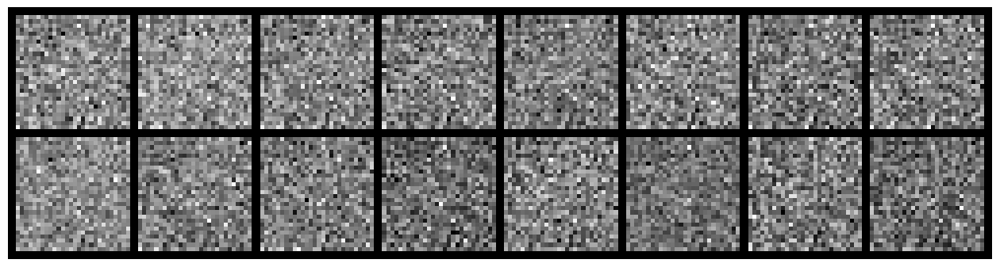

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3848, Generator Loss: 0.6636
D(x): 0.5166, D(G(z)): 0.5152


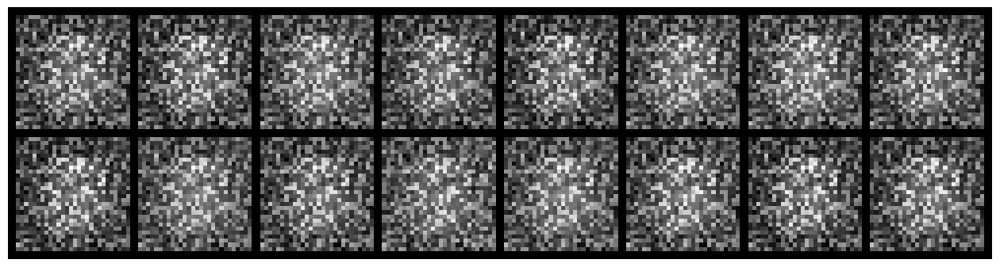

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 0.6012, Generator Loss: 2.3537
D(x): 0.7693, D(G(z)): 0.2214


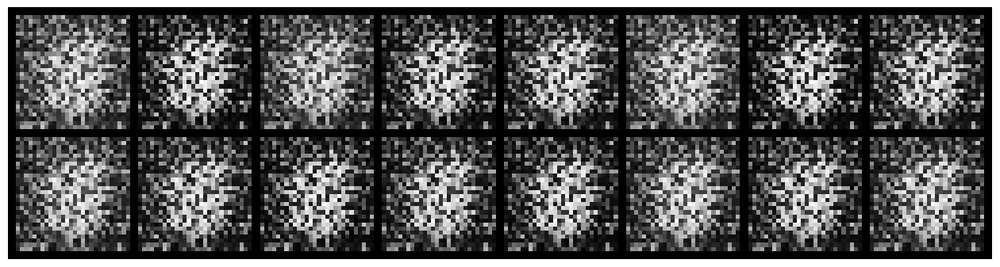

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.5356, Generator Loss: 2.7073
D(x): 0.8174, D(G(z)): 0.2584


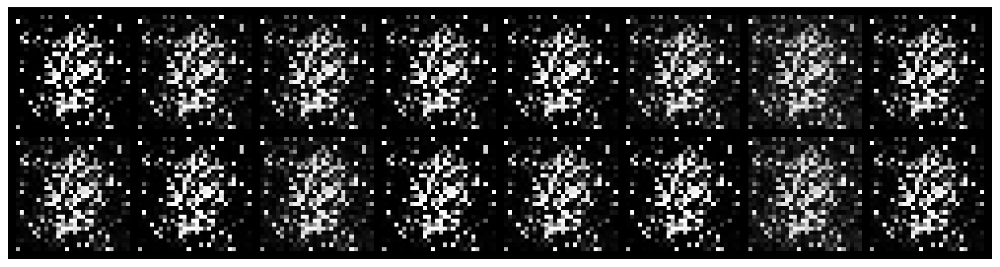

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 1.4780, Generator Loss: 2.1002
D(x): 0.6463, D(G(z)): 0.4786


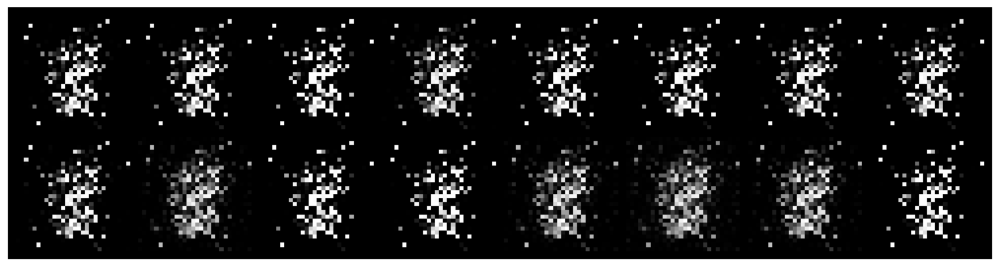

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.6420, Generator Loss: 4.1858
D(x): 0.7244, D(G(z)): 0.1496


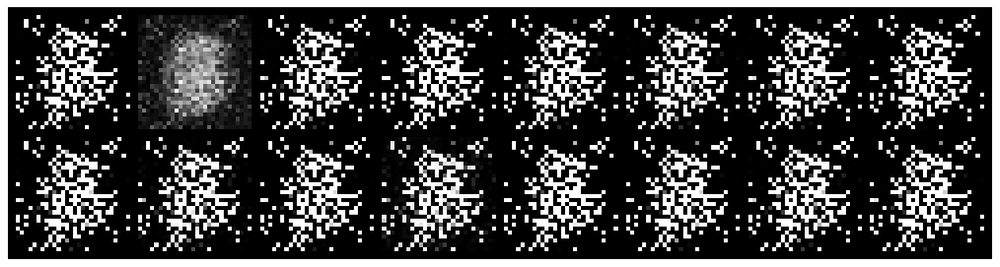

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.0496, Generator Loss: 8.5858
D(x): 0.9899, D(G(z)): 0.0245


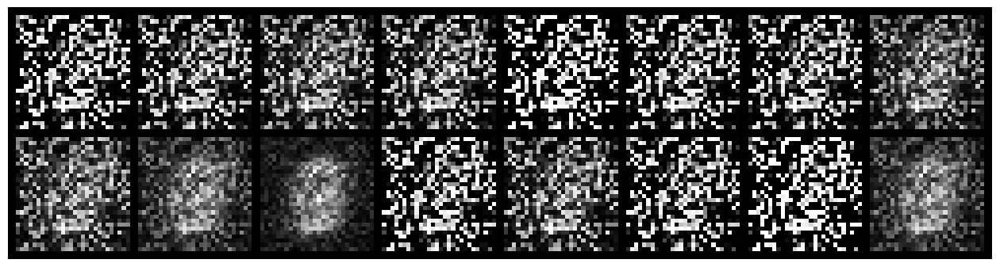

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.2690, Generator Loss: 9.8929
D(x): 0.8550, D(G(z)): 0.0594


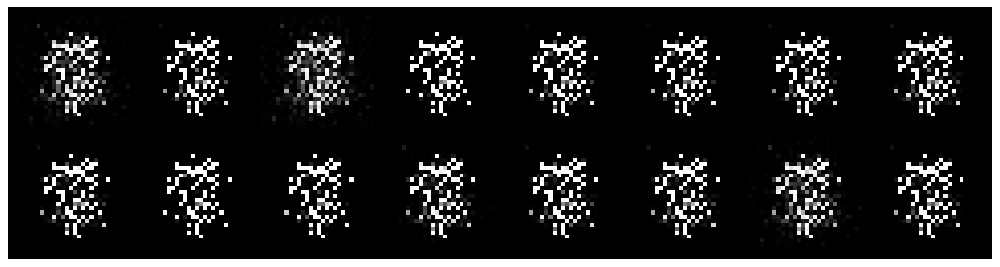

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.0639, Generator Loss: 10.0622
D(x): 0.9578, D(G(z)): 0.0160


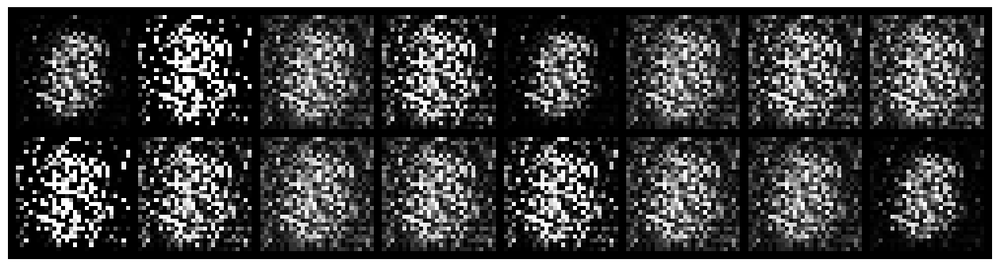

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.2638, Generator Loss: 8.1947
D(x): 0.9052, D(G(z)): 0.0922


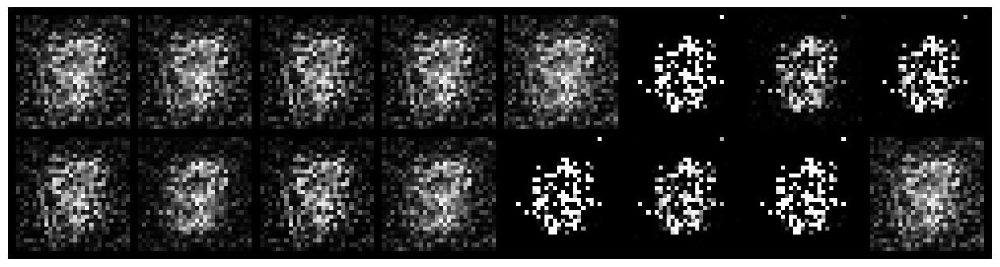

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.4722, Generator Loss: 3.2193
D(x): 0.9173, D(G(z)): 0.2639


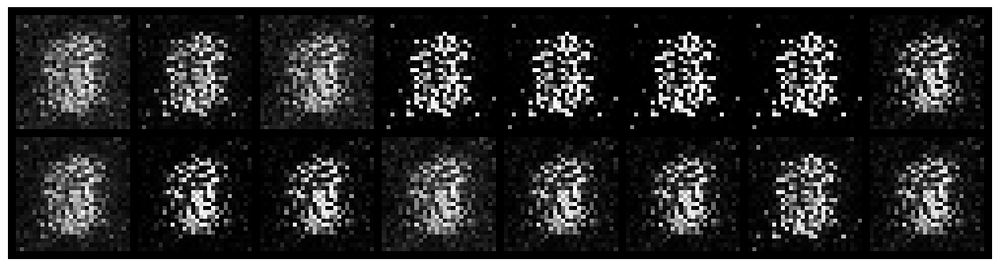

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 0.0970, Generator Loss: 9.5337
D(x): 0.9675, D(G(z)): 0.0525


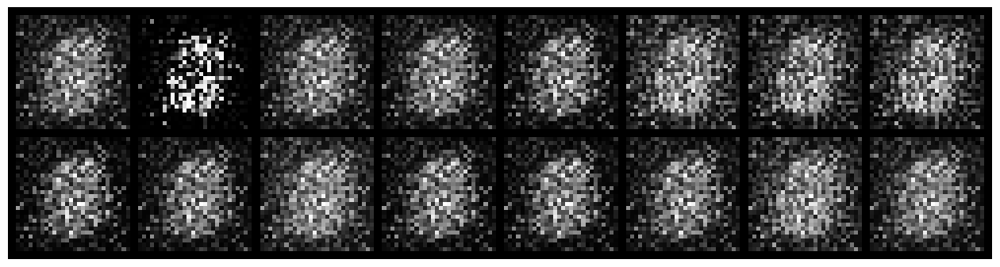

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.4257, Generator Loss: 7.5867
D(x): 0.8468, D(G(z)): 0.1365


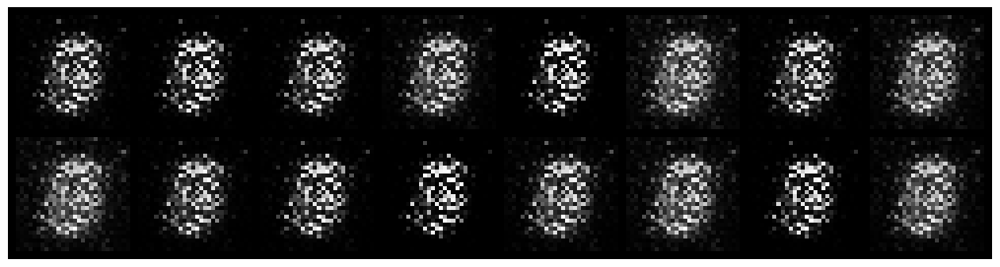

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.7245, Generator Loss: 4.1314
D(x): 0.8707, D(G(z)): 0.2591


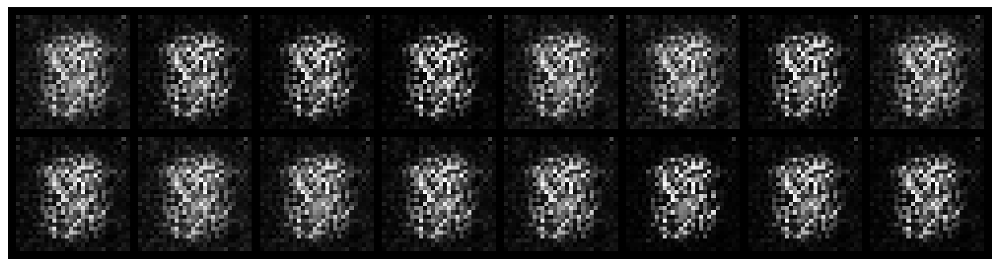

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.4421, Generator Loss: 8.1660
D(x): 0.9099, D(G(z)): 0.1804


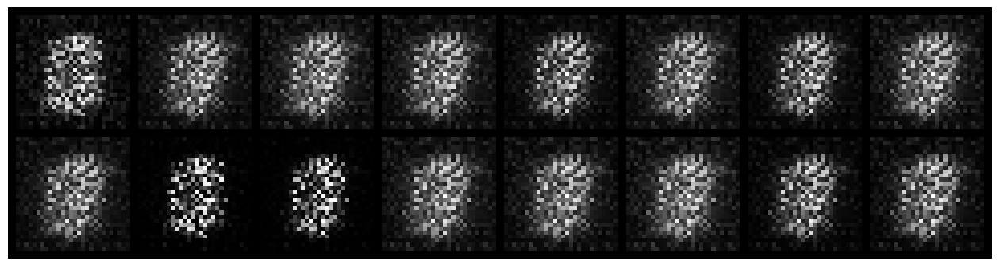

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.6354, Generator Loss: 3.9657
D(x): 0.8808, D(G(z)): 0.2709


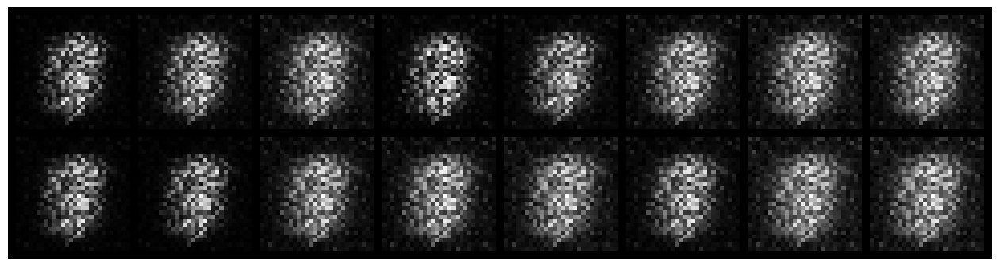

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.5065, Generator Loss: 4.4617
D(x): 0.8461, D(G(z)): 0.1666


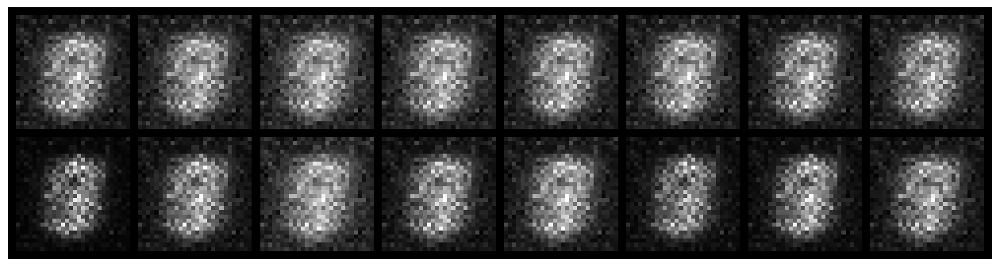

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 1.6006, Generator Loss: 0.5924
D(x): 0.6047, D(G(z)): 0.5921


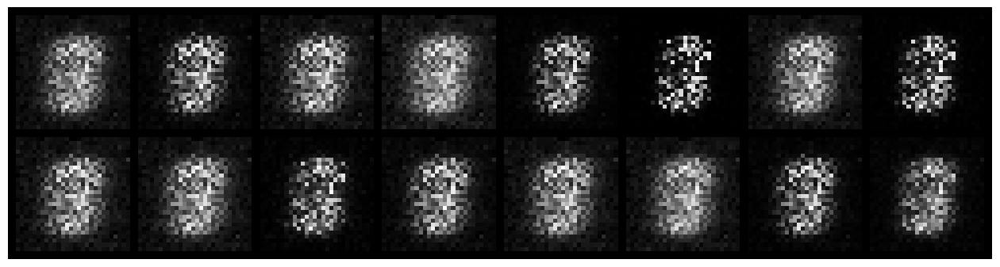

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.6736, Generator Loss: 1.8050
D(x): 0.8571, D(G(z)): 0.3154


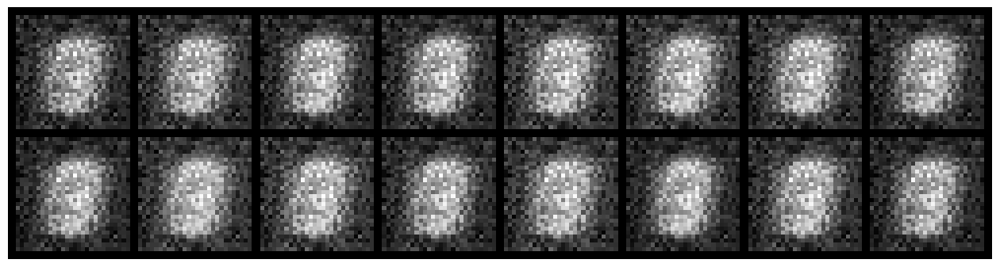

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 1.4017, Generator Loss: 2.0813
D(x): 0.6098, D(G(z)): 0.2610


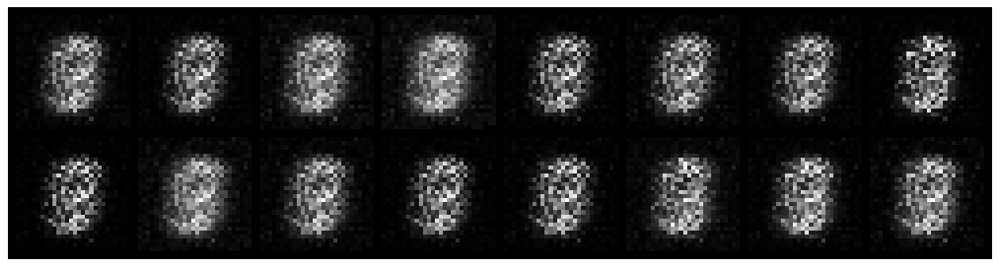

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.9013, Generator Loss: 2.0719
D(x): 0.6930, D(G(z)): 0.3103


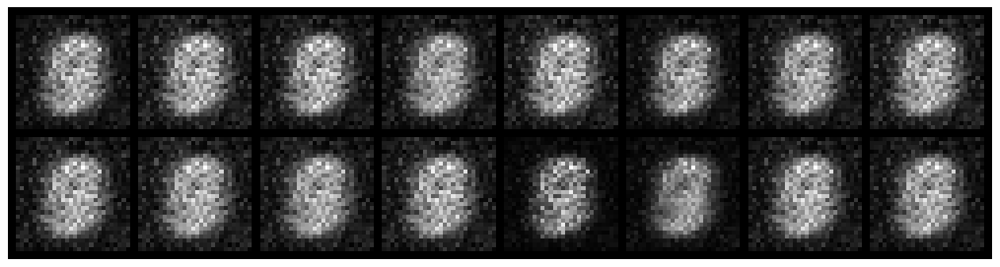

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.4992, Generator Loss: 2.9352
D(x): 0.8090, D(G(z)): 0.1076


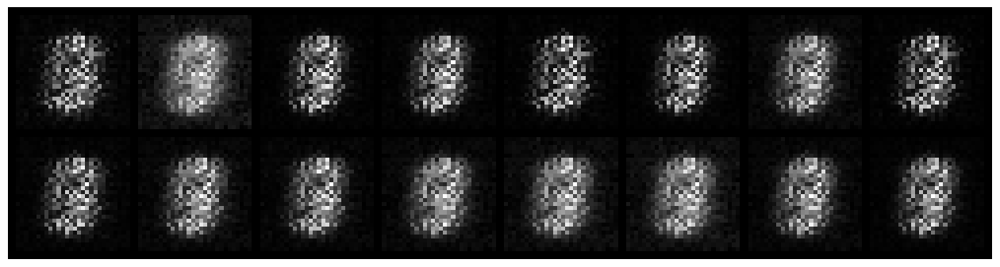

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.9748, Generator Loss: 2.3300
D(x): 0.7005, D(G(z)): 0.2961


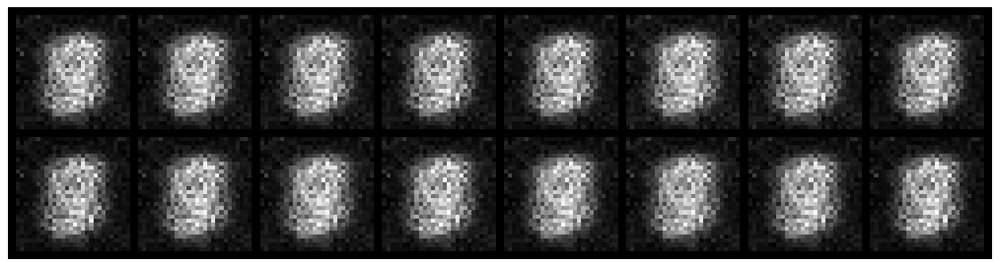

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 1.0062, Generator Loss: 1.2807
D(x): 0.6813, D(G(z)): 0.3153


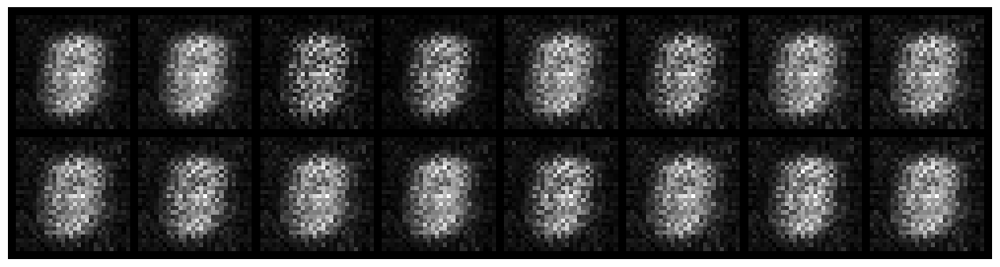

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.6161, Generator Loss: 4.5008
D(x): 0.8367, D(G(z)): 0.1114


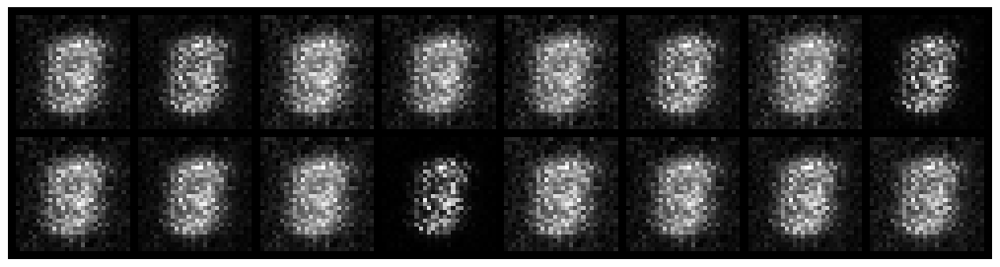

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.1841, Generator Loss: 4.2553
D(x): 0.9349, D(G(z)): 0.0714


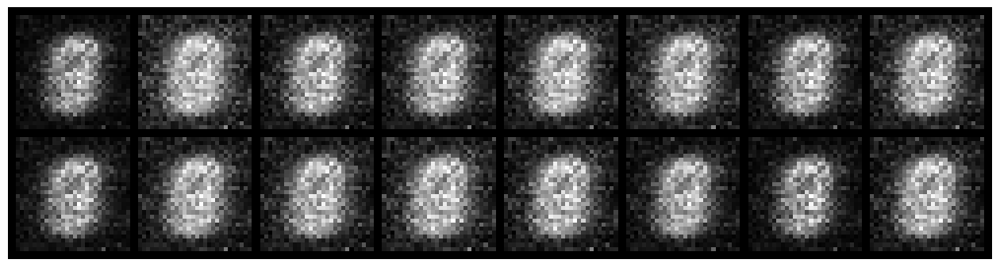

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.2973, Generator Loss: 2.9195
D(x): 0.9205, D(G(z)): 0.1208


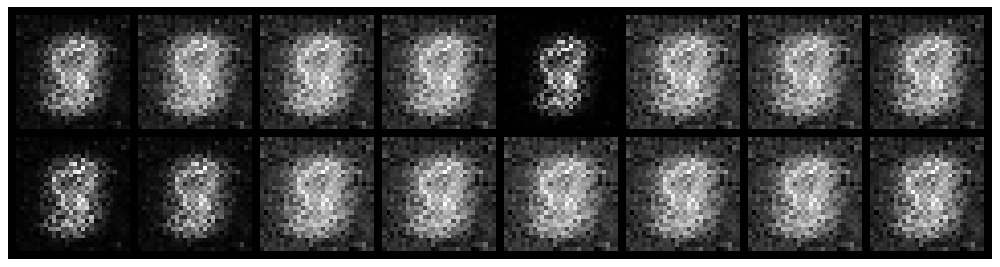

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.2551, Generator Loss: 2.8576
D(x): 0.9419, D(G(z)): 0.1266


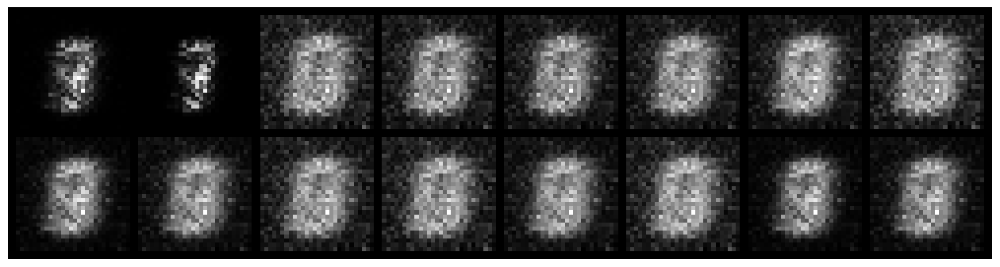

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.2868, Generator Loss: 4.1028
D(x): 0.9351, D(G(z)): 0.0939


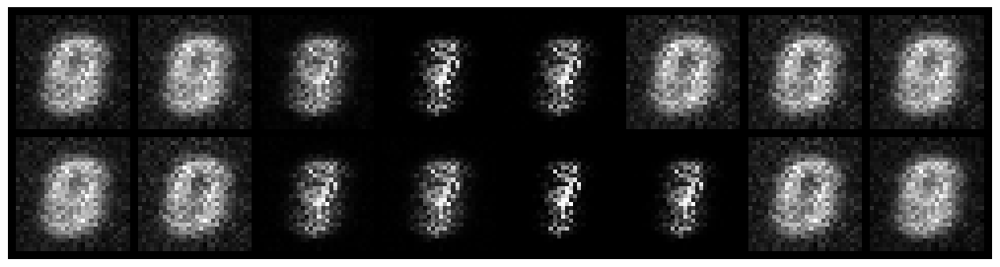

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.1595, Generator Loss: 4.1148
D(x): 0.9449, D(G(z)): 0.0563


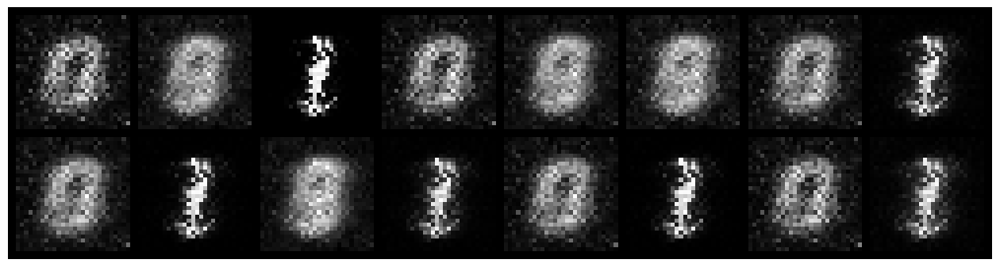

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.2853, Generator Loss: 3.9416
D(x): 0.9122, D(G(z)): 0.0675


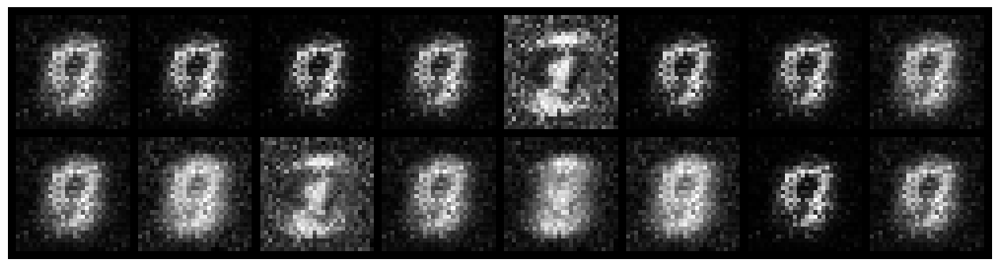

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.2663, Generator Loss: 4.4210
D(x): 0.8847, D(G(z)): 0.0409


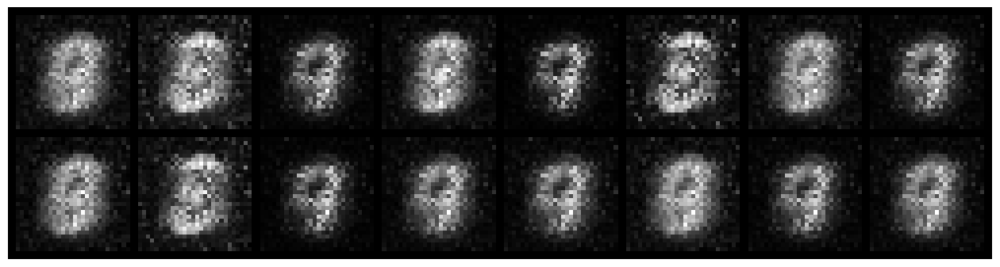

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.2963, Generator Loss: 3.6589
D(x): 0.9429, D(G(z)): 0.1073


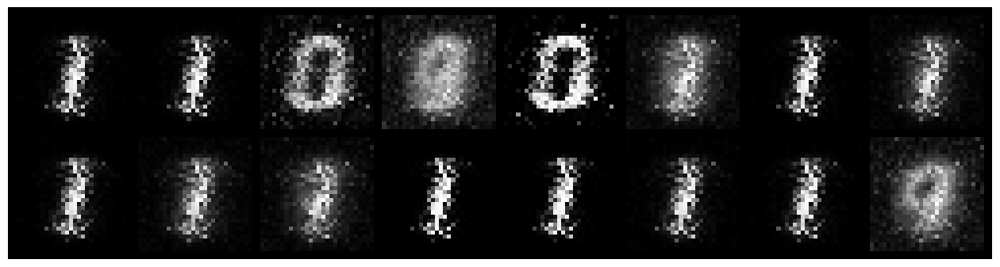

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.2837, Generator Loss: 3.7044
D(x): 0.9380, D(G(z)): 0.1163


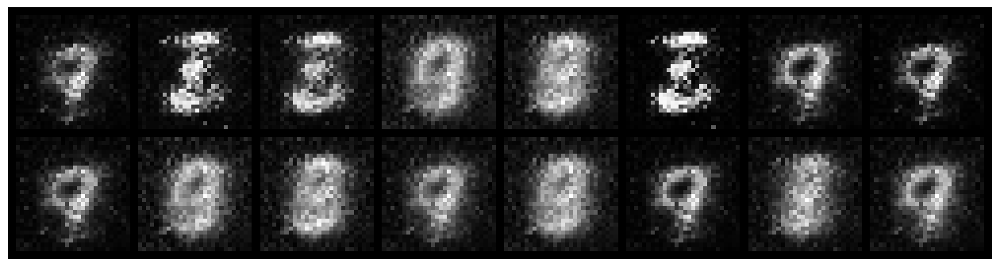

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.5116, Generator Loss: 3.8485
D(x): 0.8387, D(G(z)): 0.0916


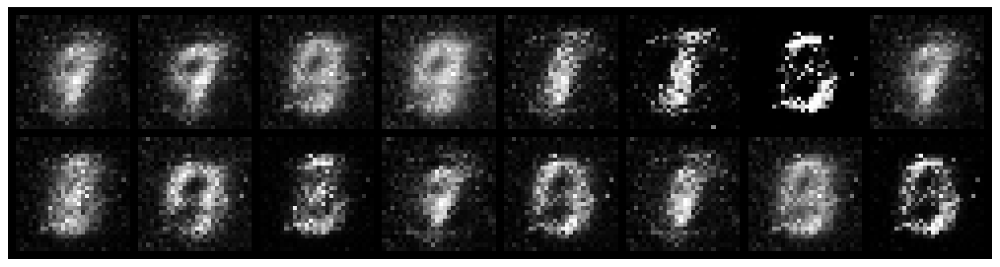

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.2696, Generator Loss: 4.2884
D(x): 0.9026, D(G(z)): 0.0670


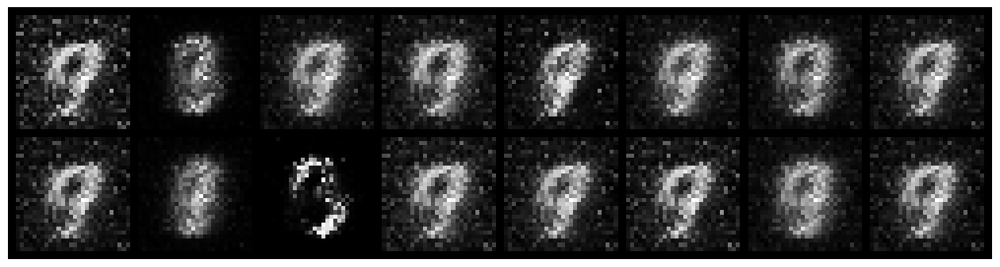

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.4070, Generator Loss: 2.8628
D(x): 0.9278, D(G(z)): 0.1722


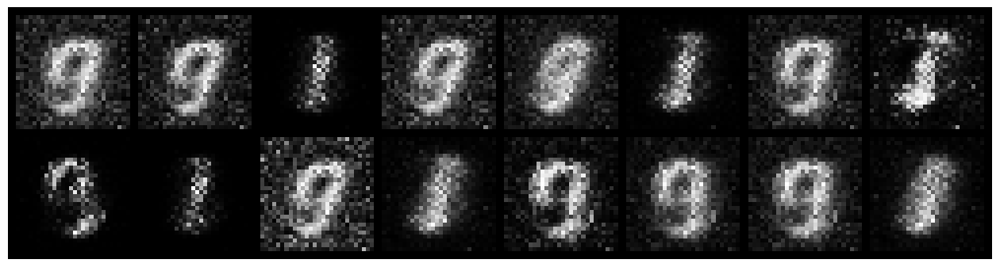

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.4373, Generator Loss: 4.5938
D(x): 0.8897, D(G(z)): 0.0920


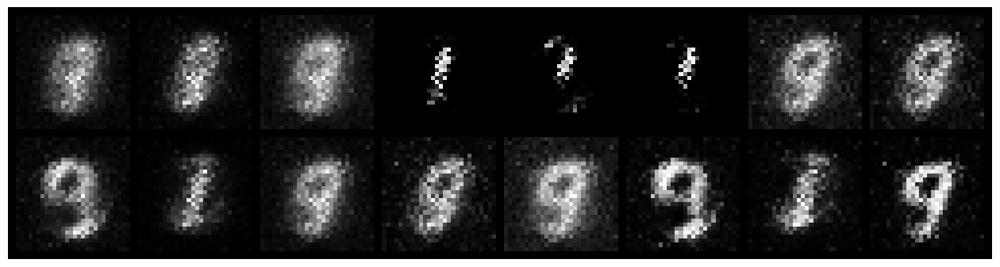

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.3307, Generator Loss: 4.7219
D(x): 0.9023, D(G(z)): 0.0833


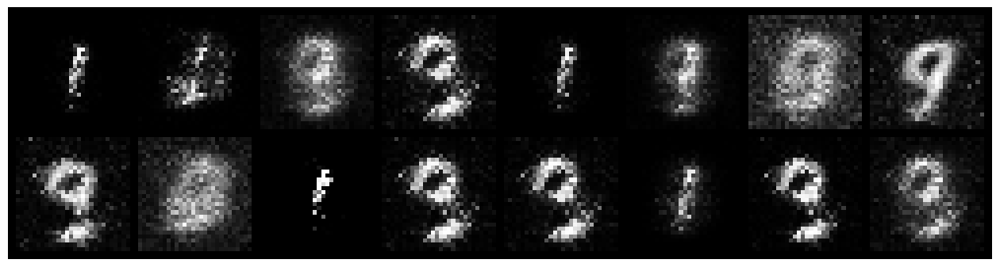

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.2860, Generator Loss: 4.1380
D(x): 0.8907, D(G(z)): 0.0695


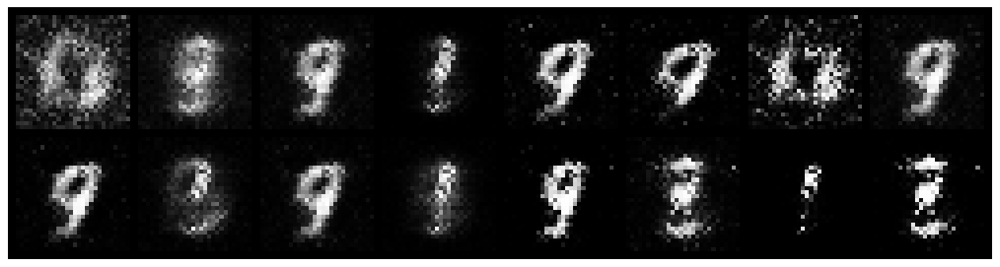

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.2907, Generator Loss: 4.0221
D(x): 0.9087, D(G(z)): 0.0749


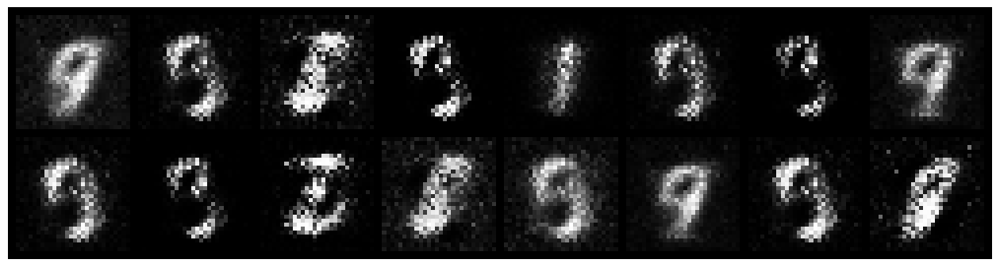

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.3985, Generator Loss: 4.5853
D(x): 0.9027, D(G(z)): 0.1208


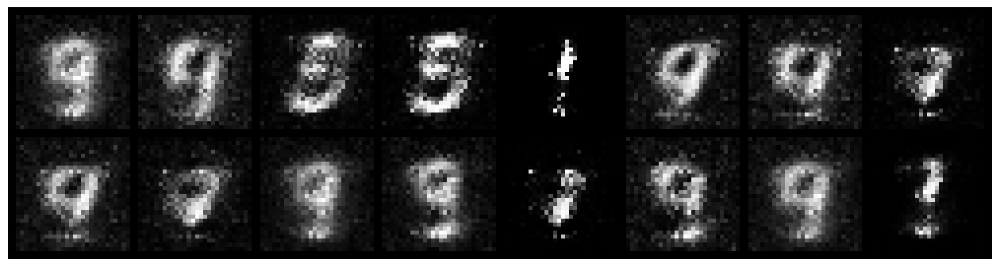

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.4497, Generator Loss: 2.5873
D(x): 0.9472, D(G(z)): 0.2295


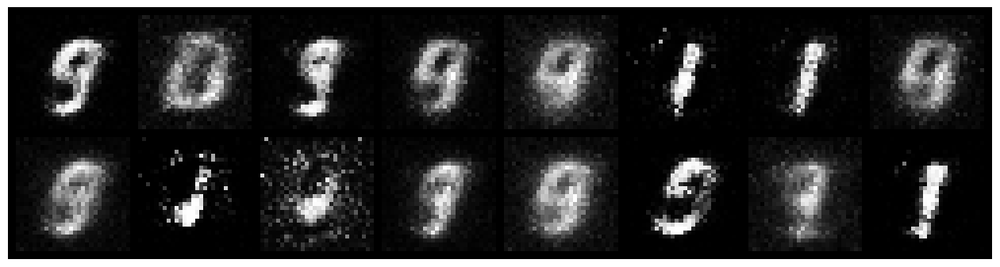

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.6908, Generator Loss: 1.9172
D(x): 0.8141, D(G(z)): 0.2211


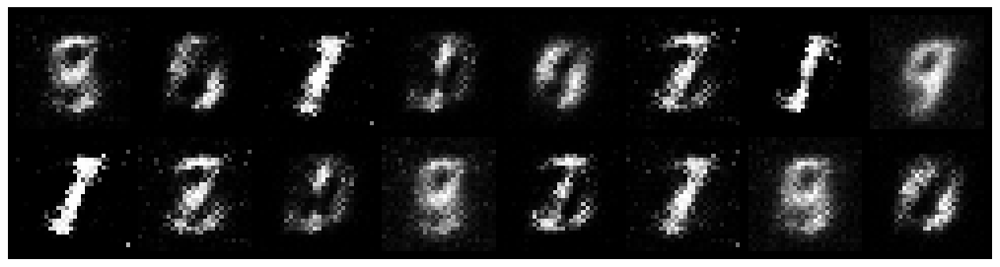

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.4863, Generator Loss: 3.6424
D(x): 0.8262, D(G(z)): 0.1027


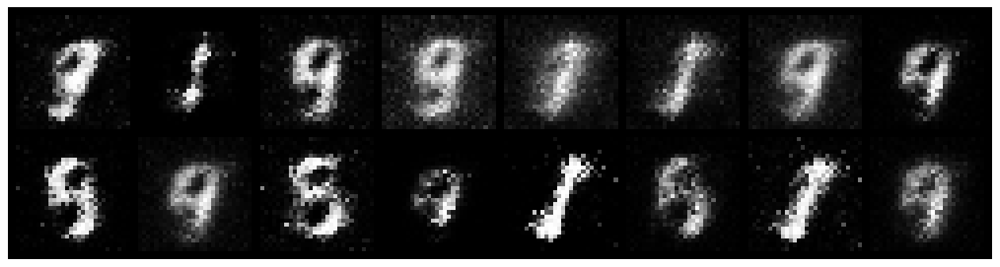

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.5083, Generator Loss: 2.3242
D(x): 0.8576, D(G(z)): 0.1477


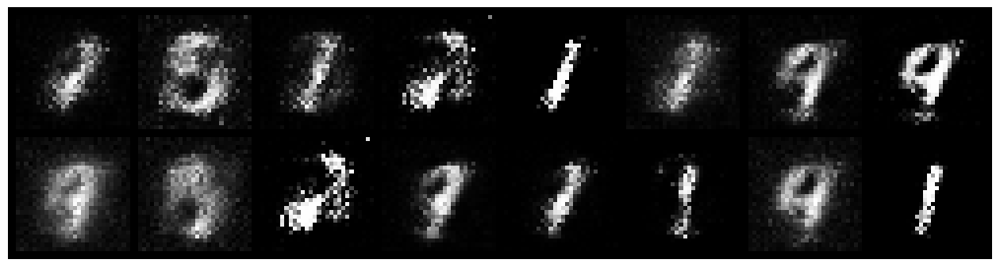

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.1984, Generator Loss: 3.4855
D(x): 0.9583, D(G(z)): 0.0932


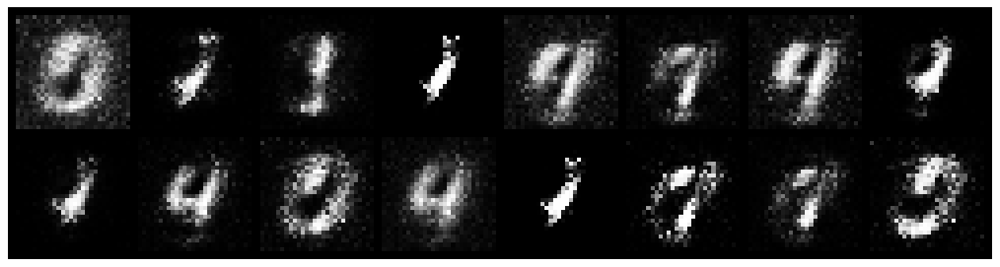

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.4918, Generator Loss: 3.0735
D(x): 0.8366, D(G(z)): 0.1432


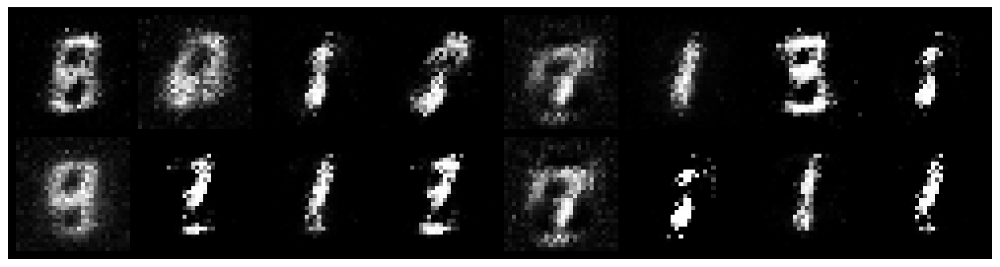

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.3566, Generator Loss: 3.1291
D(x): 0.8917, D(G(z)): 0.1087


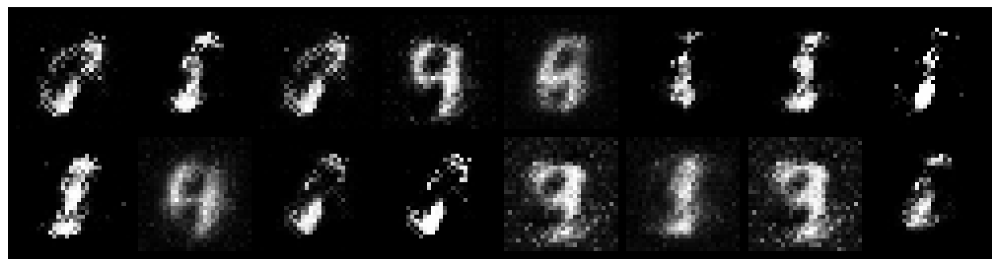

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.5375, Generator Loss: 2.4309
D(x): 0.8848, D(G(z)): 0.1753


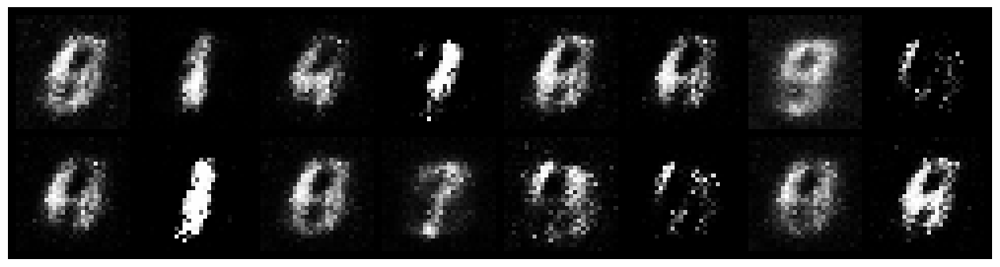

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.9529, Generator Loss: 3.0149
D(x): 0.7487, D(G(z)): 0.2059


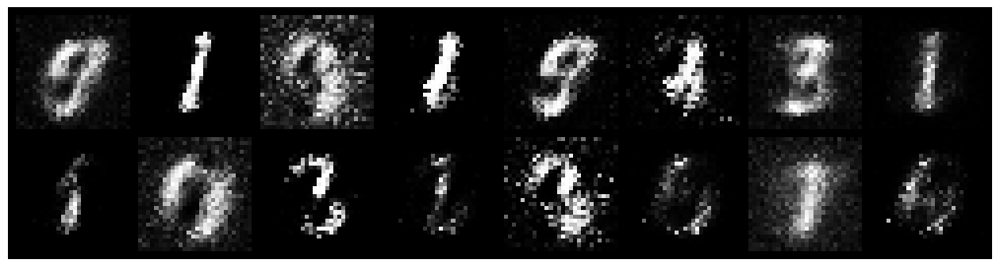

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.5759, Generator Loss: 2.2797
D(x): 0.8671, D(G(z)): 0.2149


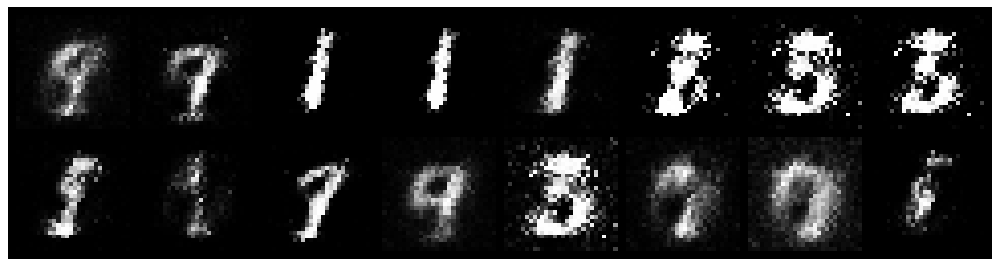

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.4213, Generator Loss: 3.3519
D(x): 0.8739, D(G(z)): 0.1121


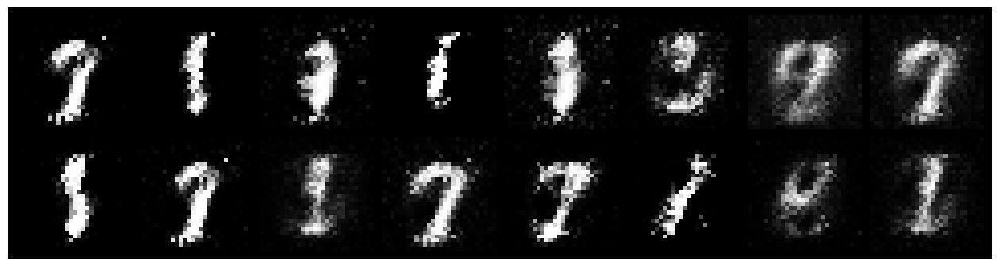

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.7099, Generator Loss: 3.4225
D(x): 0.7653, D(G(z)): 0.1275


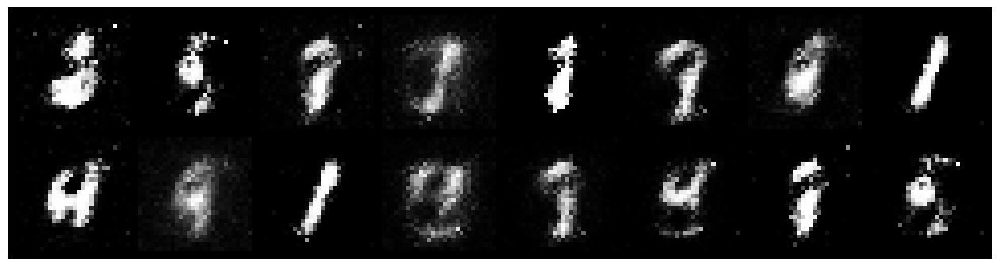

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.6395, Generator Loss: 2.8672
D(x): 0.7817, D(G(z)): 0.1364


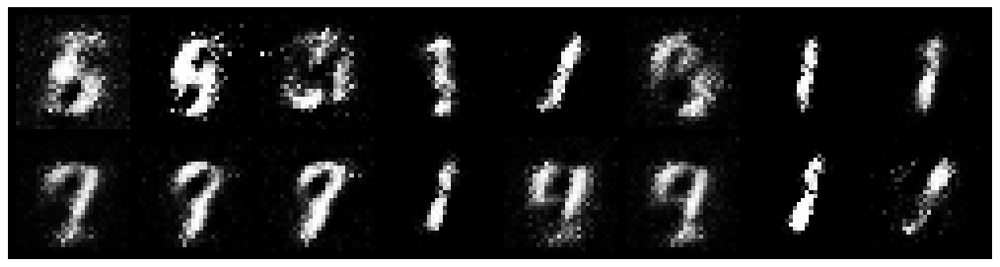

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.5282, Generator Loss: 2.3358
D(x): 0.8382, D(G(z)): 0.1742


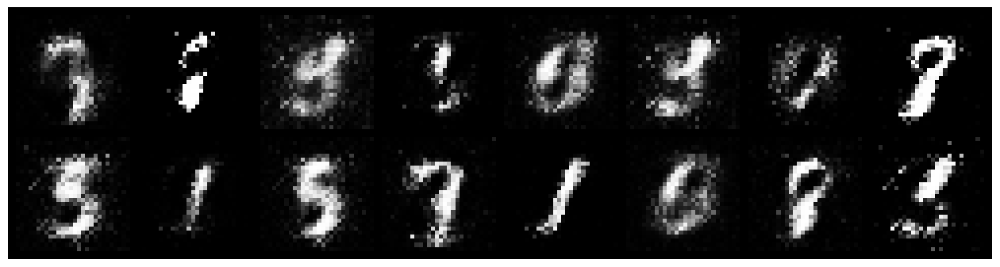

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.5106, Generator Loss: 2.7358
D(x): 0.8399, D(G(z)): 0.1105


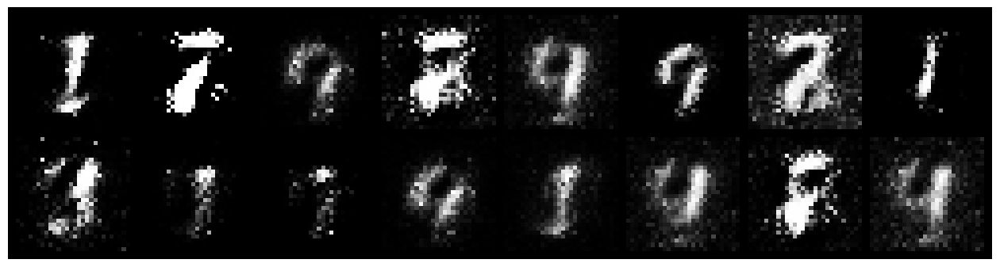

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.5717, Generator Loss: 3.1298
D(x): 0.8238, D(G(z)): 0.1714


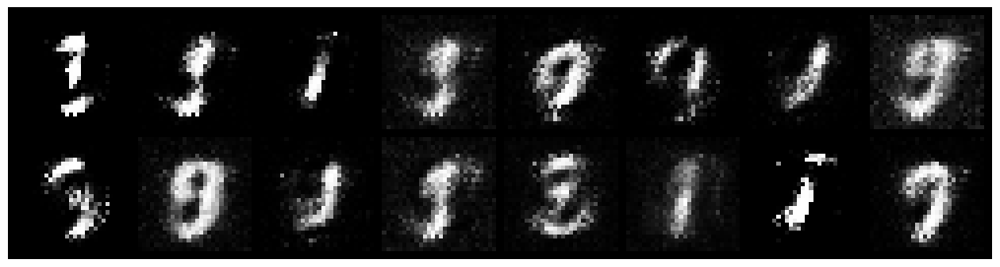

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.4982, Generator Loss: 2.4638
D(x): 0.8487, D(G(z)): 0.1807


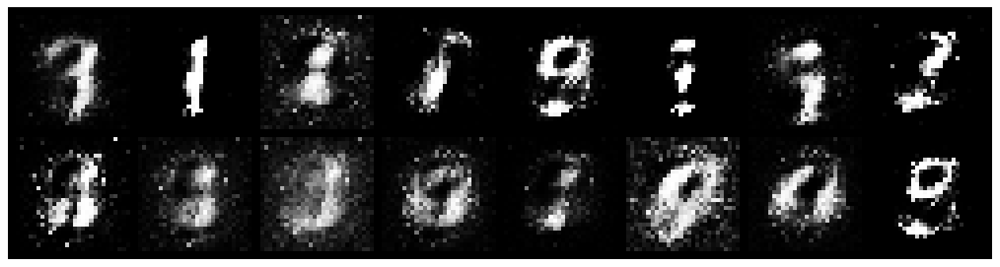

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.2577, Generator Loss: 3.5581
D(x): 0.9103, D(G(z)): 0.0766


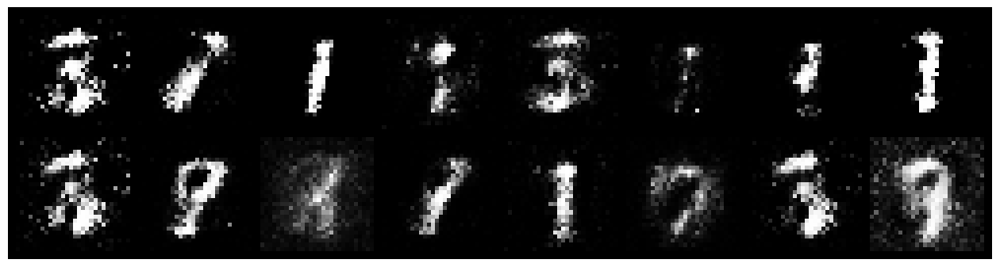

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.5258, Generator Loss: 2.5463
D(x): 0.9111, D(G(z)): 0.2069


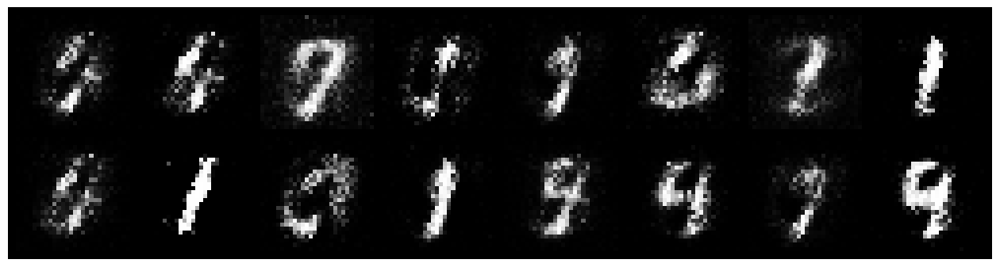

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.5306, Generator Loss: 2.8926
D(x): 0.7695, D(G(z)): 0.1057


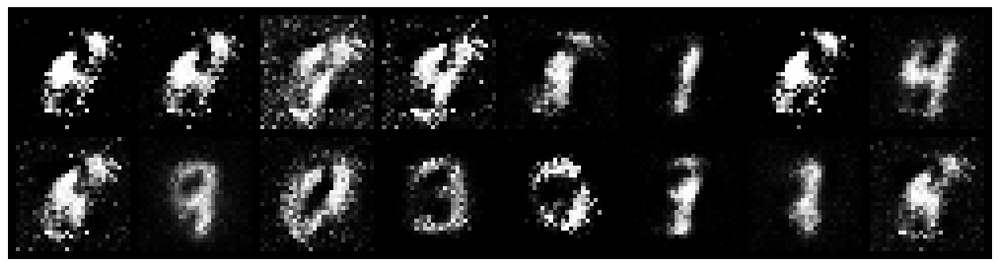

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.5499, Generator Loss: 2.4369
D(x): 0.7911, D(G(z)): 0.1835


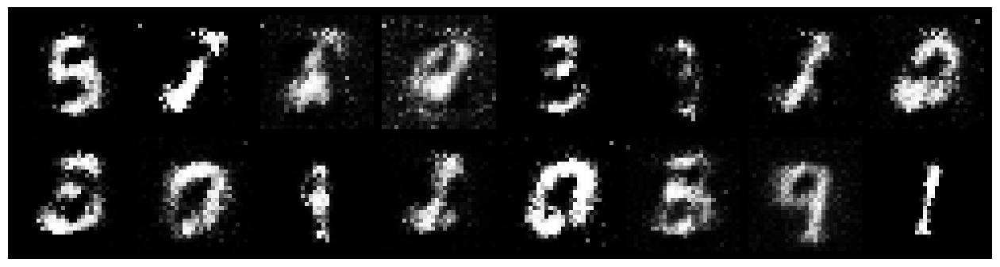

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.7194, Generator Loss: 2.8924
D(x): 0.7346, D(G(z)): 0.1185


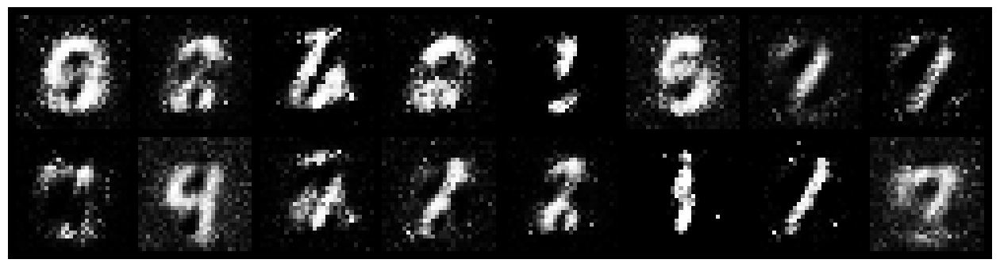

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.6602, Generator Loss: 2.7554
D(x): 0.7809, D(G(z)): 0.1766


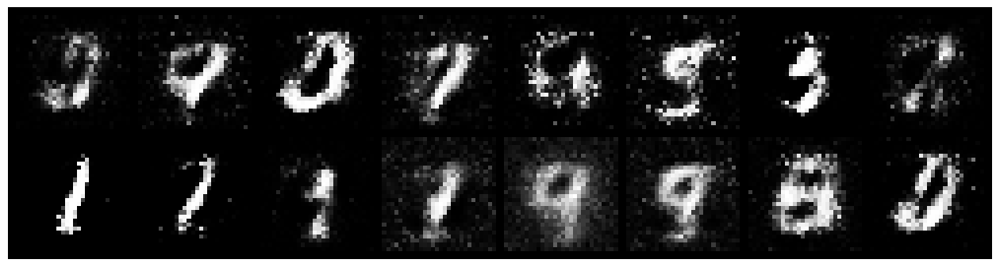

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.5557, Generator Loss: 3.0509
D(x): 0.8102, D(G(z)): 0.1126


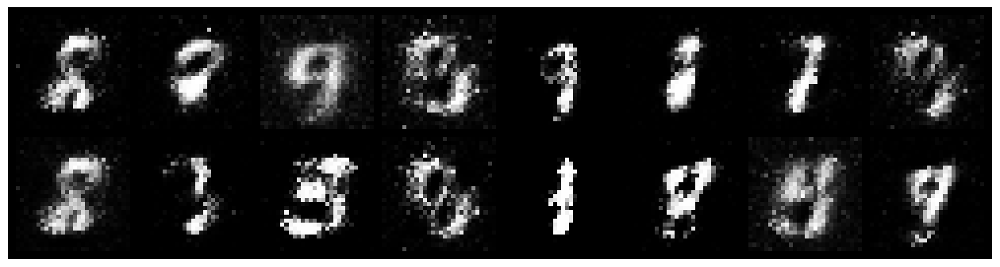

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.5733, Generator Loss: 1.8986
D(x): 0.8537, D(G(z)): 0.2725


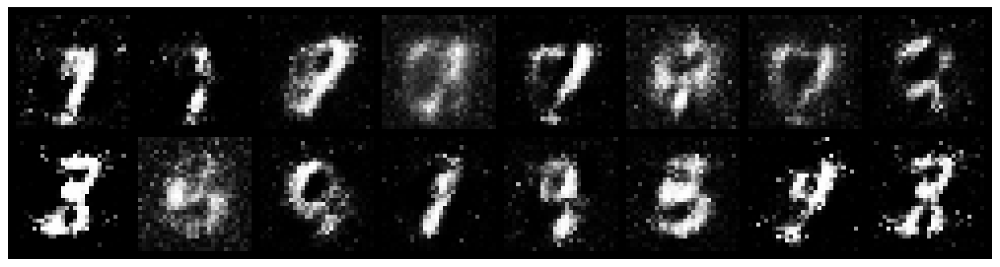

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.5448, Generator Loss: 2.3706
D(x): 0.8063, D(G(z)): 0.1706


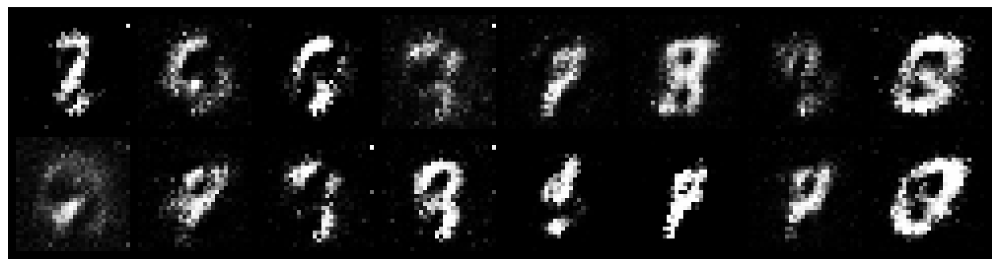

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.4420, Generator Loss: 3.0851
D(x): 0.8649, D(G(z)): 0.1413


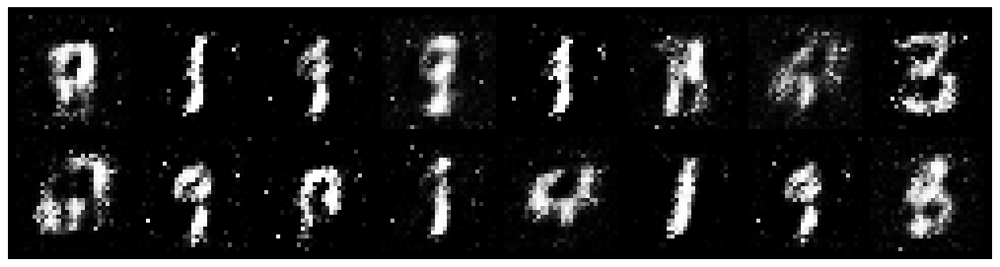

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.8348, Generator Loss: 2.0561
D(x): 0.7012, D(G(z)): 0.2054


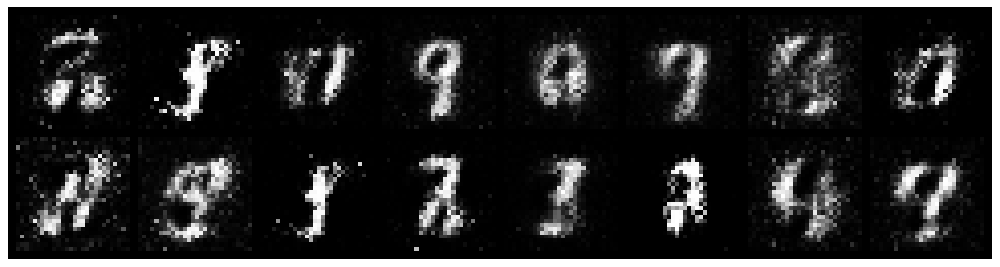

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.6154, Generator Loss: 2.2121
D(x): 0.7807, D(G(z)): 0.2121


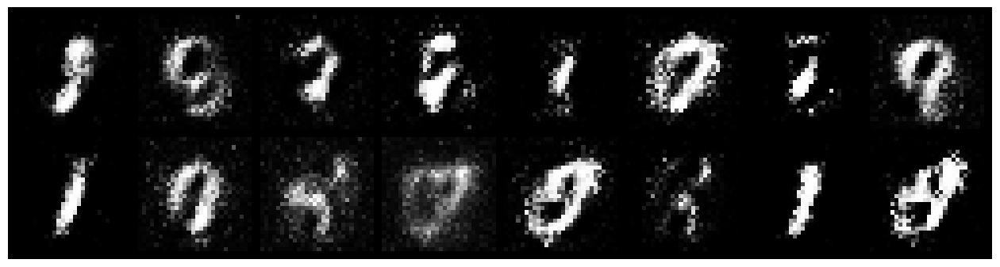

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.5727, Generator Loss: 2.2654
D(x): 0.7776, D(G(z)): 0.1598


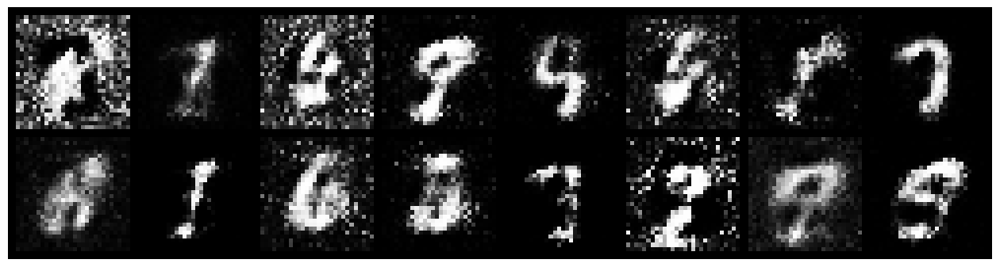

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 1.1597, Generator Loss: 1.5306
D(x): 0.6722, D(G(z)): 0.3065


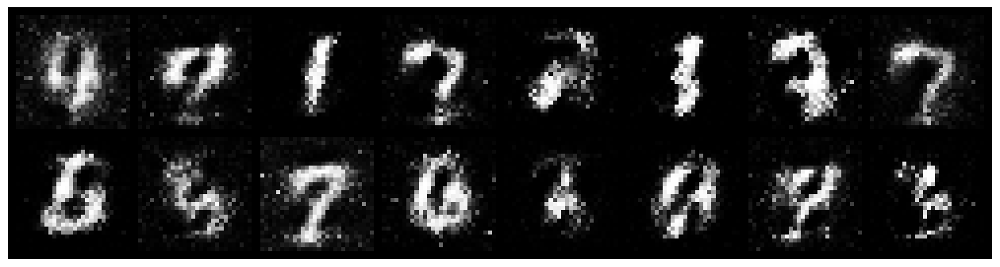

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.9404, Generator Loss: 2.0004
D(x): 0.6860, D(G(z)): 0.2573


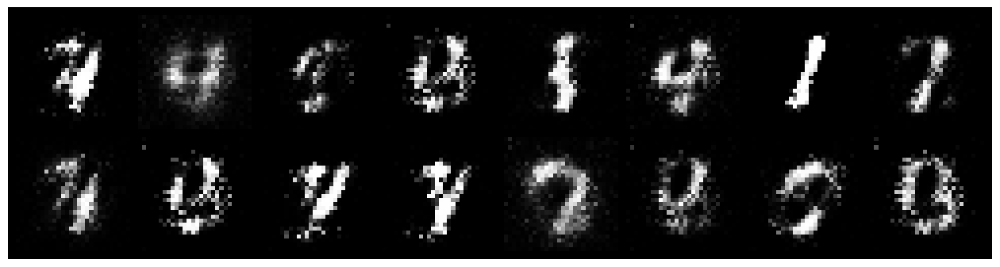

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.9165, Generator Loss: 1.7423
D(x): 0.6572, D(G(z)): 0.2163


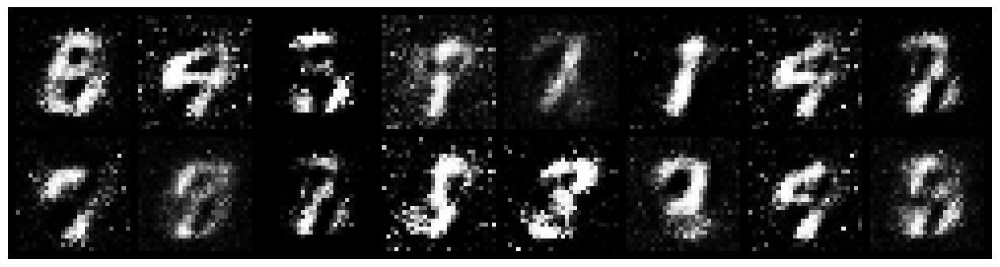

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.7924, Generator Loss: 2.2103
D(x): 0.7460, D(G(z)): 0.2344


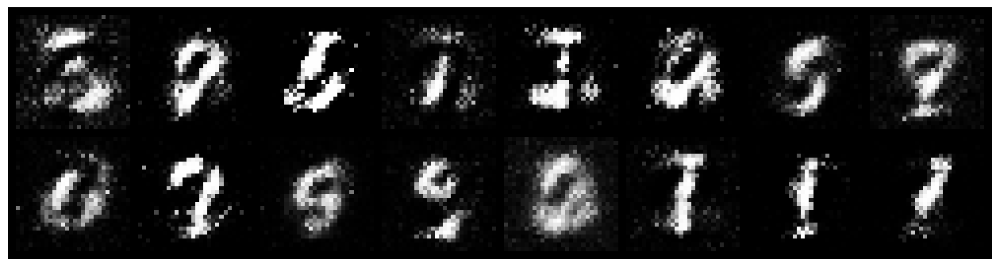

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.6417, Generator Loss: 1.5916
D(x): 0.7927, D(G(z)): 0.2392


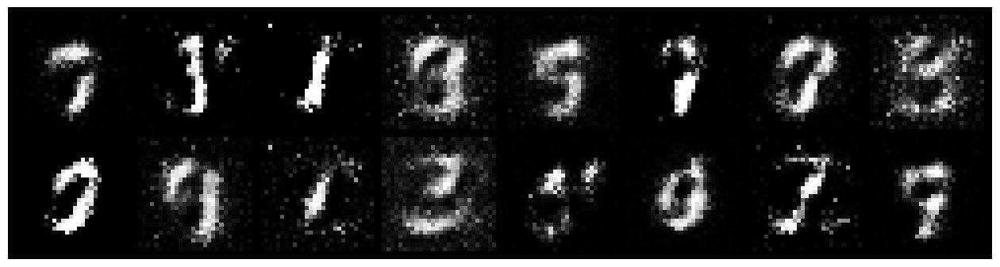

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.5732, Generator Loss: 3.1429
D(x): 0.8308, D(G(z)): 0.1863


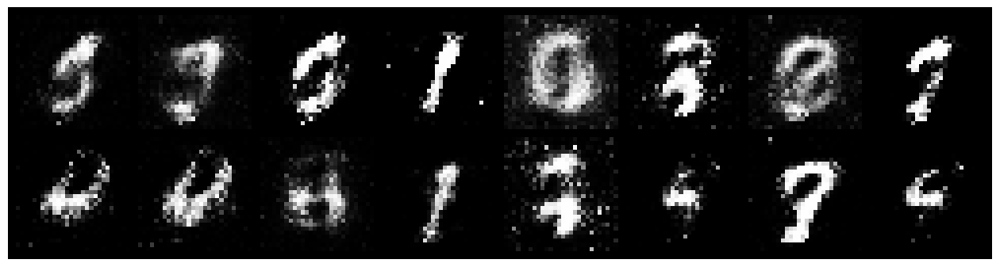

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.6486, Generator Loss: 2.6667
D(x): 0.7372, D(G(z)): 0.1261


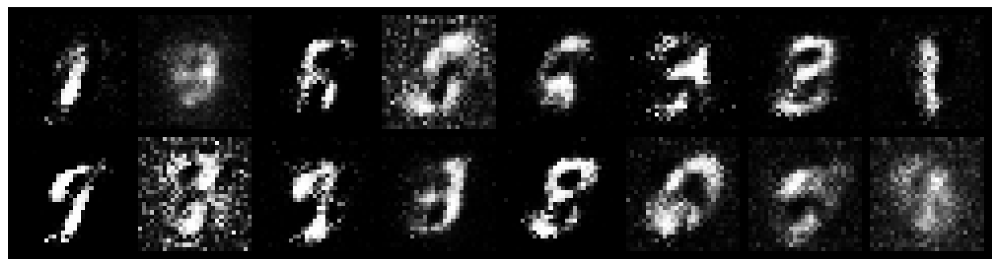

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.8231, Generator Loss: 2.0335
D(x): 0.7134, D(G(z)): 0.2207


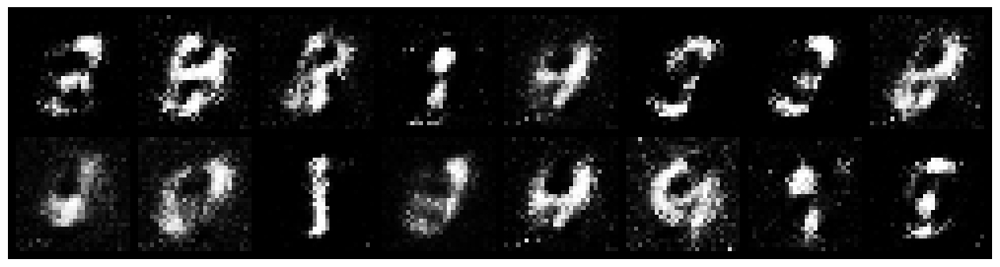

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.8608, Generator Loss: 1.9292
D(x): 0.7234, D(G(z)): 0.2847


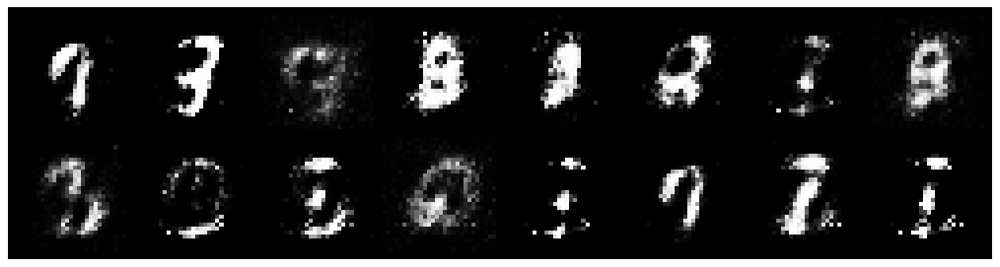

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.6818, Generator Loss: 2.4059
D(x): 0.8076, D(G(z)): 0.2231


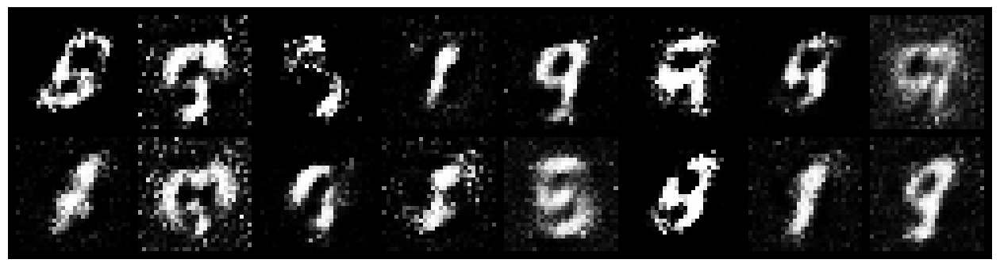

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.6665, Generator Loss: 1.8042
D(x): 0.7961, D(G(z)): 0.2488


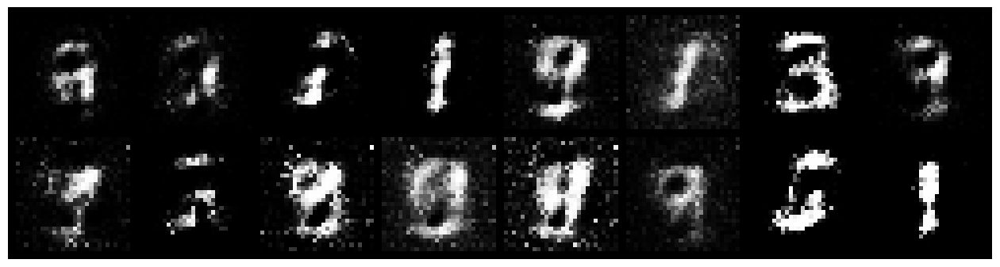

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.9169, Generator Loss: 1.9352
D(x): 0.6502, D(G(z)): 0.1898


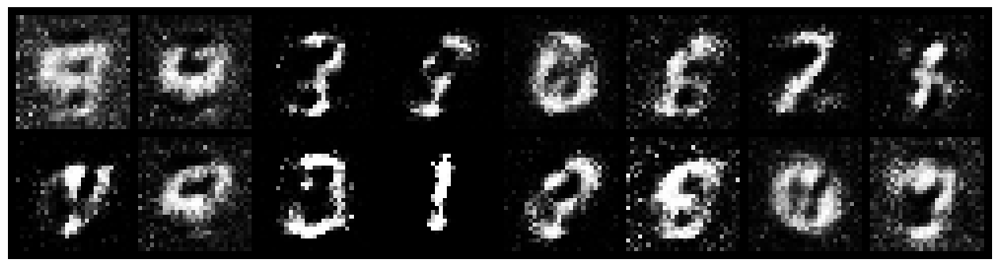

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.8673, Generator Loss: 1.8791
D(x): 0.6974, D(G(z)): 0.2193


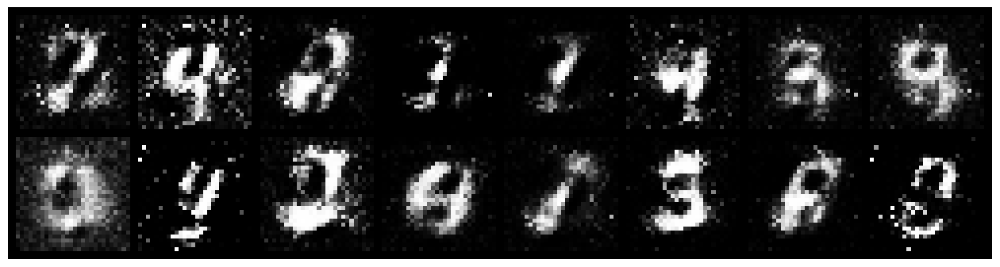

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.7852, Generator Loss: 2.1123
D(x): 0.8684, D(G(z)): 0.3263


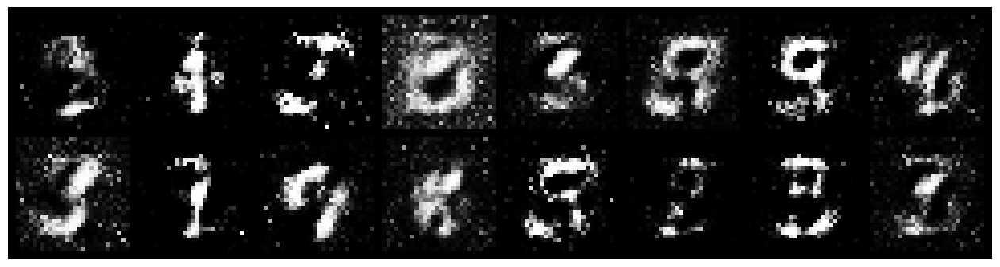

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.6156, Generator Loss: 1.8957
D(x): 0.8170, D(G(z)): 0.2349


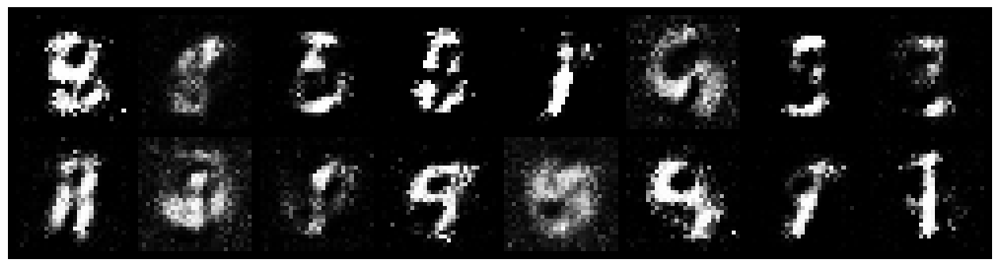

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.8926, Generator Loss: 1.3009
D(x): 0.7613, D(G(z)): 0.3677


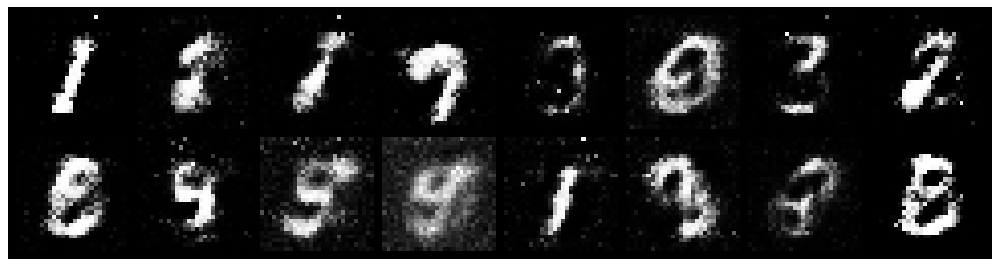

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.9895, Generator Loss: 2.1341
D(x): 0.7053, D(G(z)): 0.2864


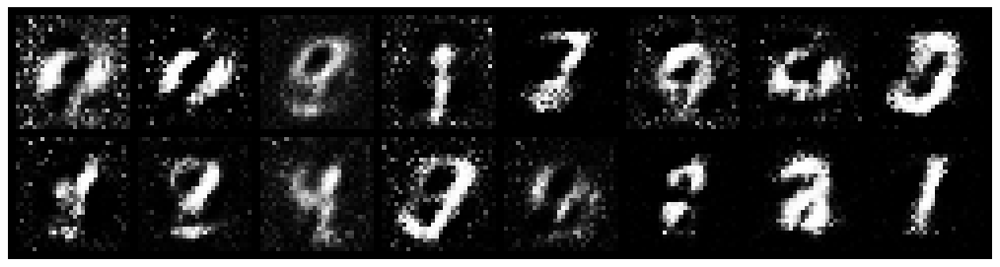

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.6504, Generator Loss: 2.3050
D(x): 0.7347, D(G(z)): 0.1980


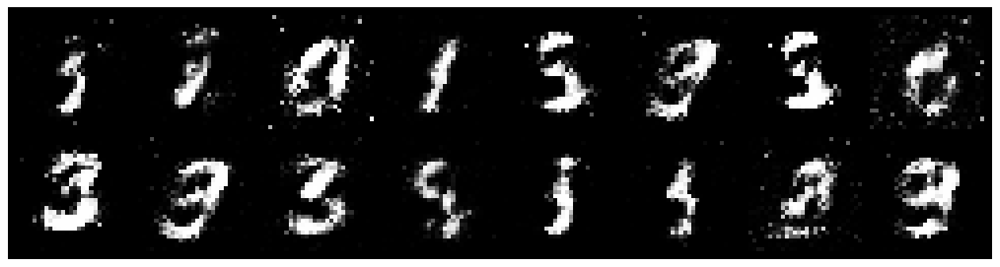

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.7044, Generator Loss: 1.7342
D(x): 0.7896, D(G(z)): 0.2457


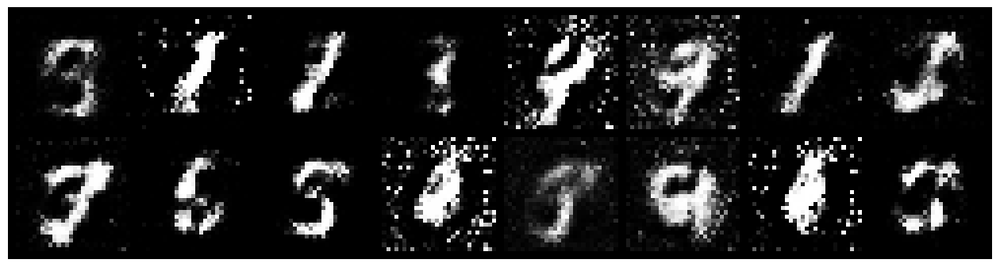

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.6828, Generator Loss: 2.1474
D(x): 0.7976, D(G(z)): 0.2346


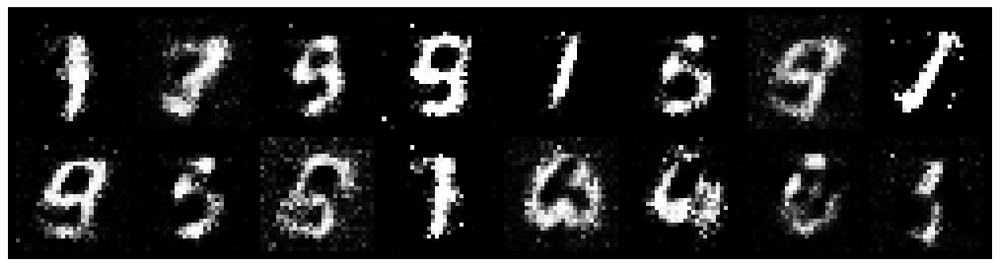

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.6713, Generator Loss: 1.8178
D(x): 0.8576, D(G(z)): 0.2866


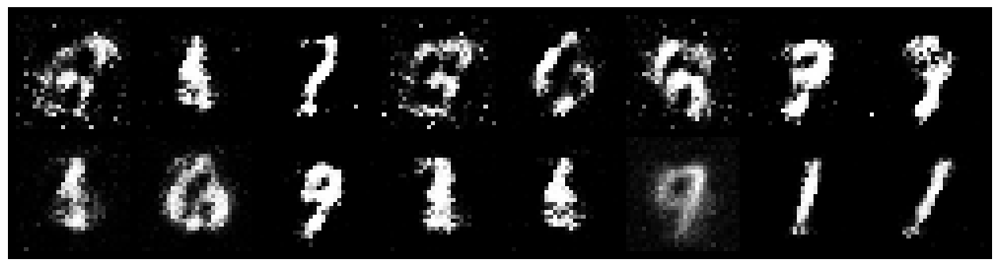

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.9768, Generator Loss: 1.6694
D(x): 0.6662, D(G(z)): 0.2937


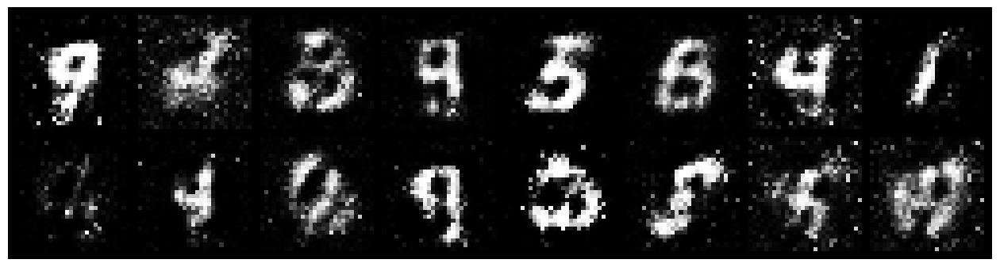

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.7286, Generator Loss: 2.6685
D(x): 0.7720, D(G(z)): 0.2552


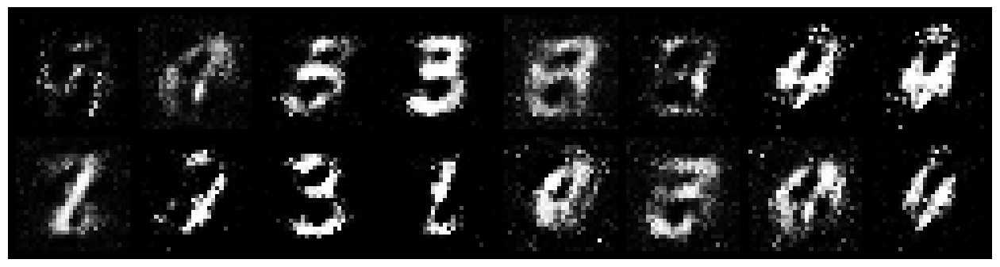

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.6635, Generator Loss: 1.8958
D(x): 0.7852, D(G(z)): 0.2459


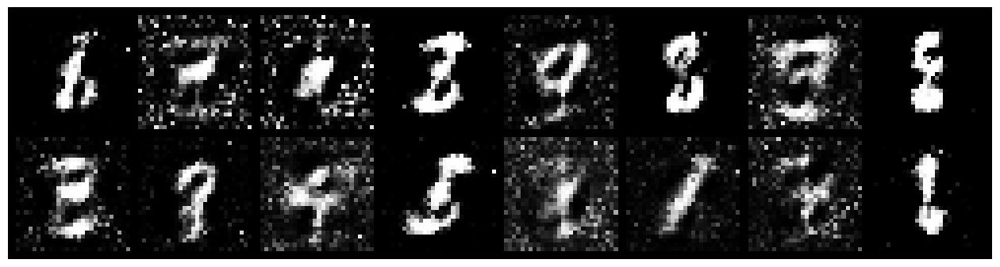

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.9072, Generator Loss: 1.6630
D(x): 0.7402, D(G(z)): 0.3333


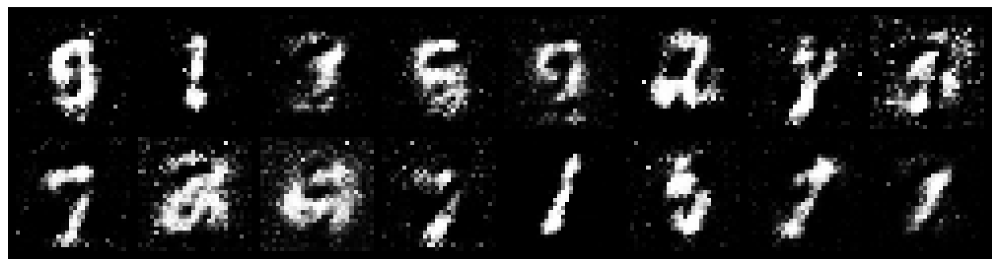

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.8763, Generator Loss: 2.1605
D(x): 0.6901, D(G(z)): 0.1907


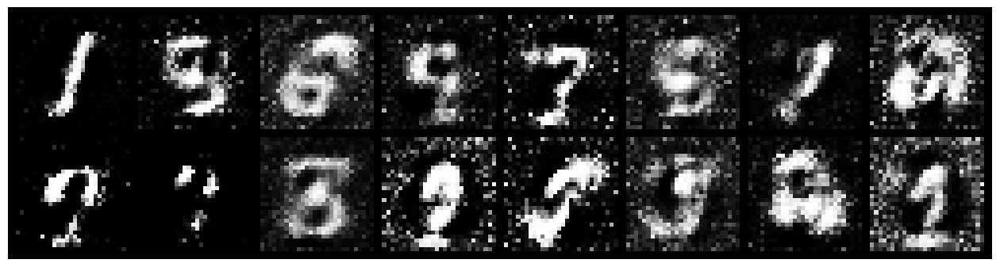

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.8119, Generator Loss: 2.2830
D(x): 0.6812, D(G(z)): 0.1654


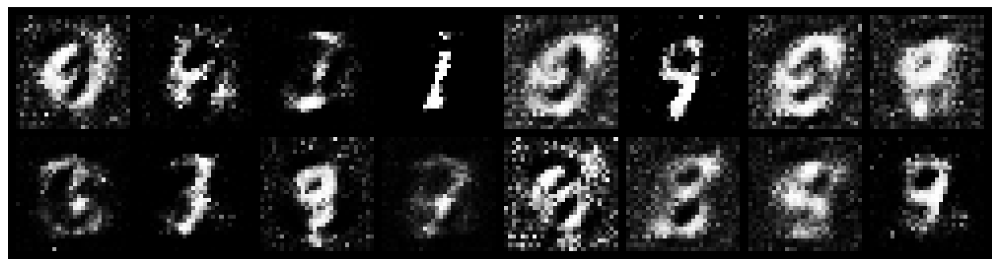

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.7657, Generator Loss: 1.9654
D(x): 0.7513, D(G(z)): 0.2451


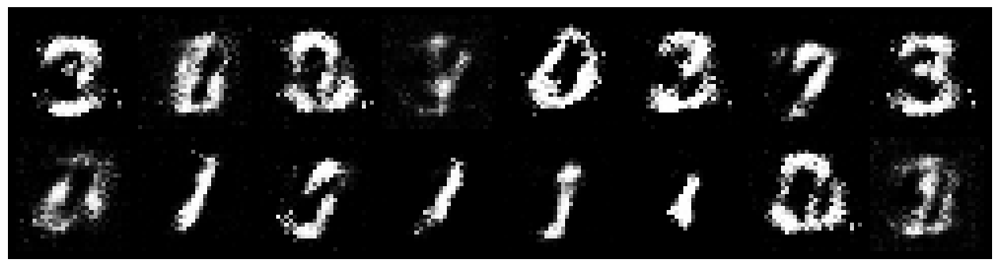

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.8206, Generator Loss: 2.0000
D(x): 0.6993, D(G(z)): 0.2116


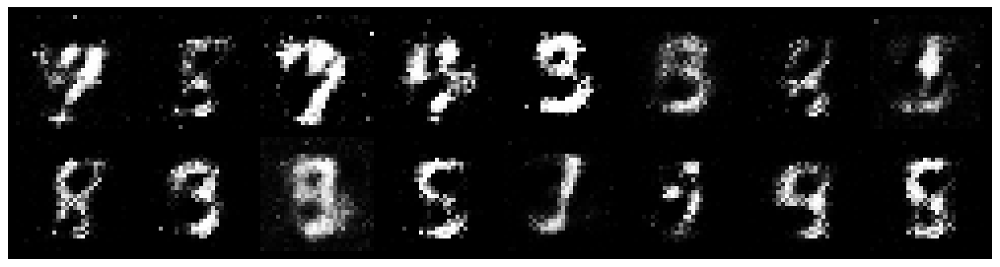

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.8110, Generator Loss: 1.5620
D(x): 0.7214, D(G(z)): 0.2656


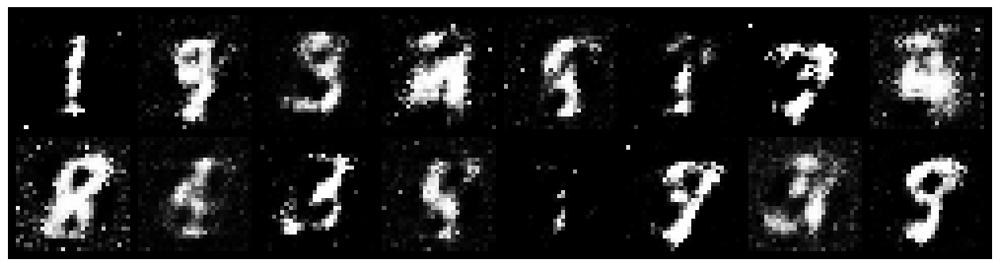

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 1.0006, Generator Loss: 1.5657
D(x): 0.6550, D(G(z)): 0.2882


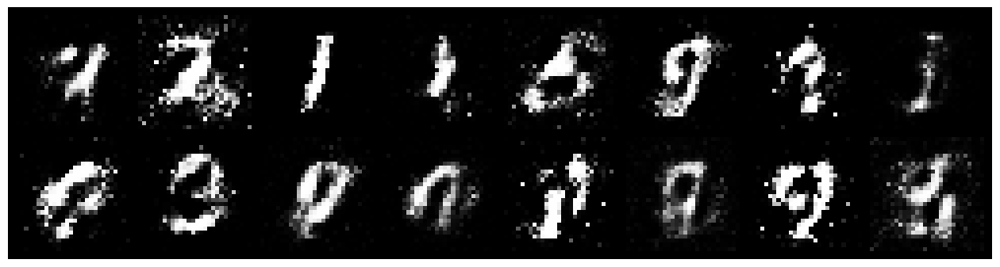

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 1.0467, Generator Loss: 1.8121
D(x): 0.6515, D(G(z)): 0.2677


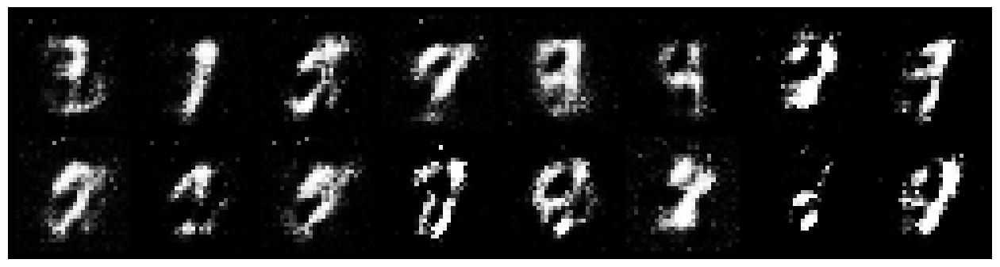

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 1.1129, Generator Loss: 1.7012
D(x): 0.7303, D(G(z)): 0.4089


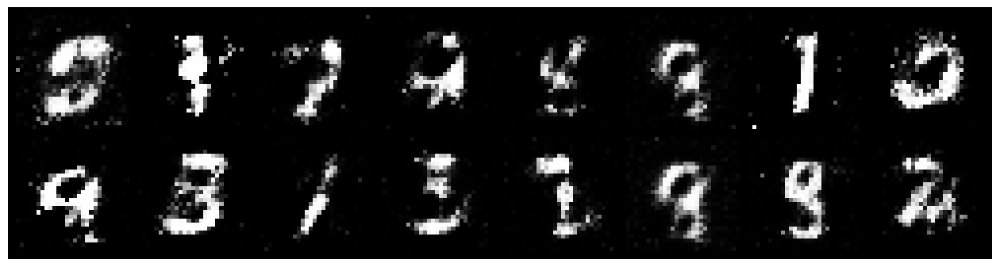

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.9191, Generator Loss: 1.7676
D(x): 0.7064, D(G(z)): 0.2742


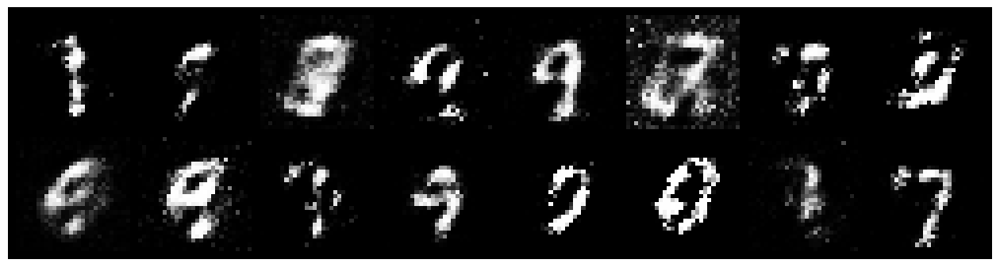

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.7829, Generator Loss: 1.3655
D(x): 0.7713, D(G(z)): 0.3343


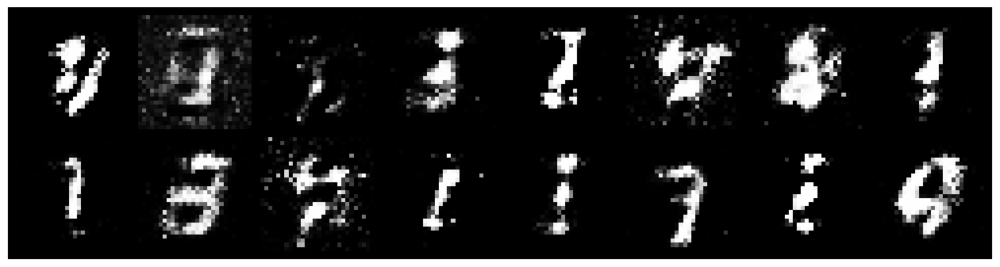

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 1.0792, Generator Loss: 1.3067
D(x): 0.6311, D(G(z)): 0.3386


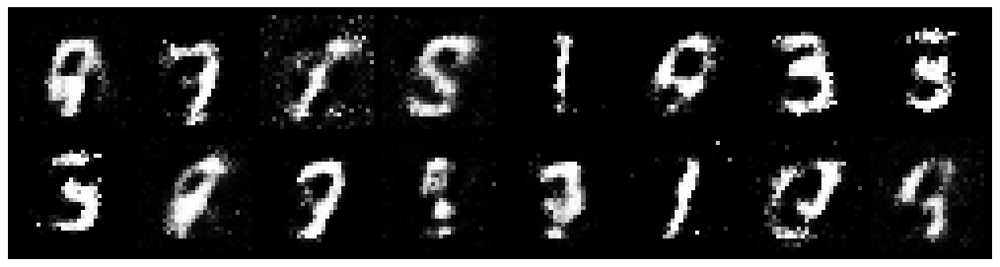

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.9899, Generator Loss: 1.4085
D(x): 0.6648, D(G(z)): 0.2964


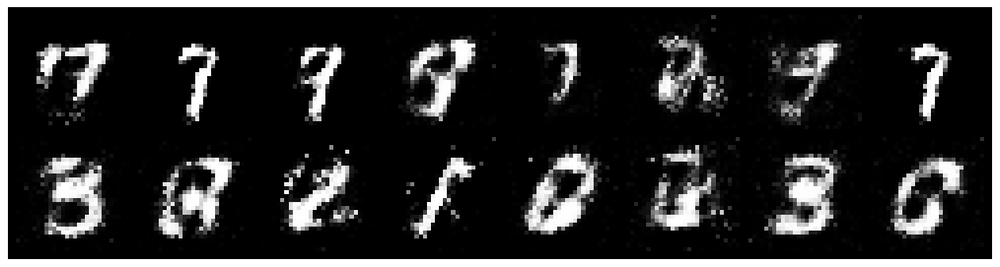

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 1.1403, Generator Loss: 1.2840
D(x): 0.6697, D(G(z)): 0.3407


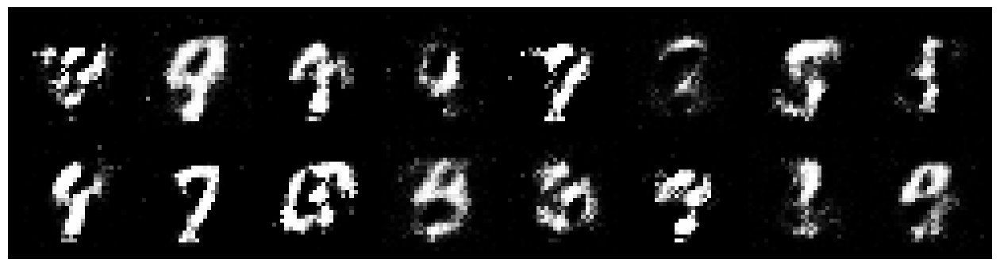

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.9689, Generator Loss: 1.5870
D(x): 0.6725, D(G(z)): 0.3092


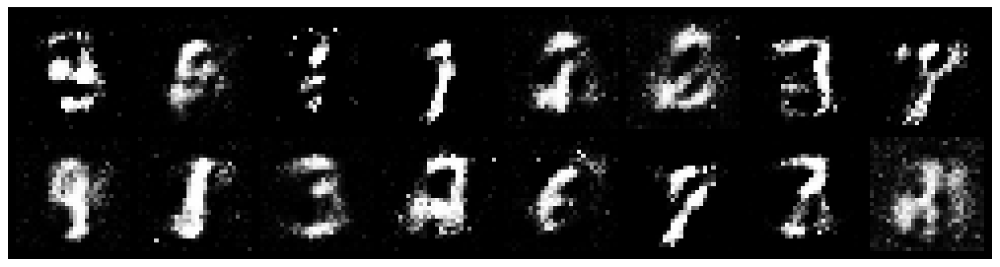

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 1.1521, Generator Loss: 1.4621
D(x): 0.6179, D(G(z)): 0.3081


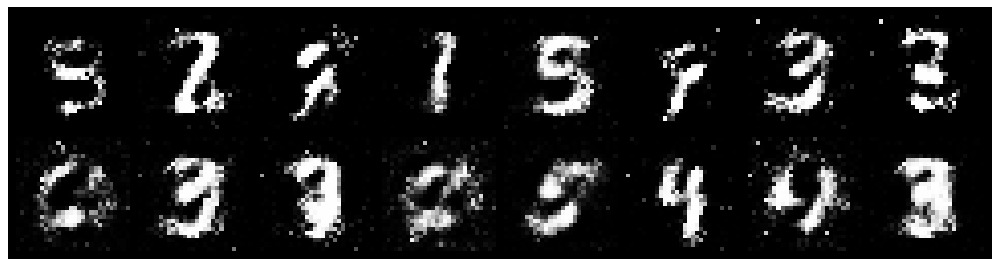

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.8845, Generator Loss: 1.9565
D(x): 0.7129, D(G(z)): 0.2763


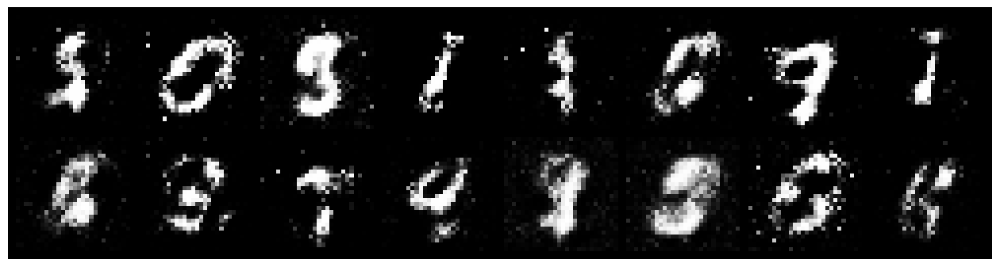

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.8651, Generator Loss: 1.8390
D(x): 0.7090, D(G(z)): 0.2850


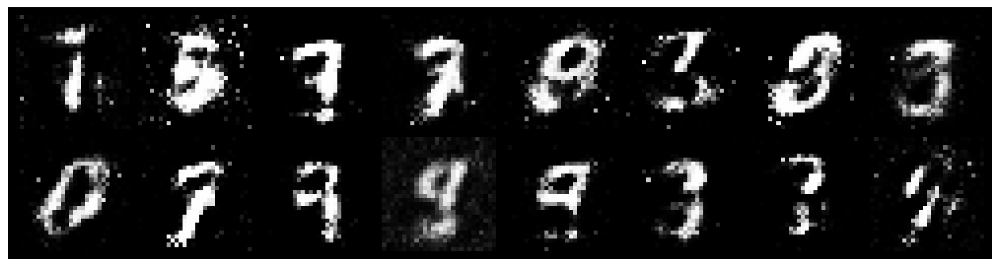

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.9795, Generator Loss: 1.7986
D(x): 0.7028, D(G(z)): 0.3478


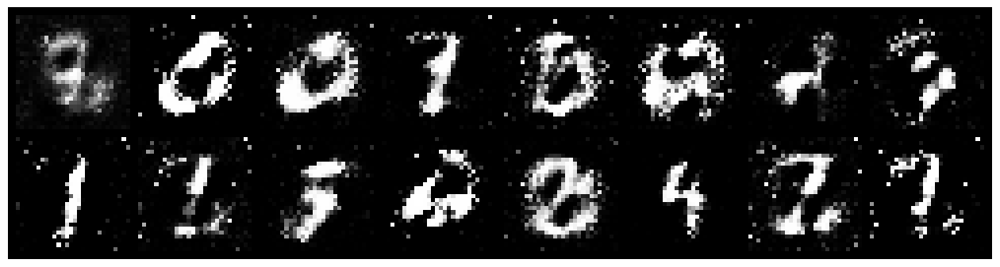

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.7580, Generator Loss: 1.5137
D(x): 0.7599, D(G(z)): 0.3108


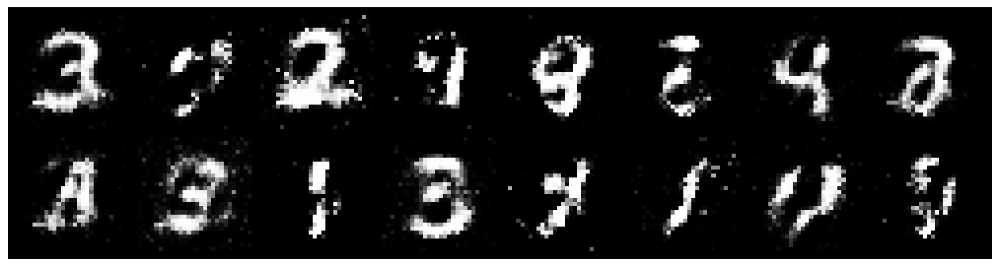

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.8347, Generator Loss: 1.9318
D(x): 0.7376, D(G(z)): 0.2624


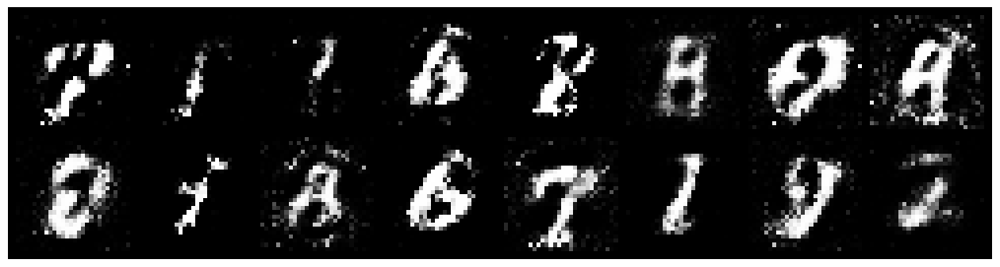

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.8126, Generator Loss: 1.9133
D(x): 0.8039, D(G(z)): 0.2694


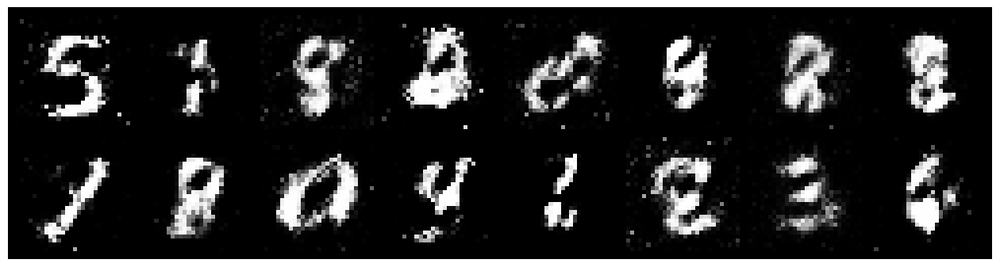

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.7234, Generator Loss: 1.7842
D(x): 0.7888, D(G(z)): 0.2370


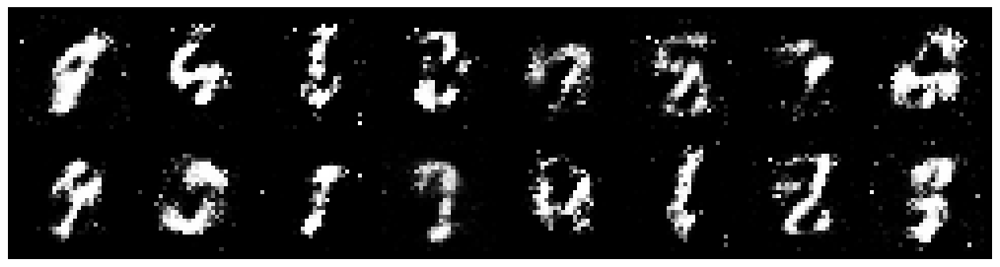

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.8443, Generator Loss: 1.7102
D(x): 0.7293, D(G(z)): 0.2920


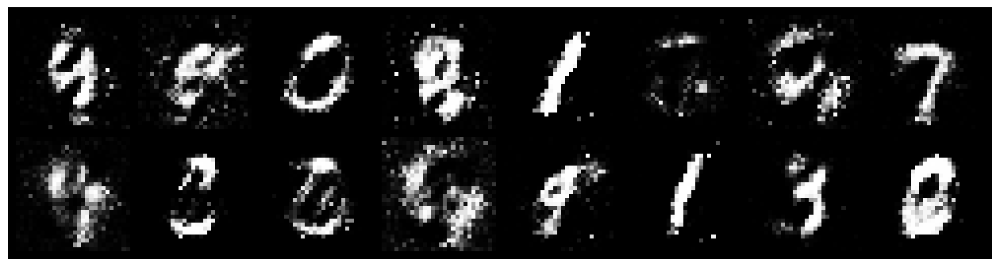

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.8784, Generator Loss: 2.3053
D(x): 0.7188, D(G(z)): 0.2523


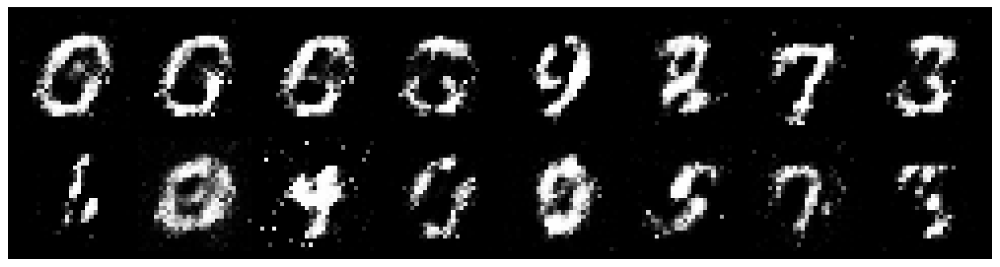

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.8635, Generator Loss: 1.6294
D(x): 0.7634, D(G(z)): 0.3222


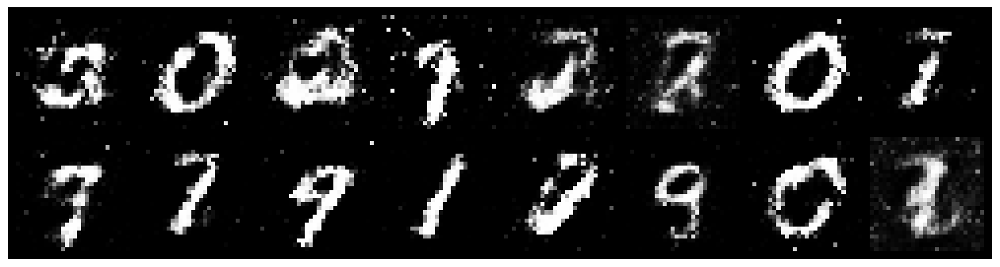

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.8666, Generator Loss: 2.1127
D(x): 0.6771, D(G(z)): 0.2419


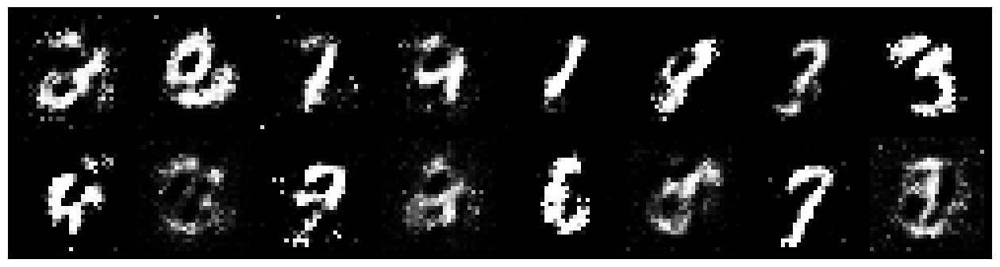

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.6393, Generator Loss: 2.5416
D(x): 0.7663, D(G(z)): 0.1759


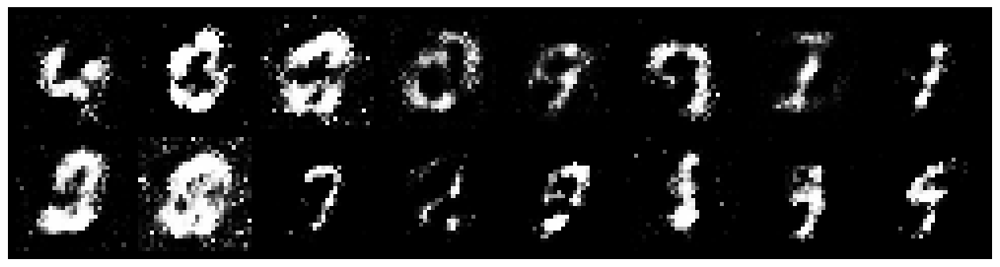

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.6079, Generator Loss: 2.1062
D(x): 0.8121, D(G(z)): 0.2126


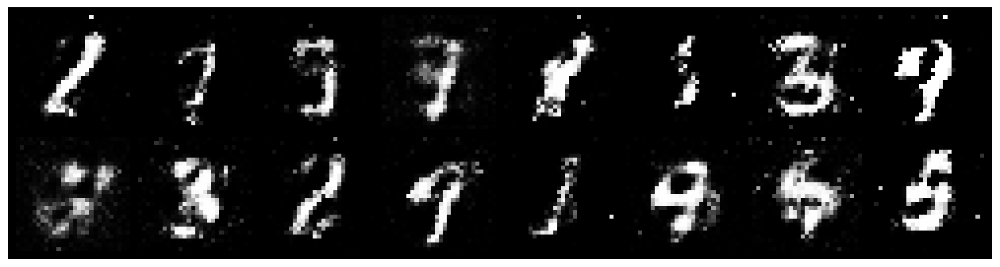

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.8425, Generator Loss: 1.7361
D(x): 0.7267, D(G(z)): 0.2470


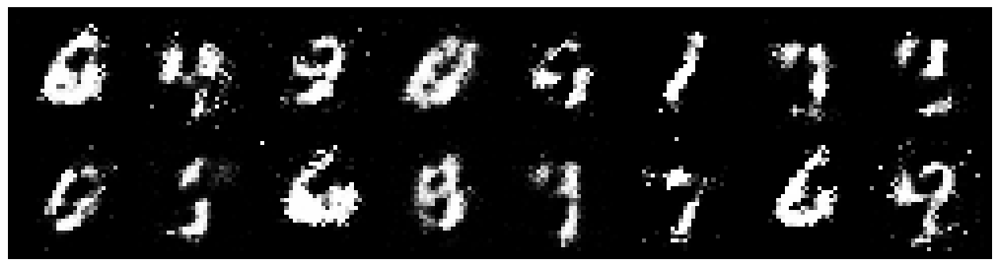

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.8735, Generator Loss: 2.0734
D(x): 0.6401, D(G(z)): 0.1806


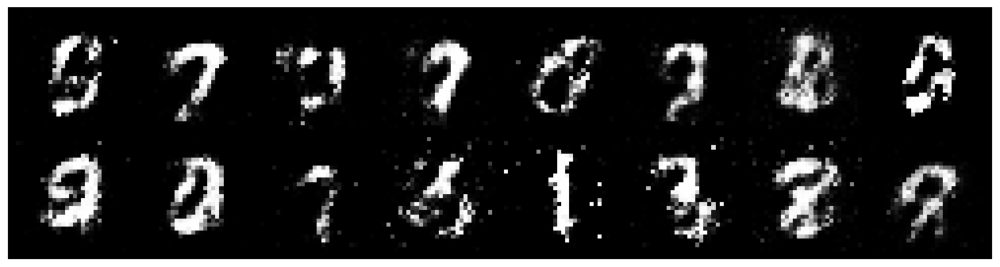

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.7417, Generator Loss: 1.6050
D(x): 0.7576, D(G(z)): 0.2763


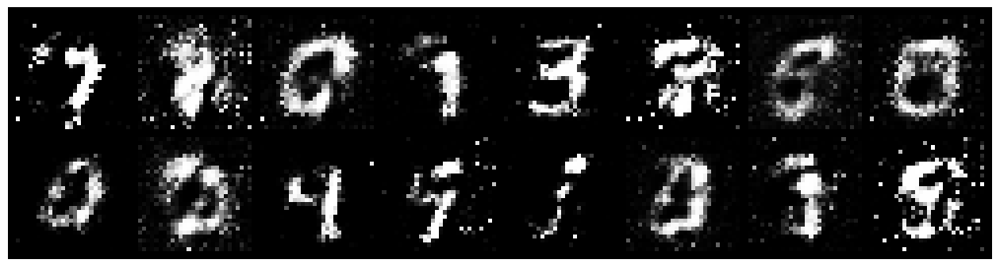

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.8683, Generator Loss: 1.5783
D(x): 0.7982, D(G(z)): 0.3762


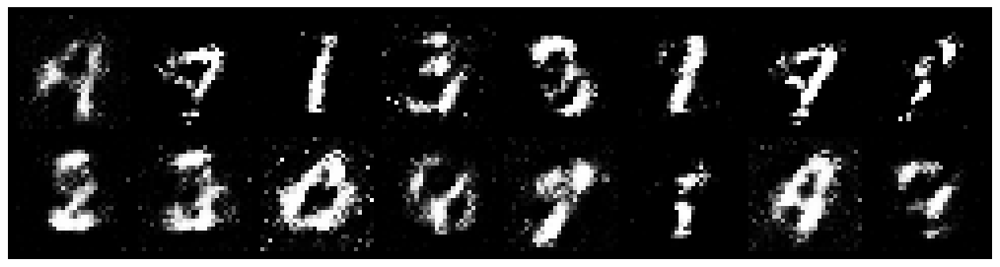

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 1.0342, Generator Loss: 1.2062
D(x): 0.6803, D(G(z)): 0.3573


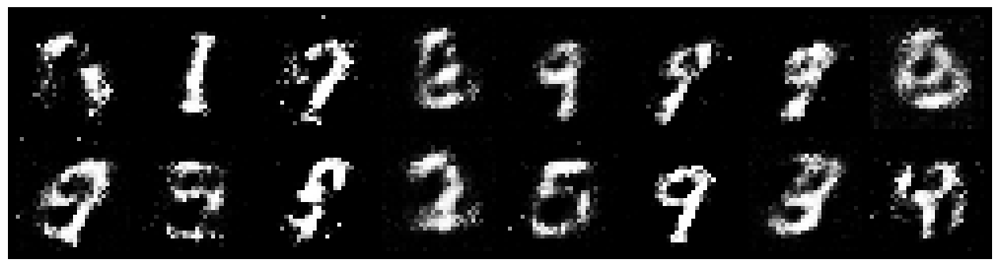

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.7649, Generator Loss: 1.5919
D(x): 0.7368, D(G(z)): 0.2863


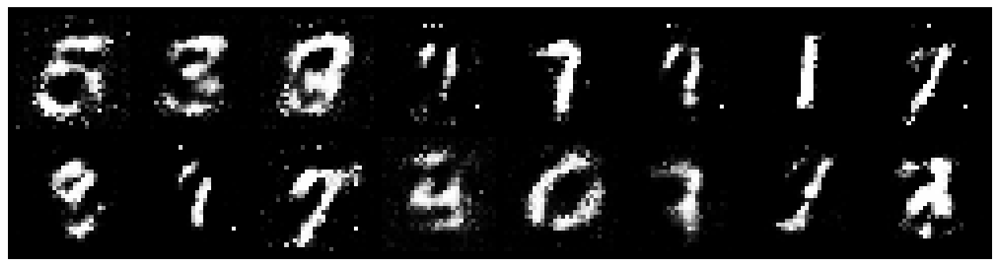

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 1.1678, Generator Loss: 1.3180
D(x): 0.7519, D(G(z)): 0.4158


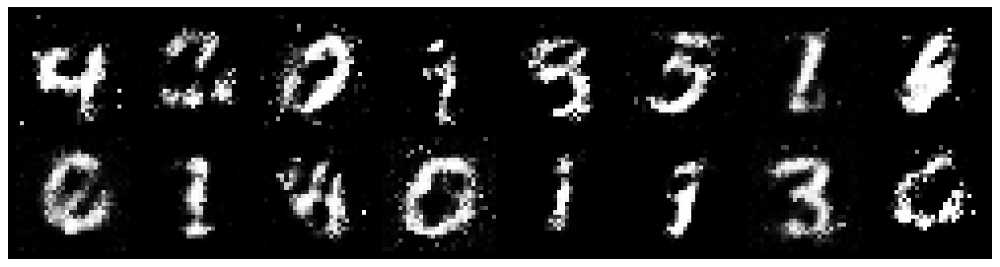

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 1.0428, Generator Loss: 1.4363
D(x): 0.6051, D(G(z)): 0.2442


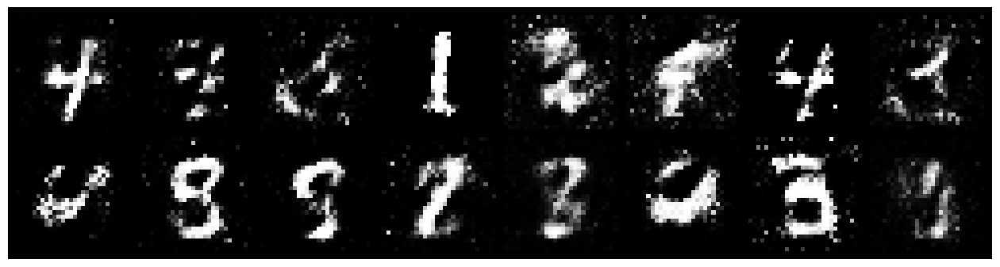

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.9383, Generator Loss: 1.8418
D(x): 0.6511, D(G(z)): 0.2202


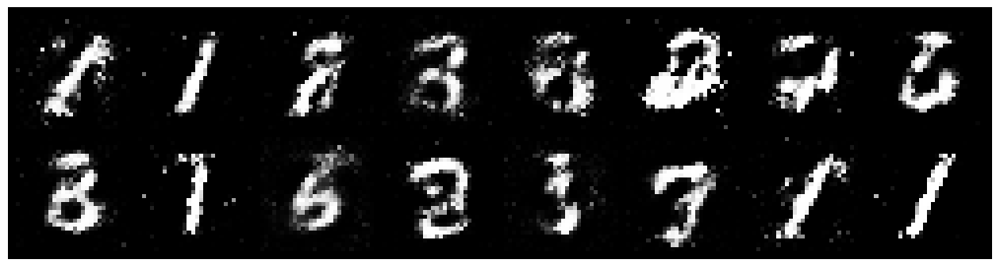

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 1.2532, Generator Loss: 1.9817
D(x): 0.6128, D(G(z)): 0.2758


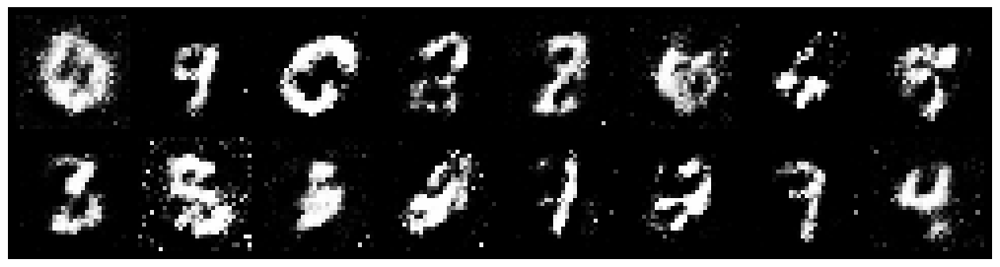

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.8788, Generator Loss: 1.8601
D(x): 0.7436, D(G(z)): 0.3216


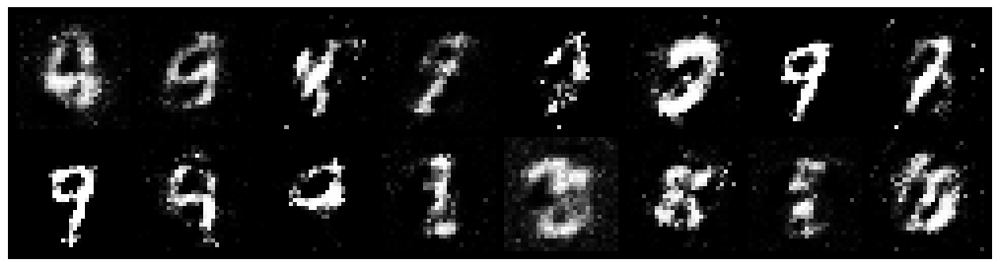

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 1.0462, Generator Loss: 1.9915
D(x): 0.7154, D(G(z)): 0.3323


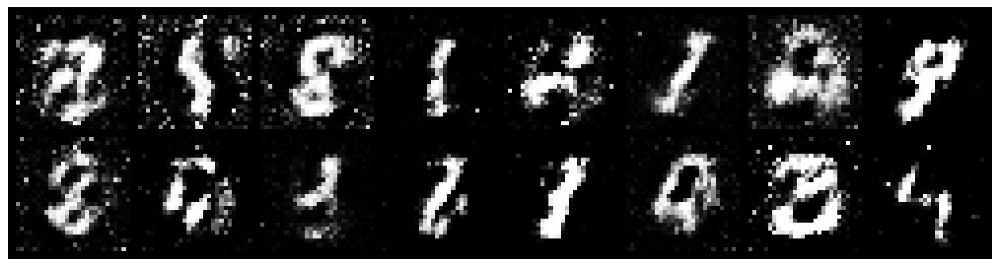

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.8996, Generator Loss: 1.5396
D(x): 0.6963, D(G(z)): 0.2970


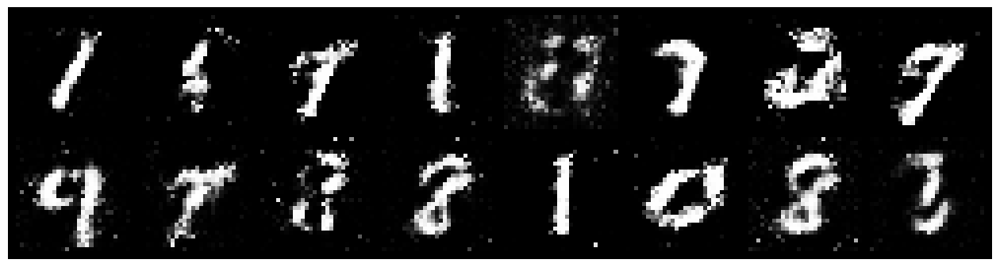

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.8564, Generator Loss: 1.5007
D(x): 0.6908, D(G(z)): 0.2997


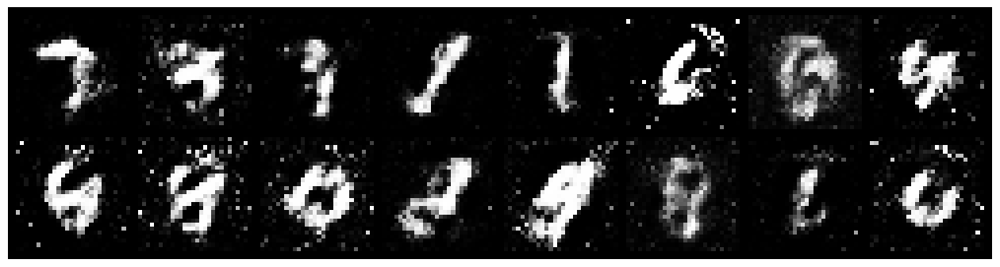

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8699, Generator Loss: 1.3349
D(x): 0.7021, D(G(z)): 0.3038


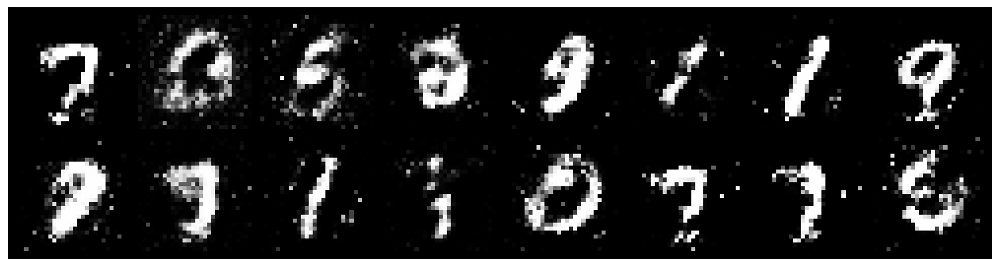

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.7830, Generator Loss: 1.9103
D(x): 0.7180, D(G(z)): 0.2501


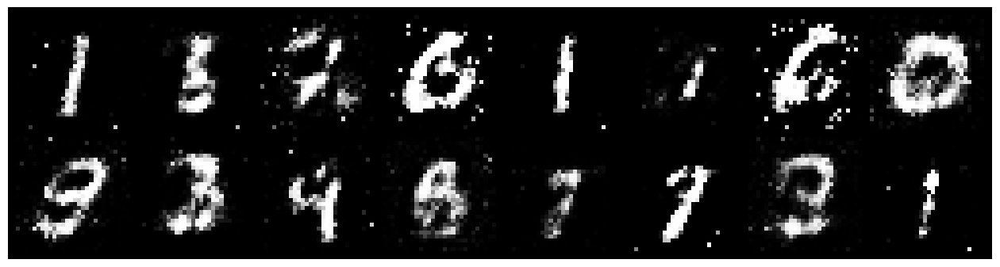

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.9735, Generator Loss: 1.5131
D(x): 0.7073, D(G(z)): 0.3477


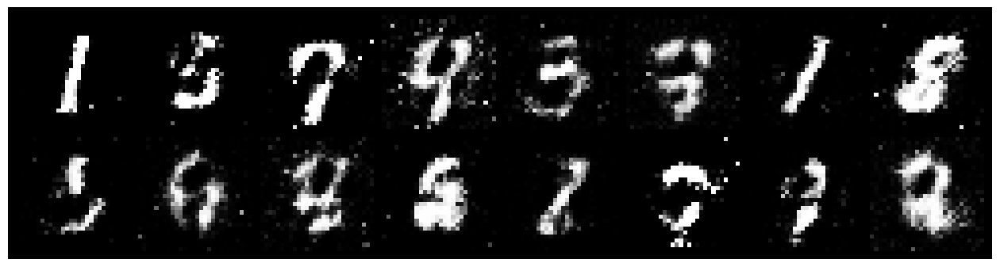

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 1.0045, Generator Loss: 1.5404
D(x): 0.6671, D(G(z)): 0.3254


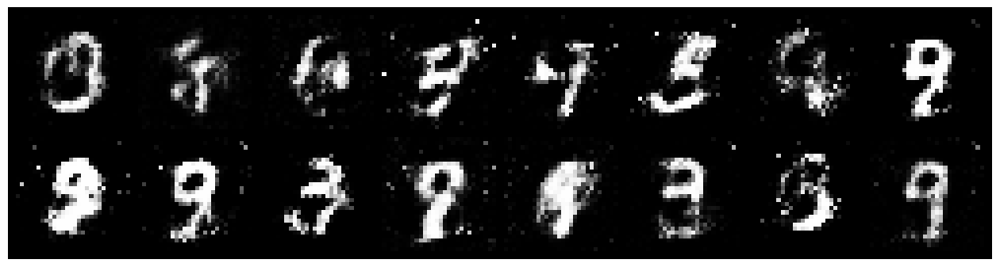

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.8516, Generator Loss: 1.5750
D(x): 0.6746, D(G(z)): 0.2587


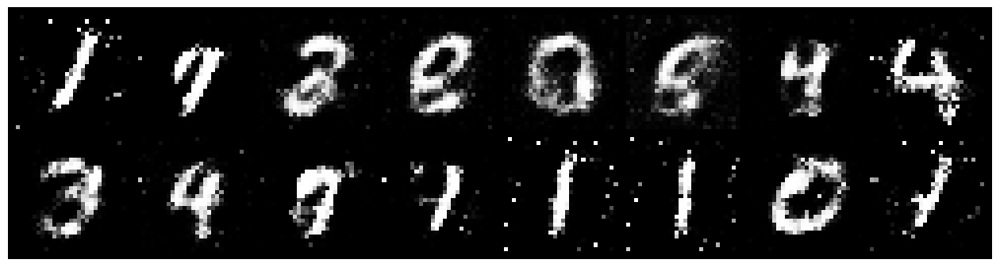

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.6815, Generator Loss: 1.6608
D(x): 0.8261, D(G(z)): 0.2919


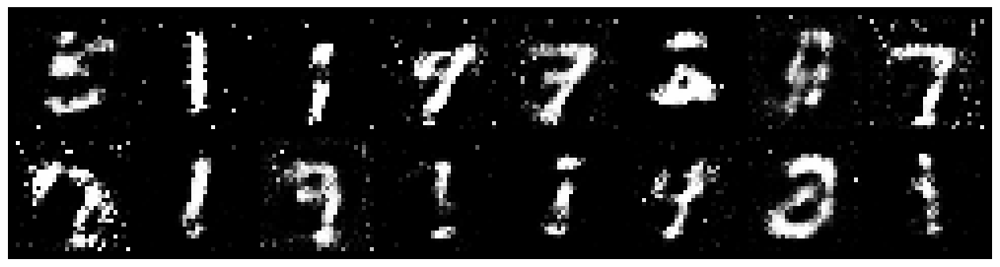

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.8702, Generator Loss: 1.3148
D(x): 0.6869, D(G(z)): 0.2716


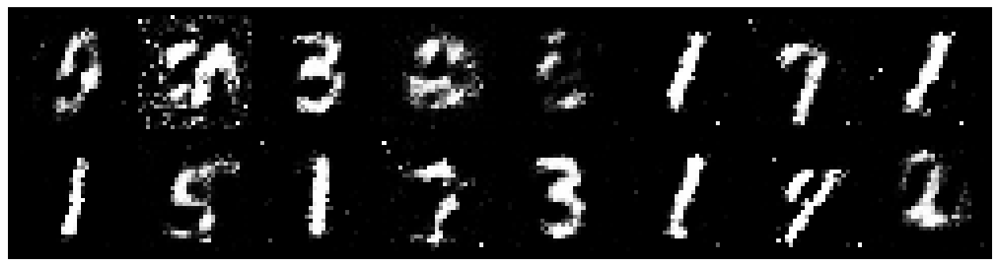

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.8431, Generator Loss: 1.1427
D(x): 0.7593, D(G(z)): 0.3574


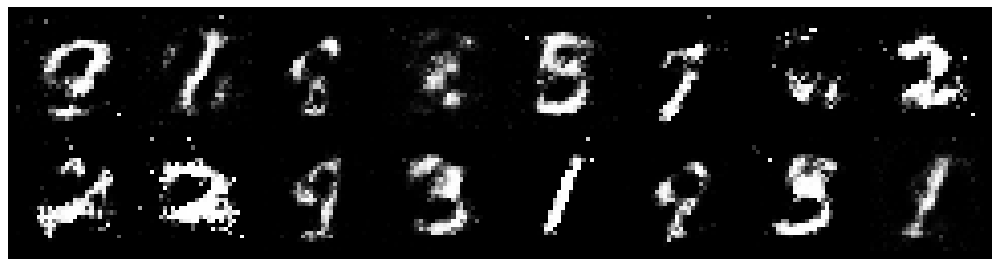

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.9634, Generator Loss: 1.6392
D(x): 0.7259, D(G(z)): 0.3399


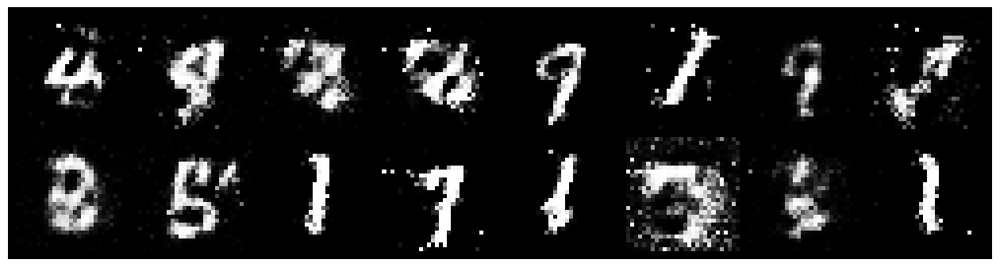

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 1.1088, Generator Loss: 1.4014
D(x): 0.5721, D(G(z)): 0.2851


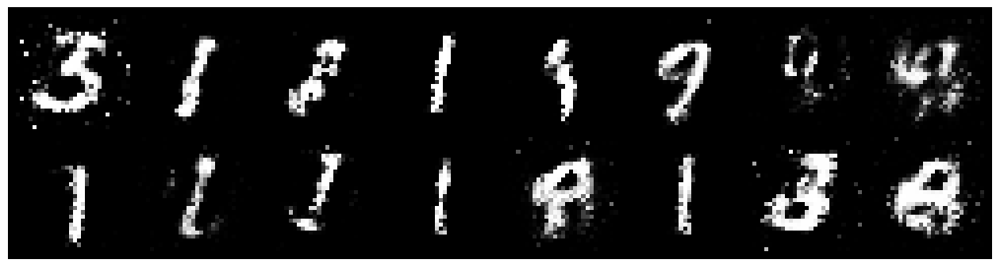

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 1.1084, Generator Loss: 1.1481
D(x): 0.6208, D(G(z)): 0.3913


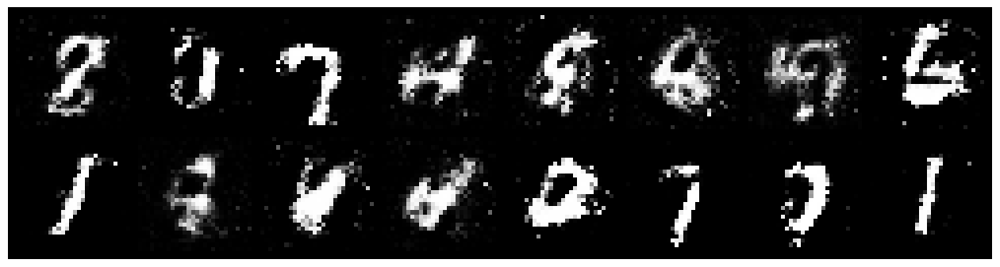

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.9535, Generator Loss: 1.5562
D(x): 0.6586, D(G(z)): 0.2539


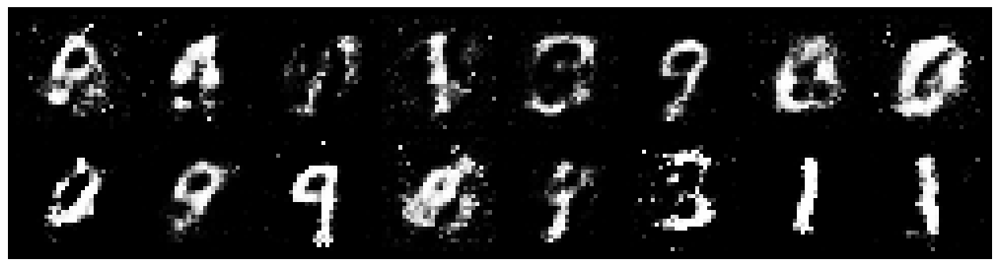

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 1.2233, Generator Loss: 1.5641
D(x): 0.5936, D(G(z)): 0.3478


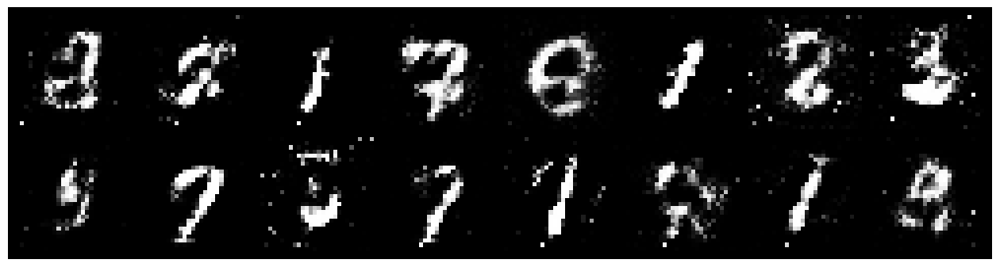

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.9368, Generator Loss: 1.3697
D(x): 0.6361, D(G(z)): 0.2592


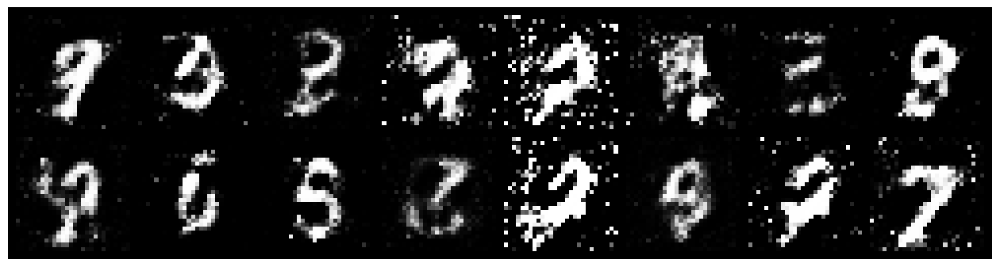

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9876, Generator Loss: 1.4127
D(x): 0.6844, D(G(z)): 0.3756


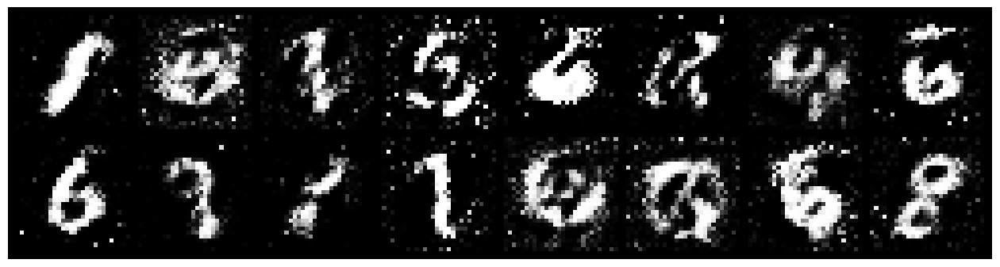

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.0408, Generator Loss: 1.3880
D(x): 0.7029, D(G(z)): 0.3885


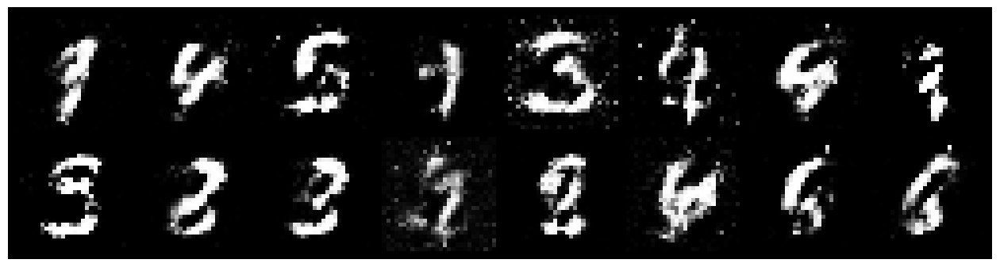

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.9983, Generator Loss: 1.2992
D(x): 0.6149, D(G(z)): 0.2694


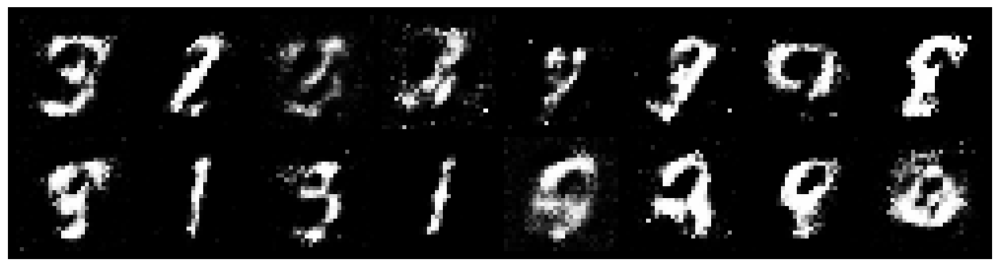

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.0488, Generator Loss: 1.5149
D(x): 0.6955, D(G(z)): 0.3377


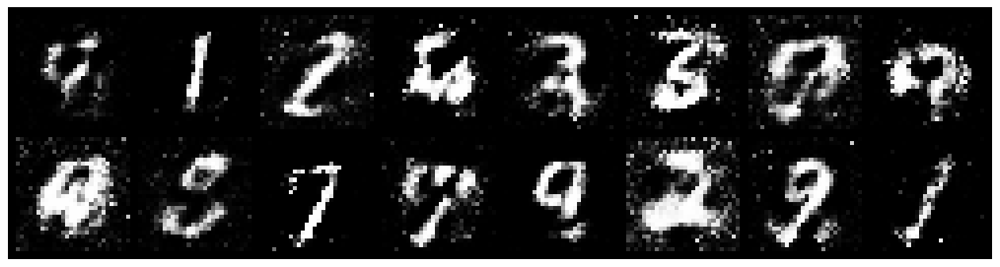

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 1.1543, Generator Loss: 1.2707
D(x): 0.7163, D(G(z)): 0.4252


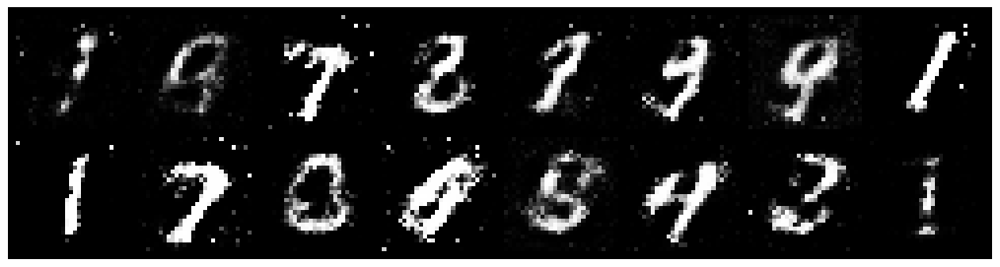

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.0996, Generator Loss: 1.2746
D(x): 0.6368, D(G(z)): 0.3169


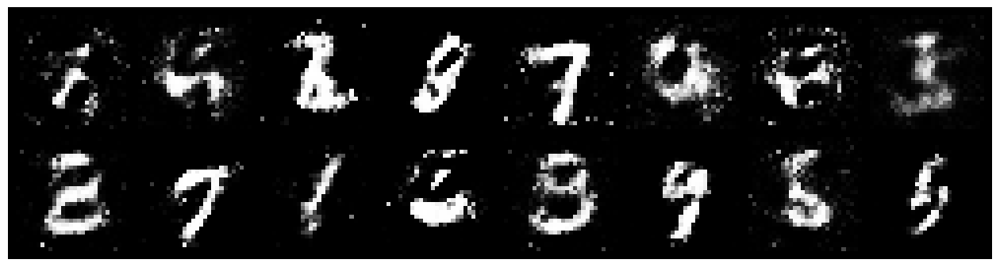

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.9844, Generator Loss: 1.9282
D(x): 0.6515, D(G(z)): 0.2726


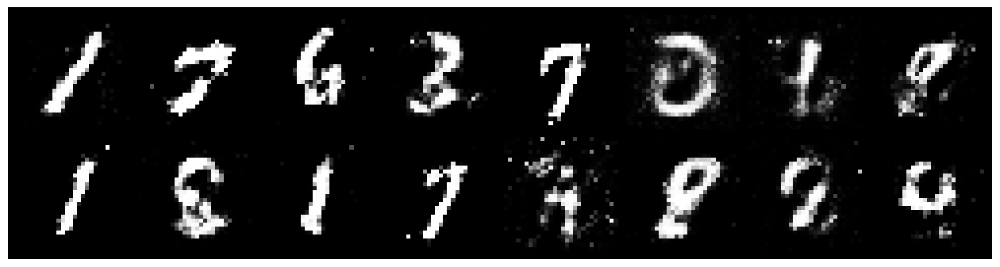

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.8341, Generator Loss: 1.9243
D(x): 0.6912, D(G(z)): 0.2074


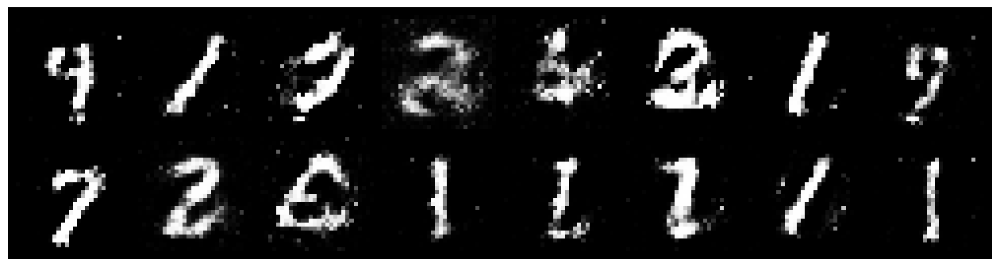

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 0.7212, Generator Loss: 1.6088
D(x): 0.7430, D(G(z)): 0.2298


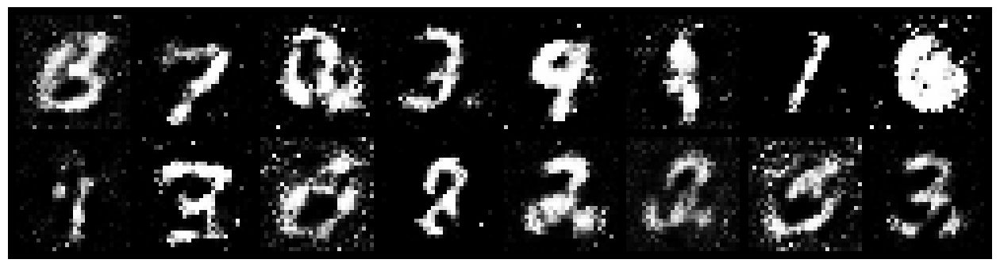

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.8594, Generator Loss: 1.6153
D(x): 0.7190, D(G(z)): 0.2957


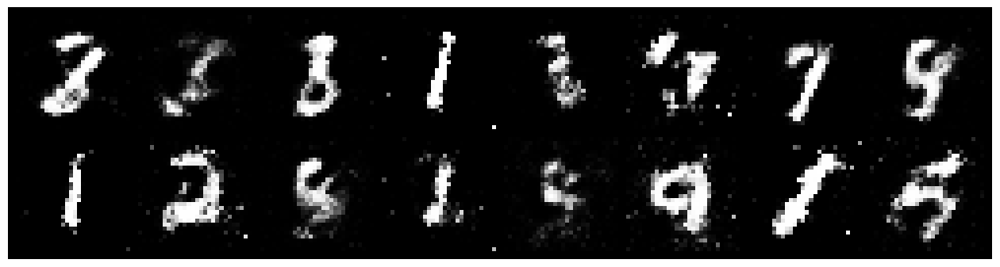

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.9480, Generator Loss: 1.6286
D(x): 0.6989, D(G(z)): 0.3049


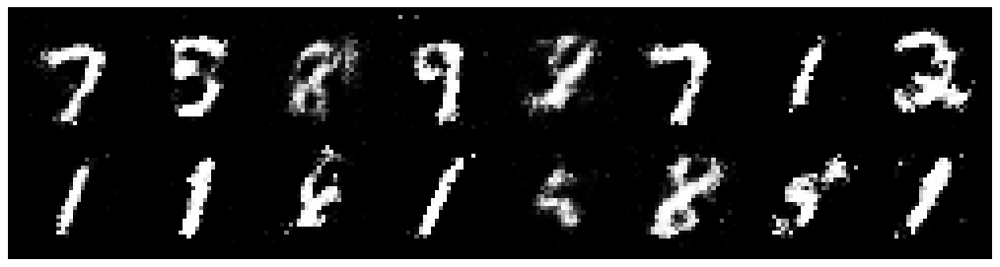

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.7429, Generator Loss: 1.5893
D(x): 0.7352, D(G(z)): 0.2609


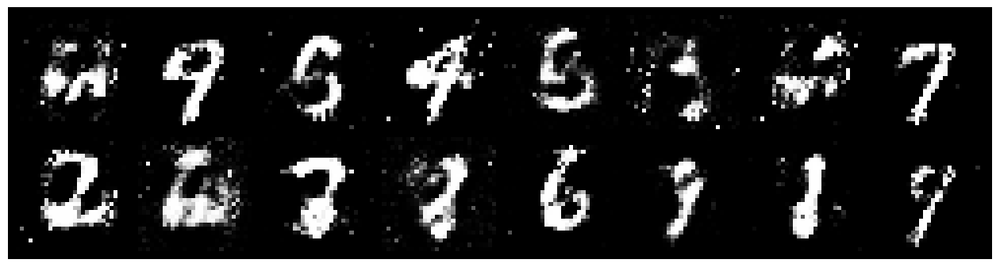

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.8814, Generator Loss: 1.4899
D(x): 0.6556, D(G(z)): 0.2670


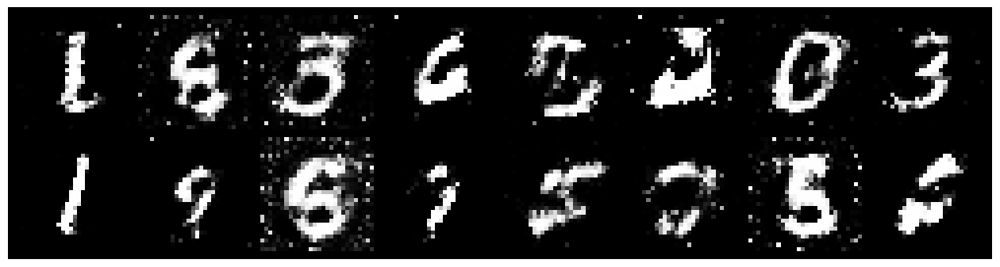

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.7499, Generator Loss: 1.6394
D(x): 0.7725, D(G(z)): 0.3048


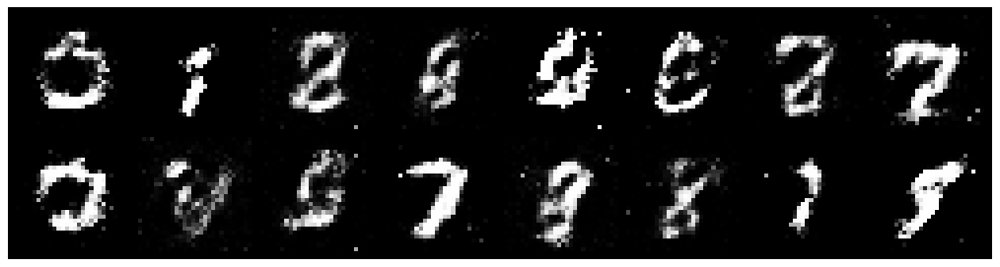

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.8399, Generator Loss: 1.2089
D(x): 0.7656, D(G(z)): 0.3492


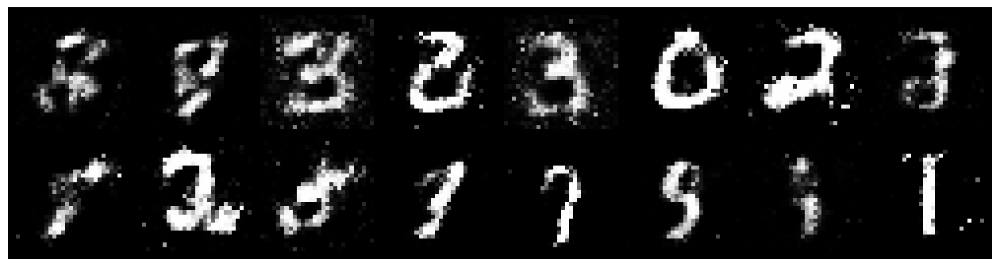

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.1139, Generator Loss: 1.0944
D(x): 0.6662, D(G(z)): 0.4215


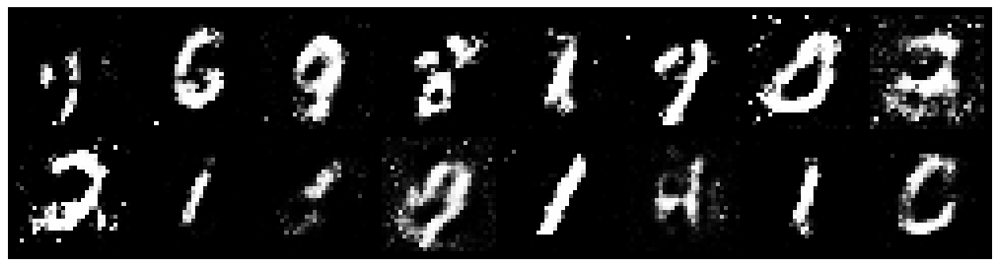

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.1094, Generator Loss: 1.6338
D(x): 0.7514, D(G(z)): 0.4109


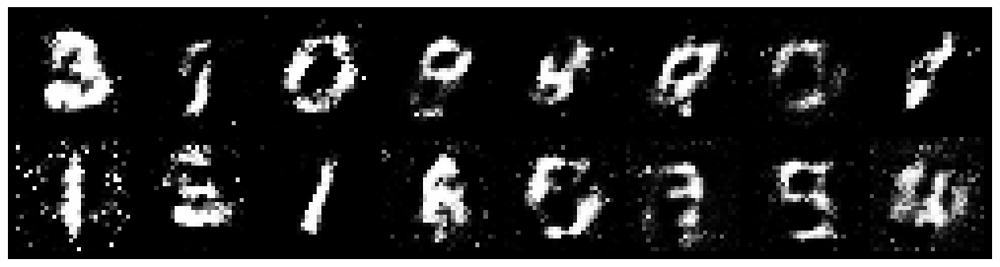

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 0.9871, Generator Loss: 1.6052
D(x): 0.6713, D(G(z)): 0.3314


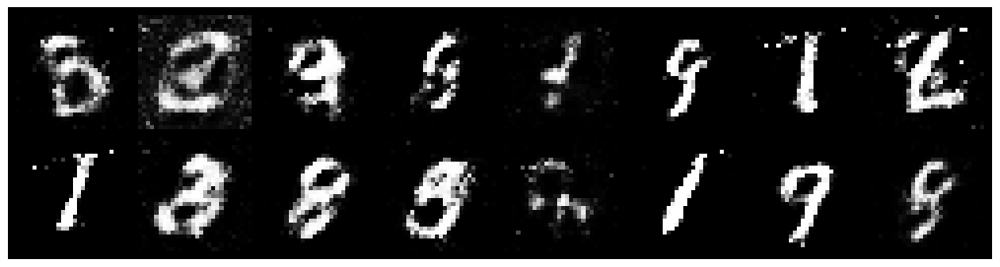

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.6737, Generator Loss: 1.6557
D(x): 0.7302, D(G(z)): 0.2299


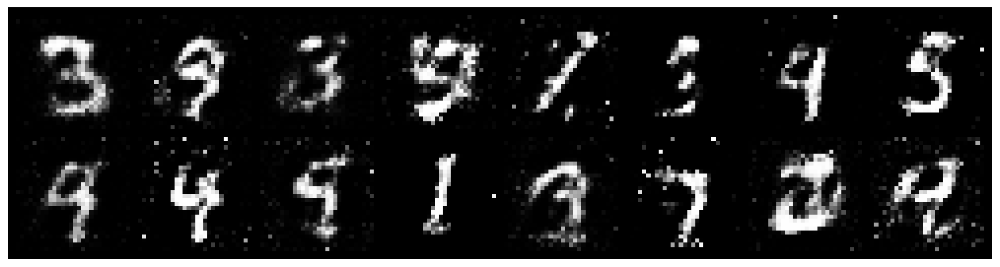

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.9921, Generator Loss: 1.4585
D(x): 0.7144, D(G(z)): 0.3405


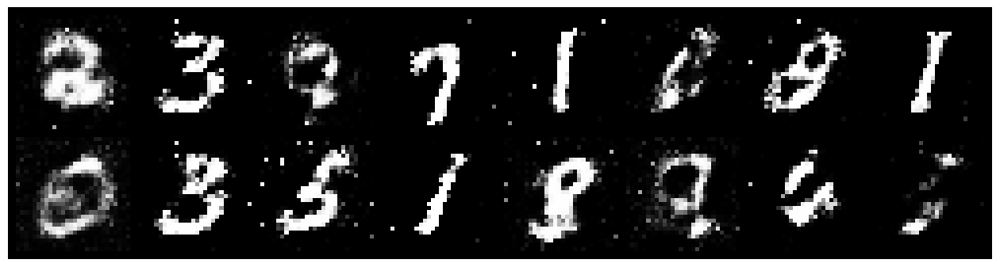

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.9365, Generator Loss: 1.2391
D(x): 0.6564, D(G(z)): 0.2874


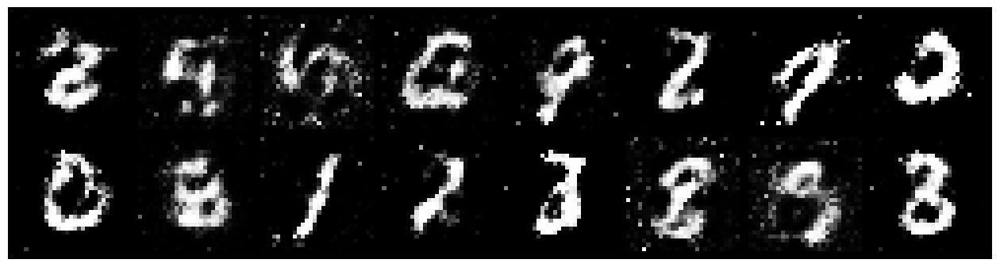

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.8435, Generator Loss: 1.6873
D(x): 0.6850, D(G(z)): 0.2648


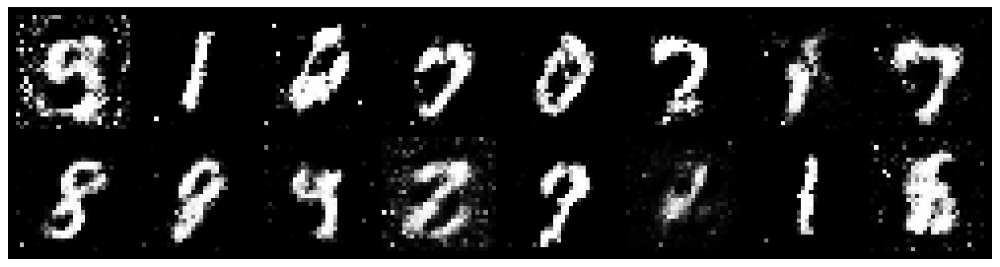

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.1159, Generator Loss: 1.9216
D(x): 0.6911, D(G(z)): 0.3348


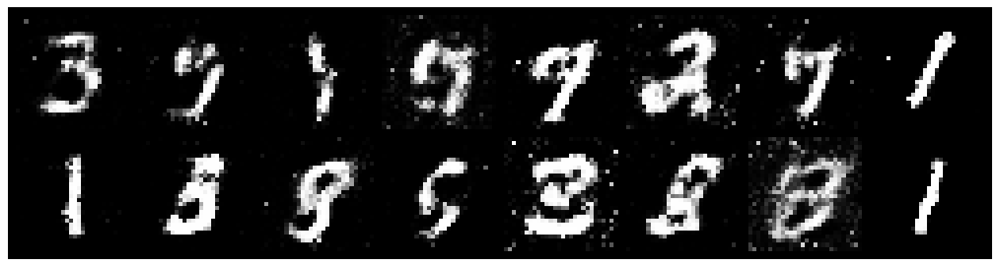

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.0939, Generator Loss: 1.3907
D(x): 0.6211, D(G(z)): 0.3223


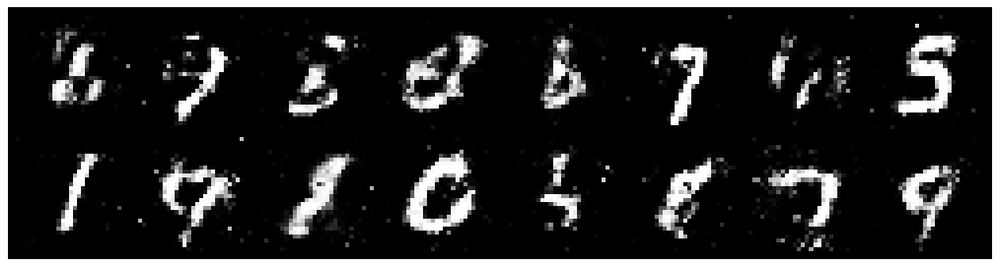

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 1.1773, Generator Loss: 1.3655
D(x): 0.6125, D(G(z)): 0.3778


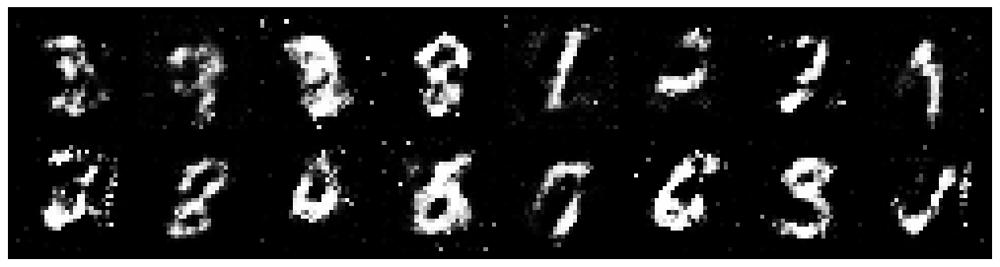

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 1.0505, Generator Loss: 1.8775
D(x): 0.6520, D(G(z)): 0.3016


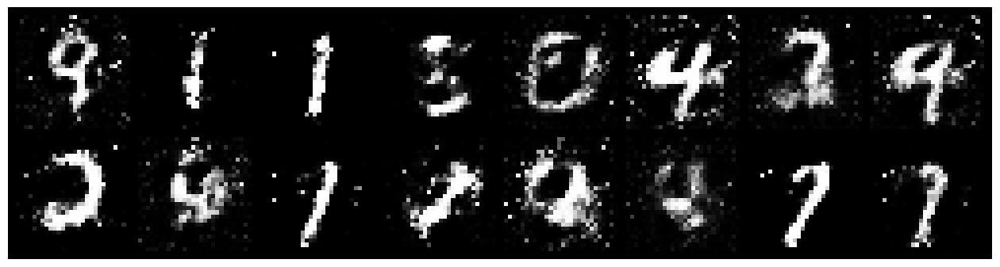

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.8955, Generator Loss: 1.5221
D(x): 0.7083, D(G(z)): 0.3107


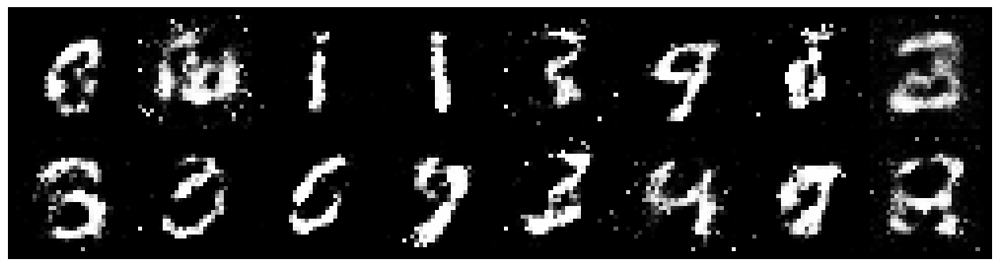

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 1.0852, Generator Loss: 1.9027
D(x): 0.7194, D(G(z)): 0.3469


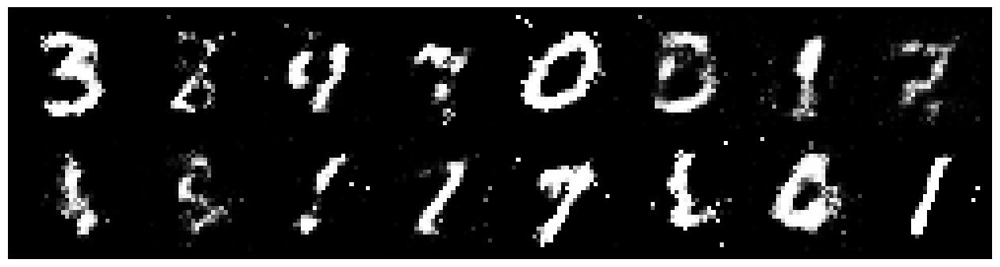

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.9442, Generator Loss: 1.7160
D(x): 0.7127, D(G(z)): 0.3239


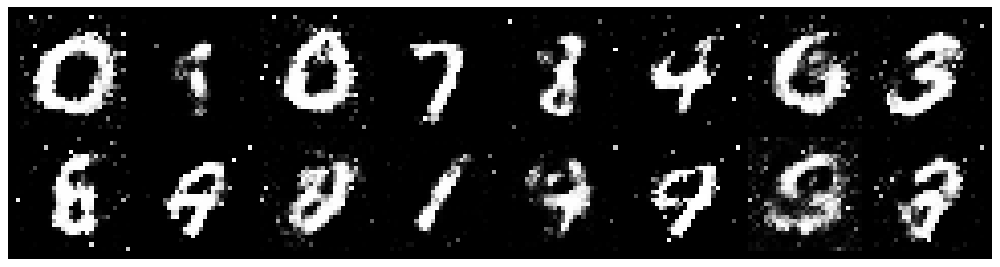

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 1.0965, Generator Loss: 1.3109
D(x): 0.6554, D(G(z)): 0.3873


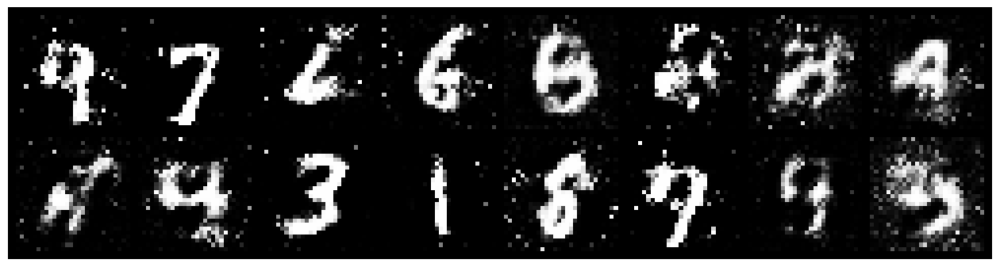

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 1.2370, Generator Loss: 0.9951
D(x): 0.6096, D(G(z)): 0.4222


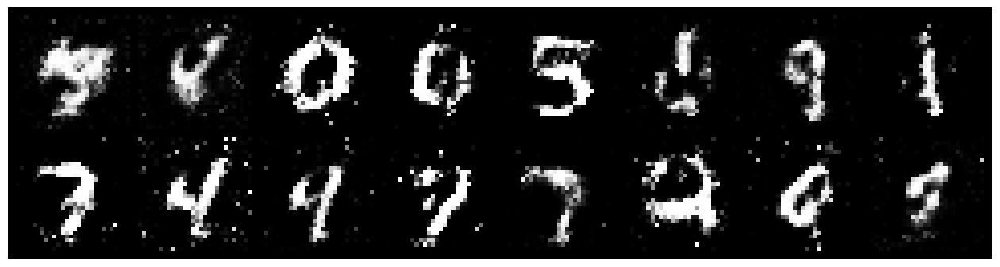

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.1524, Generator Loss: 1.2833
D(x): 0.5824, D(G(z)): 0.3353


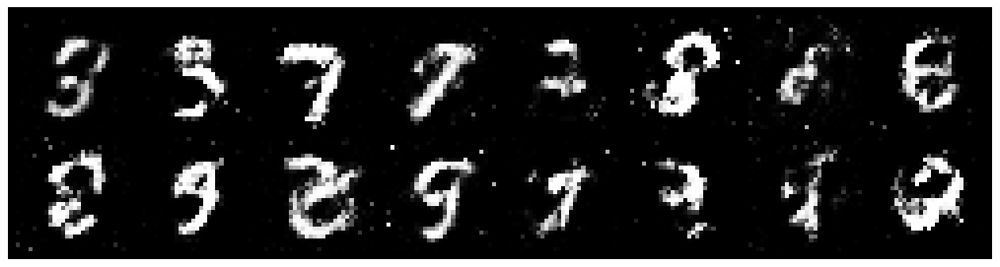

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 1.0497, Generator Loss: 1.2395
D(x): 0.6906, D(G(z)): 0.3214


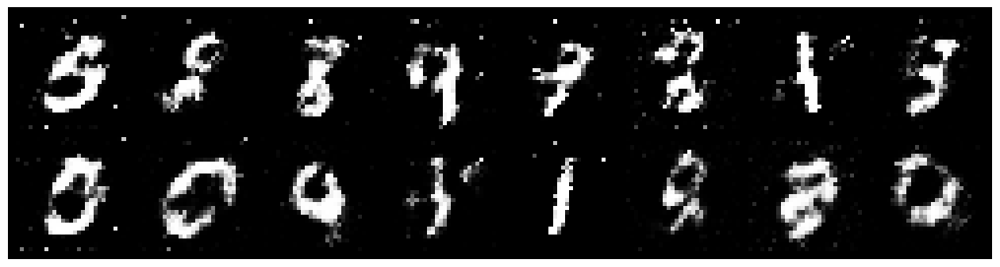

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.1828, Generator Loss: 1.4180
D(x): 0.5897, D(G(z)): 0.3201


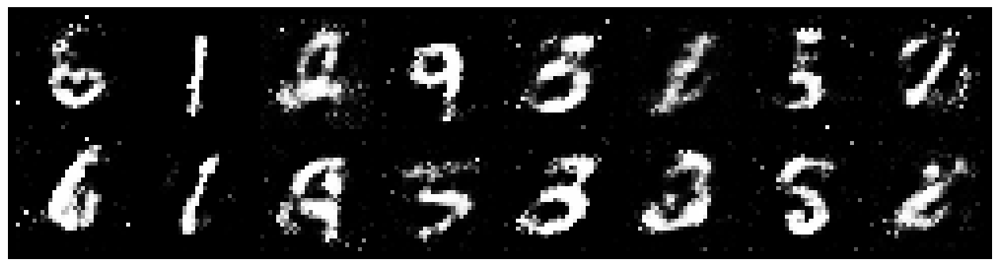

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.0176, Generator Loss: 1.8428
D(x): 0.7125, D(G(z)): 0.3567


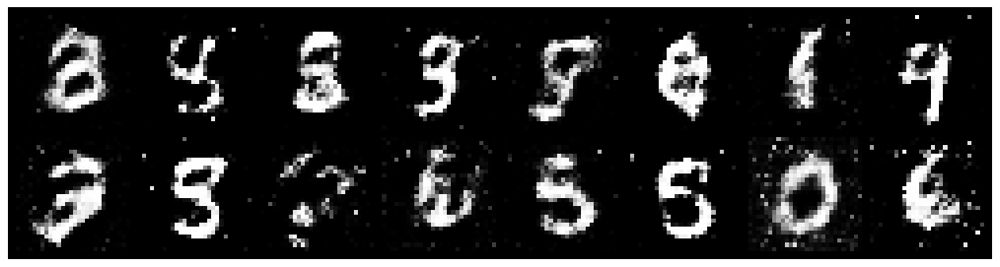

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.9505, Generator Loss: 1.4069
D(x): 0.7153, D(G(z)): 0.3621


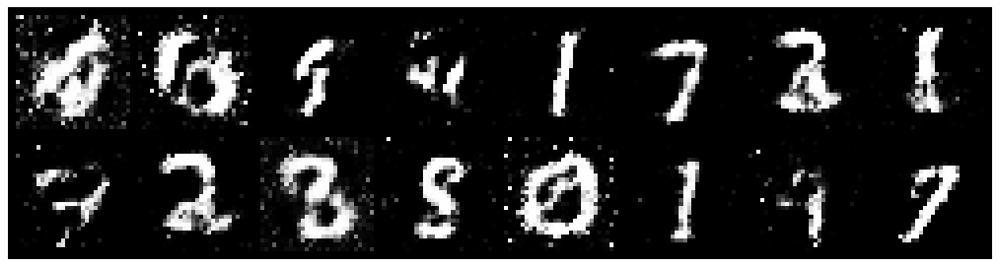

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.1684, Generator Loss: 1.0817
D(x): 0.6348, D(G(z)): 0.3757


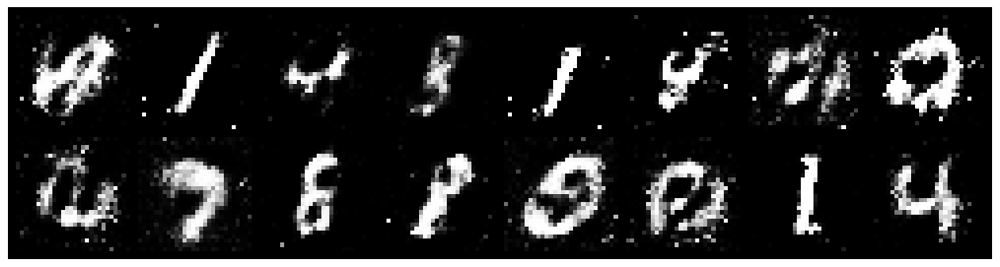

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.1489, Generator Loss: 1.3875
D(x): 0.6359, D(G(z)): 0.3650


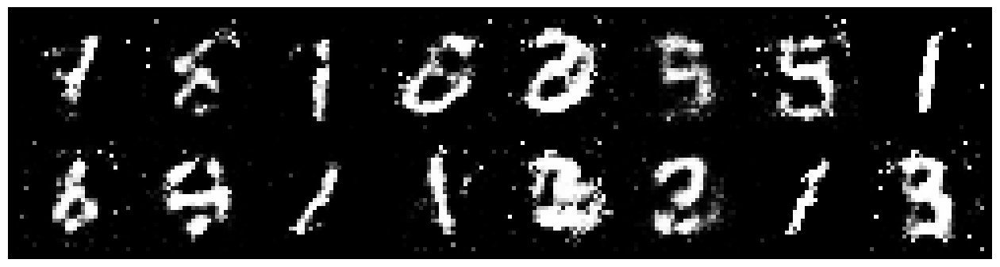

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 1.0272, Generator Loss: 1.4844
D(x): 0.6516, D(G(z)): 0.3353


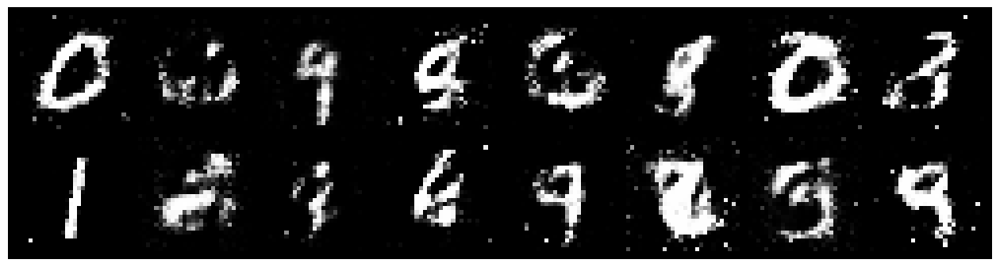

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.8908, Generator Loss: 1.3701
D(x): 0.6705, D(G(z)): 0.2860


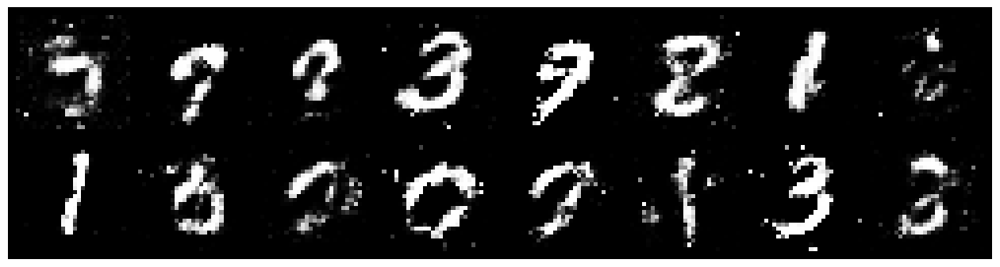

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 0.9856, Generator Loss: 1.2994
D(x): 0.6349, D(G(z)): 0.3181


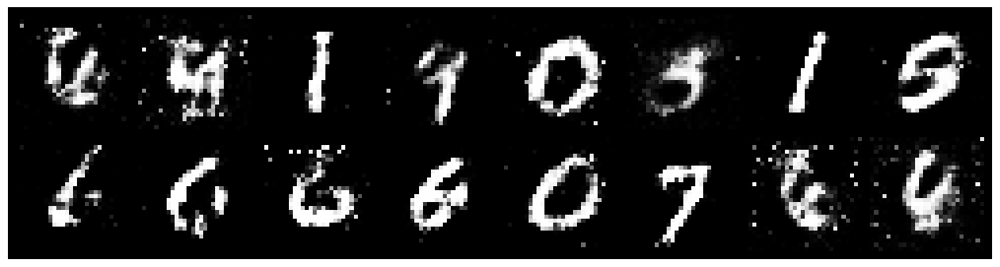

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 0.8700, Generator Loss: 1.4223
D(x): 0.6827, D(G(z)): 0.2829


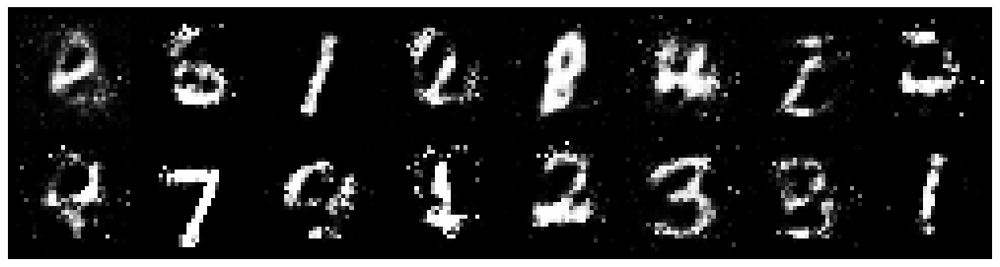

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.0477, Generator Loss: 1.4613
D(x): 0.5796, D(G(z)): 0.2930


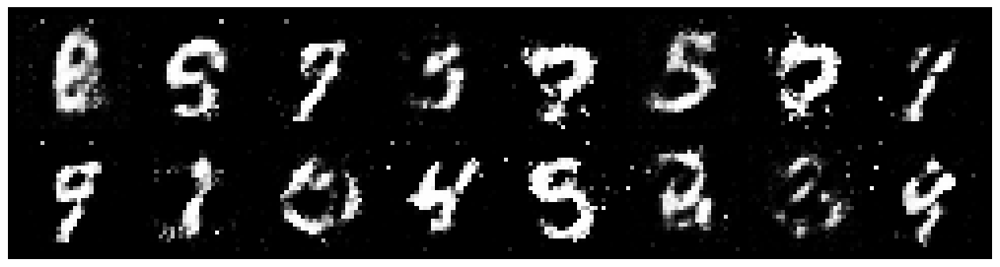

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 0.9141, Generator Loss: 1.2400
D(x): 0.7066, D(G(z)): 0.3317


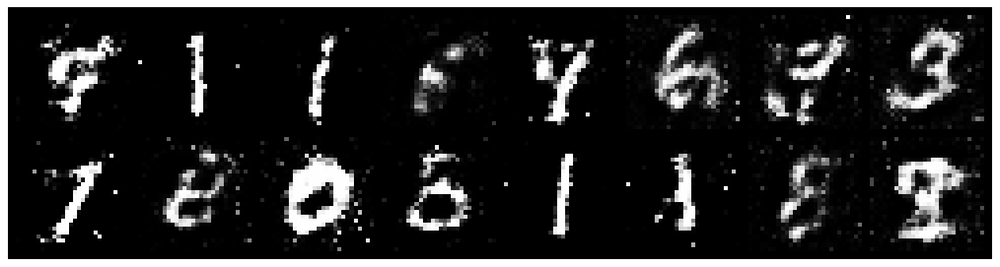

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 0.9193, Generator Loss: 1.6867
D(x): 0.6687, D(G(z)): 0.2889


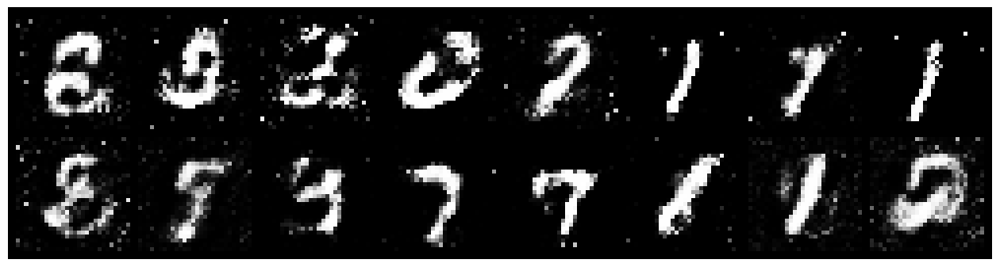

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.0246, Generator Loss: 1.0475
D(x): 0.6564, D(G(z)): 0.3719


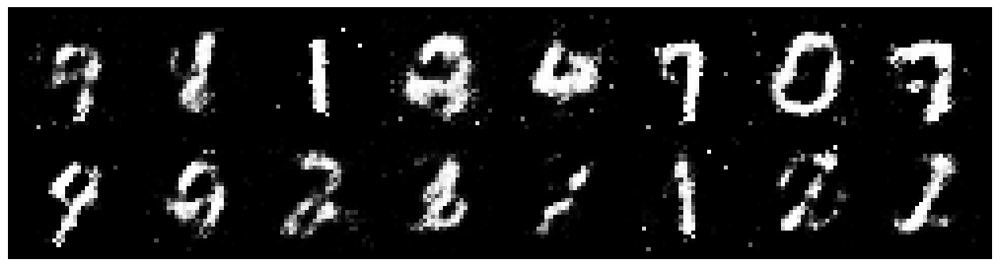

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 0.9072, Generator Loss: 1.2031
D(x): 0.7125, D(G(z)): 0.3752


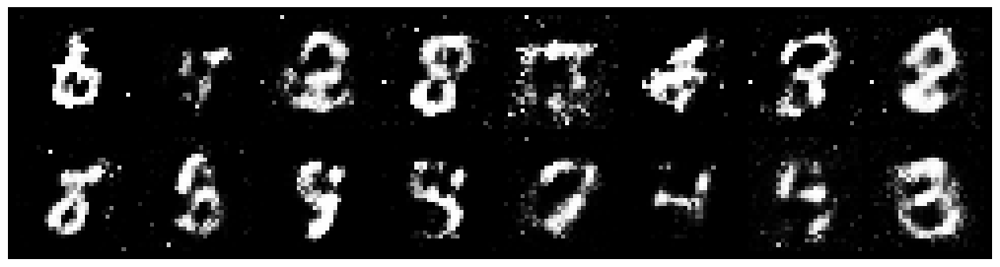

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.0222, Generator Loss: 0.9959
D(x): 0.6634, D(G(z)): 0.4097


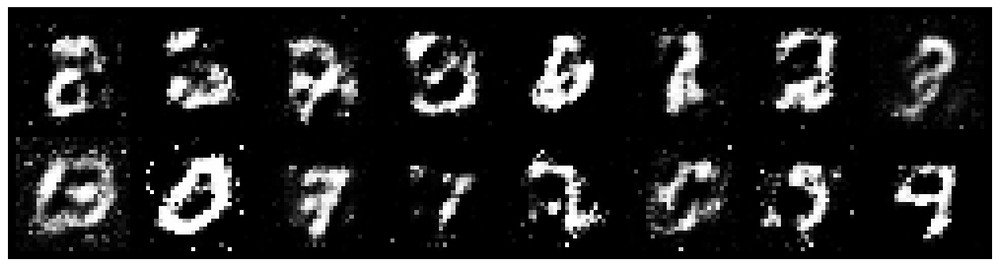

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.1009, Generator Loss: 0.9433
D(x): 0.6879, D(G(z)): 0.4409


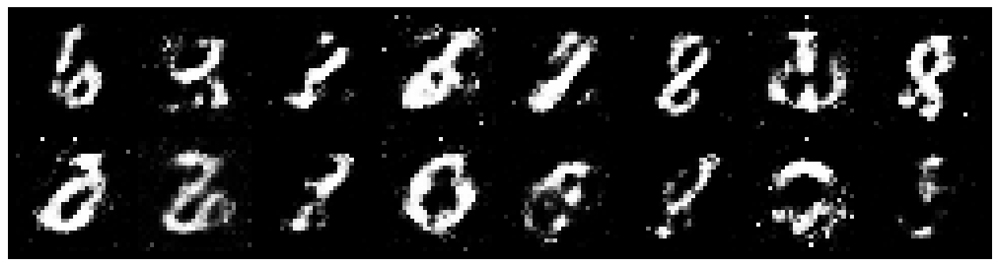

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.0889, Generator Loss: 1.0306
D(x): 0.6343, D(G(z)): 0.4052


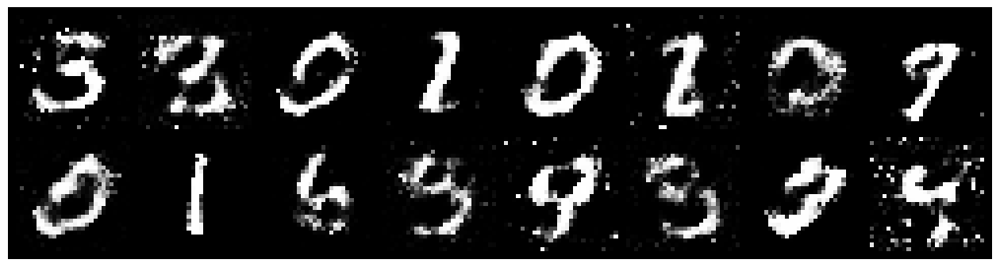

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.1958, Generator Loss: 1.1529
D(x): 0.5735, D(G(z)): 0.3360


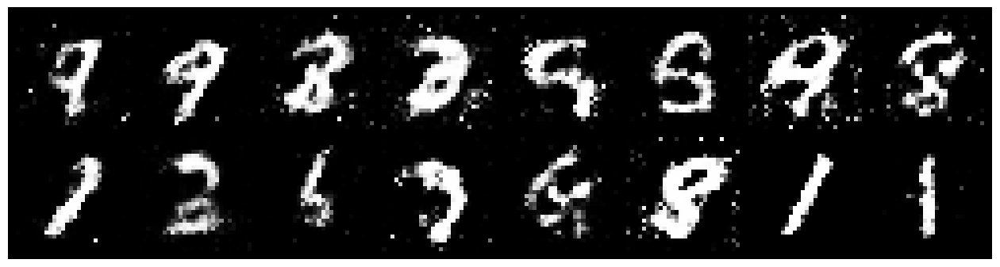

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 0.9396, Generator Loss: 1.4048
D(x): 0.6910, D(G(z)): 0.3044


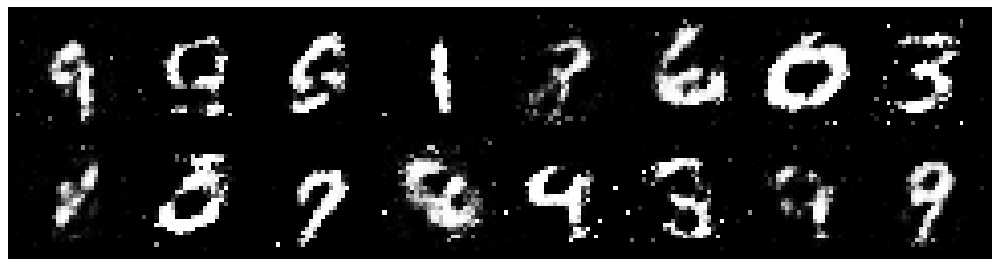

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.0773, Generator Loss: 1.2085
D(x): 0.6315, D(G(z)): 0.3615


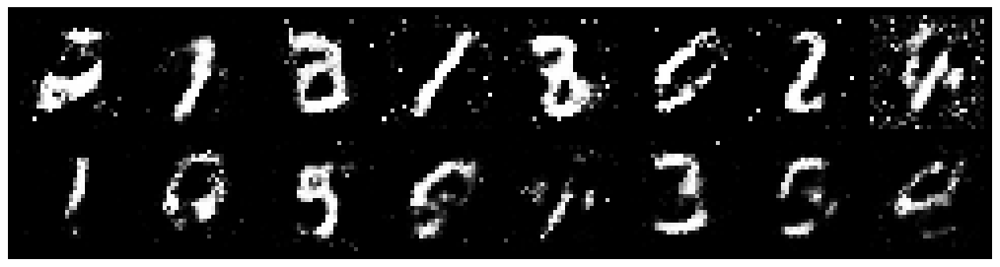

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 0.8605, Generator Loss: 1.3010
D(x): 0.7268, D(G(z)): 0.3365


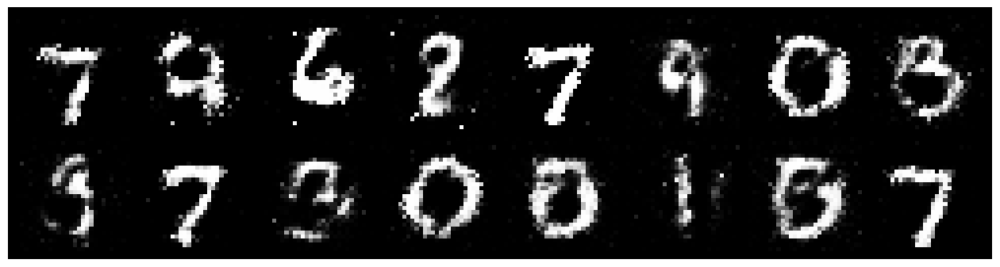

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.0817, Generator Loss: 1.0170
D(x): 0.6744, D(G(z)): 0.3886


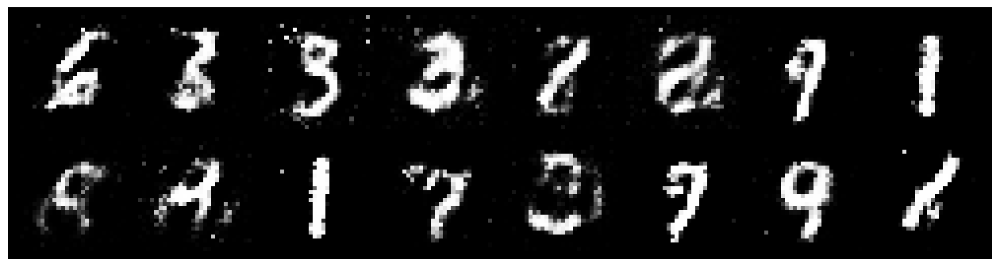

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 0.9042, Generator Loss: 1.4629
D(x): 0.6249, D(G(z)): 0.2387


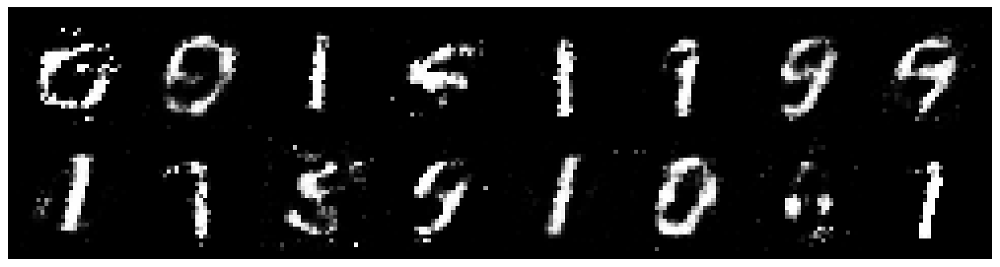

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.1159, Generator Loss: 1.2036
D(x): 0.6690, D(G(z)): 0.4045


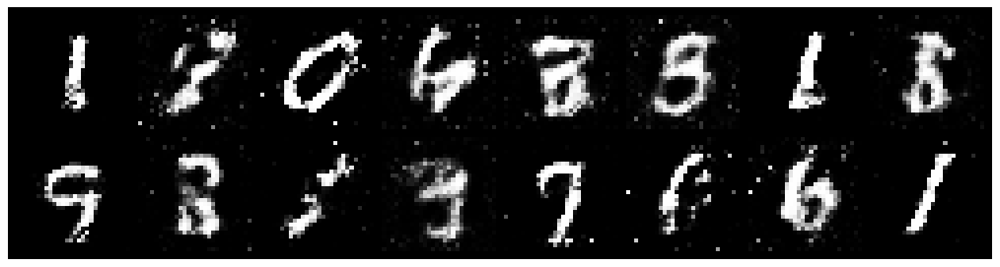

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.9628, Generator Loss: 1.4384
D(x): 0.6883, D(G(z)): 0.3183


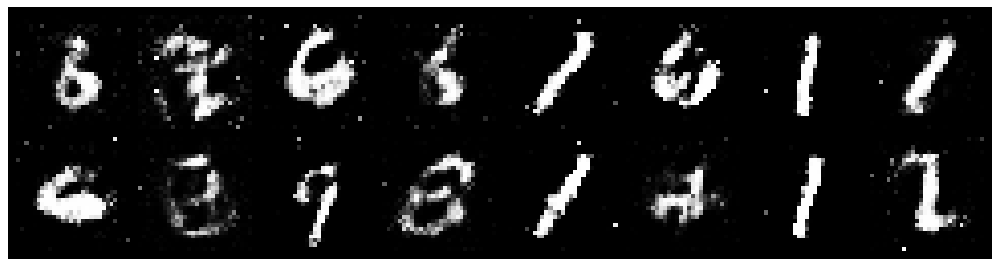

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 0.9802, Generator Loss: 1.3249
D(x): 0.6799, D(G(z)): 0.3242


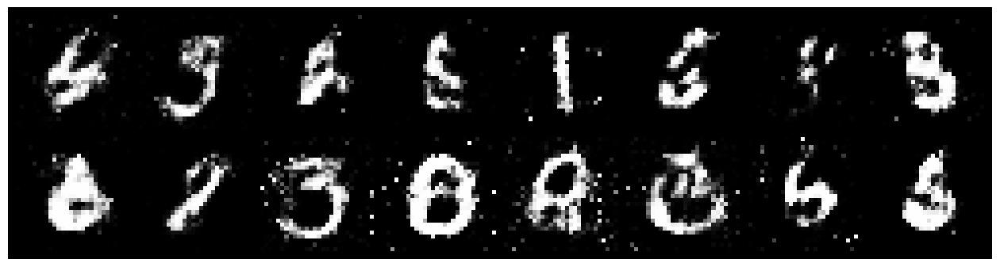

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.0395, Generator Loss: 1.0164
D(x): 0.6640, D(G(z)): 0.4018


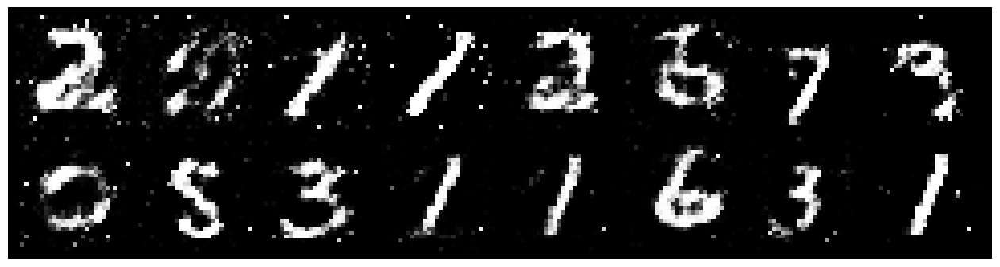

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.0712, Generator Loss: 1.1692
D(x): 0.6911, D(G(z)): 0.4073


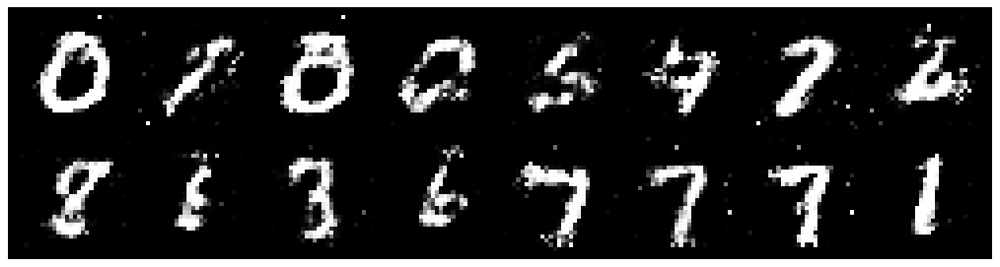

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 0.9902, Generator Loss: 1.2769
D(x): 0.6427, D(G(z)): 0.3330


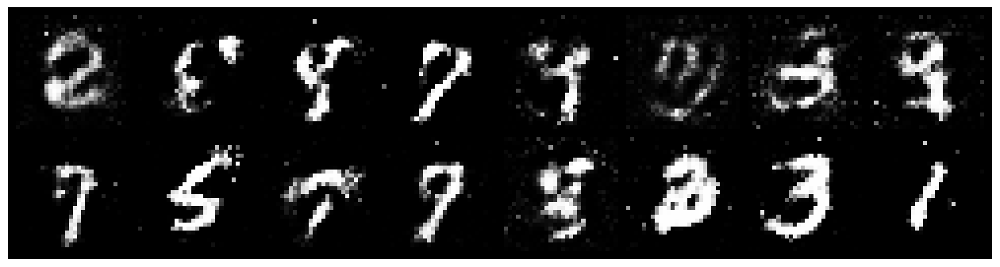

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.1040, Generator Loss: 1.2884
D(x): 0.5985, D(G(z)): 0.3654


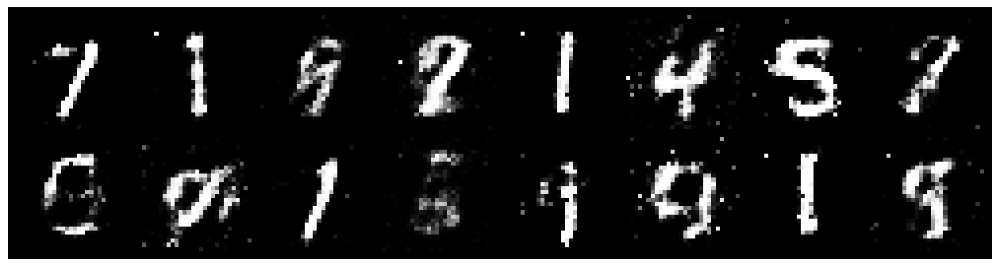

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 0.9728, Generator Loss: 1.3378
D(x): 0.6230, D(G(z)): 0.3216


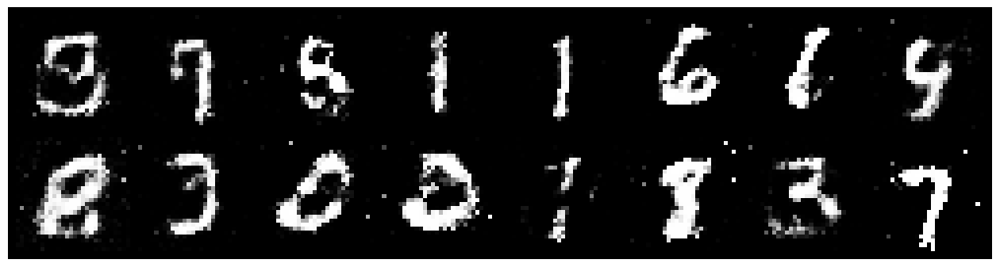

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.1192, Generator Loss: 1.1050
D(x): 0.6160, D(G(z)): 0.3941


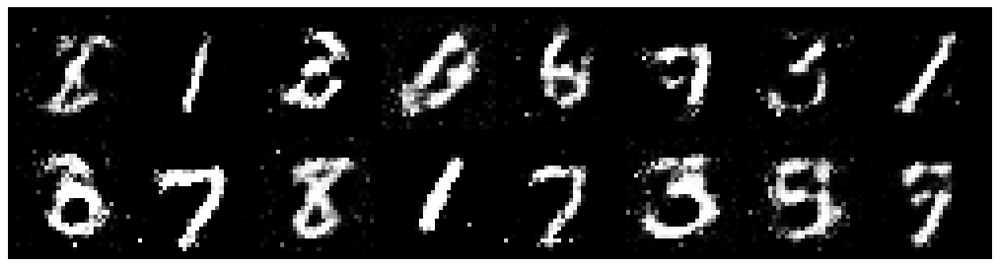

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.3174, Generator Loss: 1.0213
D(x): 0.5667, D(G(z)): 0.4438


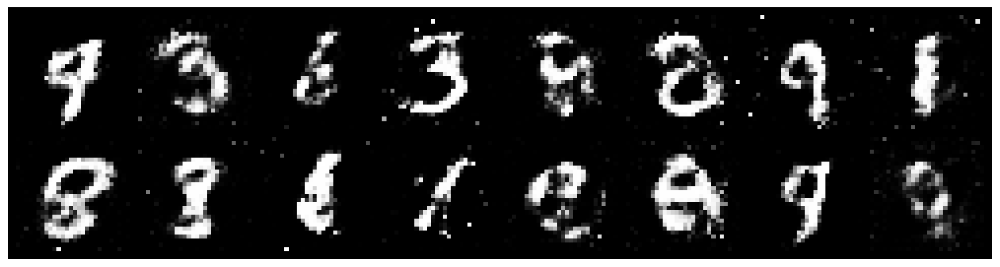

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 0.8039, Generator Loss: 1.2250
D(x): 0.6790, D(G(z)): 0.2705


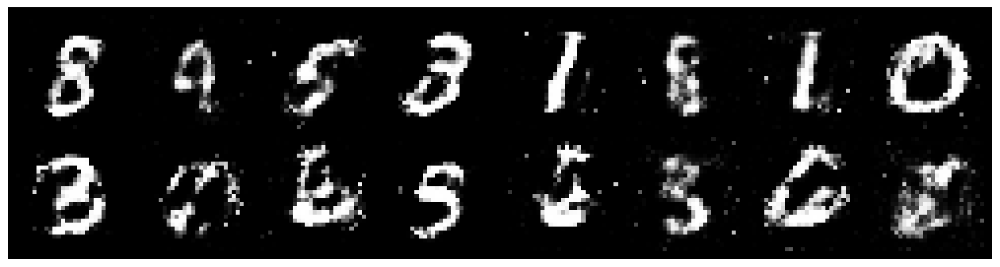

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.0172, Generator Loss: 1.5462
D(x): 0.6078, D(G(z)): 0.2621


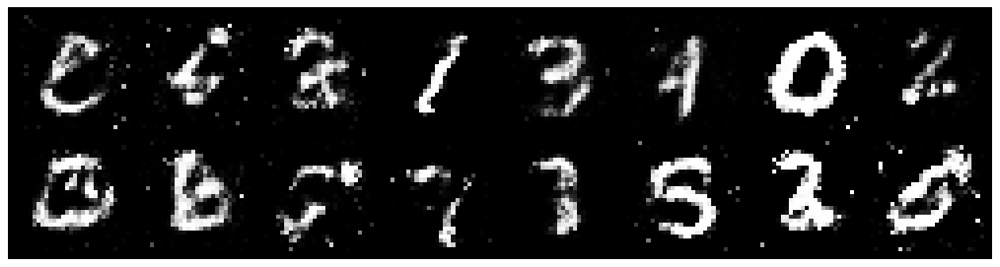

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.1372, Generator Loss: 1.4510
D(x): 0.5746, D(G(z)): 0.3182


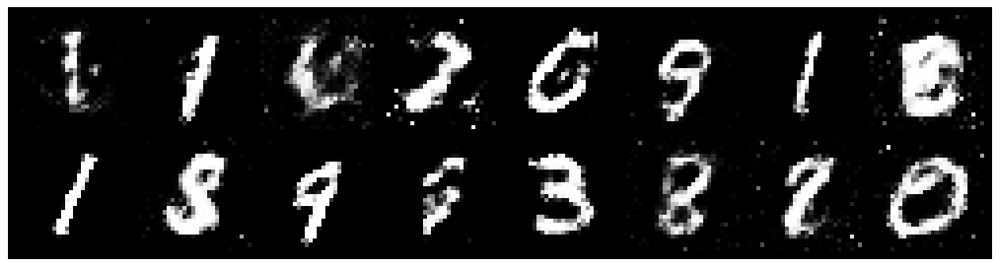

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 0.9338, Generator Loss: 1.6379
D(x): 0.7304, D(G(z)): 0.3378


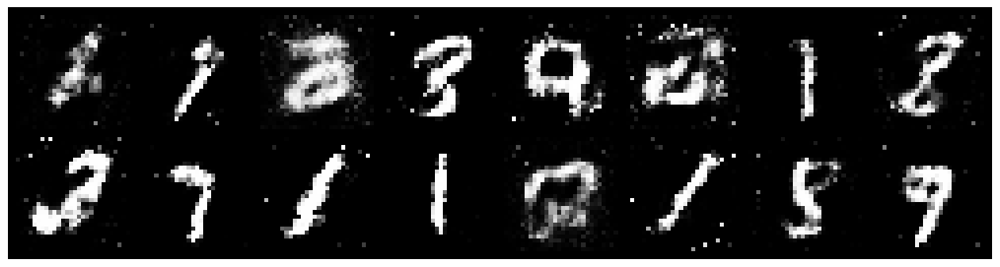

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0698, Generator Loss: 1.4437
D(x): 0.6036, D(G(z)): 0.2848


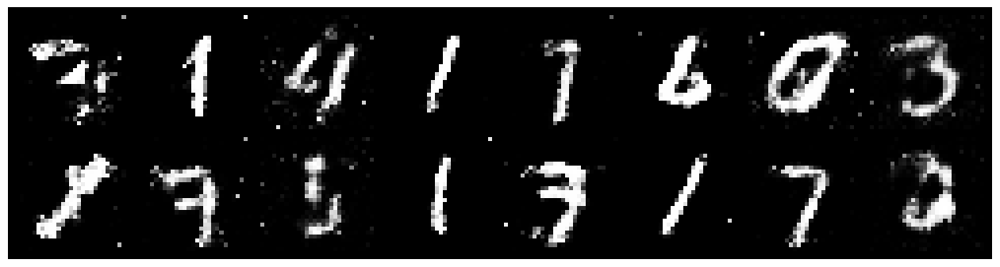

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0583, Generator Loss: 1.1493
D(x): 0.6611, D(G(z)): 0.3481


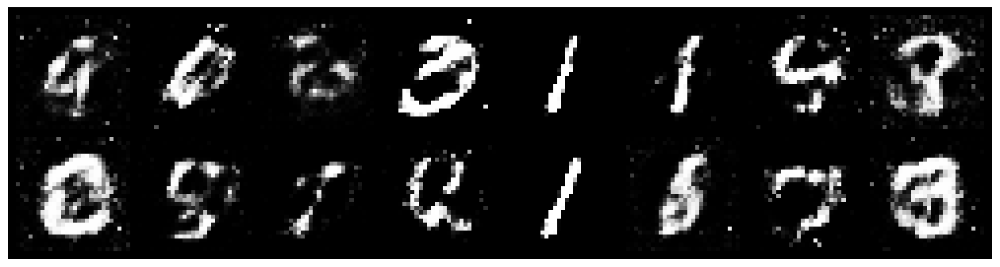

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.1804, Generator Loss: 1.4750
D(x): 0.6783, D(G(z)): 0.4233


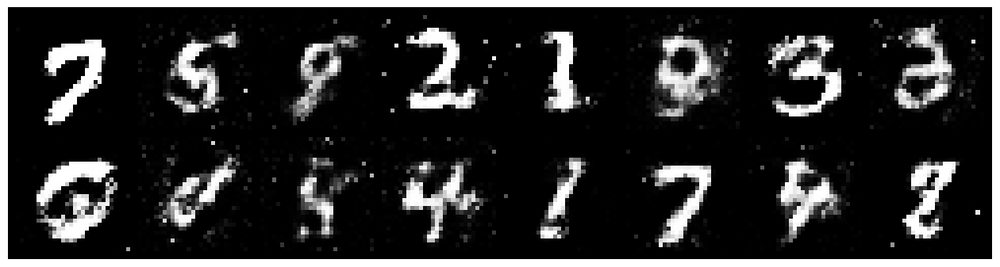

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.1275, Generator Loss: 1.1741
D(x): 0.7115, D(G(z)): 0.4387


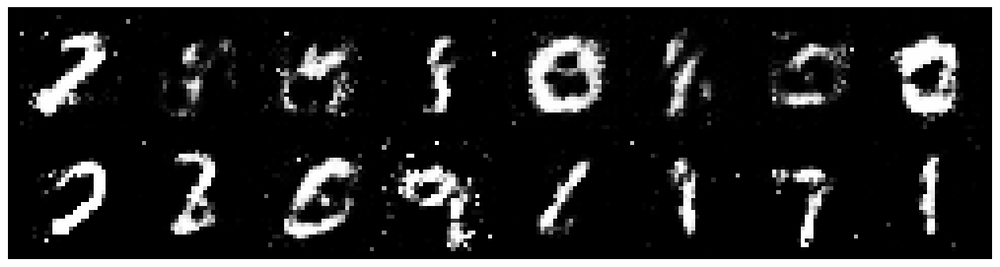

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 0.9072, Generator Loss: 1.6703
D(x): 0.6798, D(G(z)): 0.3093


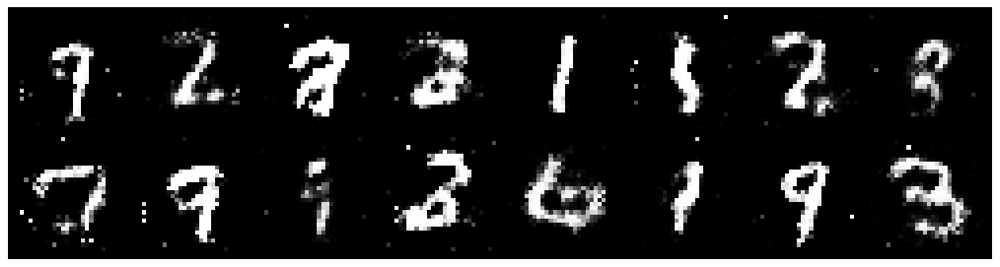

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.1591, Generator Loss: 1.2258
D(x): 0.6500, D(G(z)): 0.4198


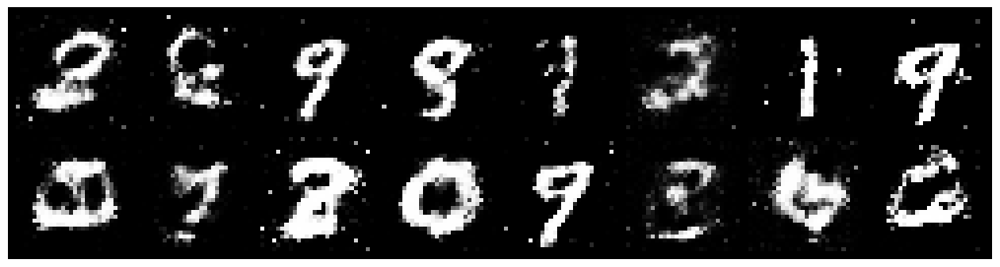

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.2228, Generator Loss: 1.3381
D(x): 0.5658, D(G(z)): 0.3793


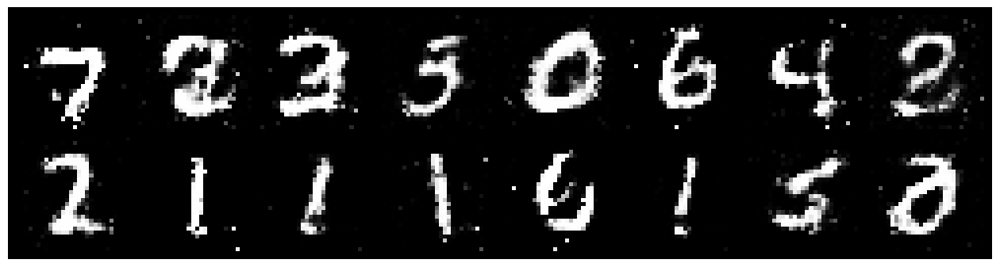

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.2232, Generator Loss: 1.2776
D(x): 0.6171, D(G(z)): 0.4333


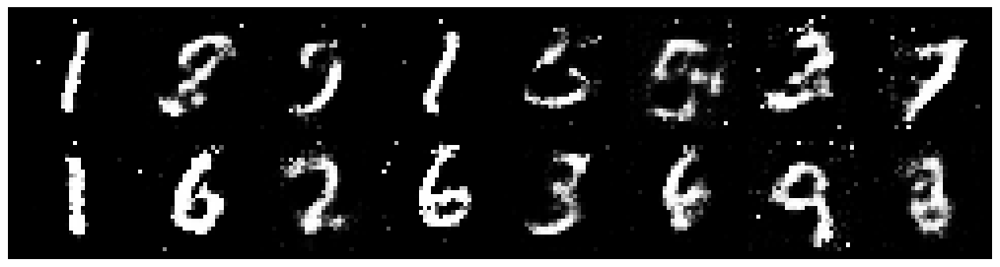

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.0487, Generator Loss: 1.1529
D(x): 0.6459, D(G(z)): 0.3792


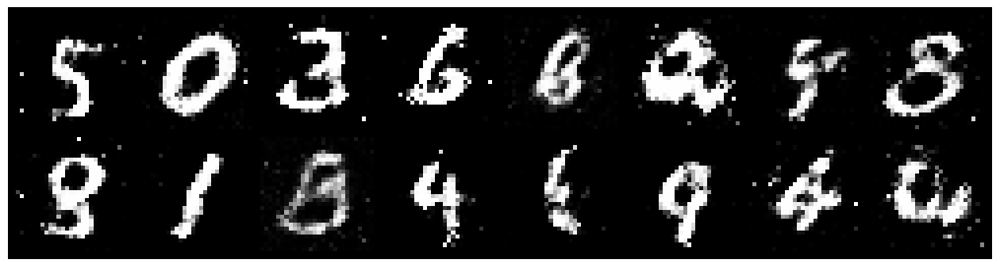

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.1034, Generator Loss: 1.1810
D(x): 0.5944, D(G(z)): 0.3585


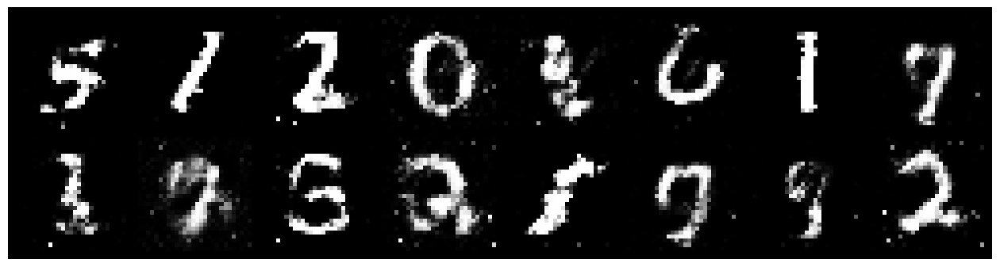

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.1181, Generator Loss: 1.1605
D(x): 0.6821, D(G(z)): 0.4048


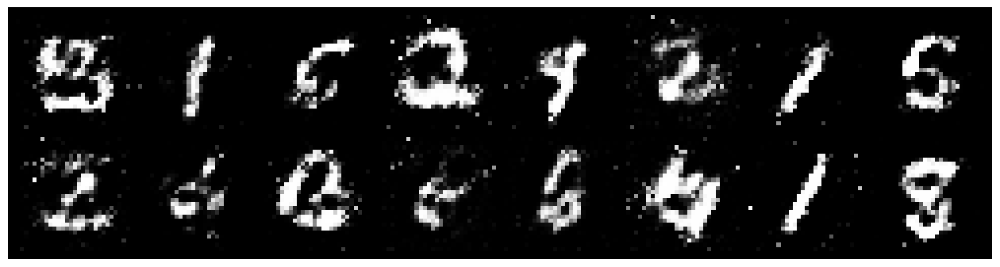

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.1330, Generator Loss: 1.4256
D(x): 0.6055, D(G(z)): 0.3508


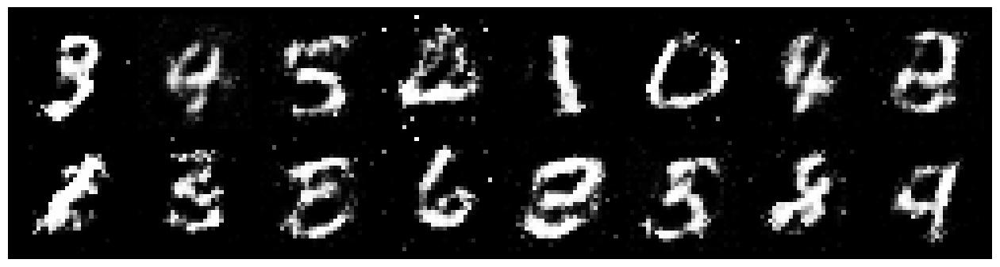

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.1720, Generator Loss: 1.0447
D(x): 0.5862, D(G(z)): 0.4237


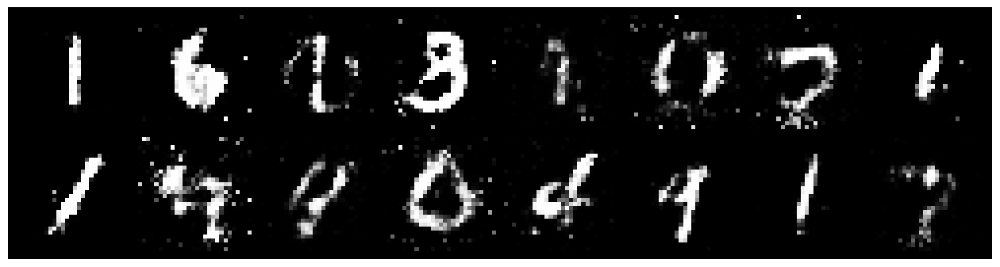

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 0.8876, Generator Loss: 1.5321
D(x): 0.6638, D(G(z)): 0.2945


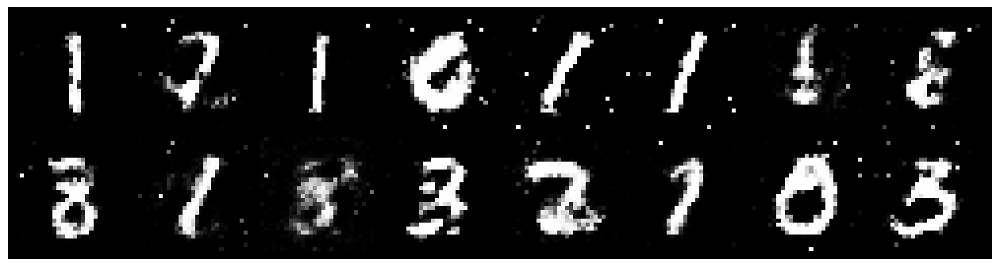

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.3283, Generator Loss: 1.0431
D(x): 0.6160, D(G(z)): 0.4519


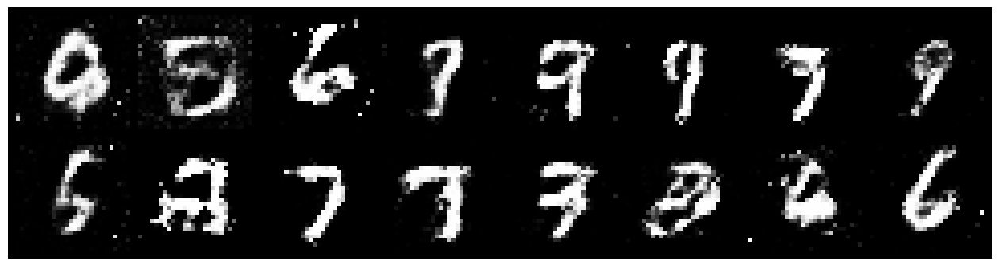

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.0398, Generator Loss: 1.1295
D(x): 0.6764, D(G(z)): 0.3962


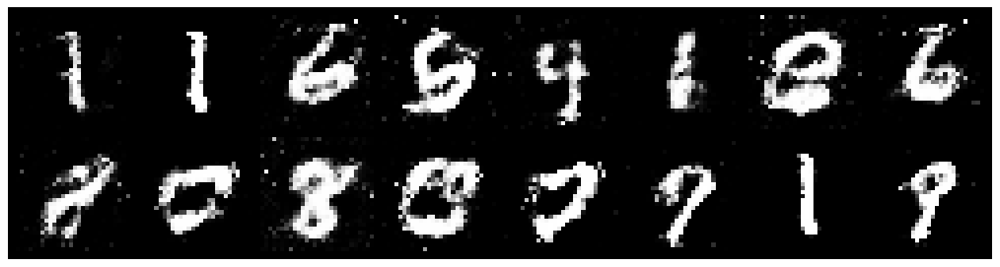

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 0.9488, Generator Loss: 1.2348
D(x): 0.6675, D(G(z)): 0.3561


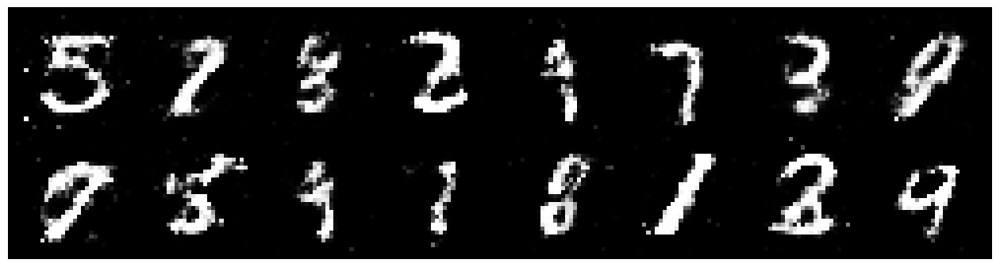

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 0.9849, Generator Loss: 1.4983
D(x): 0.6243, D(G(z)): 0.2956


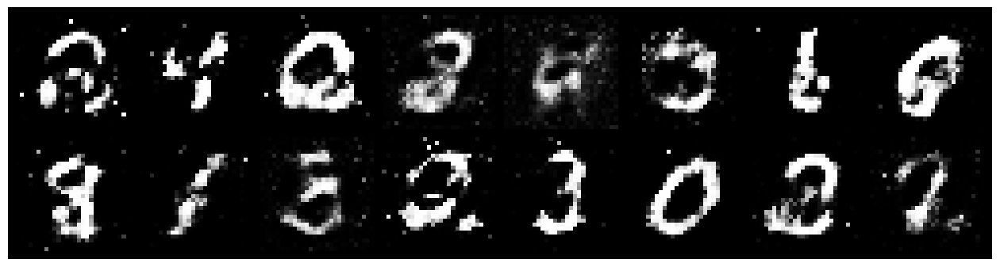

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.0604, Generator Loss: 1.3296
D(x): 0.6716, D(G(z)): 0.3736


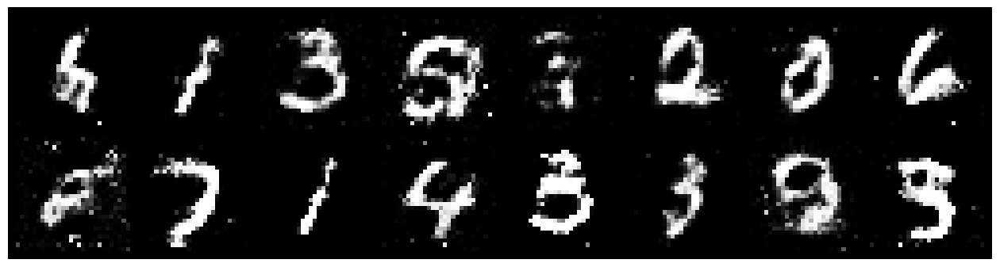

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.0712, Generator Loss: 1.1017
D(x): 0.7288, D(G(z)): 0.4309


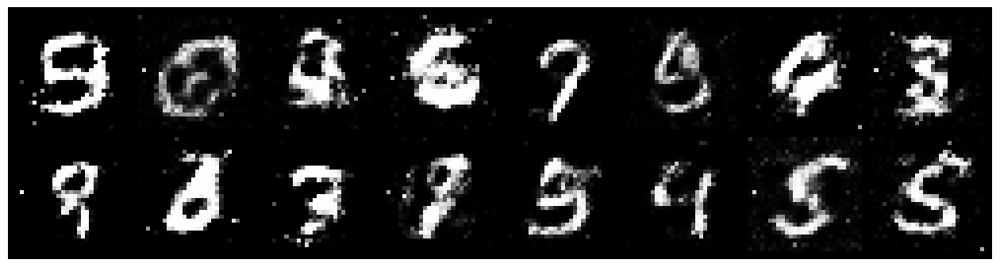

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.0269, Generator Loss: 1.3238
D(x): 0.6926, D(G(z)): 0.3714


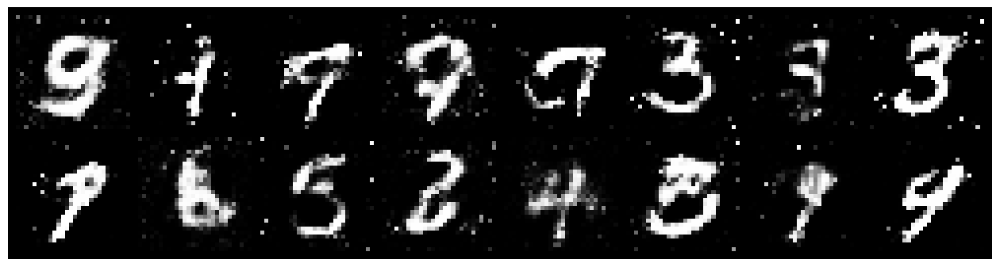

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.2000, Generator Loss: 1.4420
D(x): 0.6401, D(G(z)): 0.4035


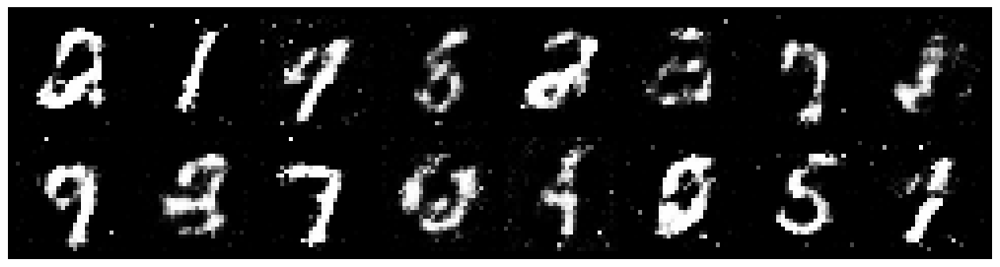

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.0018, Generator Loss: 1.6249
D(x): 0.6446, D(G(z)): 0.2873


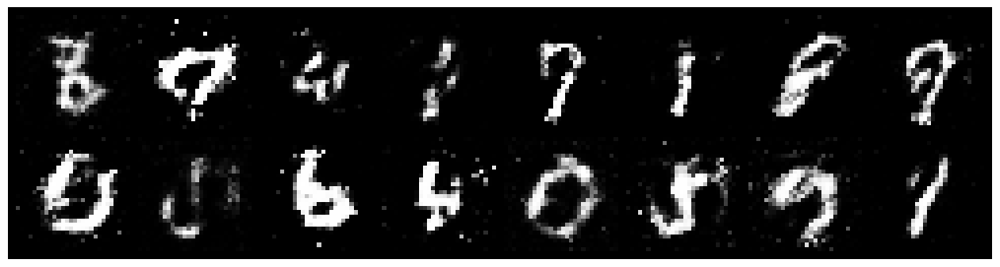

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 0.8585, Generator Loss: 1.6329
D(x): 0.6685, D(G(z)): 0.2615


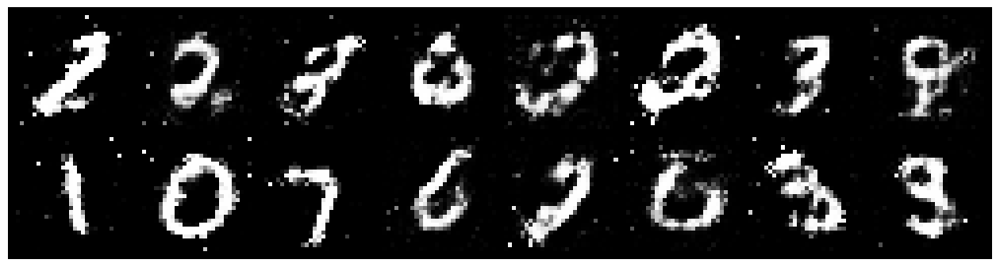

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 0.9727, Generator Loss: 1.2922
D(x): 0.6430, D(G(z)): 0.3330


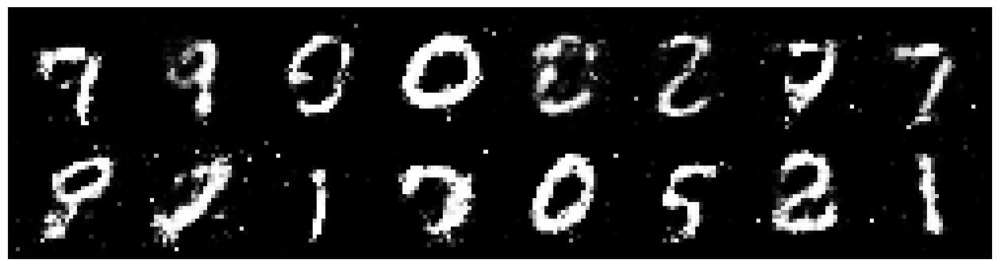

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.2206, Generator Loss: 1.2967
D(x): 0.6058, D(G(z)): 0.3099


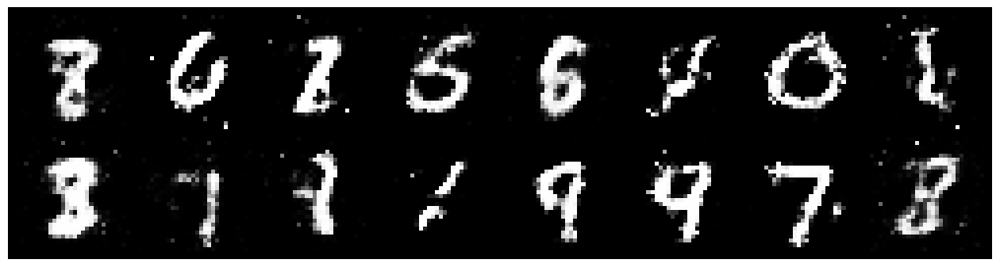

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1575, Generator Loss: 0.9438
D(x): 0.6196, D(G(z)): 0.4008


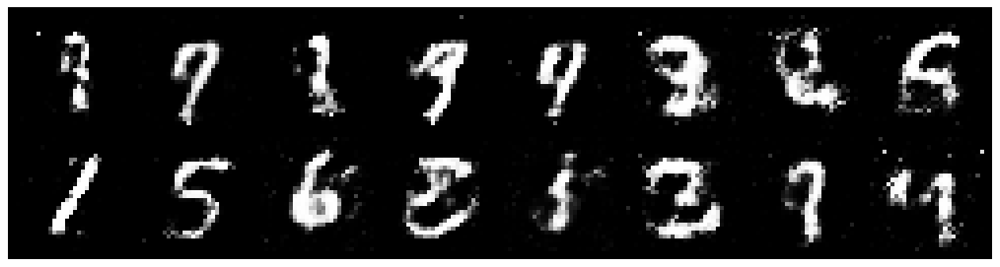

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.1804, Generator Loss: 1.1308
D(x): 0.6385, D(G(z)): 0.4268


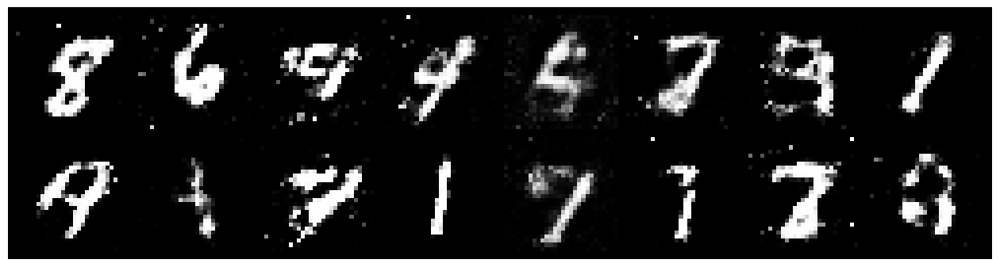

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 0.8912, Generator Loss: 1.3527
D(x): 0.7131, D(G(z)): 0.3453


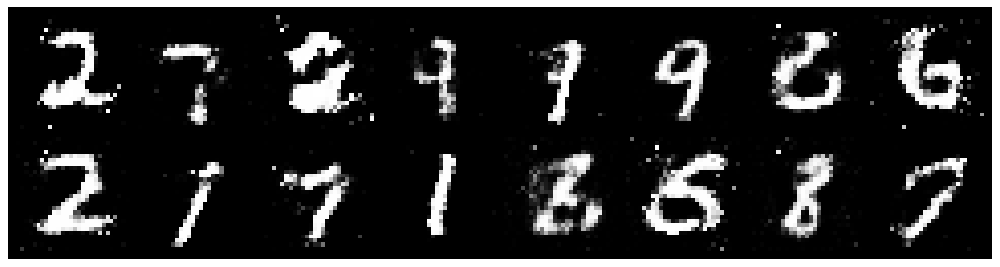

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.0199, Generator Loss: 1.2979
D(x): 0.6262, D(G(z)): 0.3181


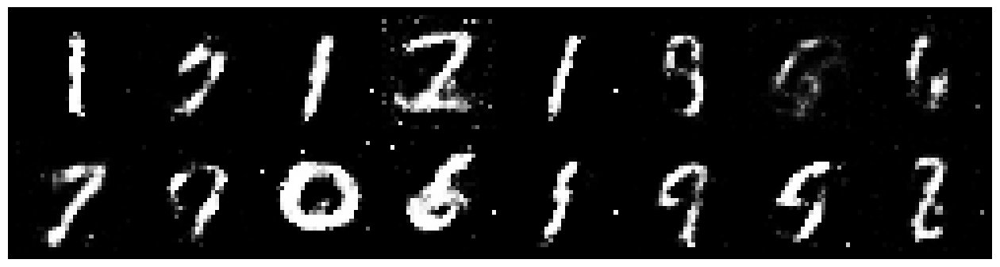

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 0.9661, Generator Loss: 1.4209
D(x): 0.6808, D(G(z)): 0.3680


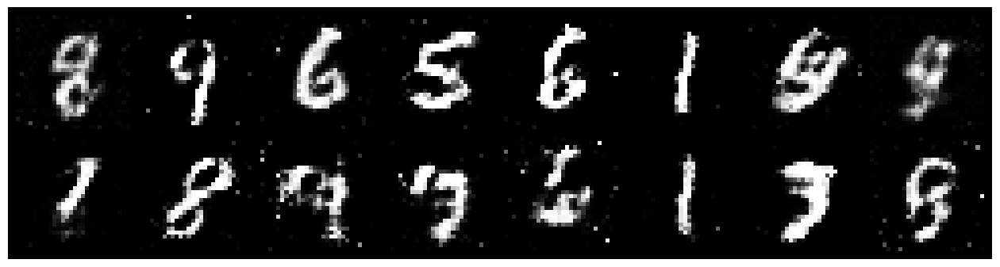

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 0.9217, Generator Loss: 1.3845
D(x): 0.6742, D(G(z)): 0.3388


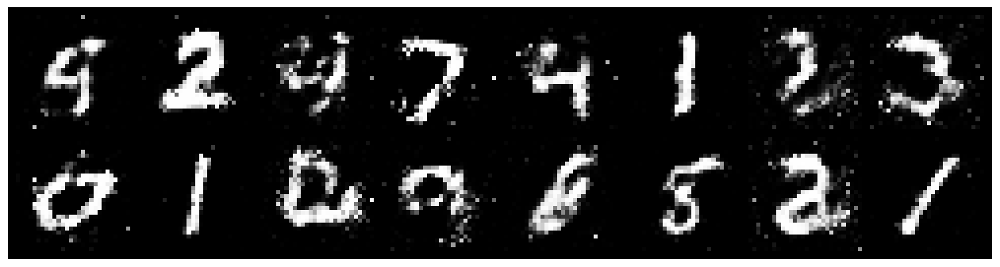

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1257, Generator Loss: 1.0734
D(x): 0.5989, D(G(z)): 0.3679


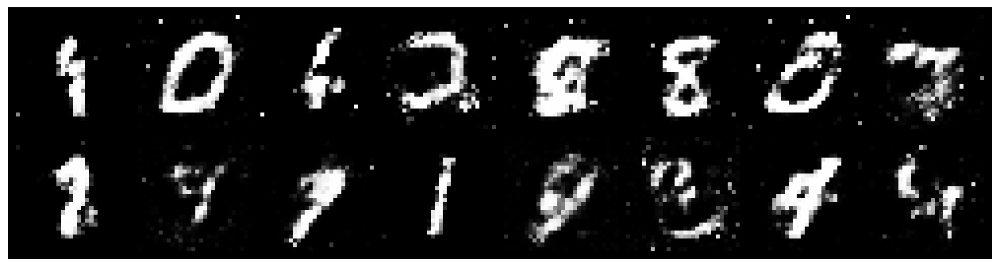

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.2071, Generator Loss: 1.1440
D(x): 0.6140, D(G(z)): 0.4097


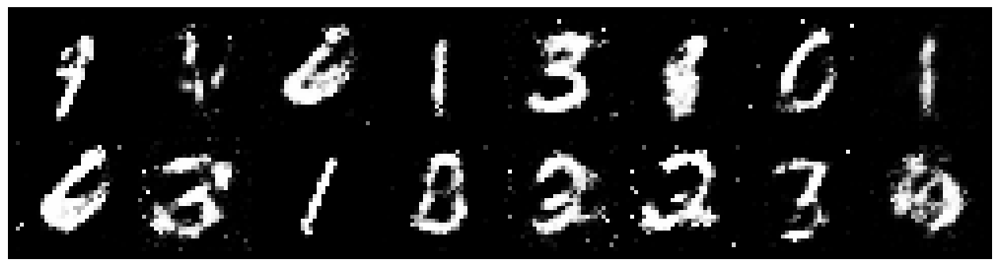

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 0.9663, Generator Loss: 1.0231
D(x): 0.6401, D(G(z)): 0.3564


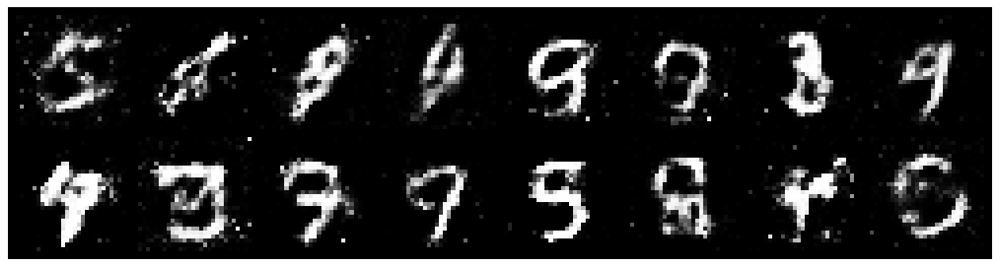

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 0.9868, Generator Loss: 1.1833
D(x): 0.6717, D(G(z)): 0.3587


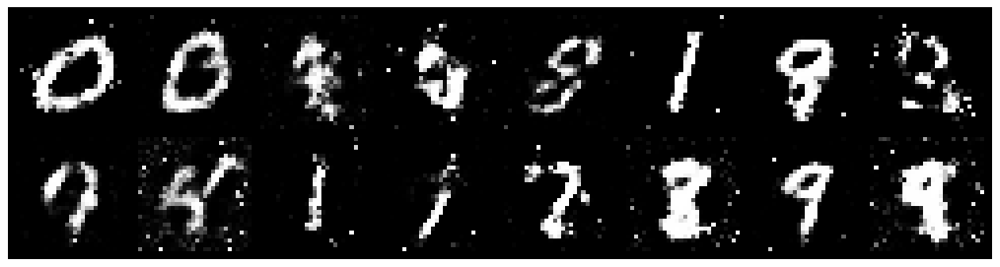

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.1234, Generator Loss: 1.0737
D(x): 0.6077, D(G(z)): 0.3585


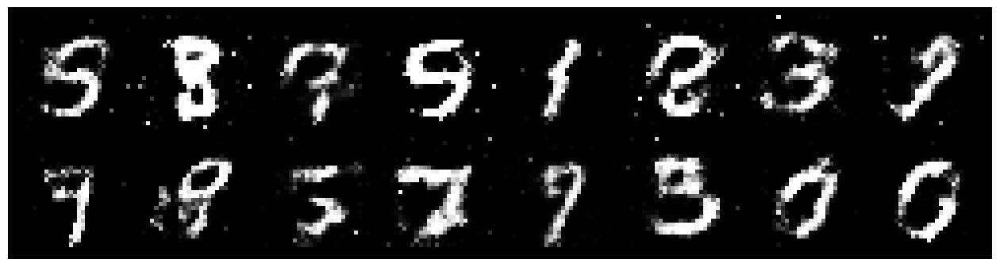

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.0004, Generator Loss: 1.2858
D(x): 0.6877, D(G(z)): 0.3724


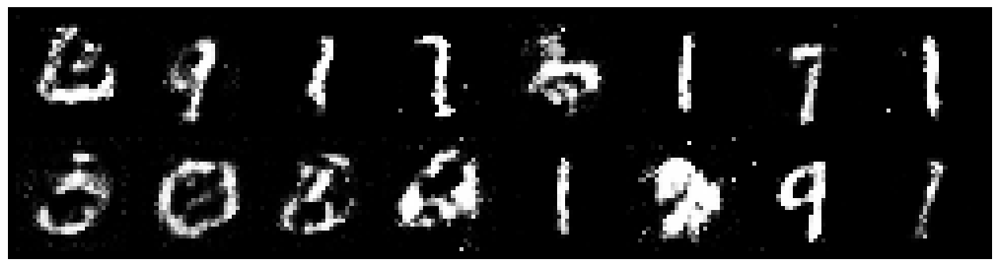

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.2243, Generator Loss: 0.9723
D(x): 0.5841, D(G(z)): 0.4223


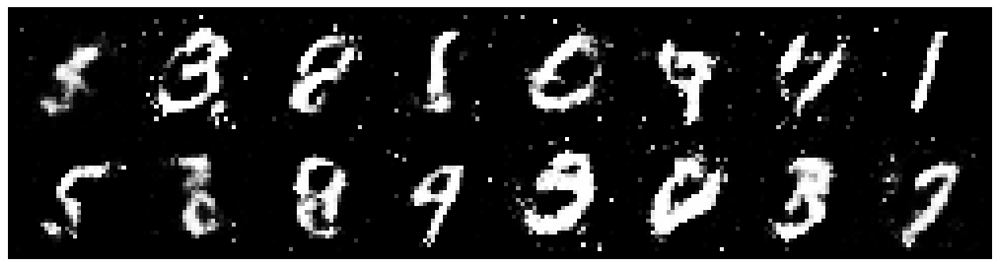

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.1501, Generator Loss: 1.0787
D(x): 0.6038, D(G(z)): 0.3971


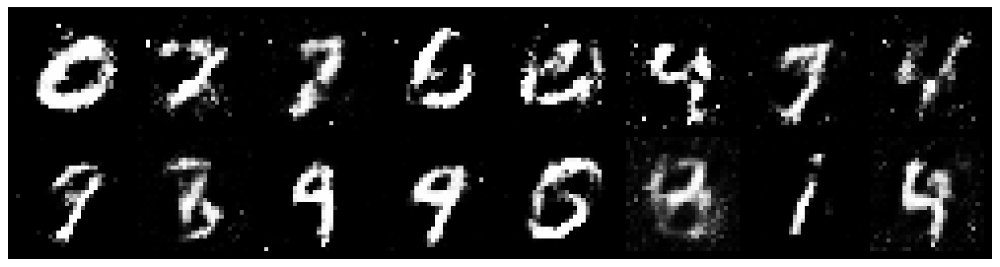

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.1684, Generator Loss: 1.2409
D(x): 0.5919, D(G(z)): 0.3777


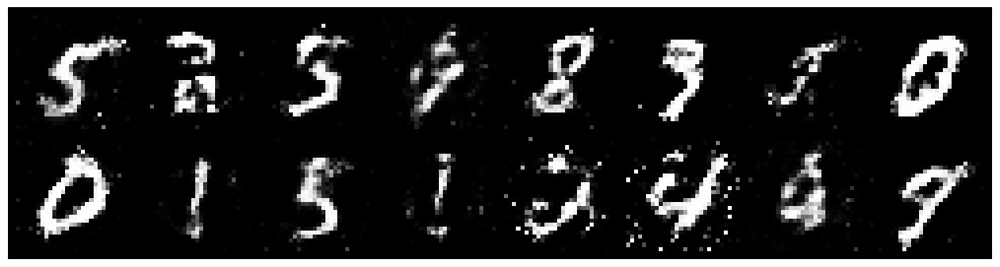

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.1244, Generator Loss: 0.9476
D(x): 0.7007, D(G(z)): 0.4378


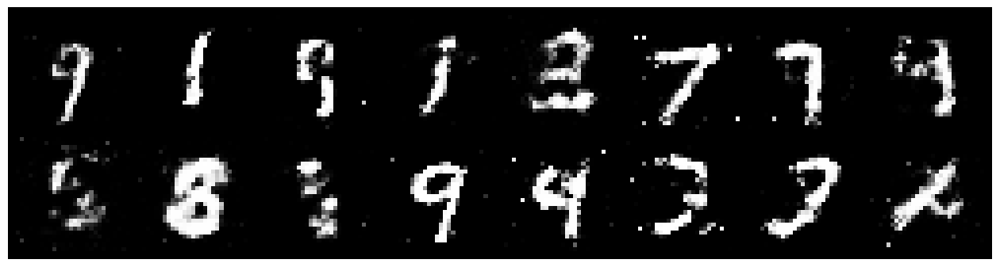

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.1851, Generator Loss: 1.1031
D(x): 0.5966, D(G(z)): 0.3845


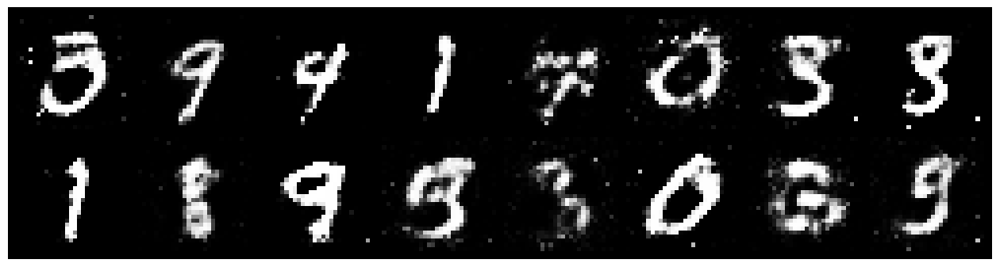

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.1106, Generator Loss: 1.3517
D(x): 0.6287, D(G(z)): 0.3692


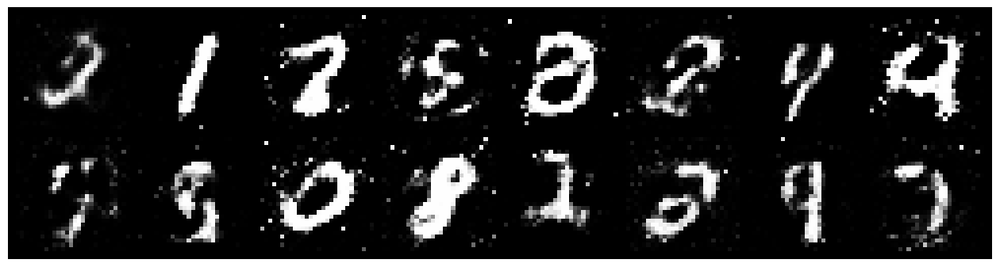

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.2472, Generator Loss: 1.2436
D(x): 0.5792, D(G(z)): 0.3479


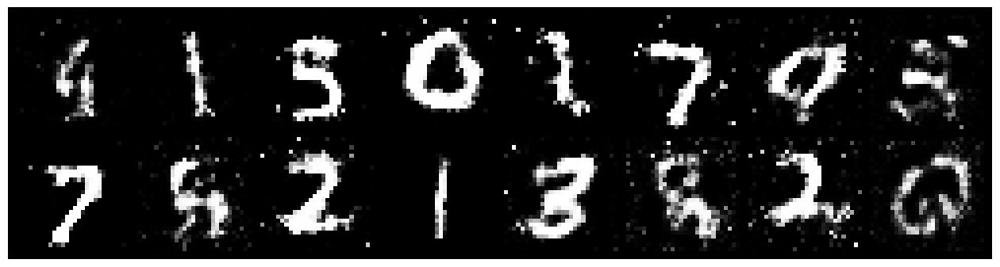

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.2453, Generator Loss: 1.1502
D(x): 0.5714, D(G(z)): 0.3895


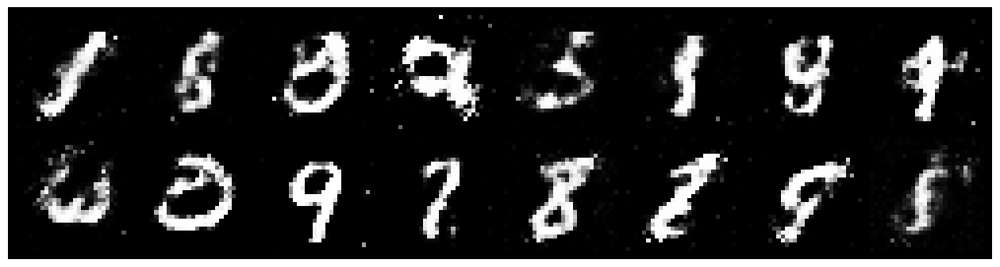

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.1210, Generator Loss: 1.0161
D(x): 0.6412, D(G(z)): 0.4008


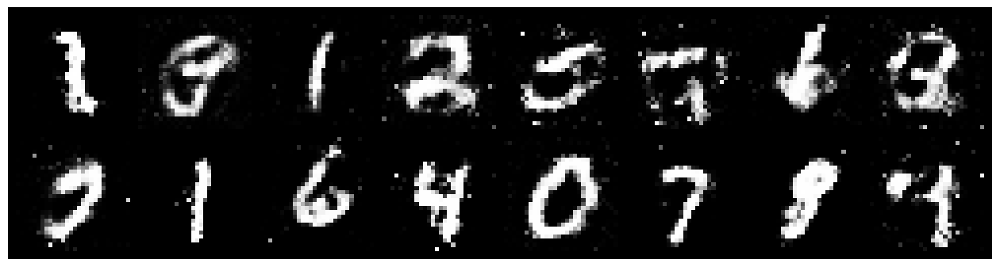

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.2597, Generator Loss: 1.0758
D(x): 0.6005, D(G(z)): 0.3960


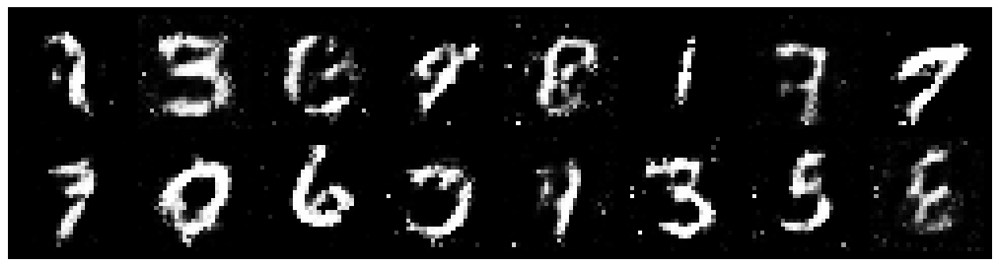

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.2155, Generator Loss: 1.4353
D(x): 0.6158, D(G(z)): 0.3850


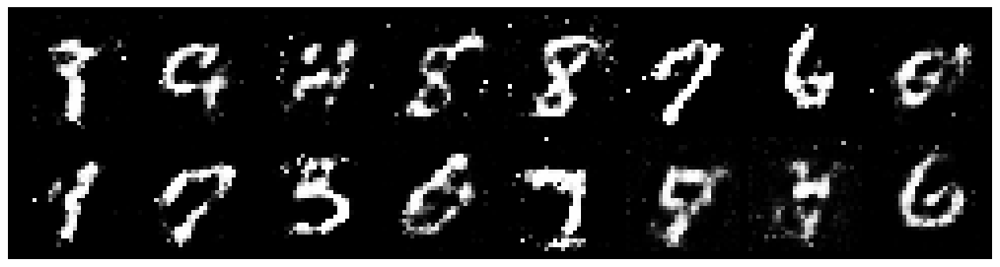

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.1580, Generator Loss: 1.1401
D(x): 0.6009, D(G(z)): 0.3643


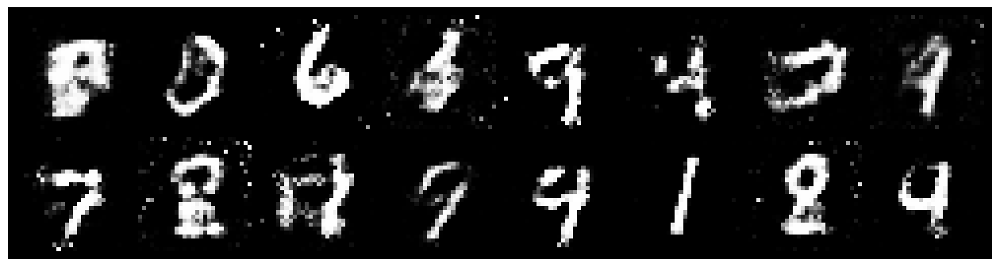

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 0.9067, Generator Loss: 1.6277
D(x): 0.6434, D(G(z)): 0.2766


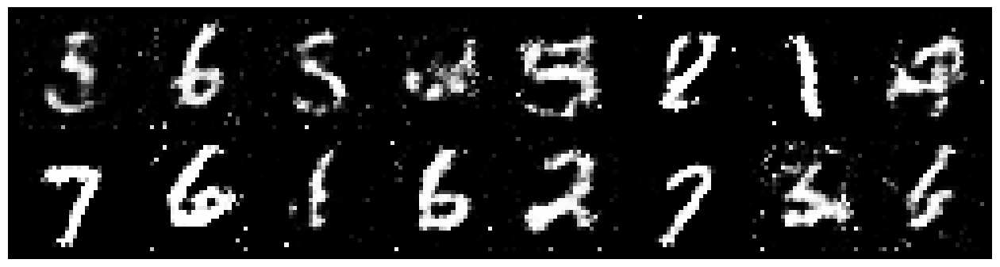

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 0.9226, Generator Loss: 1.4120
D(x): 0.6820, D(G(z)): 0.3162


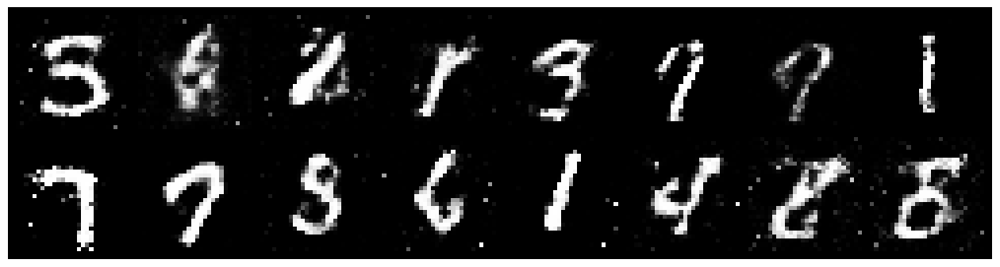

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1176, Generator Loss: 1.1259
D(x): 0.6179, D(G(z)): 0.3542


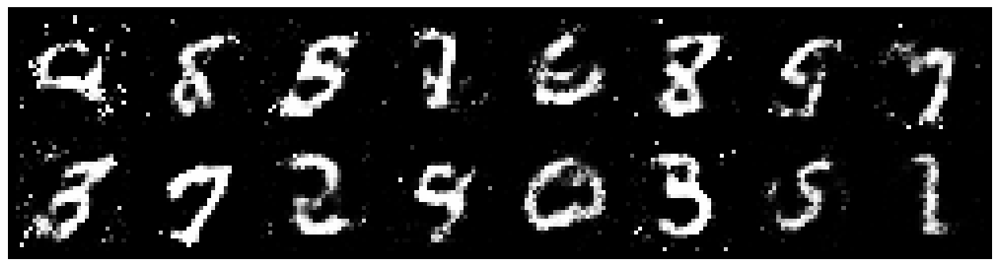

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 0.8814, Generator Loss: 1.2022
D(x): 0.6995, D(G(z)): 0.3420


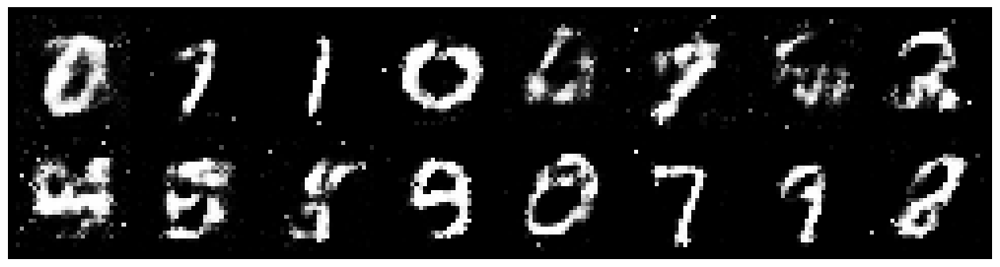

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.0876, Generator Loss: 1.0728
D(x): 0.6370, D(G(z)): 0.4014


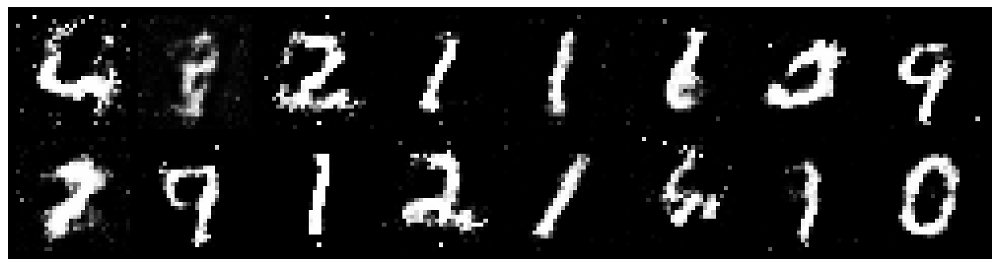

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.0382, Generator Loss: 1.1979
D(x): 0.6236, D(G(z)): 0.3649


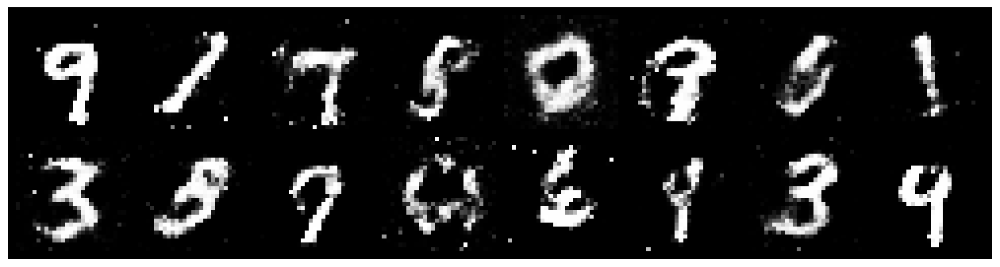

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.1383, Generator Loss: 1.2601
D(x): 0.6224, D(G(z)): 0.3833


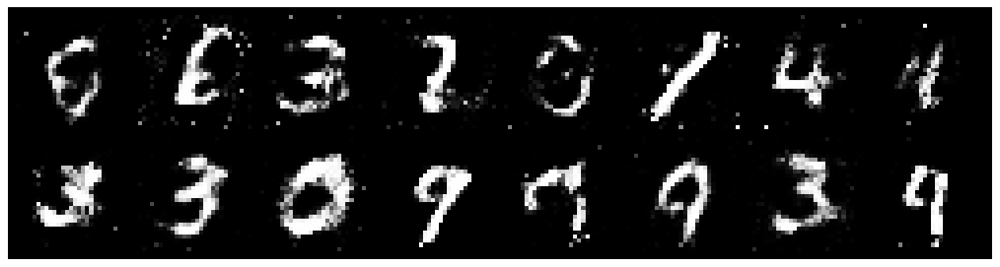

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.2100, Generator Loss: 1.0998
D(x): 0.5390, D(G(z)): 0.3234


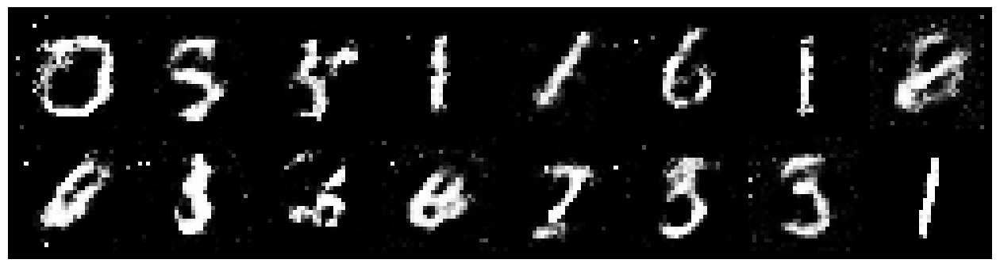

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.1880, Generator Loss: 1.0535
D(x): 0.5645, D(G(z)): 0.4035


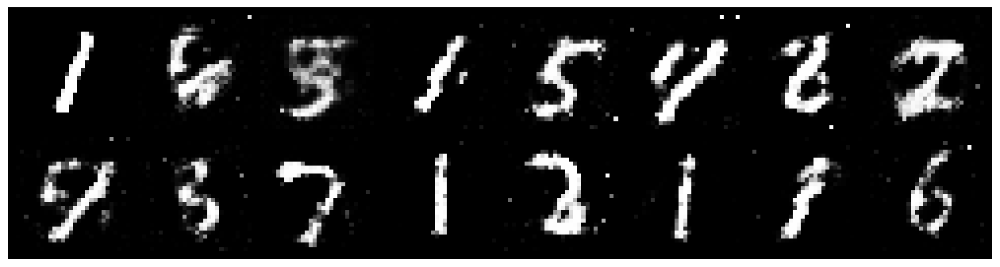

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.1685, Generator Loss: 1.1151
D(x): 0.6418, D(G(z)): 0.4357


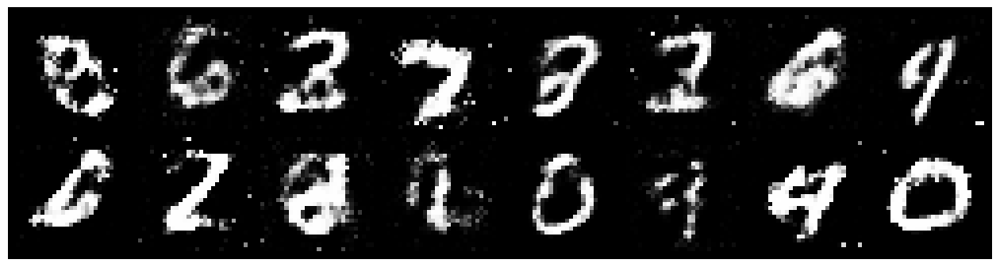

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1798, Generator Loss: 1.1522
D(x): 0.5509, D(G(z)): 0.3808


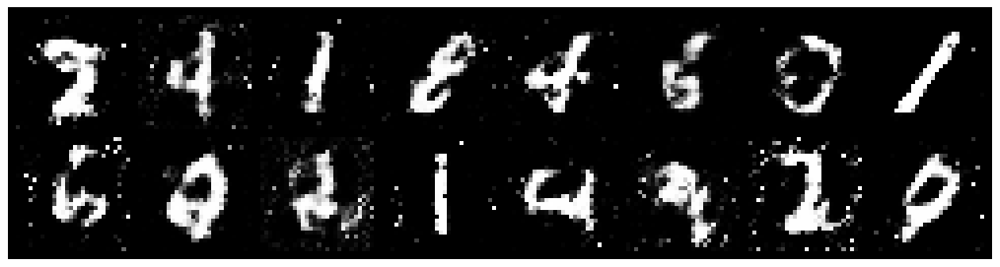

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.2042, Generator Loss: 1.0547
D(x): 0.5570, D(G(z)): 0.3814


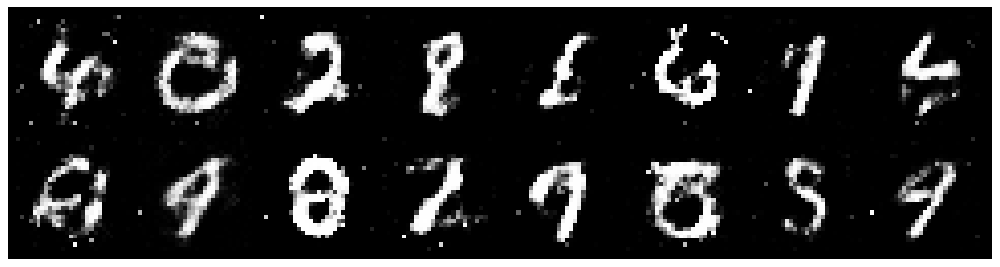

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 0.9688, Generator Loss: 1.1249
D(x): 0.6770, D(G(z)): 0.3627


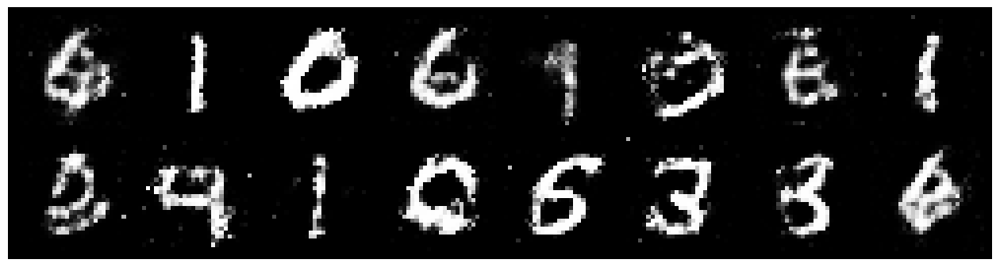

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.0885, Generator Loss: 1.0863
D(x): 0.6252, D(G(z)): 0.4040


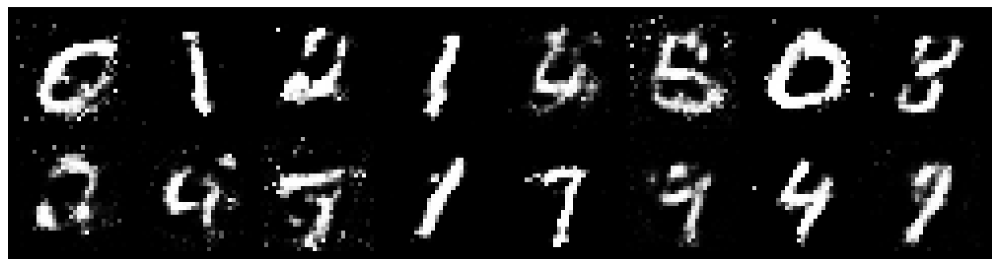

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.2045, Generator Loss: 1.1308
D(x): 0.6074, D(G(z)): 0.4239


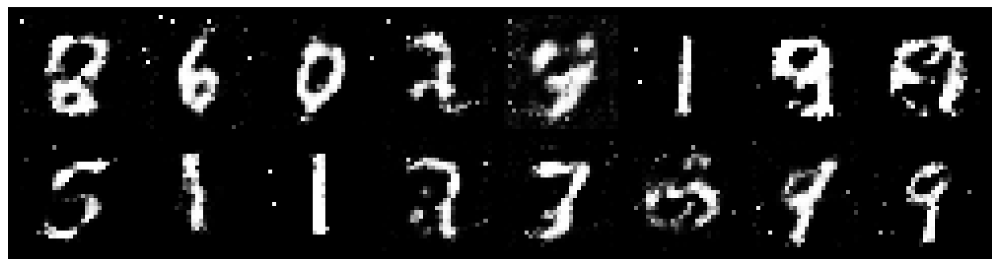

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.2770, Generator Loss: 1.0575
D(x): 0.5855, D(G(z)): 0.4172


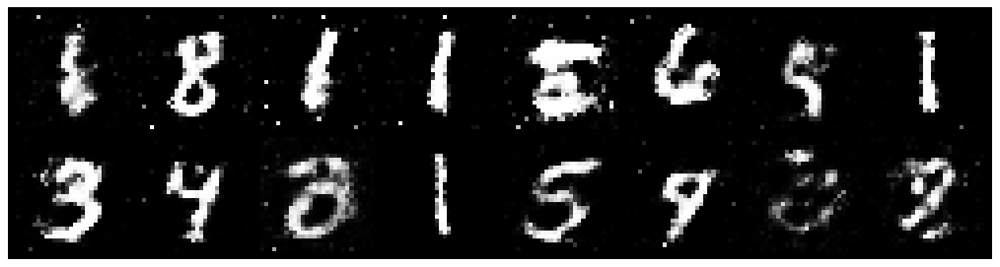

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1726, Generator Loss: 0.8890
D(x): 0.6190, D(G(z)): 0.4478


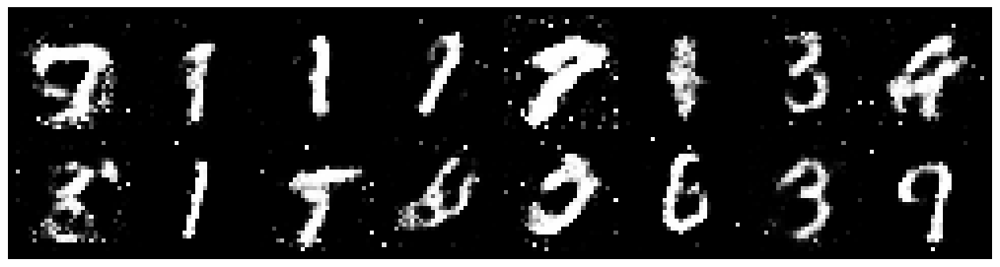

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.1849, Generator Loss: 1.0725
D(x): 0.5557, D(G(z)): 0.3775


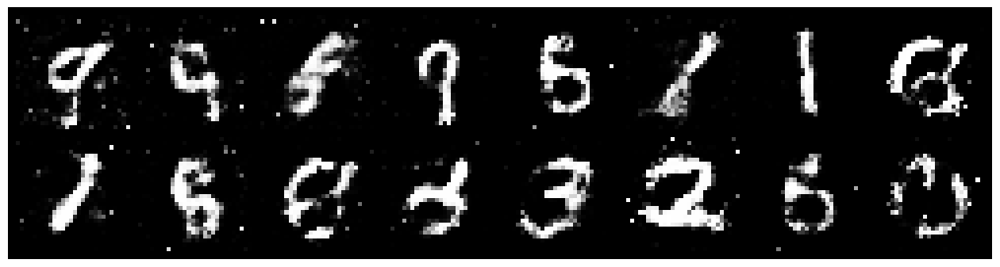

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.1747, Generator Loss: 0.8821
D(x): 0.6296, D(G(z)): 0.4612


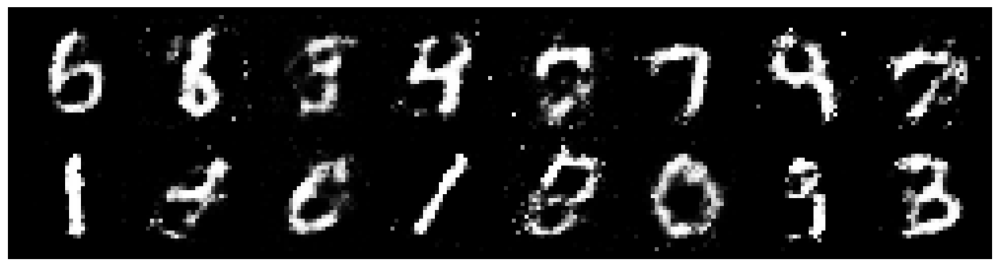

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.1755, Generator Loss: 1.0603
D(x): 0.5794, D(G(z)): 0.3805


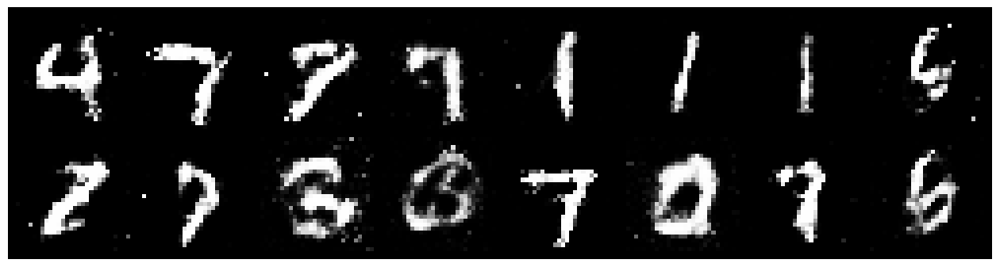

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.0036, Generator Loss: 1.2274
D(x): 0.6674, D(G(z)): 0.3651


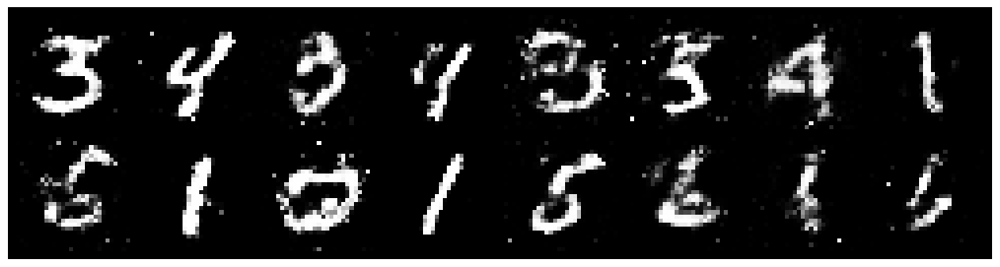

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.1180, Generator Loss: 1.3994
D(x): 0.6343, D(G(z)): 0.3666


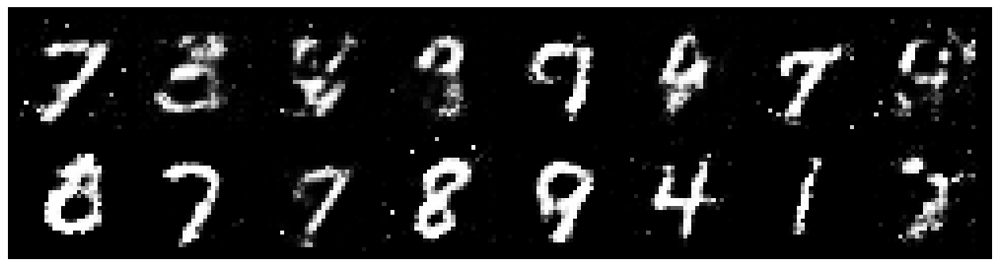

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1512, Generator Loss: 1.2909
D(x): 0.6387, D(G(z)): 0.3928


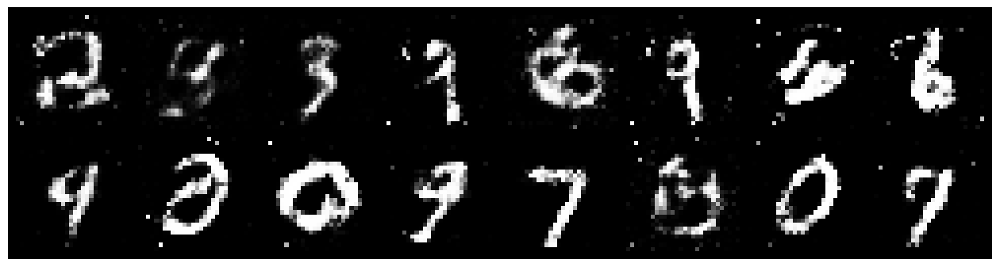

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.1850, Generator Loss: 0.9844
D(x): 0.6157, D(G(z)): 0.4330


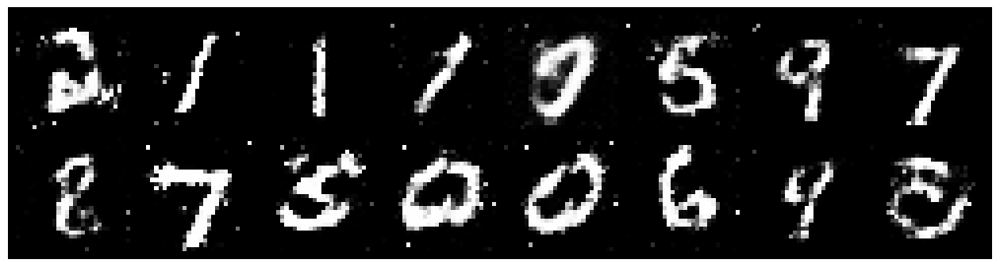

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1929, Generator Loss: 0.9662
D(x): 0.5928, D(G(z)): 0.4348


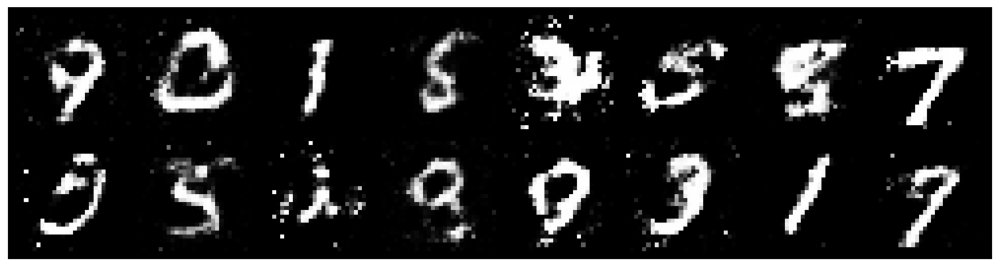

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.2515, Generator Loss: 1.3057
D(x): 0.5666, D(G(z)): 0.3848


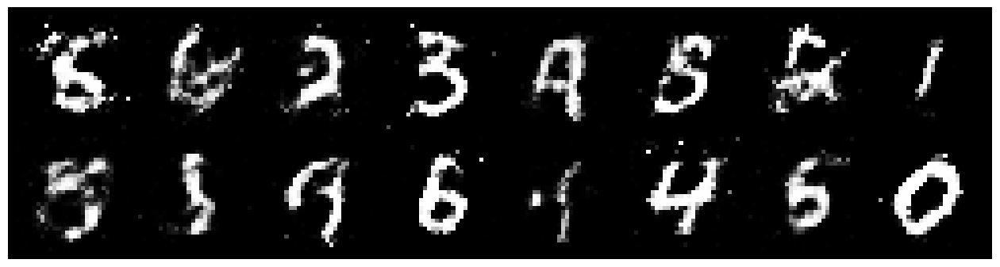

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 0.9769, Generator Loss: 1.3856
D(x): 0.6752, D(G(z)): 0.3333


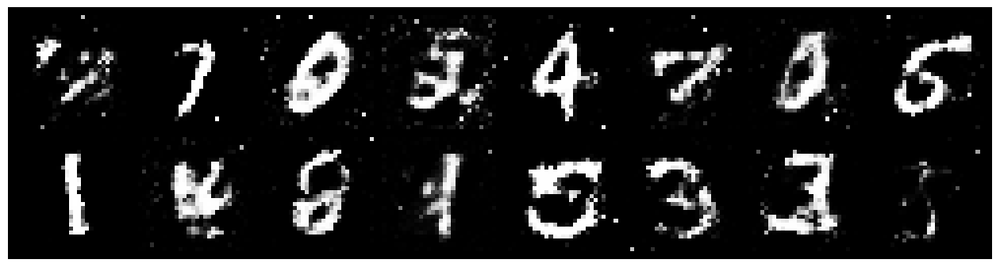

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 0.9965, Generator Loss: 1.2895
D(x): 0.6432, D(G(z)): 0.3303


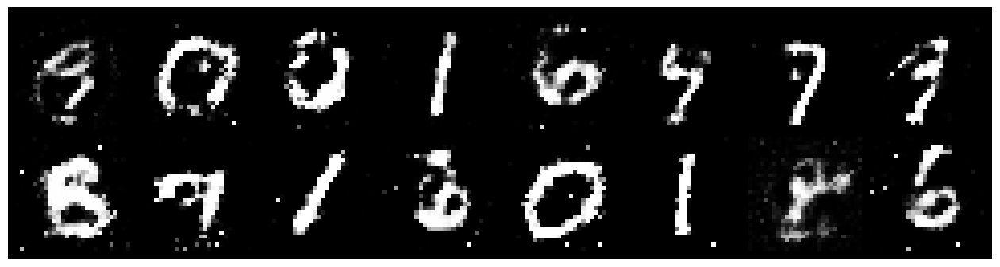

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1442, Generator Loss: 1.0415
D(x): 0.6005, D(G(z)): 0.3989


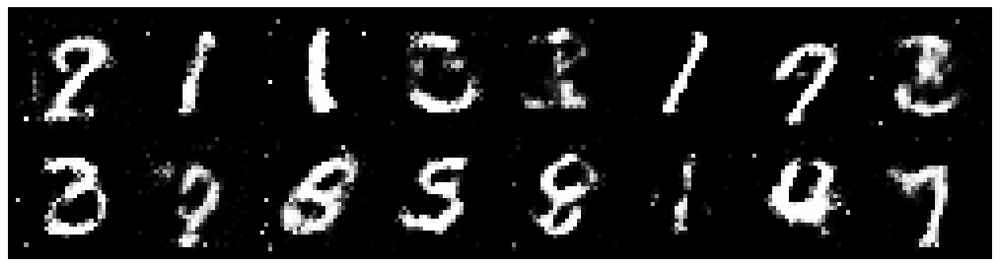

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.2093, Generator Loss: 0.9746
D(x): 0.5684, D(G(z)): 0.4101


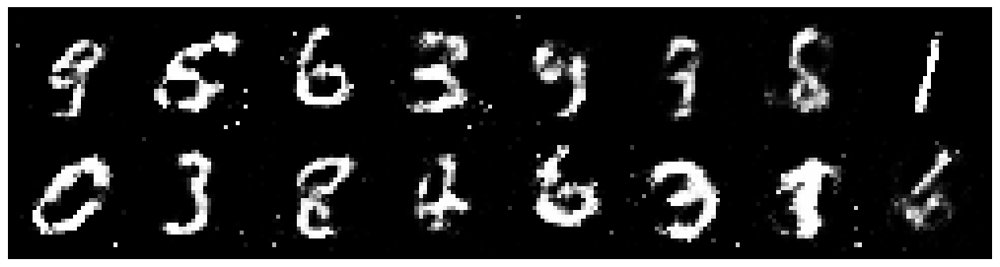

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.0378, Generator Loss: 0.9830
D(x): 0.6351, D(G(z)): 0.3696


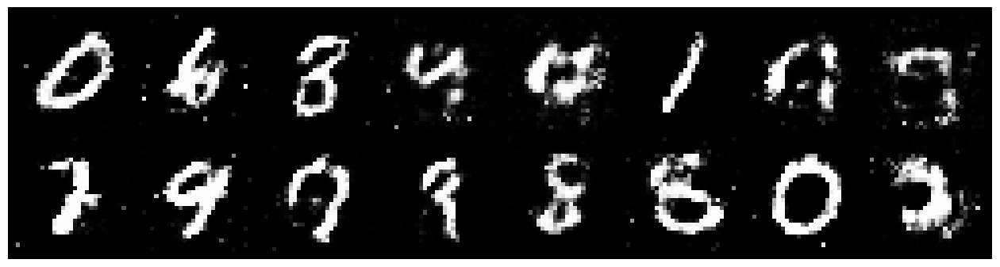

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.2275, Generator Loss: 1.1825
D(x): 0.6229, D(G(z)): 0.4219


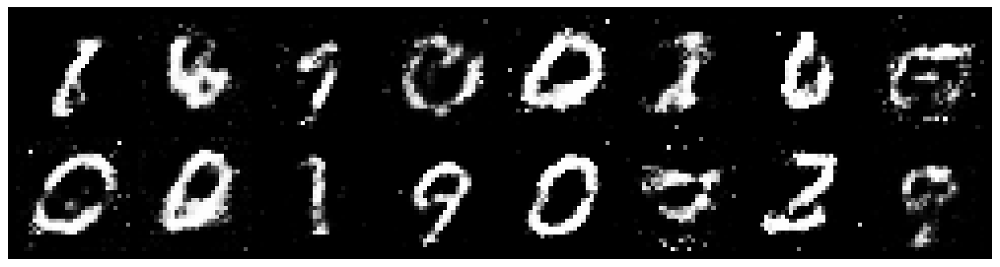

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.1307, Generator Loss: 1.0845
D(x): 0.6675, D(G(z)): 0.4488


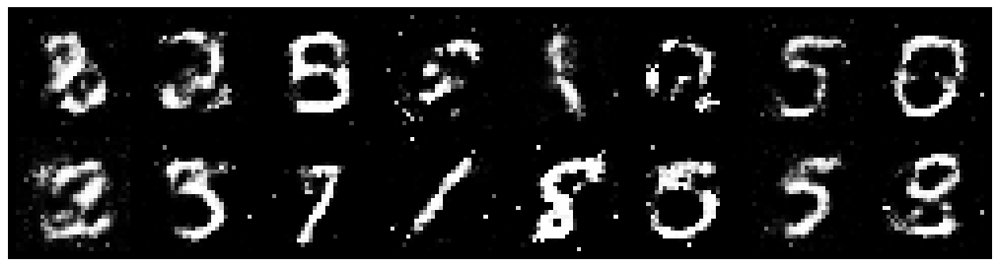

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.1637, Generator Loss: 1.1882
D(x): 0.6231, D(G(z)): 0.4042


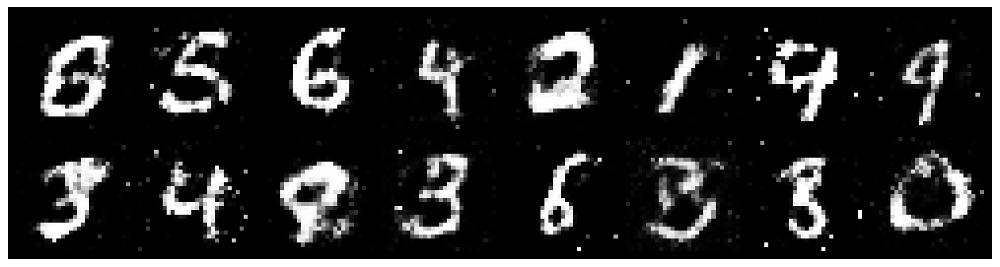

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.1723, Generator Loss: 1.1298
D(x): 0.5448, D(G(z)): 0.3569


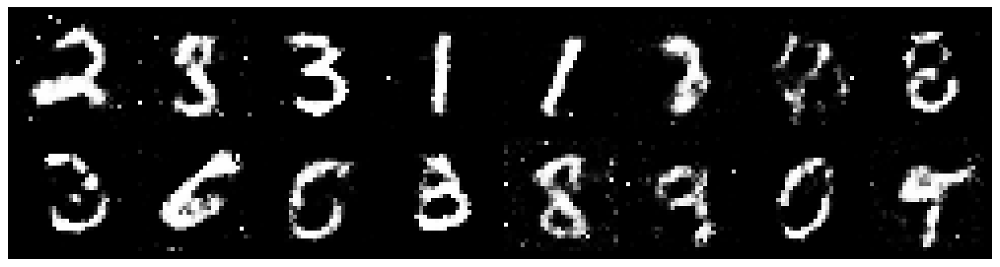

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 0.9561, Generator Loss: 1.2001
D(x): 0.6738, D(G(z)): 0.3553


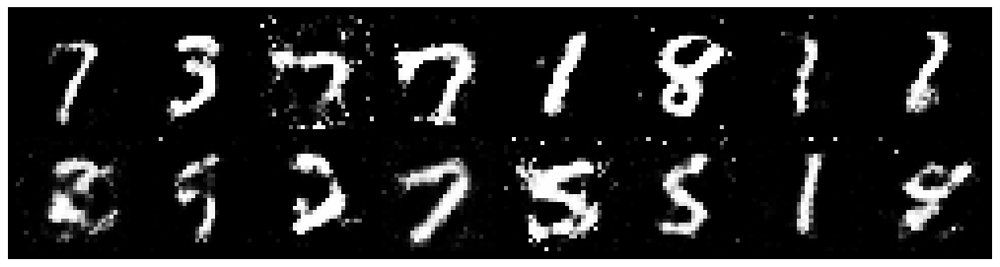

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1468, Generator Loss: 1.1021
D(x): 0.6158, D(G(z)): 0.3966


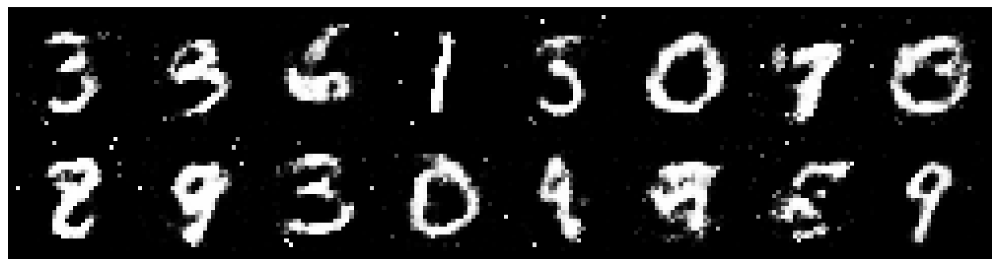

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.2227, Generator Loss: 1.0201
D(x): 0.5511, D(G(z)): 0.3772


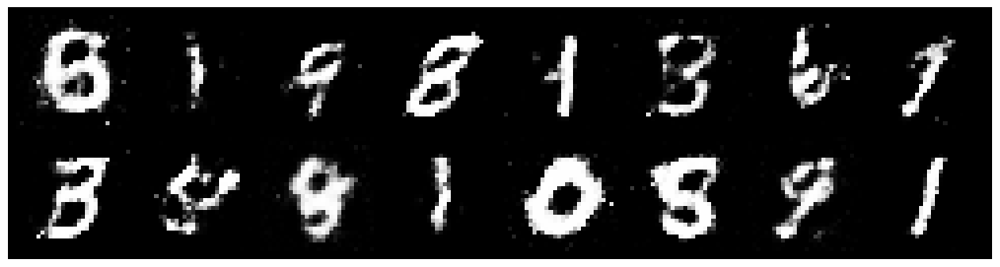

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1449, Generator Loss: 1.1091
D(x): 0.5967, D(G(z)): 0.3717


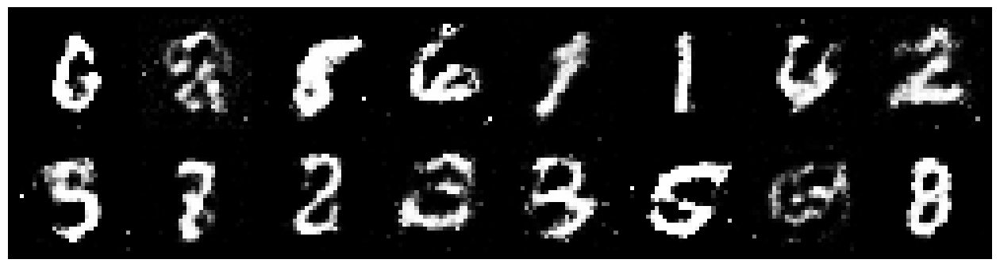

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.2424, Generator Loss: 1.0388
D(x): 0.5326, D(G(z)): 0.3917


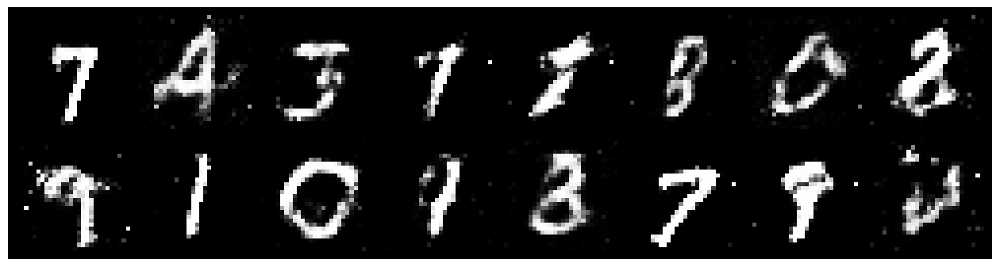

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.2326, Generator Loss: 0.7743
D(x): 0.6165, D(G(z)): 0.4654


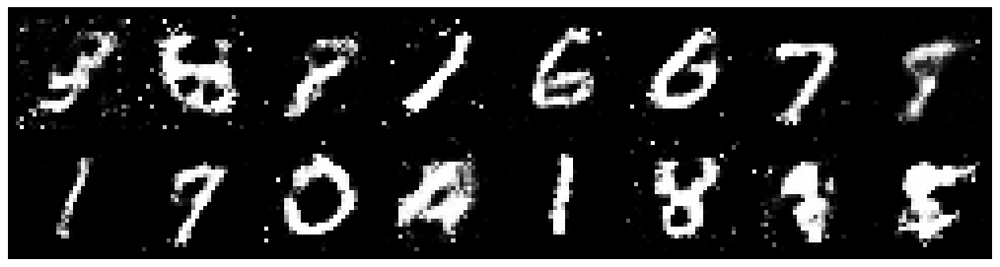

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.1198, Generator Loss: 0.9901
D(x): 0.6551, D(G(z)): 0.4334


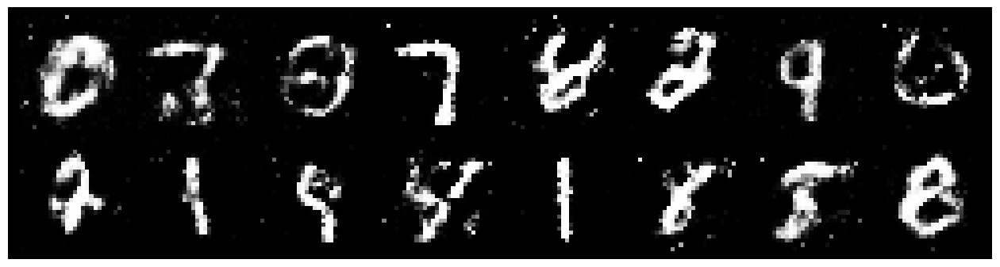

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.0206, Generator Loss: 1.2027
D(x): 0.6256, D(G(z)): 0.3631


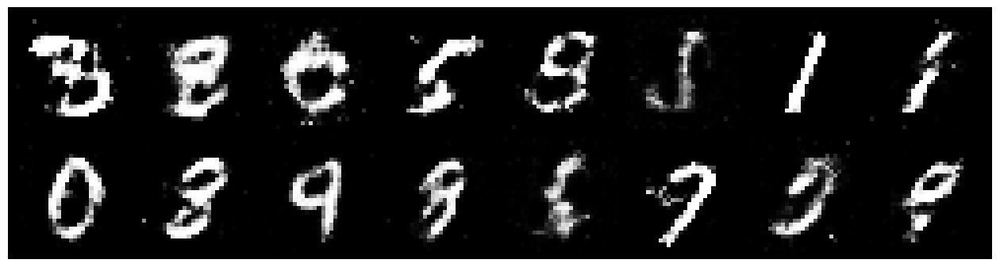

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1287, Generator Loss: 1.1667
D(x): 0.6189, D(G(z)): 0.3650


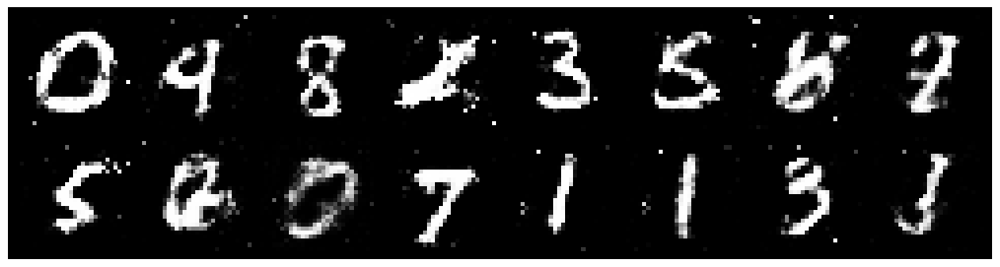

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.0572, Generator Loss: 1.3855
D(x): 0.5994, D(G(z)): 0.3160


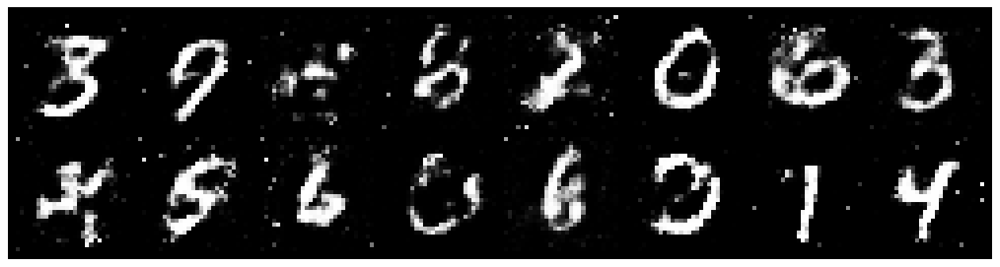

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.1753, Generator Loss: 1.2391
D(x): 0.6176, D(G(z)): 0.4028


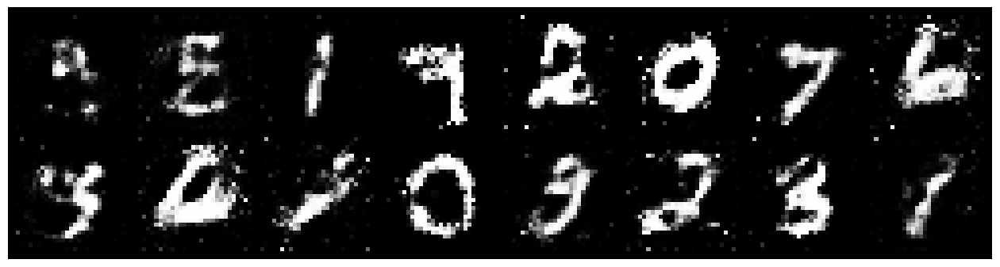

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 0.9994, Generator Loss: 1.3378
D(x): 0.6459, D(G(z)): 0.3580


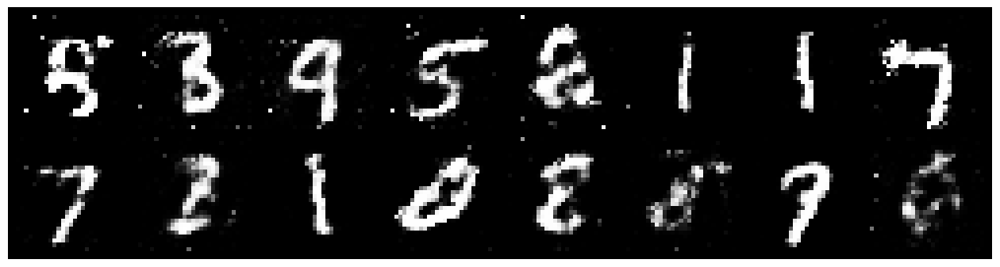

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.2549, Generator Loss: 1.1021
D(x): 0.5777, D(G(z)): 0.4387


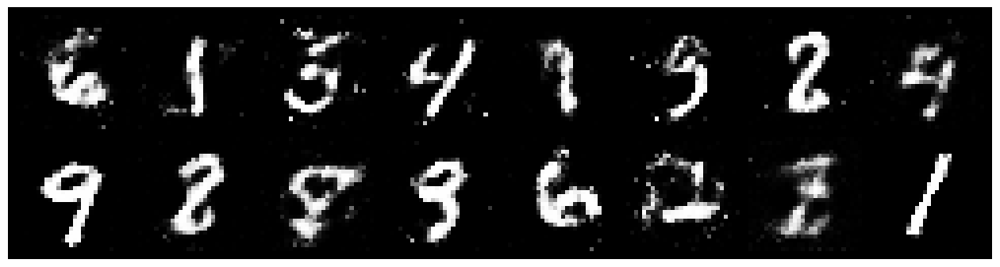

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.1797, Generator Loss: 0.9815
D(x): 0.5740, D(G(z)): 0.3833


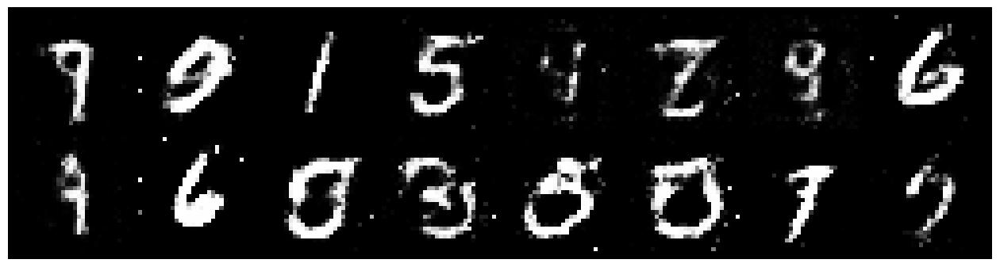

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.0416, Generator Loss: 1.3672
D(x): 0.6203, D(G(z)): 0.3402


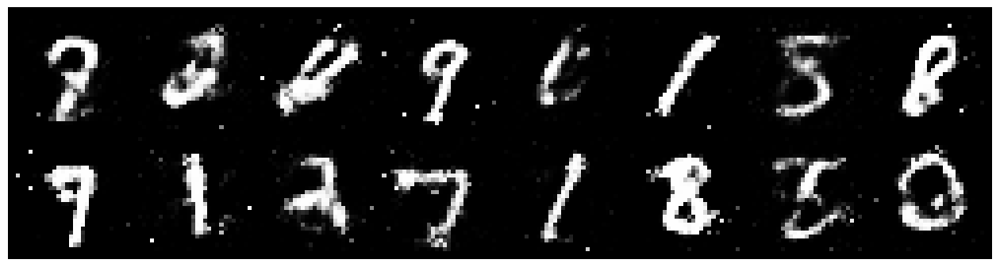

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.2152, Generator Loss: 1.0505
D(x): 0.6270, D(G(z)): 0.4461


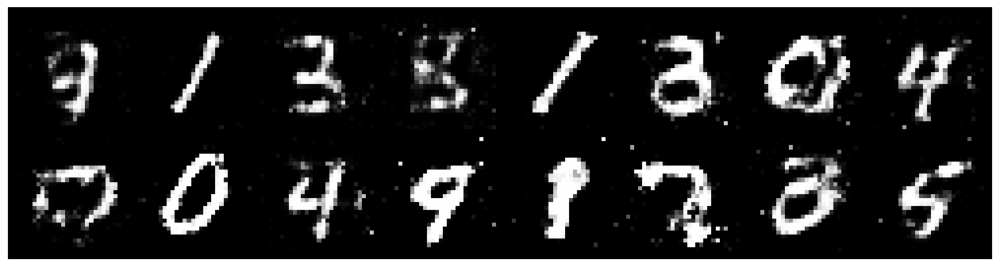

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.0011, Generator Loss: 1.2745
D(x): 0.6842, D(G(z)): 0.3690


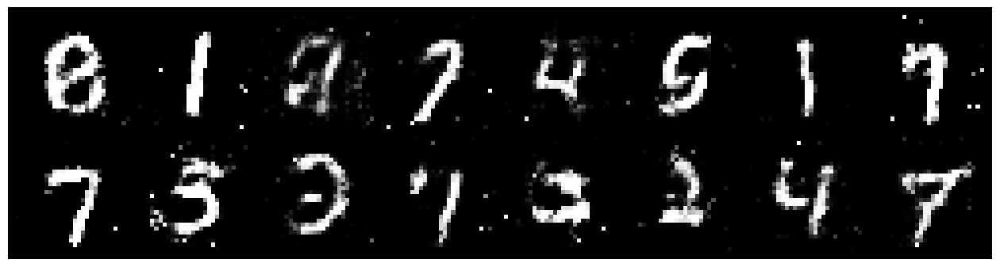

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.0938, Generator Loss: 1.1212
D(x): 0.6104, D(G(z)): 0.3616


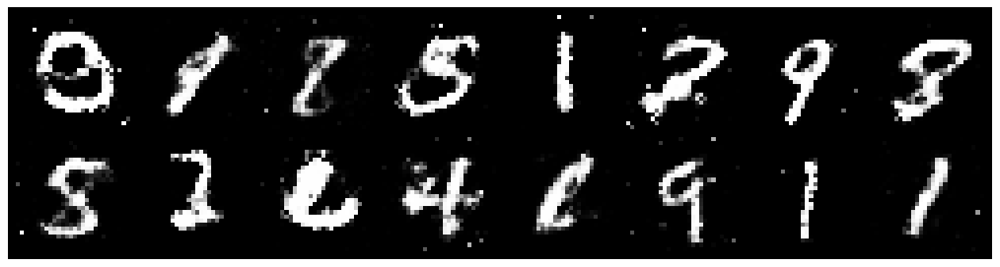

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.0605, Generator Loss: 1.0751
D(x): 0.6667, D(G(z)): 0.4188


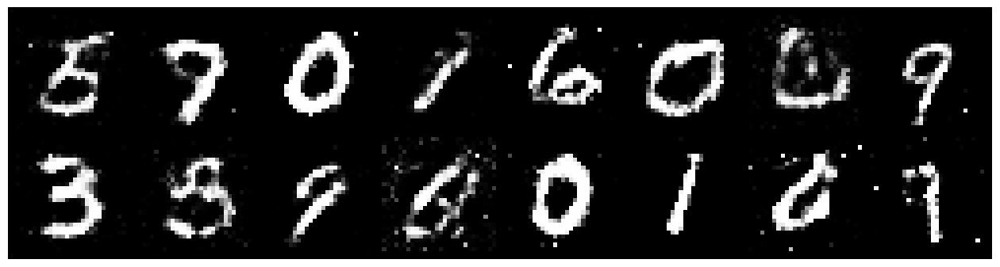

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.0160, Generator Loss: 1.2379
D(x): 0.6285, D(G(z)): 0.3410


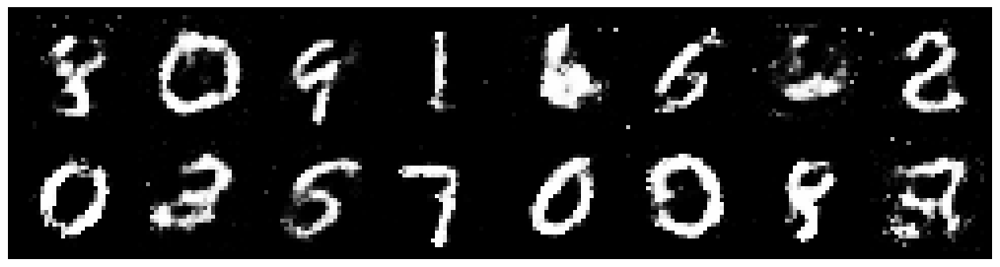

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.1091, Generator Loss: 1.1558
D(x): 0.5928, D(G(z)): 0.3596


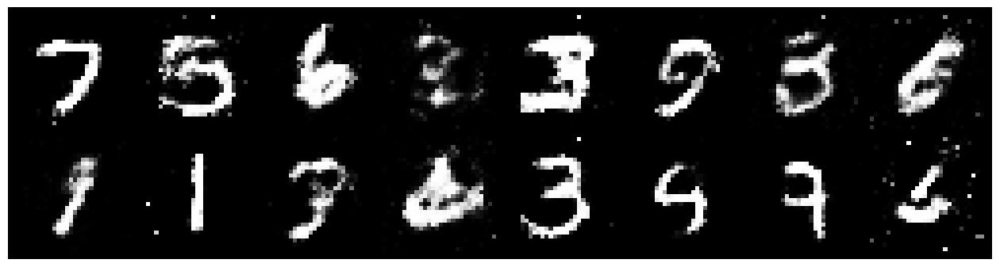

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.2552, Generator Loss: 1.0018
D(x): 0.5973, D(G(z)): 0.4219


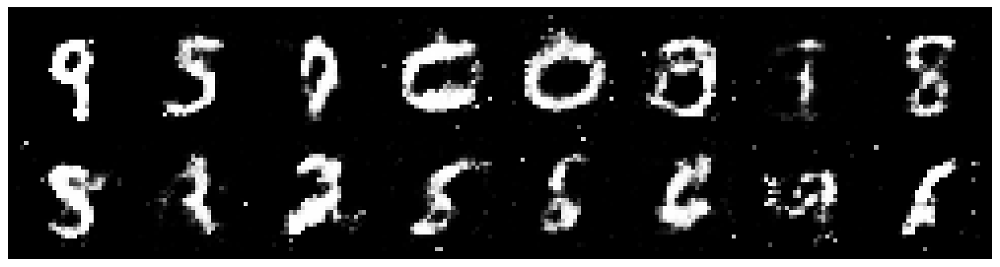

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.2127, Generator Loss: 0.9717
D(x): 0.5918, D(G(z)): 0.3792


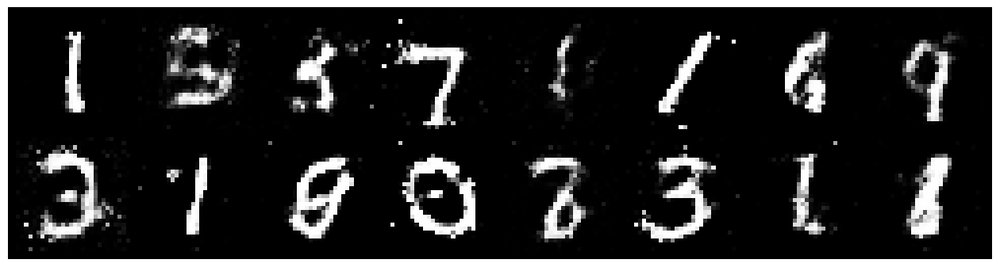

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.0082, Generator Loss: 1.2234
D(x): 0.6196, D(G(z)): 0.3070


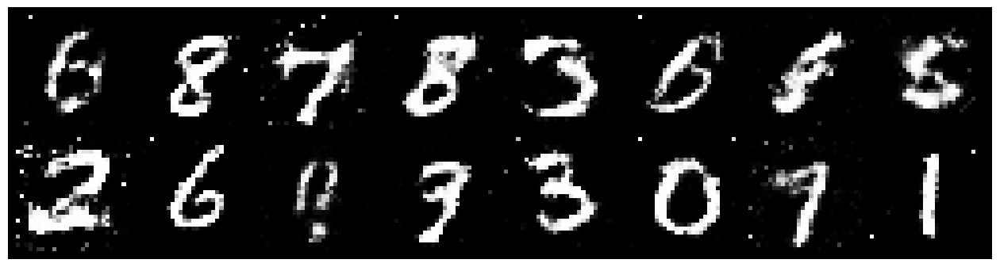

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.1090, Generator Loss: 1.2166
D(x): 0.6478, D(G(z)): 0.3865


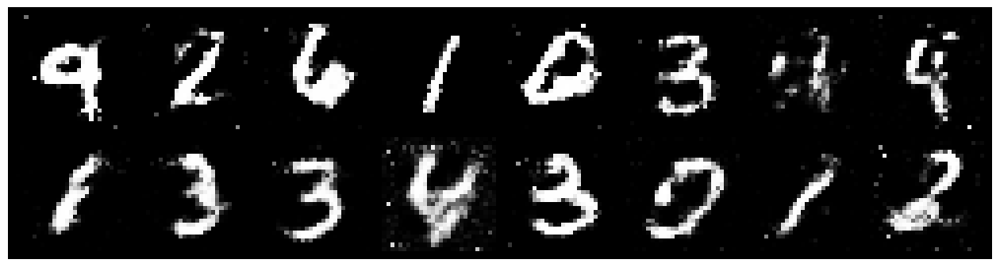

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.1451, Generator Loss: 1.0931
D(x): 0.5831, D(G(z)): 0.3345


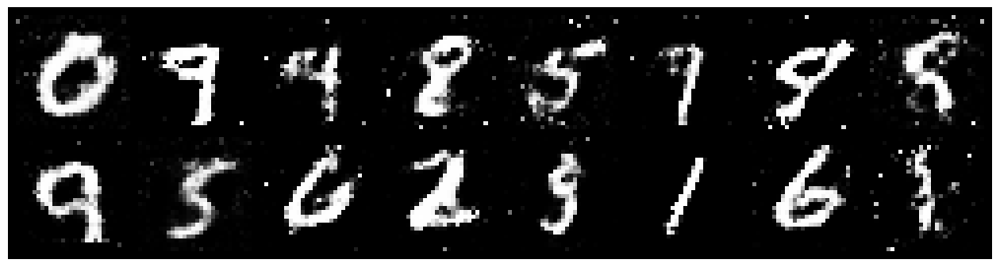

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.0912, Generator Loss: 1.0583
D(x): 0.6121, D(G(z)): 0.3792


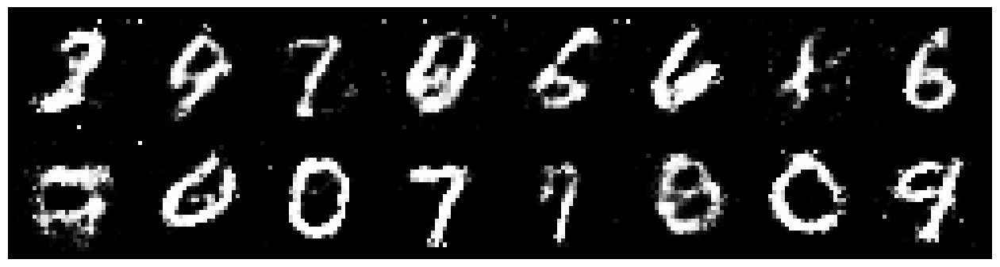

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.0916, Generator Loss: 1.2157
D(x): 0.6087, D(G(z)): 0.3480


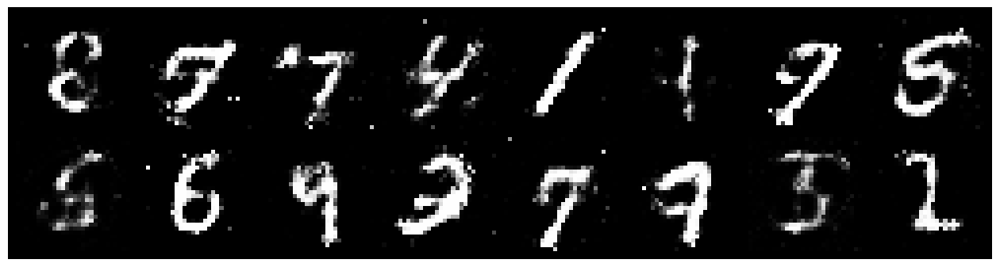

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.2140, Generator Loss: 1.1558
D(x): 0.5612, D(G(z)): 0.3605


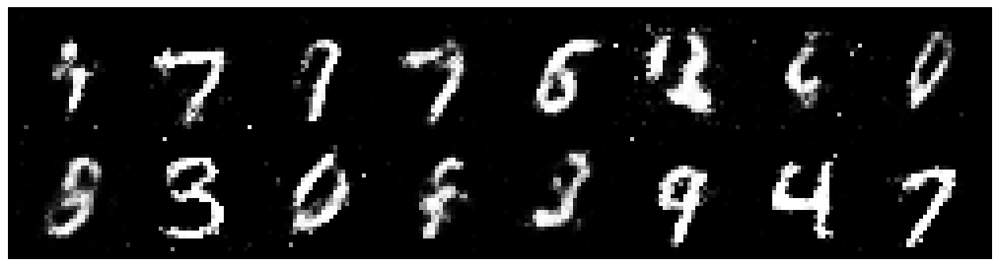

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.2202, Generator Loss: 0.8466
D(x): 0.6247, D(G(z)): 0.4662


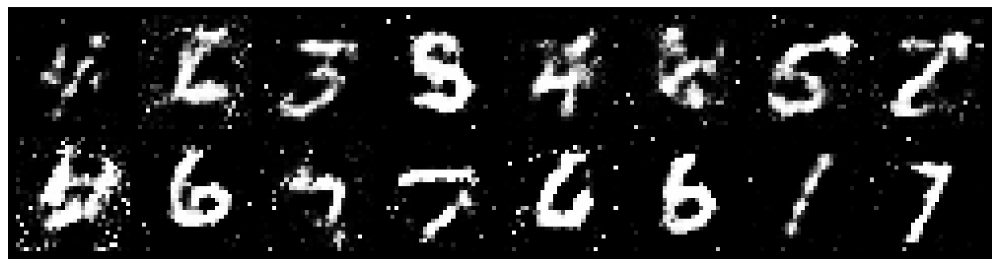

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.1675, Generator Loss: 1.1380
D(x): 0.5735, D(G(z)): 0.3952


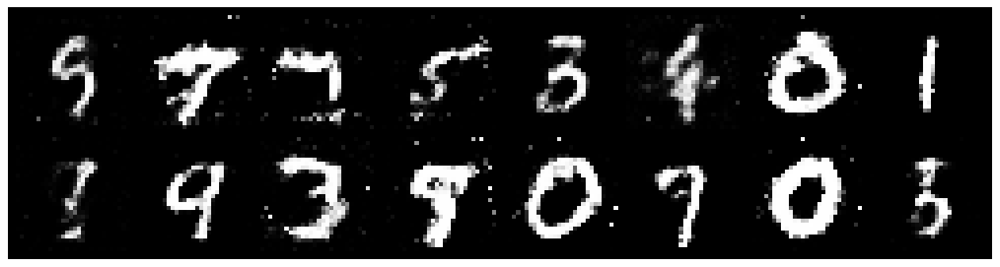

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.2259, Generator Loss: 0.9619
D(x): 0.6189, D(G(z)): 0.4641


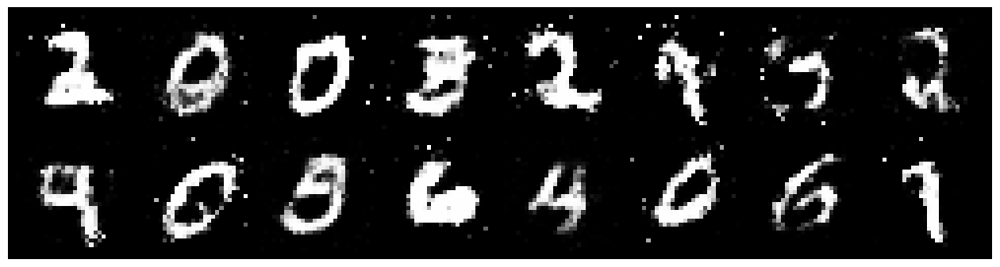

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.1614, Generator Loss: 1.3632
D(x): 0.6086, D(G(z)): 0.3620


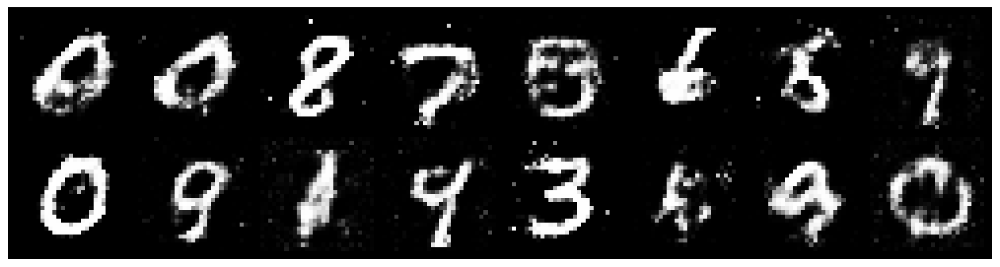

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.2564, Generator Loss: 0.9881
D(x): 0.5754, D(G(z)): 0.4280


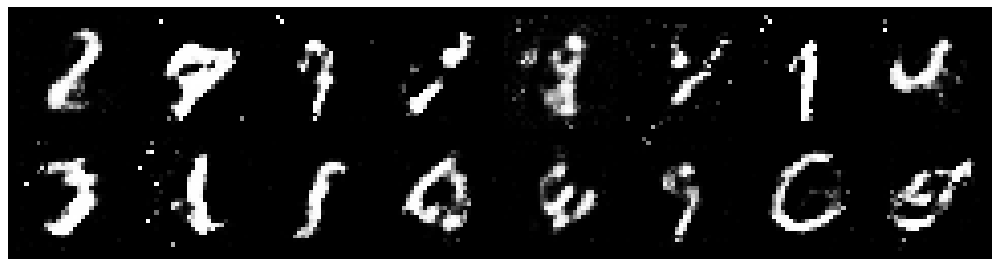

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.0895, Generator Loss: 1.2261
D(x): 0.6567, D(G(z)): 0.3955


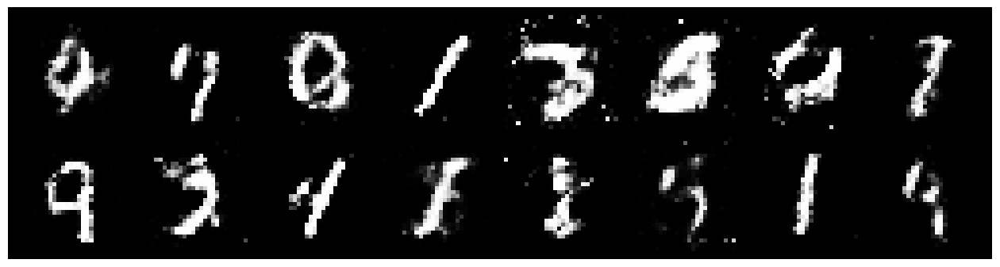

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.2576, Generator Loss: 1.0453
D(x): 0.5679, D(G(z)): 0.4208


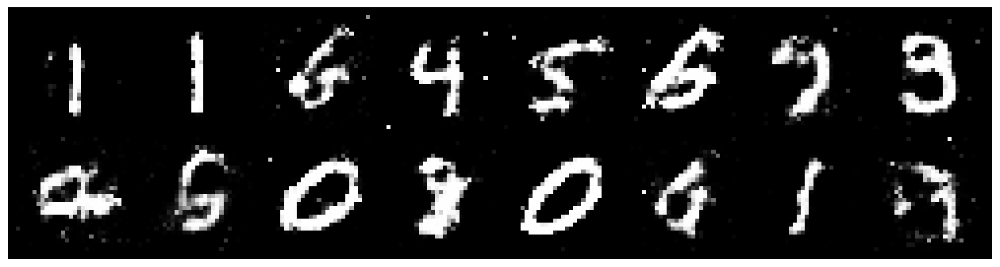

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.2284, Generator Loss: 0.8091
D(x): 0.5815, D(G(z)): 0.4376


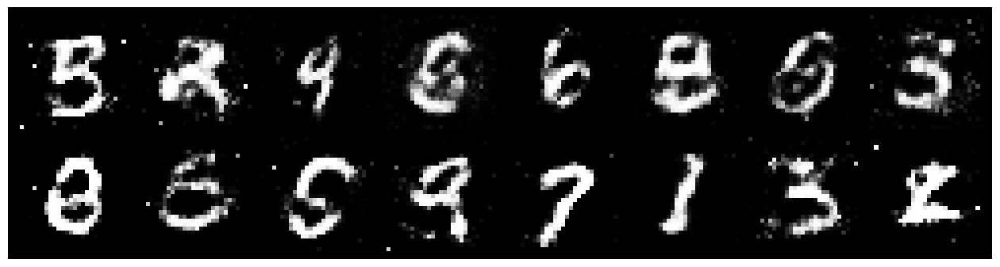

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.1226, Generator Loss: 0.9690
D(x): 0.6485, D(G(z)): 0.4404


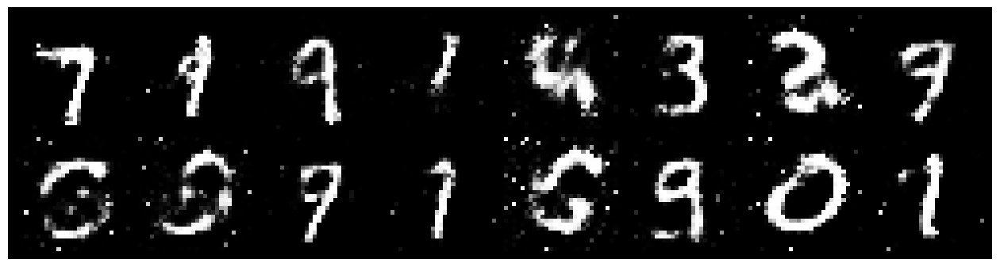

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1431, Generator Loss: 1.3948
D(x): 0.6326, D(G(z)): 0.4017


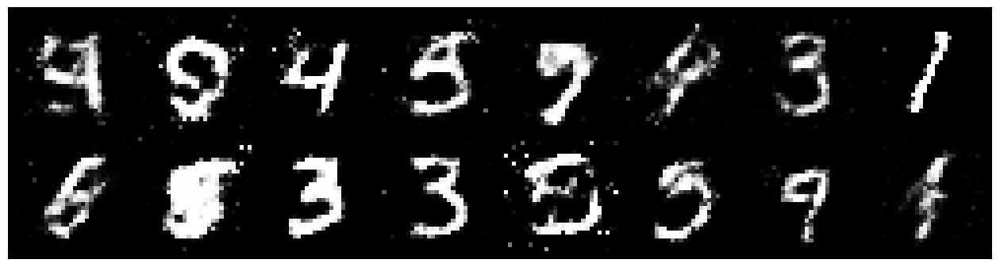

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1500, Generator Loss: 1.2765
D(x): 0.6164, D(G(z)): 0.3784


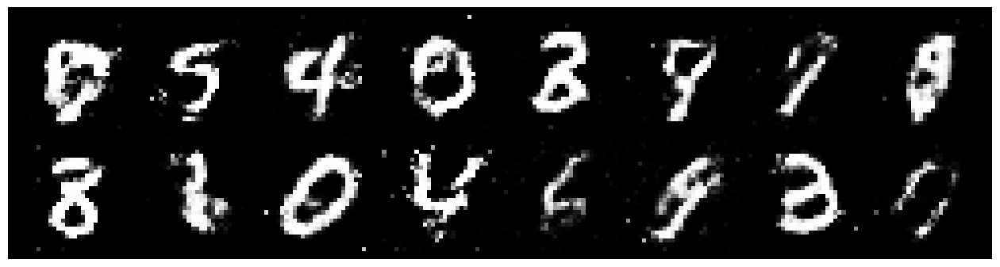

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.2747, Generator Loss: 1.1511
D(x): 0.5806, D(G(z)): 0.4286


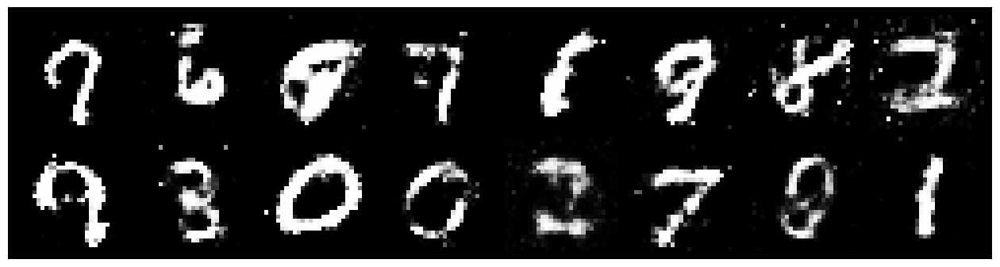

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.3816, Generator Loss: 0.9974
D(x): 0.5243, D(G(z)): 0.4318


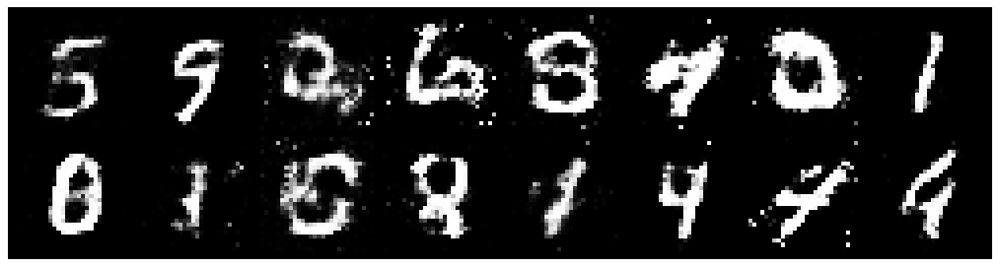

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1772, Generator Loss: 1.0880
D(x): 0.5463, D(G(z)): 0.3565


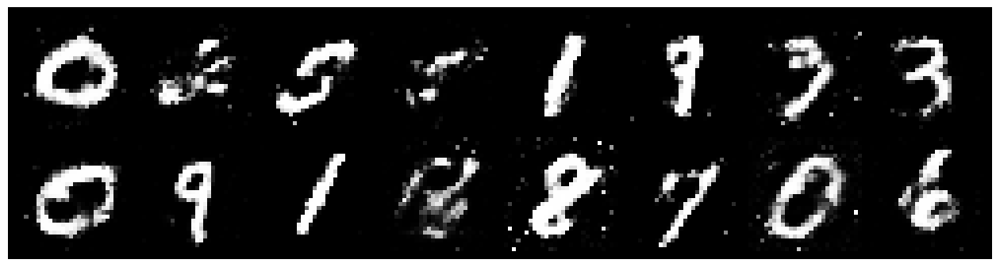

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.1694, Generator Loss: 1.0217
D(x): 0.6069, D(G(z)): 0.4039


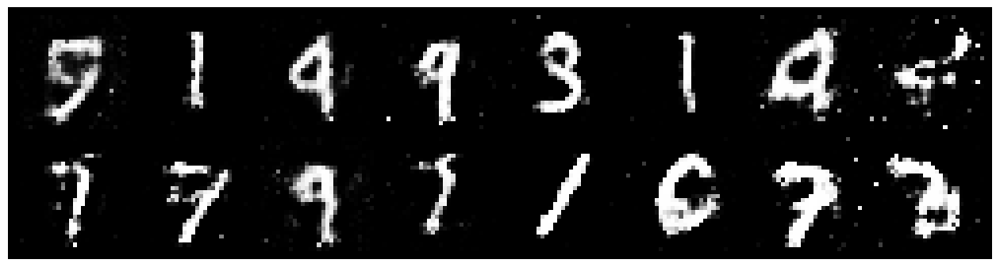

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.1388, Generator Loss: 0.9729
D(x): 0.5956, D(G(z)): 0.4000


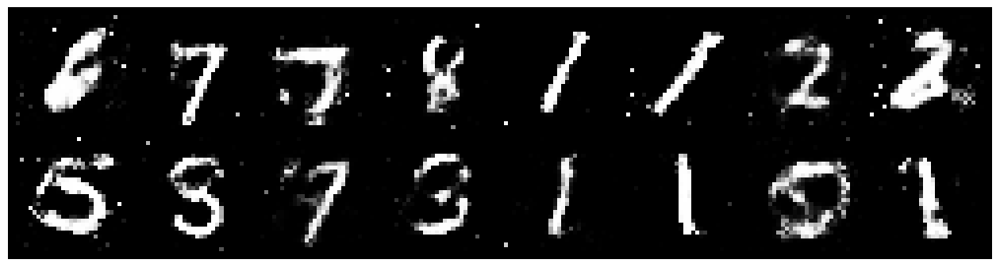

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.1599, Generator Loss: 0.9971
D(x): 0.6055, D(G(z)): 0.3947


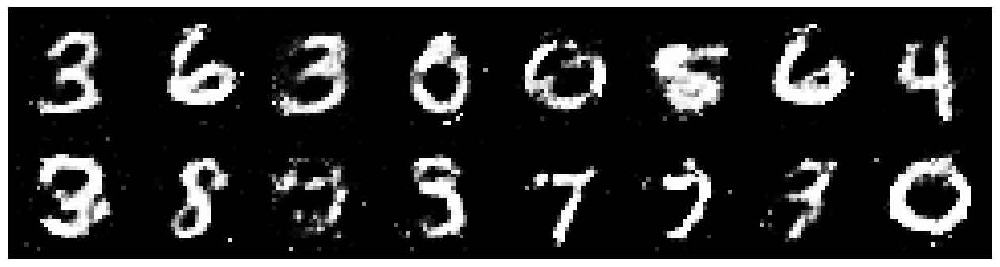

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.1168, Generator Loss: 0.9924
D(x): 0.6425, D(G(z)): 0.4268


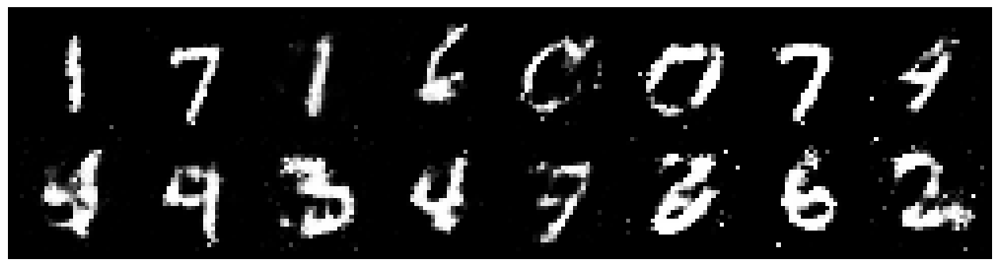

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.3734, Generator Loss: 1.0745
D(x): 0.5754, D(G(z)): 0.4575


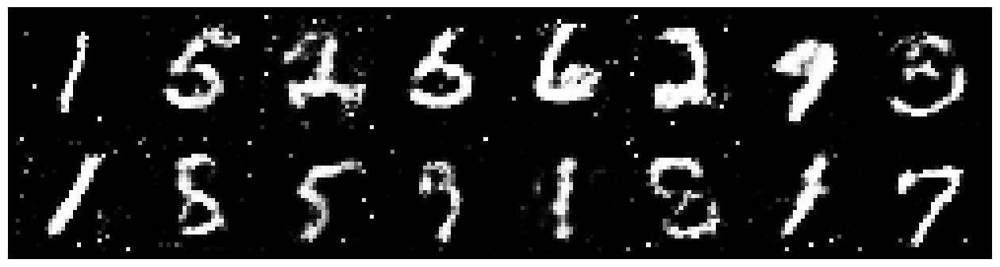

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.2004, Generator Loss: 1.0697
D(x): 0.6366, D(G(z)): 0.4312


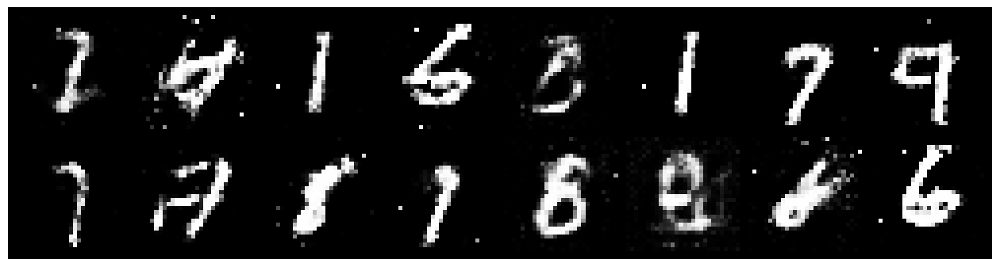

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.2471, Generator Loss: 0.9439
D(x): 0.5874, D(G(z)): 0.4290


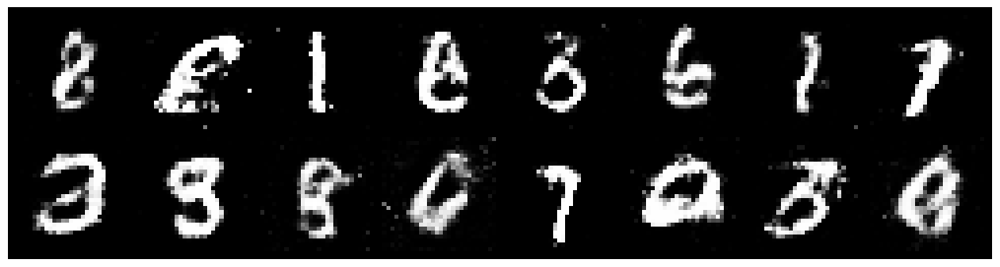

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.0652, Generator Loss: 0.8080
D(x): 0.6734, D(G(z)): 0.4425


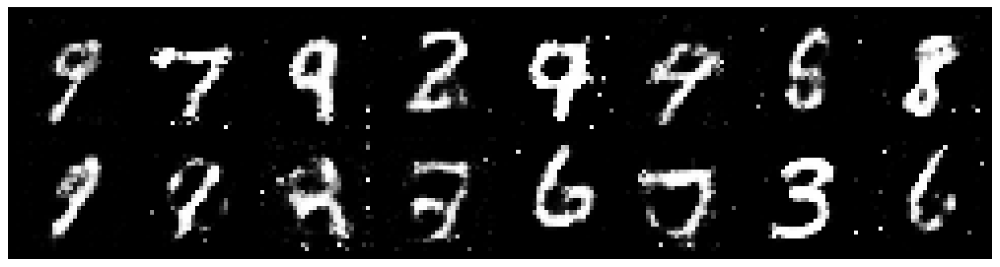

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.2681, Generator Loss: 0.8538
D(x): 0.5944, D(G(z)): 0.4366


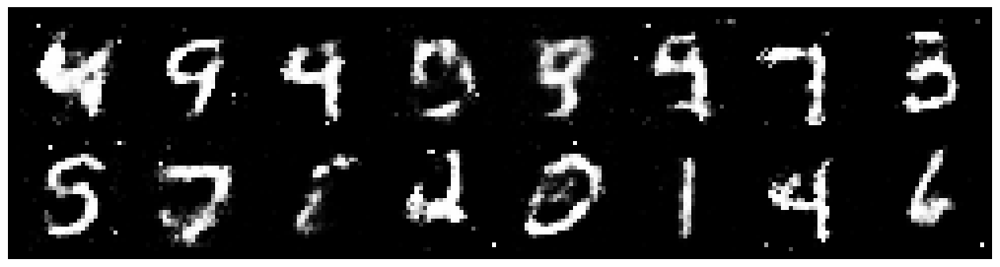

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.1983, Generator Loss: 1.1635
D(x): 0.5731, D(G(z)): 0.3817


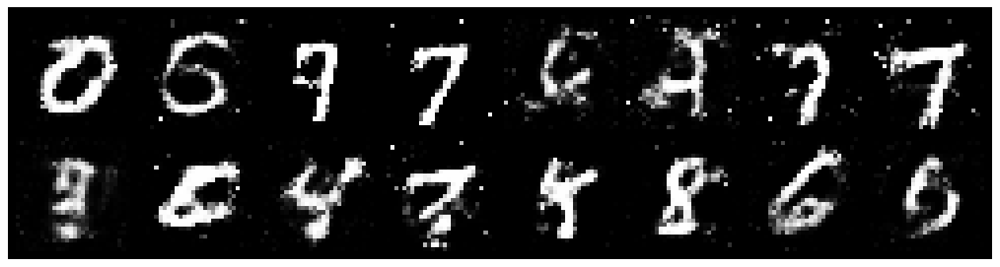

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.2900, Generator Loss: 0.9310
D(x): 0.5777, D(G(z)): 0.4278


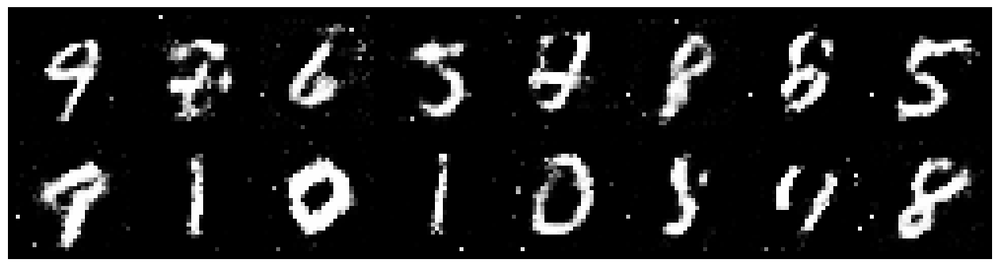

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.1162, Generator Loss: 1.0168
D(x): 0.5740, D(G(z)): 0.3633


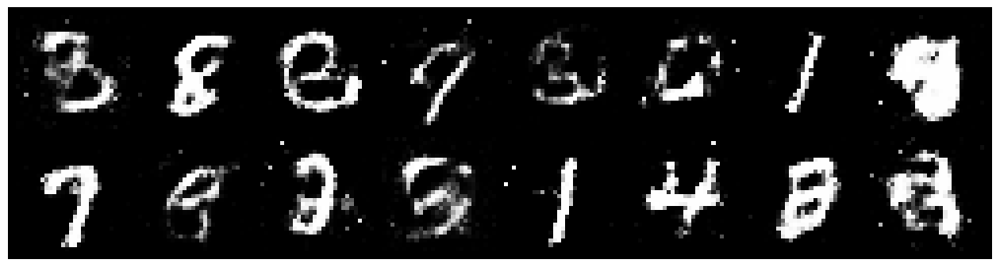

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.2345, Generator Loss: 1.1023
D(x): 0.5875, D(G(z)): 0.4140


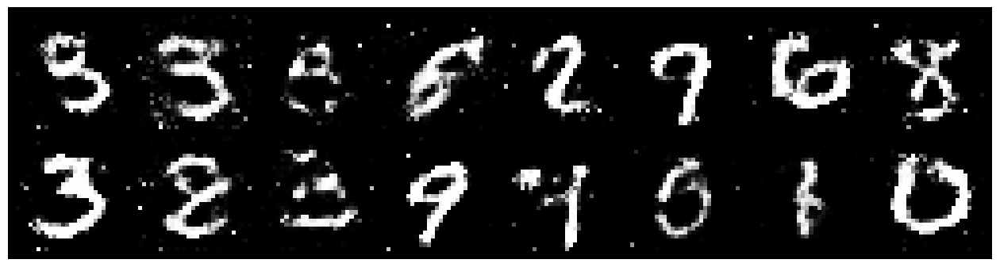

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.0811, Generator Loss: 0.9634
D(x): 0.6232, D(G(z)): 0.3744


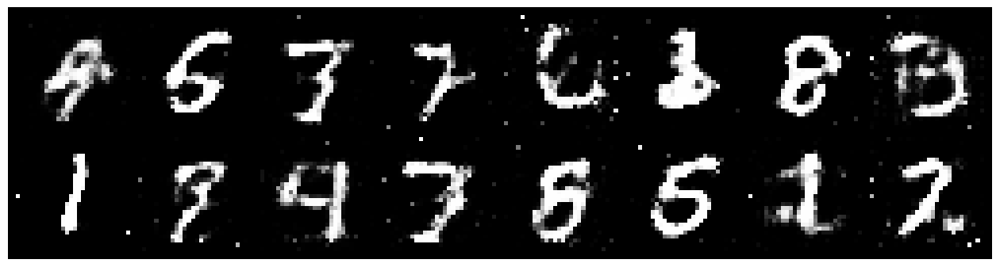

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.0832, Generator Loss: 1.0870
D(x): 0.6526, D(G(z)): 0.3896


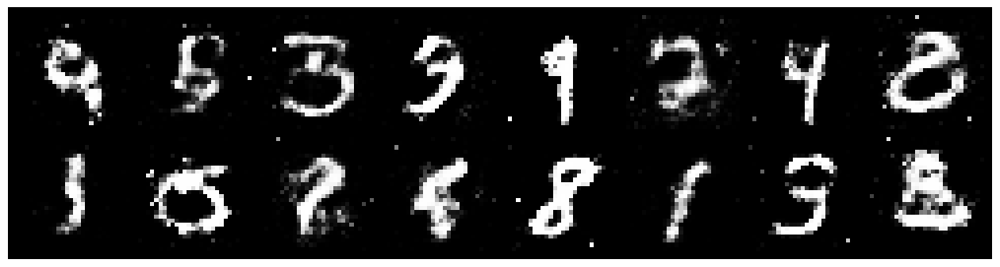

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.0050, Generator Loss: 1.0164
D(x): 0.6698, D(G(z)): 0.3877


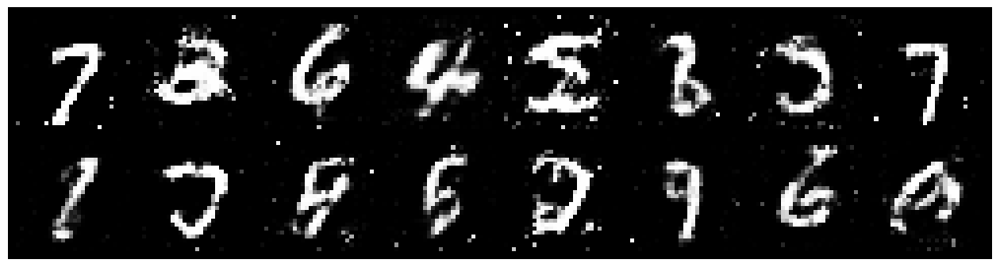

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.0560, Generator Loss: 1.2766
D(x): 0.6240, D(G(z)): 0.3608


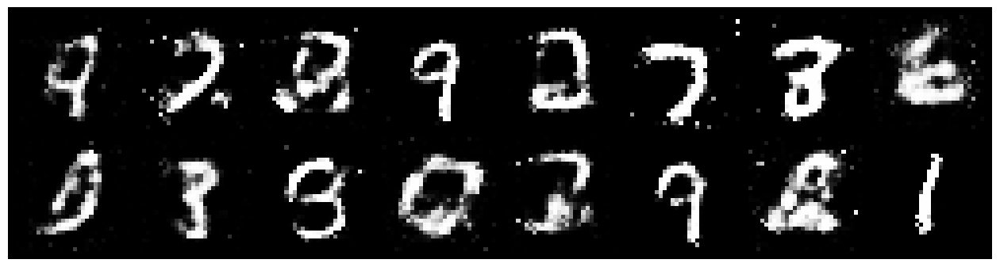

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.0743, Generator Loss: 1.0202
D(x): 0.6214, D(G(z)): 0.3837


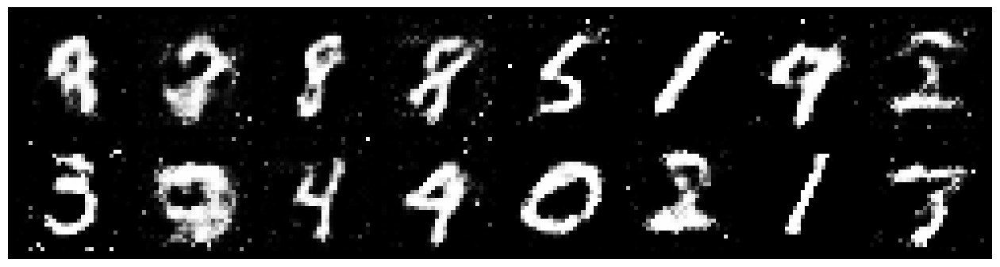

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.2242, Generator Loss: 0.9266
D(x): 0.5791, D(G(z)): 0.4379


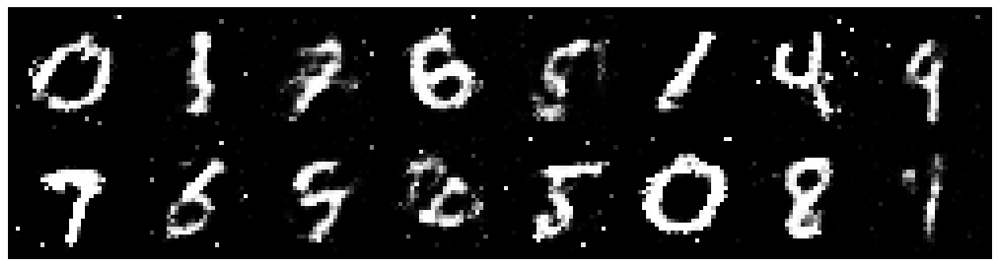

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.1114, Generator Loss: 0.9866
D(x): 0.6409, D(G(z)): 0.4007


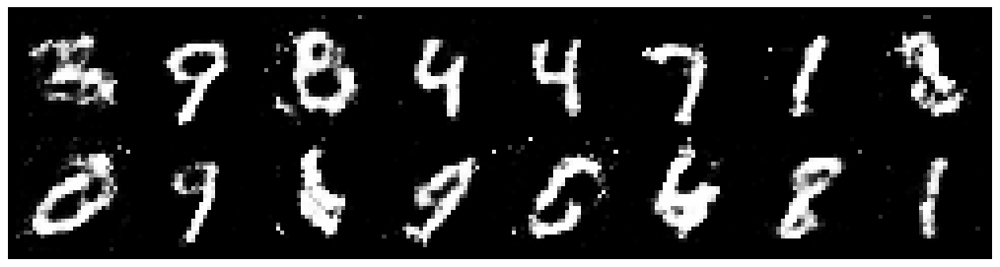

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.1868, Generator Loss: 0.9907
D(x): 0.6040, D(G(z)): 0.4221


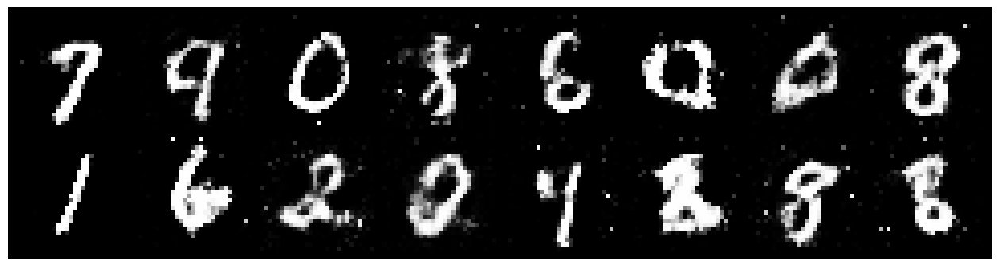

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.1458, Generator Loss: 1.0519
D(x): 0.6058, D(G(z)): 0.4218


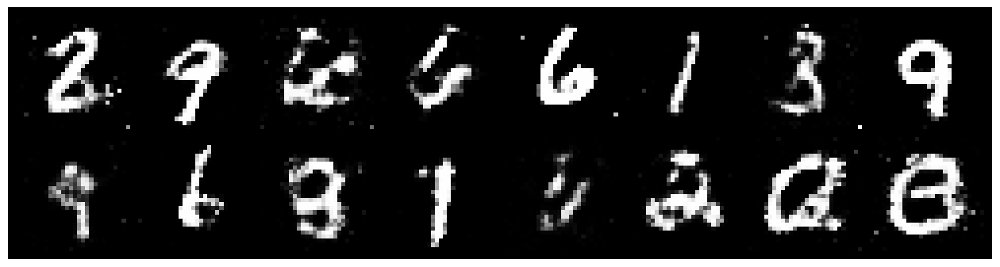

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.2522, Generator Loss: 1.1005
D(x): 0.6254, D(G(z)): 0.4368


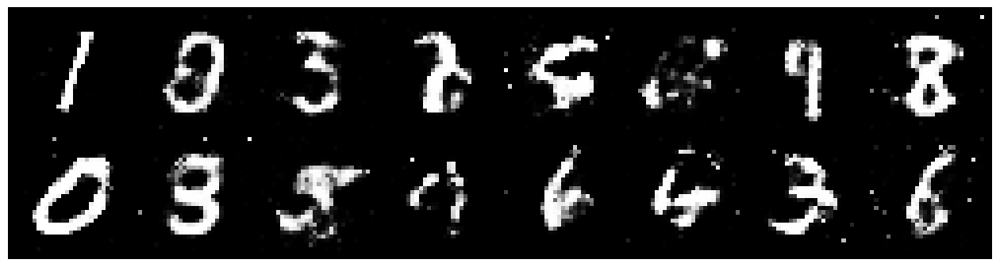

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.2176, Generator Loss: 0.8426
D(x): 0.6705, D(G(z)): 0.4750


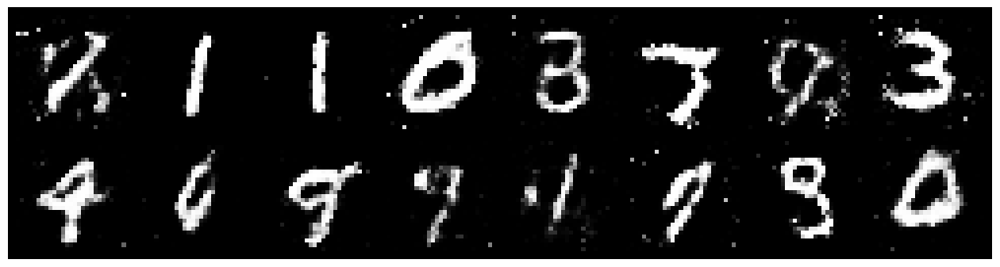

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.1435, Generator Loss: 1.1367
D(x): 0.6108, D(G(z)): 0.4029


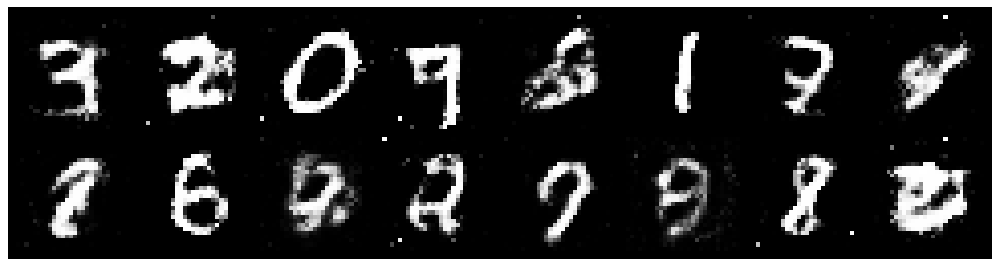

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 0.9741, Generator Loss: 1.2863
D(x): 0.6685, D(G(z)): 0.3390


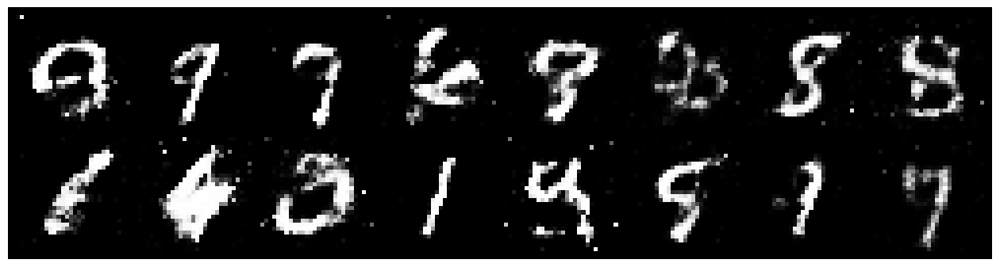

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.1628, Generator Loss: 1.1687
D(x): 0.5718, D(G(z)): 0.3956


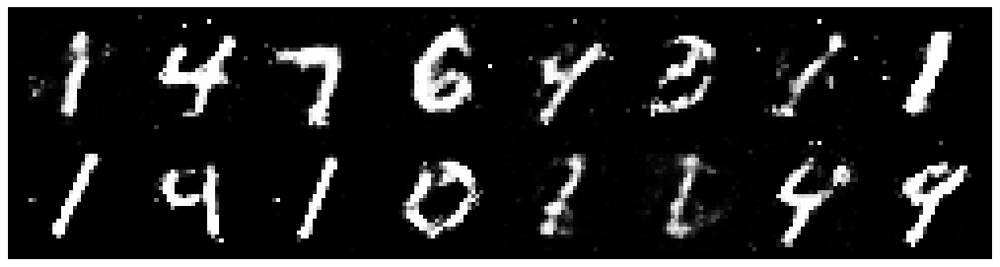

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.1504, Generator Loss: 1.0385
D(x): 0.5577, D(G(z)): 0.3771


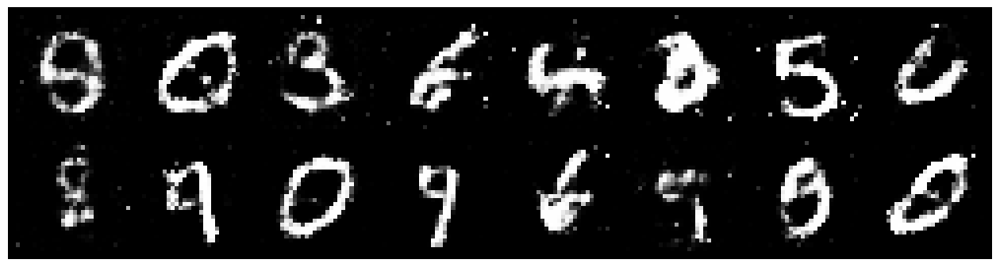

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2130, Generator Loss: 0.9842
D(x): 0.5737, D(G(z)): 0.4183


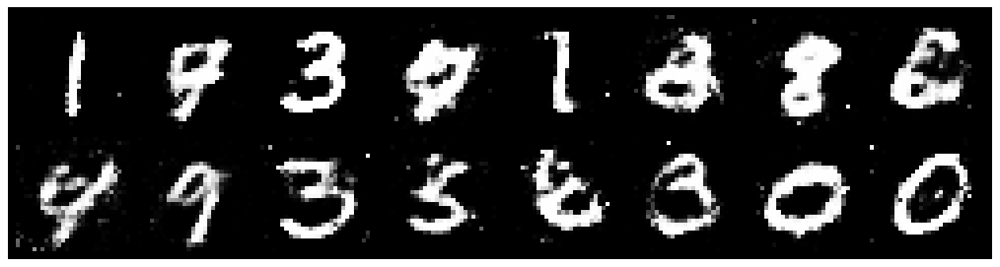

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.1849, Generator Loss: 0.8993
D(x): 0.5945, D(G(z)): 0.4318


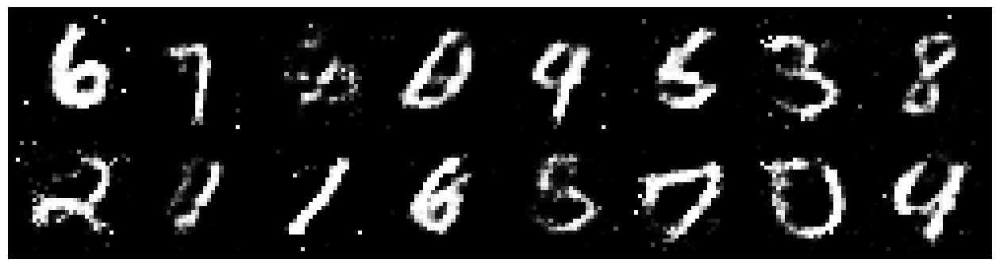

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.2491, Generator Loss: 0.8990
D(x): 0.5949, D(G(z)): 0.4575


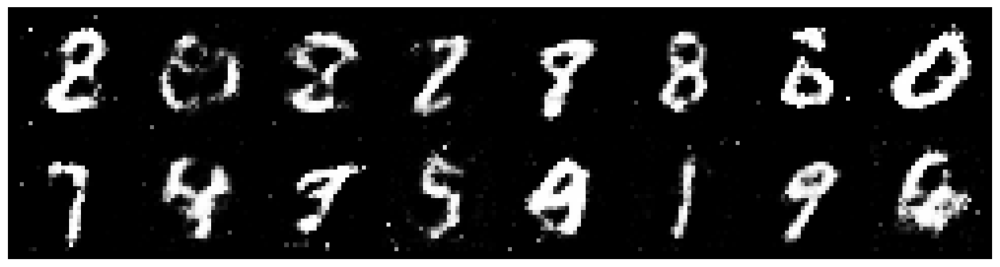

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.1387, Generator Loss: 1.1408
D(x): 0.5917, D(G(z)): 0.3817


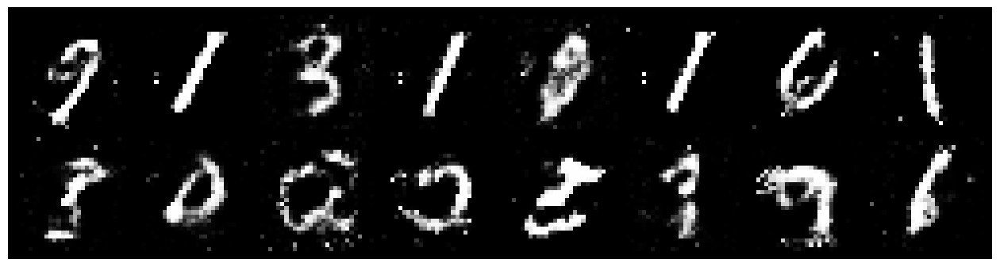

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.1976, Generator Loss: 0.8829
D(x): 0.5945, D(G(z)): 0.4367


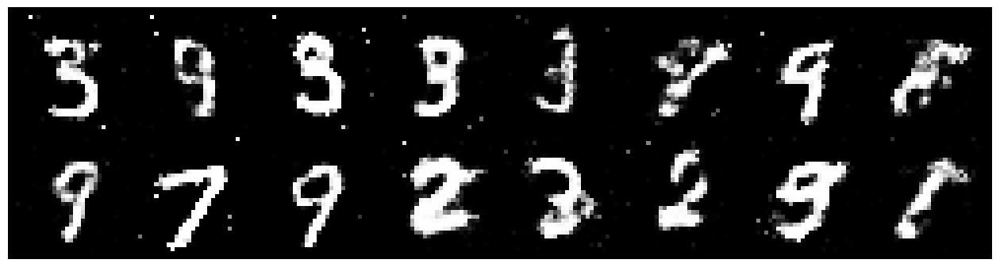

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.1434, Generator Loss: 0.9898
D(x): 0.6158, D(G(z)): 0.3937


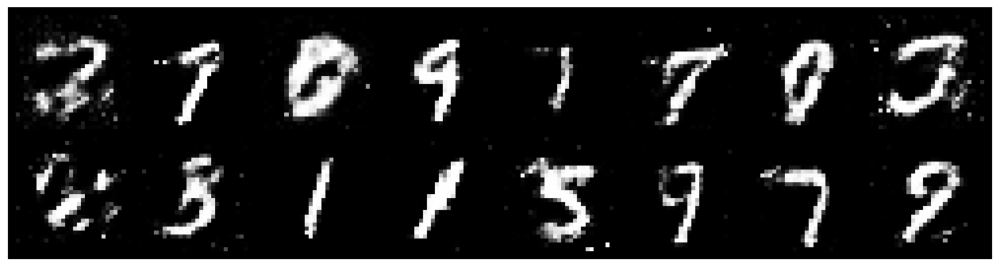

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2087, Generator Loss: 0.7537
D(x): 0.6572, D(G(z)): 0.4916


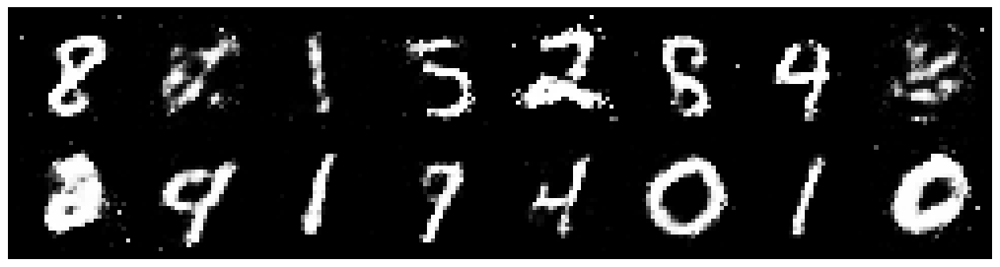

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.0704, Generator Loss: 1.1261
D(x): 0.6054, D(G(z)): 0.3566


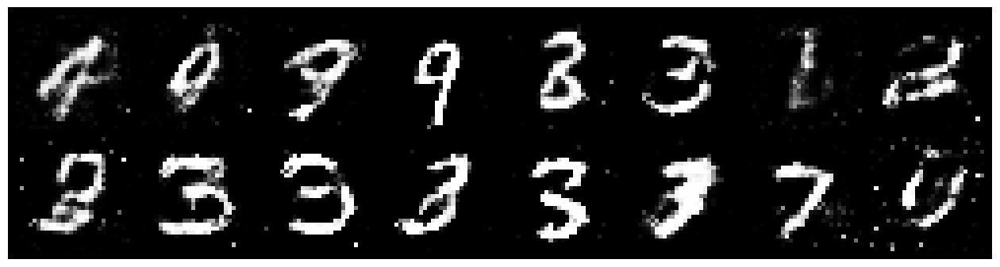

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1983, Generator Loss: 1.0826
D(x): 0.5627, D(G(z)): 0.4070


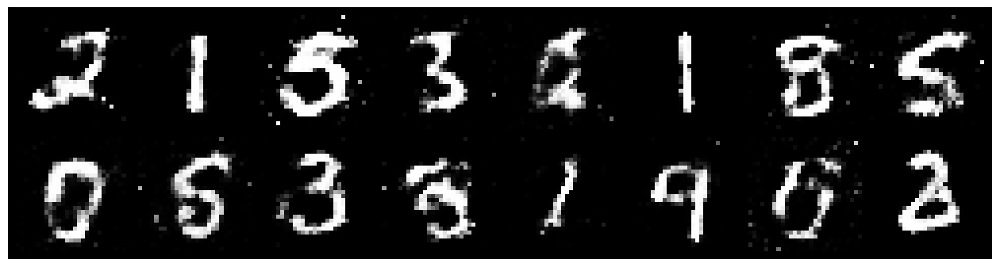

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.1856, Generator Loss: 1.0399
D(x): 0.6090, D(G(z)): 0.4268


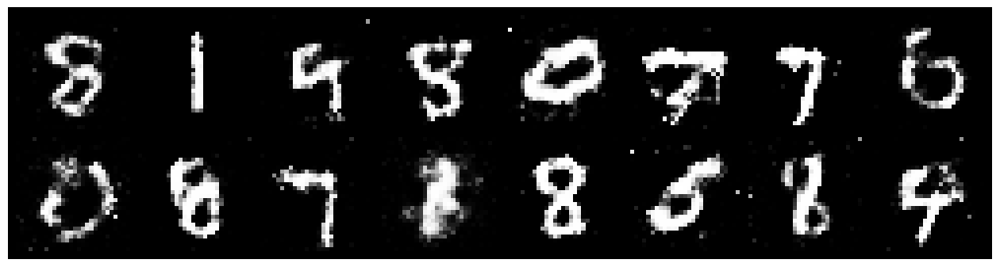

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.2705, Generator Loss: 1.1033
D(x): 0.5327, D(G(z)): 0.4119


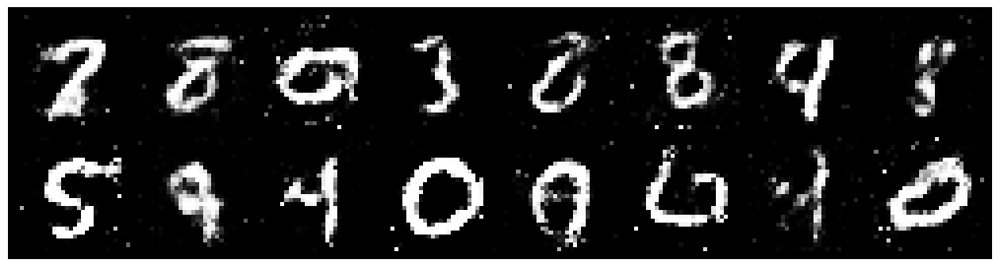

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.2341, Generator Loss: 0.9387
D(x): 0.5307, D(G(z)): 0.3933


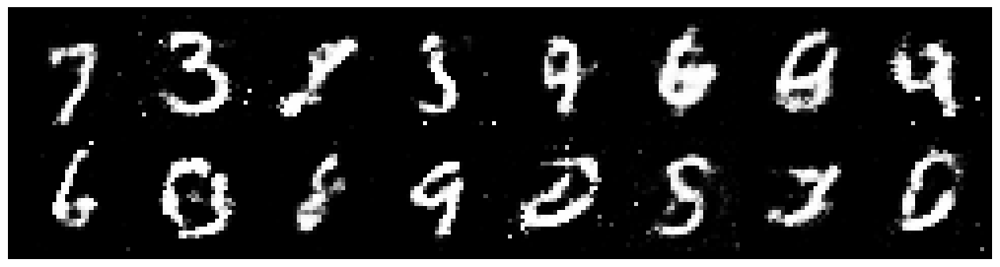

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2438, Generator Loss: 0.8913
D(x): 0.6040, D(G(z)): 0.4708


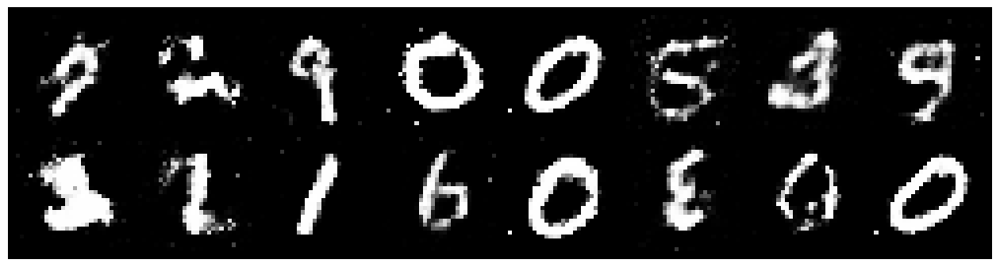

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.1772, Generator Loss: 1.1613
D(x): 0.5941, D(G(z)): 0.3641


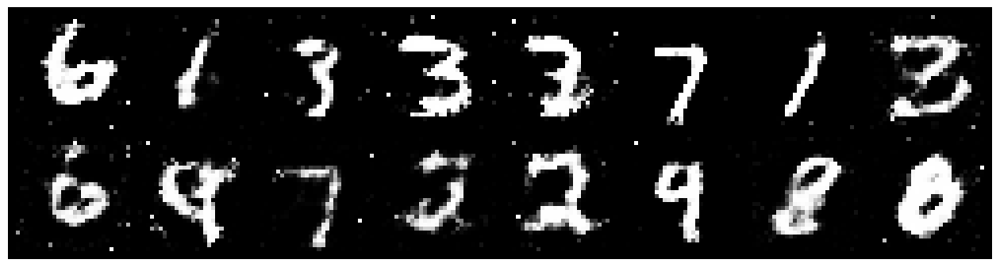

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.1353, Generator Loss: 1.0603
D(x): 0.6472, D(G(z)): 0.4172


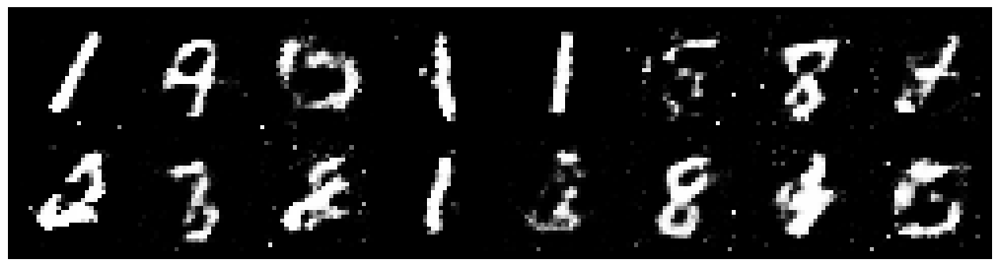

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.0733, Generator Loss: 1.1609
D(x): 0.6124, D(G(z)): 0.3718


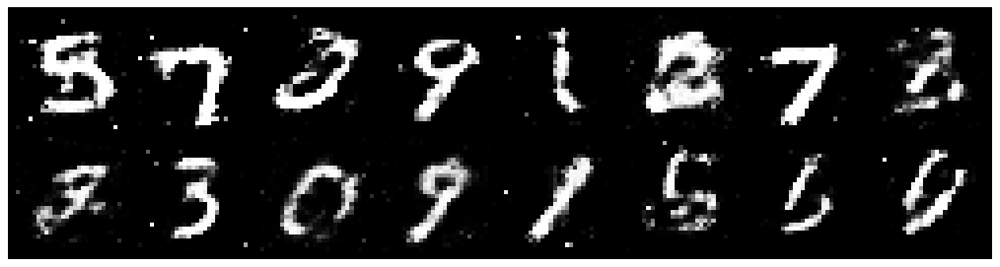

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.1436, Generator Loss: 1.2008
D(x): 0.6015, D(G(z)): 0.3830


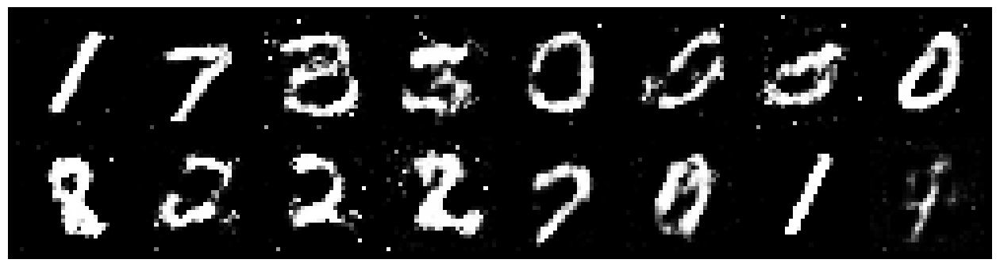

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.1050, Generator Loss: 1.1255
D(x): 0.6469, D(G(z)): 0.4082


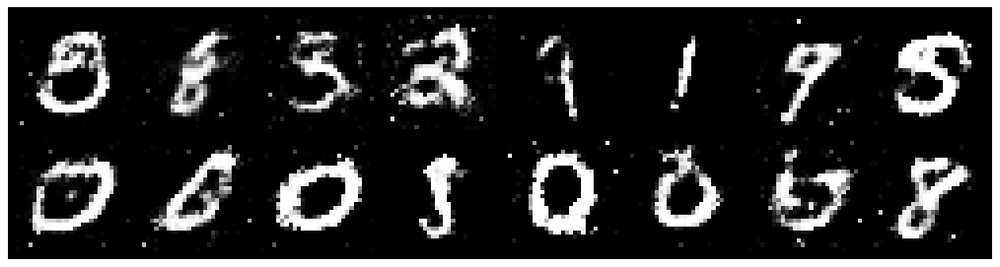

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.1611, Generator Loss: 0.9212
D(x): 0.6741, D(G(z)): 0.4592


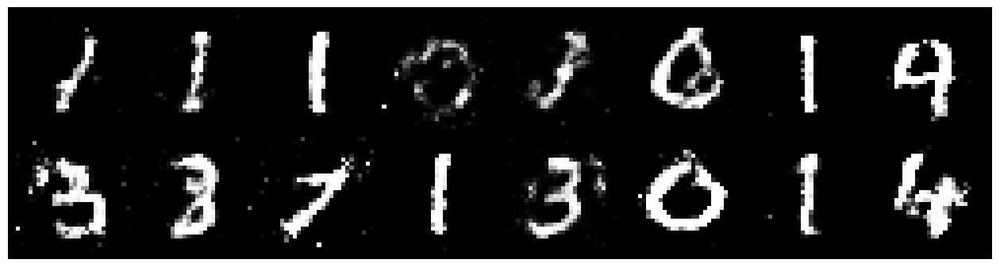

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.2772, Generator Loss: 0.9042
D(x): 0.5886, D(G(z)): 0.4430


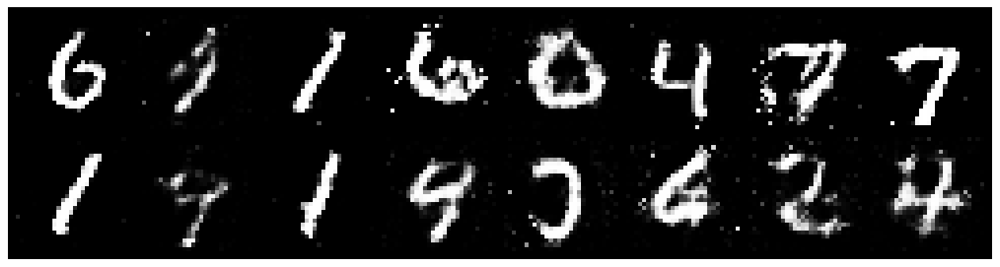

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.0970, Generator Loss: 1.2511
D(x): 0.5962, D(G(z)): 0.3578


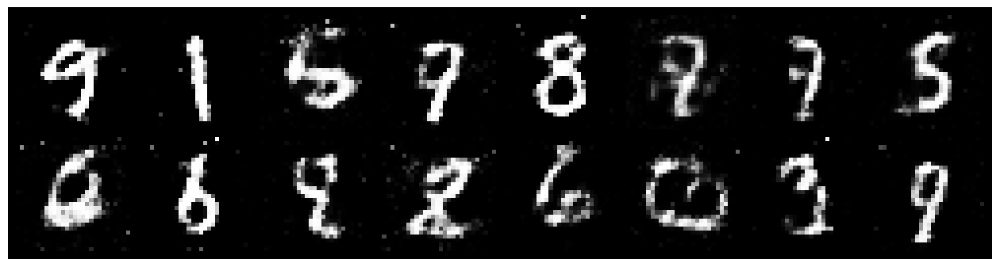

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.0789, Generator Loss: 1.4415
D(x): 0.5838, D(G(z)): 0.3126


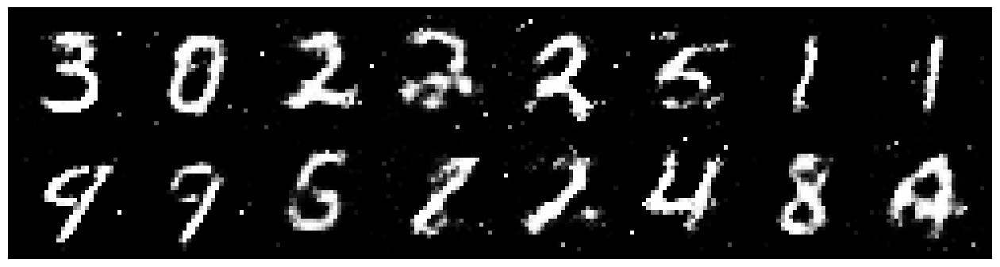

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.1282, Generator Loss: 1.0681
D(x): 0.5696, D(G(z)): 0.3672


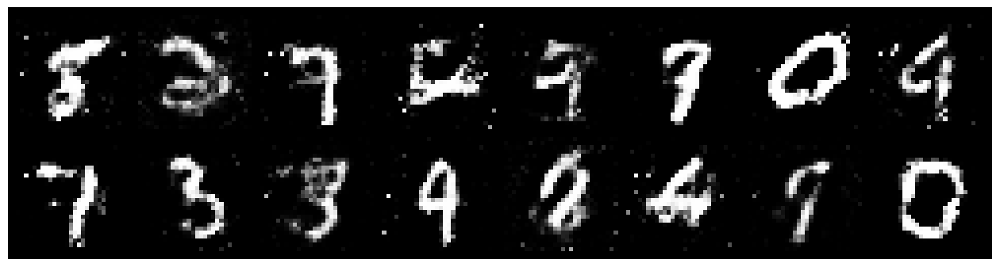

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.1872, Generator Loss: 0.8864
D(x): 0.5741, D(G(z)): 0.4280


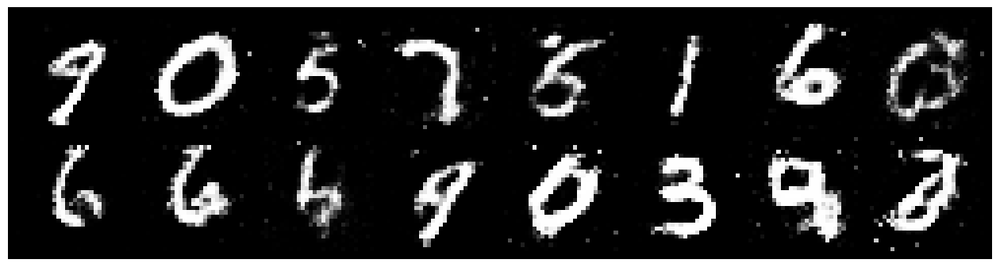

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.1827, Generator Loss: 0.9736
D(x): 0.5927, D(G(z)): 0.4135


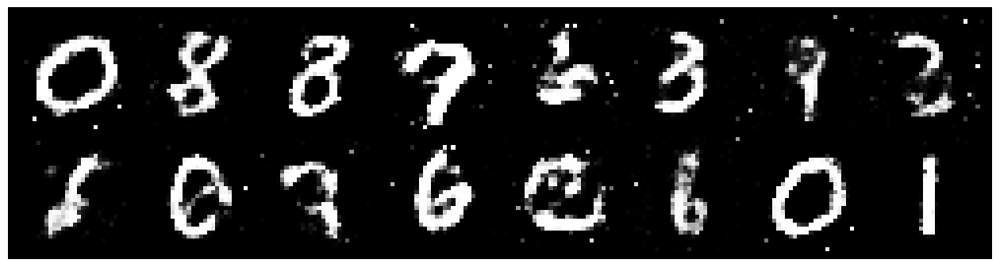

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.1897, Generator Loss: 0.9505
D(x): 0.5961, D(G(z)): 0.4403


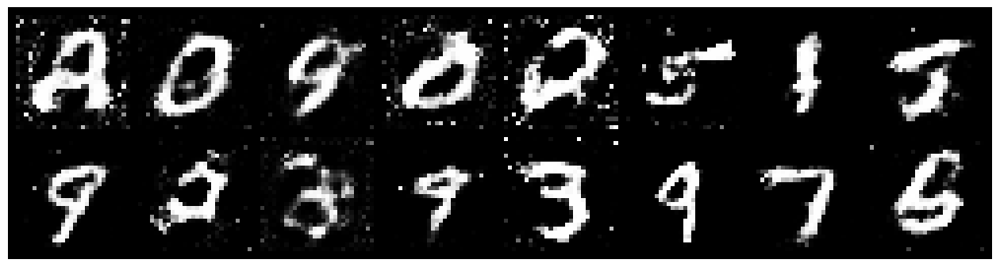

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.2509, Generator Loss: 0.8928
D(x): 0.6066, D(G(z)): 0.4646


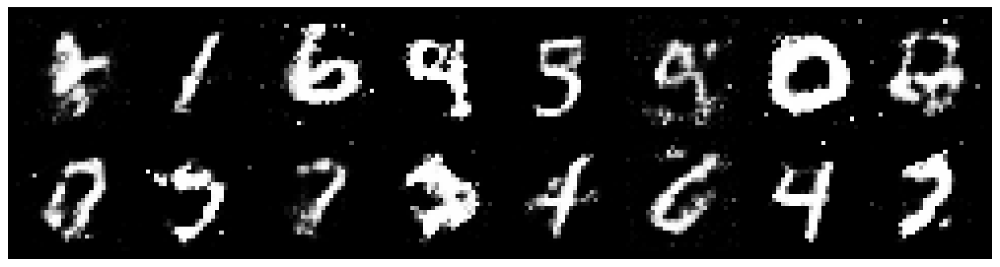

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.3184, Generator Loss: 1.0038
D(x): 0.5703, D(G(z)): 0.4382


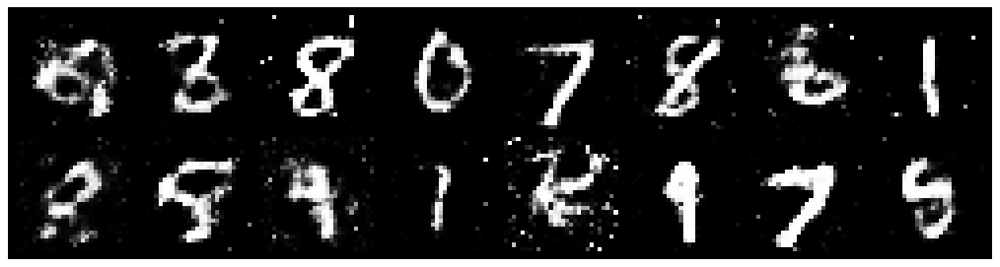

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1399, Generator Loss: 1.0528
D(x): 0.6321, D(G(z)): 0.4021


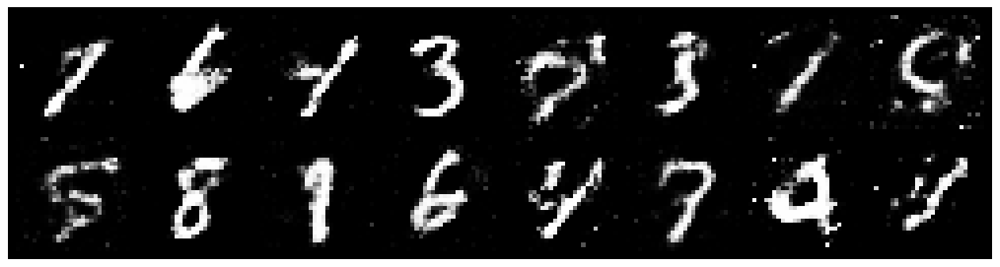

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.3380, Generator Loss: 0.7984
D(x): 0.5871, D(G(z)): 0.4927


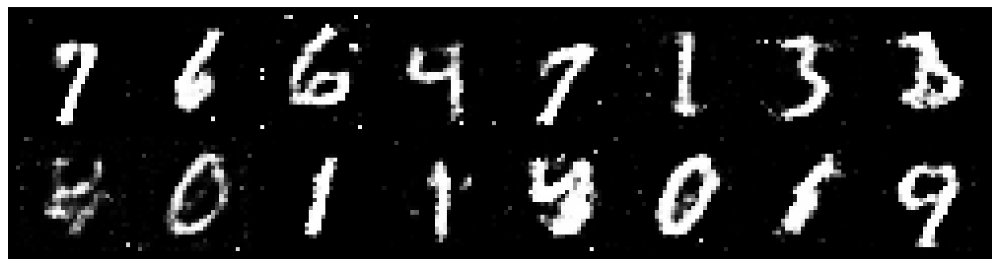

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.3259, Generator Loss: 0.9548
D(x): 0.5553, D(G(z)): 0.4462


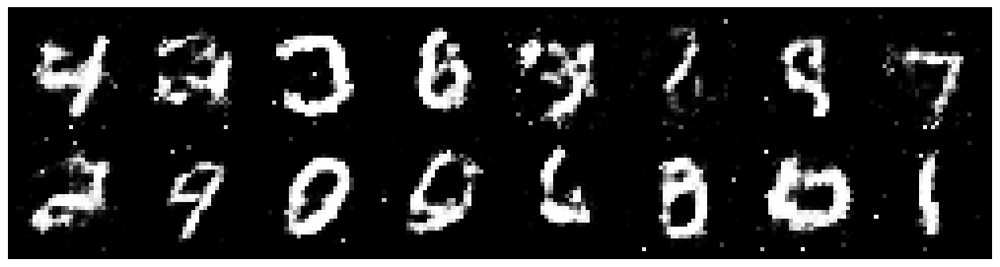

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.3131, Generator Loss: 0.9807
D(x): 0.5443, D(G(z)): 0.4066


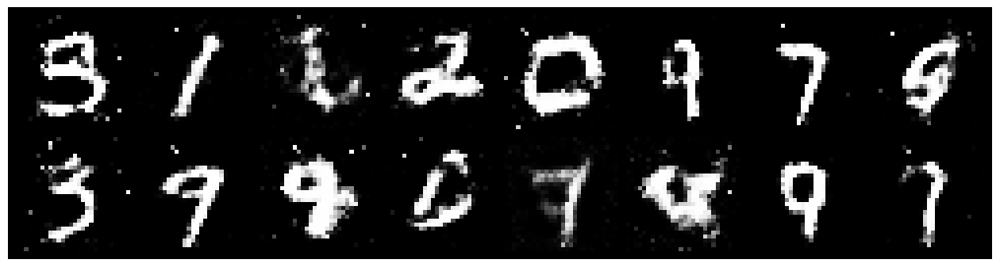

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.2603, Generator Loss: 1.2859
D(x): 0.5865, D(G(z)): 0.3738


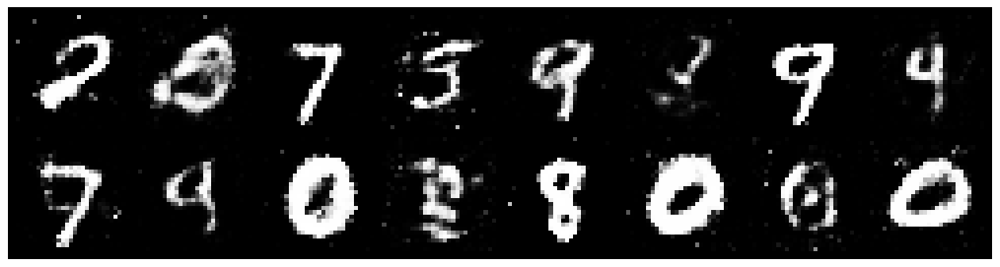

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2869, Generator Loss: 1.1682
D(x): 0.5262, D(G(z)): 0.3790


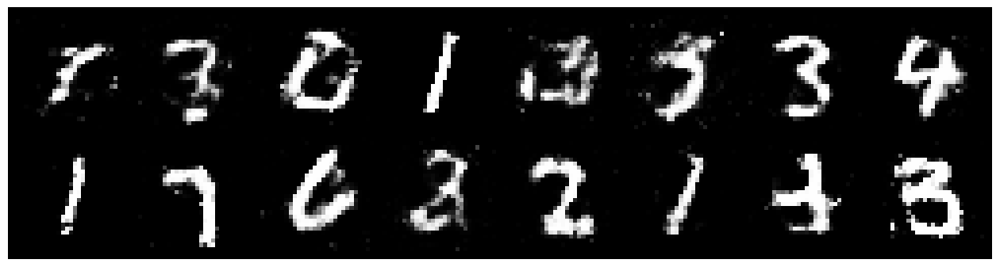

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2599, Generator Loss: 1.0964
D(x): 0.5922, D(G(z)): 0.4041


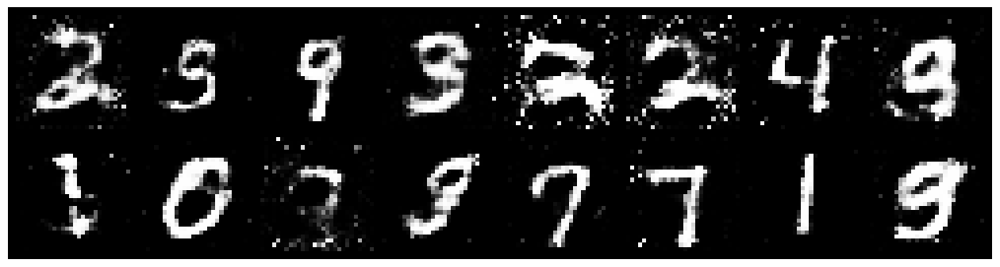

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2458, Generator Loss: 1.1392
D(x): 0.5517, D(G(z)): 0.3946


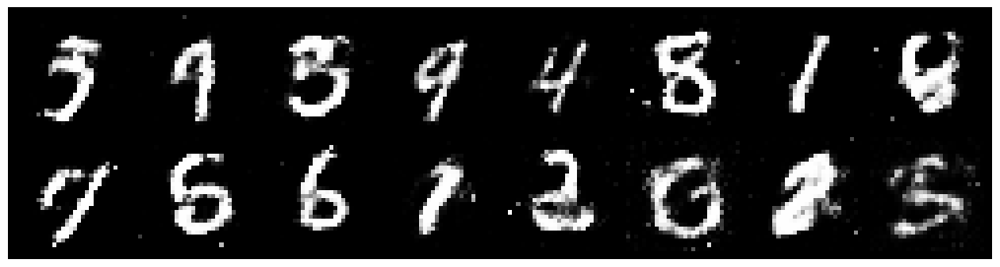

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.1362, Generator Loss: 0.9915
D(x): 0.6397, D(G(z)): 0.4303


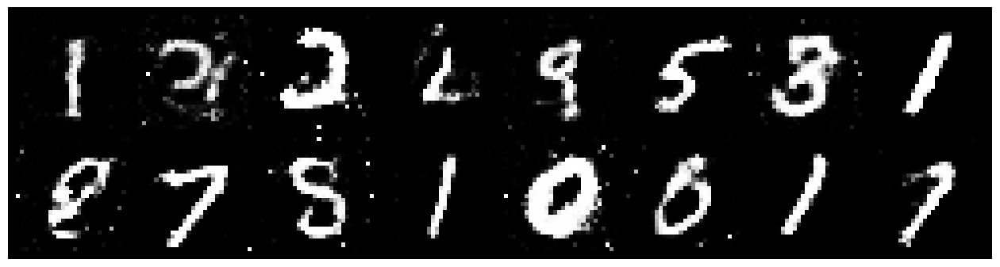

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1875, Generator Loss: 1.3399
D(x): 0.5907, D(G(z)): 0.3991


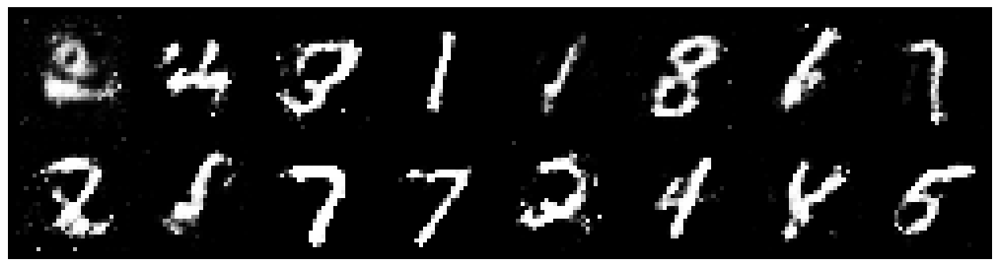

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.1350, Generator Loss: 0.9004
D(x): 0.6425, D(G(z)): 0.4309


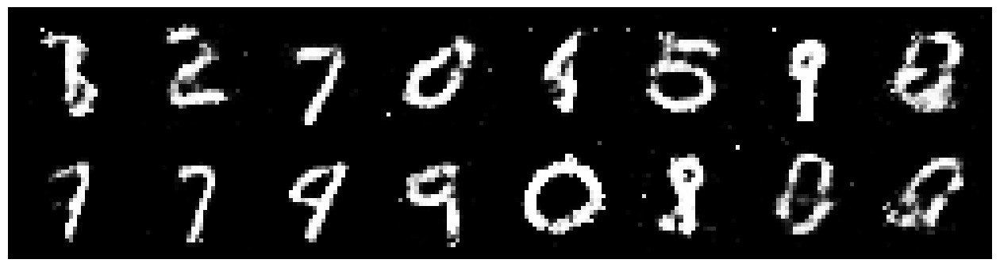

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1676, Generator Loss: 1.0509
D(x): 0.5607, D(G(z)): 0.3815


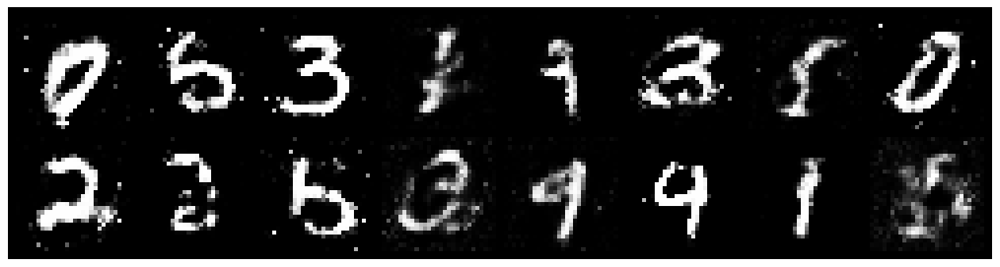

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.2975, Generator Loss: 1.0697
D(x): 0.5500, D(G(z)): 0.4213


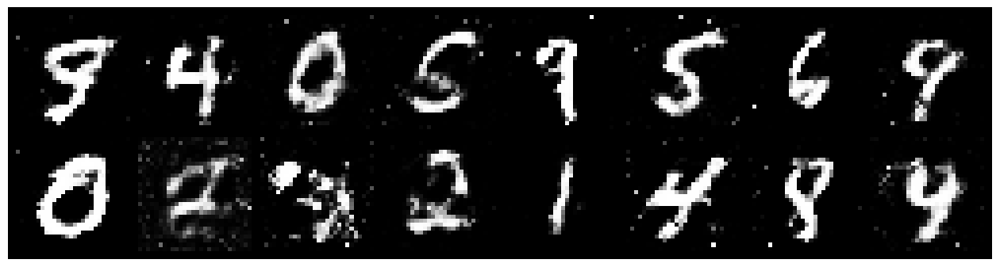

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.2247, Generator Loss: 0.9720
D(x): 0.5689, D(G(z)): 0.4219


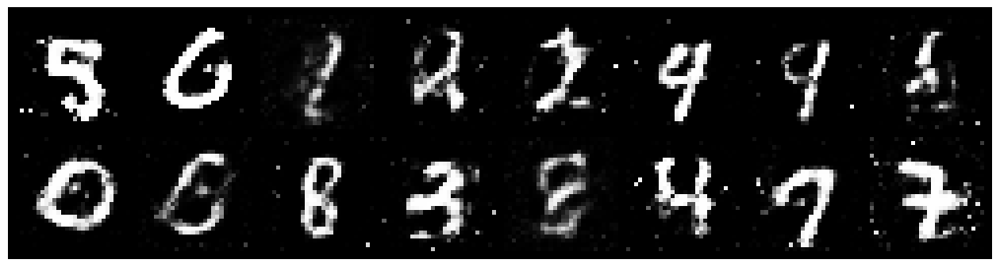

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.2342, Generator Loss: 0.9123
D(x): 0.6247, D(G(z)): 0.4582


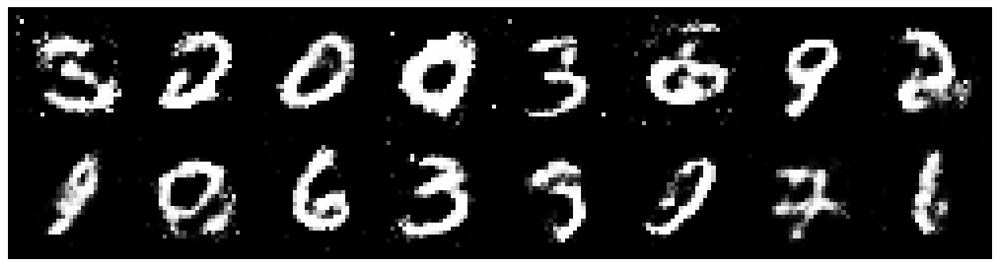

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.2924, Generator Loss: 1.0740
D(x): 0.6034, D(G(z)): 0.4174


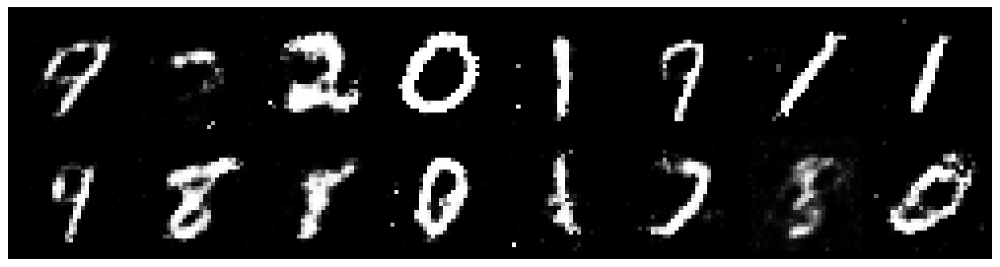

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1369, Generator Loss: 1.0215
D(x): 0.5947, D(G(z)): 0.3928


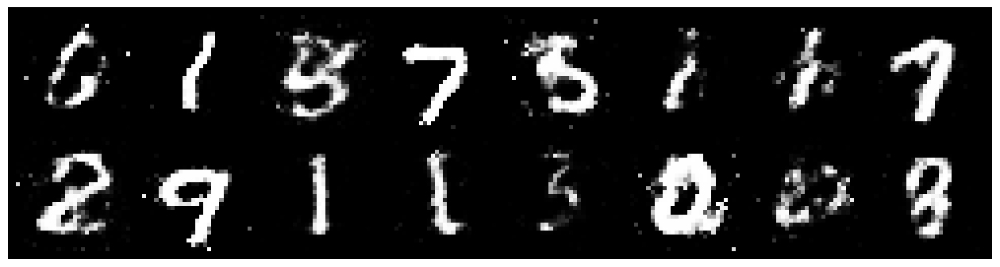

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.2023, Generator Loss: 1.0887
D(x): 0.5552, D(G(z)): 0.3973


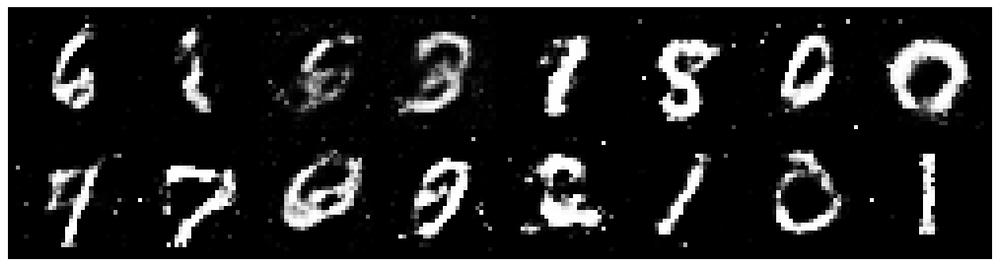

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.2699, Generator Loss: 0.8945
D(x): 0.5885, D(G(z)): 0.4205


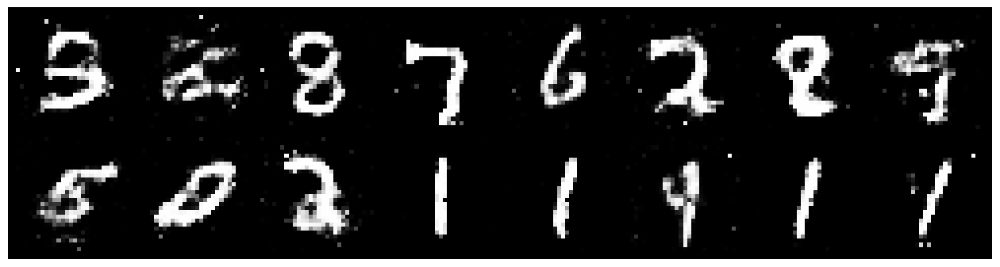

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.2183, Generator Loss: 1.0623
D(x): 0.5616, D(G(z)): 0.3949


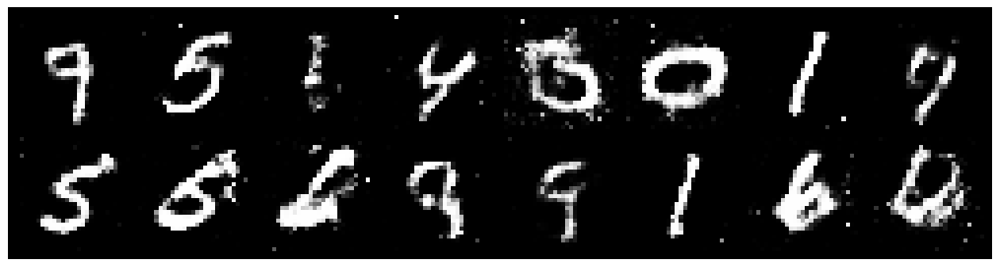

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.2062, Generator Loss: 1.0962
D(x): 0.5897, D(G(z)): 0.3851


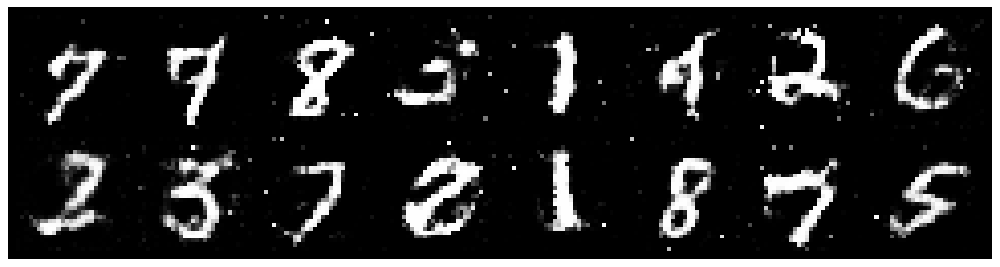

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.0377, Generator Loss: 1.1070
D(x): 0.6012, D(G(z)): 0.3265


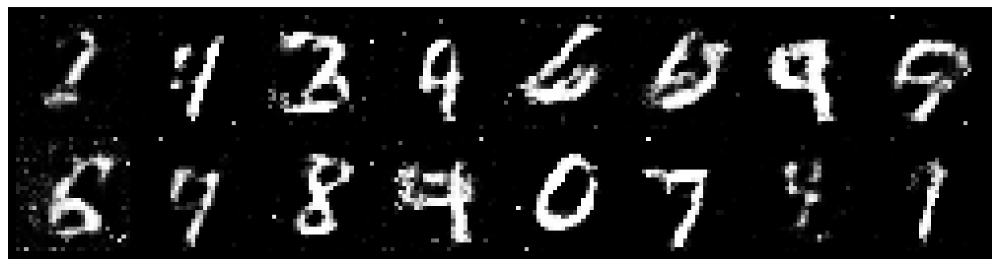

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.2977, Generator Loss: 0.9170
D(x): 0.5880, D(G(z)): 0.4694


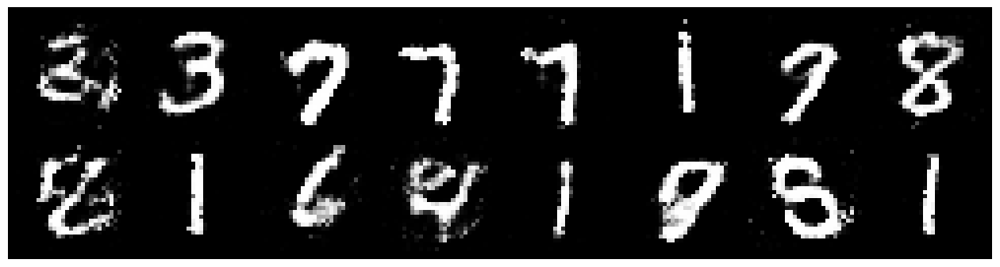

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.1606, Generator Loss: 0.8434
D(x): 0.6348, D(G(z)): 0.4553


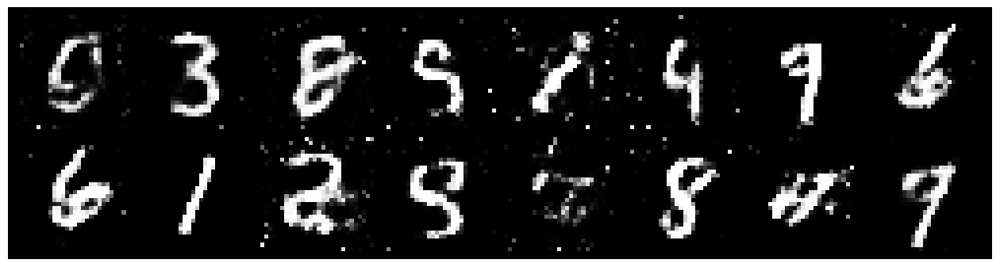

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.1257, Generator Loss: 1.0874
D(x): 0.5960, D(G(z)): 0.3660


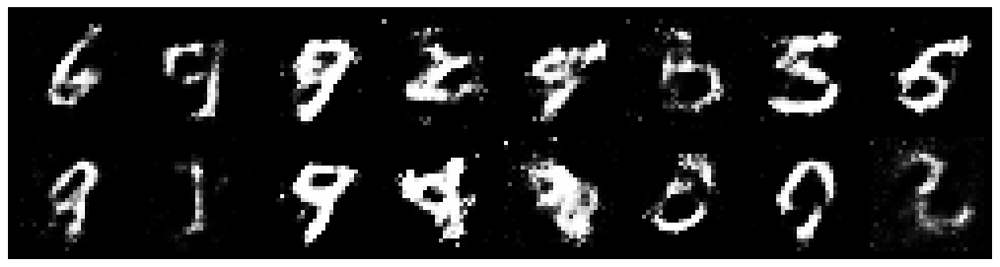

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.2460, Generator Loss: 0.9593
D(x): 0.6075, D(G(z)): 0.4381


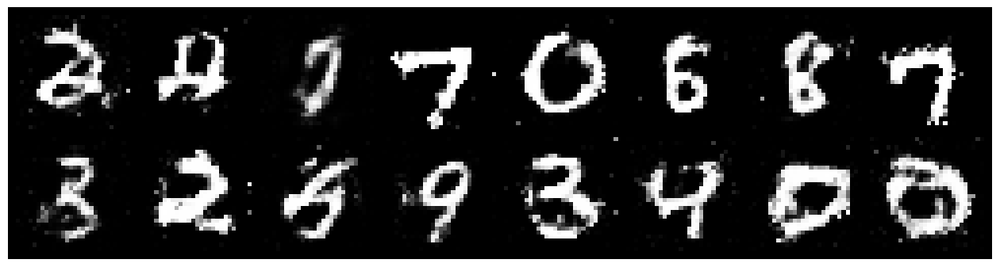

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.1771, Generator Loss: 1.0737
D(x): 0.5491, D(G(z)): 0.3548


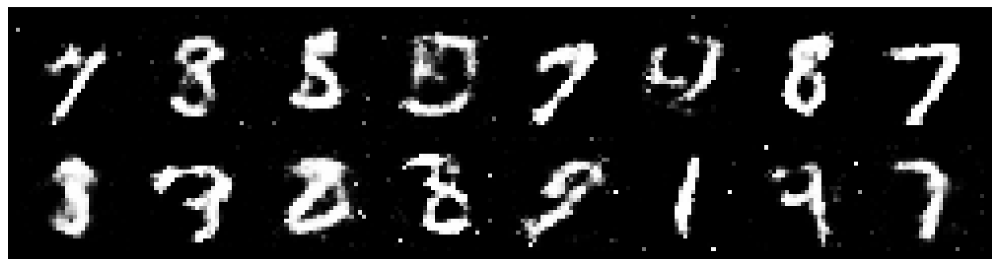

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.2490, Generator Loss: 1.1389
D(x): 0.5278, D(G(z)): 0.3488


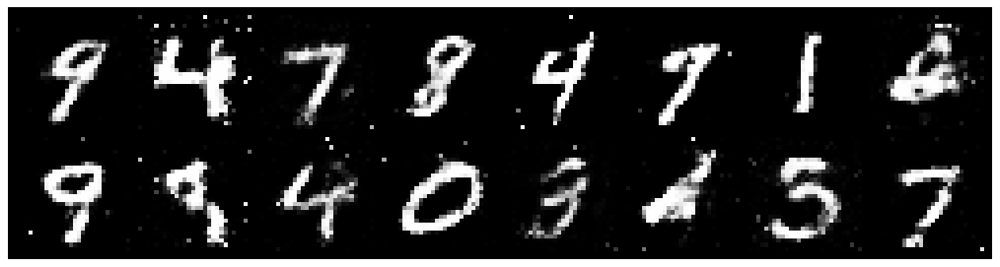

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.1599, Generator Loss: 1.0048
D(x): 0.6015, D(G(z)): 0.4097


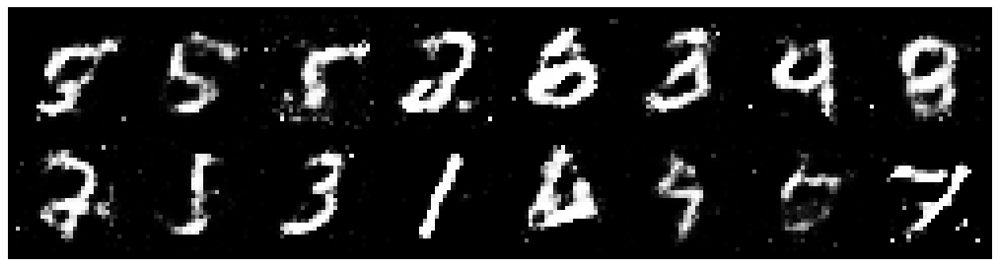

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.0778, Generator Loss: 0.9488
D(x): 0.6193, D(G(z)): 0.3678


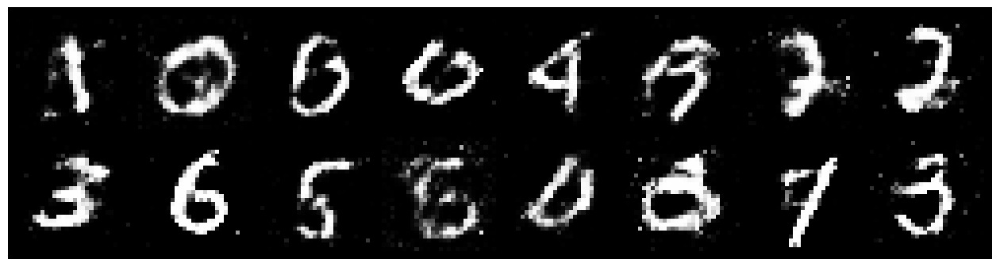

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.0698, Generator Loss: 0.9607
D(x): 0.6542, D(G(z)): 0.4130


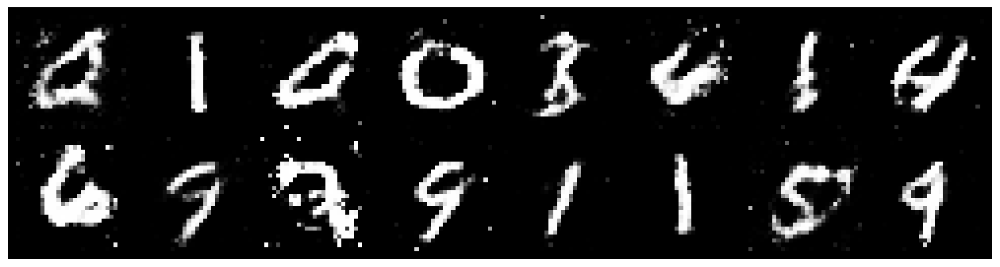

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.1780, Generator Loss: 1.0473
D(x): 0.5916, D(G(z)): 0.4162


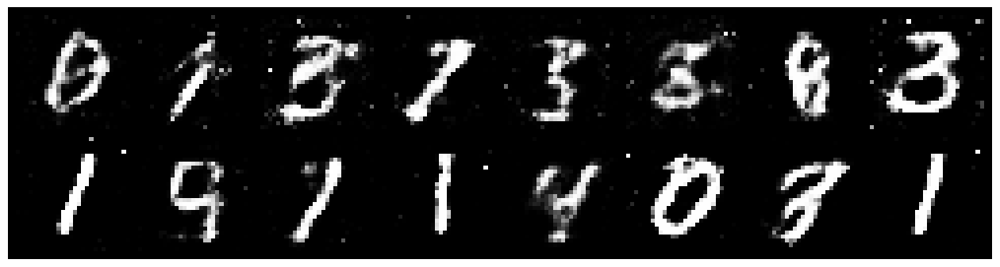

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.1431, Generator Loss: 0.8834
D(x): 0.6156, D(G(z)): 0.4161


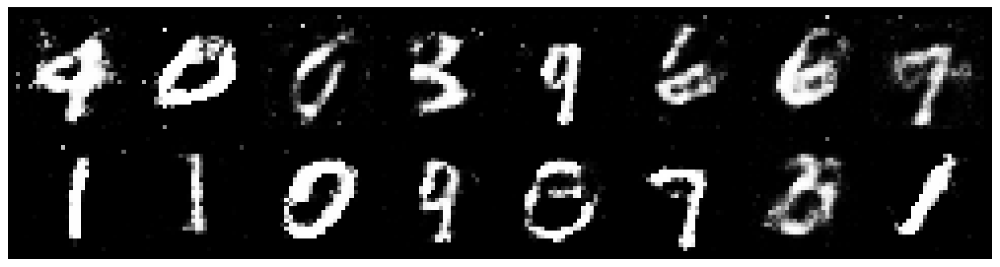

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.1492, Generator Loss: 1.0131
D(x): 0.6102, D(G(z)): 0.4194


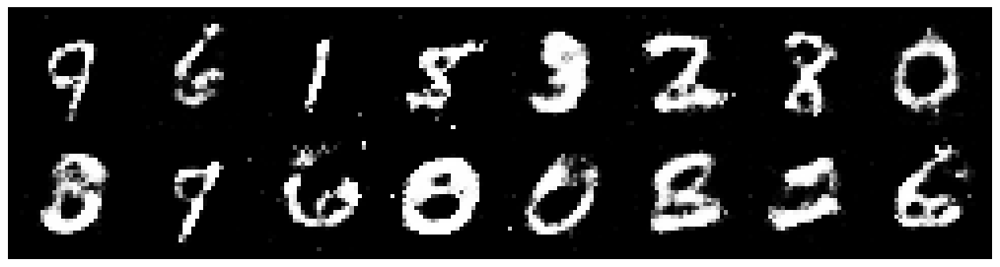

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.1433, Generator Loss: 0.9828
D(x): 0.5997, D(G(z)): 0.4033


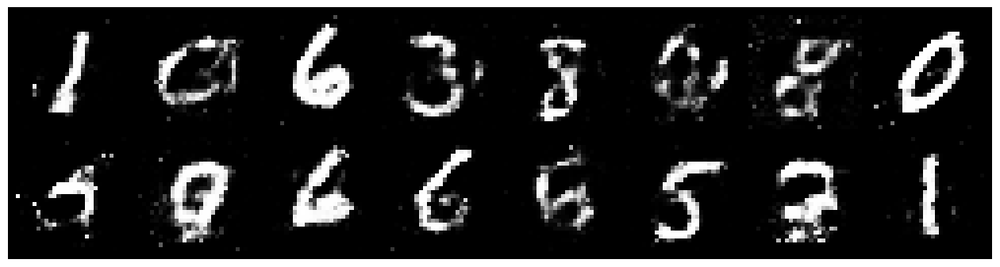

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.2261, Generator Loss: 0.8474
D(x): 0.5441, D(G(z)): 0.4159


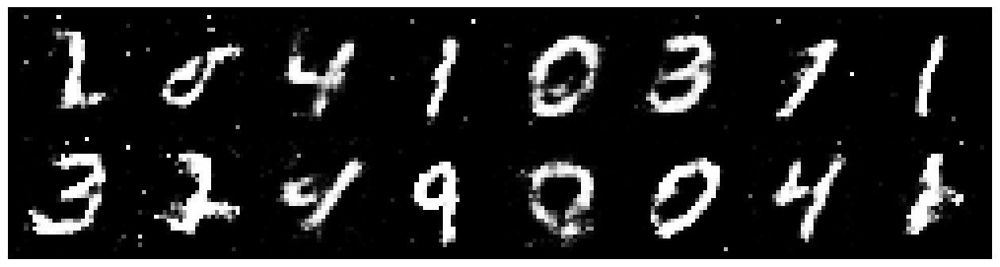

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.0706, Generator Loss: 1.3077
D(x): 0.6235, D(G(z)): 0.3824


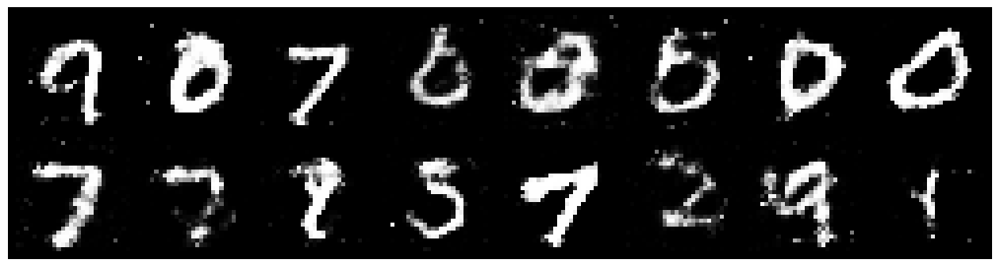

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.0959, Generator Loss: 0.8458
D(x): 0.6196, D(G(z)): 0.4012


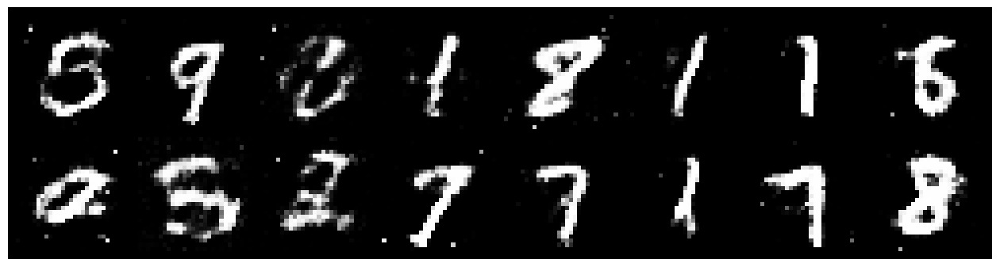

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2289, Generator Loss: 0.9099
D(x): 0.5686, D(G(z)): 0.4318


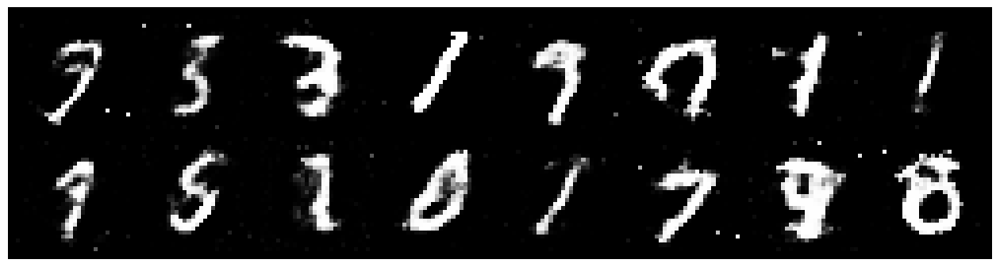

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.3834, Generator Loss: 0.9876
D(x): 0.5661, D(G(z)): 0.4895


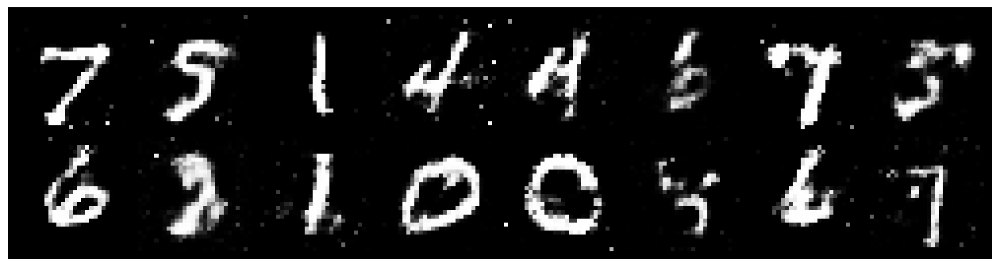

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.1962, Generator Loss: 1.0793
D(x): 0.5678, D(G(z)): 0.4140


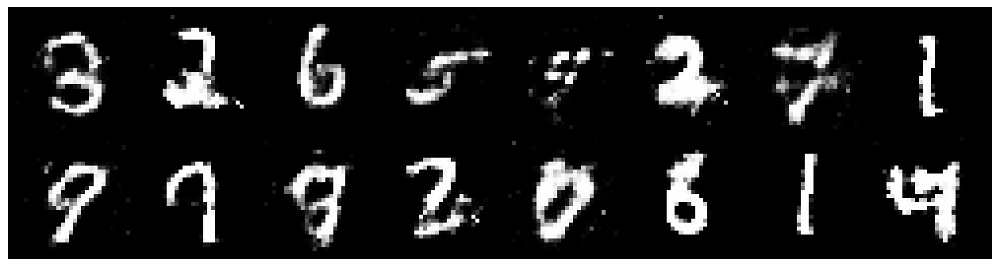

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.1710, Generator Loss: 0.9264
D(x): 0.6112, D(G(z)): 0.4110


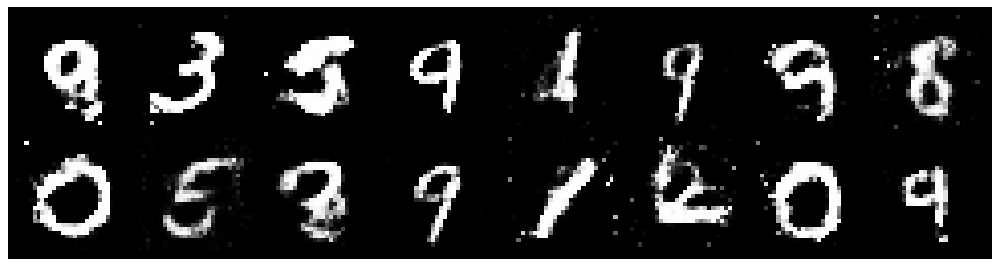

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.2560, Generator Loss: 1.2218
D(x): 0.5758, D(G(z)): 0.4069


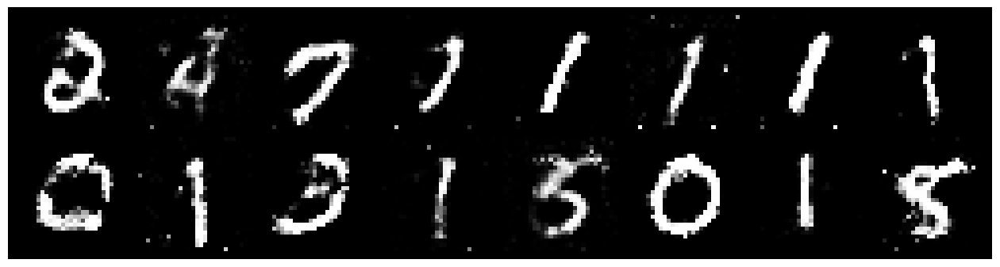

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2856, Generator Loss: 0.9180
D(x): 0.5780, D(G(z)): 0.4491


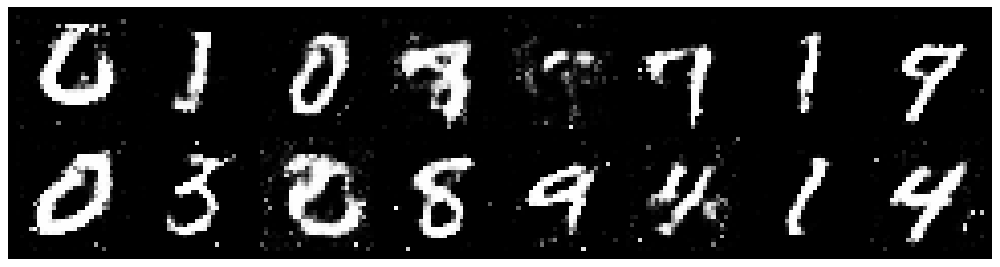

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2299, Generator Loss: 0.9193
D(x): 0.5415, D(G(z)): 0.4098


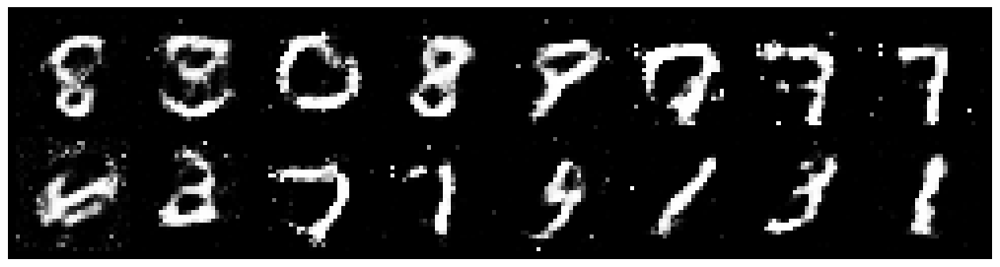

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.1898, Generator Loss: 1.0963
D(x): 0.5821, D(G(z)): 0.4055


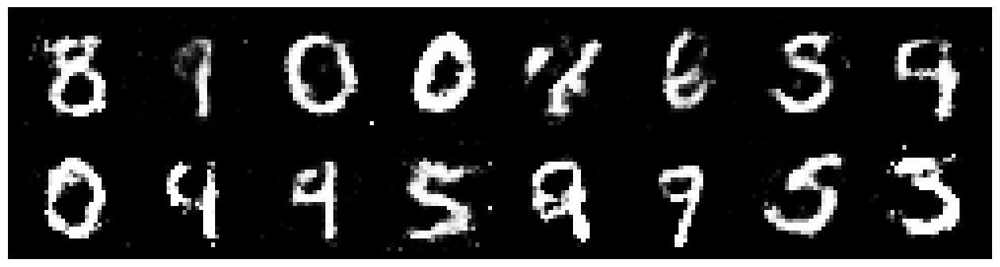

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.1388, Generator Loss: 0.9302
D(x): 0.6361, D(G(z)): 0.4381


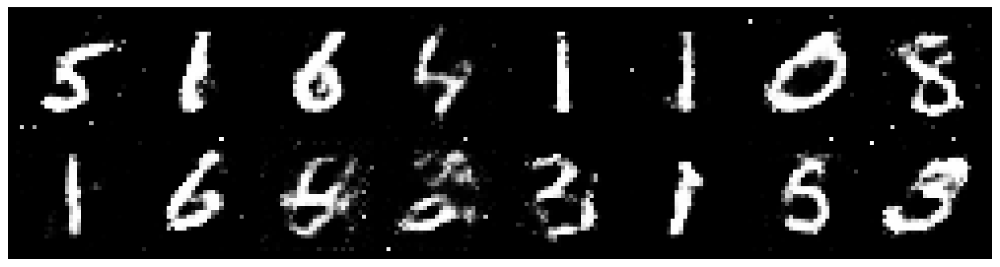

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.2654, Generator Loss: 0.8260
D(x): 0.5831, D(G(z)): 0.4720


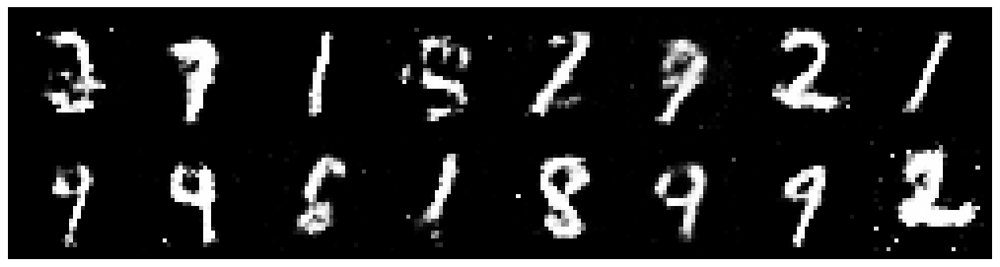

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.4029, Generator Loss: 1.1352
D(x): 0.4555, D(G(z)): 0.3861


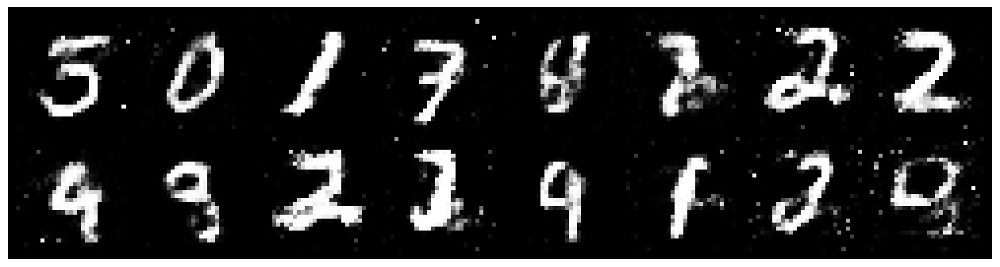

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2058, Generator Loss: 0.9412
D(x): 0.5732, D(G(z)): 0.4229


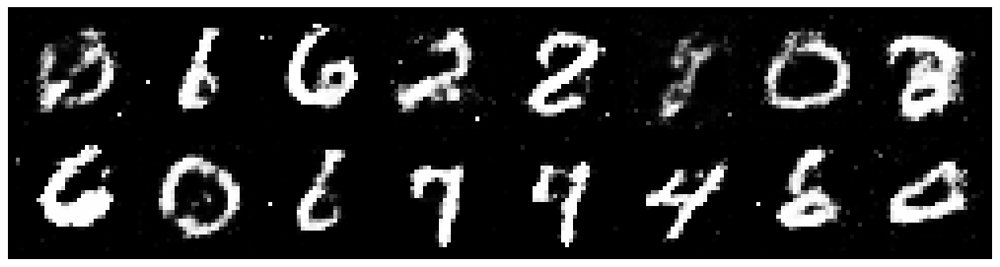

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.3053, Generator Loss: 1.0327
D(x): 0.5142, D(G(z)): 0.4142


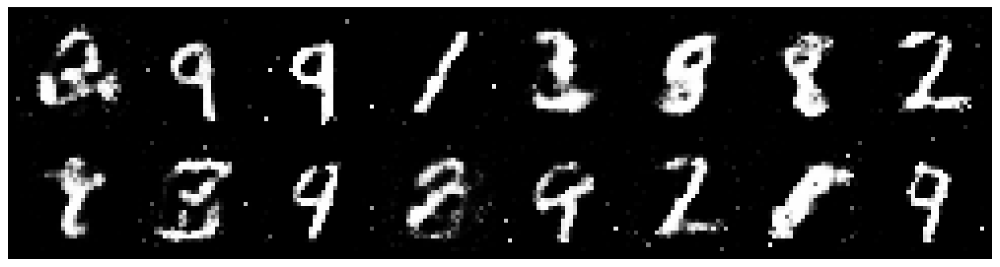

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2397, Generator Loss: 0.9090
D(x): 0.5507, D(G(z)): 0.4240


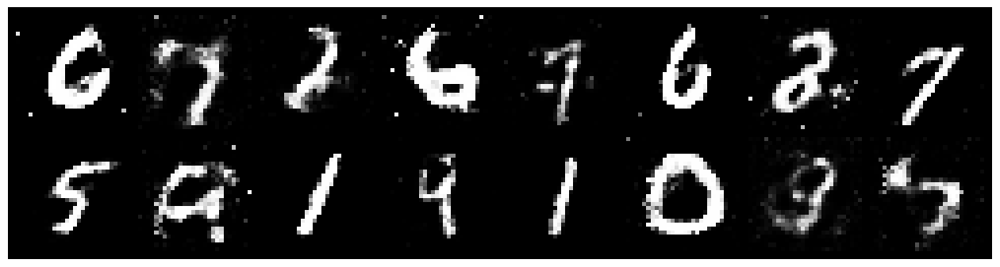

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.3058, Generator Loss: 1.0333
D(x): 0.5692, D(G(z)): 0.4343


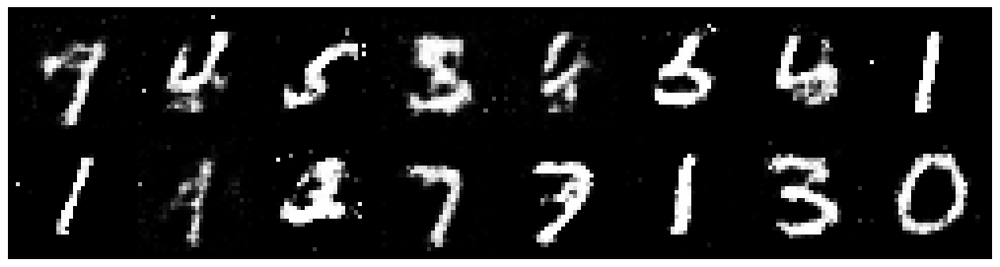

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.0256, Generator Loss: 1.2462
D(x): 0.6654, D(G(z)): 0.3794


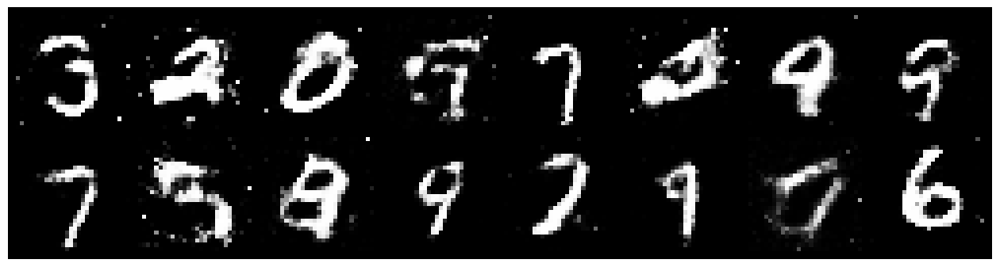

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.1643, Generator Loss: 0.9810
D(x): 0.5581, D(G(z)): 0.3880


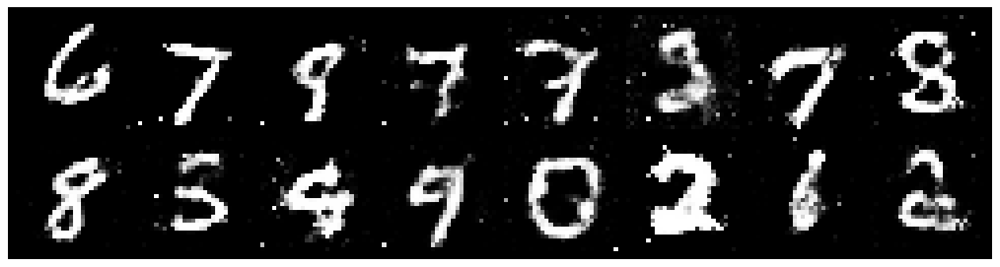

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2013, Generator Loss: 1.0566
D(x): 0.5753, D(G(z)): 0.4206


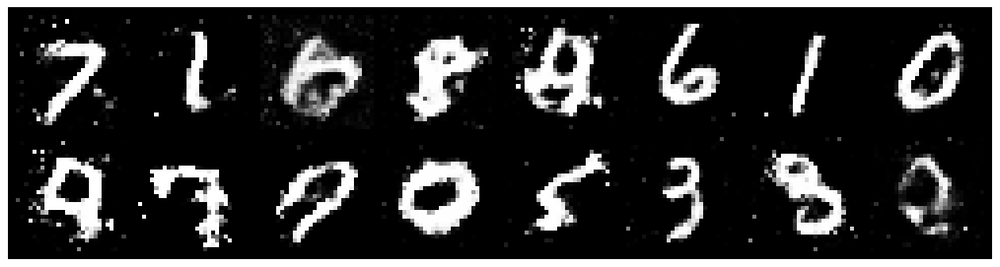

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.2120, Generator Loss: 0.9138
D(x): 0.6106, D(G(z)): 0.4657


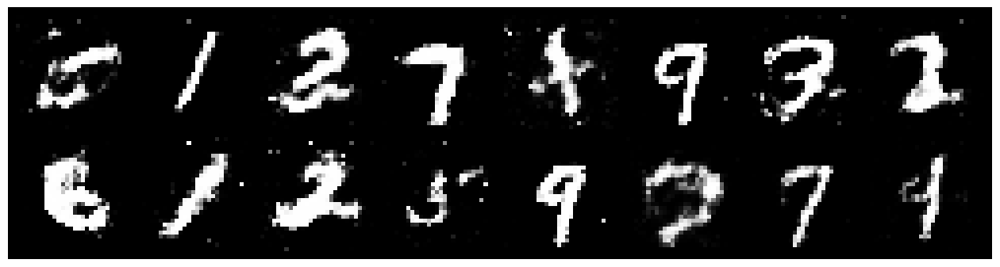

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.1204, Generator Loss: 0.8899
D(x): 0.6337, D(G(z)): 0.4453


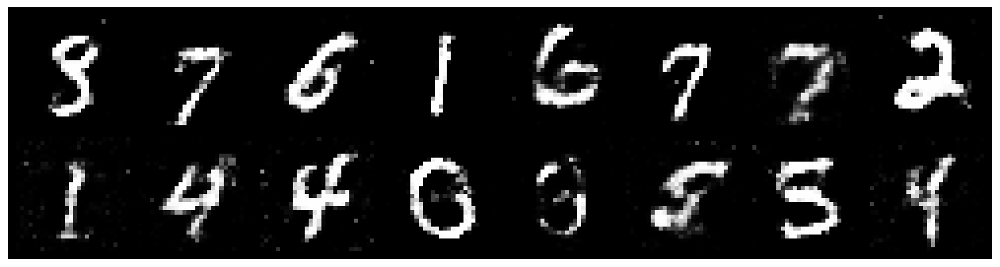

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.2702, Generator Loss: 0.8147
D(x): 0.5460, D(G(z)): 0.4539


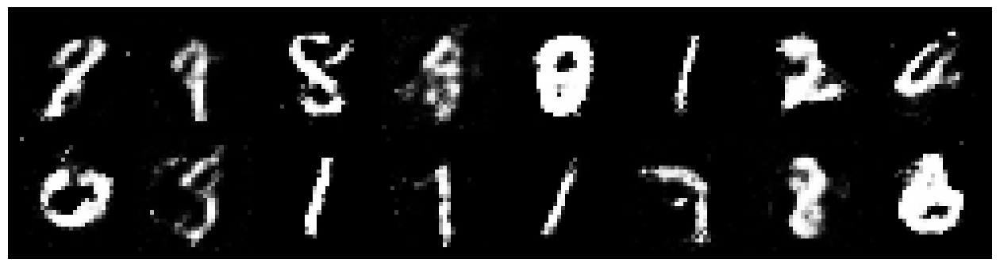

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2084, Generator Loss: 0.9097
D(x): 0.5563, D(G(z)): 0.4220


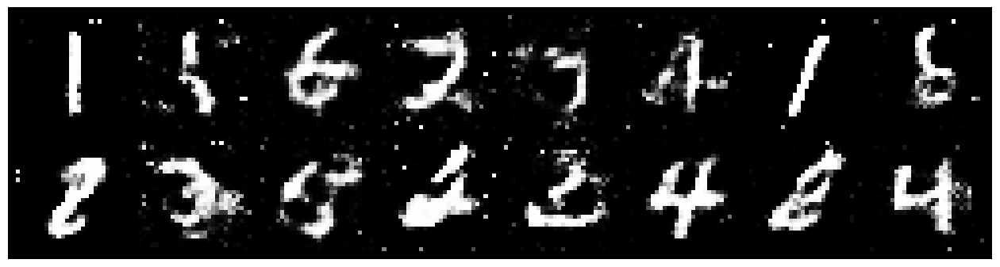

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2189, Generator Loss: 1.2049
D(x): 0.5545, D(G(z)): 0.3757


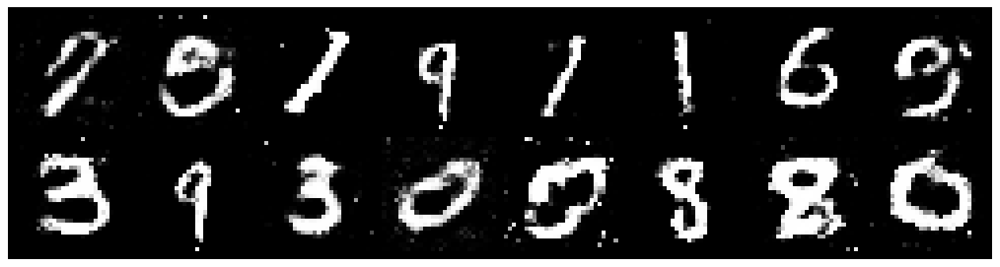

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.2215, Generator Loss: 0.9799
D(x): 0.5515, D(G(z)): 0.4106


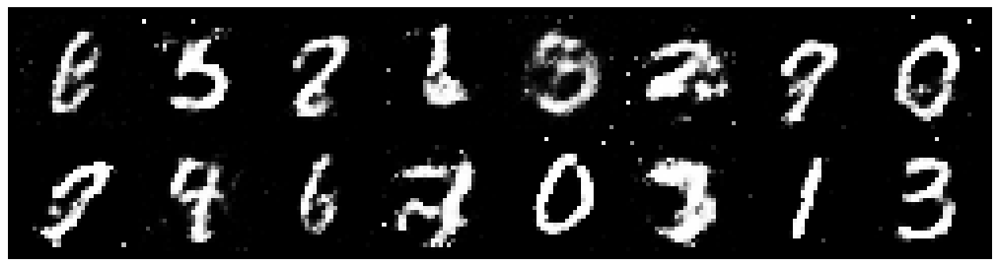

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.1925, Generator Loss: 0.8793
D(x): 0.6073, D(G(z)): 0.4382


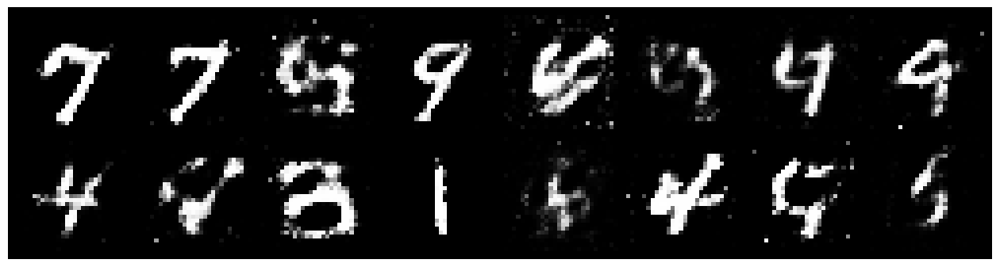

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.1362, Generator Loss: 1.1292
D(x): 0.6023, D(G(z)): 0.3953


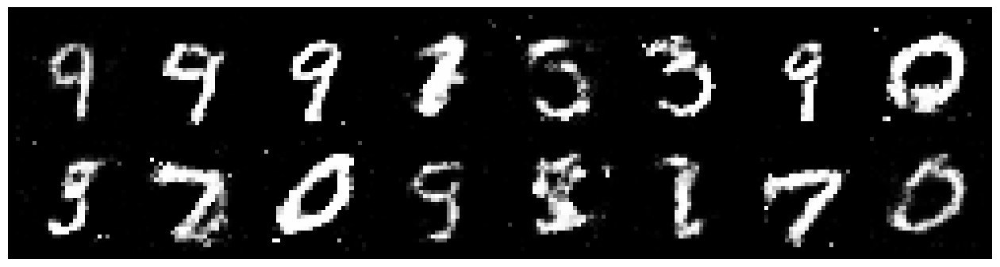

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.2752, Generator Loss: 0.9172
D(x): 0.5530, D(G(z)): 0.4413


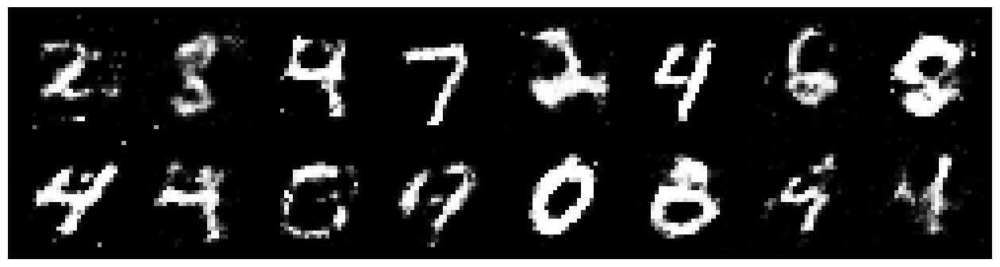

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.1892, Generator Loss: 0.8684
D(x): 0.5749, D(G(z)): 0.4129


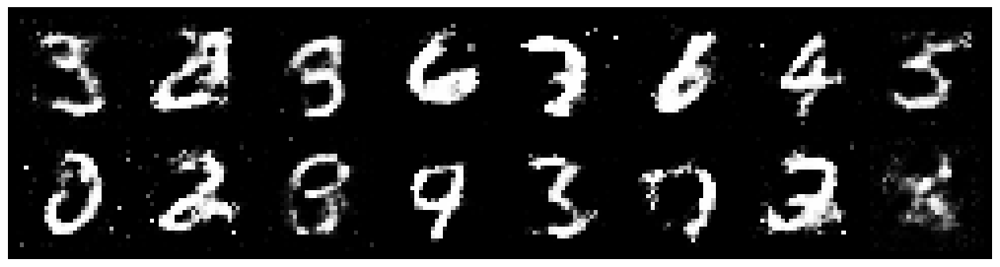

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.2281, Generator Loss: 0.8785
D(x): 0.5467, D(G(z)): 0.4329


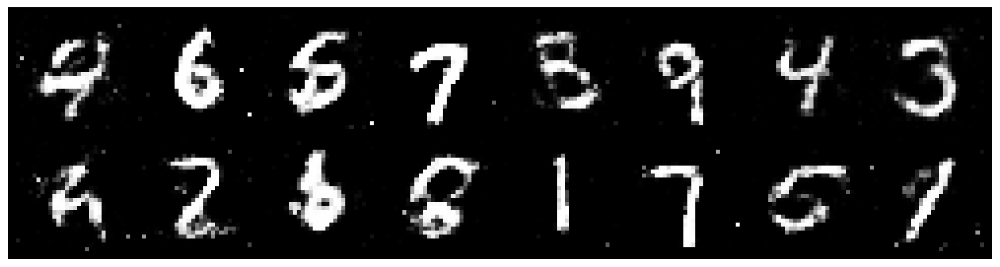

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.3178, Generator Loss: 0.8479
D(x): 0.5484, D(G(z)): 0.4579


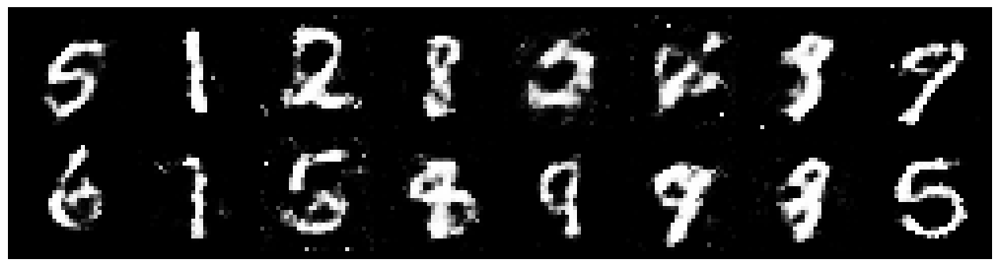

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.3053, Generator Loss: 0.9350
D(x): 0.5284, D(G(z)): 0.4217


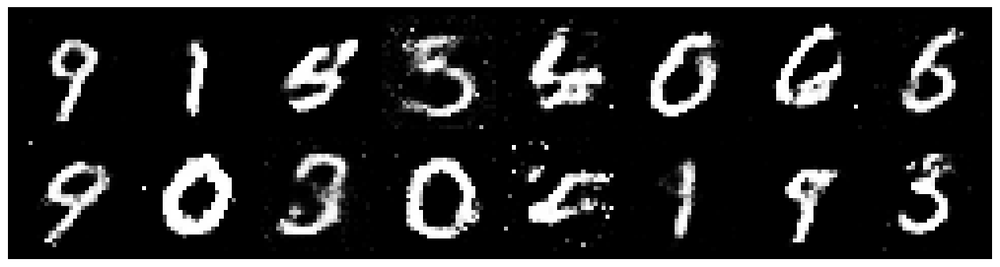

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.3084, Generator Loss: 0.8532
D(x): 0.5330, D(G(z)): 0.4455


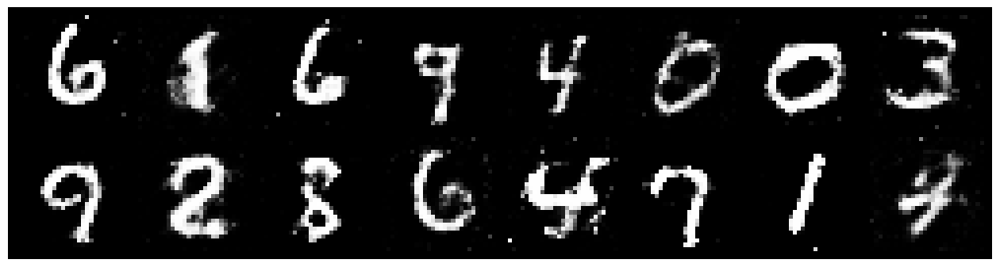

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2159, Generator Loss: 0.9575
D(x): 0.5521, D(G(z)): 0.4070


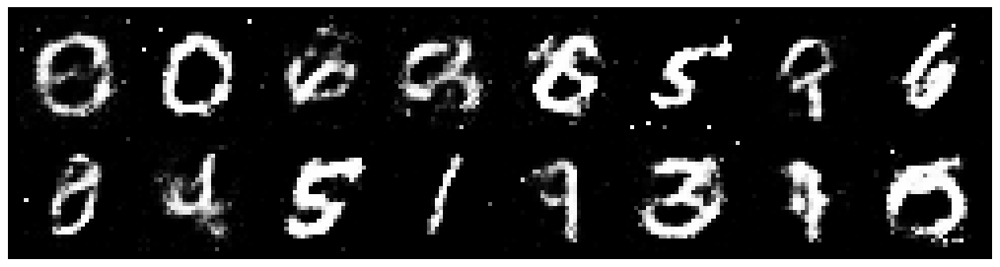

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.2214, Generator Loss: 1.0331
D(x): 0.5408, D(G(z)): 0.4062


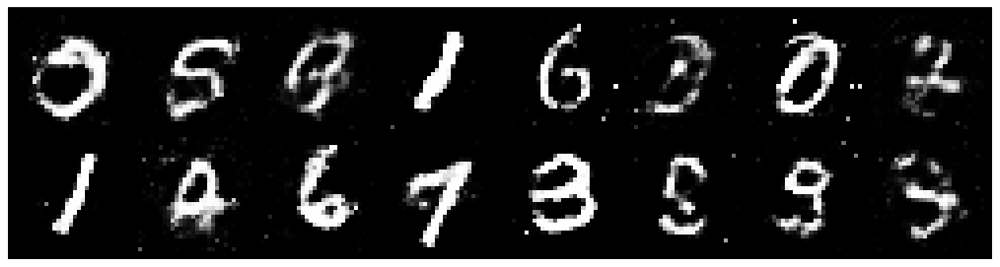

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.2118, Generator Loss: 0.9170
D(x): 0.5792, D(G(z)): 0.4313


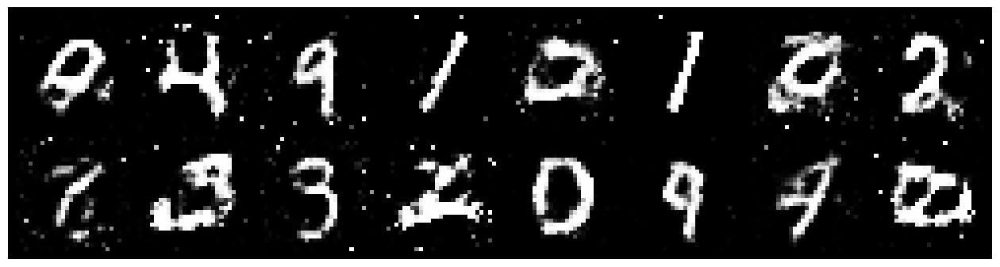

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2380, Generator Loss: 1.0706
D(x): 0.5641, D(G(z)): 0.4367


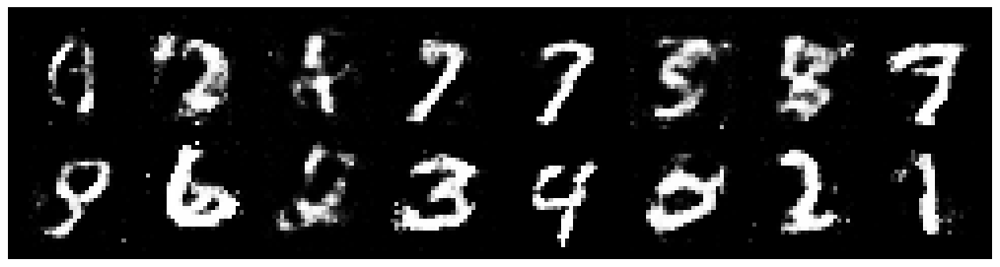

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.1757, Generator Loss: 0.9706
D(x): 0.5705, D(G(z)): 0.3998


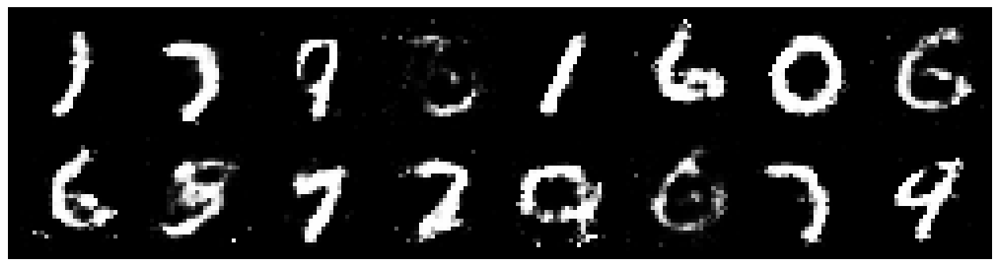

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2218, Generator Loss: 0.9010
D(x): 0.5660, D(G(z)): 0.4430


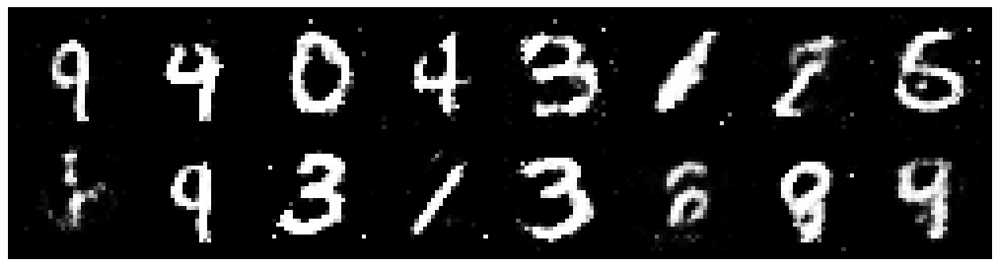

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2990, Generator Loss: 0.7951
D(x): 0.5670, D(G(z)): 0.4880


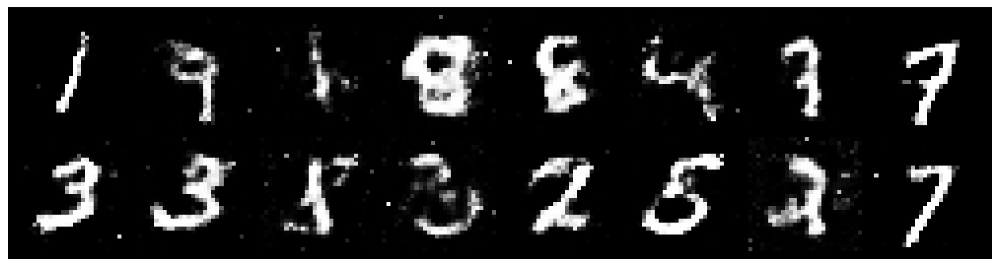

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.3525, Generator Loss: 0.7661
D(x): 0.6062, D(G(z)): 0.5166


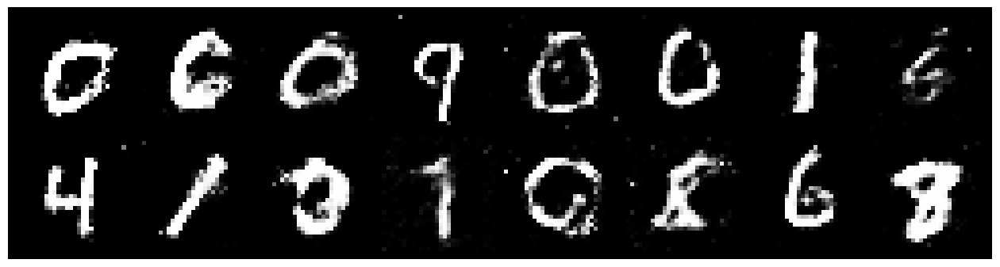

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2614, Generator Loss: 0.9484
D(x): 0.5883, D(G(z)): 0.4732


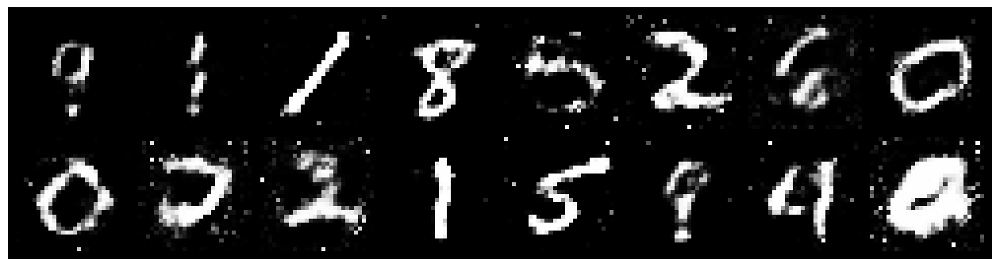

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.1118, Generator Loss: 0.9876
D(x): 0.5682, D(G(z)): 0.3721


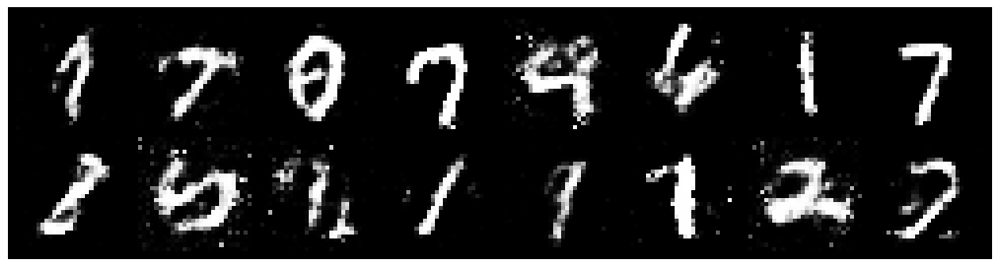

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.0866, Generator Loss: 1.0008
D(x): 0.5794, D(G(z)): 0.3558


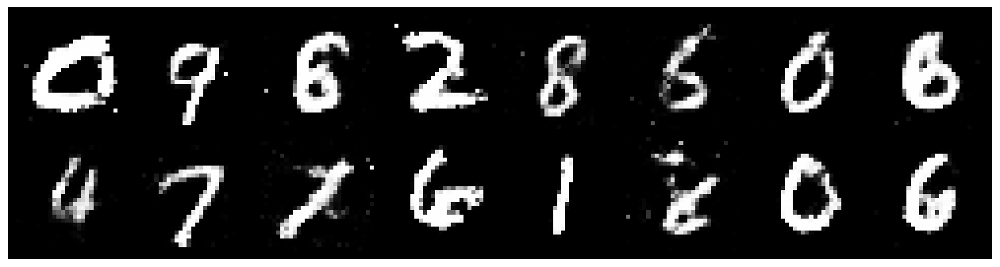

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.1585, Generator Loss: 0.8986
D(x): 0.5615, D(G(z)): 0.3864


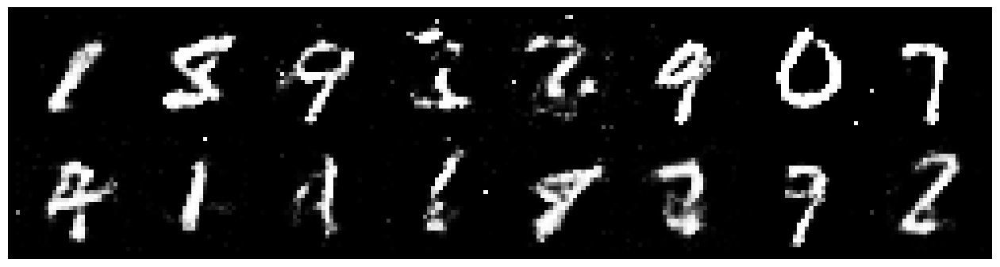

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.1353, Generator Loss: 1.0028
D(x): 0.6042, D(G(z)): 0.3953


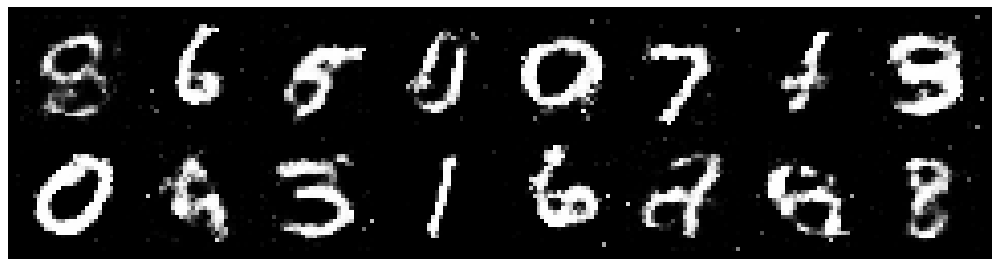

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.0500, Generator Loss: 0.9619
D(x): 0.6365, D(G(z)): 0.4019


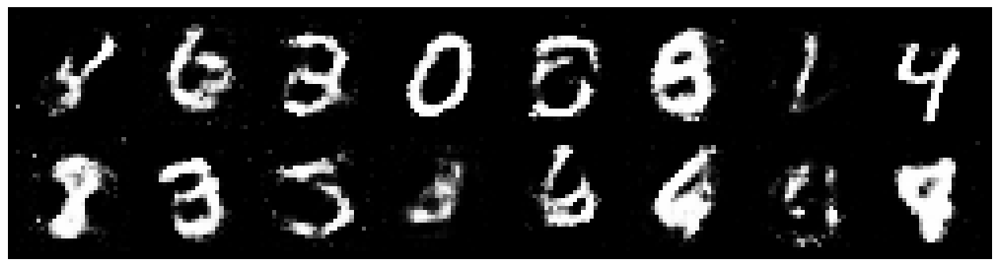

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.1826, Generator Loss: 0.8846
D(x): 0.6130, D(G(z)): 0.4597


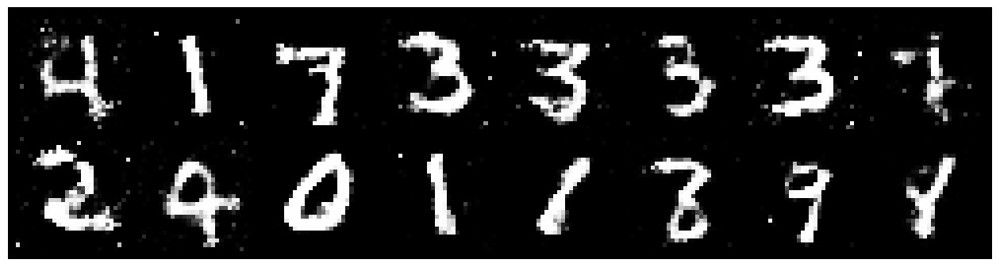

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.1742, Generator Loss: 0.9913
D(x): 0.6217, D(G(z)): 0.4372


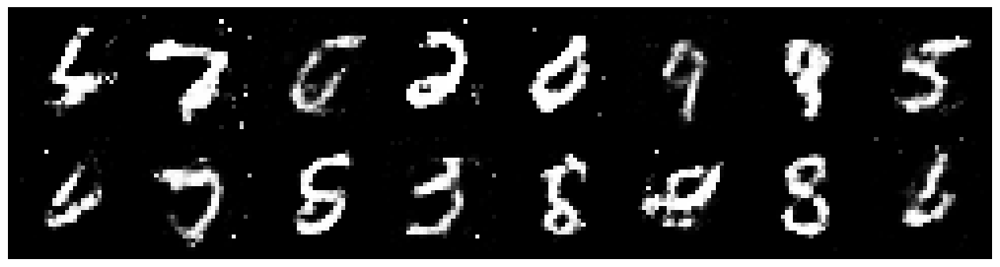

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2452, Generator Loss: 1.0407
D(x): 0.5692, D(G(z)): 0.4251


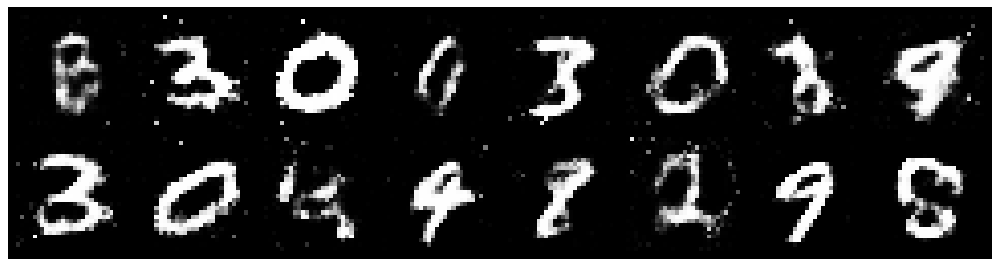

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.1415, Generator Loss: 0.9739
D(x): 0.6105, D(G(z)): 0.4144


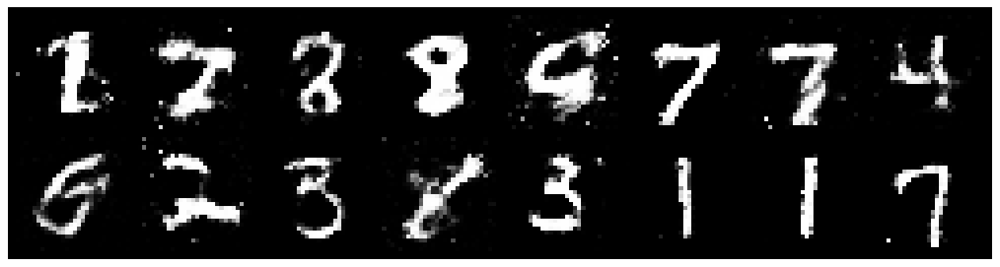

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.1553, Generator Loss: 1.0780
D(x): 0.5848, D(G(z)): 0.3734


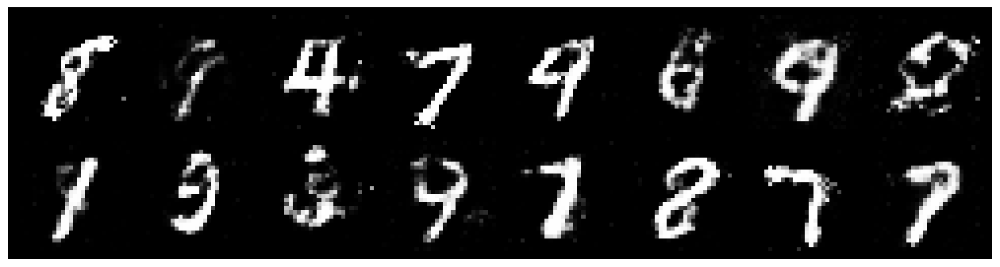

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.1734, Generator Loss: 0.9217
D(x): 0.5815, D(G(z)): 0.4350


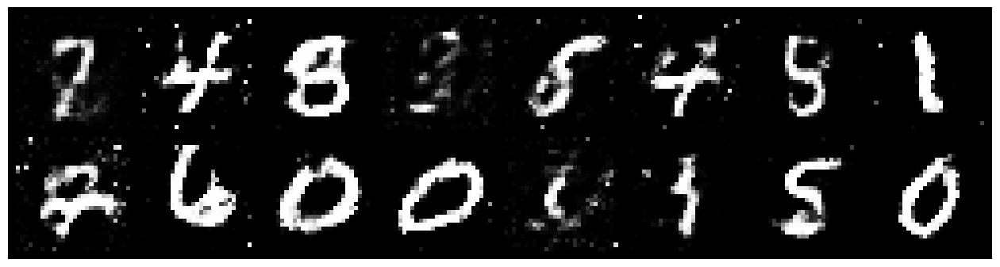

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.3167, Generator Loss: 0.9755
D(x): 0.5567, D(G(z)): 0.4541


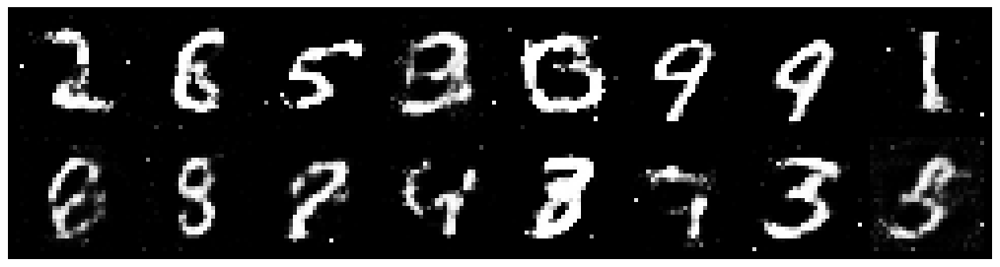

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.2424, Generator Loss: 1.0673
D(x): 0.5974, D(G(z)): 0.4288


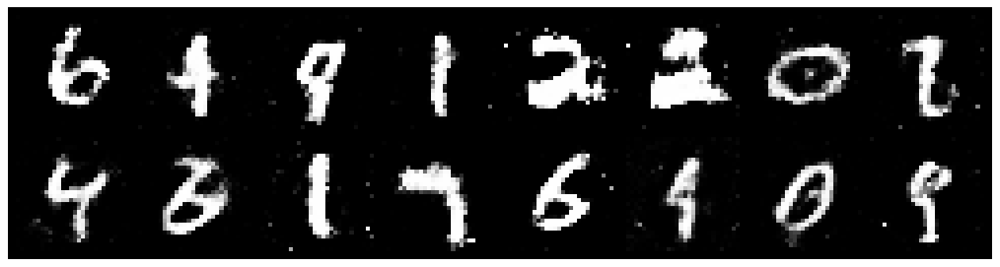

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1957, Generator Loss: 1.0096
D(x): 0.5779, D(G(z)): 0.4188


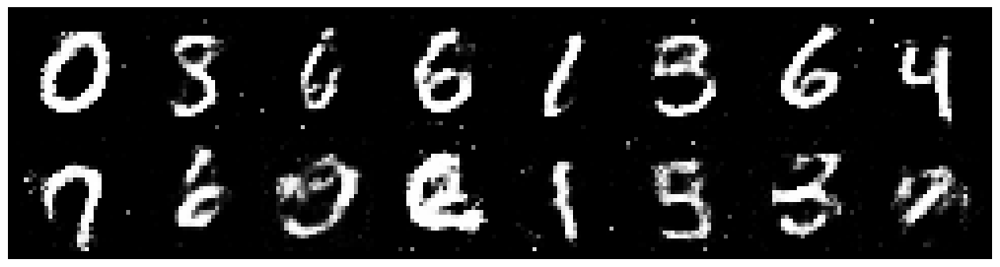

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.1795, Generator Loss: 1.1607
D(x): 0.5887, D(G(z)): 0.3988


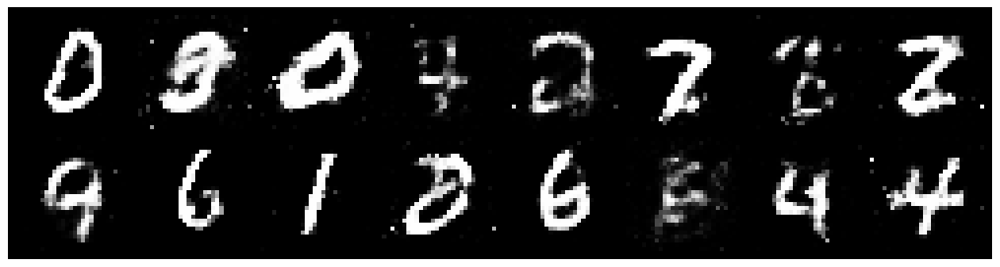

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.2296, Generator Loss: 1.0716
D(x): 0.5684, D(G(z)): 0.4214


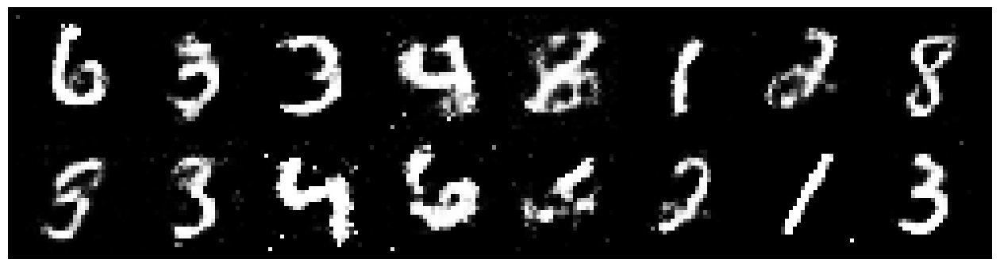

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.1722, Generator Loss: 0.9632
D(x): 0.6397, D(G(z)): 0.4542


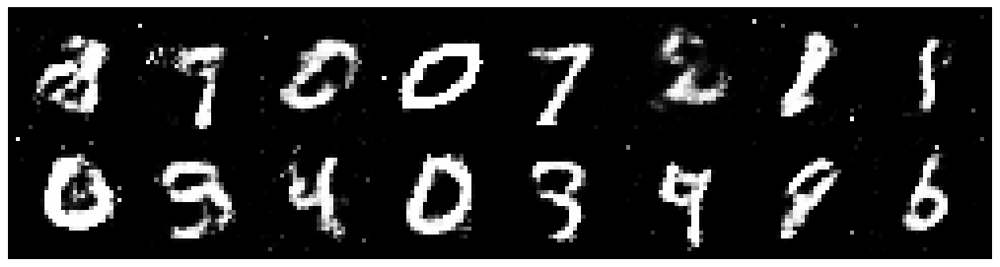

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2250, Generator Loss: 1.0134
D(x): 0.6181, D(G(z)): 0.4719


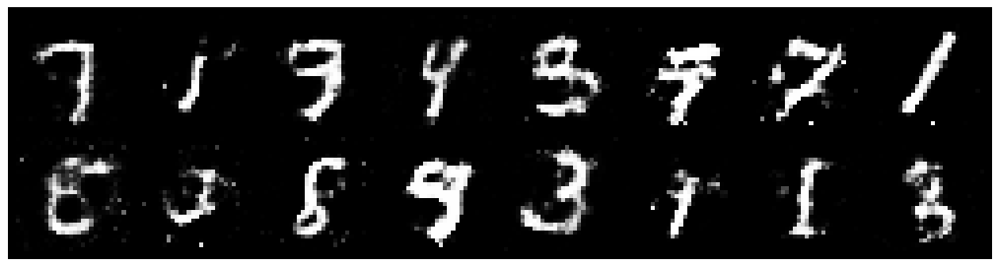

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2484, Generator Loss: 0.9446
D(x): 0.5856, D(G(z)): 0.4504


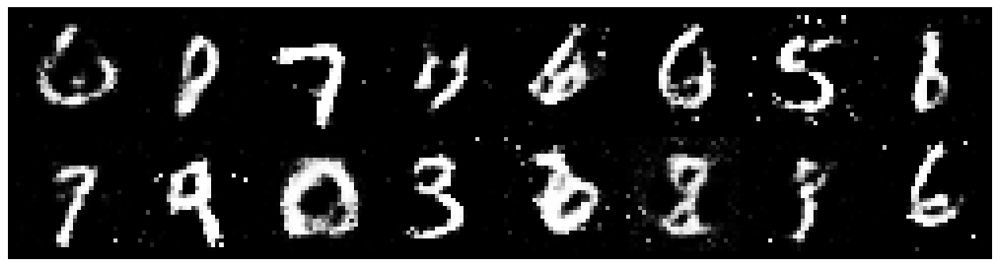

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2548, Generator Loss: 0.9626
D(x): 0.5762, D(G(z)): 0.4084


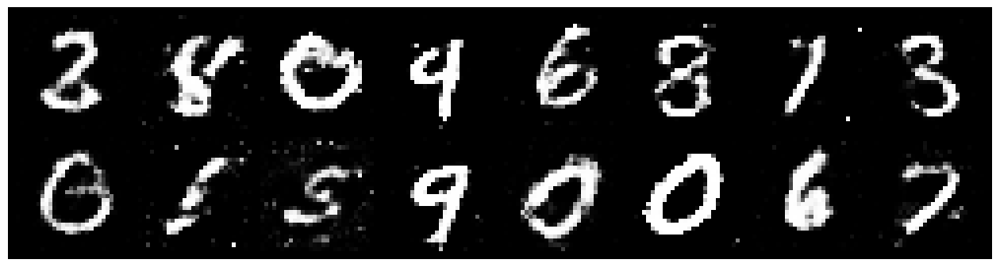

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.3668, Generator Loss: 0.9604
D(x): 0.5812, D(G(z)): 0.4485


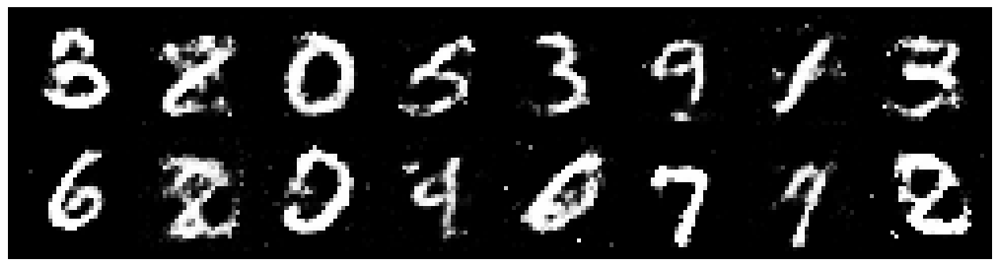

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2651, Generator Loss: 1.1300
D(x): 0.5836, D(G(z)): 0.4261


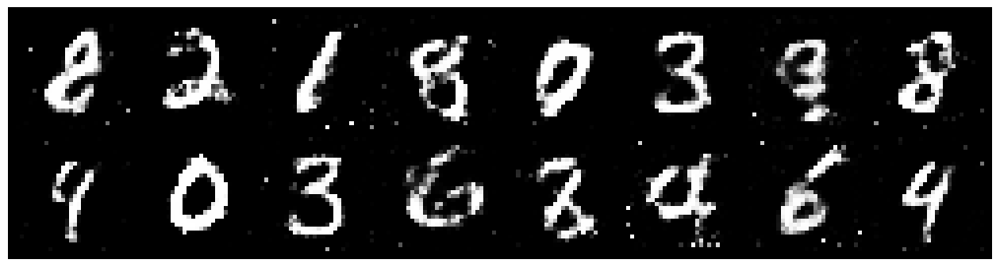

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.1676, Generator Loss: 0.9950
D(x): 0.5773, D(G(z)): 0.4101


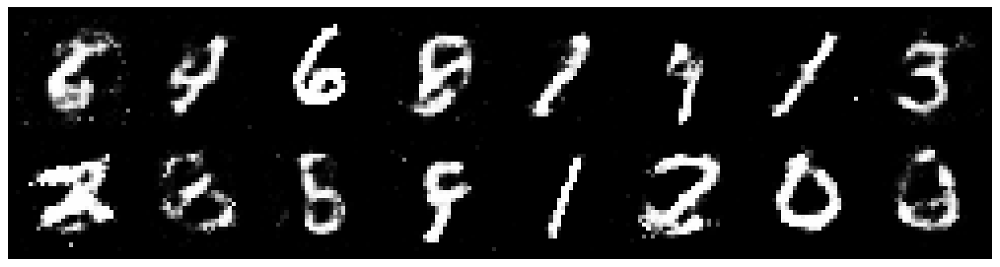

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2304, Generator Loss: 0.8871
D(x): 0.5667, D(G(z)): 0.4161


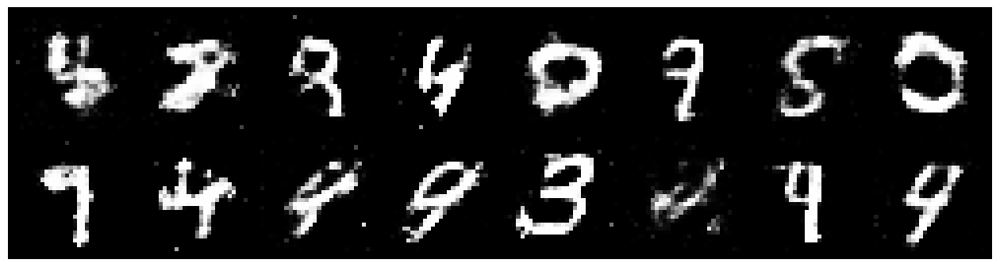

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.2671, Generator Loss: 0.9945
D(x): 0.5965, D(G(z)): 0.4554


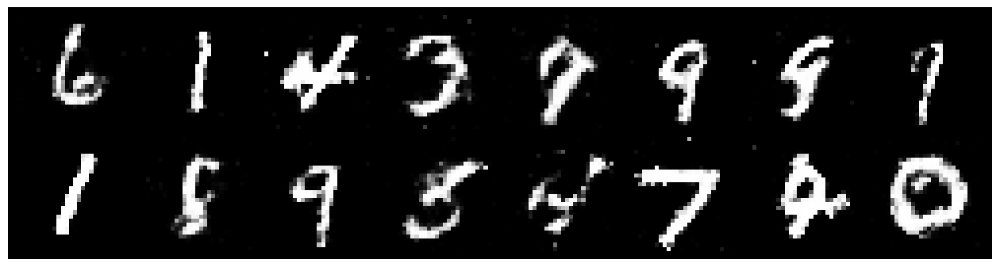

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.2747, Generator Loss: 1.1196
D(x): 0.5485, D(G(z)): 0.4138


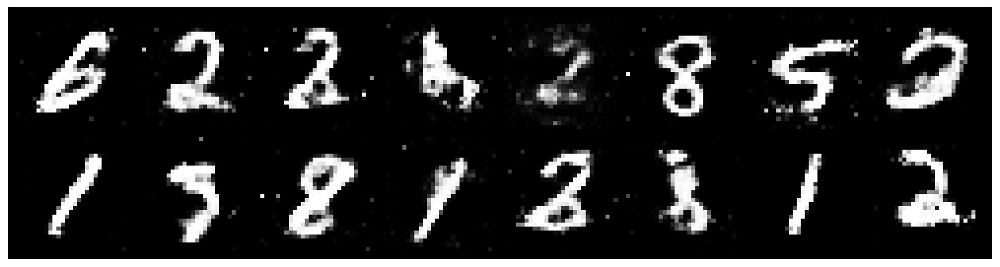

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.2434, Generator Loss: 0.9753
D(x): 0.5922, D(G(z)): 0.4318


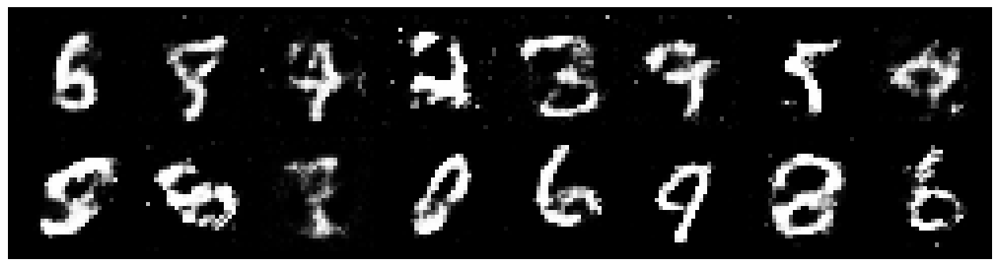

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.1389, Generator Loss: 1.0426
D(x): 0.5621, D(G(z)): 0.3707


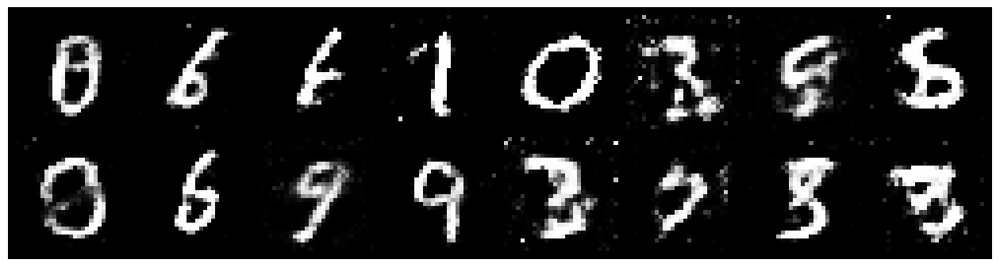

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.1088, Generator Loss: 0.9630
D(x): 0.6004, D(G(z)): 0.4066


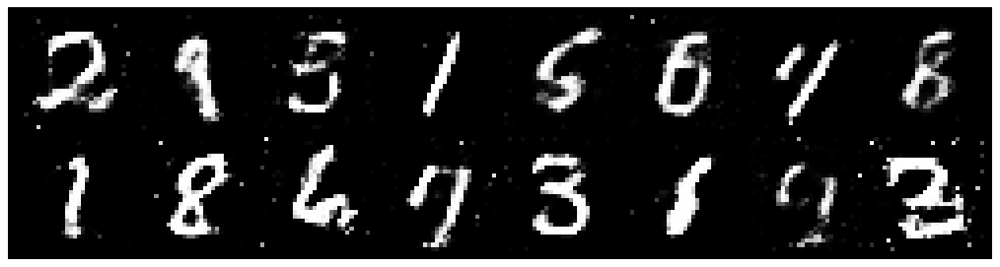

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2857, Generator Loss: 0.9139
D(x): 0.5547, D(G(z)): 0.4376


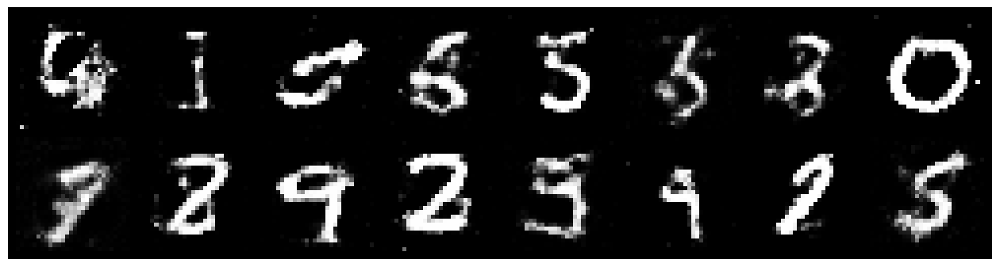

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2846, Generator Loss: 0.8632
D(x): 0.5625, D(G(z)): 0.4651


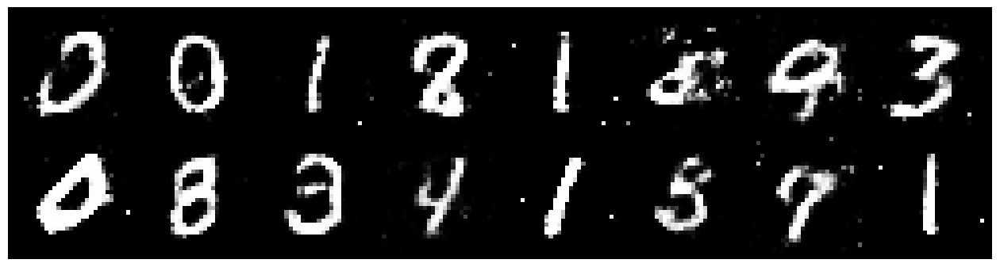

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2425, Generator Loss: 0.7191
D(x): 0.6324, D(G(z)): 0.4750


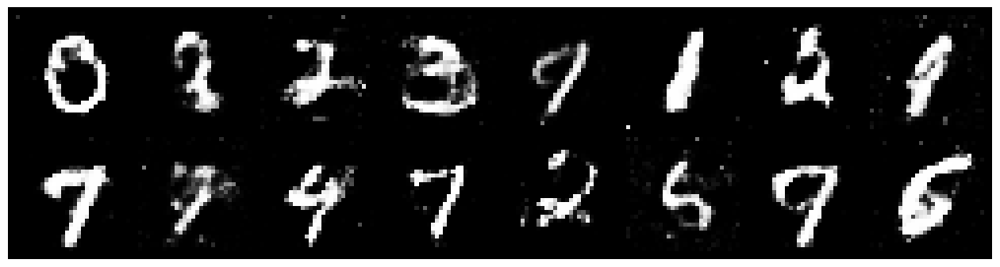

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2227, Generator Loss: 1.1011
D(x): 0.5764, D(G(z)): 0.3920


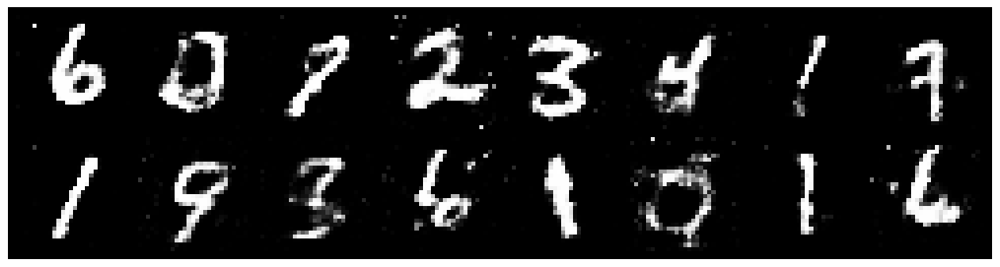

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2377, Generator Loss: 0.9538
D(x): 0.5202, D(G(z)): 0.3972


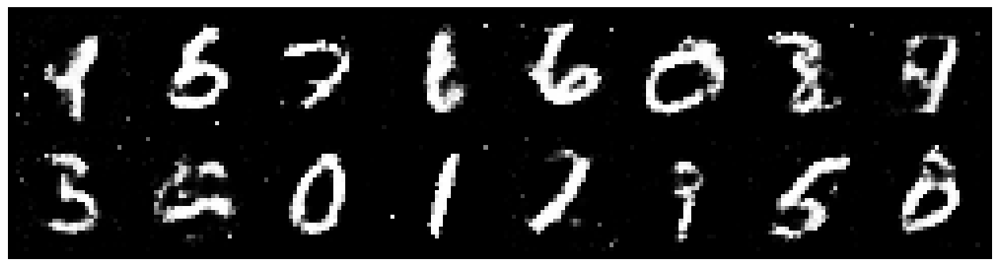

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2380, Generator Loss: 0.9642
D(x): 0.5702, D(G(z)): 0.4228


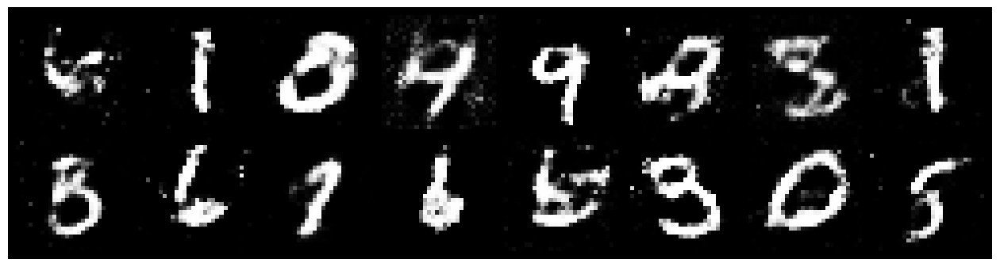

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2000, Generator Loss: 0.8537
D(x): 0.6084, D(G(z)): 0.4527


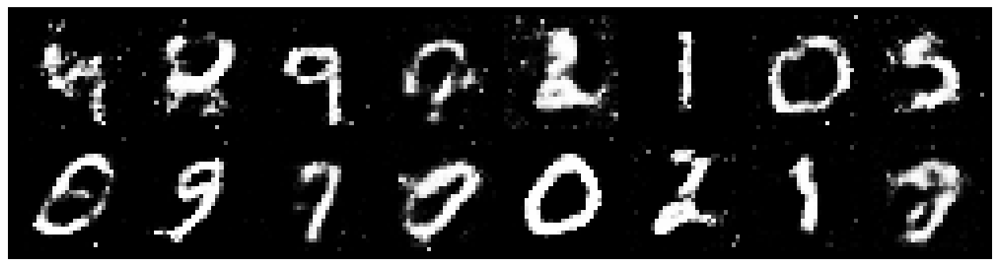

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.1892, Generator Loss: 0.8364
D(x): 0.5858, D(G(z)): 0.4134


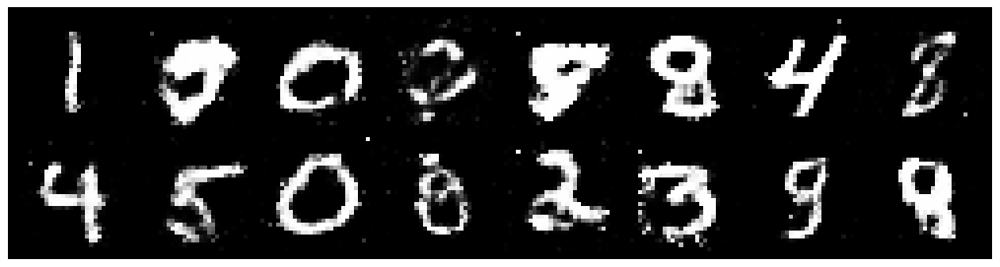

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2477, Generator Loss: 1.0621
D(x): 0.5773, D(G(z)): 0.4378


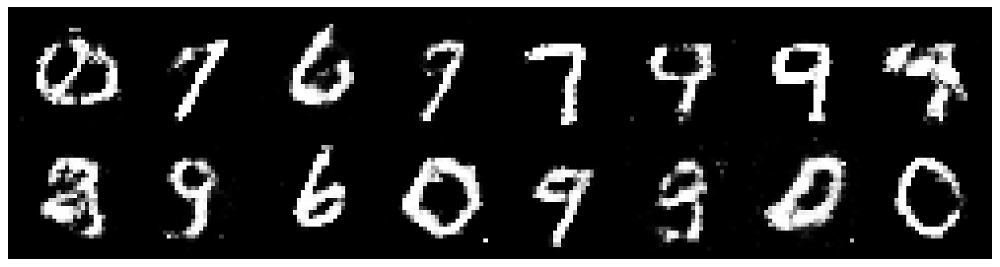

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2501, Generator Loss: 0.9390
D(x): 0.5826, D(G(z)): 0.4527


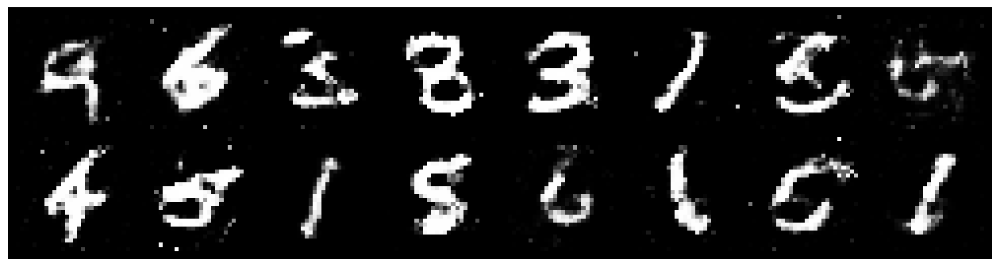

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.3321, Generator Loss: 1.0117
D(x): 0.4936, D(G(z)): 0.3868


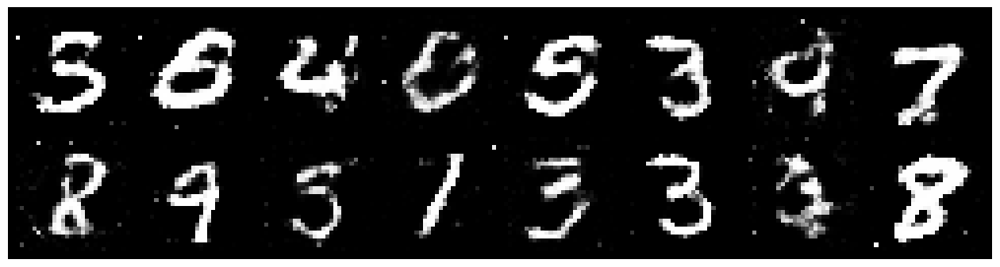

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.2746, Generator Loss: 1.0187
D(x): 0.5726, D(G(z)): 0.4451


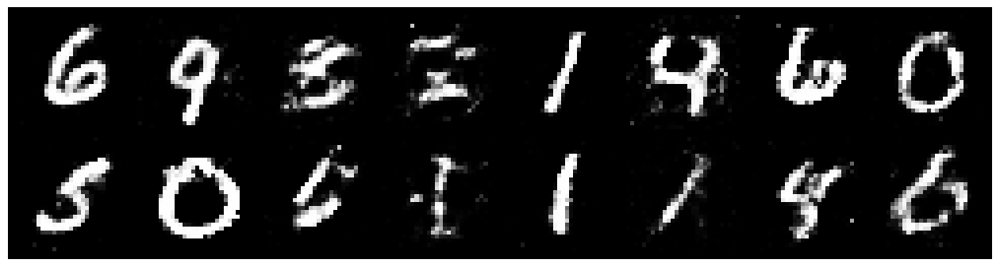

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.1644, Generator Loss: 0.8860
D(x): 0.6021, D(G(z)): 0.4437


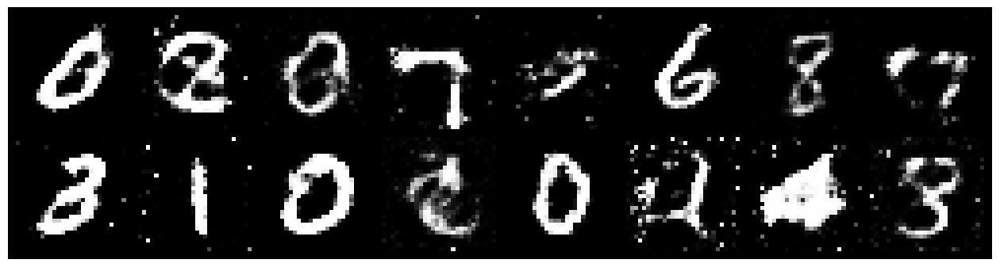

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2834, Generator Loss: 0.7921
D(x): 0.5679, D(G(z)): 0.4720


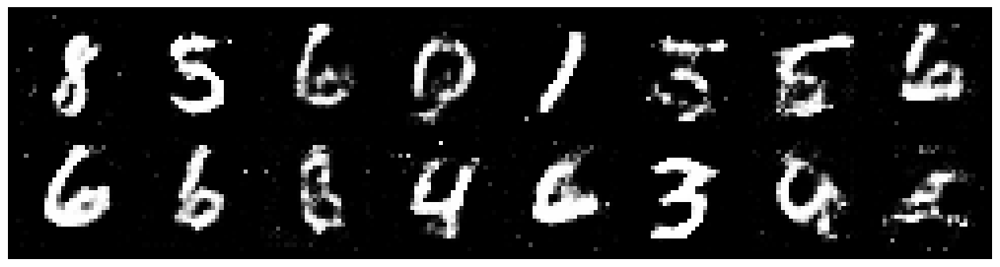

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2375, Generator Loss: 0.9243
D(x): 0.5552, D(G(z)): 0.4414


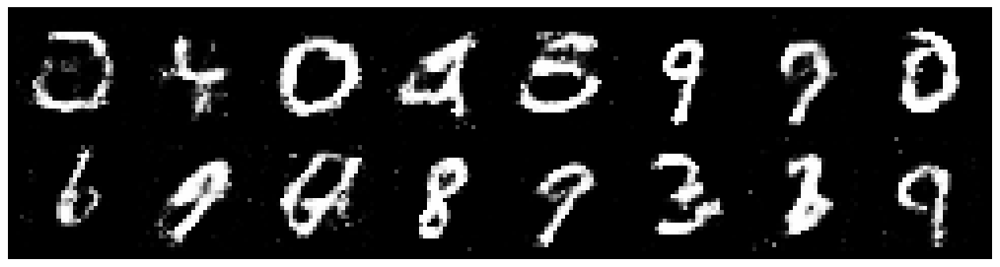

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2544, Generator Loss: 0.8934
D(x): 0.6062, D(G(z)): 0.4717


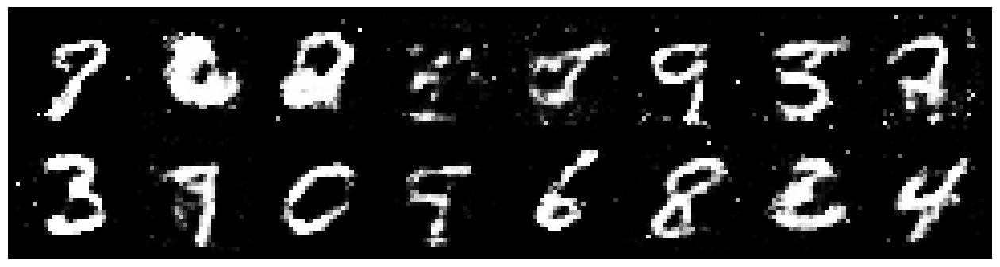

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2373, Generator Loss: 1.0257
D(x): 0.5528, D(G(z)): 0.4173


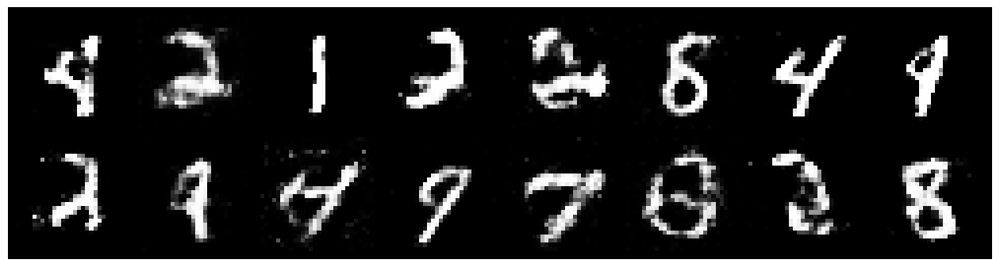

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.1419, Generator Loss: 1.1454
D(x): 0.5882, D(G(z)): 0.3964


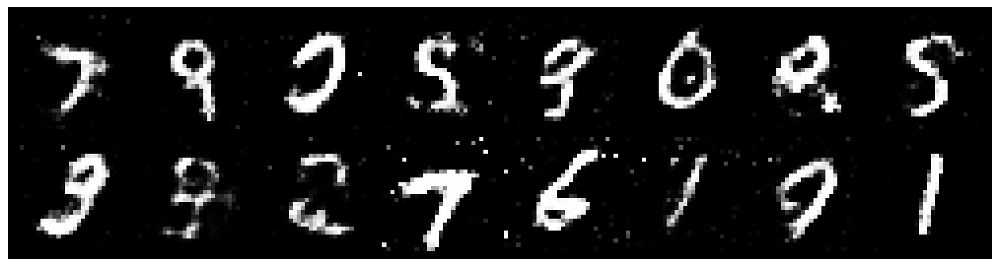

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.1945, Generator Loss: 1.0812
D(x): 0.5379, D(G(z)): 0.3866


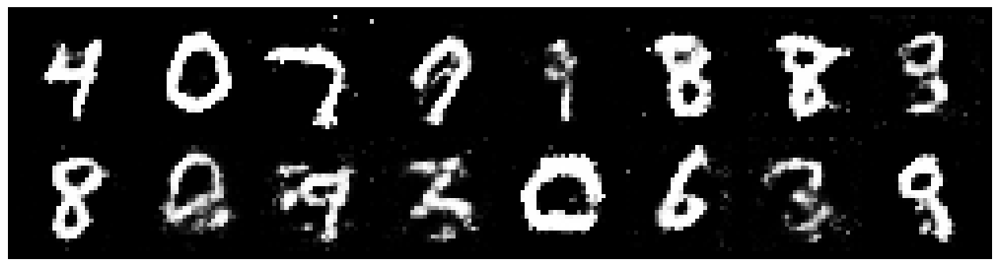

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.1777, Generator Loss: 0.8901
D(x): 0.5852, D(G(z)): 0.4222


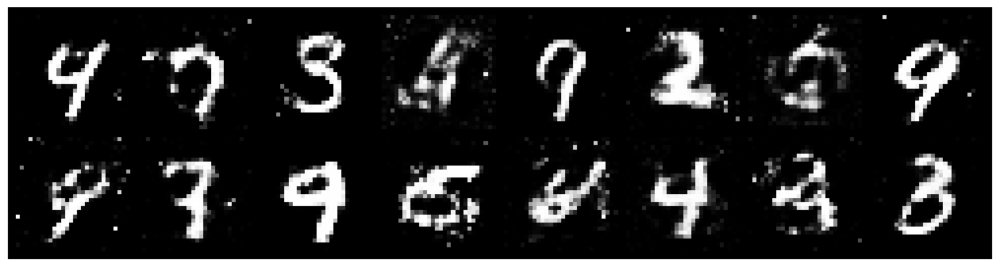

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.2673, Generator Loss: 0.8954
D(x): 0.5903, D(G(z)): 0.4317


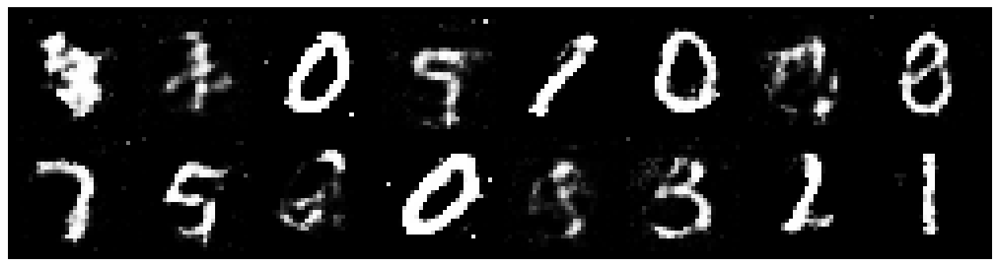

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.2562, Generator Loss: 0.8768
D(x): 0.5887, D(G(z)): 0.4412


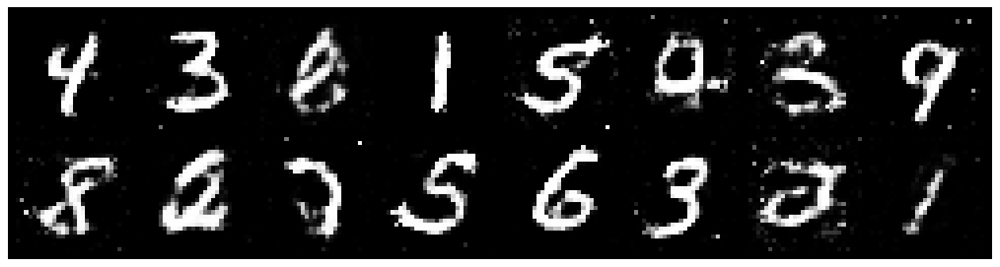

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.2386, Generator Loss: 0.8087
D(x): 0.5609, D(G(z)): 0.4444


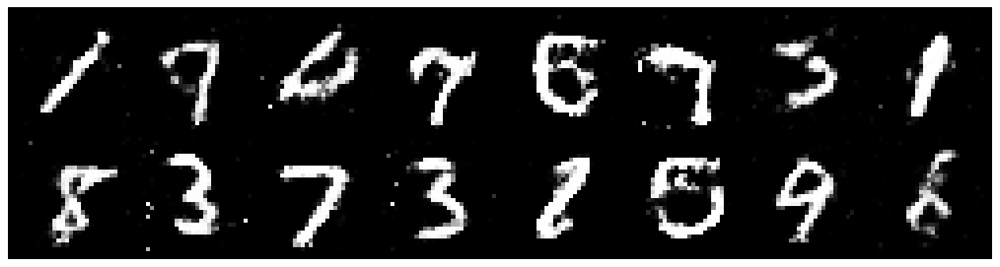

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2604, Generator Loss: 0.9179
D(x): 0.5950, D(G(z)): 0.4592


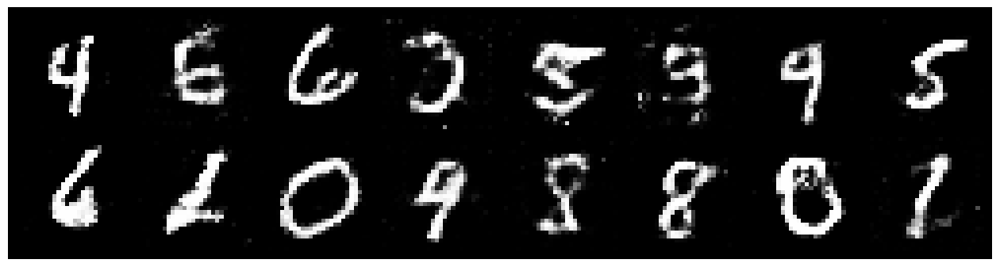

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2527, Generator Loss: 1.0550
D(x): 0.5497, D(G(z)): 0.4105


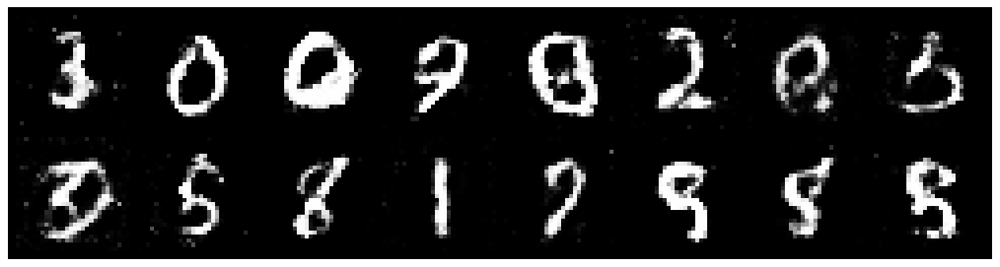

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.2766, Generator Loss: 0.8364
D(x): 0.6035, D(G(z)): 0.4814


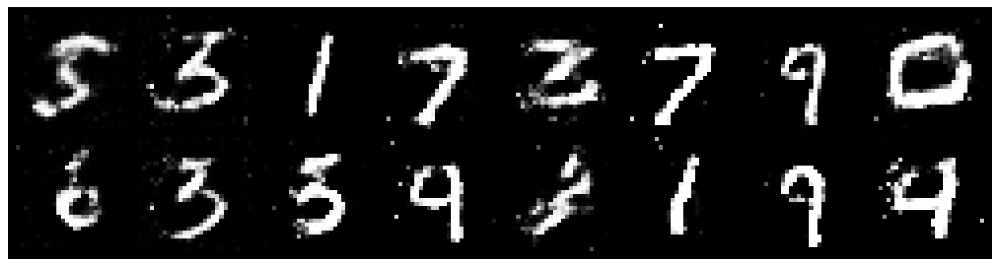

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2767, Generator Loss: 0.8918
D(x): 0.5871, D(G(z)): 0.4482


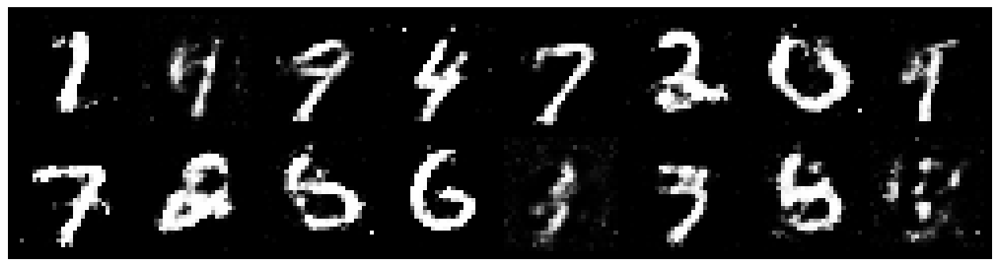

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.1965, Generator Loss: 0.9793
D(x): 0.5867, D(G(z)): 0.4161


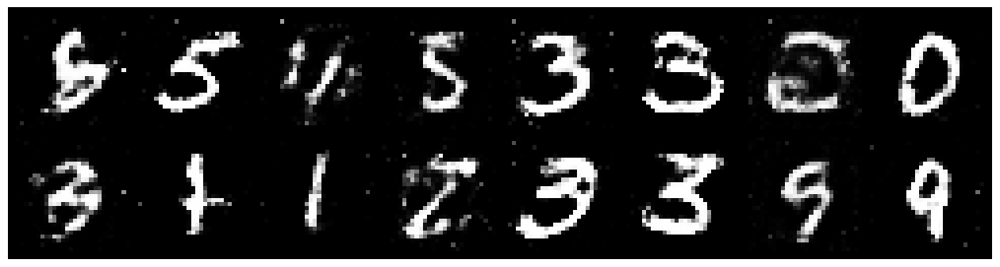

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.1820, Generator Loss: 1.0431
D(x): 0.6113, D(G(z)): 0.4031


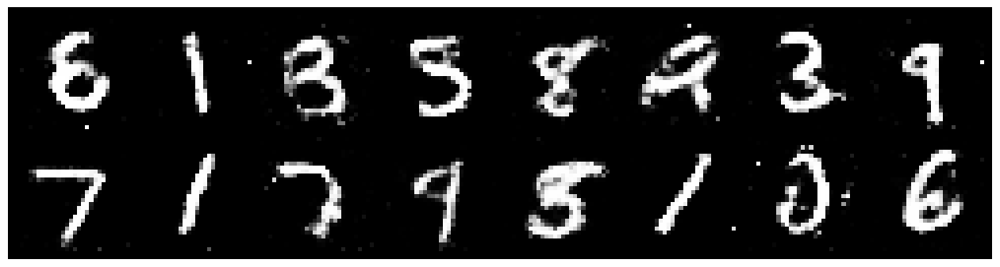

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.0924, Generator Loss: 1.2068
D(x): 0.5963, D(G(z)): 0.3590


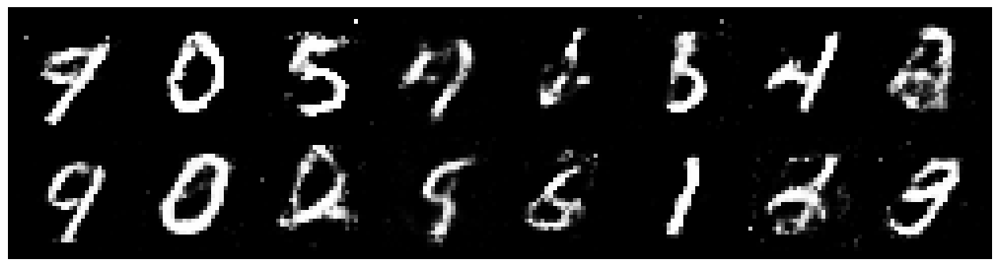

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.1462, Generator Loss: 1.1084
D(x): 0.5596, D(G(z)): 0.3619


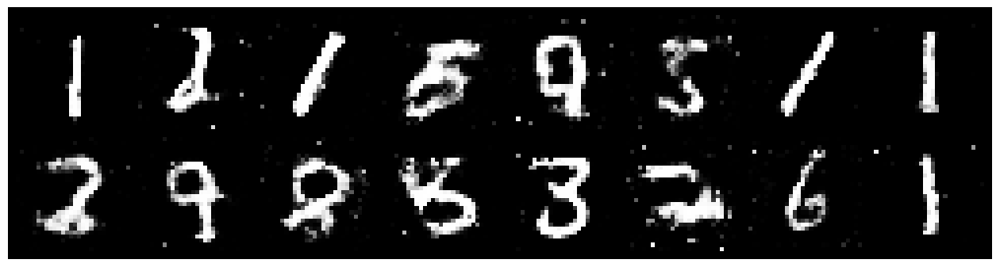

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.1855, Generator Loss: 1.0612
D(x): 0.5196, D(G(z)): 0.3650


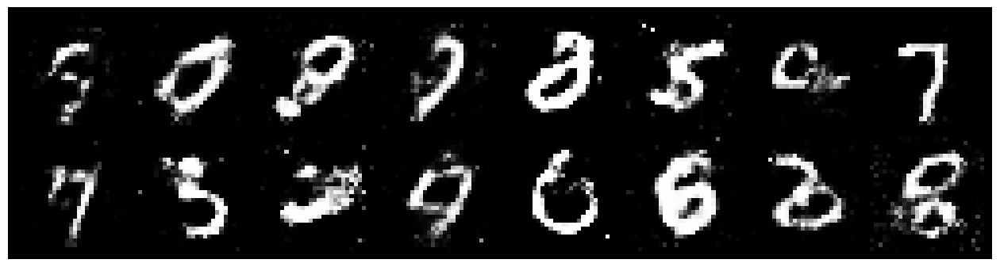

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.1432, Generator Loss: 0.8518
D(x): 0.6016, D(G(z)): 0.4220


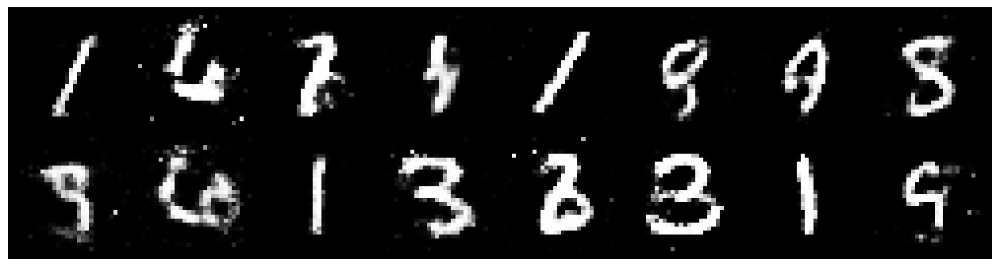

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2989, Generator Loss: 0.8427
D(x): 0.5582, D(G(z)): 0.4628


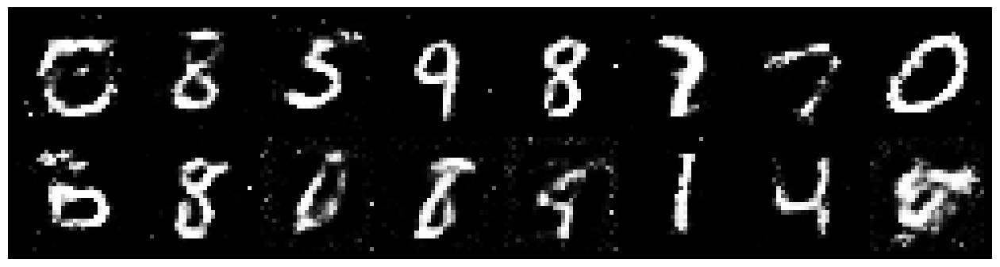

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.2918, Generator Loss: 0.9713
D(x): 0.5996, D(G(z)): 0.4738


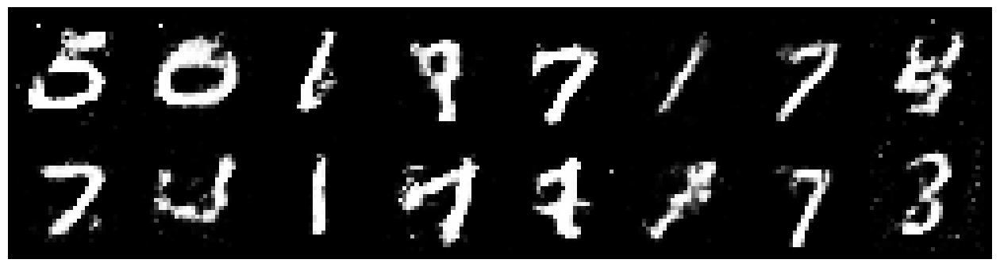

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.2220, Generator Loss: 1.0447
D(x): 0.5752, D(G(z)): 0.3911


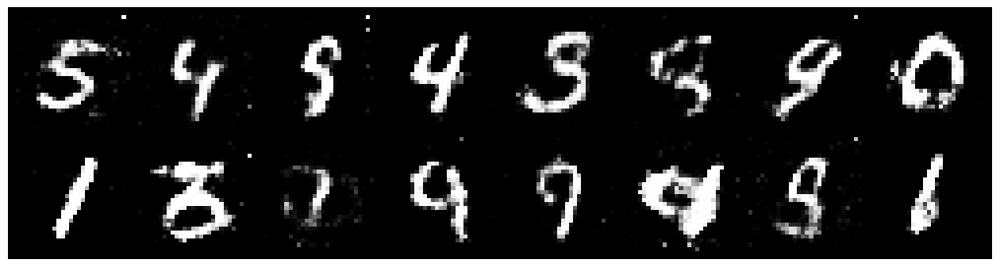

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2061, Generator Loss: 1.0456
D(x): 0.5285, D(G(z)): 0.3590


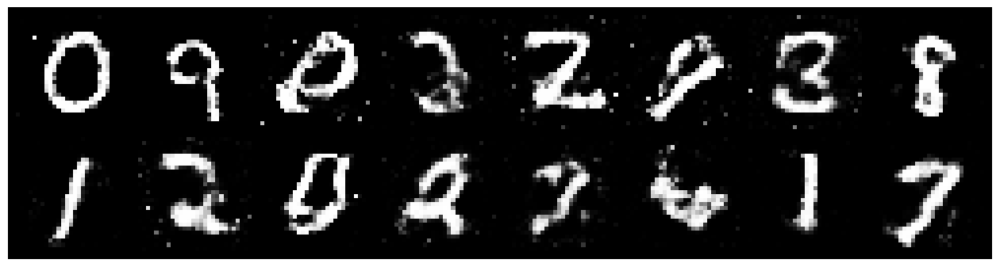

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.1127, Generator Loss: 1.1605
D(x): 0.6092, D(G(z)): 0.3967


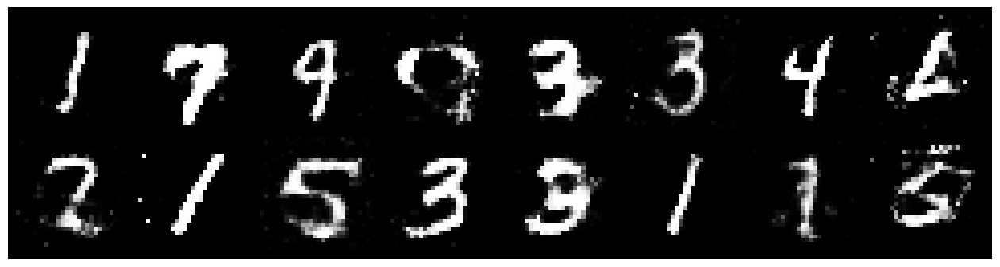

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.1277, Generator Loss: 1.3067
D(x): 0.5699, D(G(z)): 0.3579


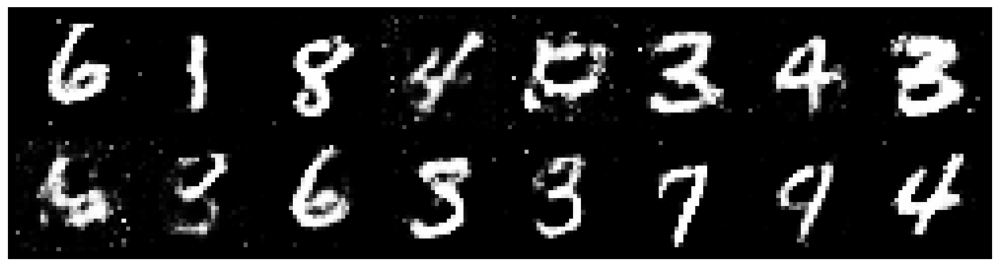

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.2798, Generator Loss: 1.0581
D(x): 0.5404, D(G(z)): 0.4078


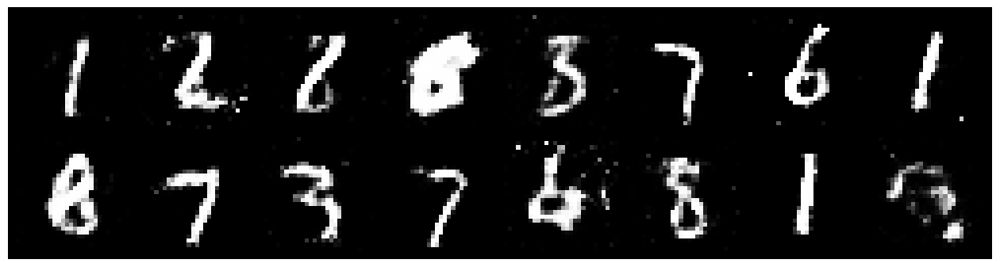

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.1013, Generator Loss: 1.1544
D(x): 0.6246, D(G(z)): 0.3911


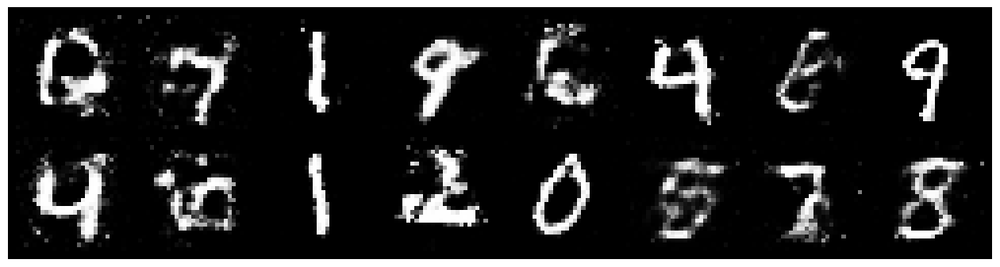

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.1743, Generator Loss: 1.0496
D(x): 0.5791, D(G(z)): 0.3951


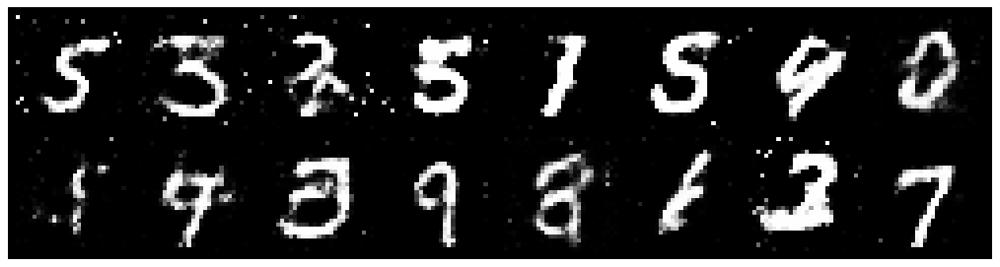

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2700, Generator Loss: 0.8158
D(x): 0.5549, D(G(z)): 0.4708


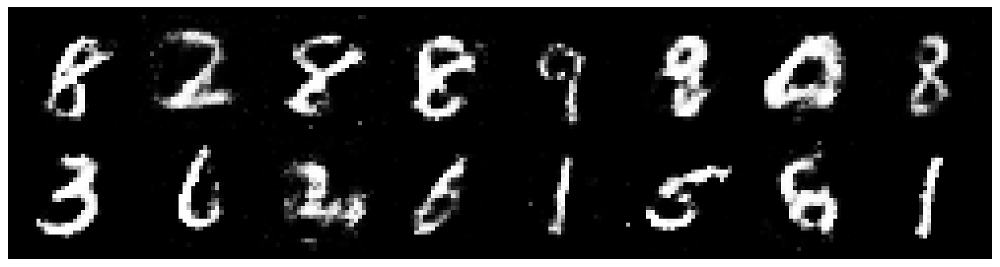

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.2511, Generator Loss: 0.9389
D(x): 0.5714, D(G(z)): 0.4033


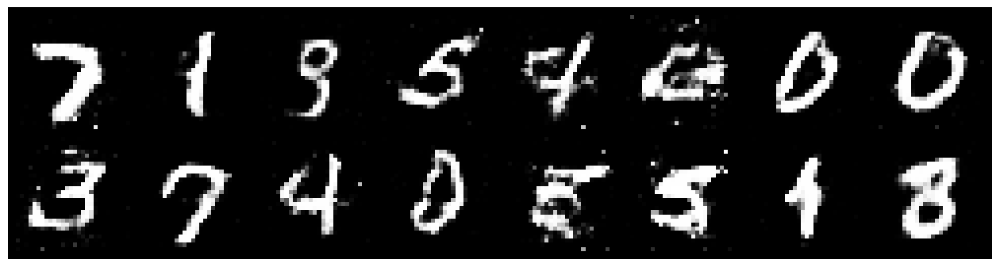

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.0714, Generator Loss: 1.2333
D(x): 0.6008, D(G(z)): 0.3387


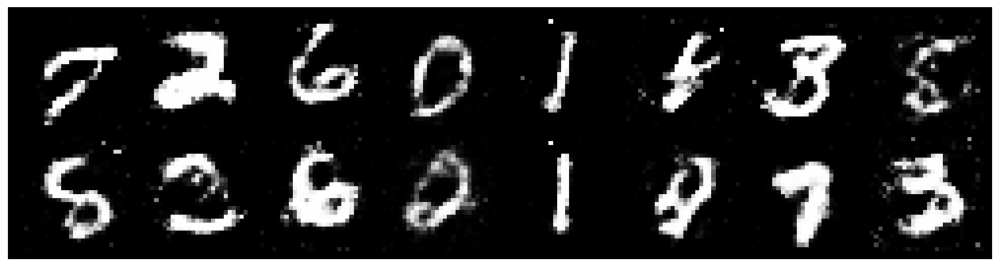

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.2382, Generator Loss: 0.8789
D(x): 0.5848, D(G(z)): 0.4477


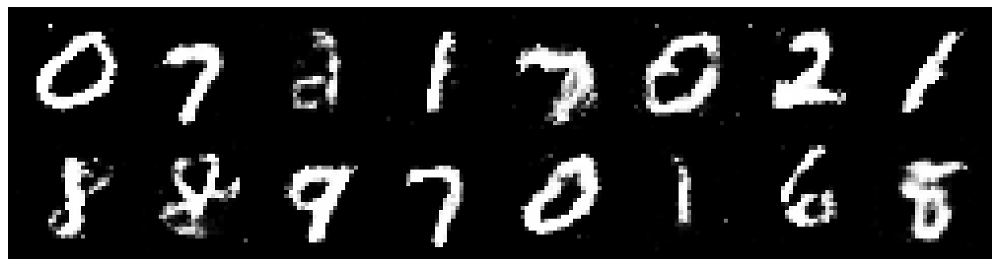

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2888, Generator Loss: 0.8806
D(x): 0.5755, D(G(z)): 0.4511


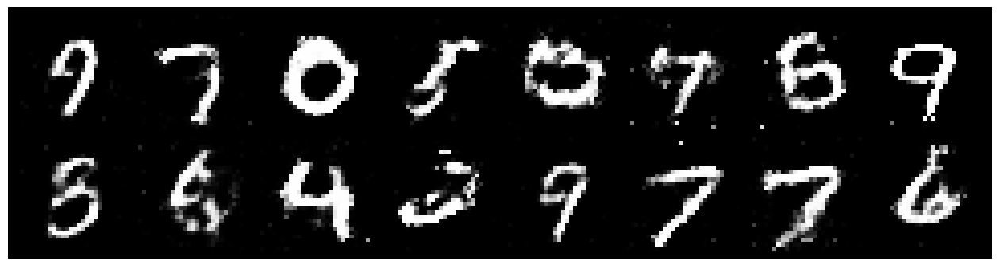

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2820, Generator Loss: 0.9391
D(x): 0.5249, D(G(z)): 0.4181


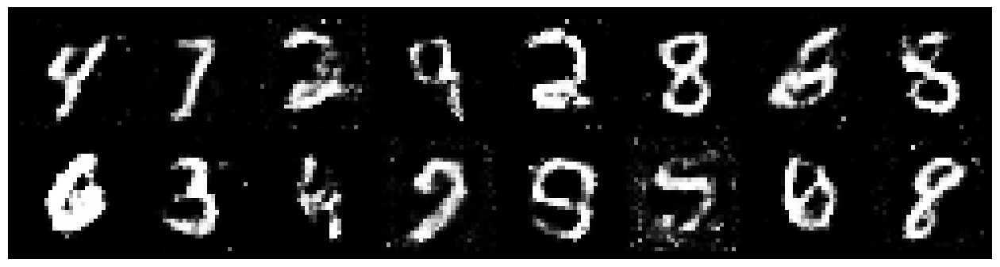

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2782, Generator Loss: 1.0701
D(x): 0.5489, D(G(z)): 0.4023


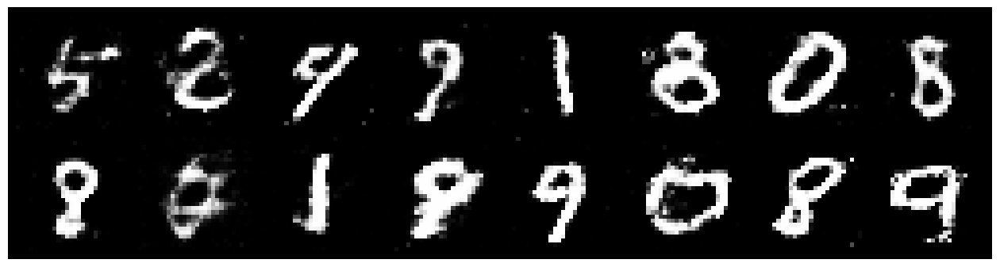

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.1704, Generator Loss: 1.0650
D(x): 0.5567, D(G(z)): 0.3823


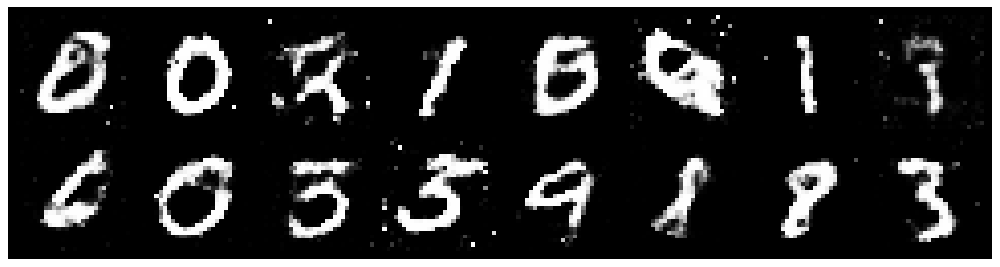

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2426, Generator Loss: 0.8741
D(x): 0.5590, D(G(z)): 0.4486


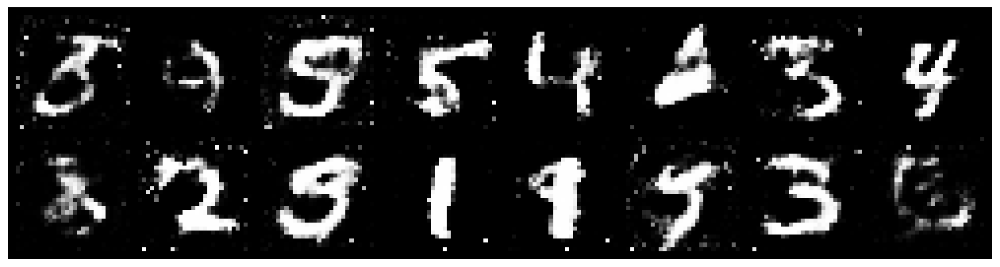

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2664, Generator Loss: 0.8995
D(x): 0.6300, D(G(z)): 0.4947


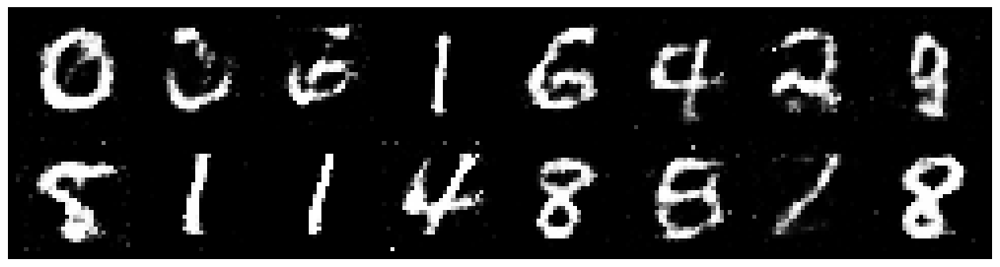

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.1704, Generator Loss: 0.9195
D(x): 0.5875, D(G(z)): 0.4088


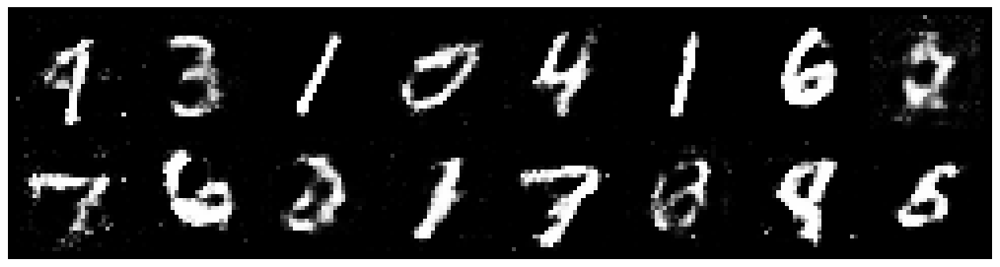

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.2681, Generator Loss: 0.9617
D(x): 0.5362, D(G(z)): 0.4140


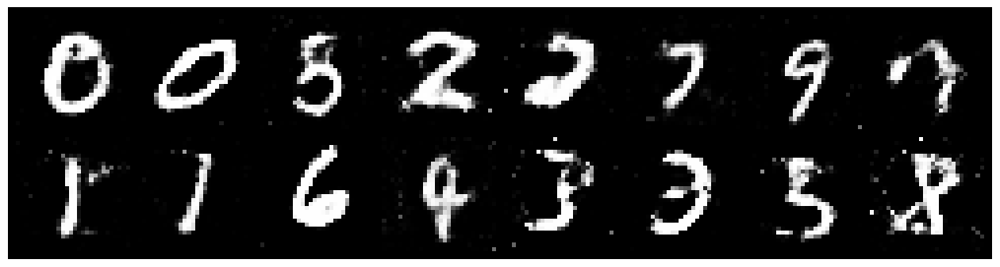

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.2661, Generator Loss: 1.0421
D(x): 0.5730, D(G(z)): 0.4225


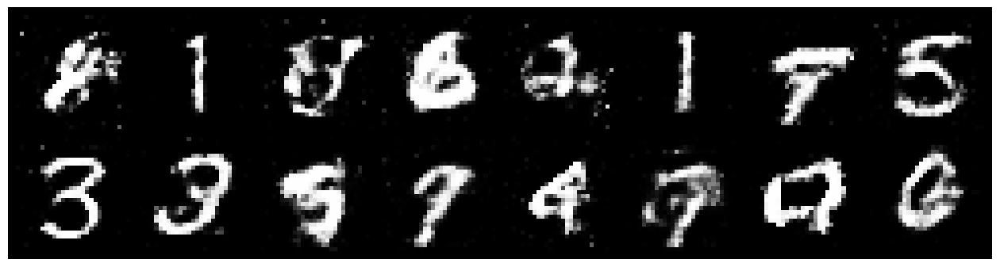

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.1349, Generator Loss: 1.0954
D(x): 0.5602, D(G(z)): 0.3844


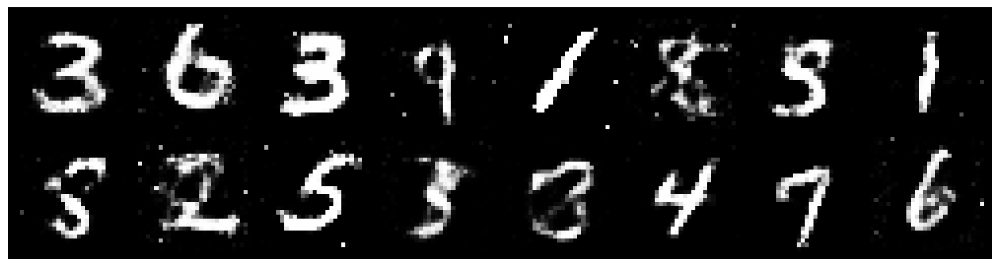

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.1816, Generator Loss: 1.0752
D(x): 0.5876, D(G(z)): 0.4153


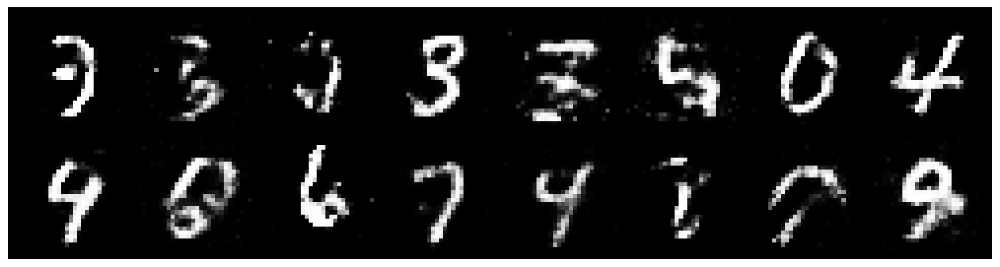

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.2007, Generator Loss: 1.1256
D(x): 0.5824, D(G(z)): 0.3892


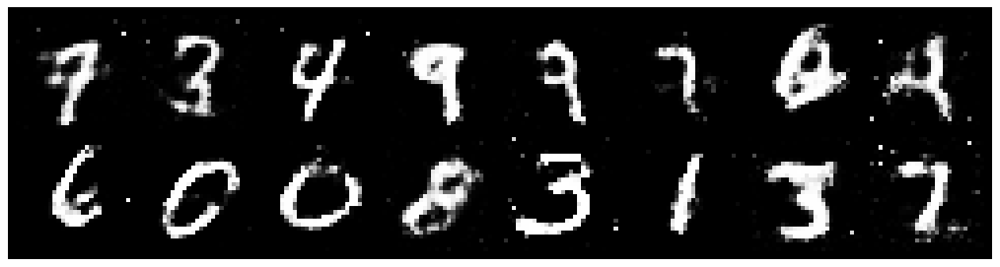

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.3032, Generator Loss: 0.8627
D(x): 0.5563, D(G(z)): 0.4484


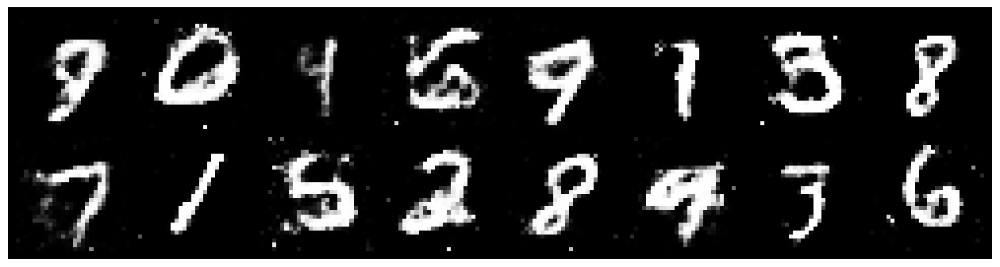

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.3078, Generator Loss: 0.7850
D(x): 0.5573, D(G(z)): 0.4606


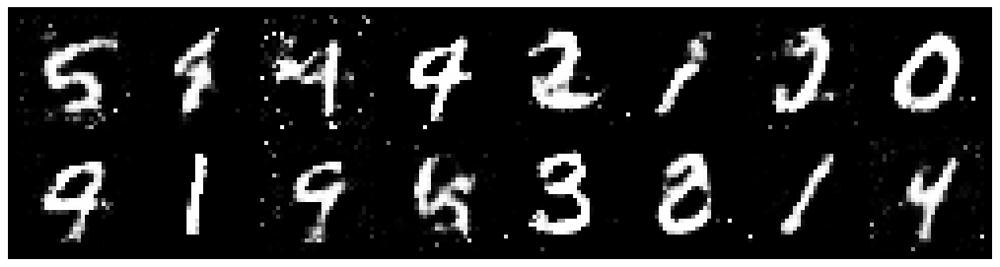

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2574, Generator Loss: 0.9172
D(x): 0.5566, D(G(z)): 0.4363


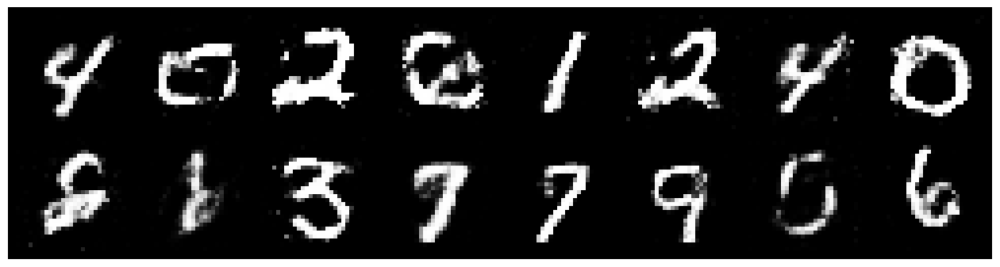

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.1770, Generator Loss: 1.0503
D(x): 0.5599, D(G(z)): 0.3941


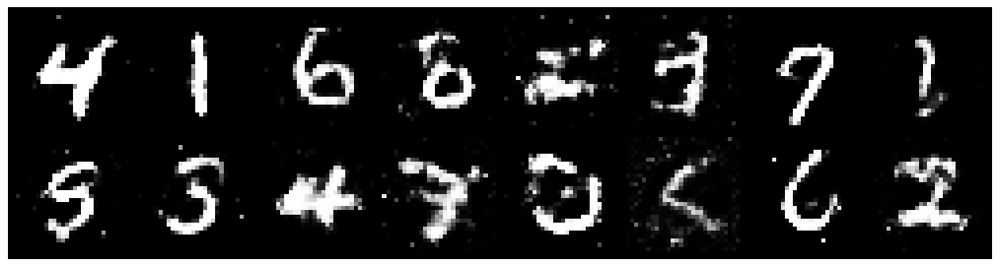

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.1876, Generator Loss: 1.0058
D(x): 0.5878, D(G(z)): 0.4293


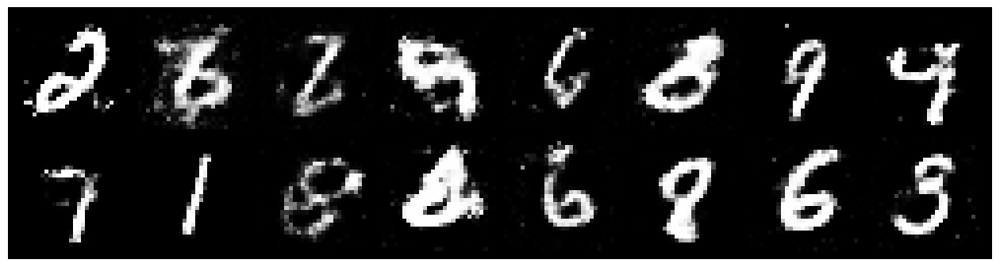

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2535, Generator Loss: 0.8943
D(x): 0.5523, D(G(z)): 0.4243


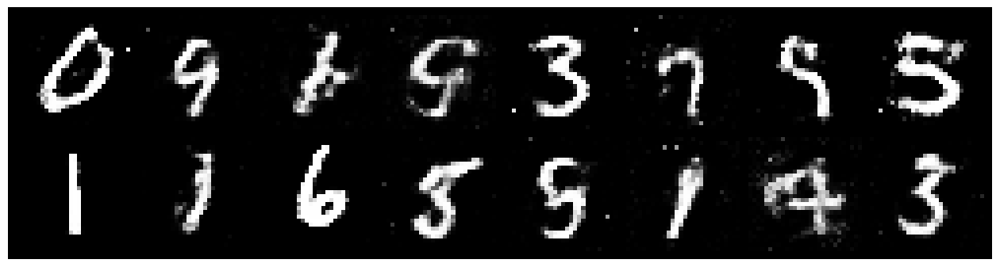

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.2723, Generator Loss: 0.7747
D(x): 0.5698, D(G(z)): 0.4646


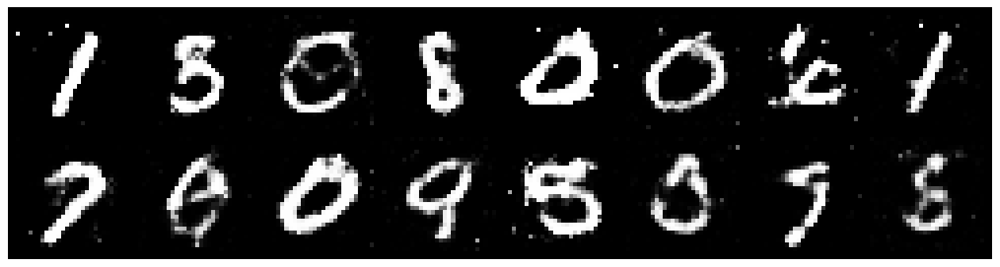

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.4058, Generator Loss: 0.8646
D(x): 0.5477, D(G(z)): 0.4686


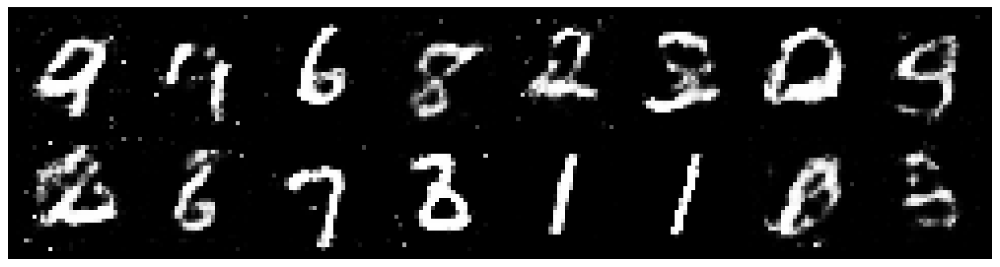

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.2232, Generator Loss: 0.9685
D(x): 0.6151, D(G(z)): 0.4365


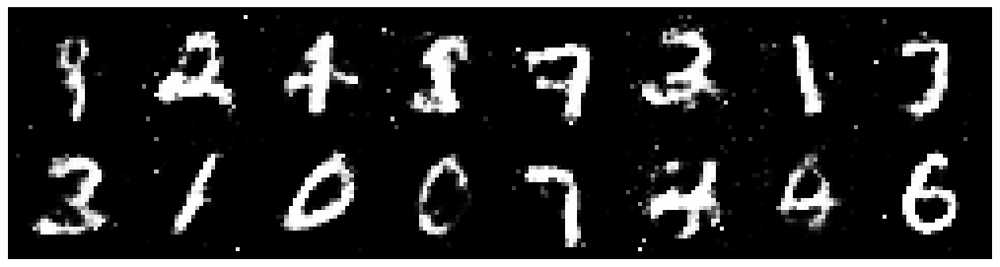

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.2004, Generator Loss: 1.1558
D(x): 0.5233, D(G(z)): 0.3542


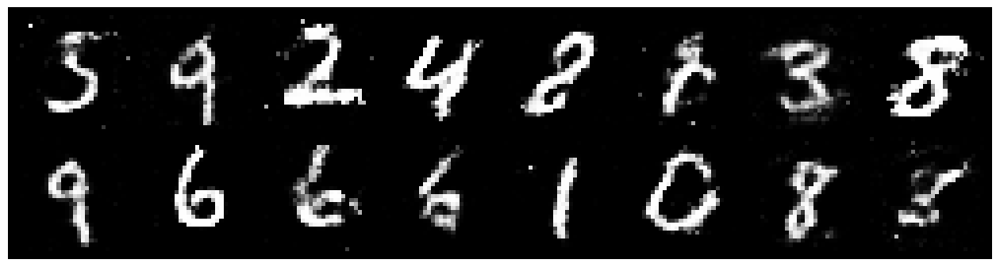

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.1760, Generator Loss: 0.9166
D(x): 0.5755, D(G(z)): 0.4190


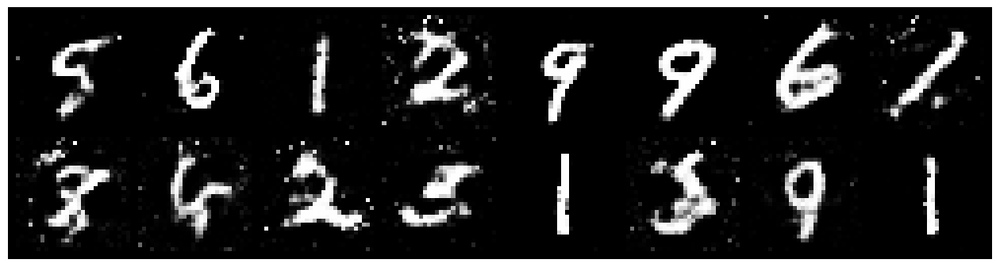

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2583, Generator Loss: 0.9199
D(x): 0.5525, D(G(z)): 0.4370


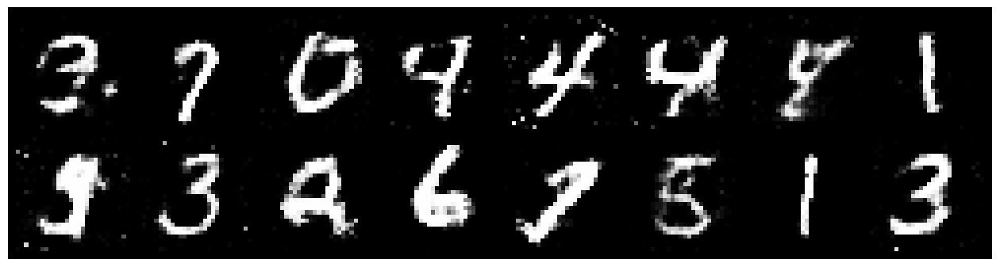

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2269, Generator Loss: 0.9432
D(x): 0.5825, D(G(z)): 0.4378


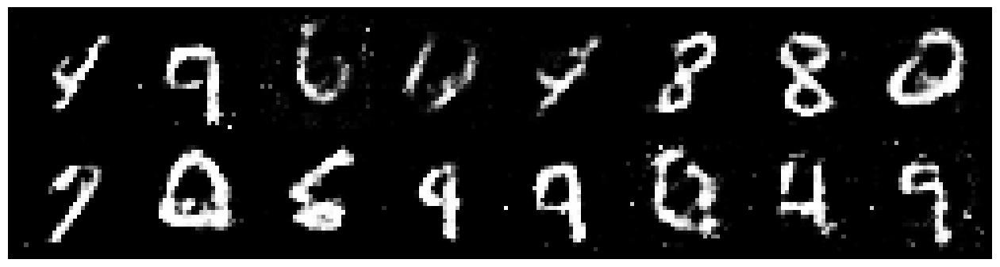

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2339, Generator Loss: 0.9546
D(x): 0.5870, D(G(z)): 0.4415


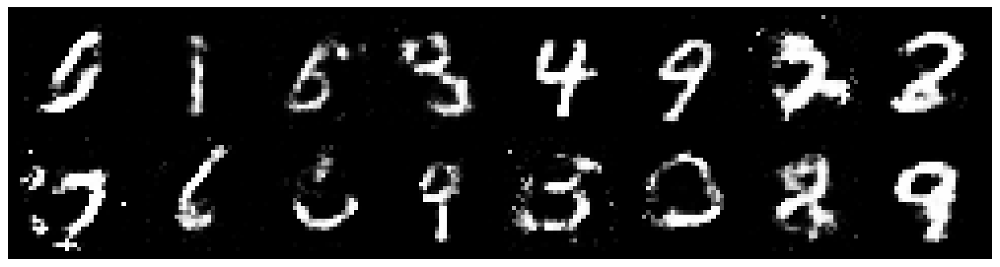

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.3020, Generator Loss: 1.2701
D(x): 0.4897, D(G(z)): 0.3340


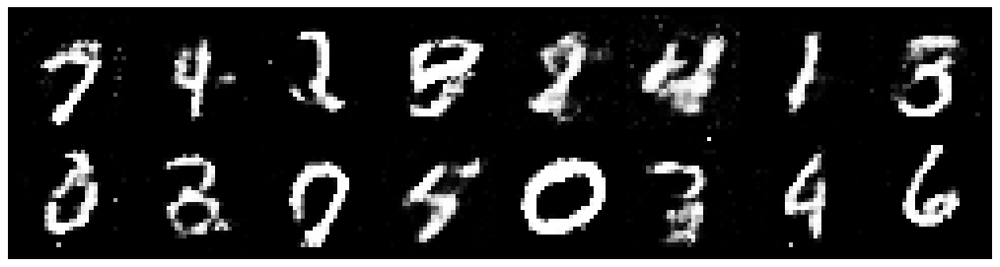

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.1089, Generator Loss: 1.2943
D(x): 0.6062, D(G(z)): 0.3775


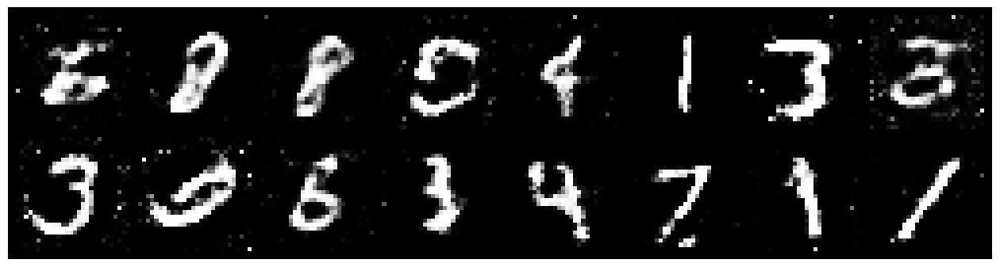

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2071, Generator Loss: 0.8768
D(x): 0.5834, D(G(z)): 0.4263


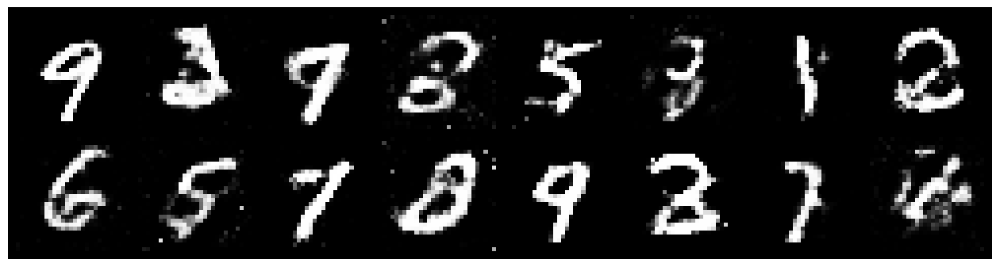

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.1014, Generator Loss: 0.9600
D(x): 0.6434, D(G(z)): 0.4210


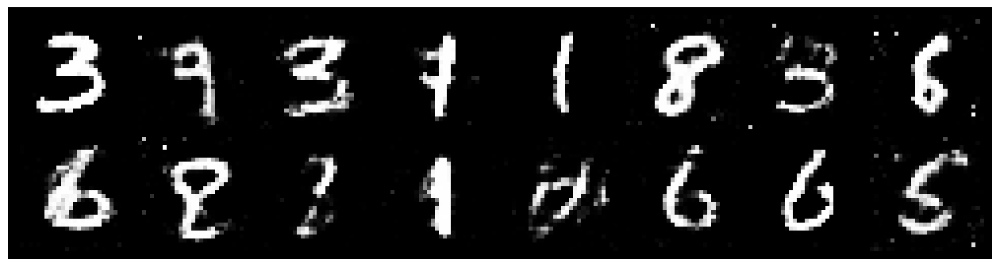

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.1537, Generator Loss: 1.0374
D(x): 0.5935, D(G(z)): 0.4056


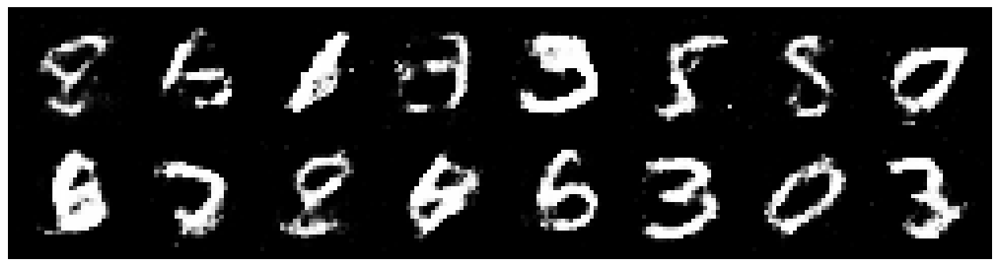

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.3692, Generator Loss: 0.8955
D(x): 0.5313, D(G(z)): 0.4526


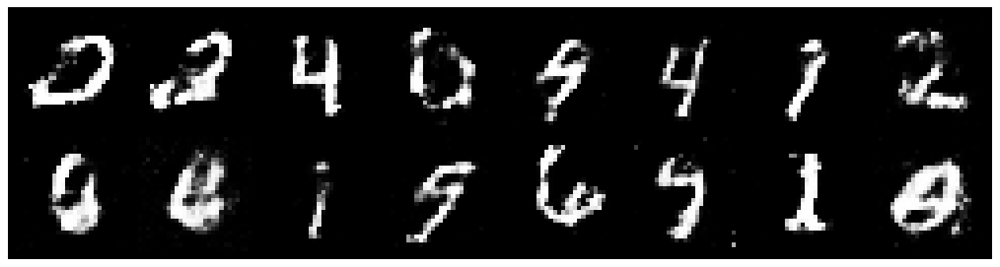

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.2208, Generator Loss: 0.9391
D(x): 0.5757, D(G(z)): 0.4546


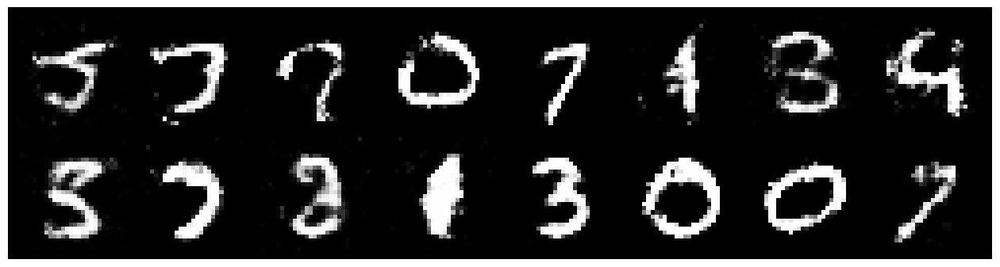

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2201, Generator Loss: 0.8585
D(x): 0.5318, D(G(z)): 0.4022


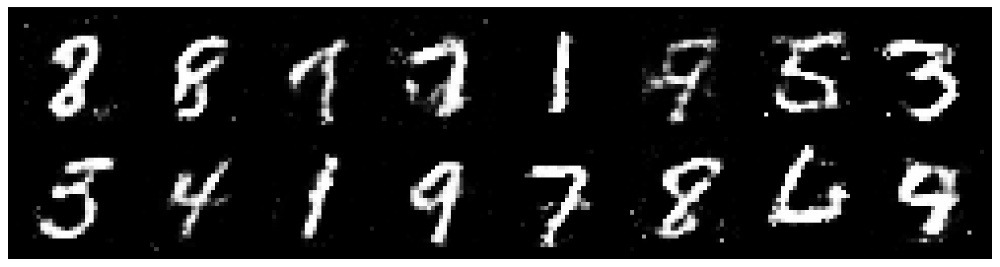

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.4412, Generator Loss: 1.0797
D(x): 0.4961, D(G(z)): 0.4347


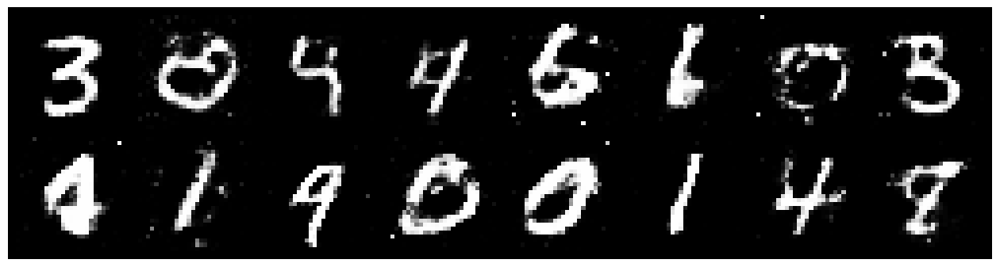

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2104, Generator Loss: 1.1232
D(x): 0.5515, D(G(z)): 0.3782


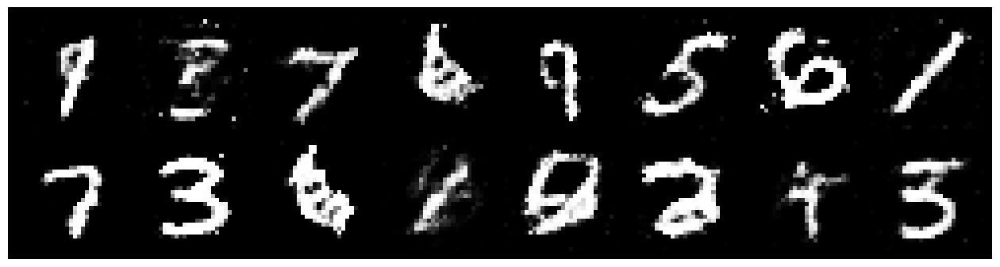

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.0277, Generator Loss: 1.1933
D(x): 0.6109, D(G(z)): 0.3537


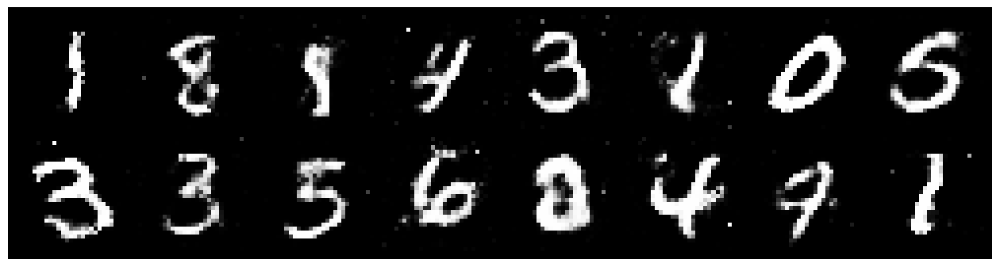

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.1879, Generator Loss: 0.8577
D(x): 0.5864, D(G(z)): 0.4158


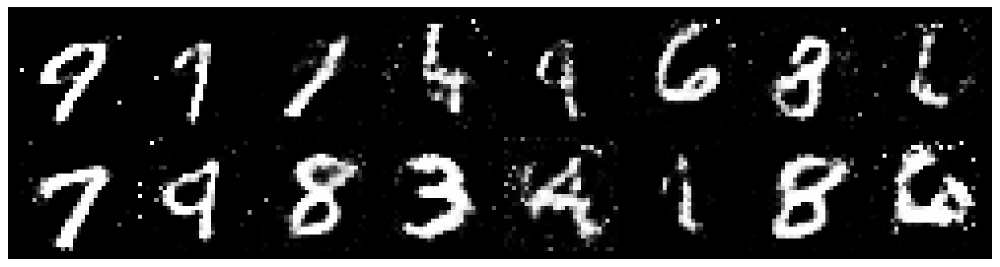

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.3727, Generator Loss: 0.9494
D(x): 0.4877, D(G(z)): 0.4265


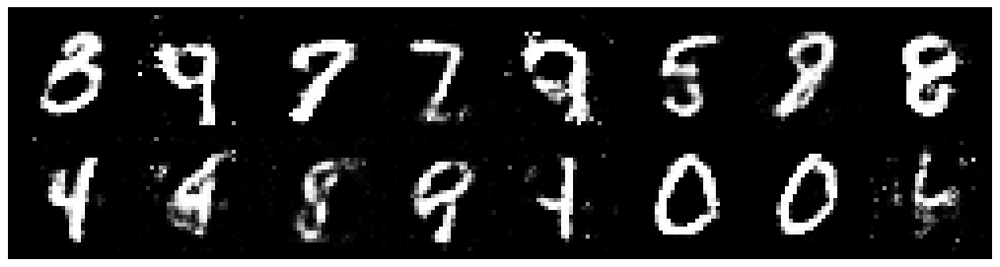

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.2443, Generator Loss: 0.7880
D(x): 0.5694, D(G(z)): 0.4380


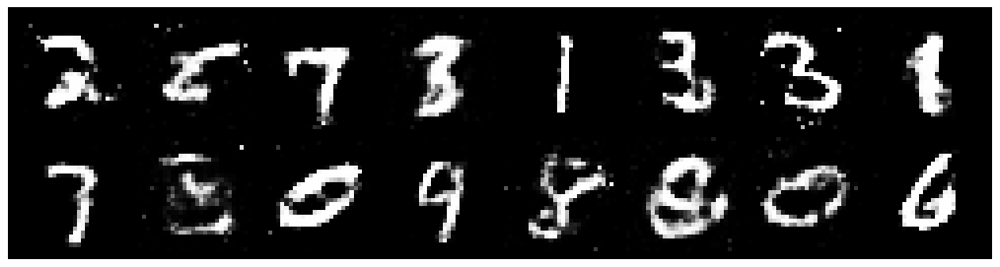

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.2564, Generator Loss: 0.9520
D(x): 0.5900, D(G(z)): 0.4253


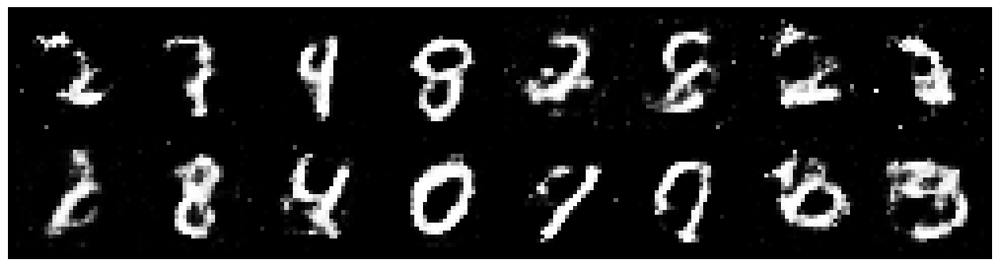

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2134, Generator Loss: 0.8648
D(x): 0.5380, D(G(z)): 0.4042


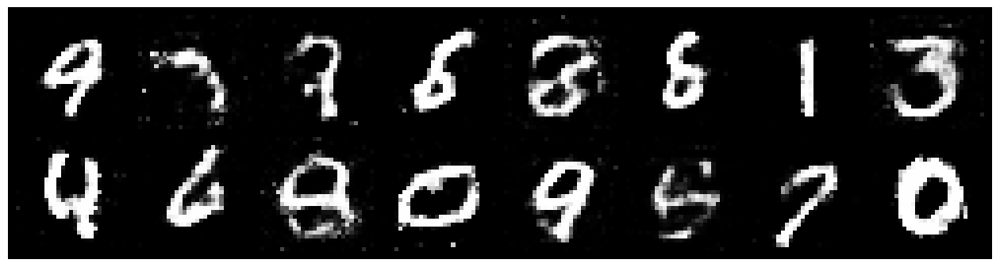

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.4102, Generator Loss: 0.7606
D(x): 0.5341, D(G(z)): 0.4996


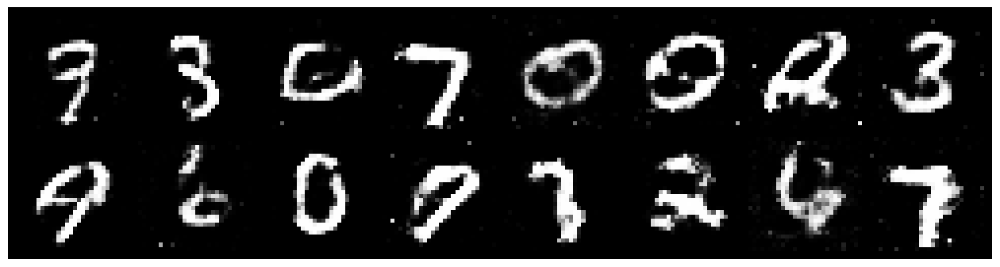

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.2817, Generator Loss: 1.1139
D(x): 0.5880, D(G(z)): 0.4464


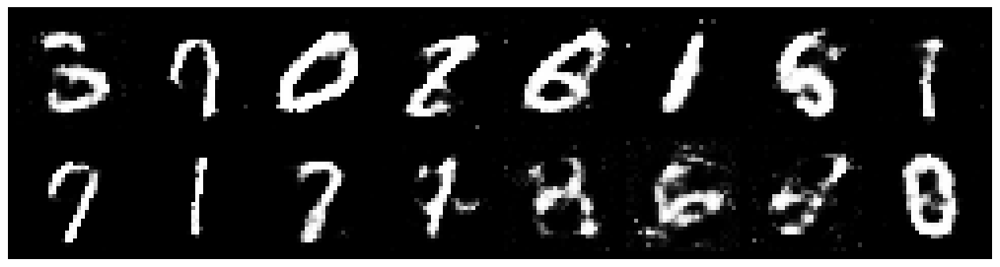

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.3107, Generator Loss: 0.7391
D(x): 0.5677, D(G(z)): 0.4675


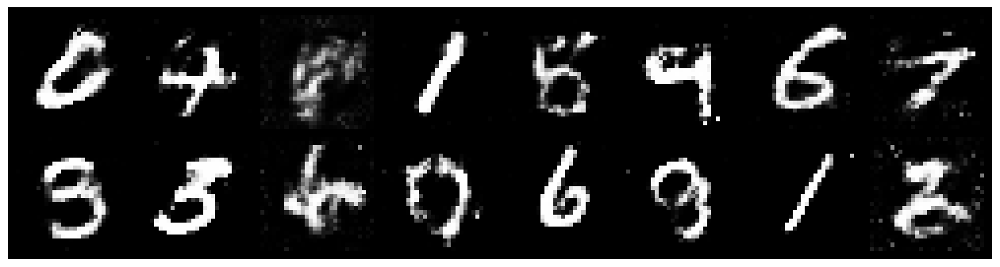

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.5260, Generator Loss: 0.9243
D(x): 0.5701, D(G(z)): 0.5054


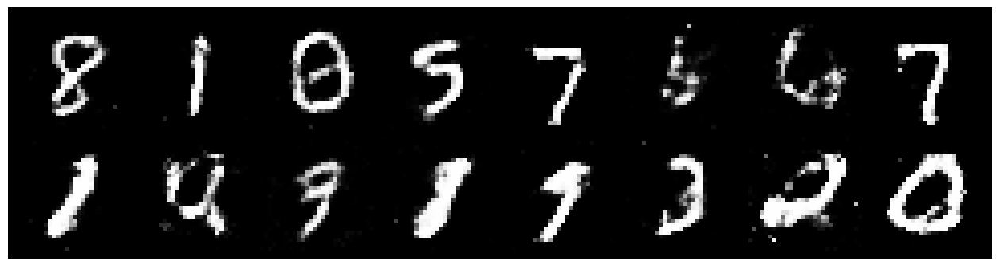

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.1998, Generator Loss: 1.1382
D(x): 0.6453, D(G(z)): 0.4493


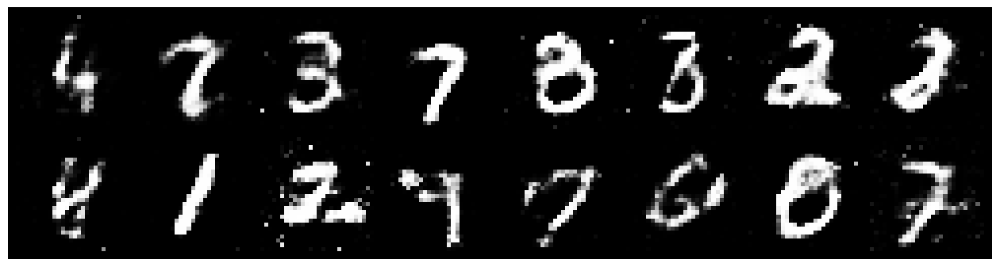

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.2294, Generator Loss: 1.0740
D(x): 0.5558, D(G(z)): 0.3937


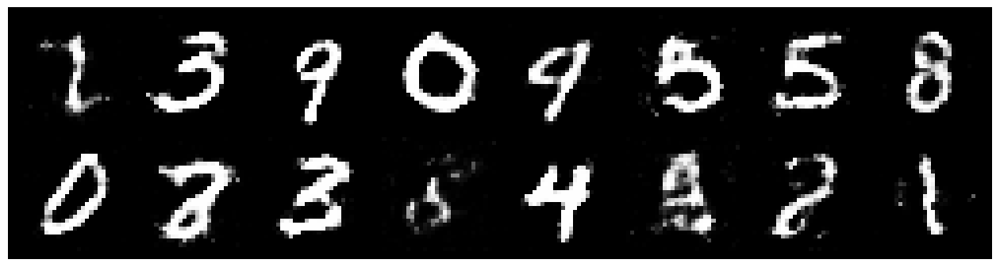

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2724, Generator Loss: 0.8777
D(x): 0.6020, D(G(z)): 0.4638


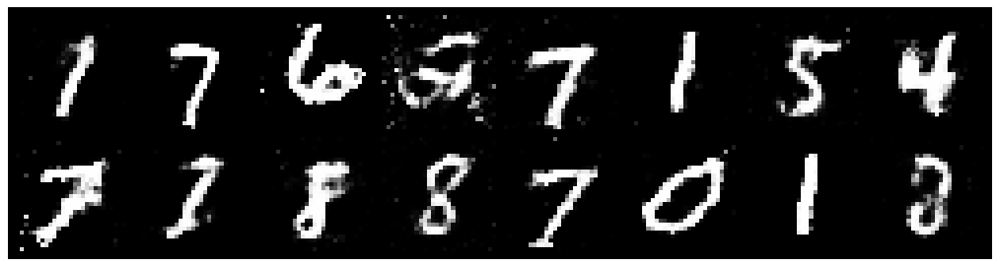

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2720, Generator Loss: 0.9216
D(x): 0.5589, D(G(z)): 0.4280


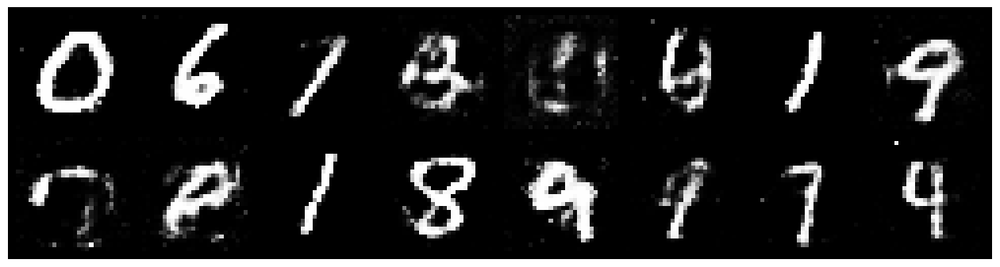

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.2561, Generator Loss: 1.0579
D(x): 0.5571, D(G(z)): 0.4124


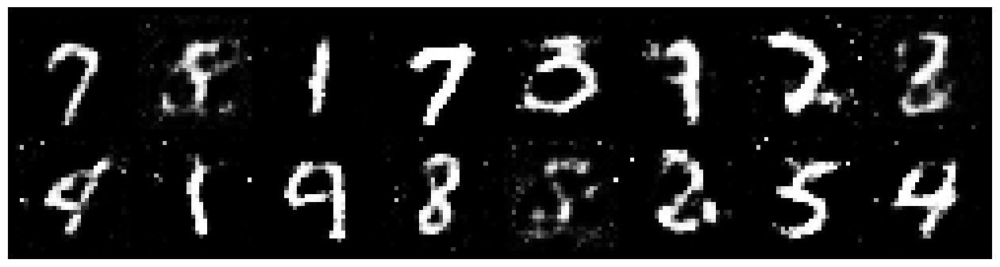

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.3067, Generator Loss: 1.0990
D(x): 0.5463, D(G(z)): 0.4488


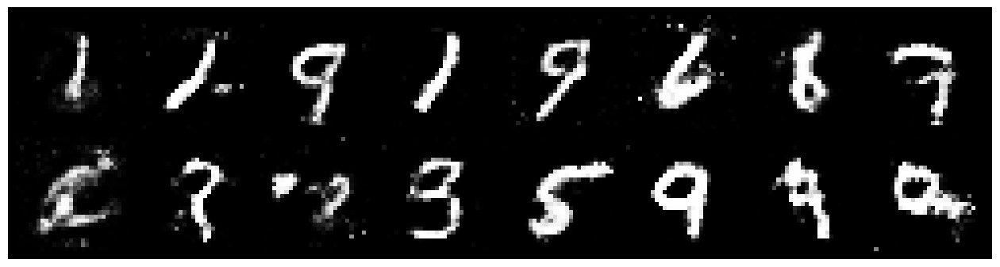

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.1906, Generator Loss: 0.9737
D(x): 0.5647, D(G(z)): 0.4153


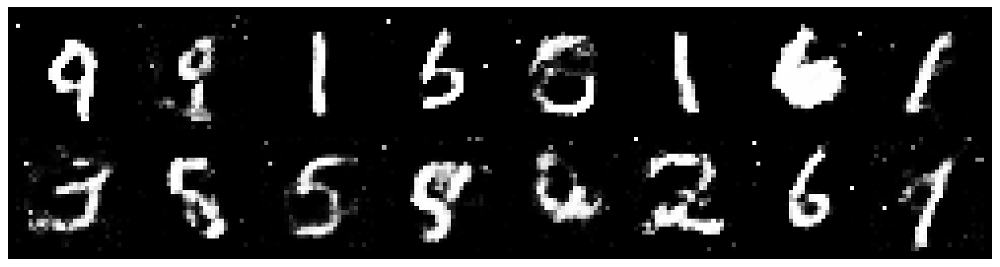

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.1843, Generator Loss: 1.0340
D(x): 0.6081, D(G(z)): 0.4383


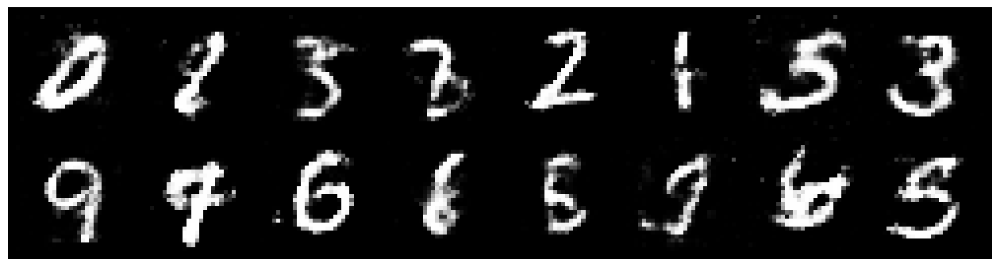

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2349, Generator Loss: 0.8975
D(x): 0.5510, D(G(z)): 0.4365


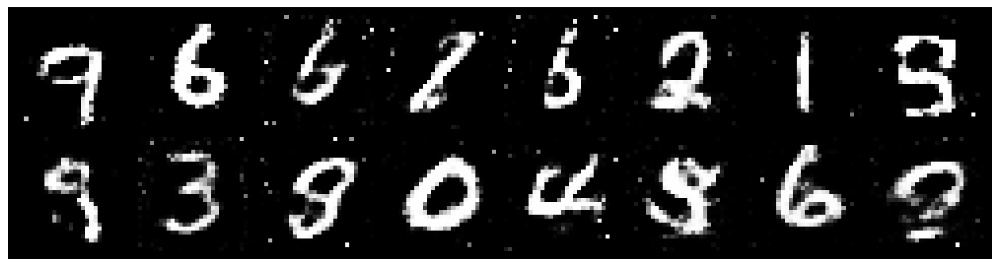

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2889, Generator Loss: 0.9385
D(x): 0.5872, D(G(z)): 0.4637


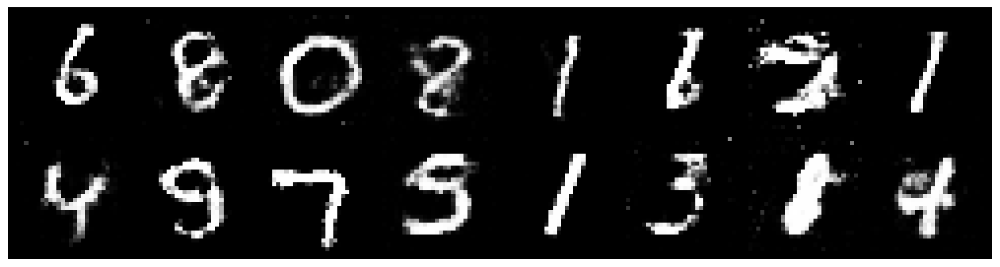

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2163, Generator Loss: 0.8484
D(x): 0.5762, D(G(z)): 0.4505


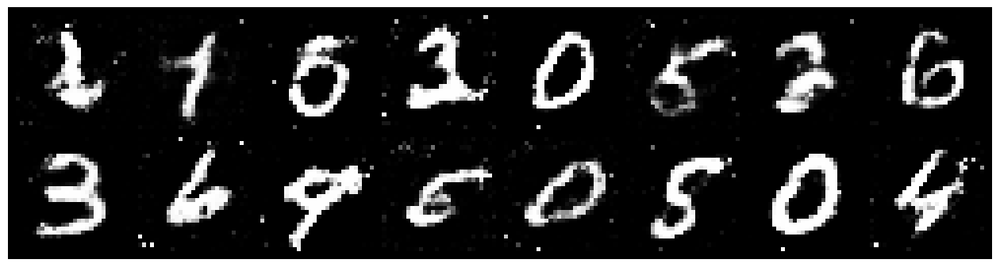

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2418, Generator Loss: 0.9229
D(x): 0.5516, D(G(z)): 0.4378


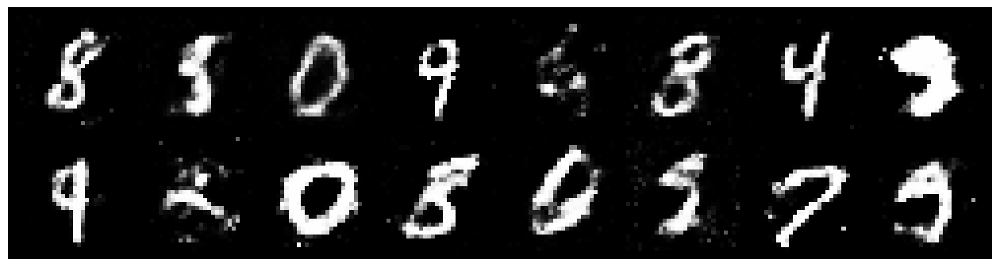

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2266, Generator Loss: 0.8391
D(x): 0.5704, D(G(z)): 0.4459


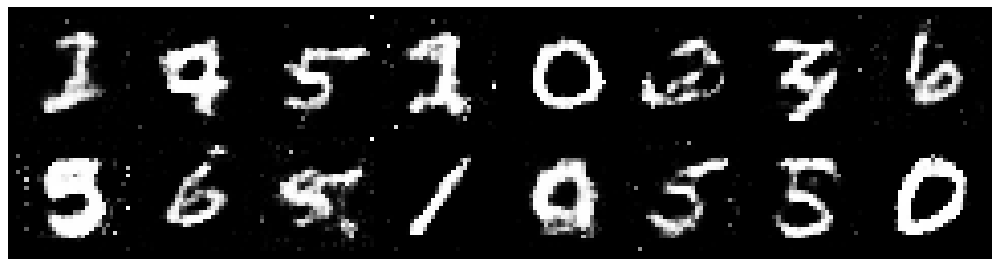

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.3916, Generator Loss: 0.8346
D(x): 0.5264, D(G(z)): 0.4690


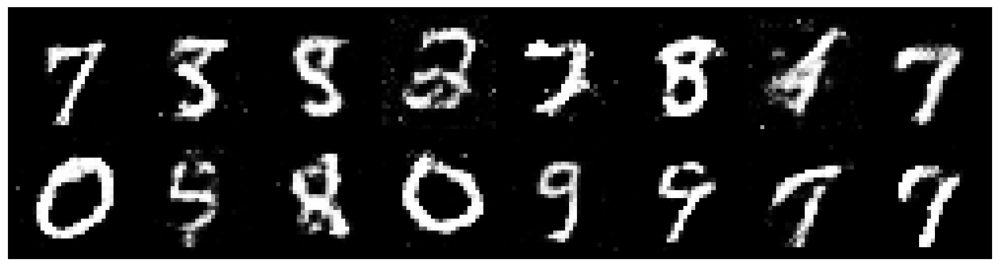

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.1815, Generator Loss: 0.9022
D(x): 0.5920, D(G(z)): 0.4286


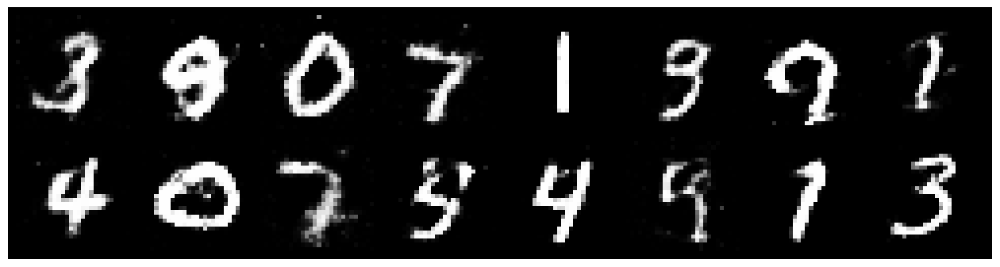

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.2420, Generator Loss: 0.9110
D(x): 0.6072, D(G(z)): 0.4705


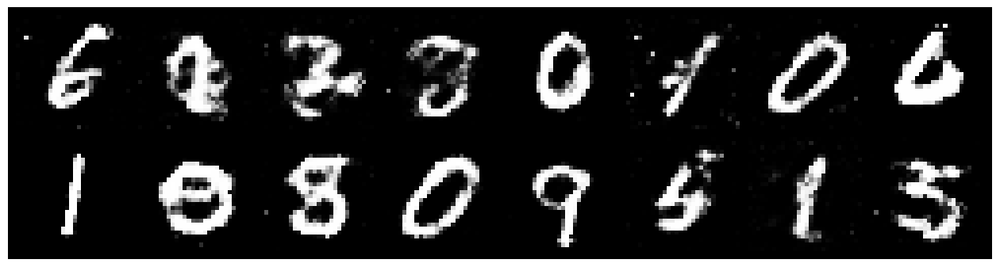

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.3113, Generator Loss: 0.9552
D(x): 0.5765, D(G(z)): 0.4641


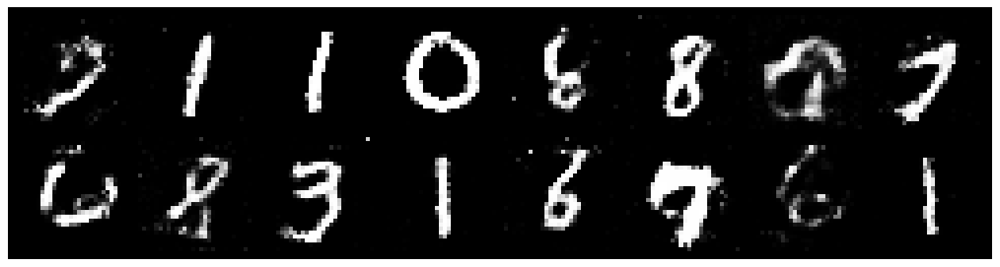

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.1693, Generator Loss: 1.0262
D(x): 0.5785, D(G(z)): 0.4109


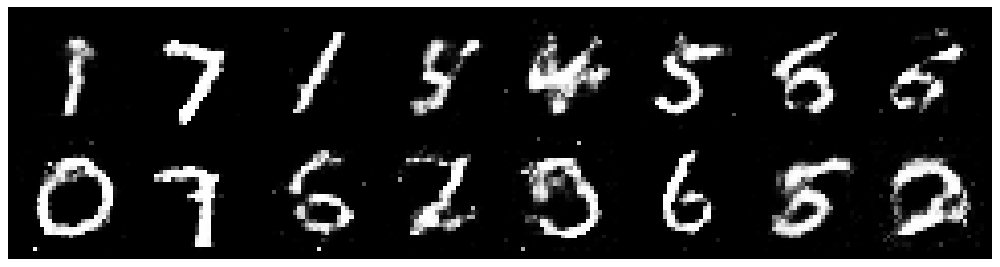

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2114, Generator Loss: 0.8468
D(x): 0.5986, D(G(z)): 0.4687


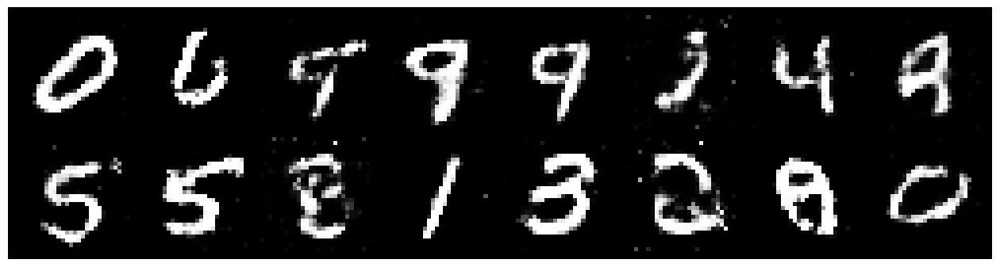

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.3212, Generator Loss: 0.8789
D(x): 0.5312, D(G(z)): 0.4350


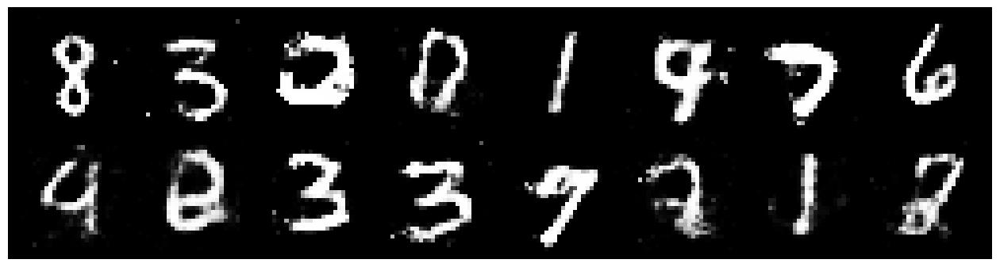

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.1939, Generator Loss: 0.9361
D(x): 0.6096, D(G(z)): 0.4407


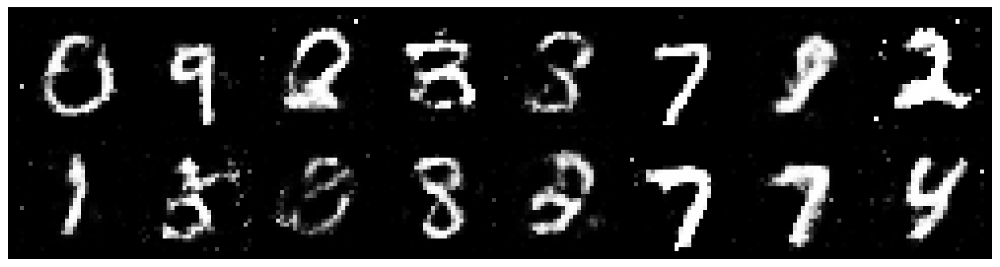

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.1369, Generator Loss: 1.0036
D(x): 0.6129, D(G(z)): 0.4163


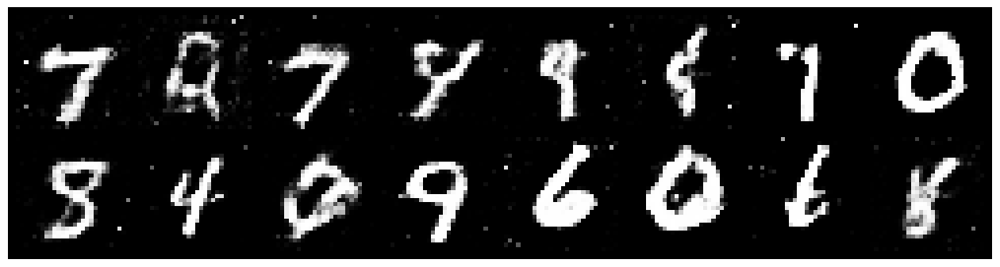

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.0843, Generator Loss: 1.1123
D(x): 0.6080, D(G(z)): 0.3969


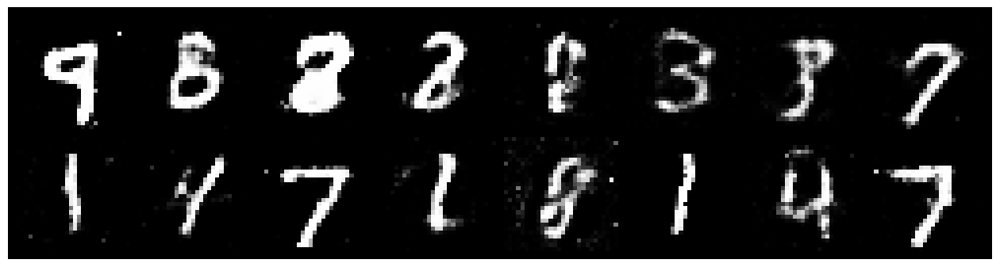

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2765, Generator Loss: 0.8411
D(x): 0.5847, D(G(z)): 0.4712


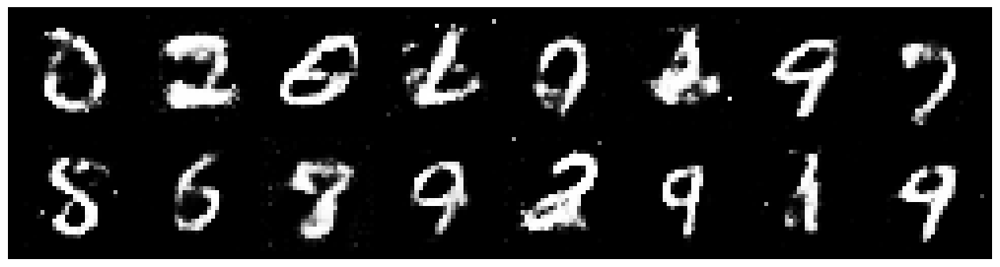

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.3222, Generator Loss: 0.8418
D(x): 0.5565, D(G(z)): 0.4799


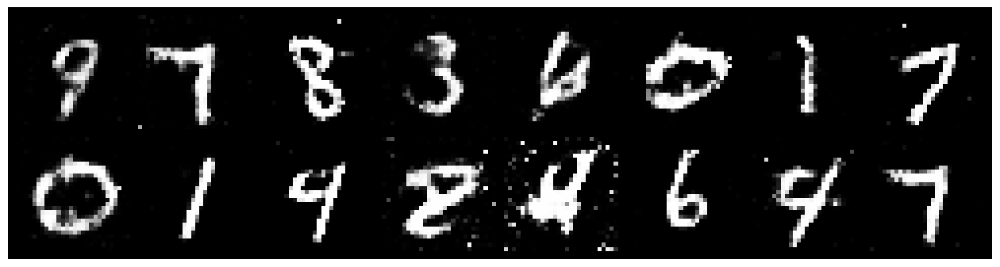

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.3161, Generator Loss: 0.8376
D(x): 0.5682, D(G(z)): 0.4790


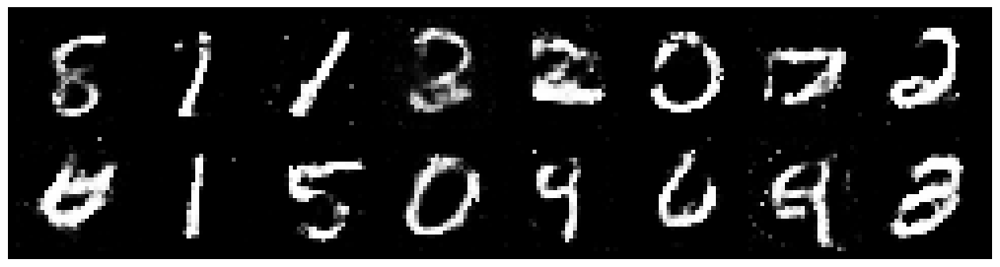

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.2722, Generator Loss: 0.7696
D(x): 0.5807, D(G(z)): 0.4813


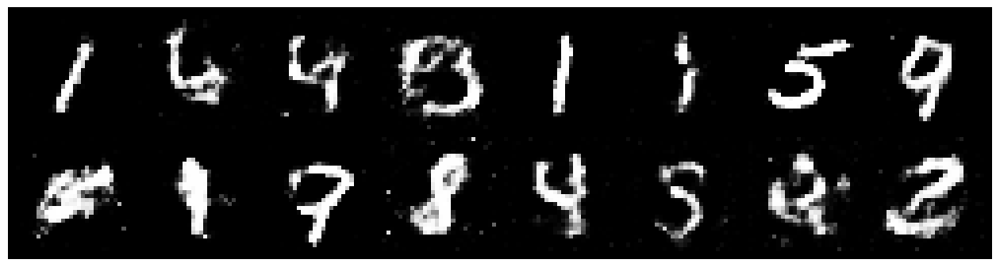

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3246, Generator Loss: 0.8988
D(x): 0.5236, D(G(z)): 0.4371


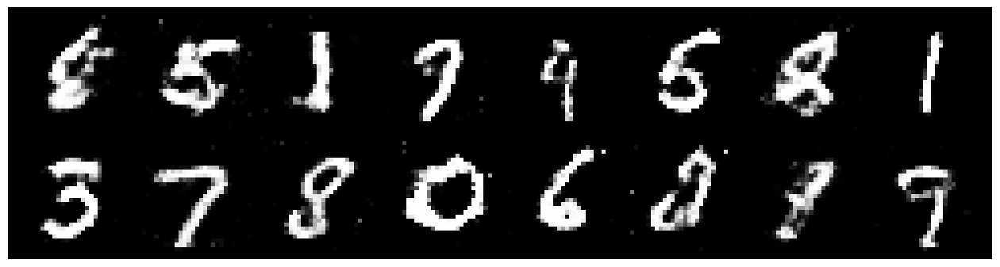

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.3123, Generator Loss: 0.8274
D(x): 0.5485, D(G(z)): 0.4579


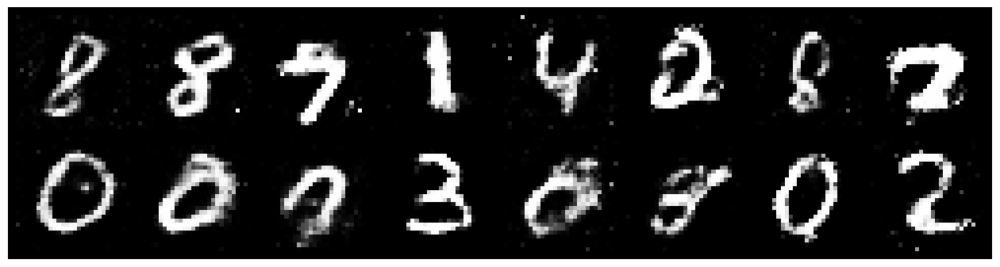

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.3394, Generator Loss: 0.8478
D(x): 0.5542, D(G(z)): 0.4794


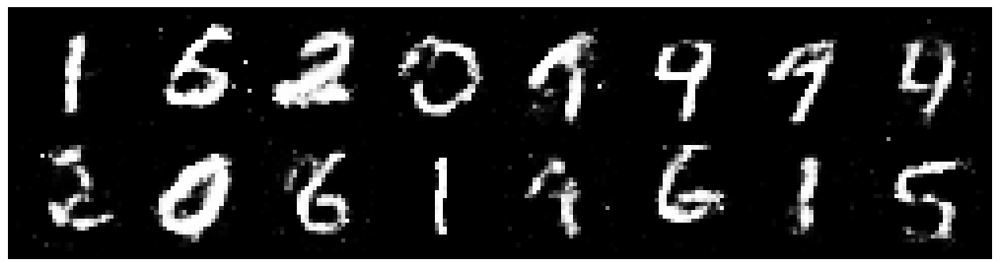

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.3100, Generator Loss: 0.8743
D(x): 0.5488, D(G(z)): 0.4370


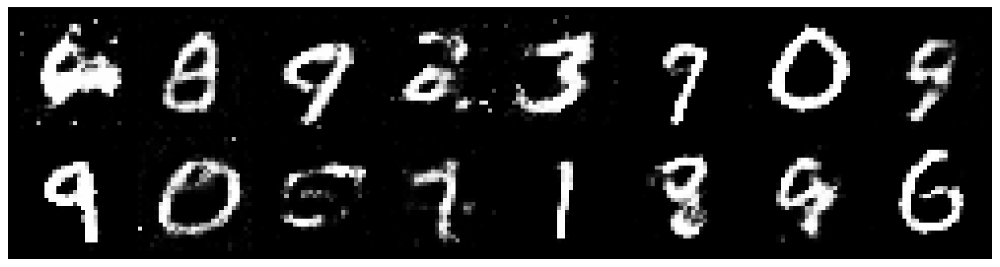

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2180, Generator Loss: 0.9373
D(x): 0.5822, D(G(z)): 0.4417


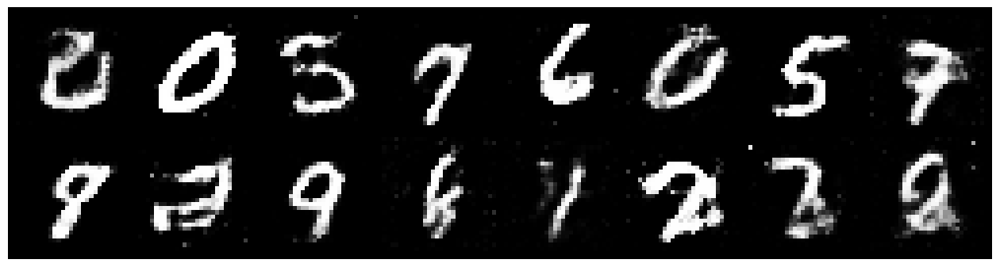

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2420, Generator Loss: 0.9025
D(x): 0.5788, D(G(z)): 0.4402


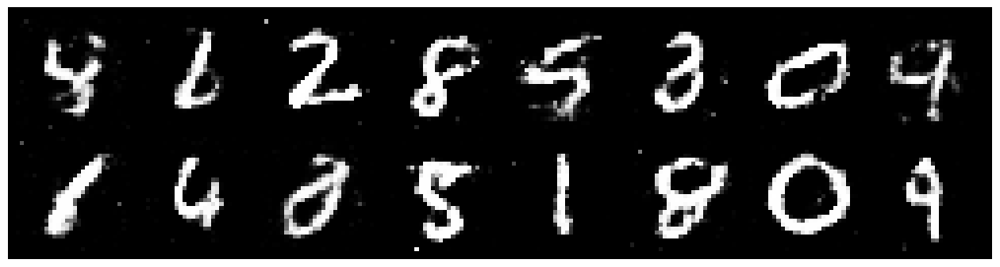

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.2511, Generator Loss: 0.8998
D(x): 0.5702, D(G(z)): 0.4243


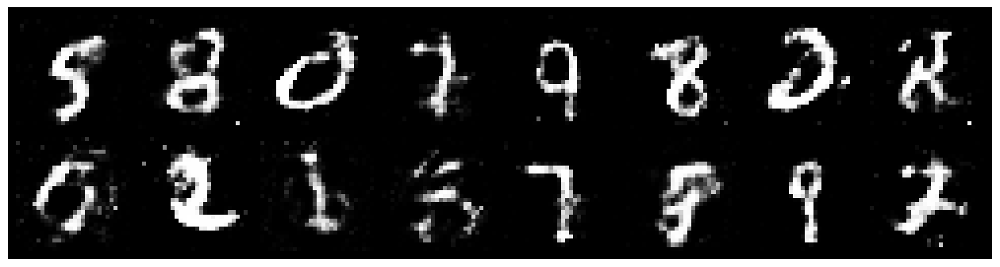

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.2746, Generator Loss: 0.9368
D(x): 0.5919, D(G(z)): 0.4386


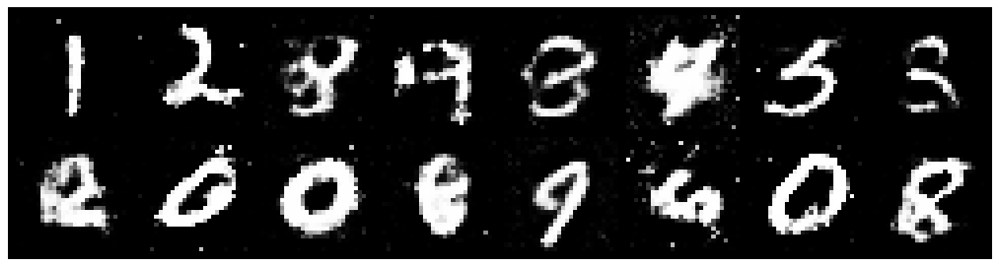

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.2161, Generator Loss: 0.9351
D(x): 0.5680, D(G(z)): 0.4128


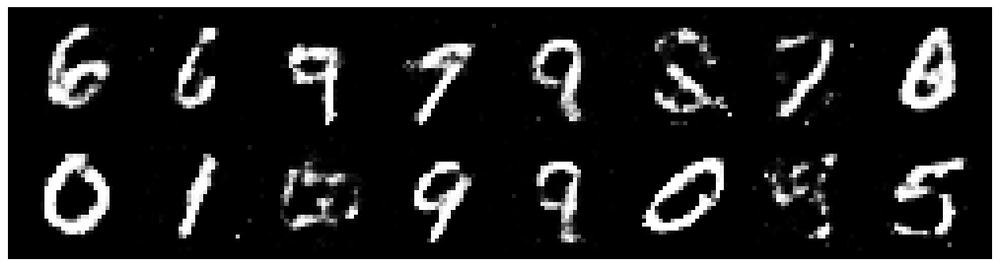

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2915, Generator Loss: 0.9279
D(x): 0.5268, D(G(z)): 0.4354


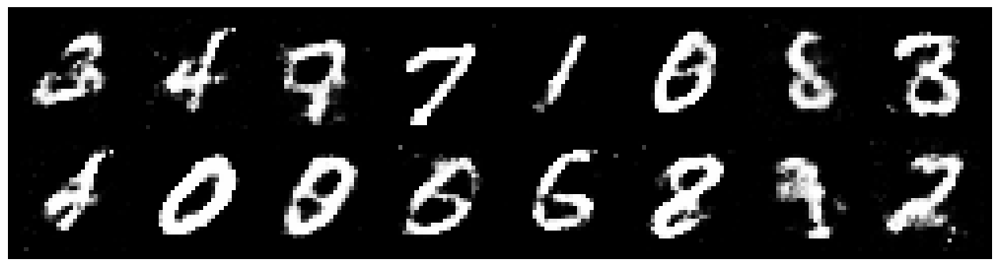

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2189, Generator Loss: 0.9694
D(x): 0.5676, D(G(z)): 0.4184


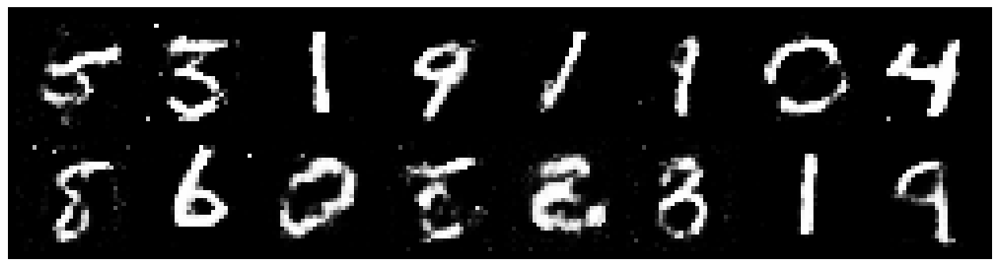

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.1480, Generator Loss: 0.9685
D(x): 0.6186, D(G(z)): 0.3917


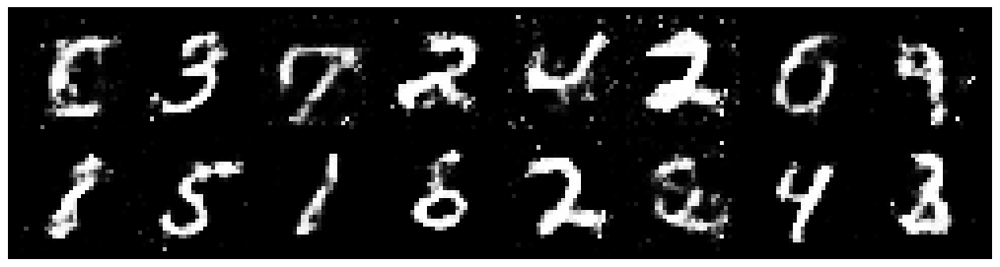

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.1106, Generator Loss: 0.9964
D(x): 0.5994, D(G(z)): 0.3920


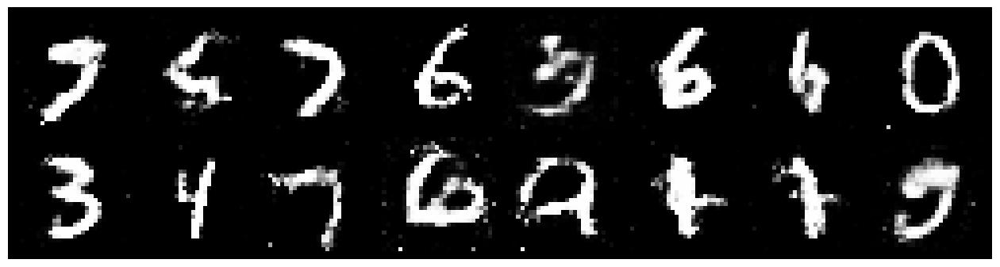

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.1413, Generator Loss: 1.0490
D(x): 0.5886, D(G(z)): 0.3963


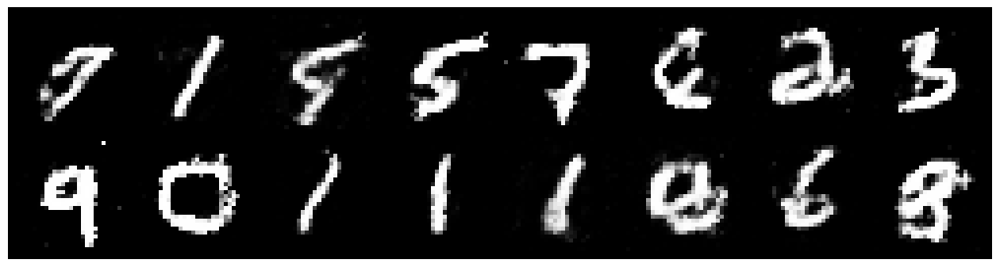

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.1806, Generator Loss: 1.0863
D(x): 0.5759, D(G(z)): 0.3970


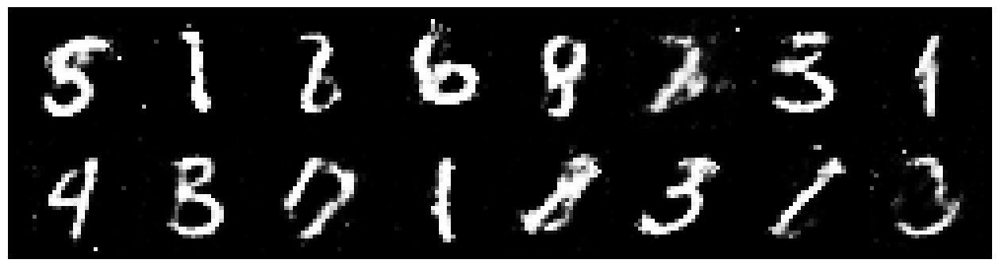

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.2552, Generator Loss: 0.8908
D(x): 0.5528, D(G(z)): 0.4413


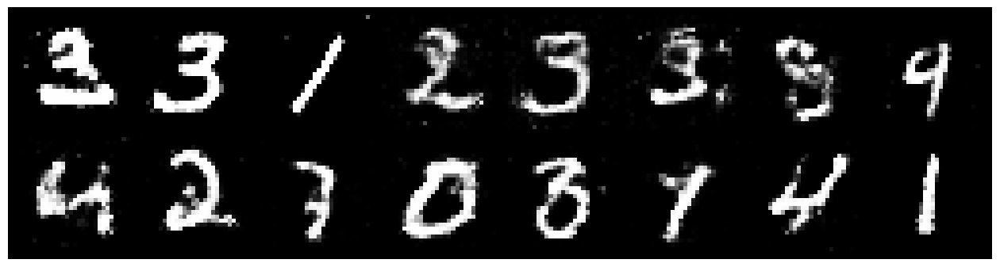

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2424, Generator Loss: 0.8709
D(x): 0.5998, D(G(z)): 0.4506


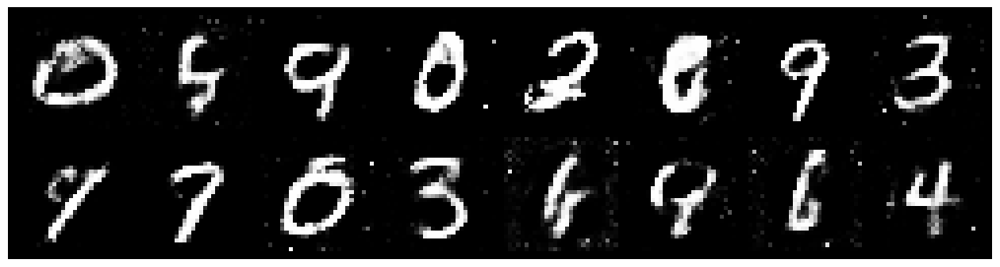

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2977, Generator Loss: 0.9011
D(x): 0.5512, D(G(z)): 0.4546


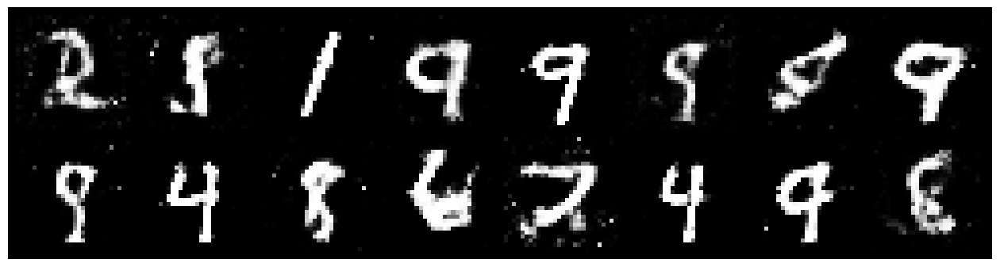

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.1403, Generator Loss: 0.9558
D(x): 0.5770, D(G(z)): 0.4023


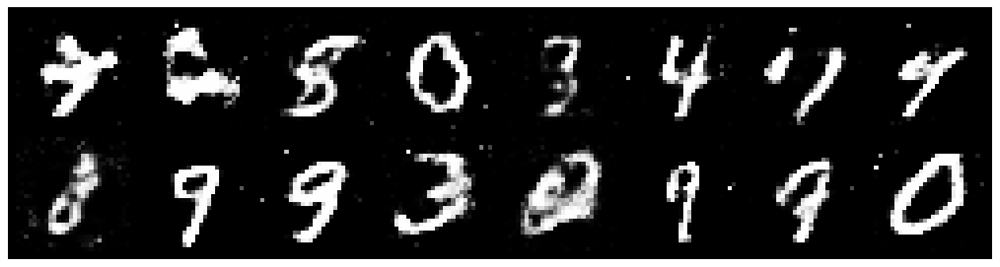

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2099, Generator Loss: 1.0643
D(x): 0.5394, D(G(z)): 0.3921


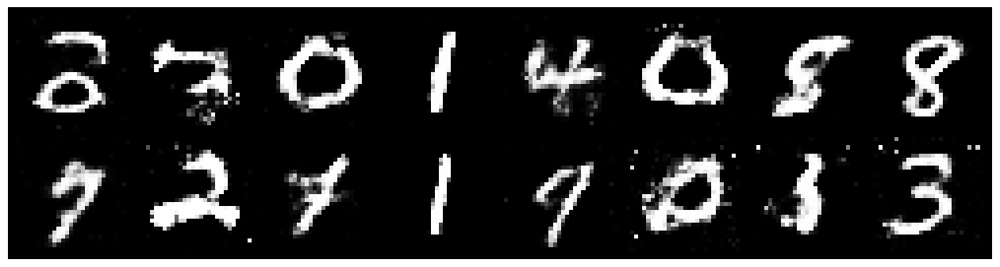

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.3289, Generator Loss: 0.8958
D(x): 0.5784, D(G(z)): 0.4612


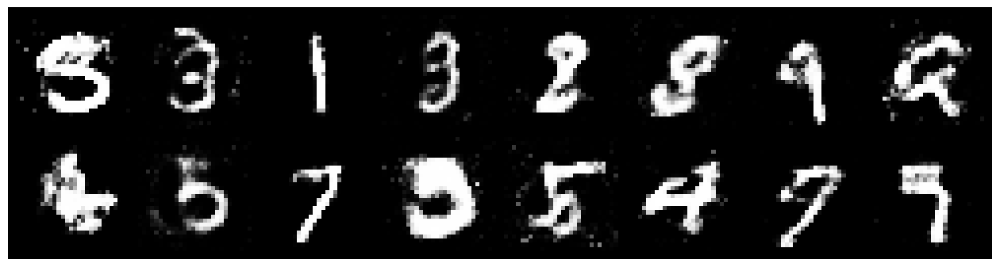

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.4059, Generator Loss: 0.9569
D(x): 0.5640, D(G(z)): 0.4585


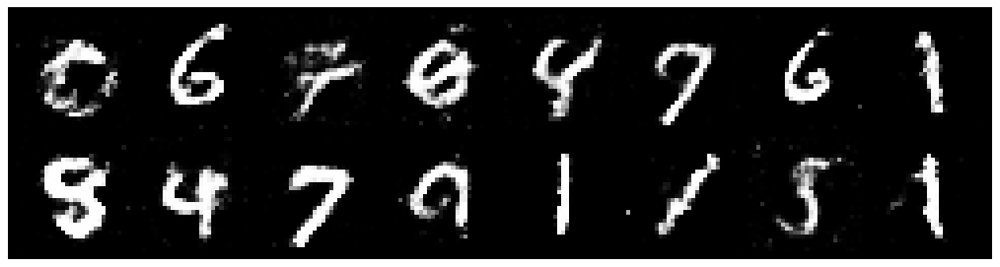

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.1880, Generator Loss: 0.8006
D(x): 0.6251, D(G(z)): 0.4483


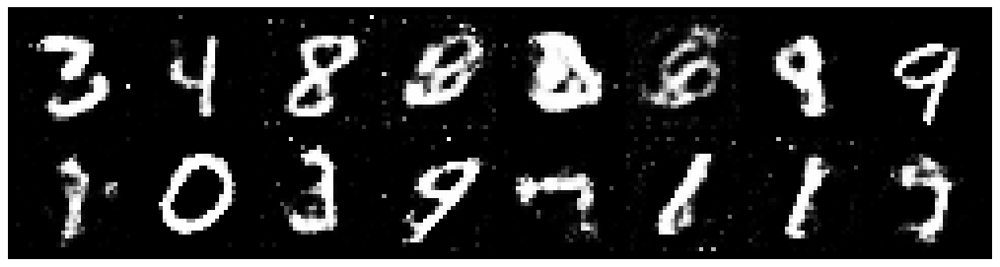

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2806, Generator Loss: 0.8630
D(x): 0.5579, D(G(z)): 0.4574


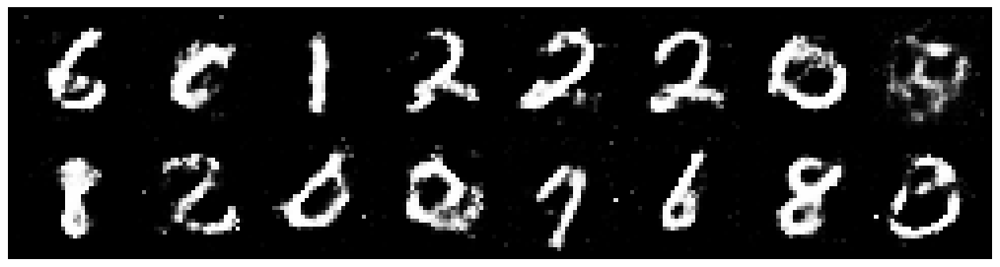

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.2907, Generator Loss: 0.9007
D(x): 0.5323, D(G(z)): 0.4285


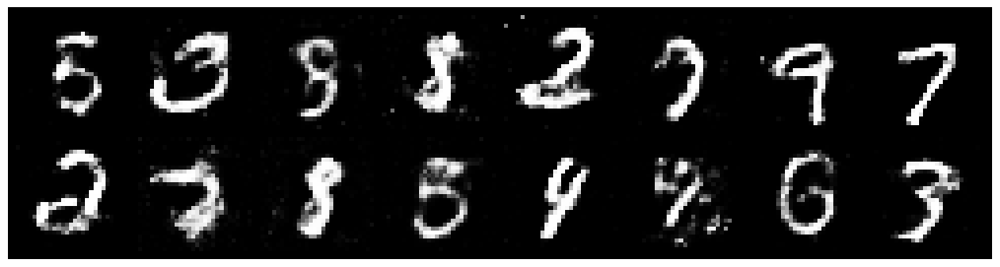

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.3172, Generator Loss: 0.8438
D(x): 0.5492, D(G(z)): 0.4688


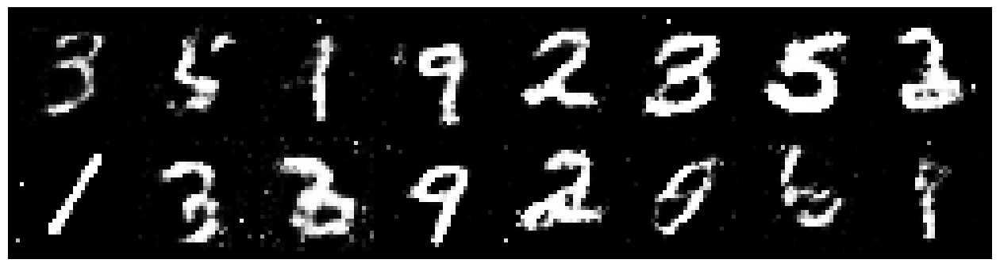

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2990, Generator Loss: 0.8361
D(x): 0.5582, D(G(z)): 0.4584


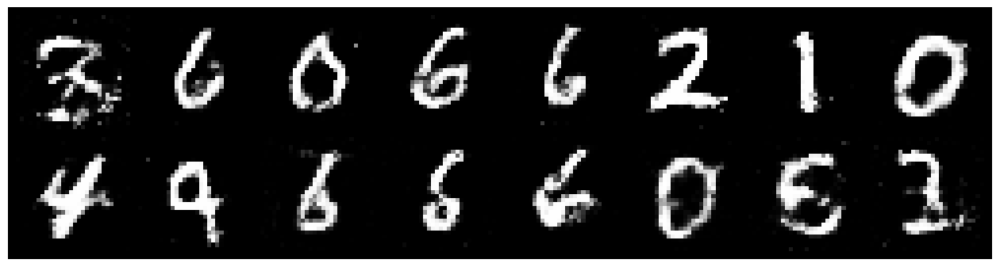

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.2637, Generator Loss: 1.0298
D(x): 0.5308, D(G(z)): 0.4290


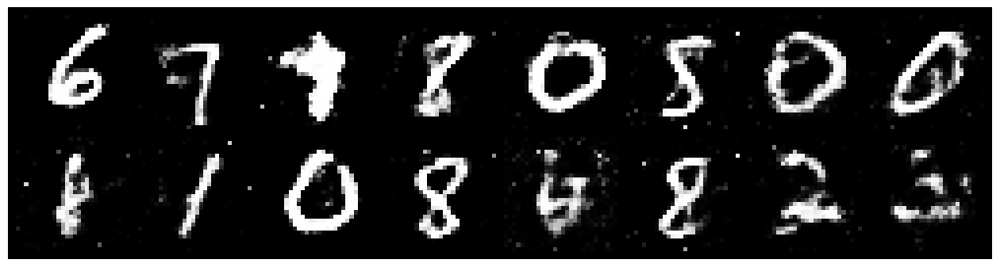

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2844, Generator Loss: 0.8727
D(x): 0.5474, D(G(z)): 0.4427


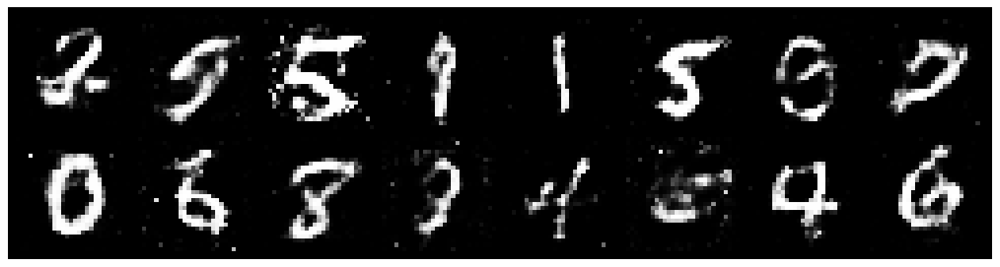

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.2547, Generator Loss: 0.9525
D(x): 0.5716, D(G(z)): 0.4207


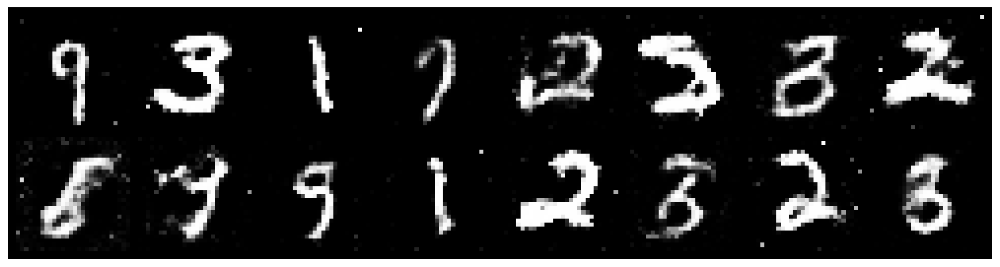

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.3411, Generator Loss: 0.9272
D(x): 0.5089, D(G(z)): 0.4313


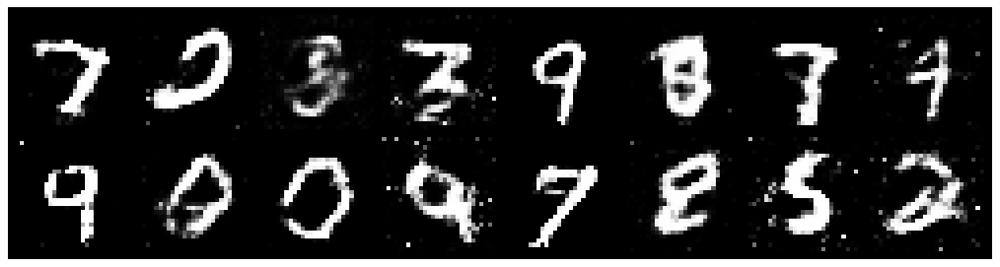

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.2815, Generator Loss: 0.8944
D(x): 0.5665, D(G(z)): 0.4592


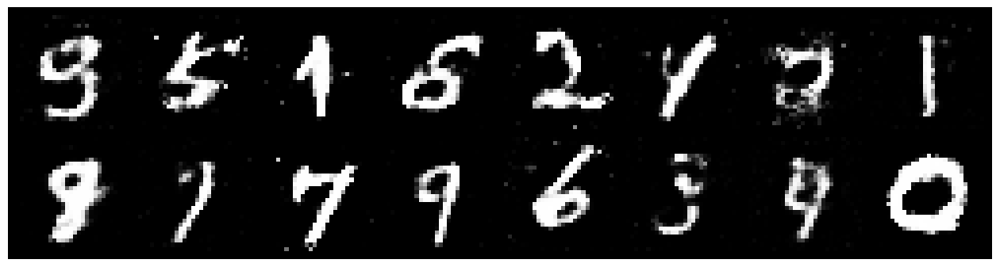

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.1996, Generator Loss: 0.8736
D(x): 0.6429, D(G(z)): 0.4736


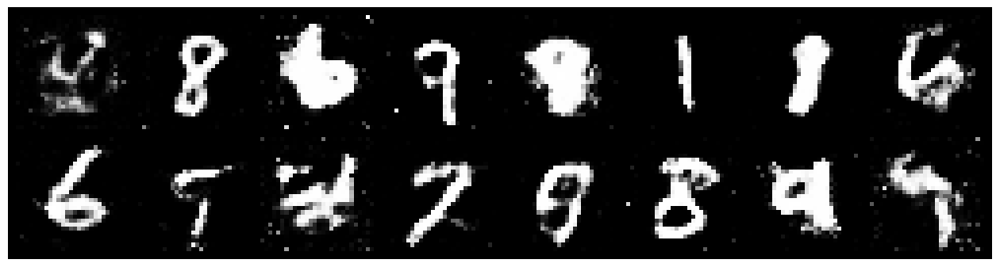

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.4276, Generator Loss: 0.7518
D(x): 0.5797, D(G(z)): 0.5251


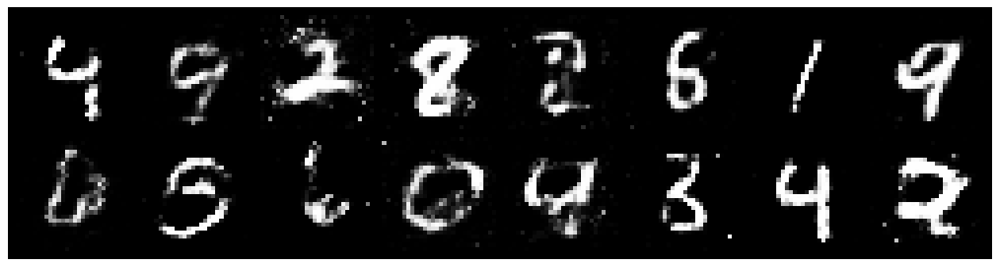

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.4539, Generator Loss: 0.7310
D(x): 0.5338, D(G(z)): 0.5142


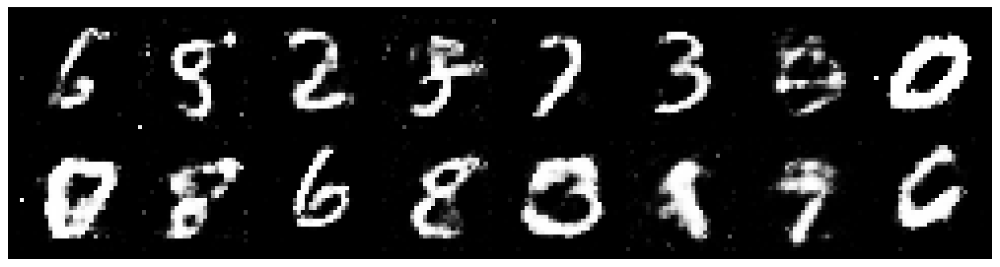

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.3430, Generator Loss: 0.9532
D(x): 0.5667, D(G(z)): 0.4625


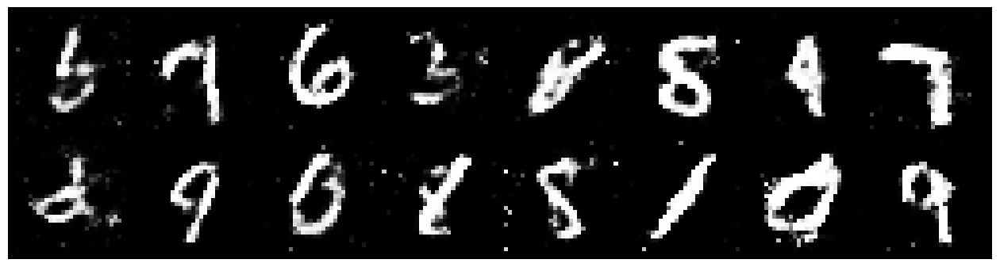

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2630, Generator Loss: 0.8200
D(x): 0.5863, D(G(z)): 0.4776


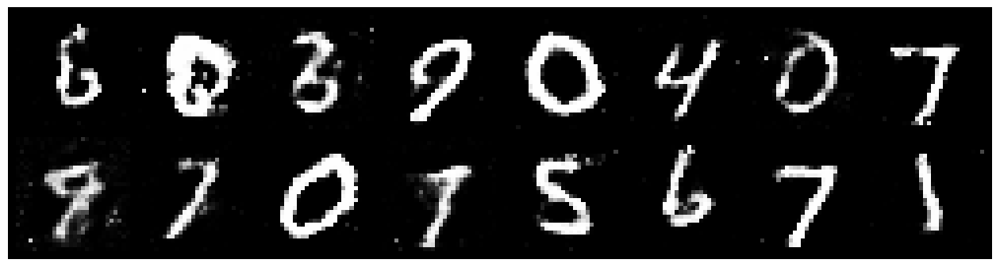

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2381, Generator Loss: 0.8725
D(x): 0.5754, D(G(z)): 0.4512


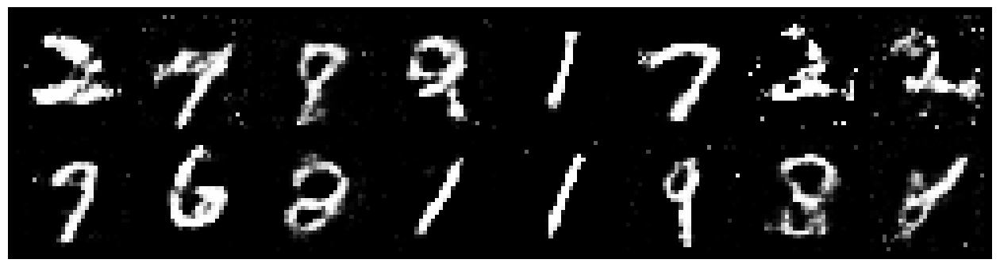

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2373, Generator Loss: 0.8670
D(x): 0.5658, D(G(z)): 0.4394


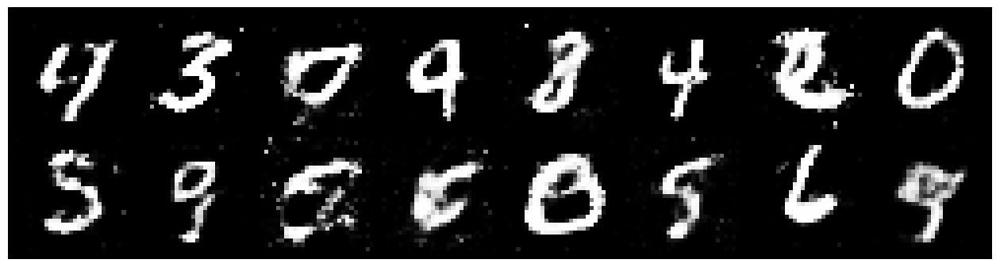

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2343, Generator Loss: 0.8811
D(x): 0.5581, D(G(z)): 0.4288


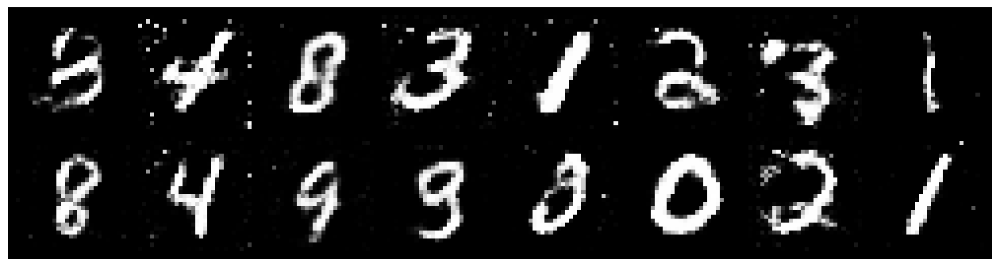

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.3826, Generator Loss: 0.7486
D(x): 0.5449, D(G(z)): 0.4856


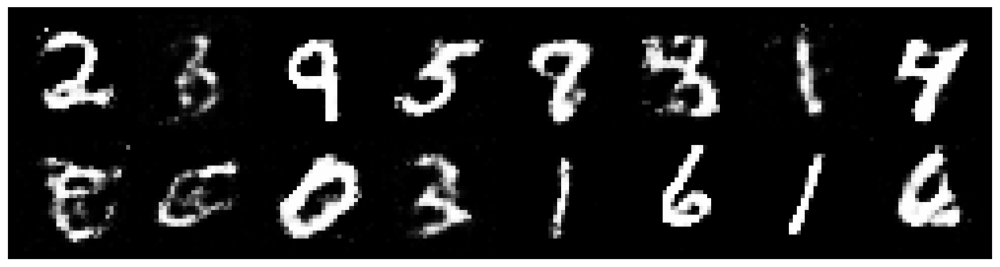

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.3443, Generator Loss: 0.8702
D(x): 0.5651, D(G(z)): 0.4597


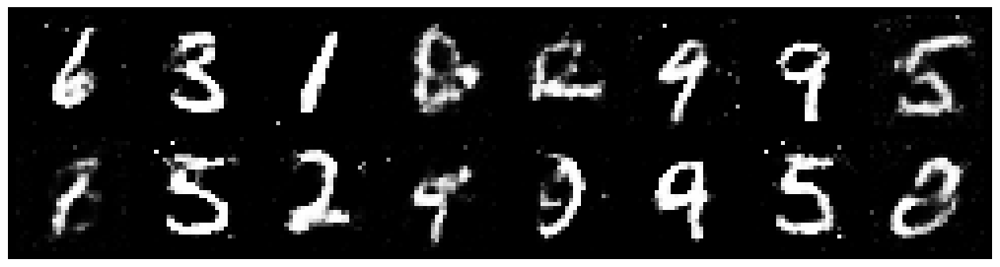

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2501, Generator Loss: 1.0093
D(x): 0.5552, D(G(z)): 0.4134


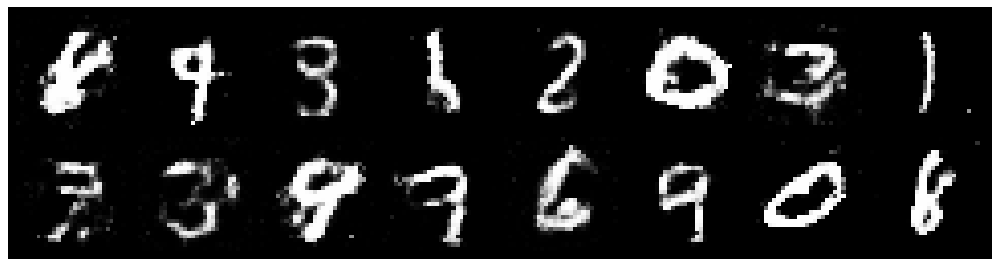

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.3783, Generator Loss: 0.9655
D(x): 0.5699, D(G(z)): 0.4728


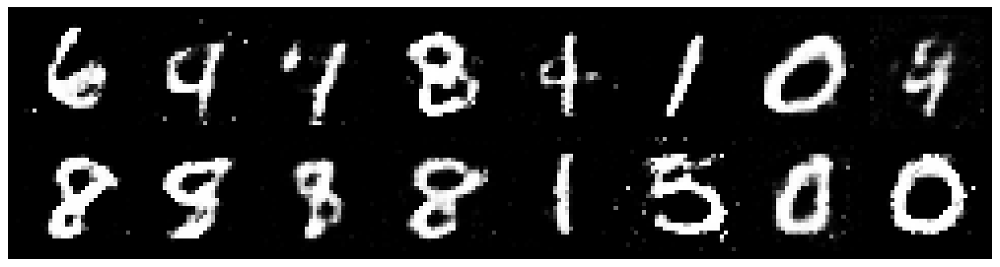

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.2589, Generator Loss: 0.9124
D(x): 0.6204, D(G(z)): 0.4867


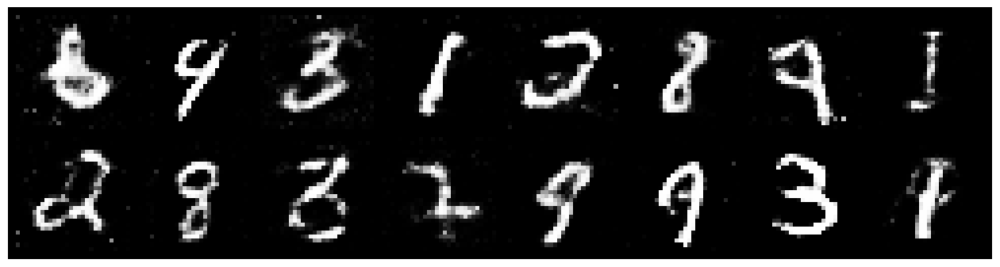

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.1662, Generator Loss: 1.0177
D(x): 0.5575, D(G(z)): 0.3999


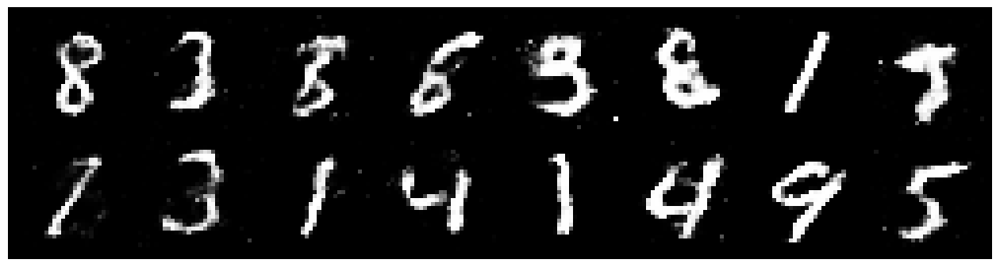

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.2601, Generator Loss: 0.9678
D(x): 0.5456, D(G(z)): 0.4287


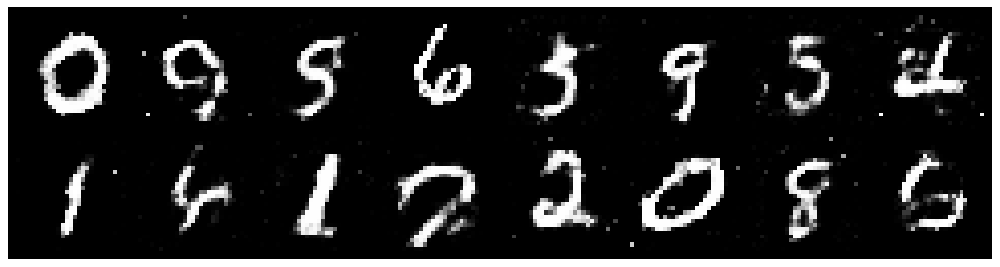

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2895, Generator Loss: 0.9183
D(x): 0.5540, D(G(z)): 0.4529


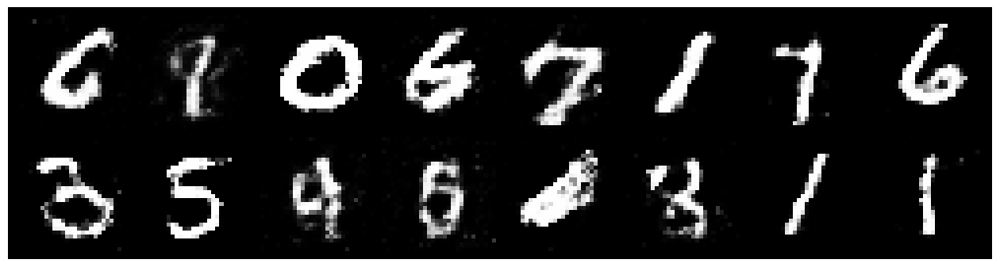

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2545, Generator Loss: 0.9179
D(x): 0.5364, D(G(z)): 0.4334


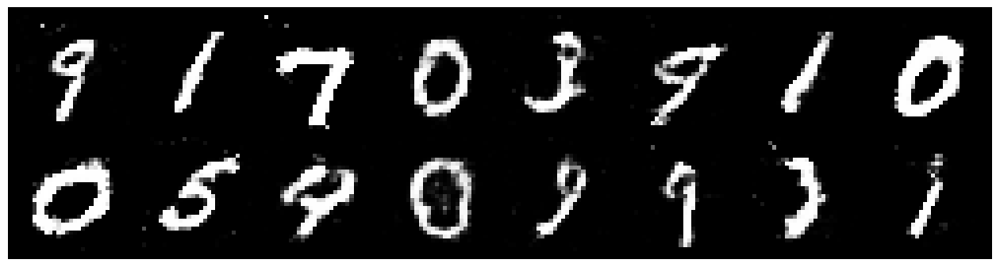

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.3713, Generator Loss: 0.9817
D(x): 0.4919, D(G(z)): 0.4235


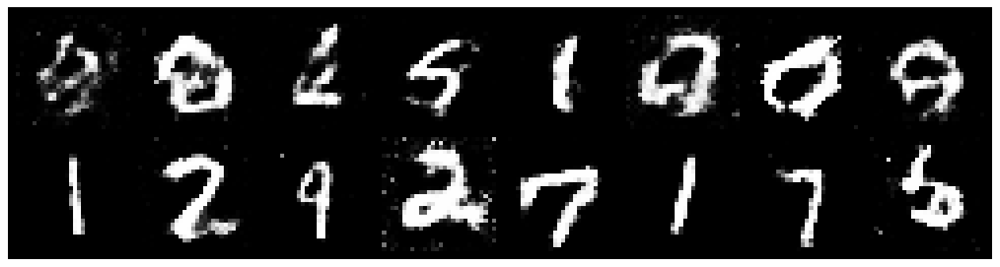

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.1780, Generator Loss: 0.8348
D(x): 0.6096, D(G(z)): 0.4342


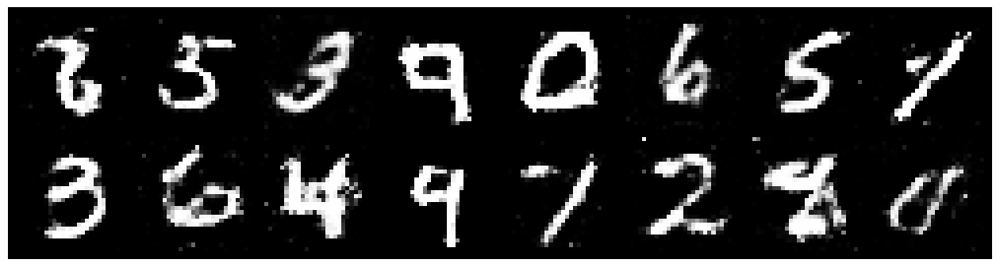

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.2983, Generator Loss: 0.8885
D(x): 0.5822, D(G(z)): 0.4719


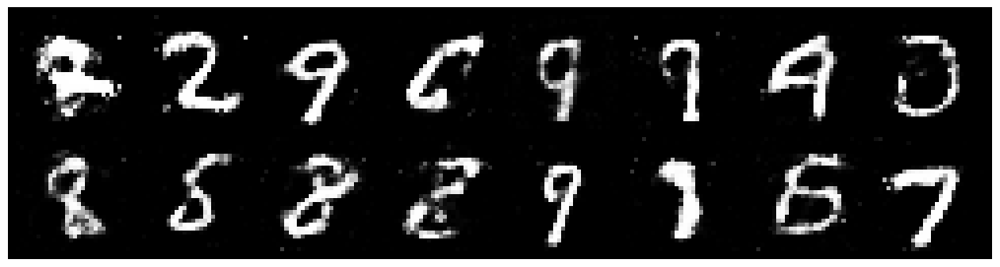

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.3396, Generator Loss: 0.9020
D(x): 0.5752, D(G(z)): 0.4696


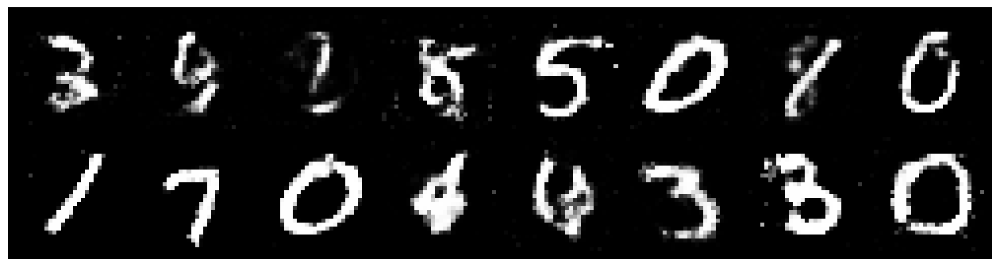

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.1982, Generator Loss: 1.0881
D(x): 0.6116, D(G(z)): 0.4197


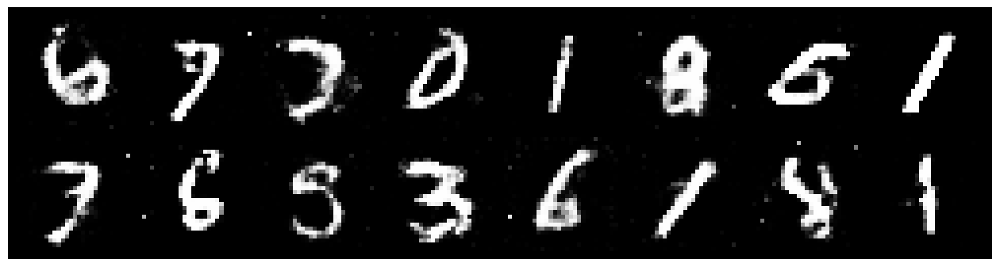

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.2660, Generator Loss: 0.9576
D(x): 0.5606, D(G(z)): 0.4361


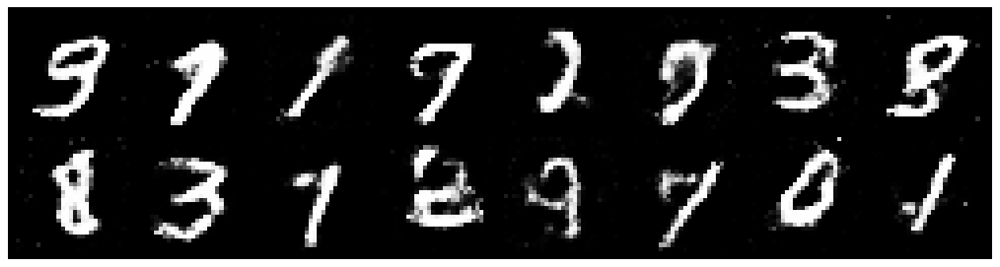

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2759, Generator Loss: 0.9242
D(x): 0.5387, D(G(z)): 0.4326


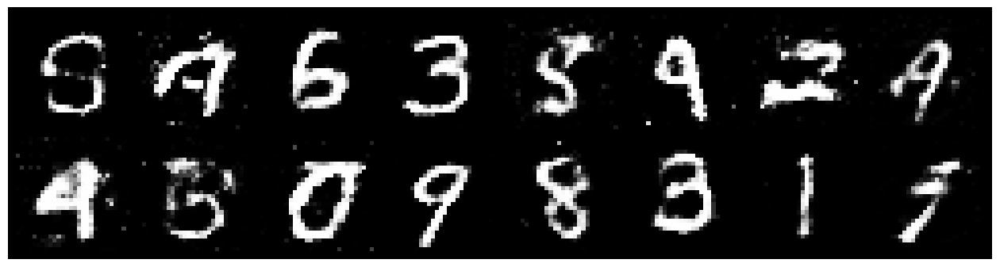

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.3202, Generator Loss: 0.8804
D(x): 0.5550, D(G(z)): 0.4602


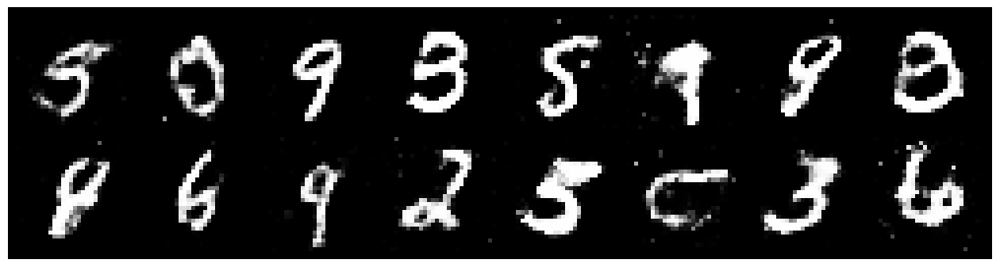

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.1538, Generator Loss: 1.0097
D(x): 0.5917, D(G(z)): 0.4154


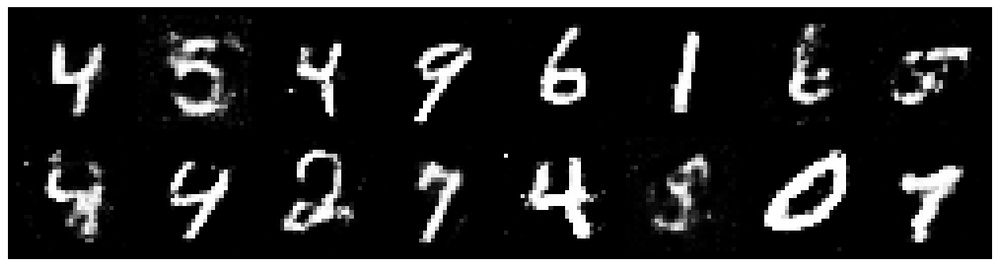

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2282, Generator Loss: 0.8646
D(x): 0.5984, D(G(z)): 0.4580


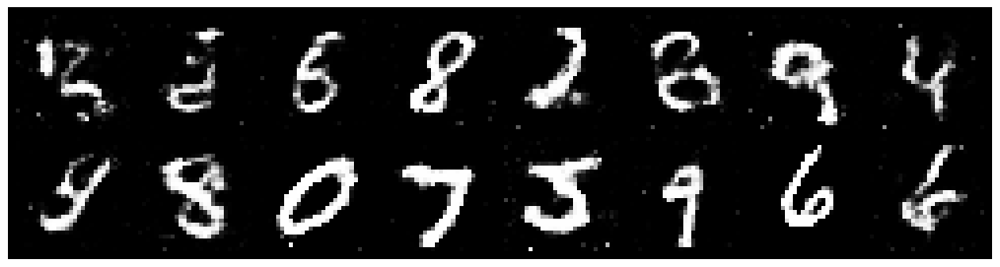

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.4106, Generator Loss: 0.8557
D(x): 0.5078, D(G(z)): 0.4519


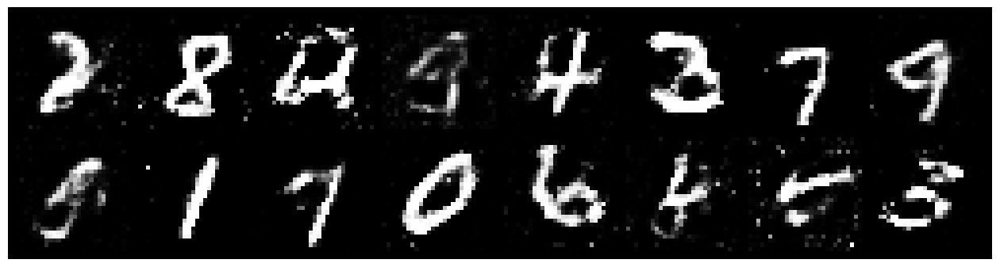

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.2212, Generator Loss: 0.9023
D(x): 0.5830, D(G(z)): 0.4205


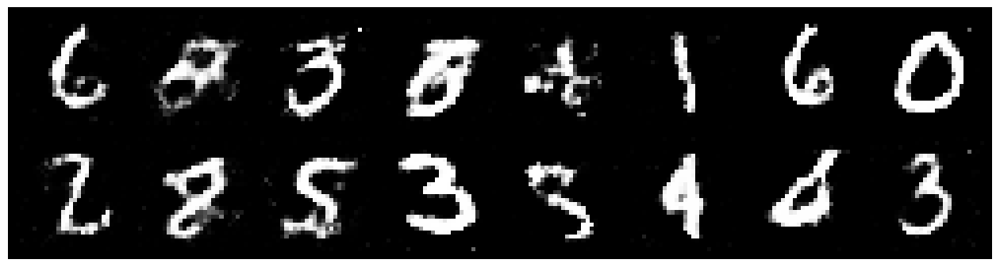

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.3131, Generator Loss: 1.0349
D(x): 0.5662, D(G(z)): 0.4551


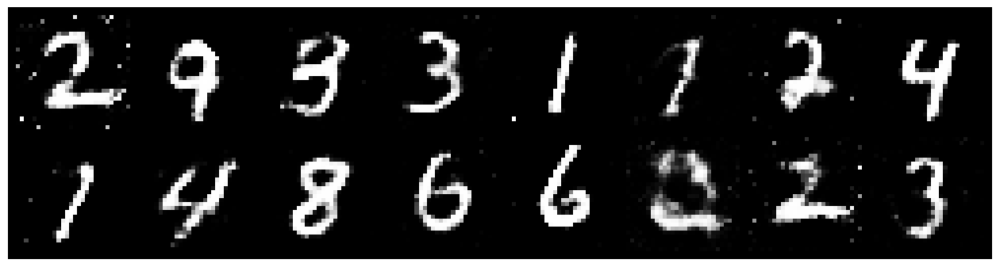

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.3021, Generator Loss: 0.9745
D(x): 0.5446, D(G(z)): 0.4402


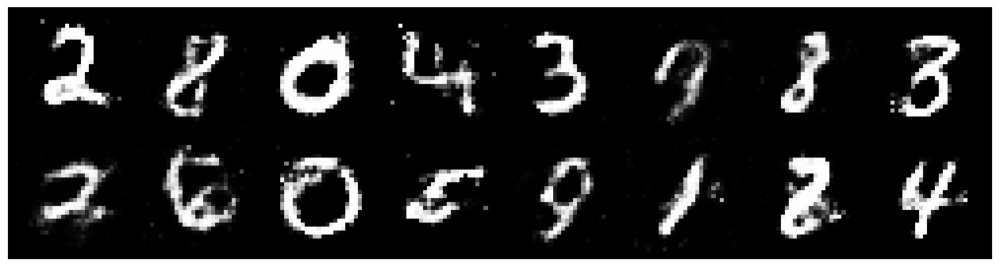

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.1075, Generator Loss: 1.1064
D(x): 0.6058, D(G(z)): 0.4049


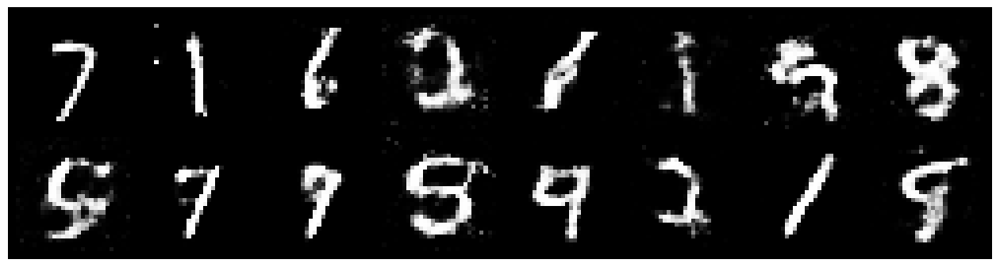

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.1470, Generator Loss: 0.9662
D(x): 0.6147, D(G(z)): 0.4303


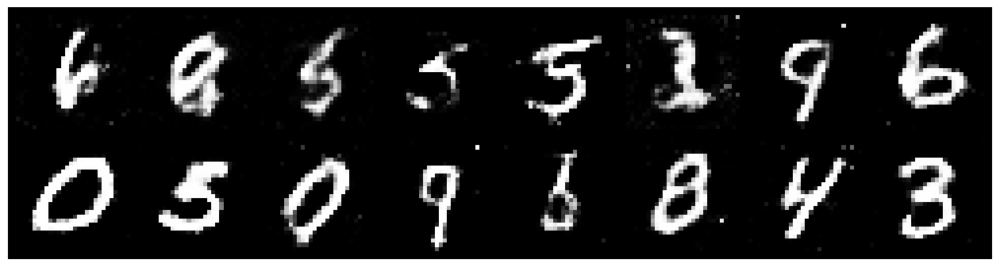

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.2655, Generator Loss: 0.8919
D(x): 0.5596, D(G(z)): 0.4471


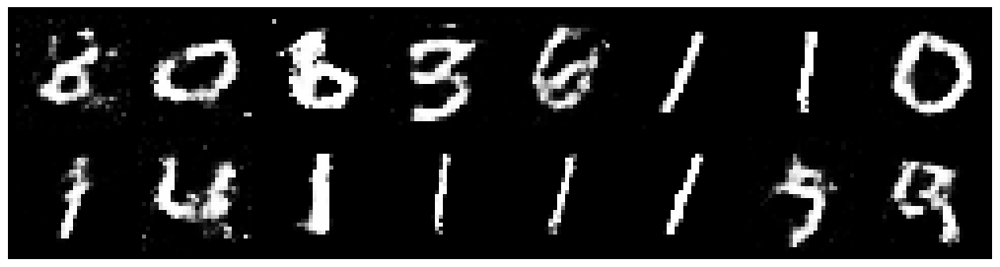

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2772, Generator Loss: 0.8808
D(x): 0.5734, D(G(z)): 0.4653


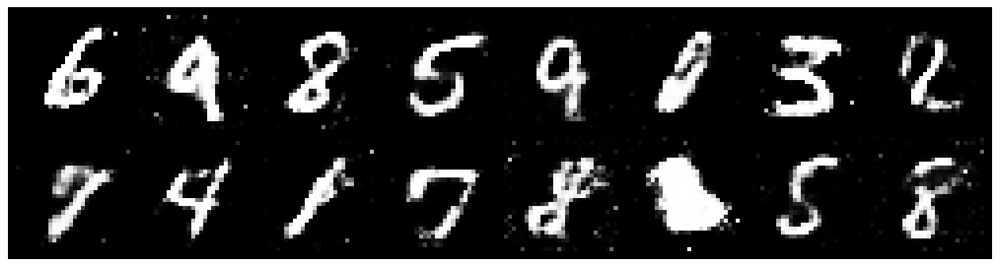

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3454, Generator Loss: 0.8376
D(x): 0.5314, D(G(z)): 0.4578


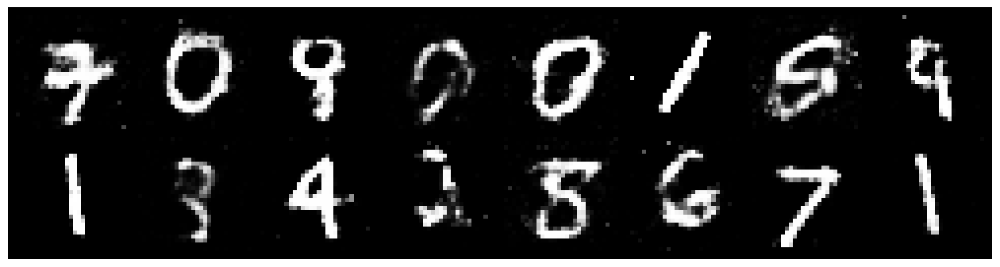

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2499, Generator Loss: 0.8771
D(x): 0.5948, D(G(z)): 0.4536


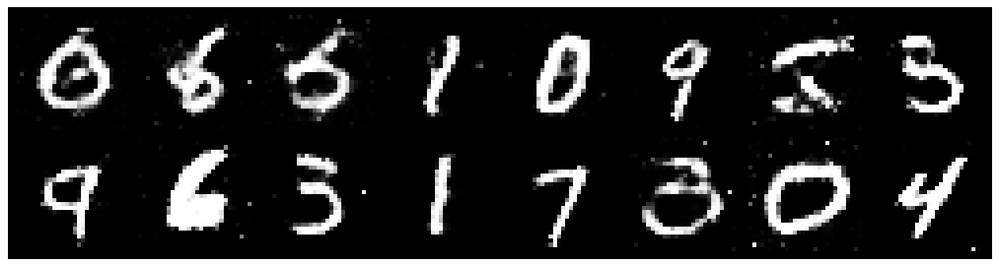

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.1806, Generator Loss: 0.8502
D(x): 0.5538, D(G(z)): 0.3870


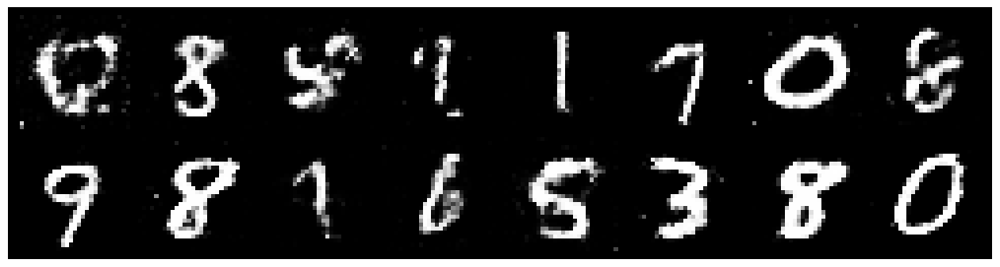

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.1702, Generator Loss: 1.0189
D(x): 0.5656, D(G(z)): 0.3890


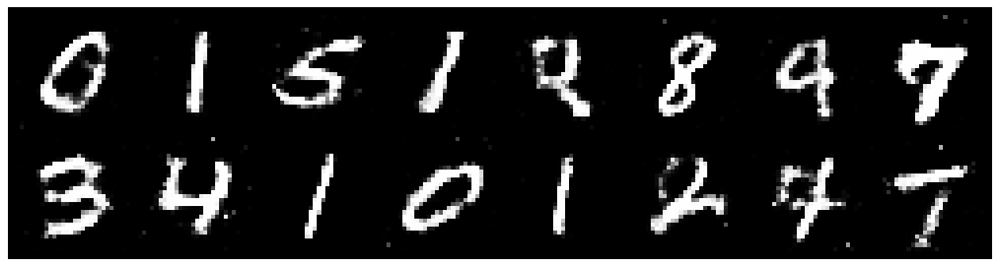

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2558, Generator Loss: 0.9053
D(x): 0.5840, D(G(z)): 0.4610


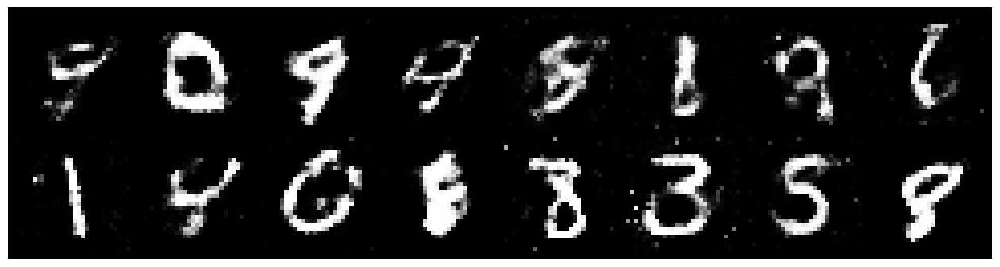

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2958, Generator Loss: 0.8879
D(x): 0.5159, D(G(z)): 0.4365


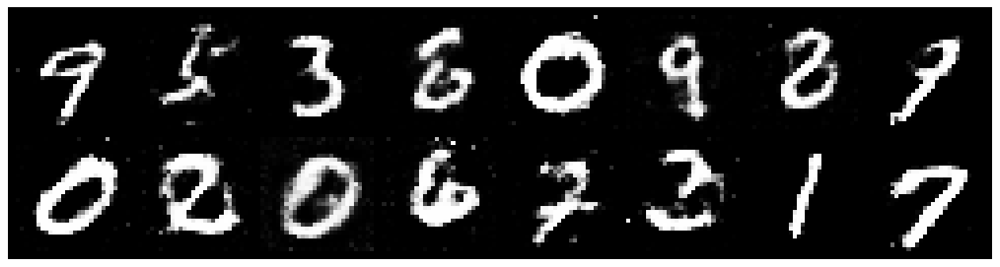

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.3284, Generator Loss: 0.8123
D(x): 0.5242, D(G(z)): 0.4475


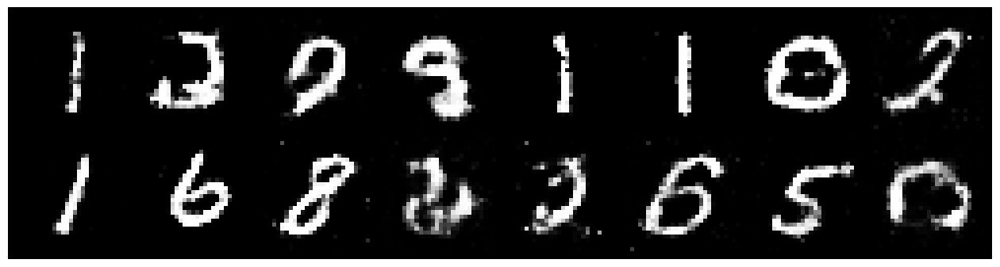

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2815, Generator Loss: 1.0382
D(x): 0.5641, D(G(z)): 0.4472


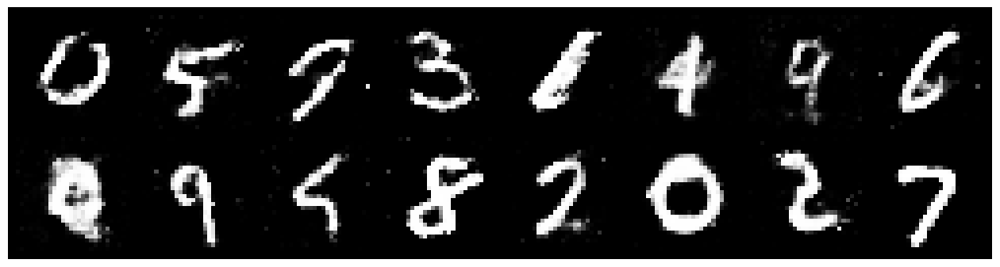

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2838, Generator Loss: 1.0834
D(x): 0.5881, D(G(z)): 0.4575


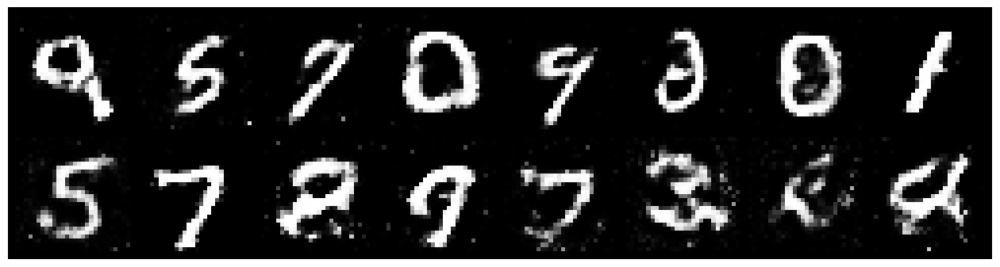

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.1542, Generator Loss: 0.8491
D(x): 0.6308, D(G(z)): 0.4493


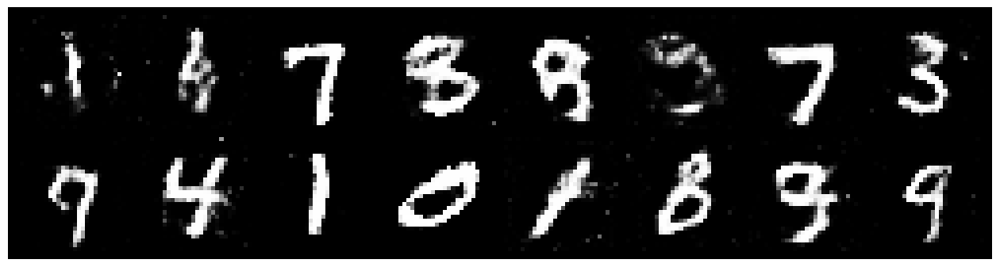

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3134, Generator Loss: 1.0559
D(x): 0.5553, D(G(z)): 0.4402


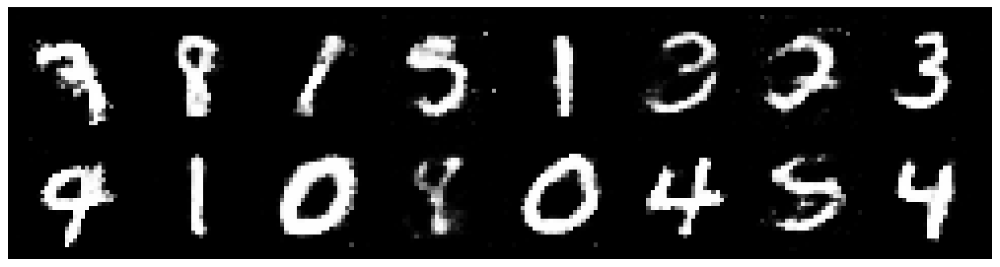

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.3849, Generator Loss: 0.9111
D(x): 0.5480, D(G(z)): 0.4544


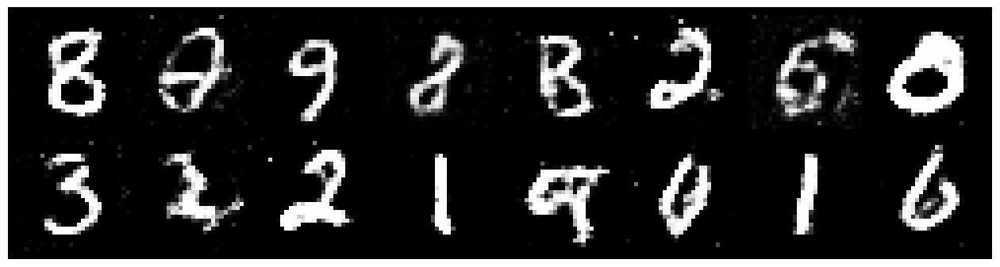

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.1990, Generator Loss: 1.0452
D(x): 0.5418, D(G(z)): 0.3624


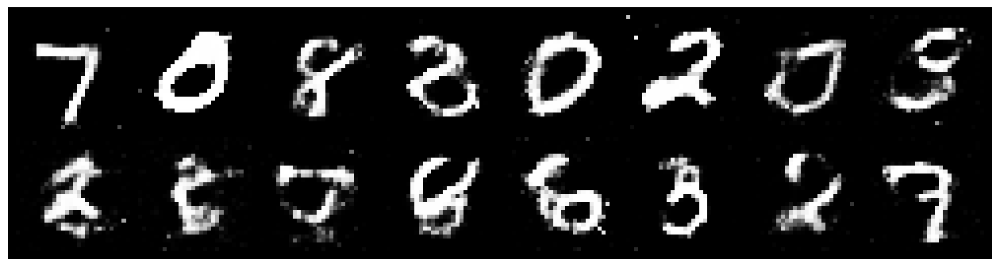

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.4110, Generator Loss: 1.0281
D(x): 0.5249, D(G(z)): 0.4675


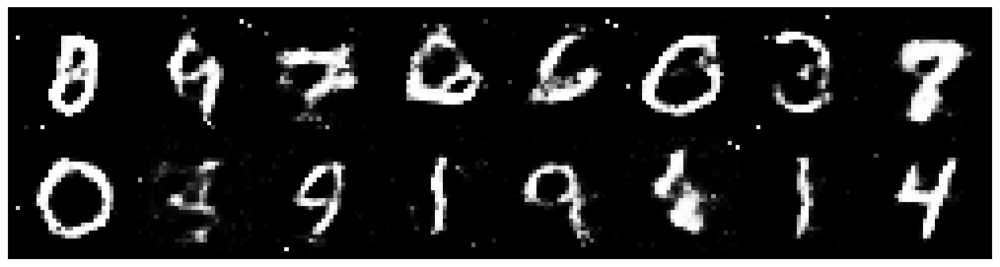

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.2772, Generator Loss: 0.9330
D(x): 0.6025, D(G(z)): 0.4774


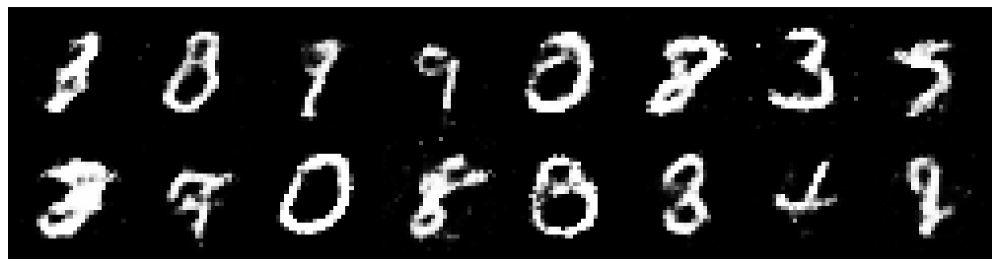

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.1958, Generator Loss: 0.9785
D(x): 0.6155, D(G(z)): 0.4370


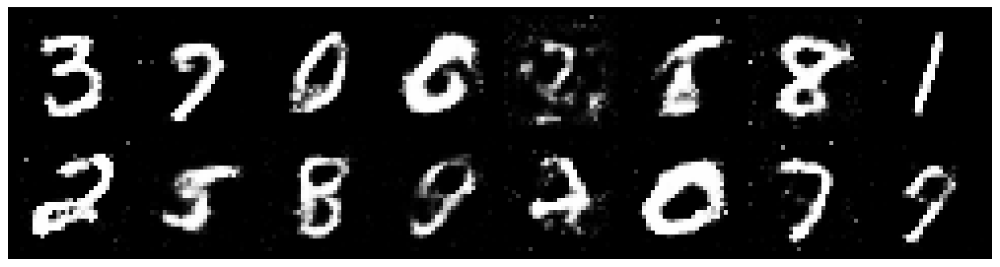

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.1488, Generator Loss: 0.8620
D(x): 0.5806, D(G(z)): 0.4057


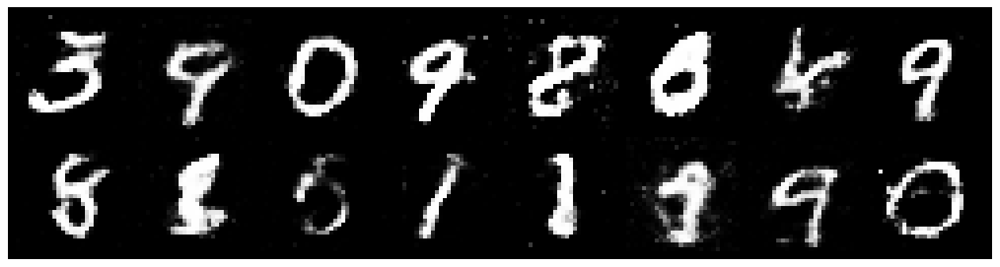

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.2375, Generator Loss: 1.0029
D(x): 0.5524, D(G(z)): 0.4269


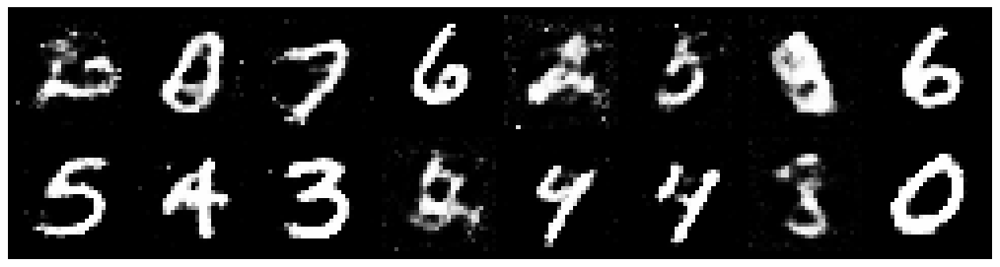

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.2730, Generator Loss: 0.9033
D(x): 0.5232, D(G(z)): 0.4116


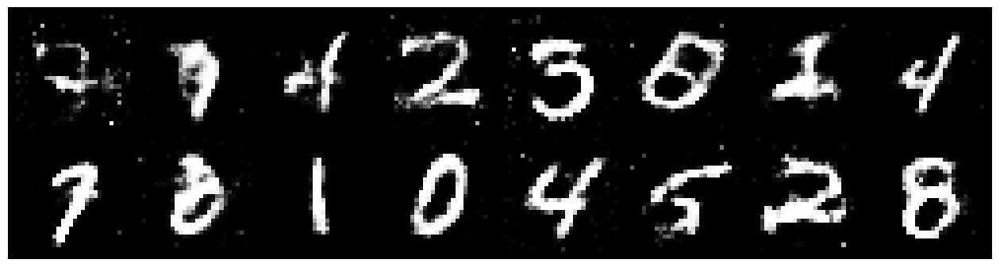

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.2841, Generator Loss: 0.8620
D(x): 0.5666, D(G(z)): 0.4615


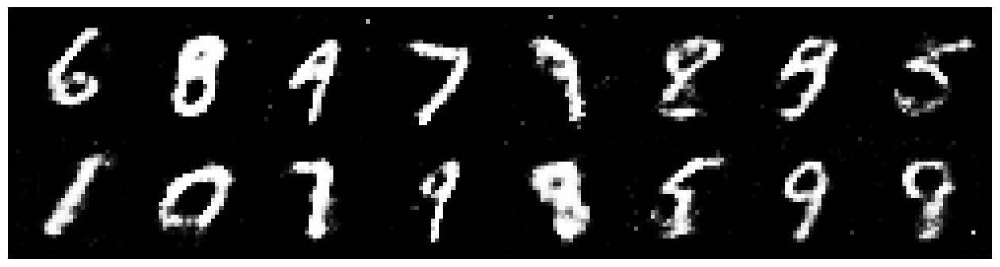

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2404, Generator Loss: 0.9978
D(x): 0.5397, D(G(z)): 0.4203


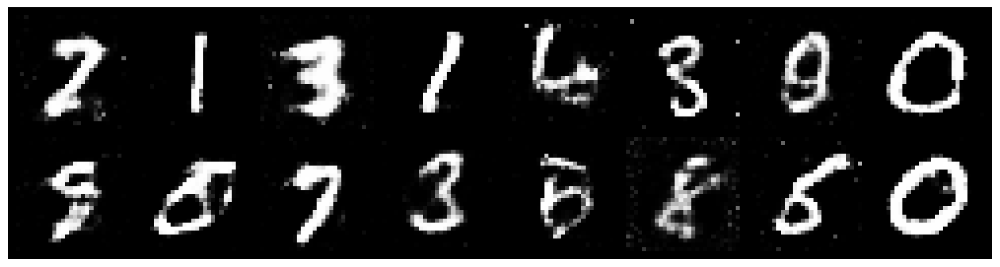

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2494, Generator Loss: 0.8950
D(x): 0.5612, D(G(z)): 0.4599


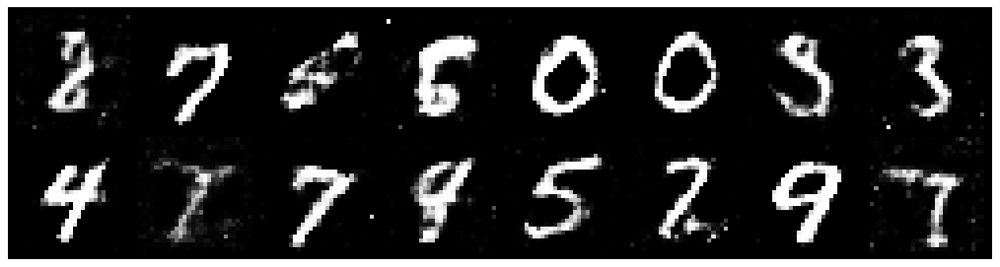

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.1616, Generator Loss: 0.9441
D(x): 0.5888, D(G(z)): 0.4178


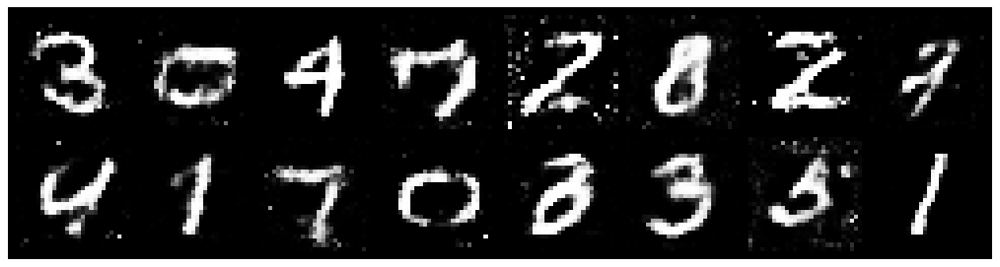

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.1836, Generator Loss: 0.8650
D(x): 0.5758, D(G(z)): 0.4211


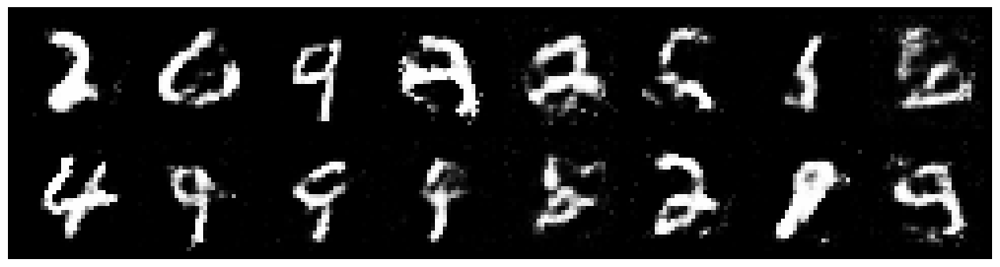

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.1891, Generator Loss: 0.9067
D(x): 0.5705, D(G(z)): 0.4219


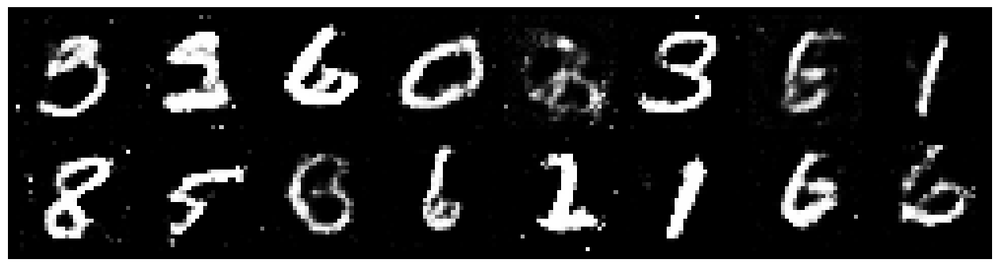

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2131, Generator Loss: 0.8848
D(x): 0.5532, D(G(z)): 0.4315


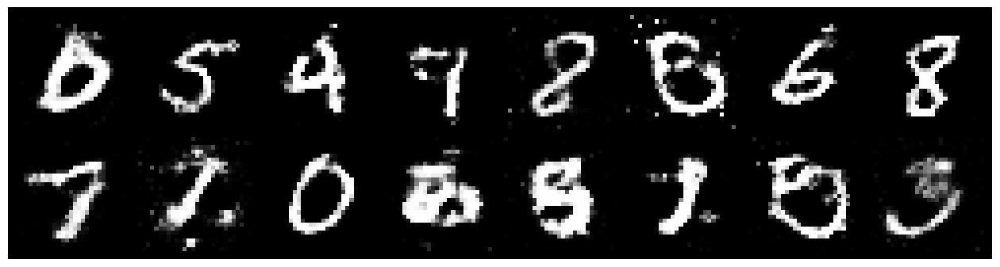

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.1433, Generator Loss: 0.9580
D(x): 0.6134, D(G(z)): 0.4277


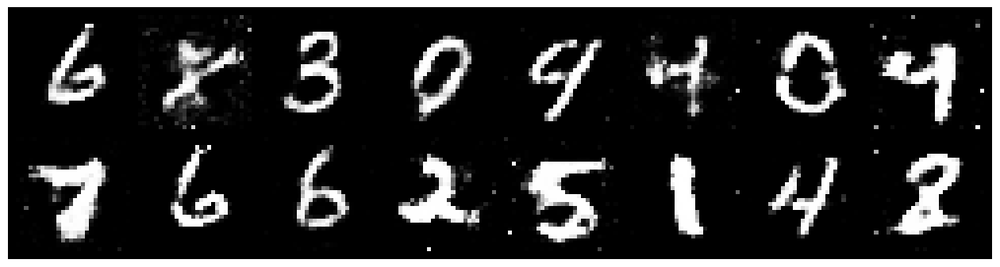

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.3147, Generator Loss: 0.9620
D(x): 0.5387, D(G(z)): 0.4462


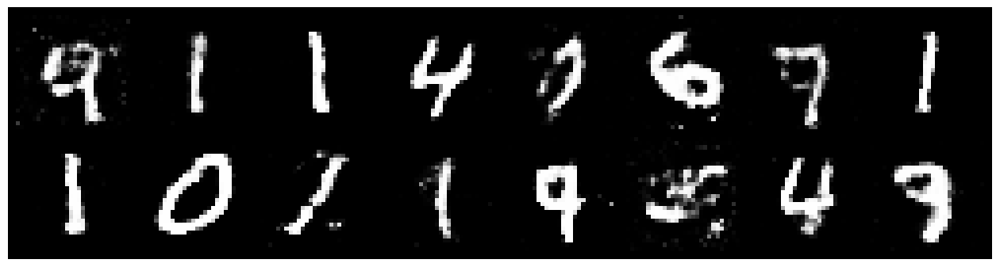

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.1566, Generator Loss: 0.9876
D(x): 0.5630, D(G(z)): 0.3793


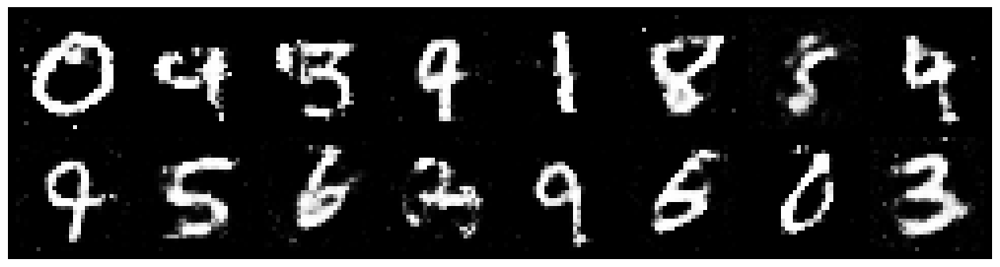

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.3145, Generator Loss: 1.0423
D(x): 0.5307, D(G(z)): 0.4226


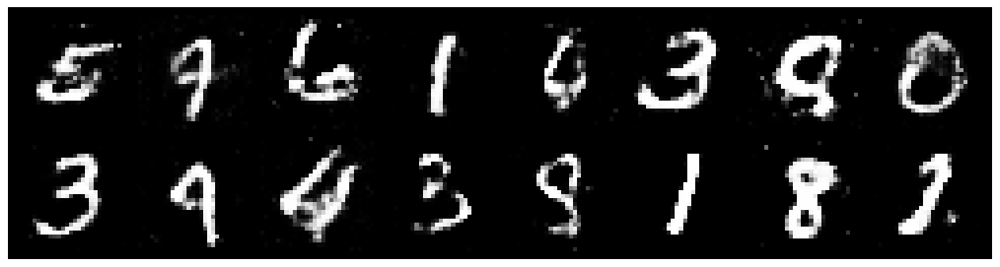

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.1853, Generator Loss: 1.1340
D(x): 0.5917, D(G(z)): 0.4028


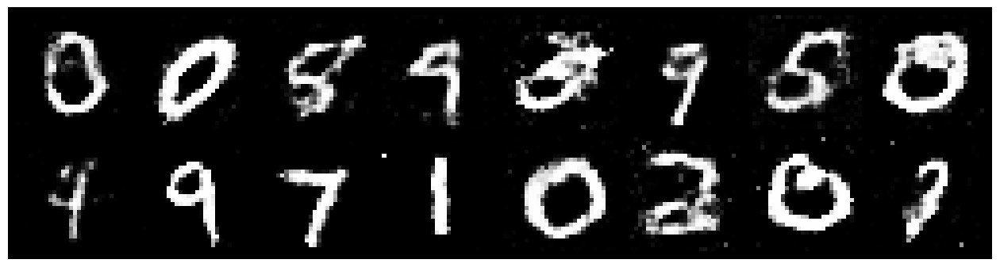

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2751, Generator Loss: 0.8709
D(x): 0.6253, D(G(z)): 0.4680


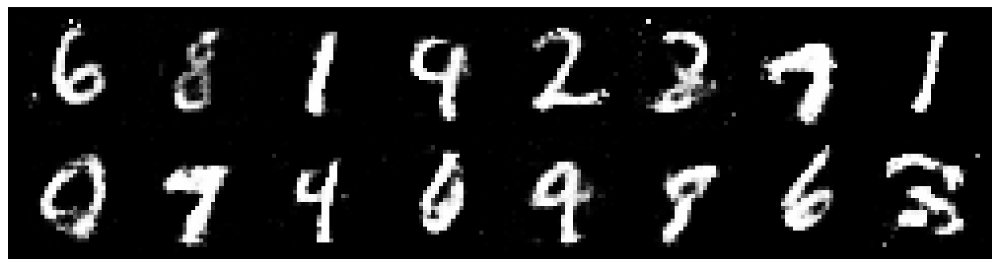

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.3141, Generator Loss: 1.1136
D(x): 0.5324, D(G(z)): 0.4282


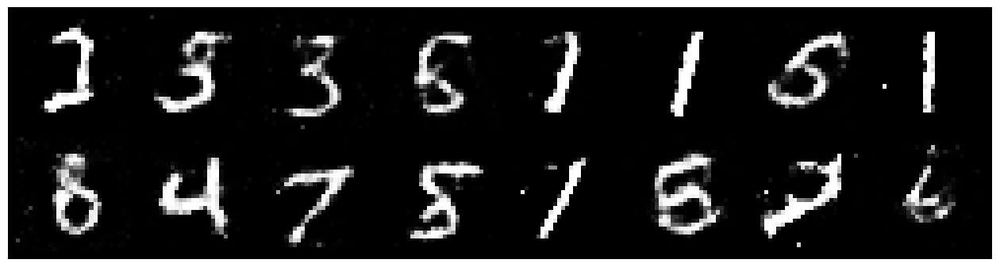

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2008, Generator Loss: 0.9662
D(x): 0.5811, D(G(z)): 0.4351


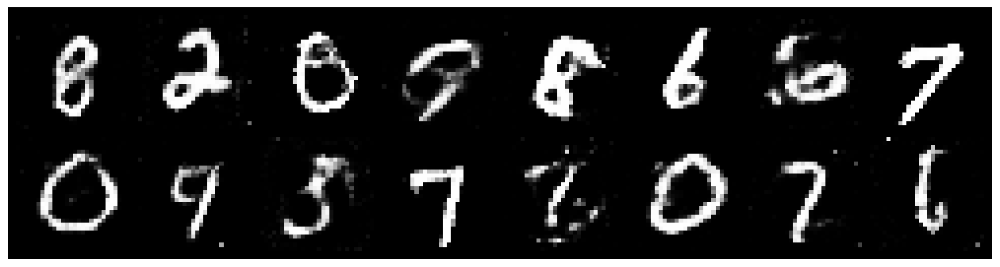

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.3047, Generator Loss: 0.9291
D(x): 0.5474, D(G(z)): 0.4481


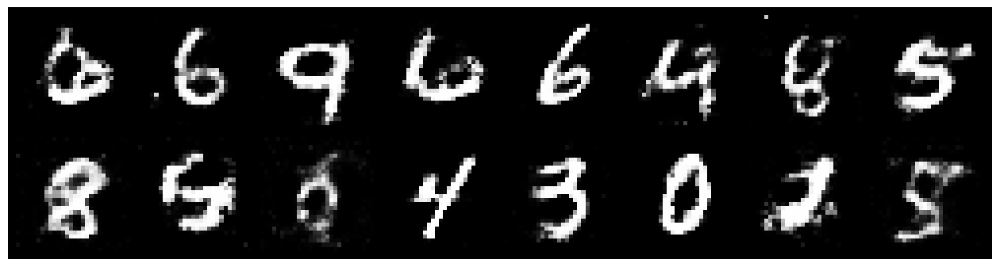

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2163, Generator Loss: 1.0220
D(x): 0.5377, D(G(z)): 0.4065


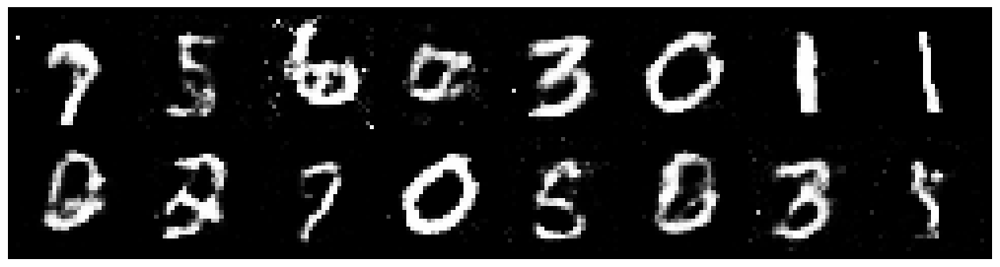

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2530, Generator Loss: 1.1110
D(x): 0.5379, D(G(z)): 0.4041


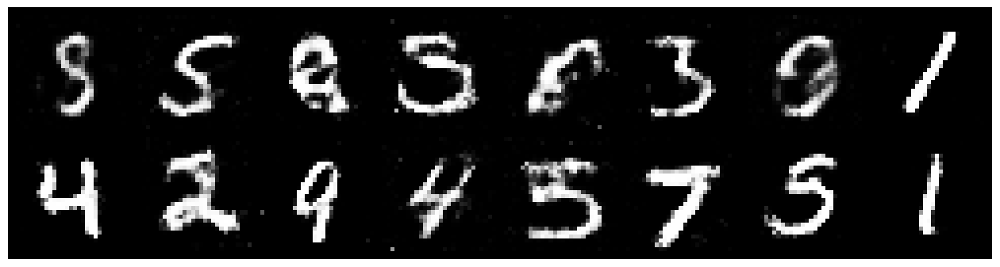

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.1868, Generator Loss: 0.8661
D(x): 0.5819, D(G(z)): 0.4387


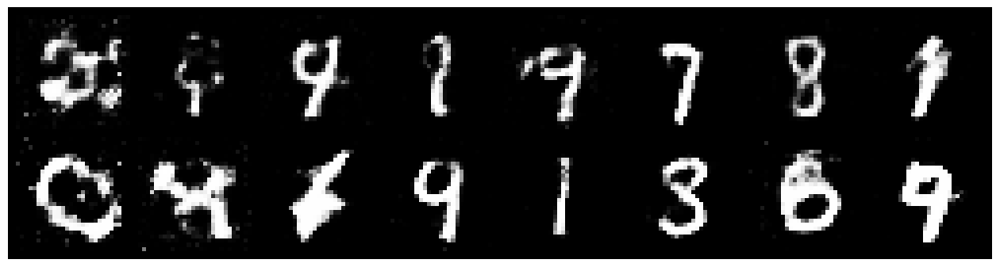

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.3071, Generator Loss: 0.8949
D(x): 0.5326, D(G(z)): 0.4528


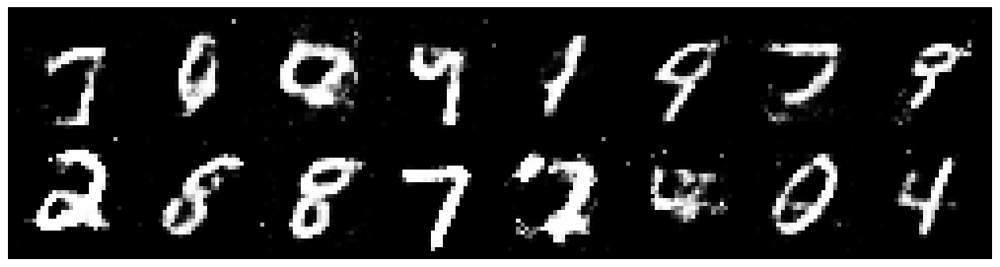

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.3303, Generator Loss: 0.8762
D(x): 0.5339, D(G(z)): 0.4290


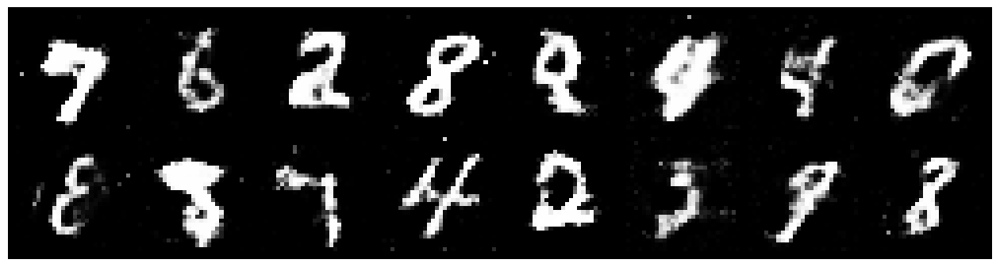

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2040, Generator Loss: 0.9029
D(x): 0.5990, D(G(z)): 0.4465


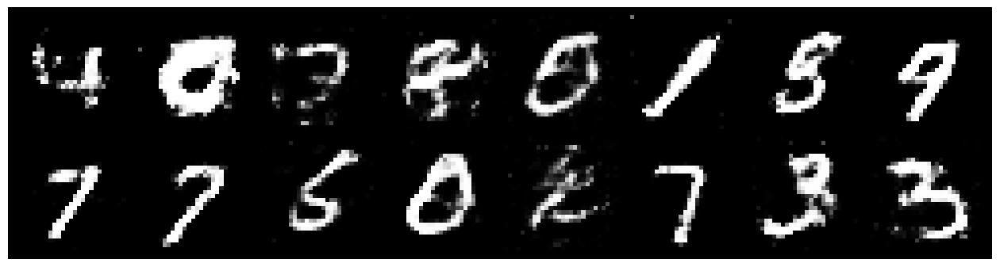

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2205, Generator Loss: 0.7850
D(x): 0.5560, D(G(z)): 0.4456


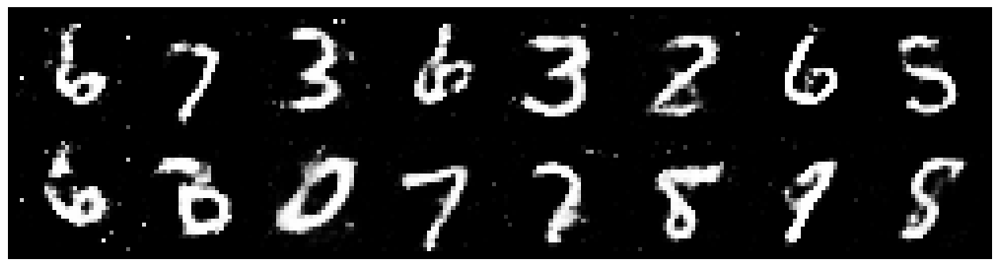

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.3364, Generator Loss: 0.8645
D(x): 0.5696, D(G(z)): 0.4831


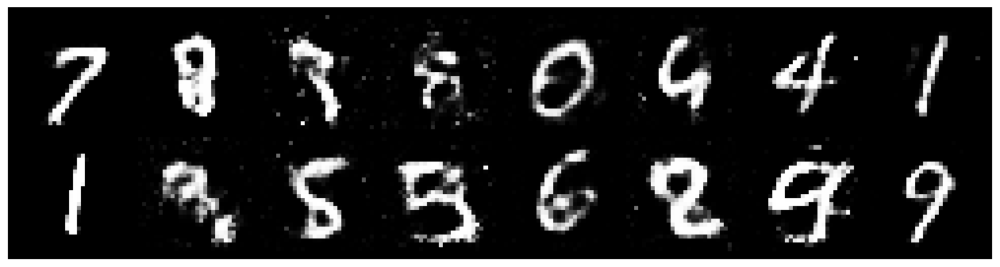

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.1576, Generator Loss: 1.0121
D(x): 0.5792, D(G(z)): 0.3830


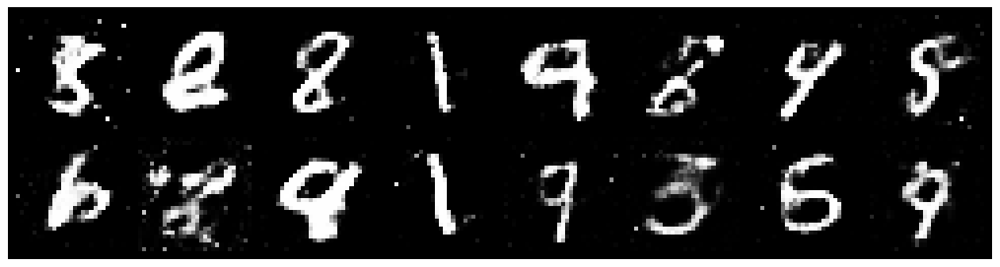

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.0880, Generator Loss: 1.0118
D(x): 0.5829, D(G(z)): 0.3756


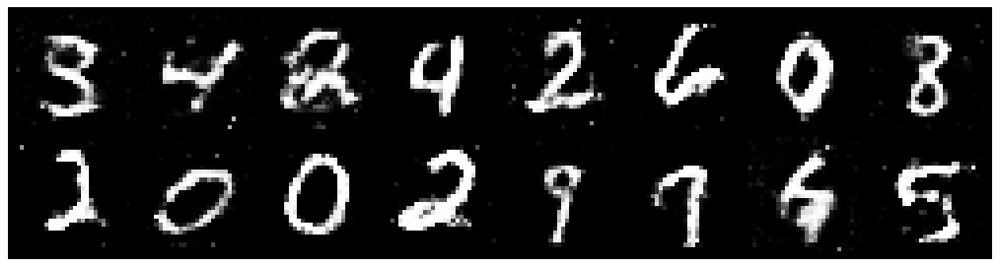

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2921, Generator Loss: 0.8813
D(x): 0.5707, D(G(z)): 0.4475


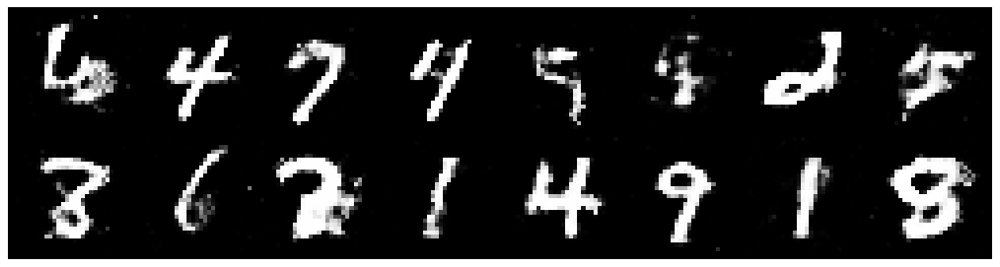

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.2585, Generator Loss: 1.0916
D(x): 0.5611, D(G(z)): 0.4240


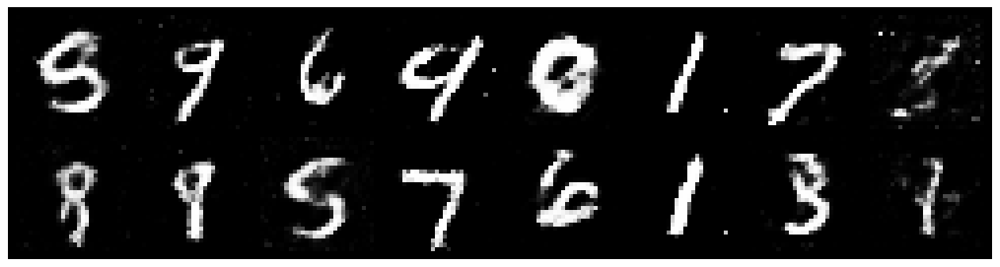

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2525, Generator Loss: 0.8527
D(x): 0.5571, D(G(z)): 0.4429


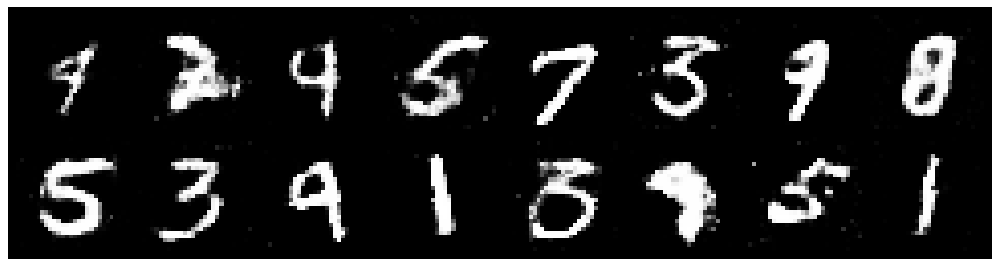

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.3876, Generator Loss: 0.8442
D(x): 0.4824, D(G(z)): 0.4593


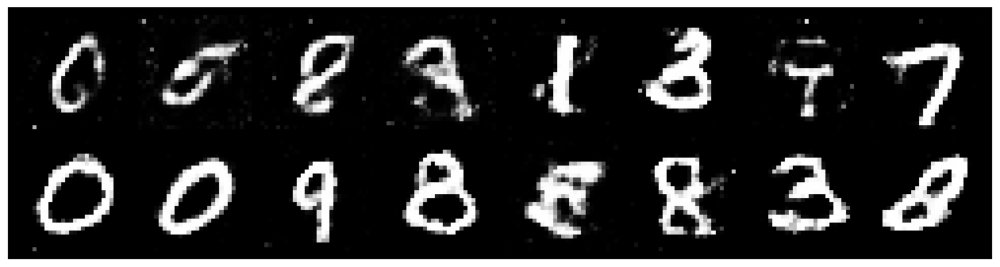

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.3552, Generator Loss: 0.8459
D(x): 0.5642, D(G(z)): 0.4891


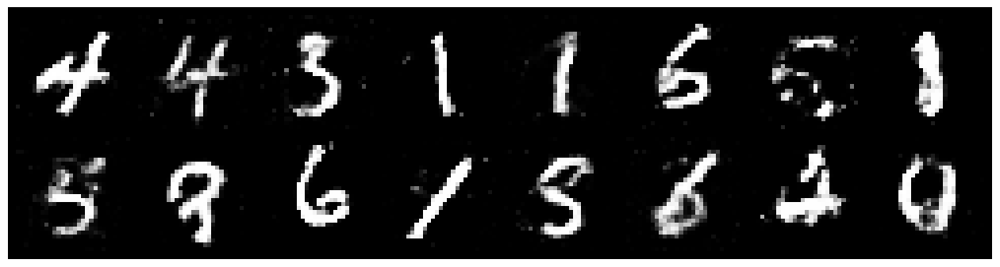

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.3393, Generator Loss: 1.0100
D(x): 0.5126, D(G(z)): 0.4247


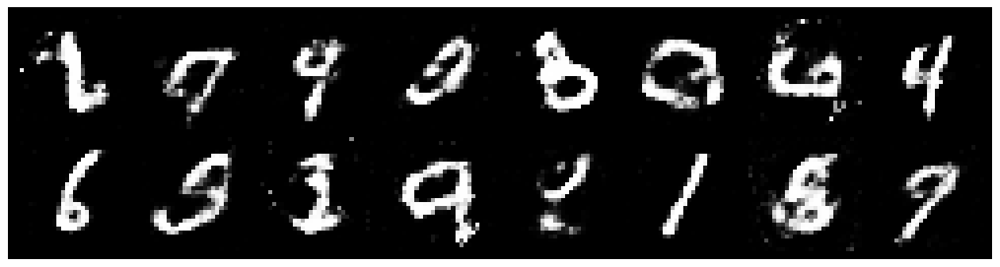

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.2675, Generator Loss: 0.9247
D(x): 0.5713, D(G(z)): 0.4502


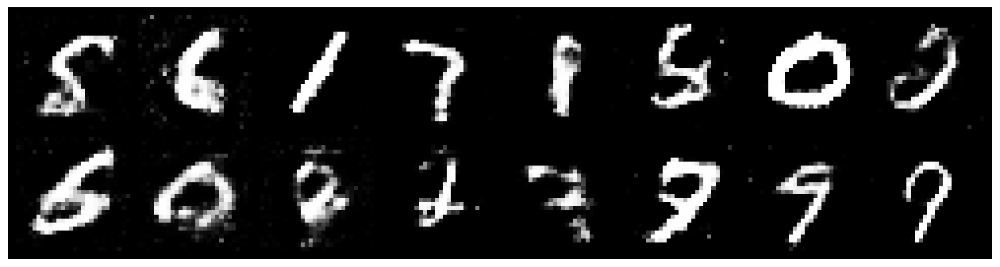

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.3547, Generator Loss: 0.9084
D(x): 0.5312, D(G(z)): 0.4418


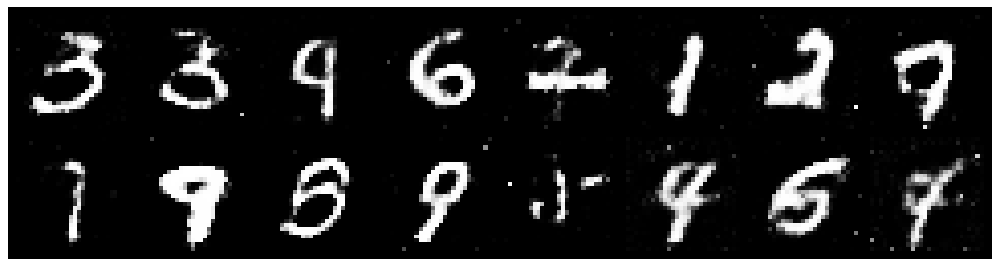

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2249, Generator Loss: 0.9734
D(x): 0.5596, D(G(z)): 0.3987


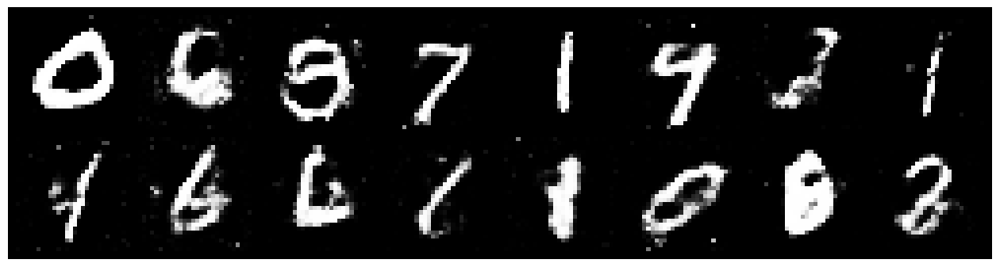

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.3092, Generator Loss: 0.7834
D(x): 0.5654, D(G(z)): 0.4836


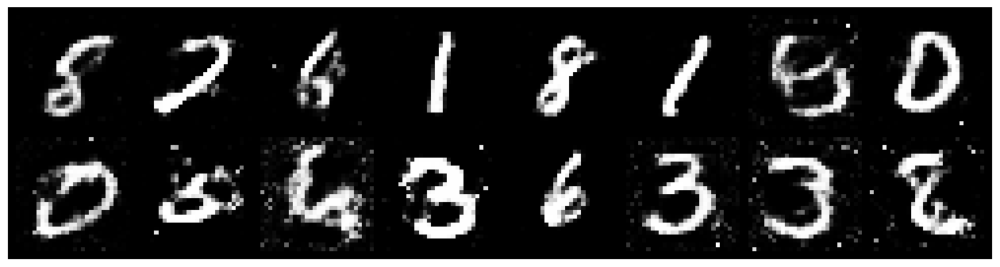

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.4438, Generator Loss: 0.8177
D(x): 0.5128, D(G(z)): 0.4765


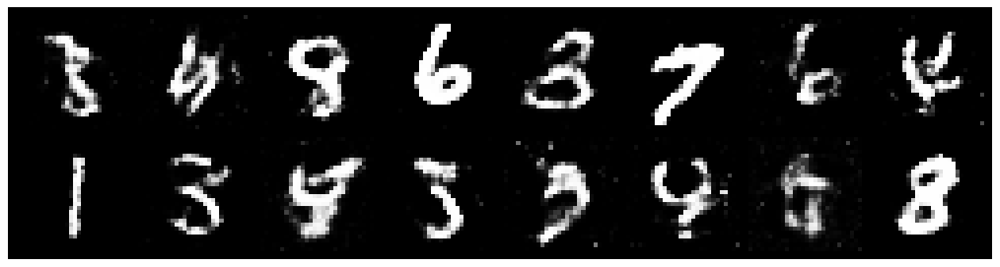

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2302, Generator Loss: 1.0416
D(x): 0.6216, D(G(z)): 0.4654


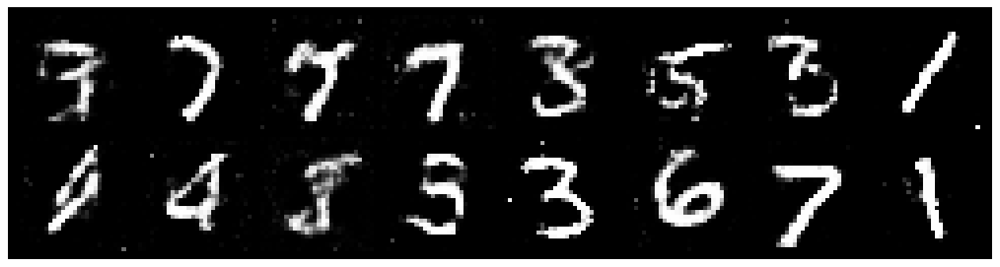

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2182, Generator Loss: 0.9023
D(x): 0.5961, D(G(z)): 0.4486


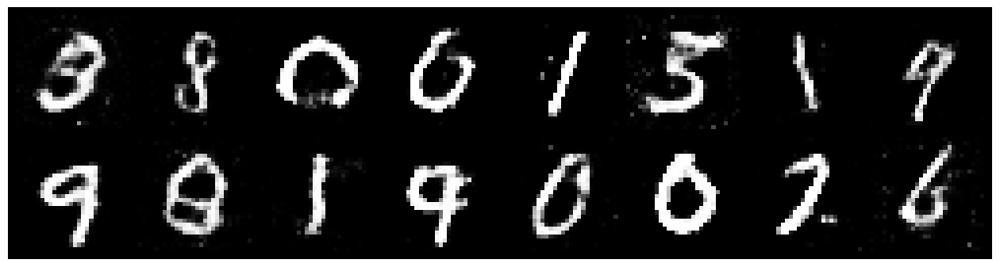

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2461, Generator Loss: 0.8797
D(x): 0.5348, D(G(z)): 0.4149


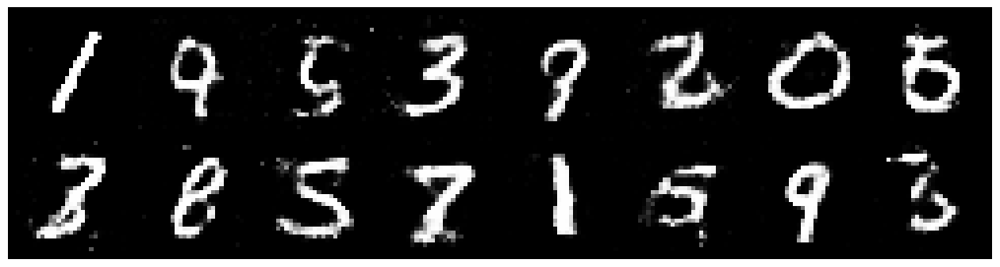

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.1877, Generator Loss: 0.9318
D(x): 0.5686, D(G(z)): 0.4134


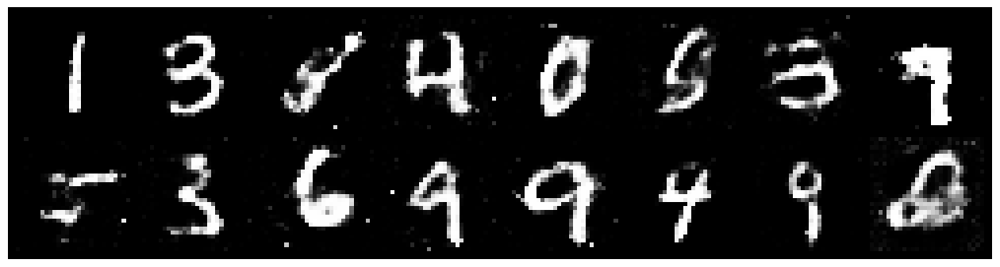

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2883, Generator Loss: 0.8281
D(x): 0.5589, D(G(z)): 0.4740


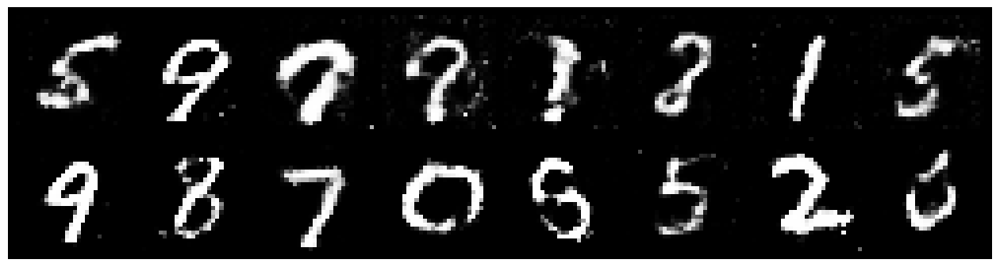

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.1986, Generator Loss: 0.8838
D(x): 0.5901, D(G(z)): 0.4429


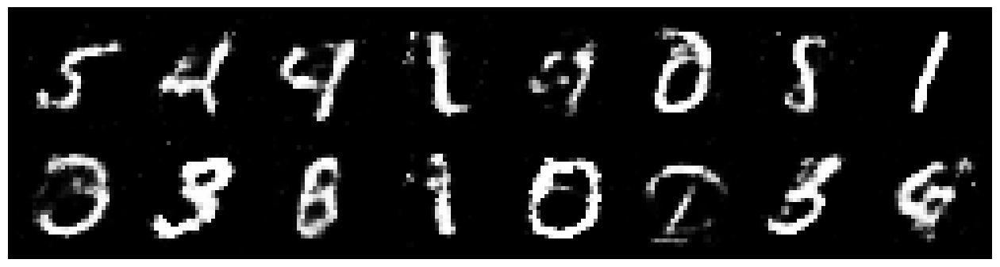

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.2160, Generator Loss: 0.8812
D(x): 0.6085, D(G(z)): 0.4555


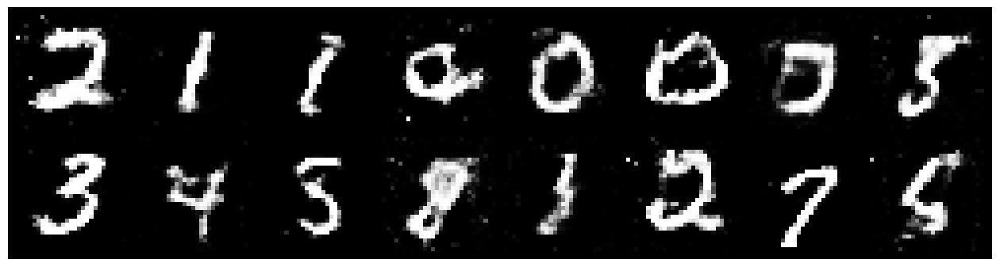

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.1238, Generator Loss: 0.9385
D(x): 0.6058, D(G(z)): 0.4079


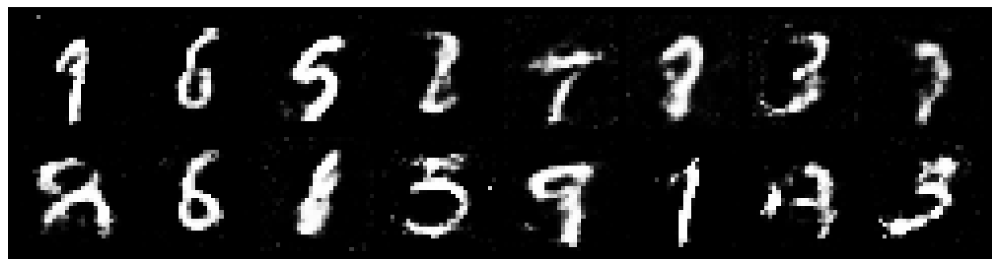

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.2808, Generator Loss: 0.9166
D(x): 0.5709, D(G(z)): 0.4422


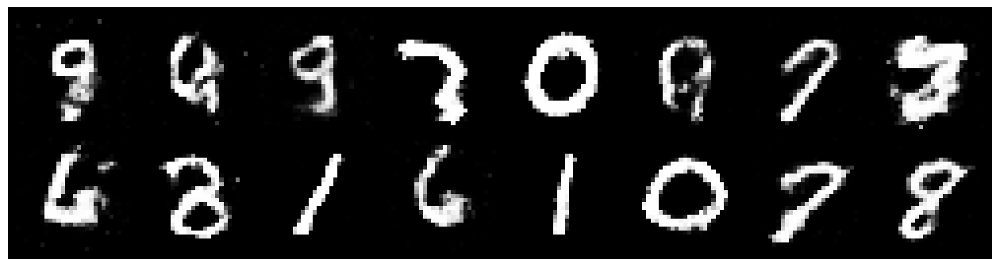

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2275, Generator Loss: 1.0616
D(x): 0.5849, D(G(z)): 0.4360


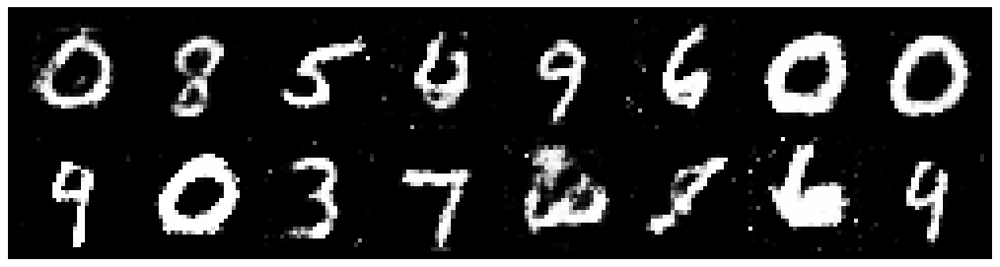

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2548, Generator Loss: 0.9161
D(x): 0.5349, D(G(z)): 0.4156


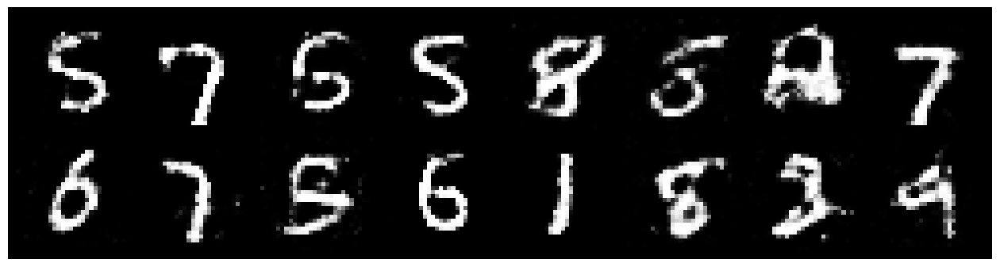

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.1585, Generator Loss: 1.0277
D(x): 0.5781, D(G(z)): 0.4117


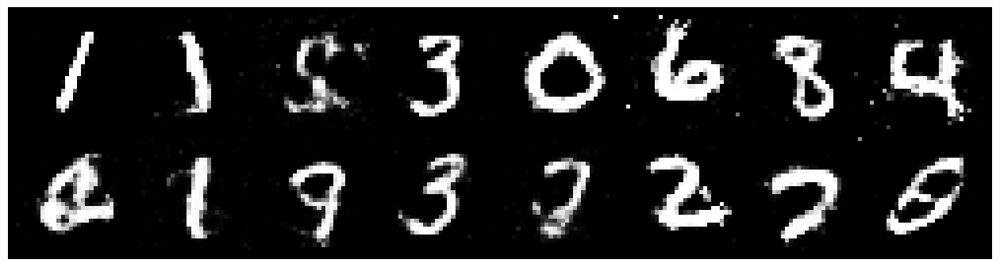

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.2083, Generator Loss: 0.8317
D(x): 0.5851, D(G(z)): 0.4584


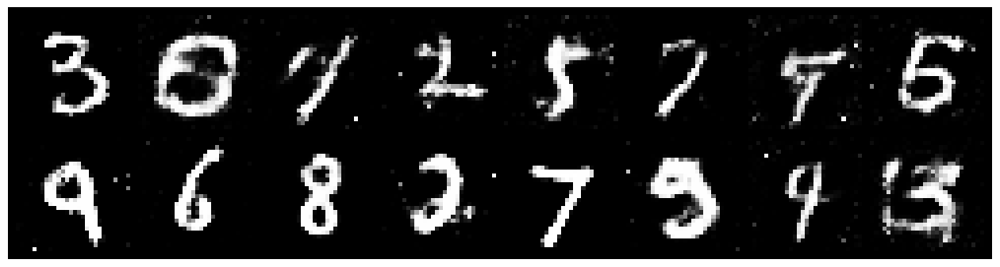

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2650, Generator Loss: 0.9007
D(x): 0.5559, D(G(z)): 0.4368


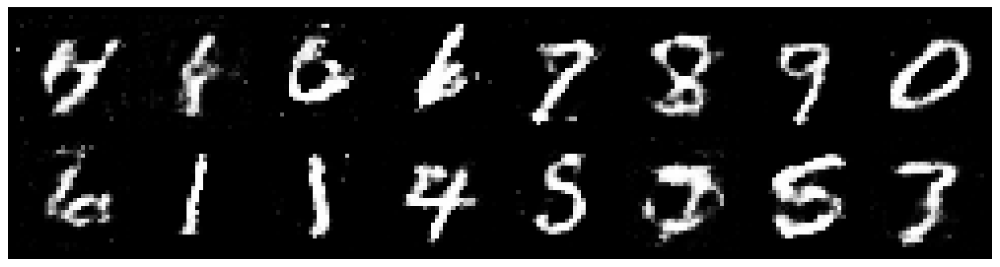

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.3252, Generator Loss: 0.8848
D(x): 0.5214, D(G(z)): 0.4395


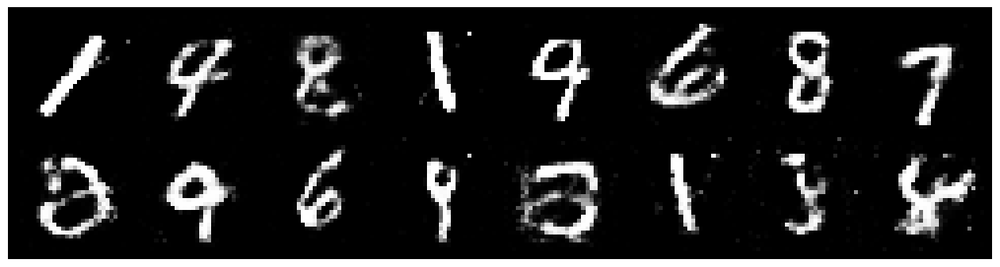

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2750, Generator Loss: 0.8172
D(x): 0.5233, D(G(z)): 0.4345


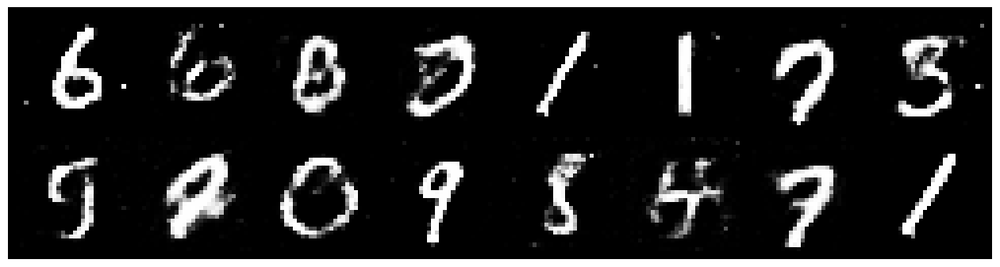

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.3165, Generator Loss: 0.7419
D(x): 0.5322, D(G(z)): 0.4579


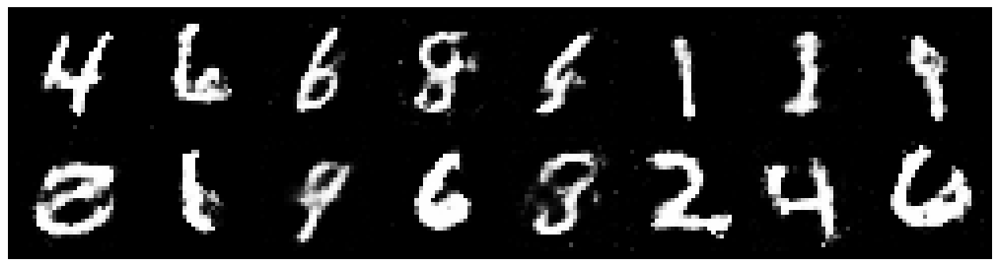

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.2271, Generator Loss: 0.8490
D(x): 0.5669, D(G(z)): 0.4321


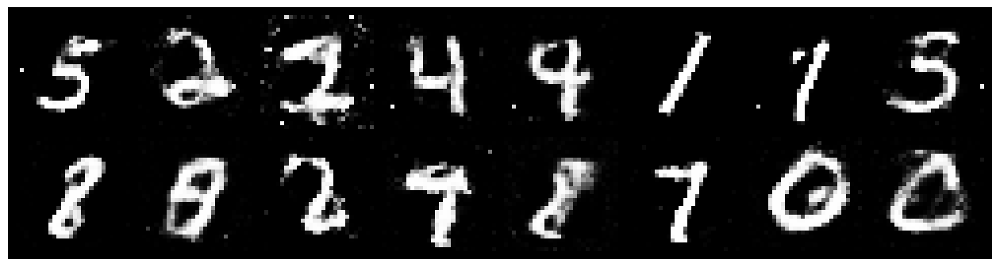

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2631, Generator Loss: 0.8146
D(x): 0.5525, D(G(z)): 0.4410


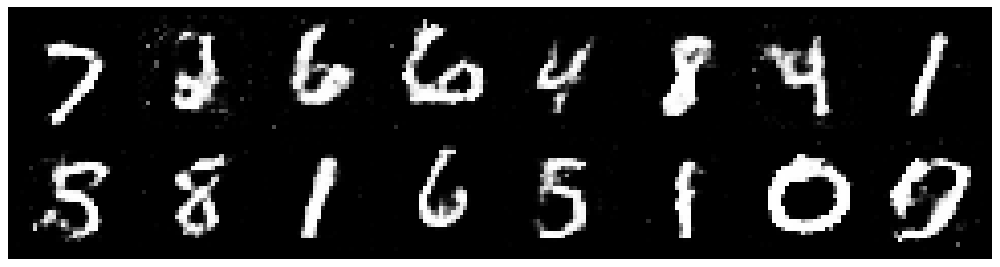

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2889, Generator Loss: 0.7939
D(x): 0.5519, D(G(z)): 0.4744


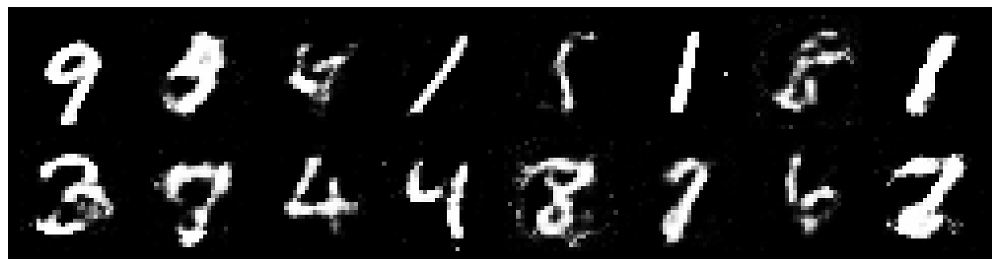

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.1949, Generator Loss: 0.8875
D(x): 0.5675, D(G(z)): 0.4180


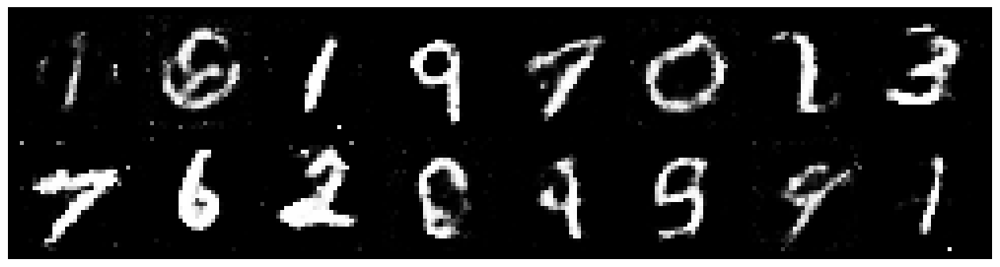

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.1980, Generator Loss: 0.9379
D(x): 0.5692, D(G(z)): 0.4131


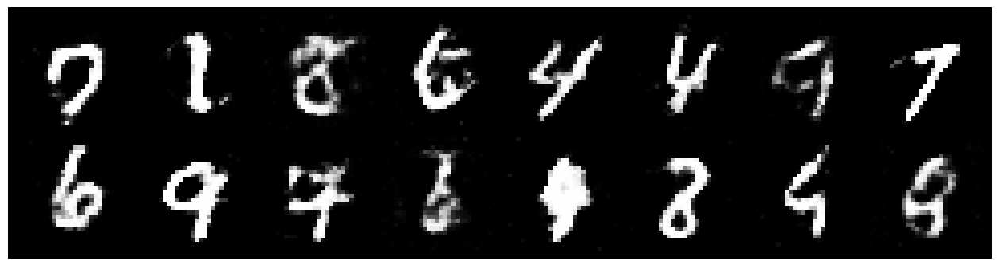

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.2269, Generator Loss: 0.8187
D(x): 0.5668, D(G(z)): 0.4579


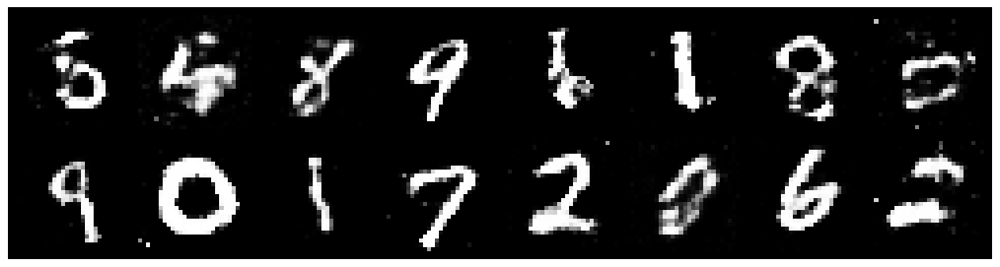

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.2935, Generator Loss: 0.8284
D(x): 0.5916, D(G(z)): 0.4900


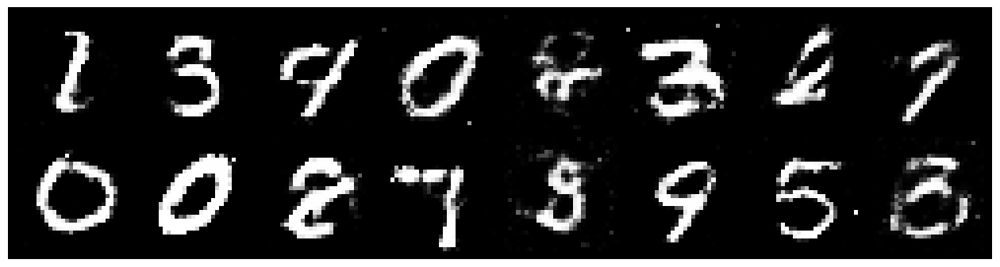

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2272, Generator Loss: 0.8200
D(x): 0.5768, D(G(z)): 0.4554


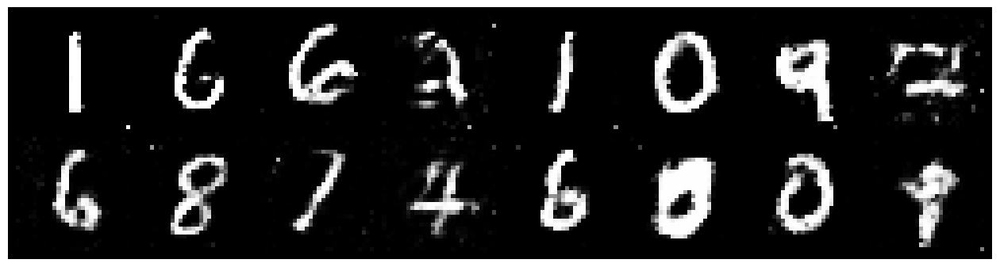

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.3778, Generator Loss: 0.8853
D(x): 0.5124, D(G(z)): 0.4587


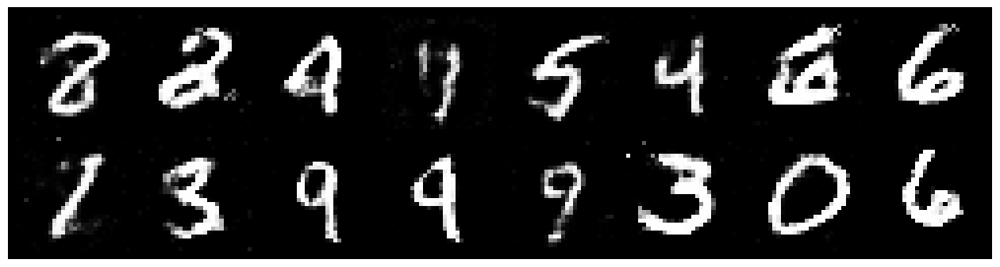

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.4903, Generator Loss: 0.9992
D(x): 0.4346, D(G(z)): 0.3891


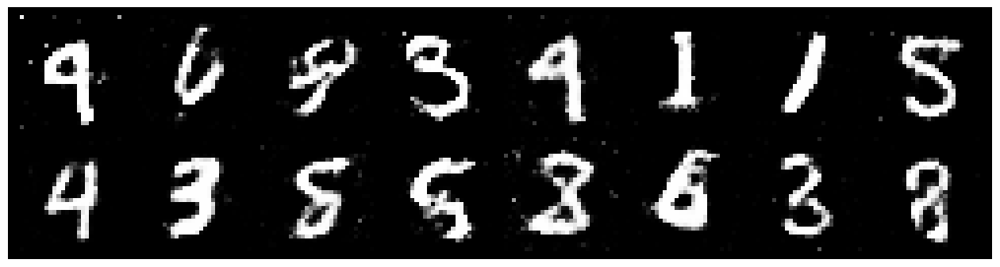

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2284, Generator Loss: 0.9434
D(x): 0.5866, D(G(z)): 0.4414


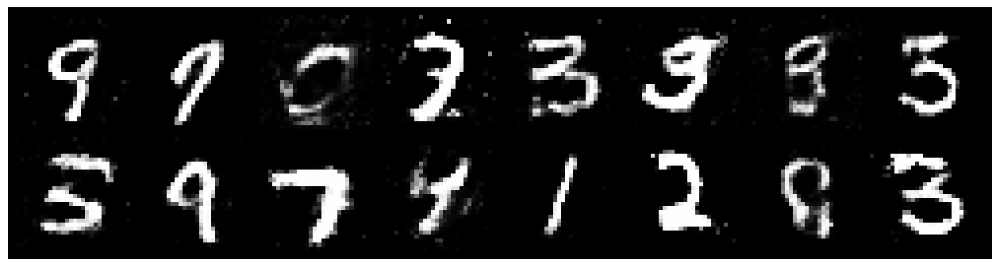

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.2393, Generator Loss: 1.0065
D(x): 0.5924, D(G(z)): 0.4352


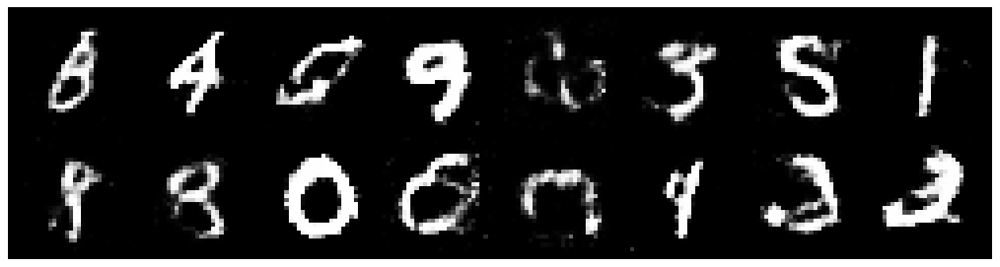

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.3872, Generator Loss: 0.8390
D(x): 0.5646, D(G(z)): 0.4772


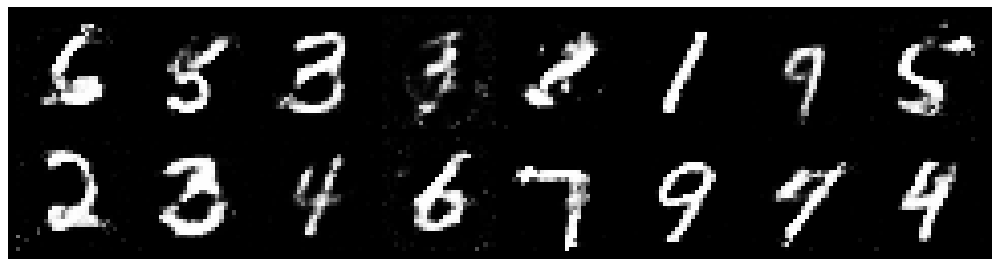

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.1742, Generator Loss: 0.8574
D(x): 0.5765, D(G(z)): 0.3984


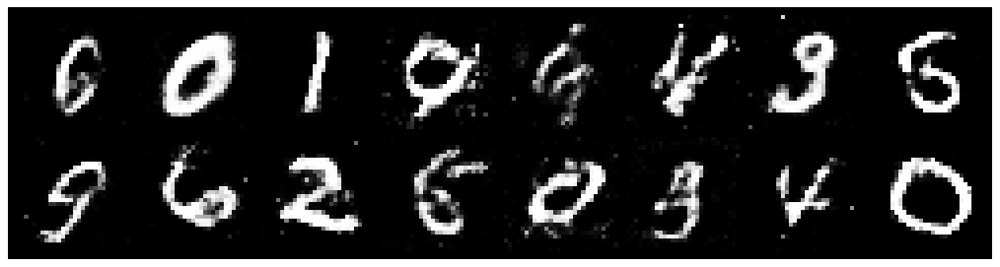

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.3528, Generator Loss: 1.0280
D(x): 0.5444, D(G(z)): 0.4618


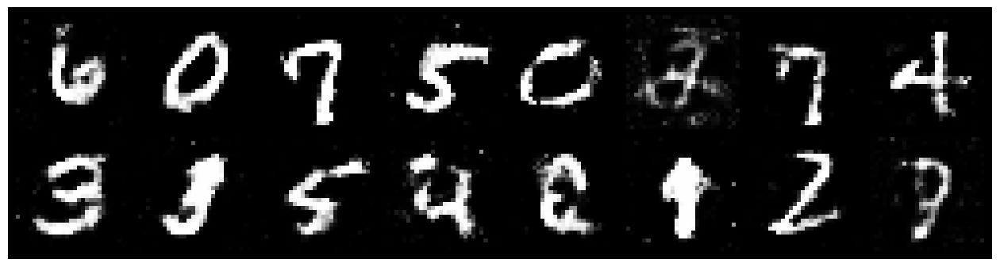

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2804, Generator Loss: 1.0182
D(x): 0.5434, D(G(z)): 0.4152


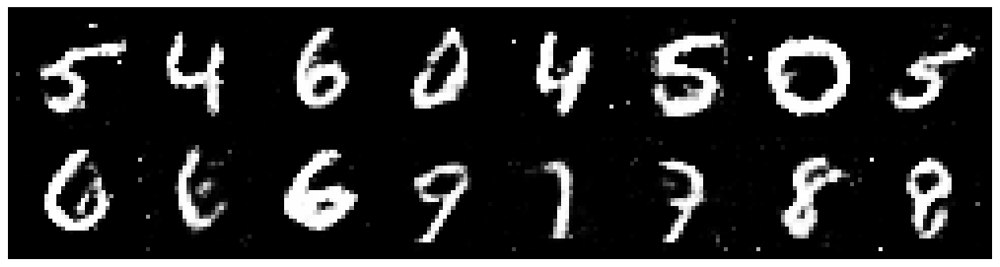

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.3523, Generator Loss: 0.8673
D(x): 0.5549, D(G(z)): 0.4568


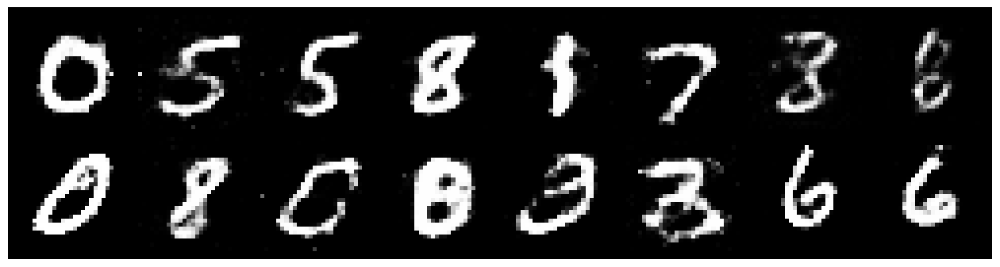

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.1608, Generator Loss: 1.0258
D(x): 0.6275, D(G(z)): 0.4366


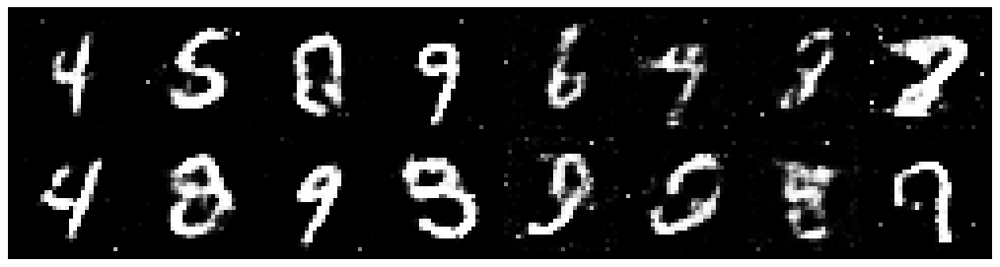

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.1997, Generator Loss: 0.9645
D(x): 0.5416, D(G(z)): 0.3968


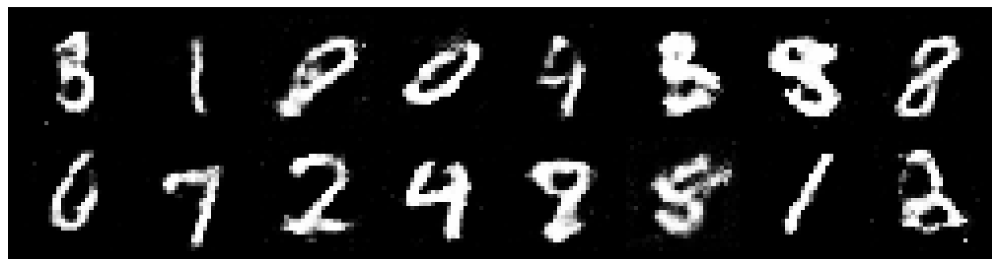

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.3084, Generator Loss: 0.9994
D(x): 0.5791, D(G(z)): 0.4626


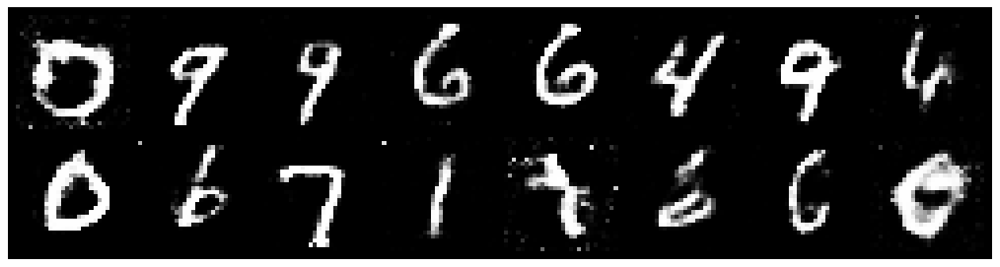

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.2717, Generator Loss: 1.0105
D(x): 0.5608, D(G(z)): 0.4429


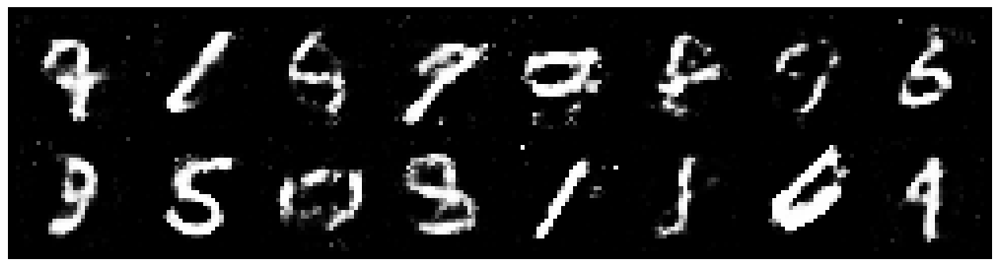

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2642, Generator Loss: 0.8585
D(x): 0.5258, D(G(z)): 0.4273


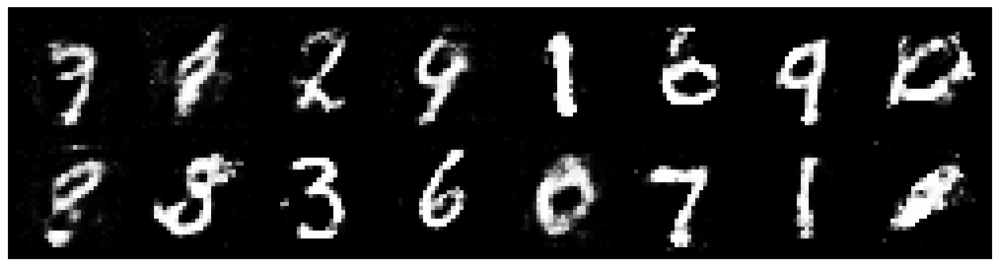

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2643, Generator Loss: 0.8808
D(x): 0.5554, D(G(z)): 0.4462


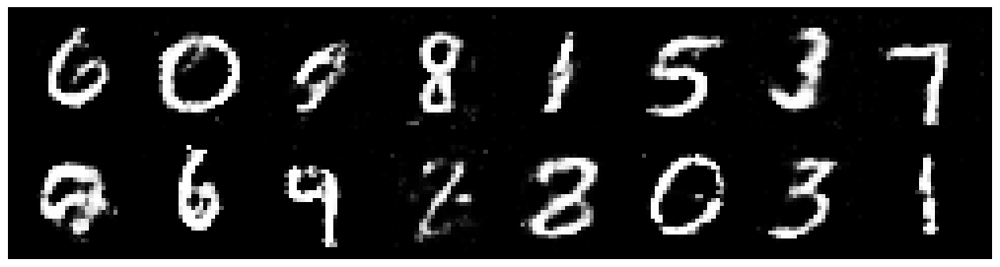

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.1748, Generator Loss: 1.0239
D(x): 0.6005, D(G(z)): 0.4138


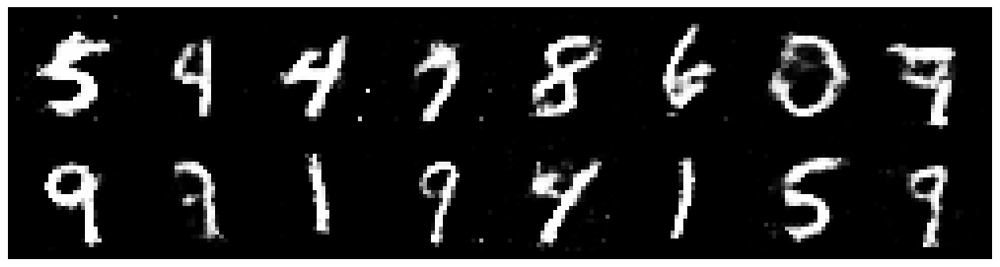

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.3376, Generator Loss: 0.8370
D(x): 0.5673, D(G(z)): 0.4729


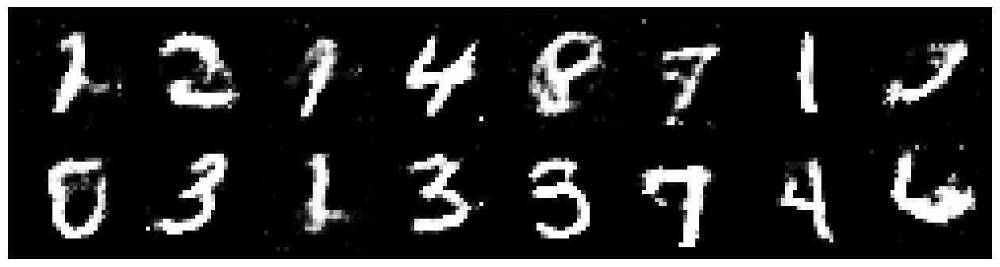

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.3974, Generator Loss: 0.8607
D(x): 0.5277, D(G(z)): 0.4491


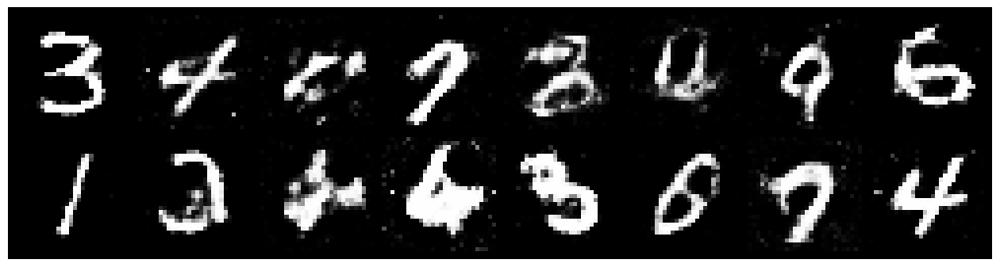

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2881, Generator Loss: 0.7976
D(x): 0.5625, D(G(z)): 0.4704


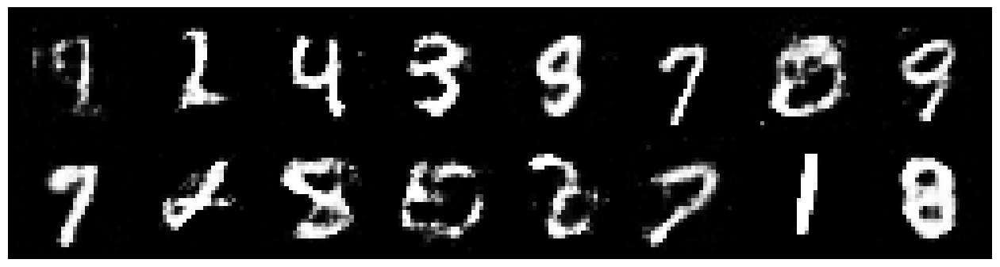

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.2660, Generator Loss: 0.8576
D(x): 0.5328, D(G(z)): 0.4422


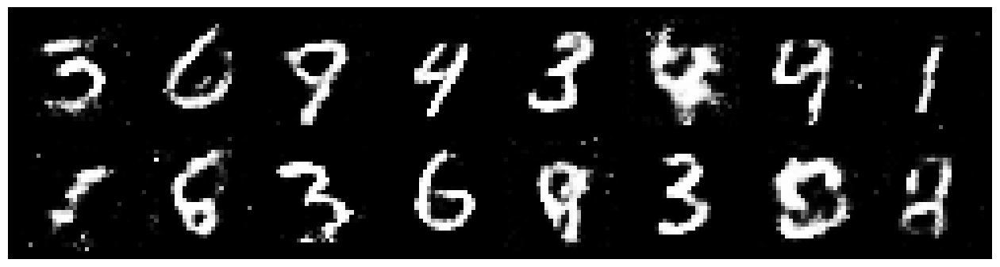

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2412, Generator Loss: 0.8023
D(x): 0.5605, D(G(z)): 0.4425


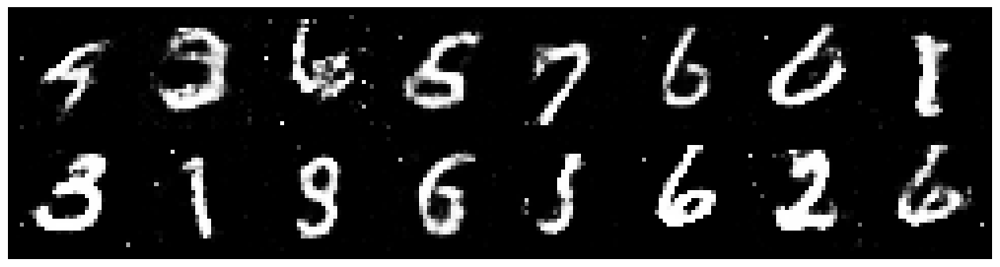

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2454, Generator Loss: 0.8051
D(x): 0.5581, D(G(z)): 0.4288


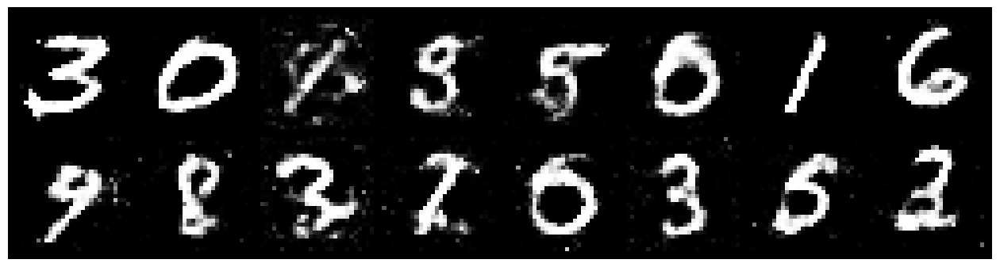

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.2281, Generator Loss: 0.8471
D(x): 0.5965, D(G(z)): 0.4449


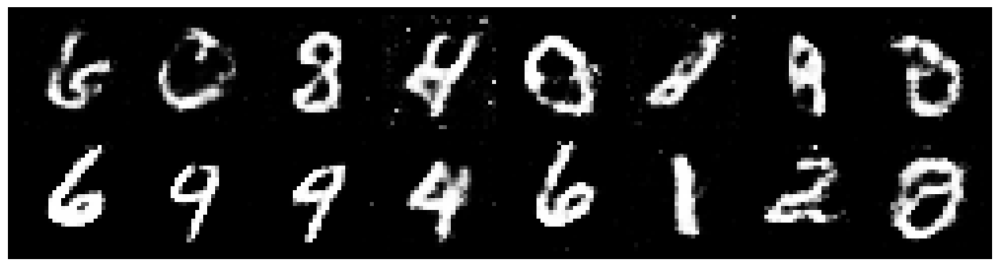

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.2427, Generator Loss: 0.9269
D(x): 0.5810, D(G(z)): 0.4416


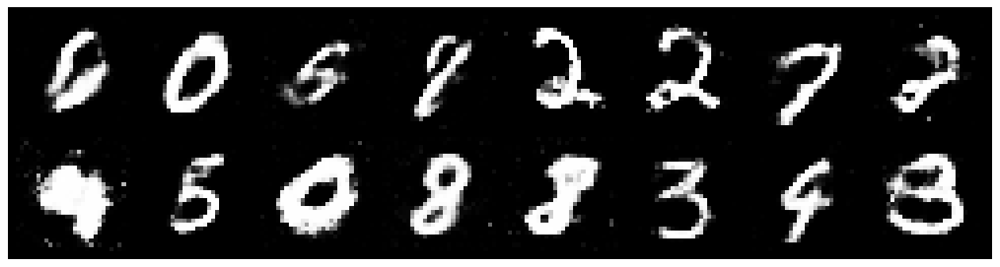

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.3864, Generator Loss: 0.8566
D(x): 0.5424, D(G(z)): 0.4722


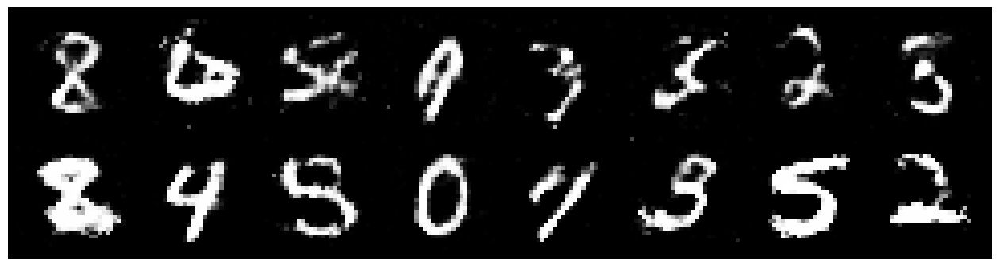

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2959, Generator Loss: 0.8286
D(x): 0.5279, D(G(z)): 0.4401


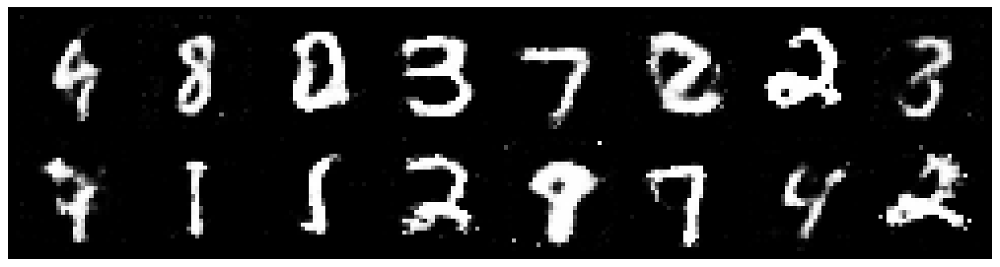

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.4194, Generator Loss: 0.8294
D(x): 0.5739, D(G(z)): 0.5066


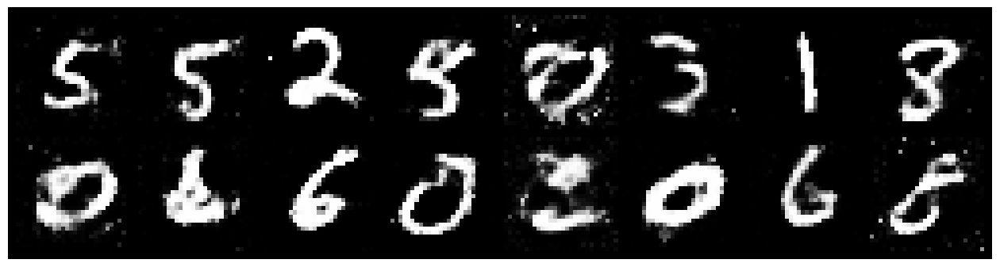

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.1695, Generator Loss: 1.0009
D(x): 0.5866, D(G(z)): 0.3959


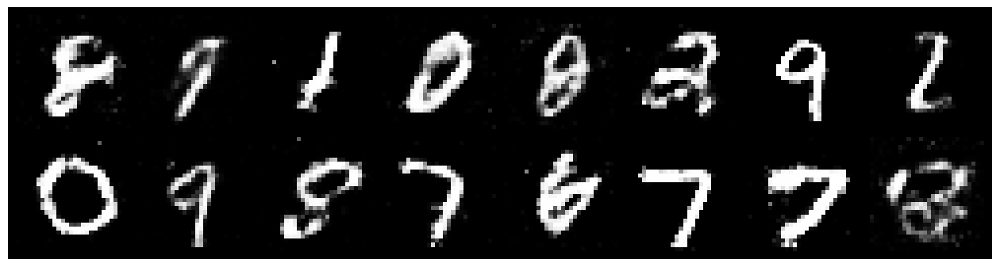

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.1989, Generator Loss: 1.0094
D(x): 0.5664, D(G(z)): 0.3862


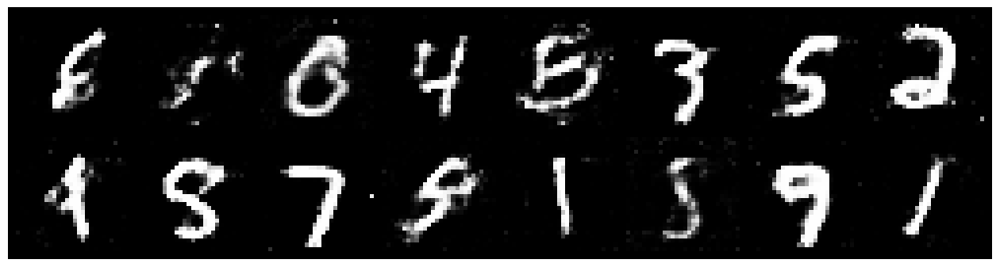

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2146, Generator Loss: 0.9160
D(x): 0.5495, D(G(z)): 0.4187


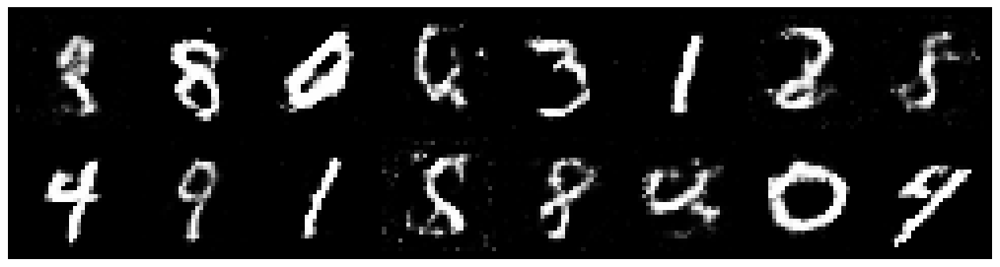

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.1753, Generator Loss: 0.9652
D(x): 0.5889, D(G(z)): 0.4399


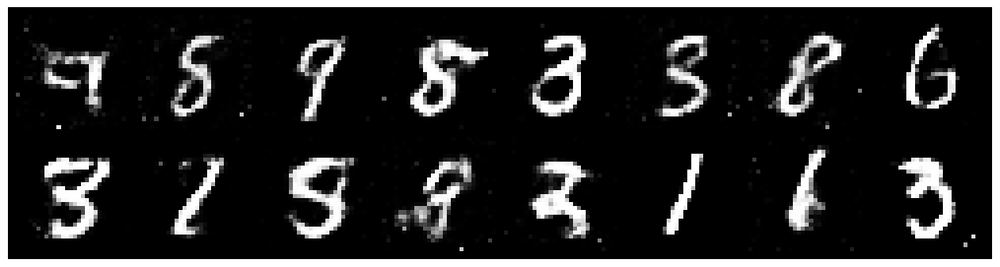

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.3255, Generator Loss: 0.9048
D(x): 0.5811, D(G(z)): 0.4921


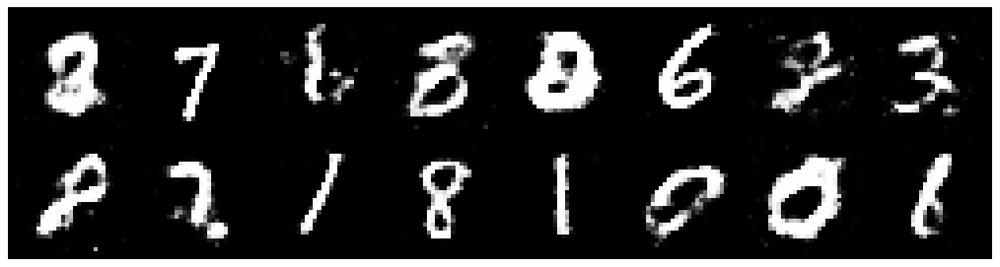

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.1973, Generator Loss: 0.9230
D(x): 0.6224, D(G(z)): 0.4519


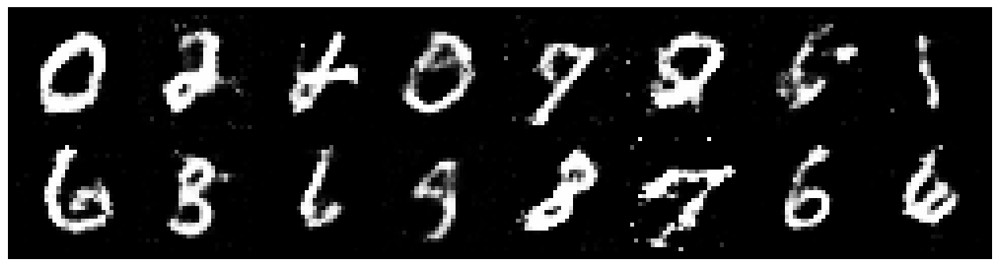

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.1769, Generator Loss: 0.9319
D(x): 0.5767, D(G(z)): 0.4128


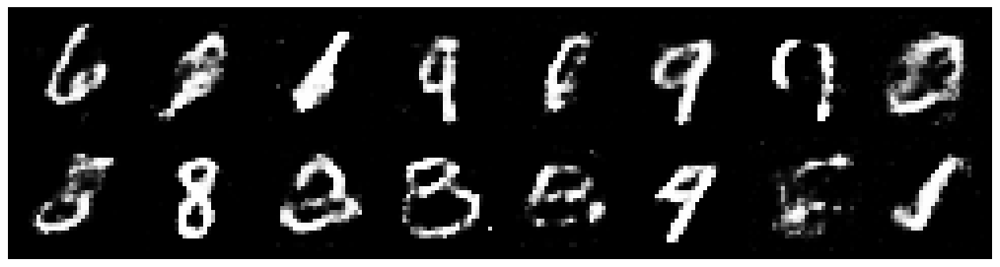

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.1987, Generator Loss: 1.0654
D(x): 0.5703, D(G(z)): 0.4059


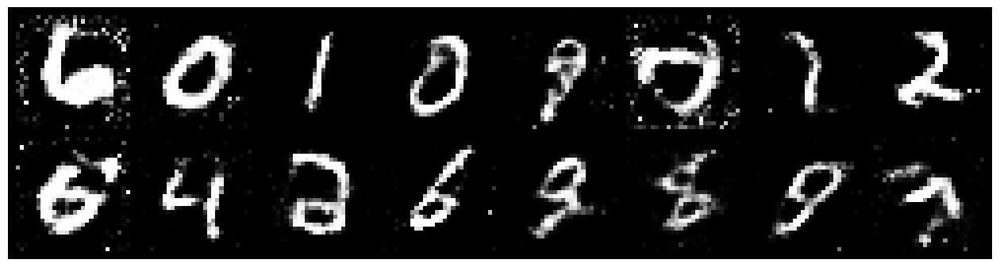

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2265, Generator Loss: 0.9341
D(x): 0.6010, D(G(z)): 0.4528


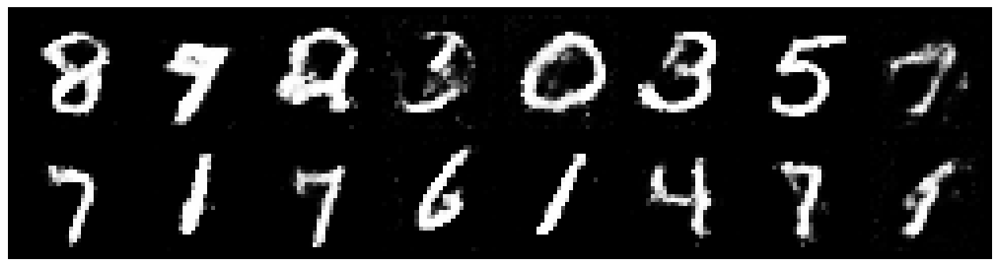

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.3102, Generator Loss: 0.7834
D(x): 0.5785, D(G(z)): 0.4976


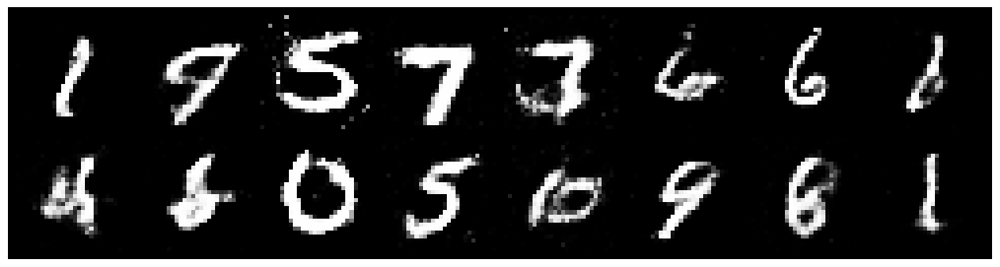

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.3177, Generator Loss: 0.7768
D(x): 0.5372, D(G(z)): 0.4490


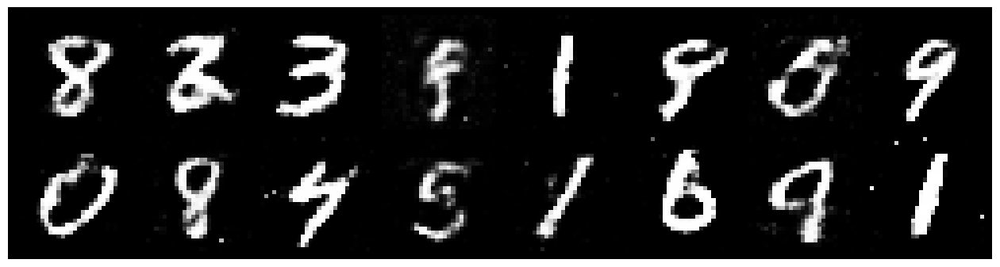

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.1262, Generator Loss: 0.8519
D(x): 0.6221, D(G(z)): 0.4255


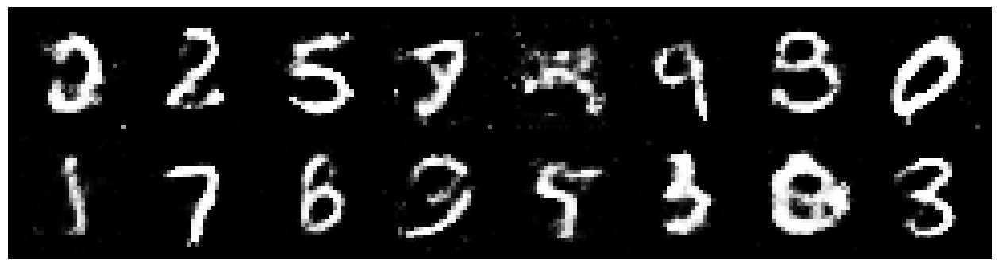

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.1359, Generator Loss: 1.0973
D(x): 0.5991, D(G(z)): 0.4055


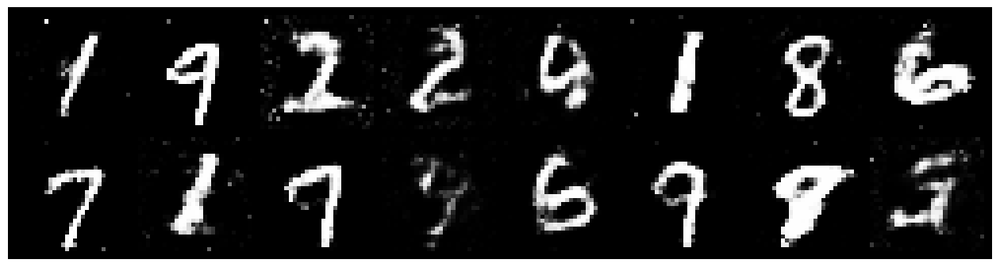

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.1413, Generator Loss: 0.9974
D(x): 0.5960, D(G(z)): 0.3977


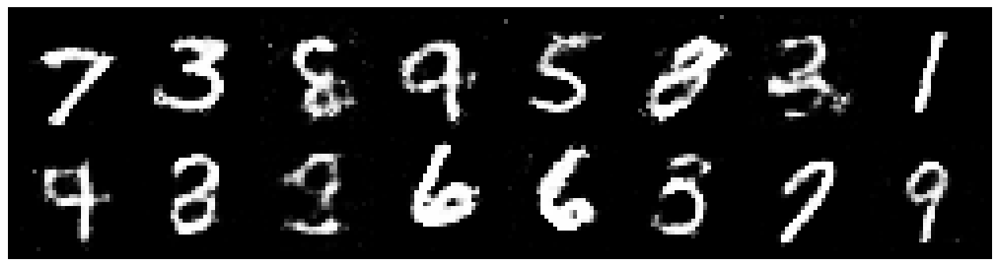

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2370, Generator Loss: 0.8858
D(x): 0.5794, D(G(z)): 0.4370


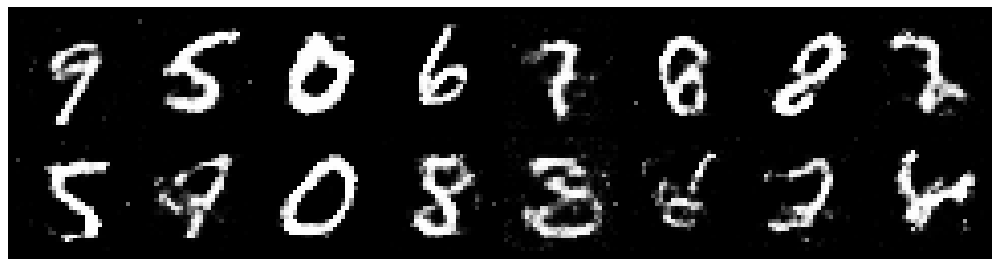

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.3604, Generator Loss: 0.8729
D(x): 0.5610, D(G(z)): 0.4894


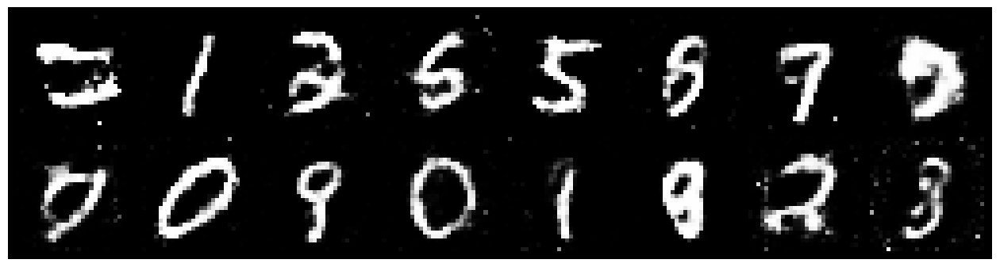

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.3249, Generator Loss: 0.8600
D(x): 0.5198, D(G(z)): 0.4370


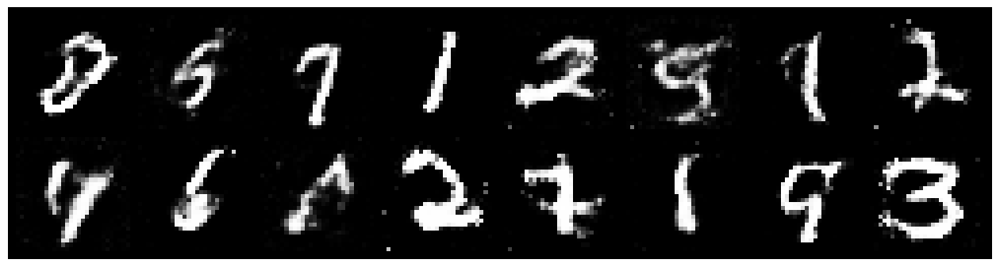

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.3637, Generator Loss: 0.8418
D(x): 0.5277, D(G(z)): 0.4572


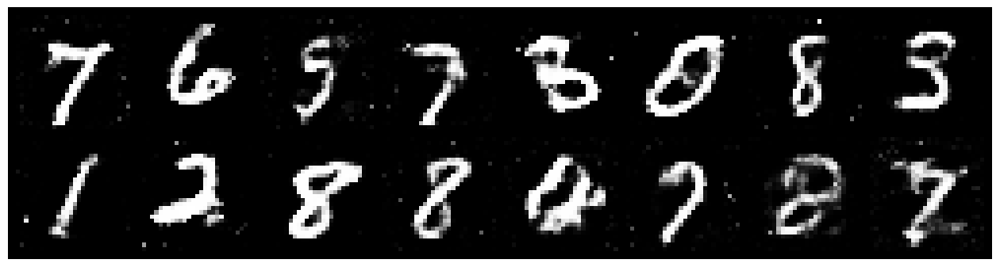

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.1846, Generator Loss: 1.0161
D(x): 0.5857, D(G(z)): 0.4155


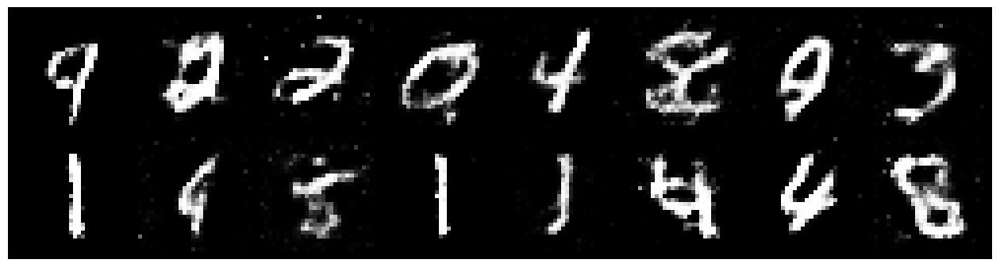

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.1569, Generator Loss: 0.9434
D(x): 0.5723, D(G(z)): 0.4019


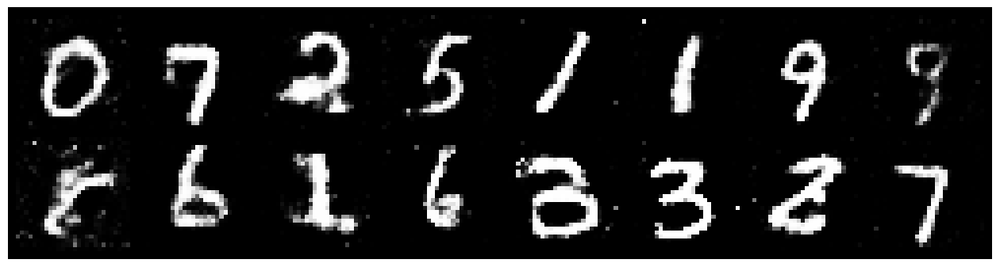

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2134, Generator Loss: 0.9112
D(x): 0.5671, D(G(z)): 0.4356


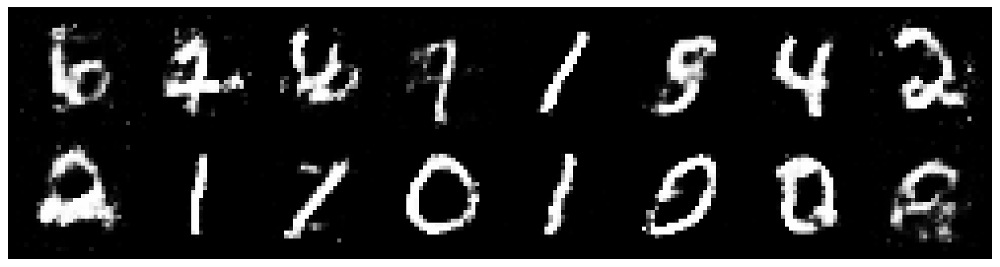

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.2706, Generator Loss: 0.9706
D(x): 0.5673, D(G(z)): 0.4422


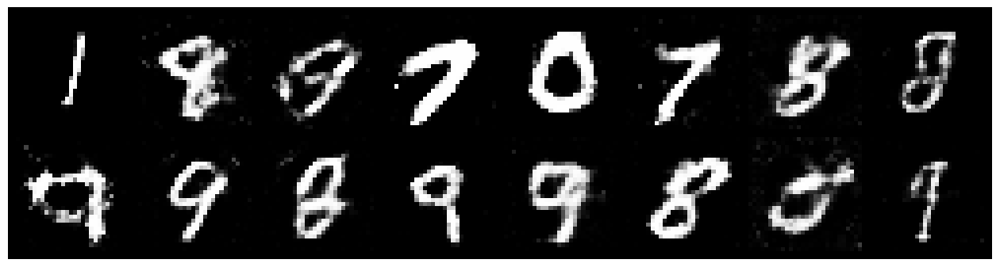

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.2289, Generator Loss: 0.8935
D(x): 0.5913, D(G(z)): 0.4656


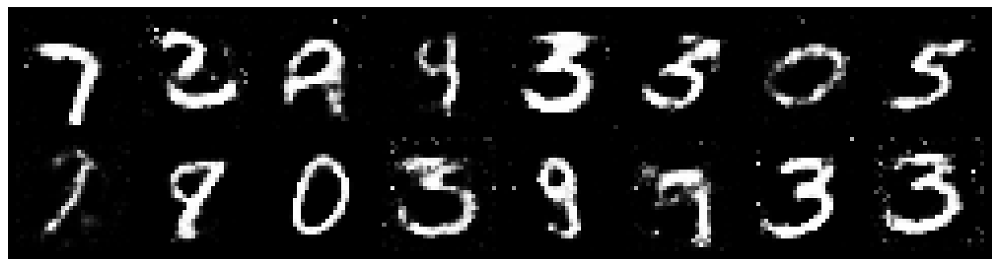

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2732, Generator Loss: 0.8430
D(x): 0.5913, D(G(z)): 0.4679


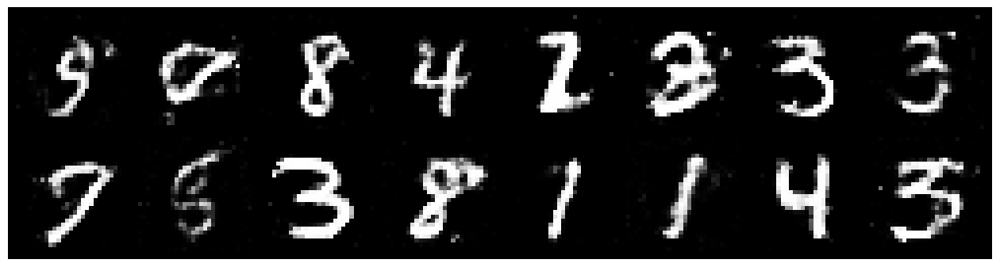

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2887, Generator Loss: 0.8738
D(x): 0.5658, D(G(z)): 0.4584


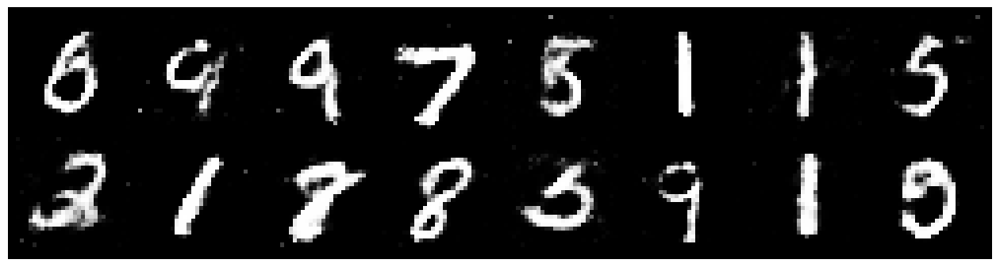

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.2493, Generator Loss: 0.9226
D(x): 0.5985, D(G(z)): 0.4493


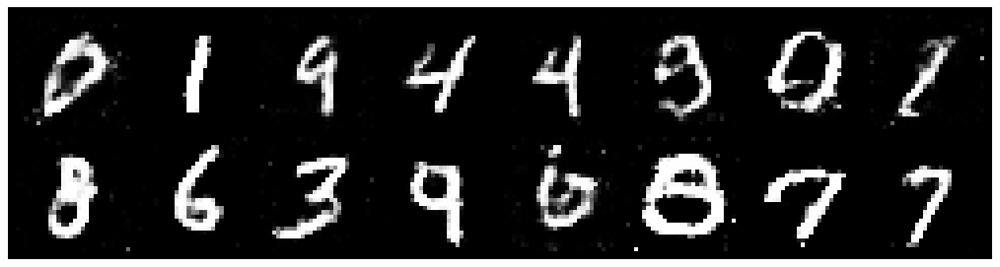

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.1190, Generator Loss: 1.0444
D(x): 0.5847, D(G(z)): 0.3957


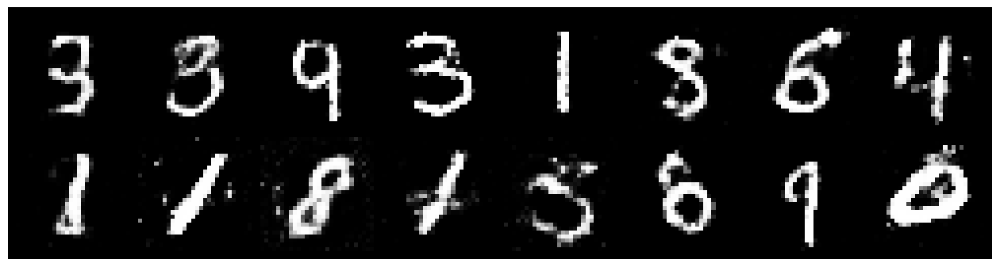

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.1538, Generator Loss: 0.9901
D(x): 0.6132, D(G(z)): 0.4348


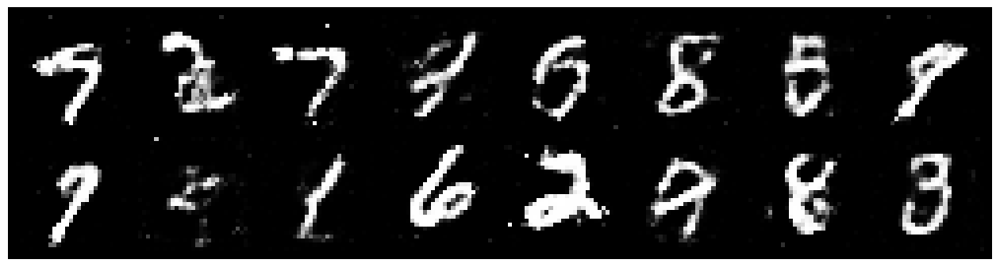

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.2908, Generator Loss: 0.8087
D(x): 0.5213, D(G(z)): 0.4420


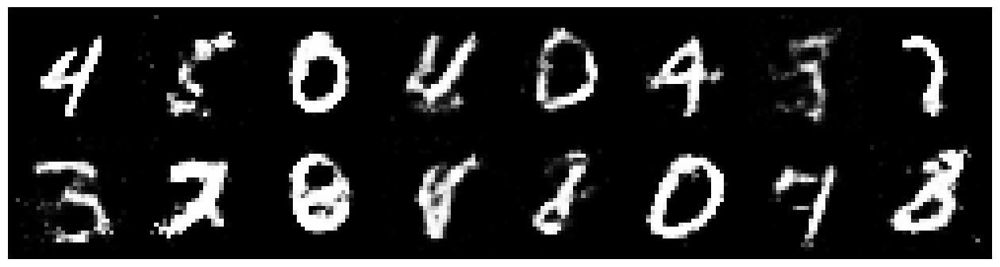

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.2598, Generator Loss: 0.9282
D(x): 0.6010, D(G(z)): 0.4654


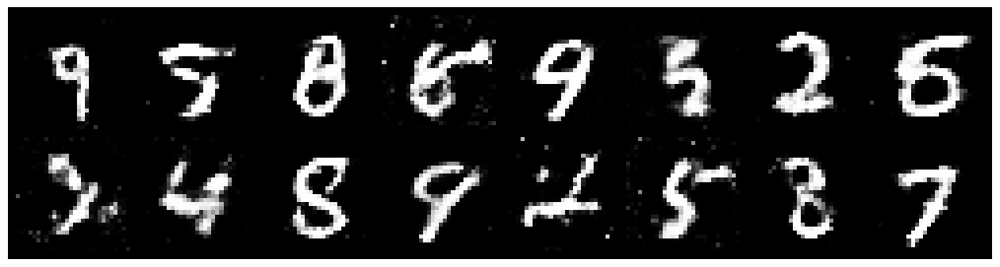

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.1980, Generator Loss: 0.9132
D(x): 0.5605, D(G(z)): 0.4206


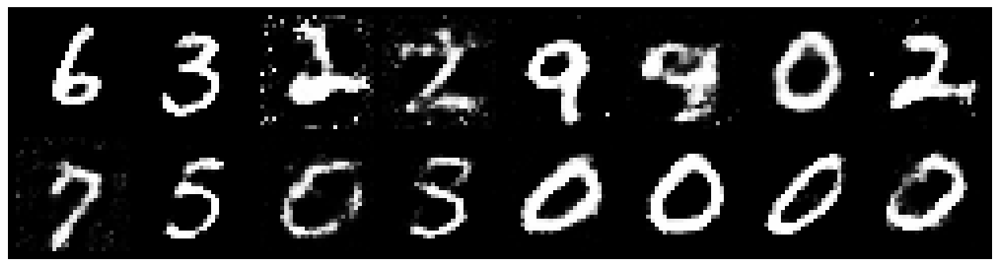

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2739, Generator Loss: 0.9809
D(x): 0.5045, D(G(z)): 0.3926


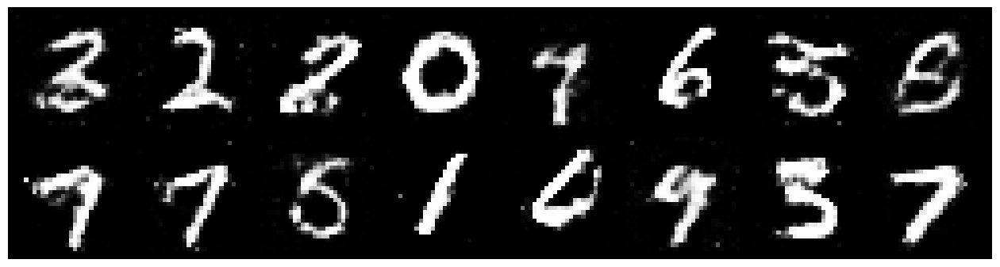

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.3325, Generator Loss: 0.8742
D(x): 0.5212, D(G(z)): 0.4511


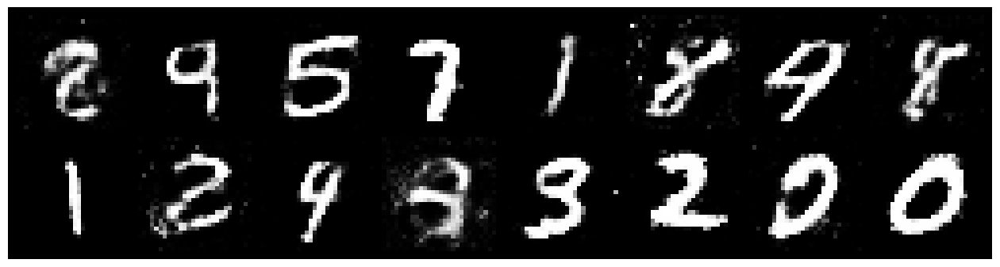

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.2027, Generator Loss: 0.9146
D(x): 0.5629, D(G(z)): 0.4105


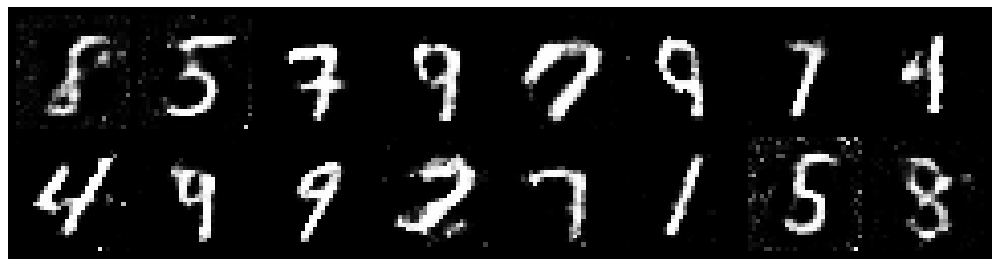

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.3198, Generator Loss: 0.9371
D(x): 0.5620, D(G(z)): 0.4495


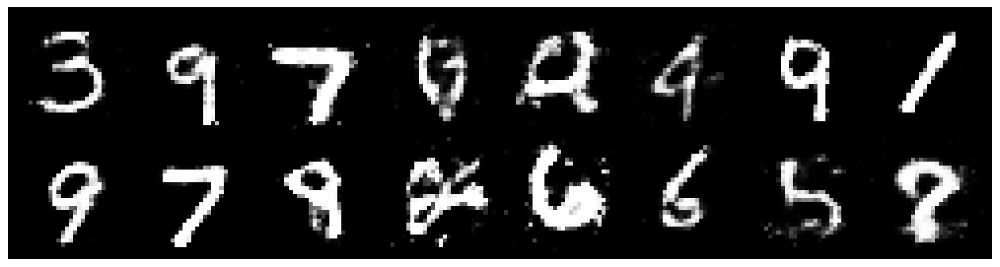

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.4168, Generator Loss: 0.8584
D(x): 0.6027, D(G(z)): 0.5047


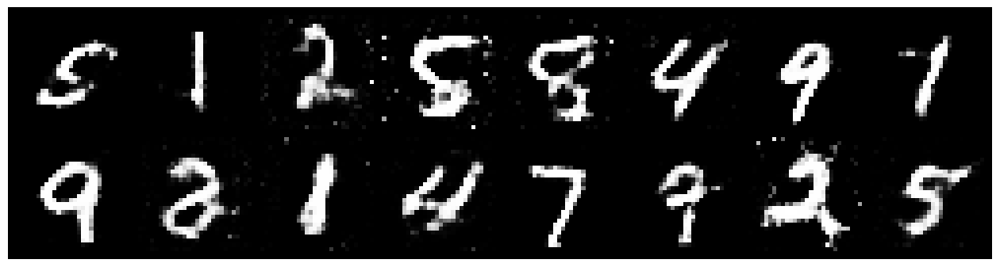

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9909
D(x): 0.5762, D(G(z)): 0.4277


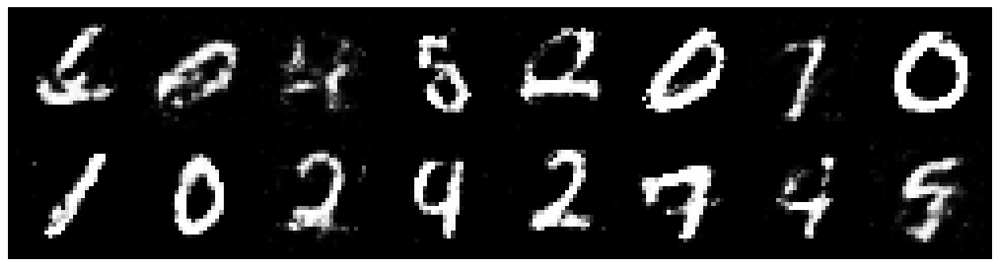

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.3534, Generator Loss: 0.8788
D(x): 0.5323, D(G(z)): 0.4399


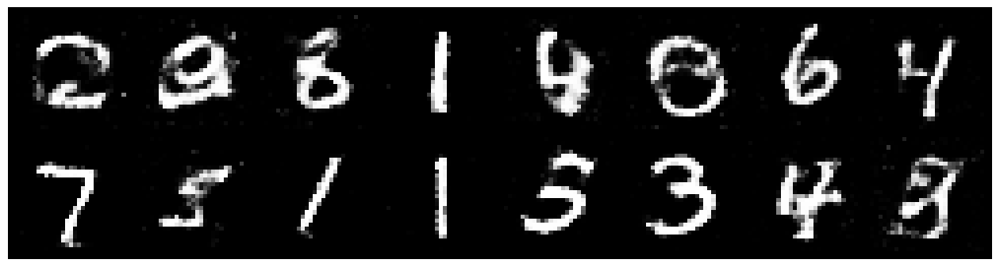

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.2016, Generator Loss: 1.0375
D(x): 0.5592, D(G(z)): 0.3989


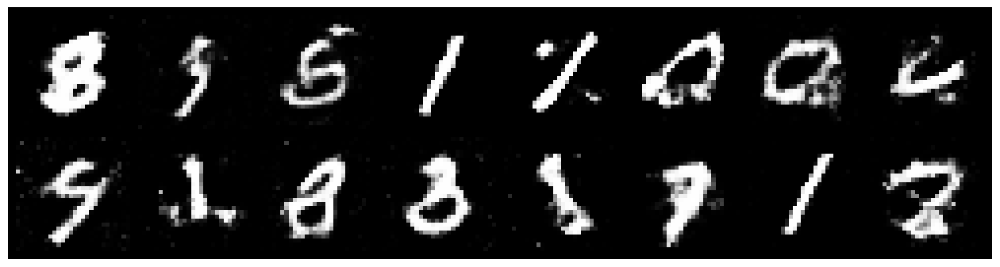

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.1139, Generator Loss: 0.9379
D(x): 0.5925, D(G(z)): 0.4048


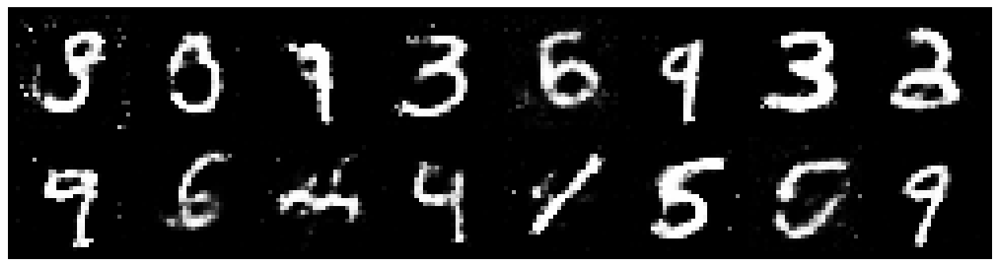

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.1862, Generator Loss: 0.8929
D(x): 0.5504, D(G(z)): 0.4115


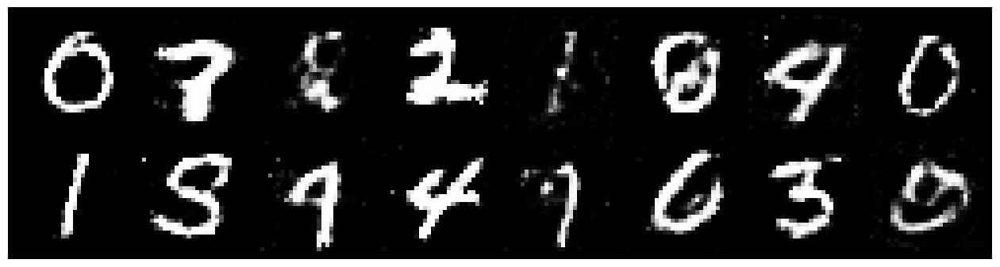

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.2661, Generator Loss: 0.8522
D(x): 0.5696, D(G(z)): 0.4594


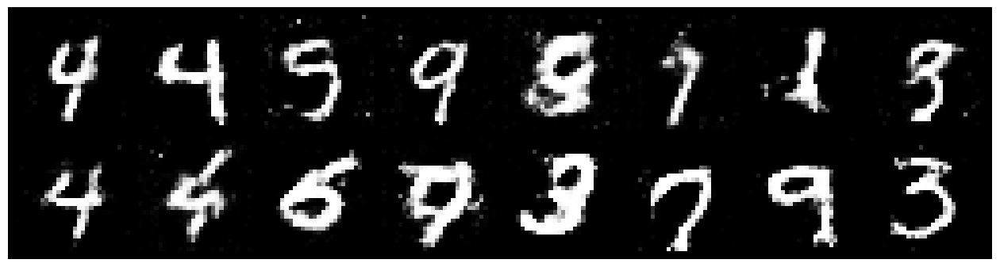

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2675, Generator Loss: 0.8948
D(x): 0.5842, D(G(z)): 0.4696


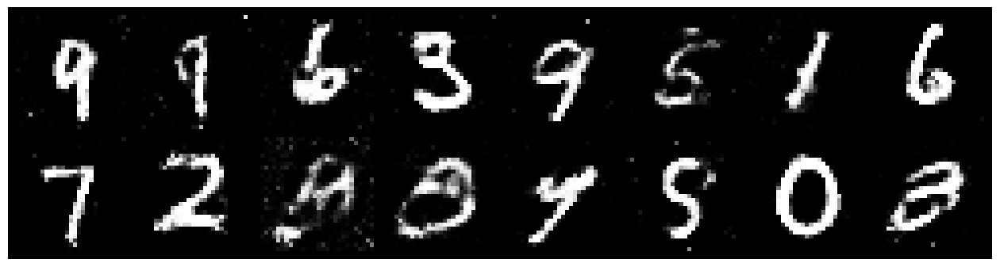

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.3312, Generator Loss: 0.8836
D(x): 0.5290, D(G(z)): 0.4606


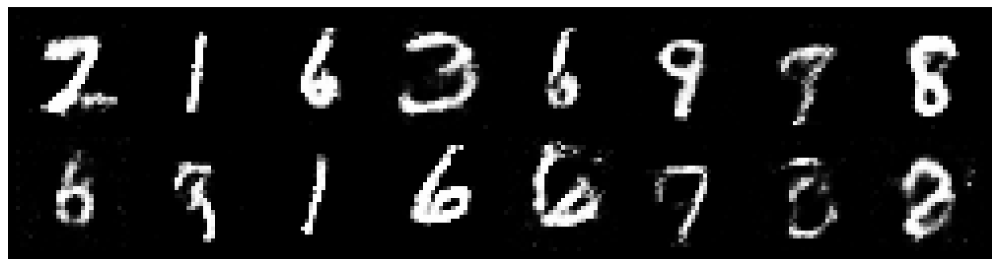

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2493, Generator Loss: 0.9865
D(x): 0.5443, D(G(z)): 0.4124


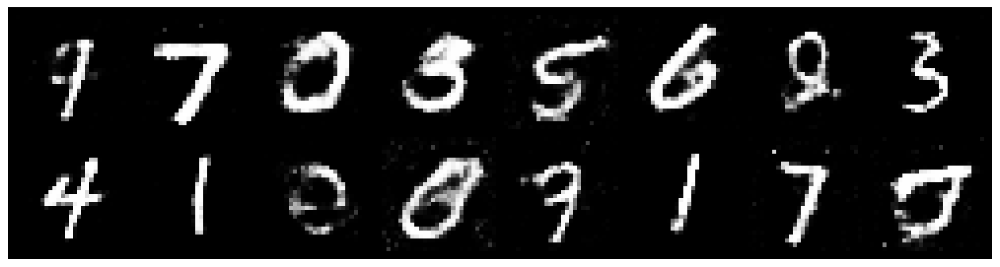

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.3151, Generator Loss: 0.8038
D(x): 0.5253, D(G(z)): 0.4560


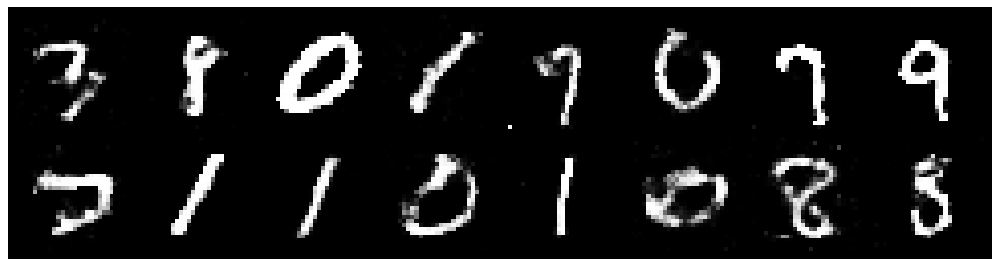

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.3054, Generator Loss: 0.7836
D(x): 0.5696, D(G(z)): 0.4890


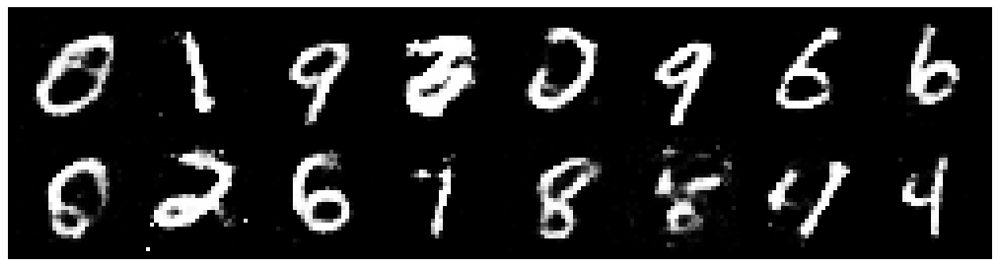

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.2715, Generator Loss: 0.7658
D(x): 0.5683, D(G(z)): 0.4684


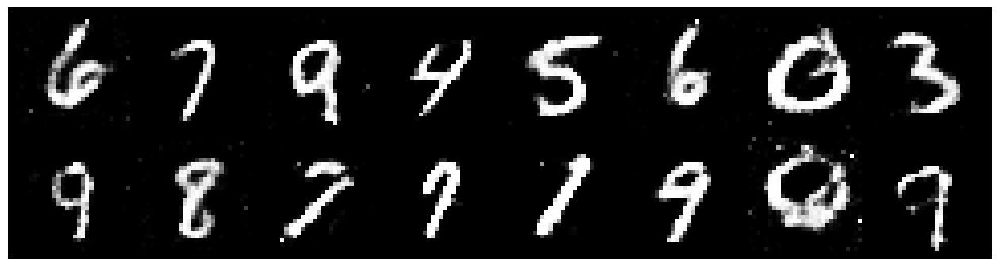

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.3157, Generator Loss: 1.0002
D(x): 0.5333, D(G(z)): 0.4394


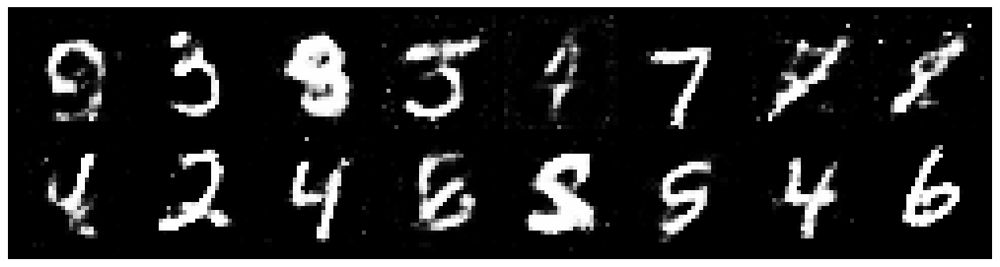

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2980, Generator Loss: 0.8511
D(x): 0.6294, D(G(z)): 0.4940


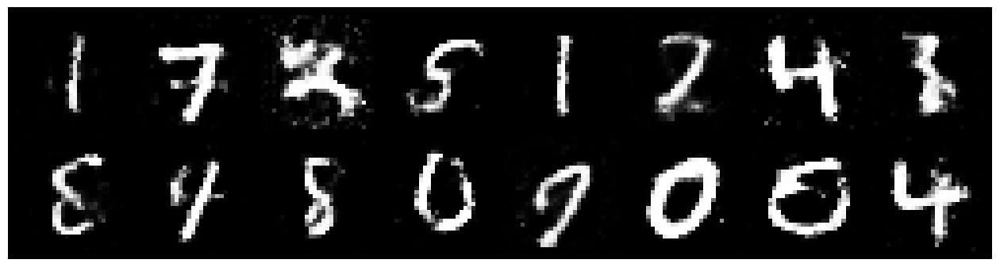

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.2412, Generator Loss: 0.9679
D(x): 0.5620, D(G(z)): 0.4166


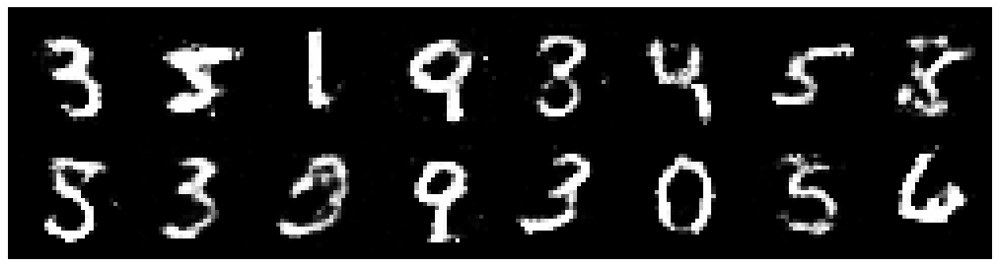

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.1743, Generator Loss: 0.9755
D(x): 0.5717, D(G(z)): 0.3737


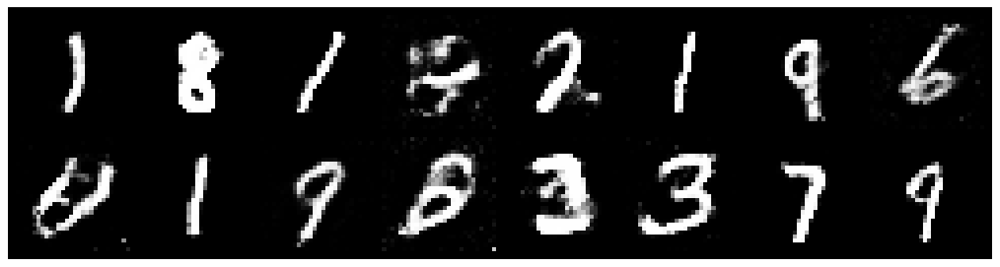

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.1399, Generator Loss: 1.0917
D(x): 0.6134, D(G(z)): 0.3991


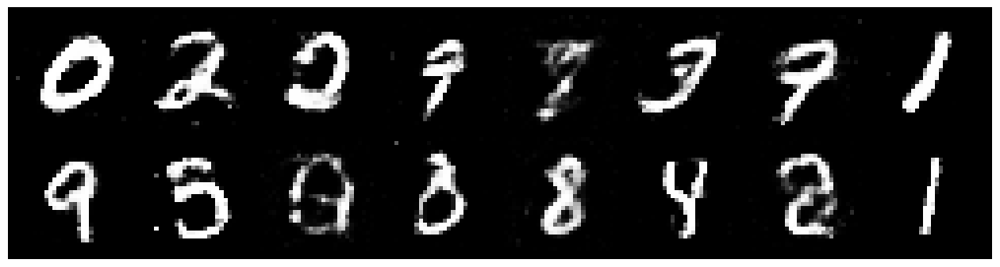

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2215, Generator Loss: 0.9793
D(x): 0.5196, D(G(z)): 0.3862


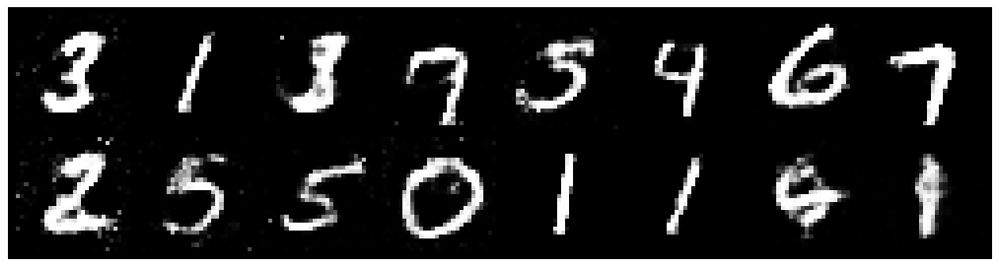

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.2586, Generator Loss: 0.9960
D(x): 0.5443, D(G(z)): 0.4297


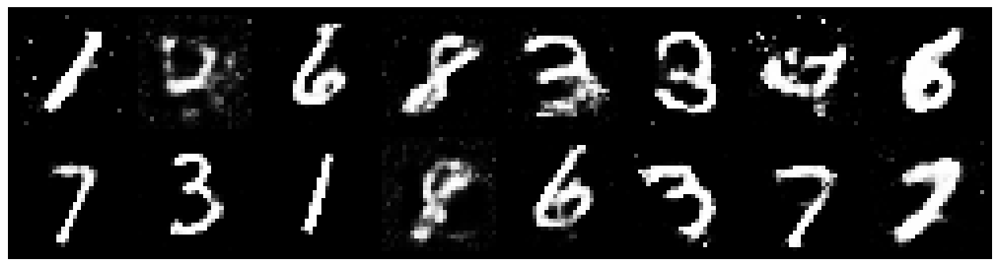

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.2699, Generator Loss: 0.8608
D(x): 0.5406, D(G(z)): 0.4361


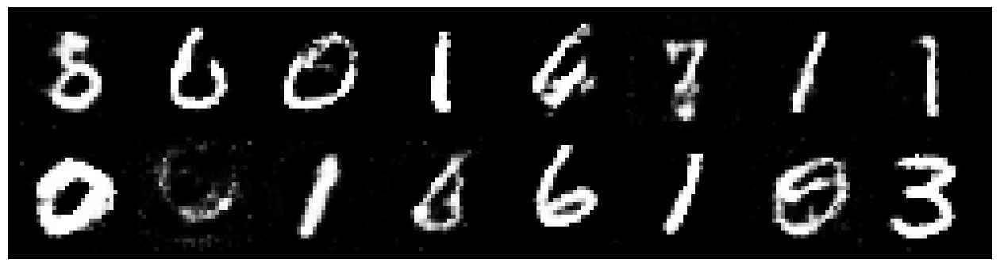

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.3147, Generator Loss: 0.8139
D(x): 0.5473, D(G(z)): 0.4638


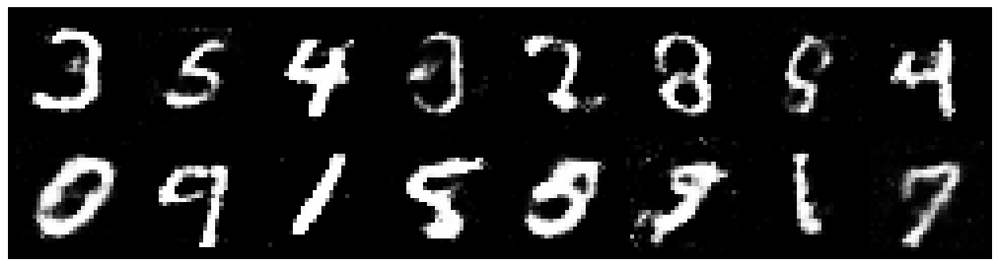

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.1418, Generator Loss: 0.9175
D(x): 0.5861, D(G(z)): 0.4020


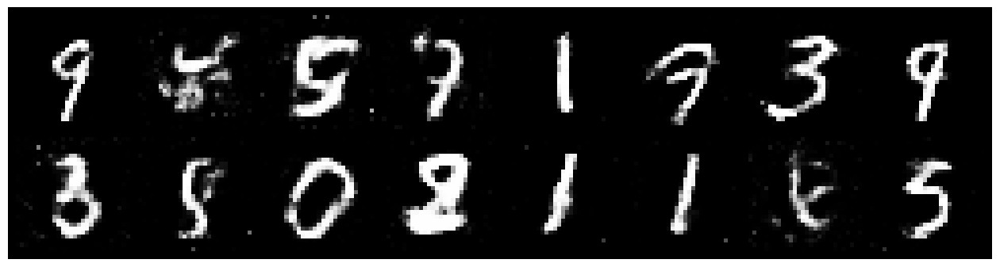

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.1932, Generator Loss: 0.8746
D(x): 0.5946, D(G(z)): 0.4360


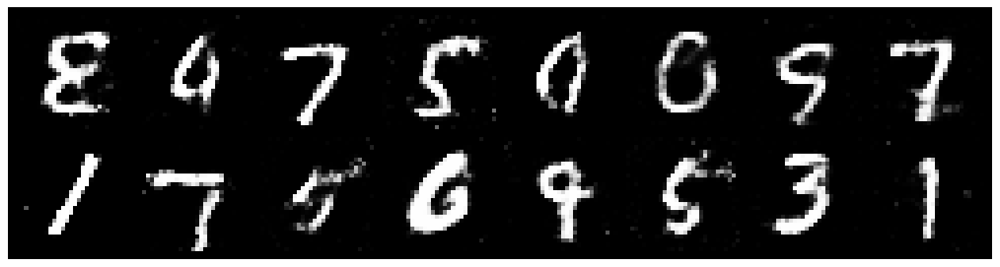

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2222, Generator Loss: 1.0983
D(x): 0.5819, D(G(z)): 0.4264


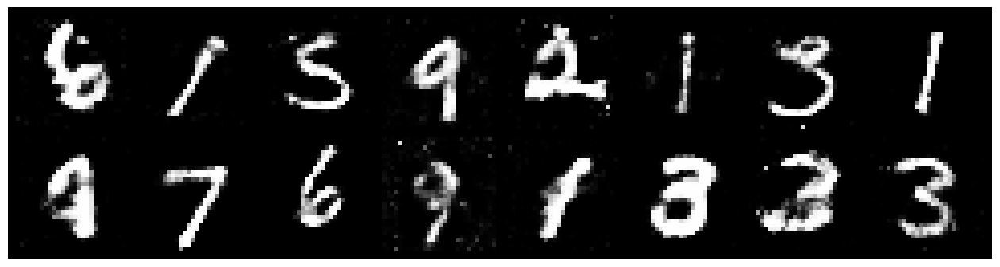

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2584, Generator Loss: 0.9678
D(x): 0.5562, D(G(z)): 0.4395


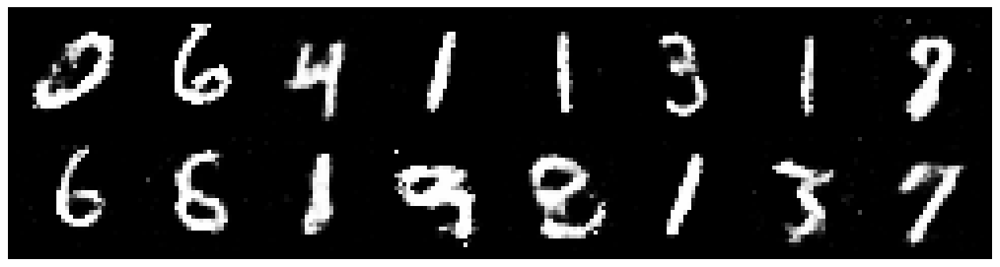

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.3258, Generator Loss: 0.9169
D(x): 0.5432, D(G(z)): 0.4214


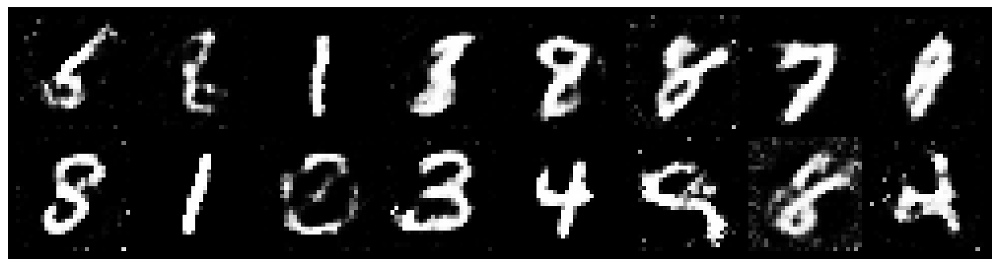

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.3026, Generator Loss: 0.9627
D(x): 0.5780, D(G(z)): 0.4303


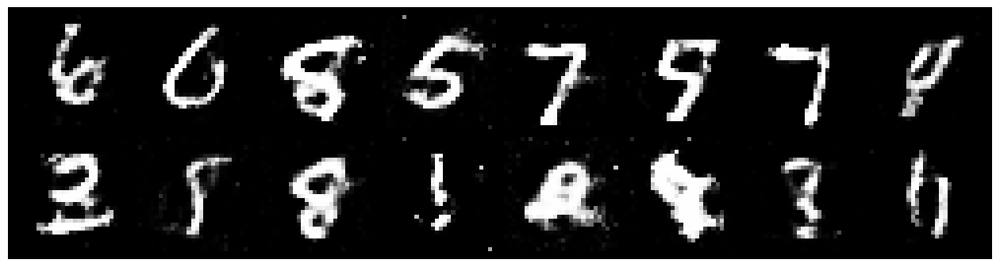

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.3450, Generator Loss: 0.9023
D(x): 0.5564, D(G(z)): 0.4631


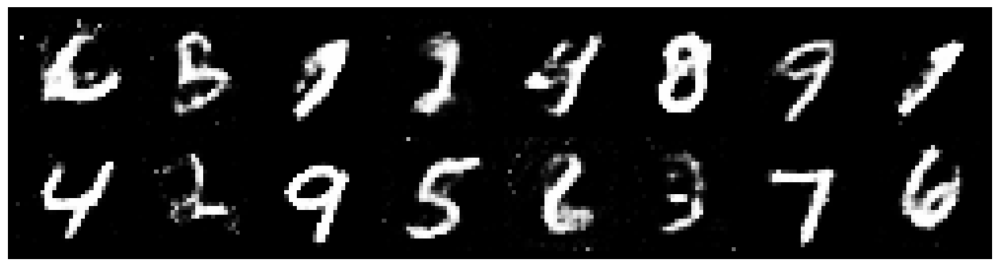

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.2834, Generator Loss: 0.8547
D(x): 0.5776, D(G(z)): 0.4385


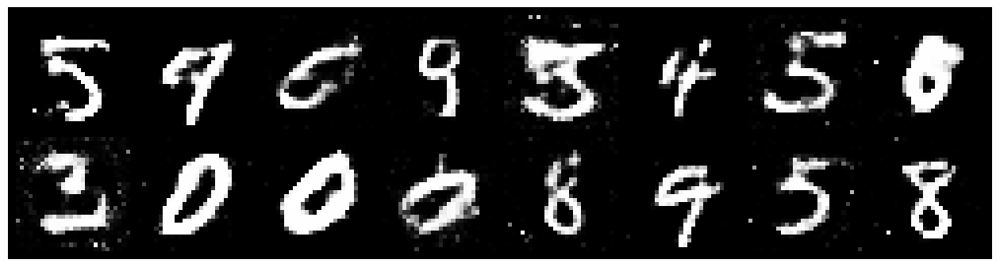

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.2820, Generator Loss: 0.8470
D(x): 0.5447, D(G(z)): 0.4440


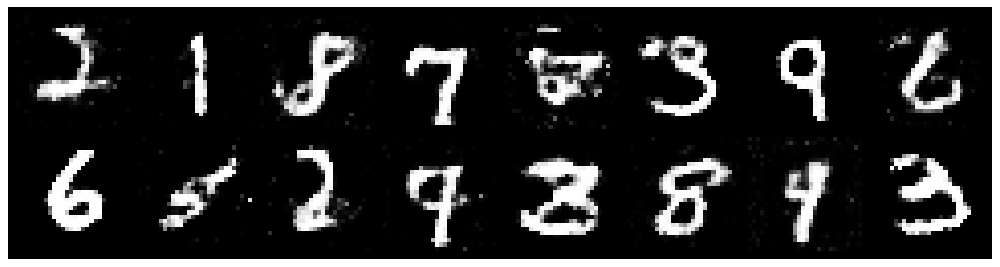

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.2773, Generator Loss: 0.9625
D(x): 0.5854, D(G(z)): 0.4617


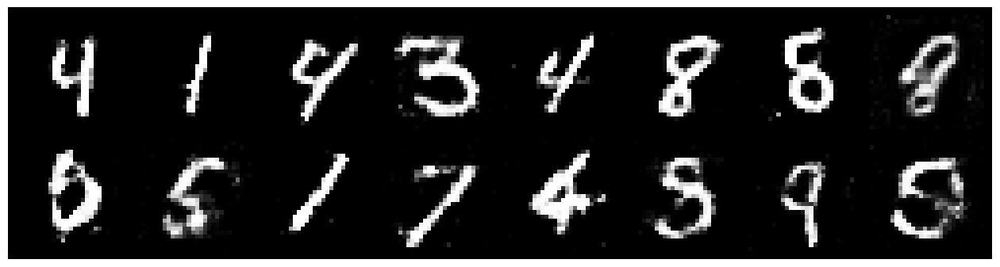

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.2265, Generator Loss: 0.9179
D(x): 0.5804, D(G(z)): 0.4388


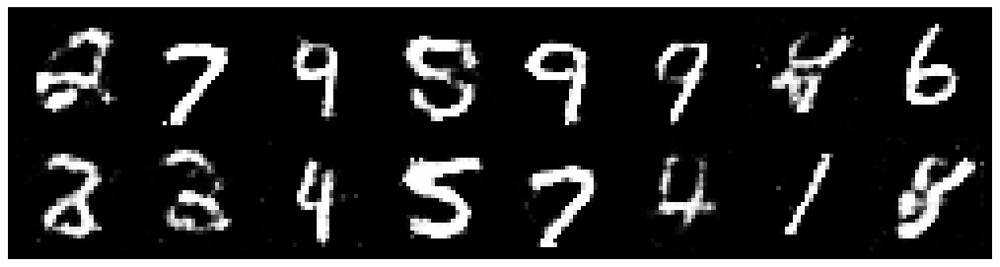

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.2727, Generator Loss: 0.8461
D(x): 0.5679, D(G(z)): 0.4780


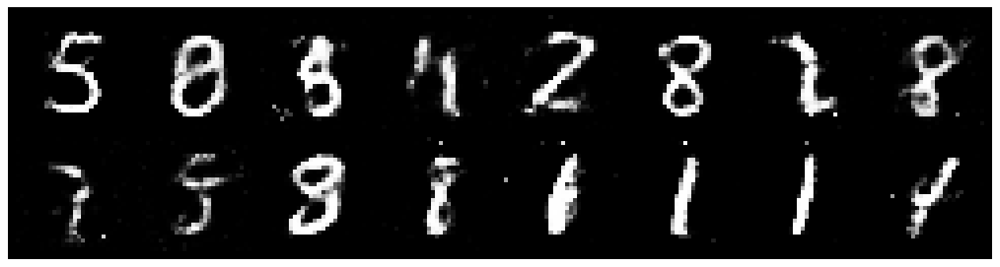

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.2129, Generator Loss: 0.9343
D(x): 0.5528, D(G(z)): 0.4137


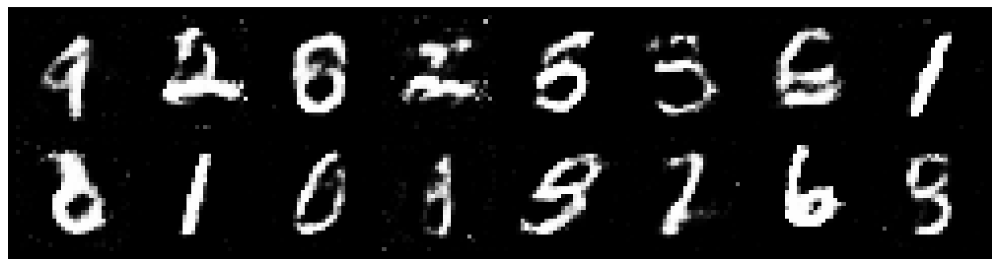

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2430, Generator Loss: 0.9525
D(x): 0.5430, D(G(z)): 0.4270


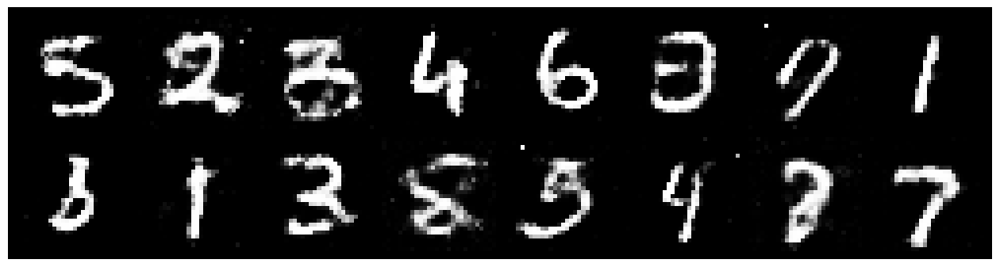

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.1360, Generator Loss: 0.9989
D(x): 0.5634, D(G(z)): 0.3828


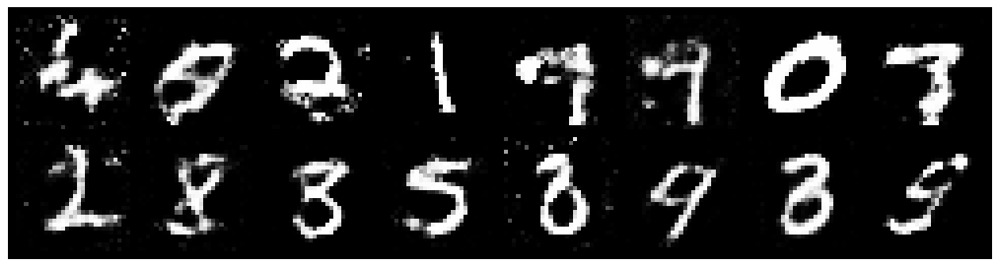

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.1650, Generator Loss: 1.0513
D(x): 0.5866, D(G(z)): 0.4029


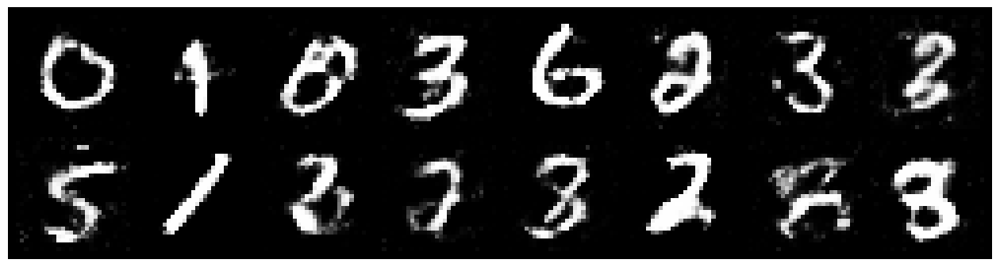

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.1719, Generator Loss: 1.1866
D(x): 0.5558, D(G(z)): 0.3786


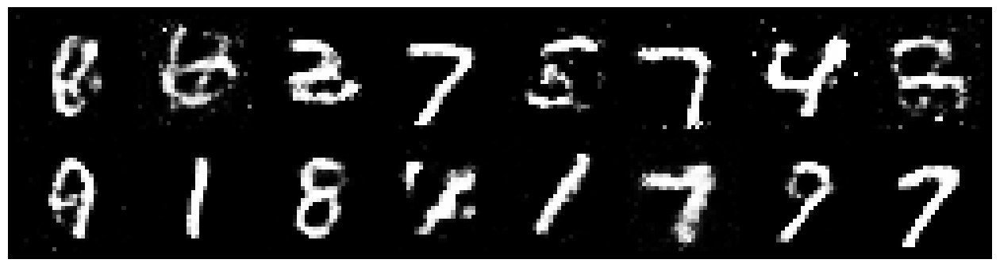

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.3489, Generator Loss: 0.8464
D(x): 0.5376, D(G(z)): 0.4713


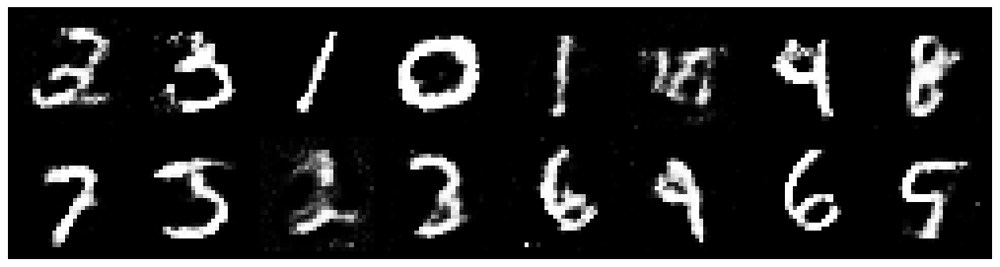

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2881, Generator Loss: 0.8468
D(x): 0.5249, D(G(z)): 0.4440


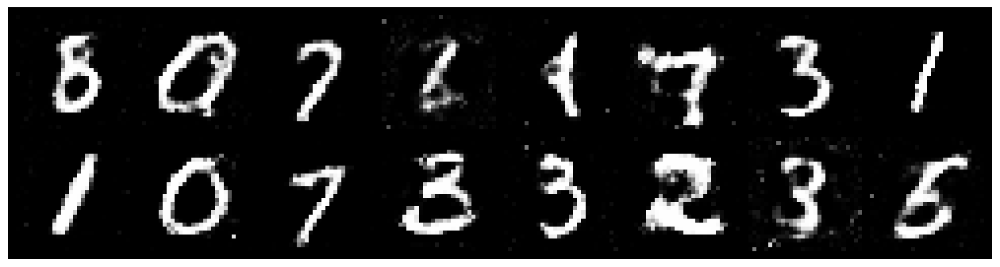

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2313, Generator Loss: 0.8704
D(x): 0.5711, D(G(z)): 0.4473


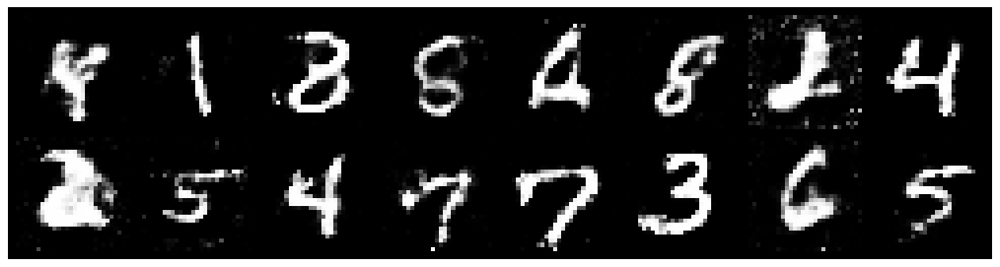

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.2809, Generator Loss: 0.9655
D(x): 0.5505, D(G(z)): 0.4346


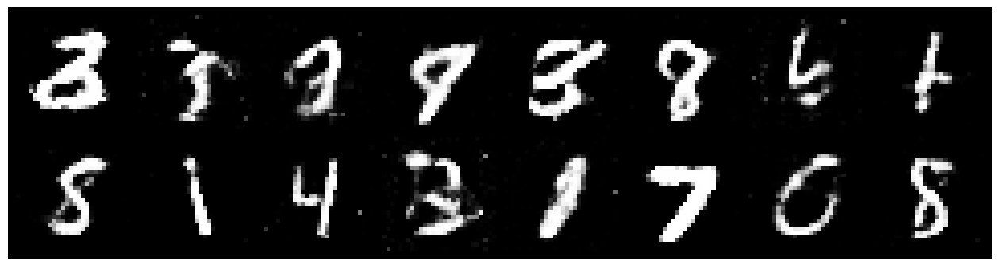

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2551, Generator Loss: 0.8437
D(x): 0.5755, D(G(z)): 0.4563


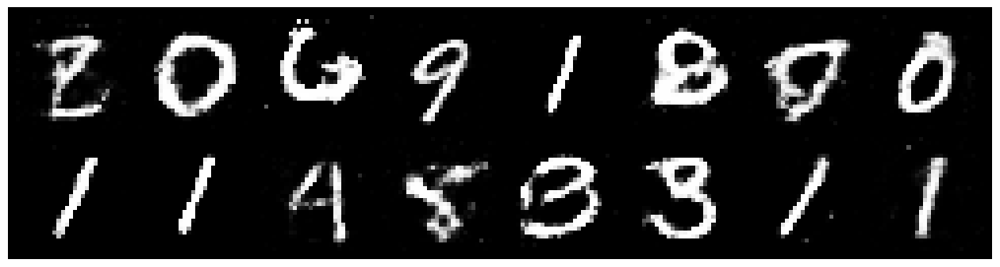

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.2563, Generator Loss: 0.9149
D(x): 0.5667, D(G(z)): 0.4417


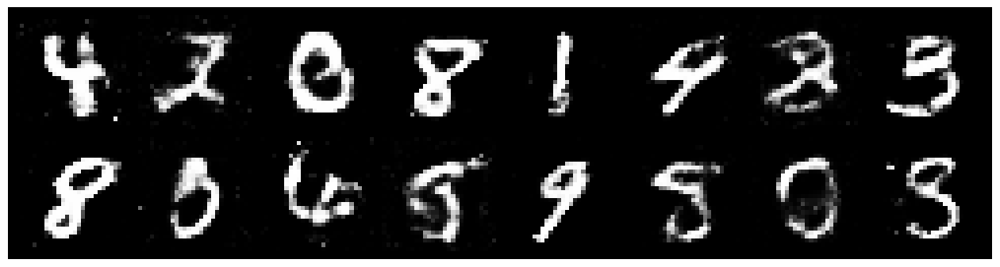

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2580, Generator Loss: 0.9023
D(x): 0.5098, D(G(z)): 0.3977


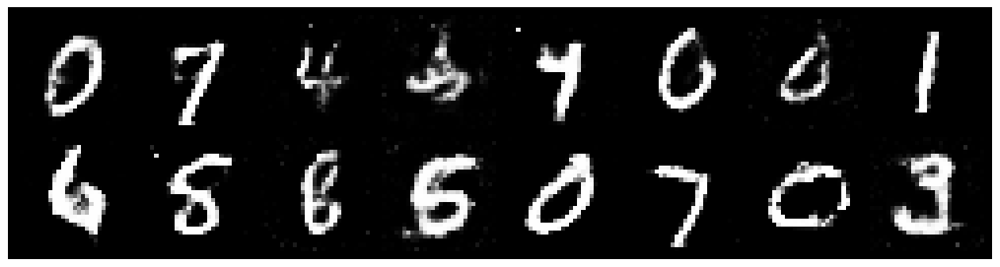

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.3017, Generator Loss: 0.8301
D(x): 0.5511, D(G(z)): 0.4532


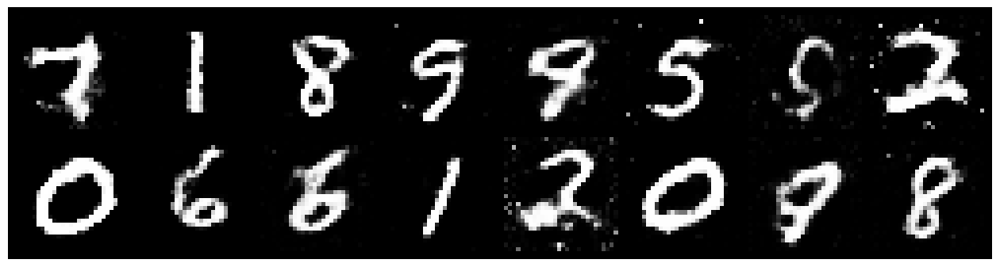

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.0602, Generator Loss: 1.1641
D(x): 0.6003, D(G(z)): 0.3611


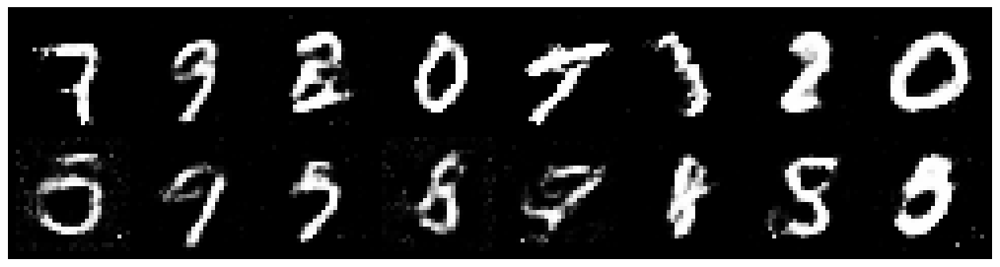

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2033, Generator Loss: 0.9507
D(x): 0.6285, D(G(z)): 0.4389


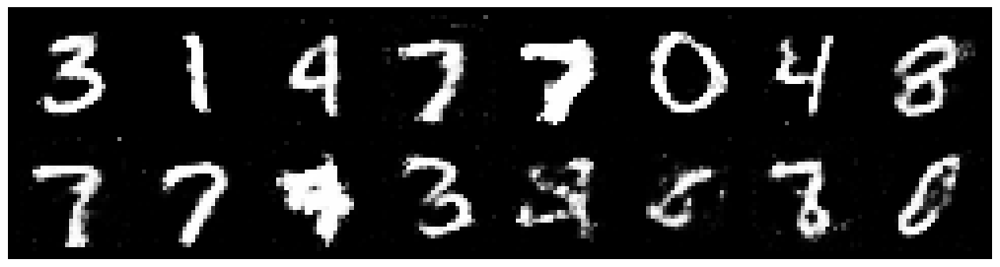

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.3106, Generator Loss: 0.8315
D(x): 0.5366, D(G(z)): 0.4539


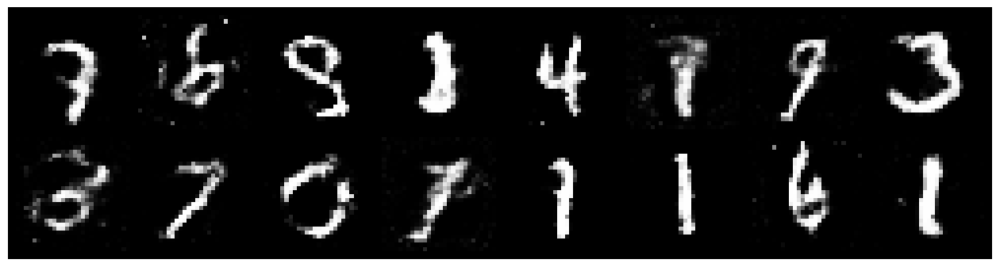

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.2507, Generator Loss: 0.9104
D(x): 0.5458, D(G(z)): 0.4251


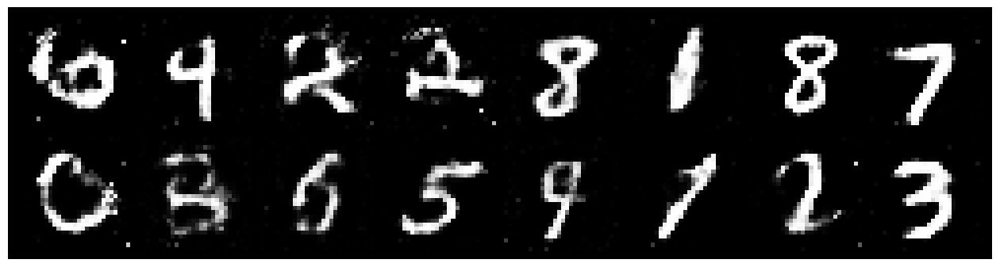

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.2364, Generator Loss: 1.0031
D(x): 0.5868, D(G(z)): 0.4267


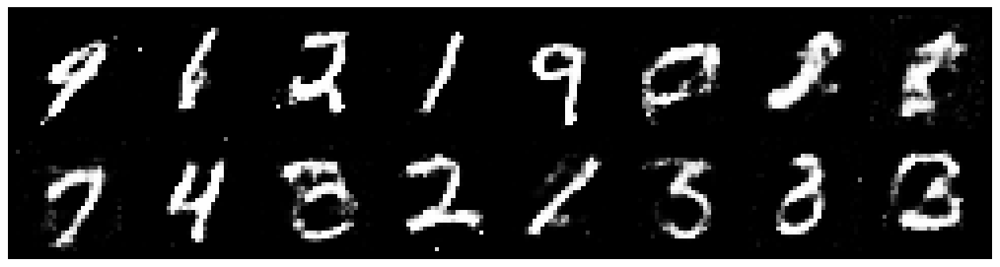

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.2684, Generator Loss: 1.0327
D(x): 0.5547, D(G(z)): 0.4091


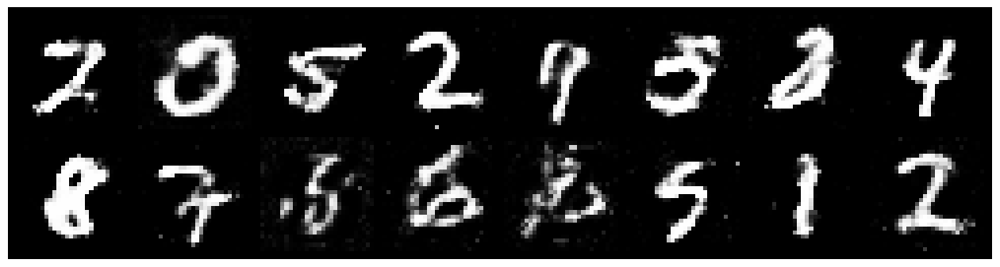

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.2603, Generator Loss: 0.9500
D(x): 0.5817, D(G(z)): 0.4434


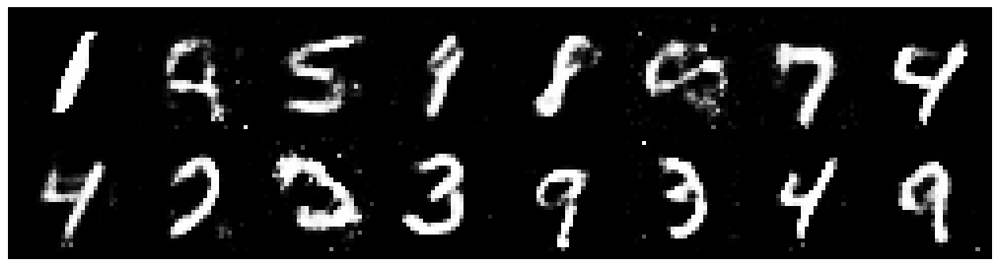

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.2600, Generator Loss: 0.9851
D(x): 0.5404, D(G(z)): 0.4005


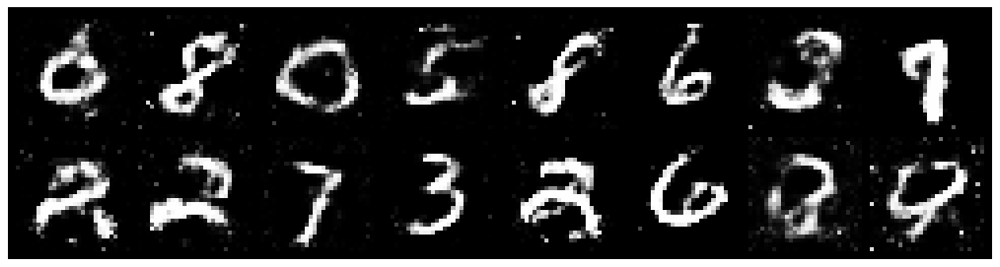

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.3060, Generator Loss: 0.9198
D(x): 0.5733, D(G(z)): 0.4469


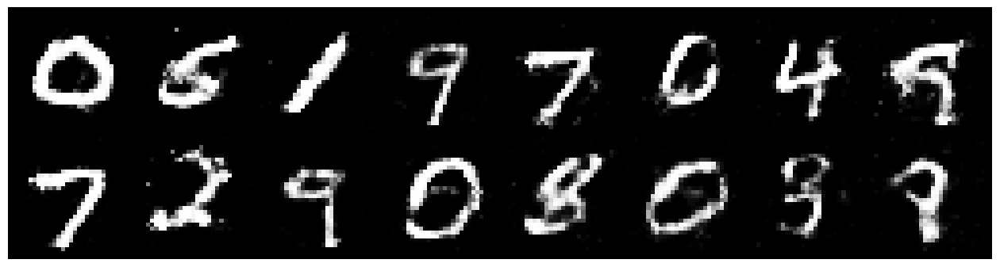

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.3201, Generator Loss: 0.7386
D(x): 0.5823, D(G(z)): 0.4927


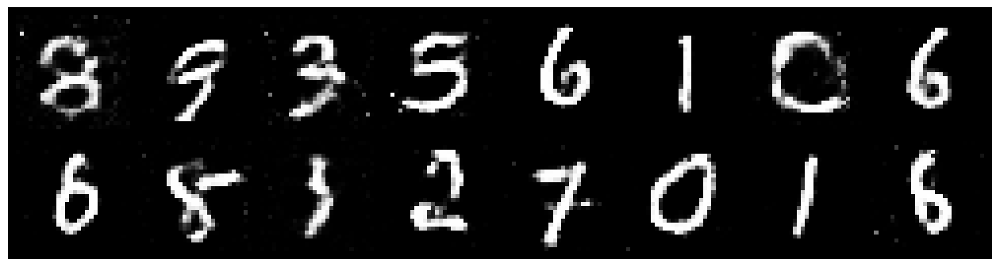

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.2584, Generator Loss: 1.0433
D(x): 0.5683, D(G(z)): 0.4172


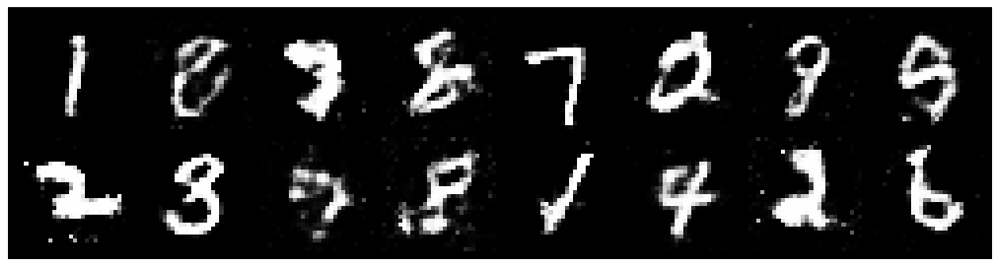

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.4175, Generator Loss: 0.8291
D(x): 0.5041, D(G(z)): 0.4537


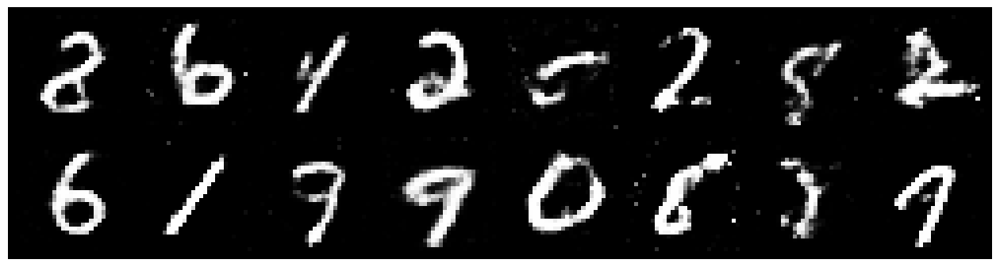

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.3387, Generator Loss: 0.9280
D(x): 0.5241, D(G(z)): 0.4363


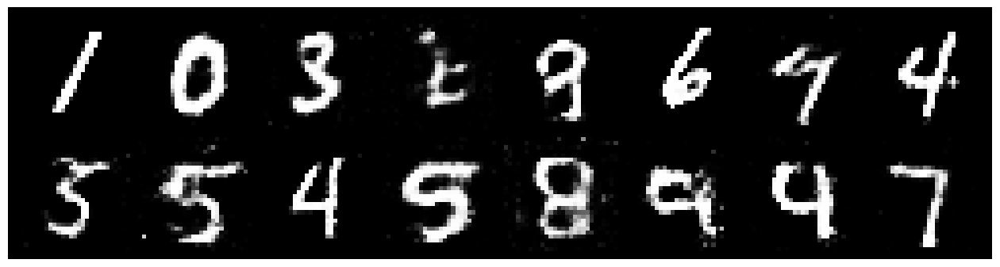

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2890, Generator Loss: 0.8926
D(x): 0.5651, D(G(z)): 0.4462


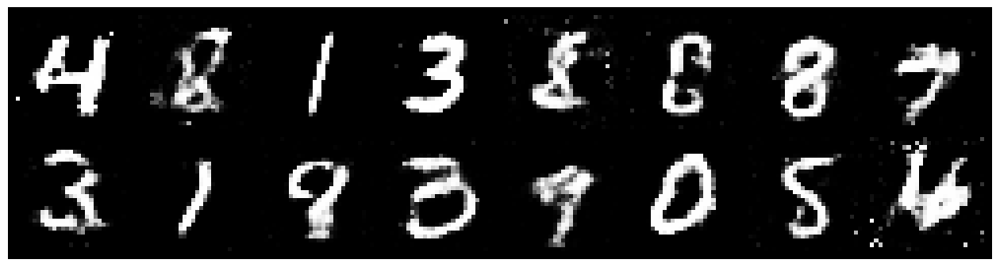

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.3798, Generator Loss: 0.8316
D(x): 0.5741, D(G(z)): 0.4875


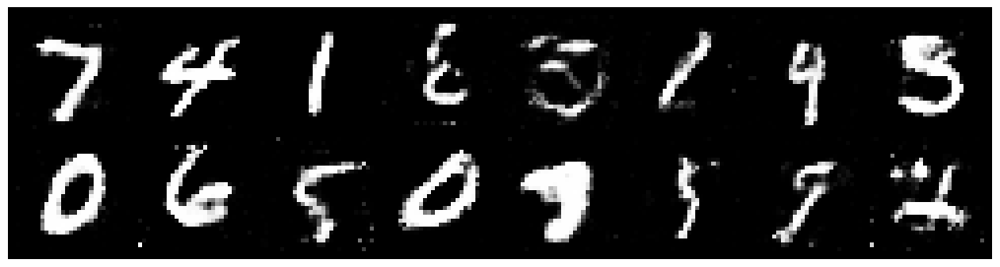

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.2469, Generator Loss: 1.0031
D(x): 0.5881, D(G(z)): 0.4359


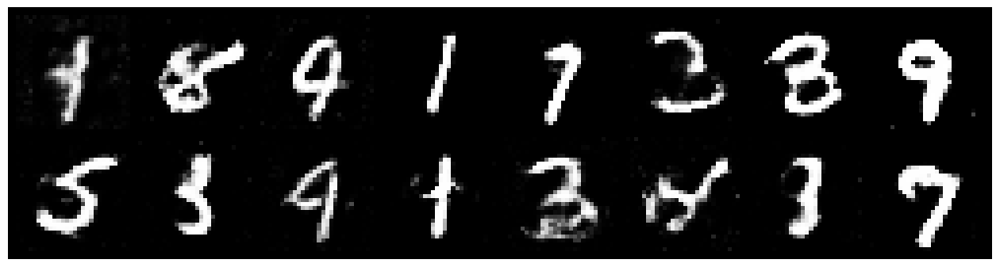

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.2178, Generator Loss: 1.1268
D(x): 0.5867, D(G(z)): 0.3945


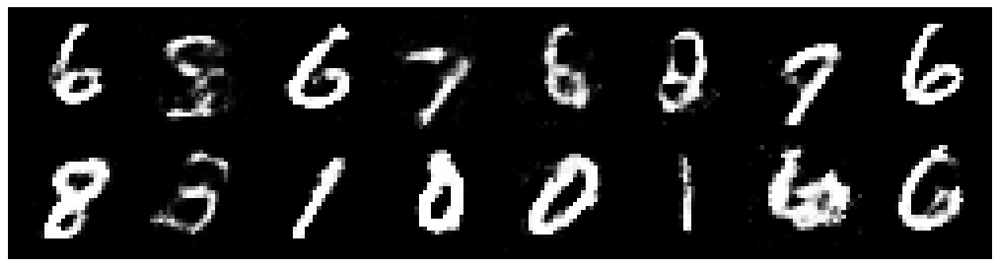

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.3225, Generator Loss: 0.9415
D(x): 0.5720, D(G(z)): 0.4481


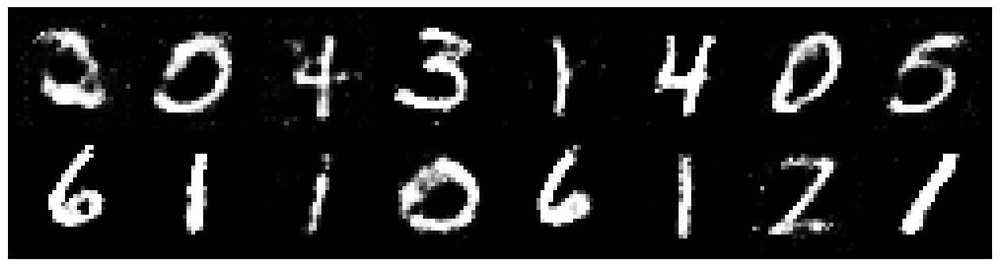

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3933, Generator Loss: 0.9510
D(x): 0.5111, D(G(z)): 0.4368


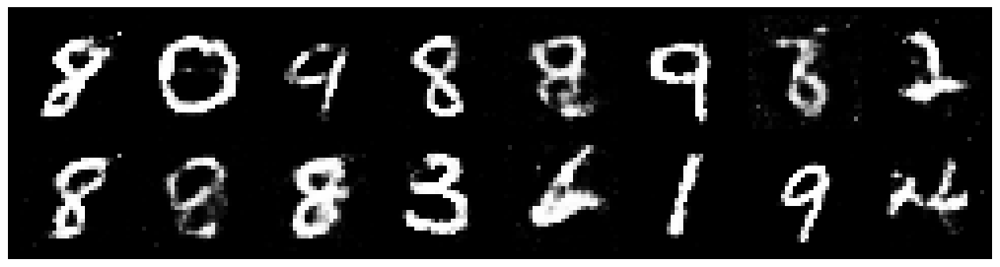

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.2127, Generator Loss: 1.0386
D(x): 0.5430, D(G(z)): 0.4054


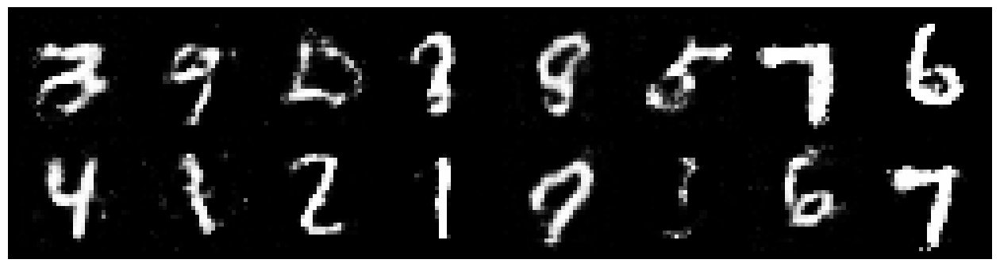

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.3503, Generator Loss: 0.7552
D(x): 0.5431, D(G(z)): 0.4909


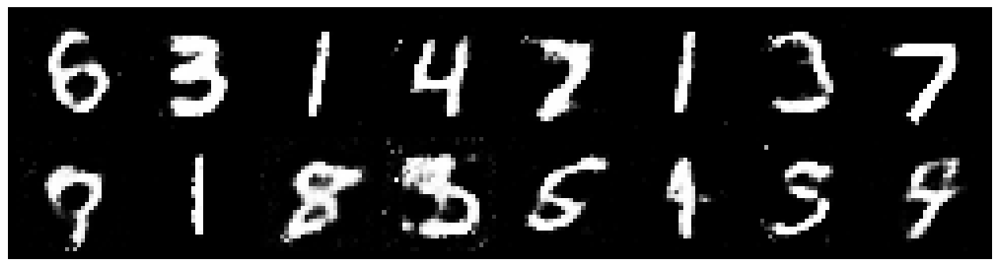

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2866, Generator Loss: 0.9432
D(x): 0.5550, D(G(z)): 0.4263


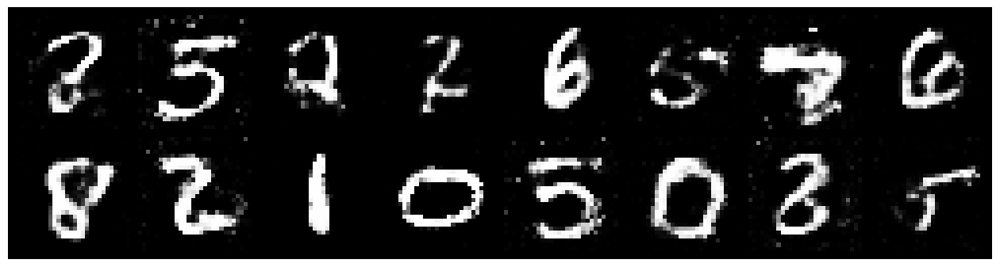

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.3194, Generator Loss: 0.8496
D(x): 0.5463, D(G(z)): 0.4646


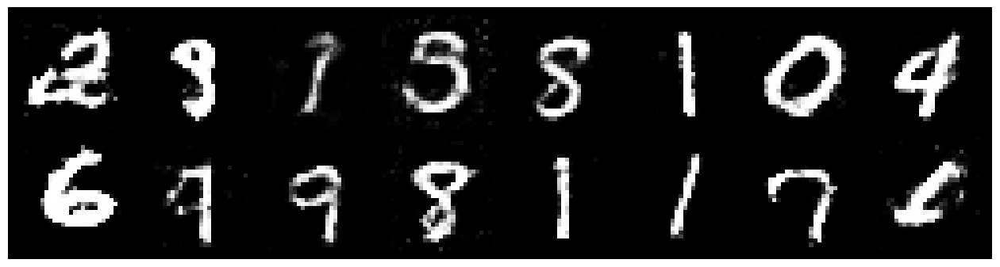

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.2753, Generator Loss: 0.8558
D(x): 0.5707, D(G(z)): 0.4420


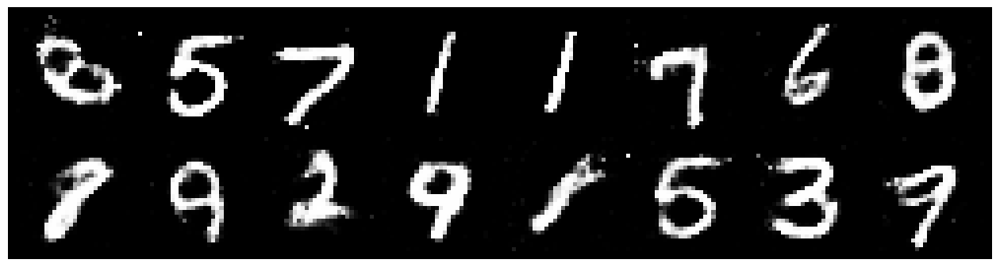

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.2194, Generator Loss: 0.8805
D(x): 0.5963, D(G(z)): 0.4551


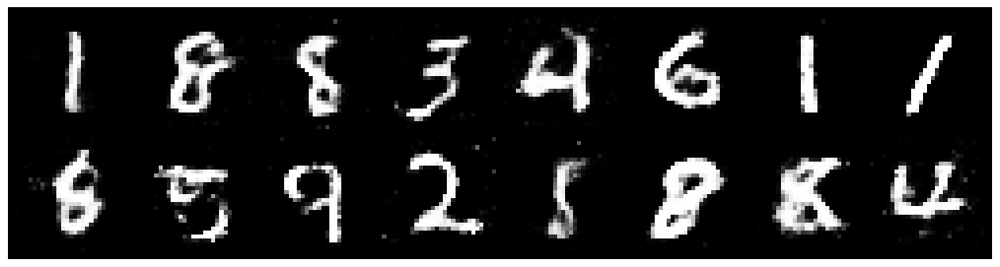

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2136, Generator Loss: 0.9919
D(x): 0.5989, D(G(z)): 0.4390


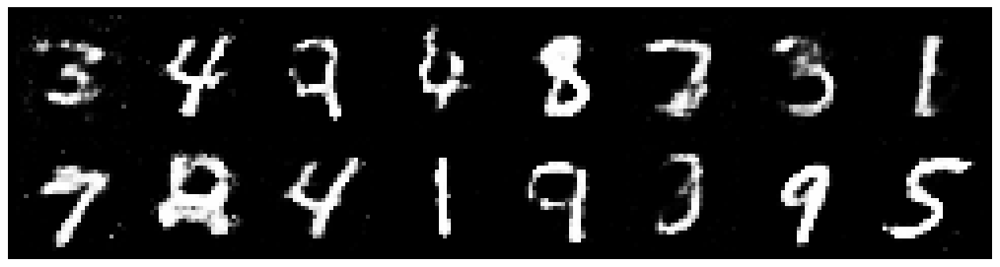

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.3237, Generator Loss: 1.0882
D(x): 0.5296, D(G(z)): 0.4272


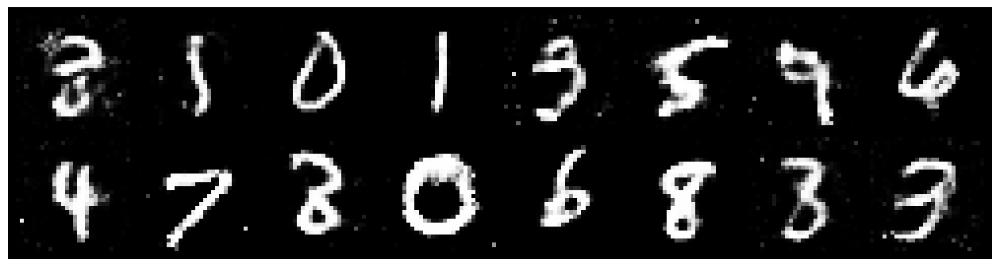

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.1669, Generator Loss: 0.8796
D(x): 0.6133, D(G(z)): 0.4382


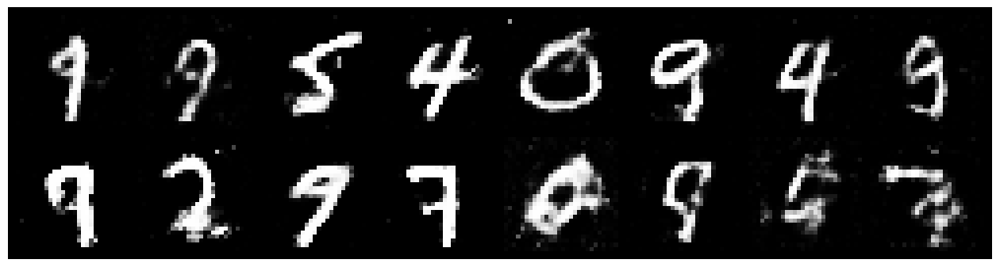

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.2411, Generator Loss: 0.8205
D(x): 0.6109, D(G(z)): 0.4686


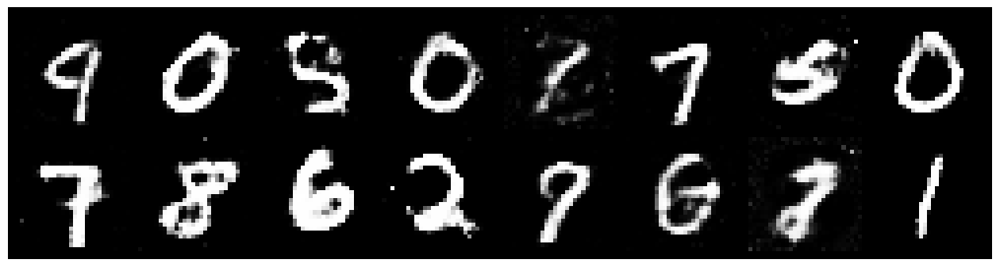

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.3018, Generator Loss: 0.9230
D(x): 0.5171, D(G(z)): 0.4280


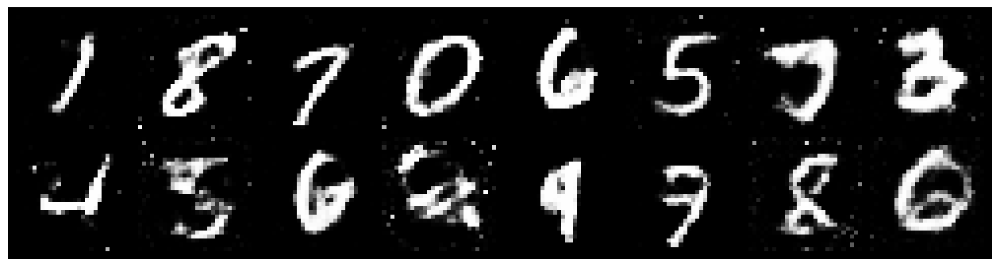

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.1536, Generator Loss: 0.9425
D(x): 0.5851, D(G(z)): 0.4207


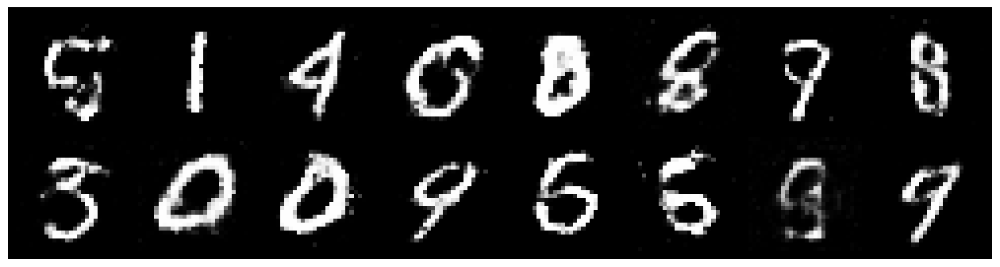

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2629, Generator Loss: 0.8224
D(x): 0.5438, D(G(z)): 0.4524


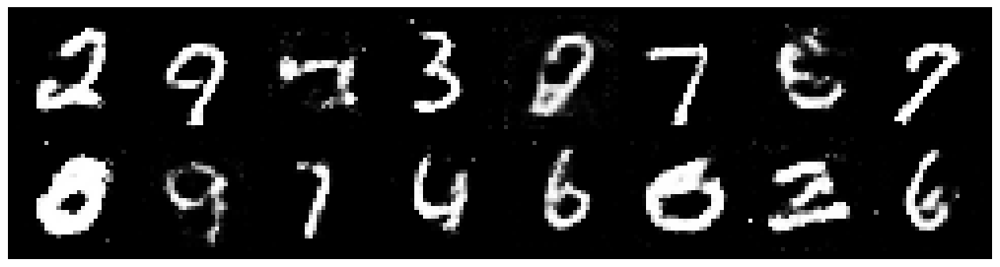

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.1514, Generator Loss: 0.9362
D(x): 0.5886, D(G(z)): 0.4226


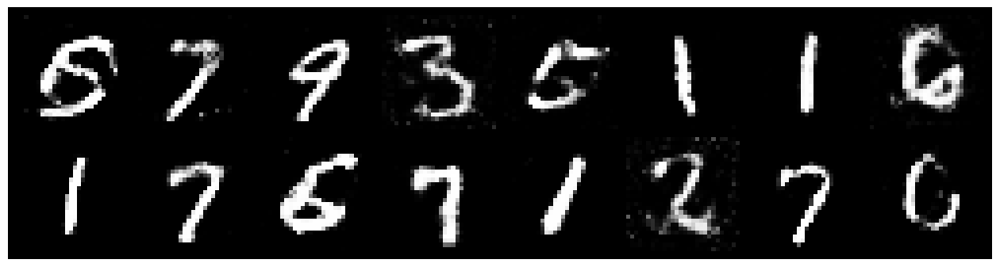

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2219, Generator Loss: 0.9148
D(x): 0.5550, D(G(z)): 0.4265


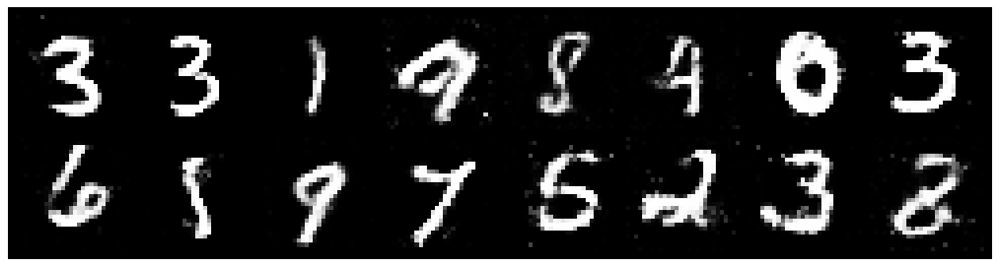

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.3274, Generator Loss: 0.8769
D(x): 0.5365, D(G(z)): 0.4595


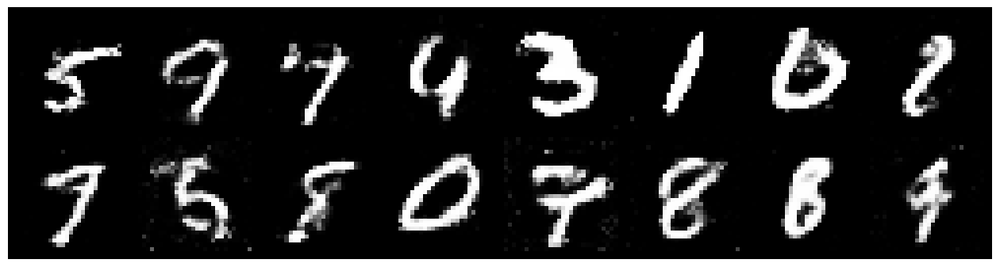

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.2374, Generator Loss: 0.8861
D(x): 0.5884, D(G(z)): 0.4462


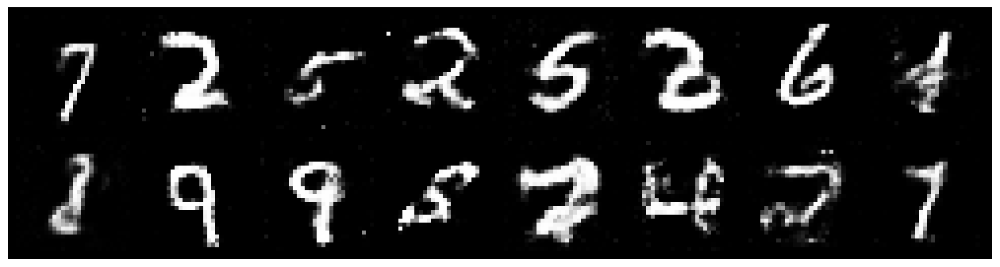

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2334, Generator Loss: 0.9008
D(x): 0.5778, D(G(z)): 0.4411


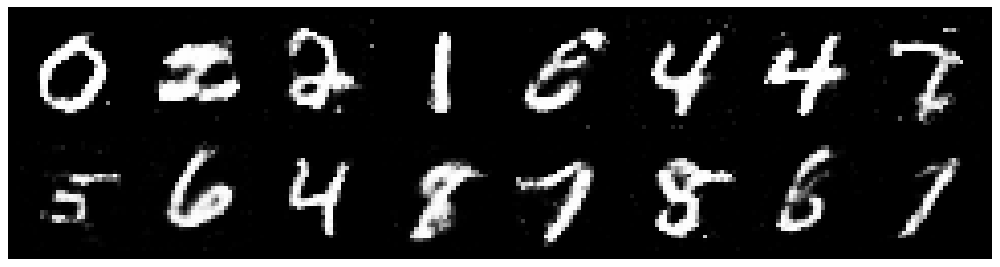

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.2573, Generator Loss: 0.9495
D(x): 0.5355, D(G(z)): 0.4092


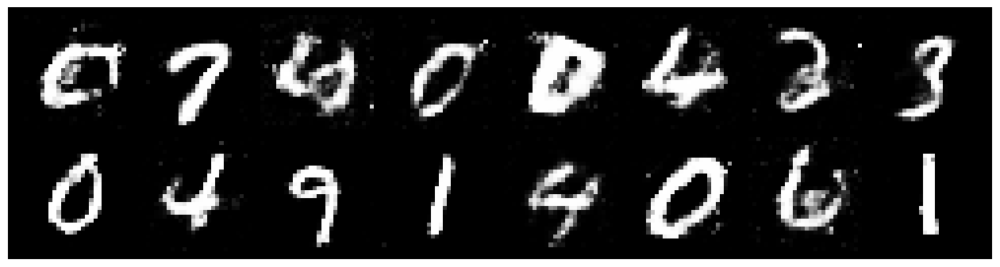

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.3447, Generator Loss: 0.8942
D(x): 0.5271, D(G(z)): 0.4505


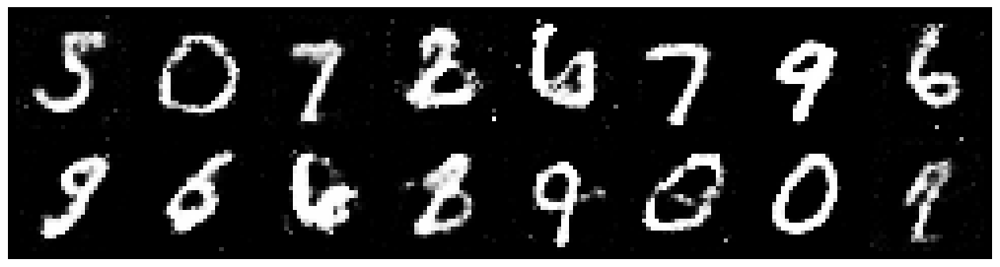

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.3518, Generator Loss: 0.7353
D(x): 0.5525, D(G(z)): 0.4944


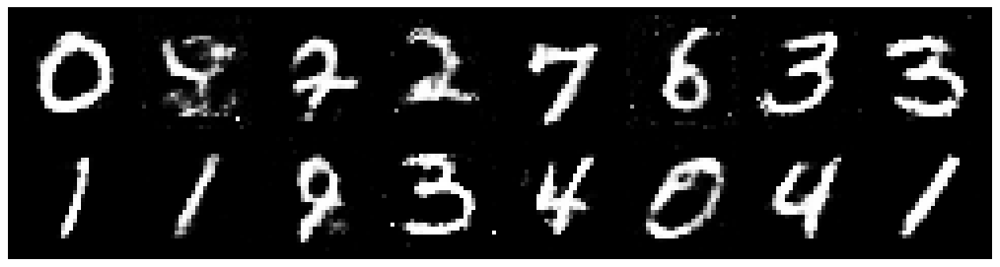

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.3221, Generator Loss: 0.8254
D(x): 0.5659, D(G(z)): 0.4758


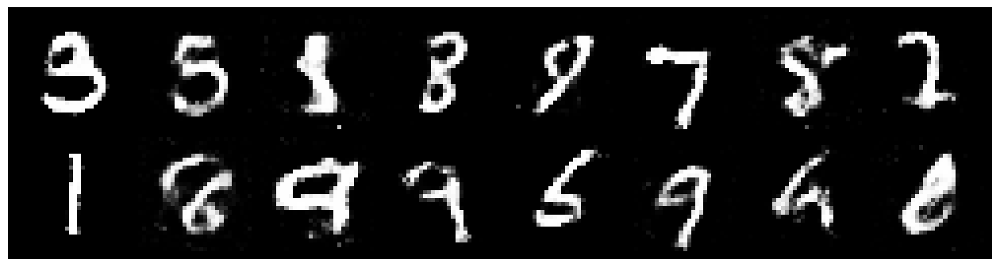

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.2613, Generator Loss: 0.9640
D(x): 0.5550, D(G(z)): 0.4389


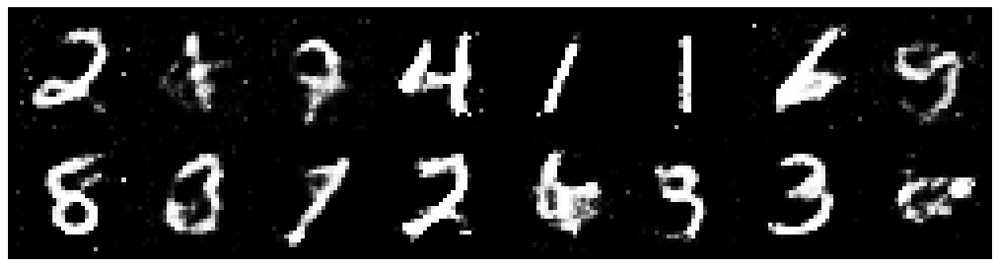

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.1801, Generator Loss: 0.8784
D(x): 0.5674, D(G(z)): 0.4133


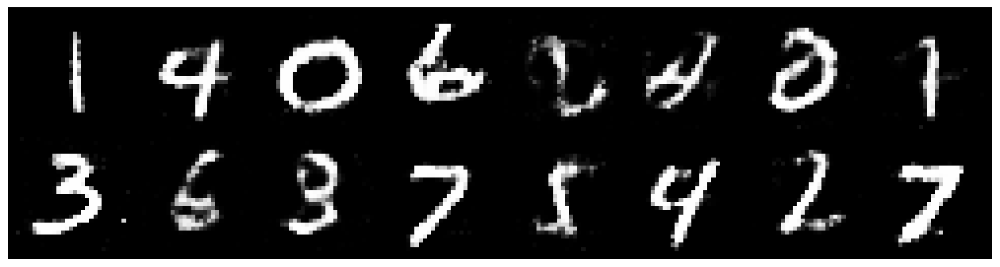

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.1558, Generator Loss: 0.9334
D(x): 0.5663, D(G(z)): 0.4002


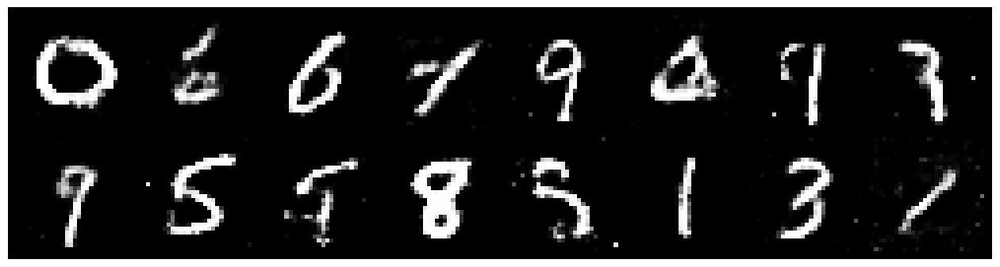

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.2928, Generator Loss: 0.8962
D(x): 0.5428, D(G(z)): 0.4462


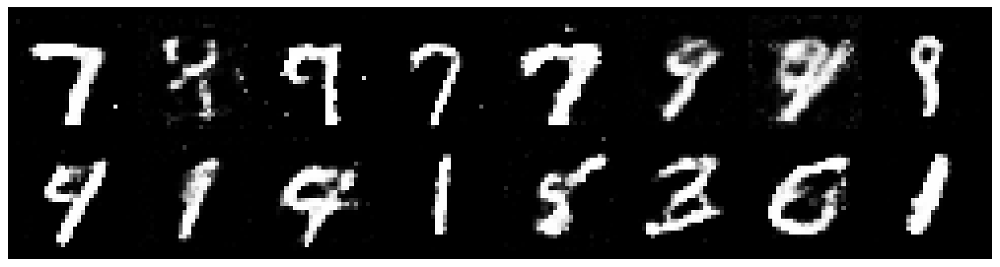

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.1297, Generator Loss: 0.8106
D(x): 0.6261, D(G(z)): 0.4495


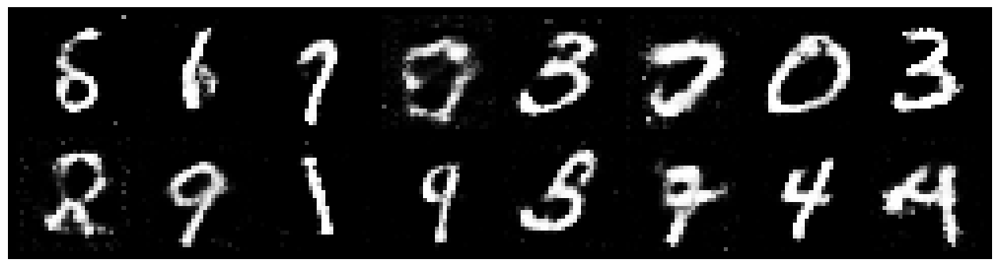

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.2500, Generator Loss: 0.9053
D(x): 0.5724, D(G(z)): 0.4564


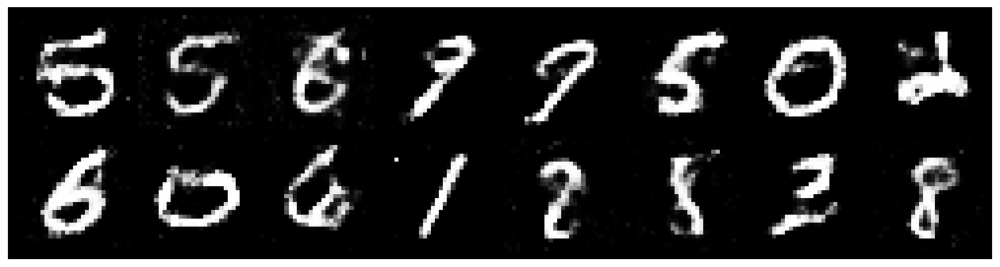

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.3268, Generator Loss: 0.7271
D(x): 0.5064, D(G(z)): 0.4500


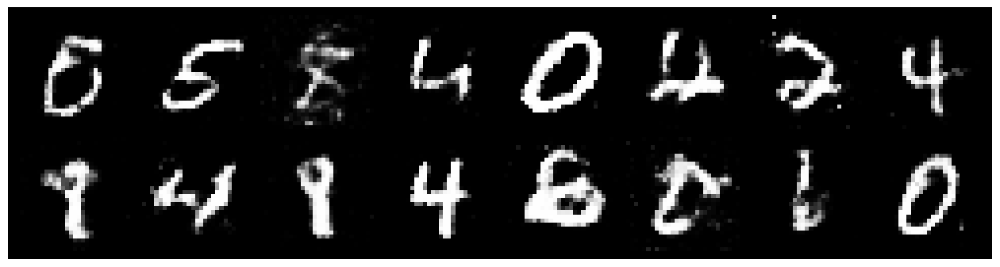

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.2109, Generator Loss: 0.9580
D(x): 0.5774, D(G(z)): 0.4351


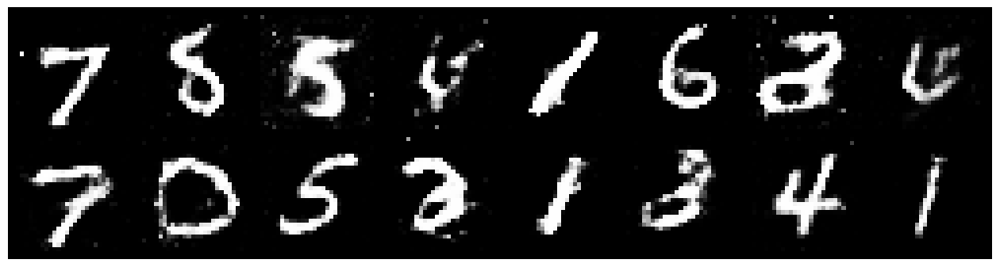

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.2245, Generator Loss: 1.0140
D(x): 0.5962, D(G(z)): 0.4413


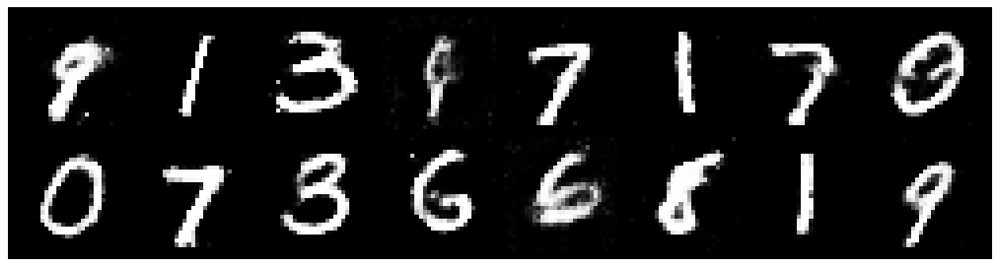

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.2014, Generator Loss: 1.0762
D(x): 0.6006, D(G(z)): 0.4323


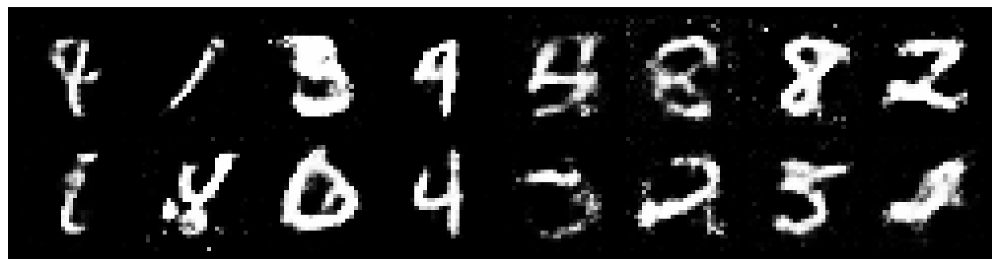

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.2306, Generator Loss: 0.9903
D(x): 0.5727, D(G(z)): 0.4138


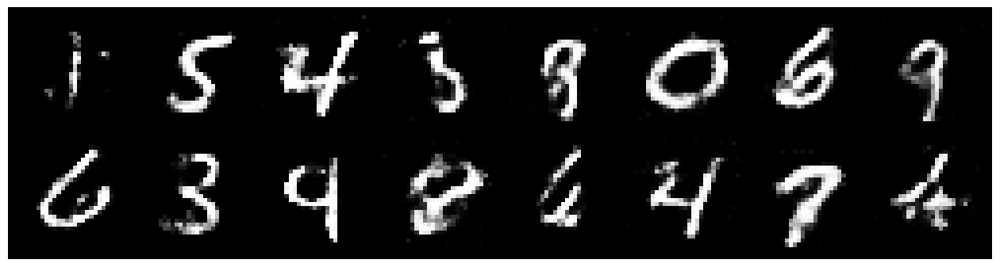

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.1873, Generator Loss: 0.9935
D(x): 0.5934, D(G(z)): 0.4288


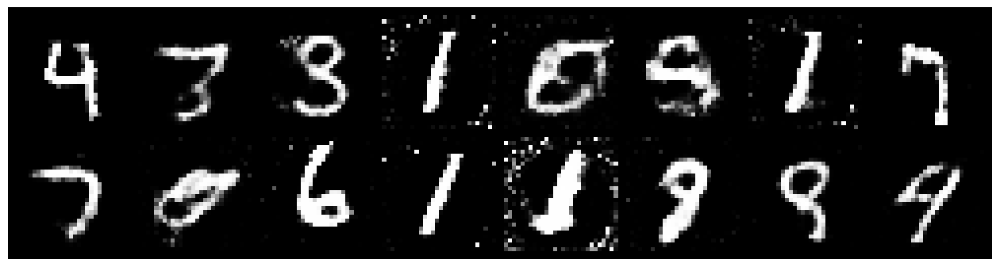

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.3338, Generator Loss: 0.9547
D(x): 0.5456, D(G(z)): 0.4488


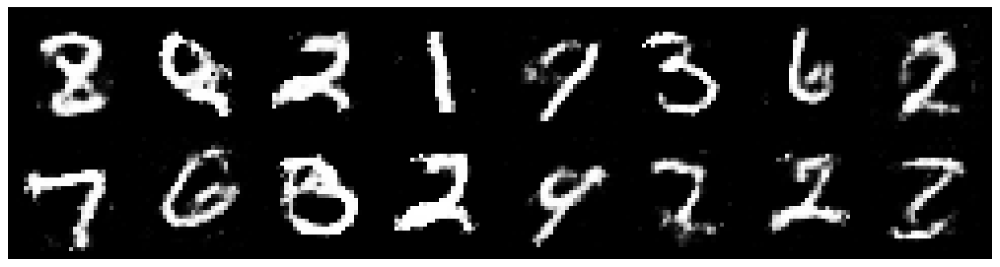

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.3656, Generator Loss: 0.7975
D(x): 0.5550, D(G(z)): 0.4884


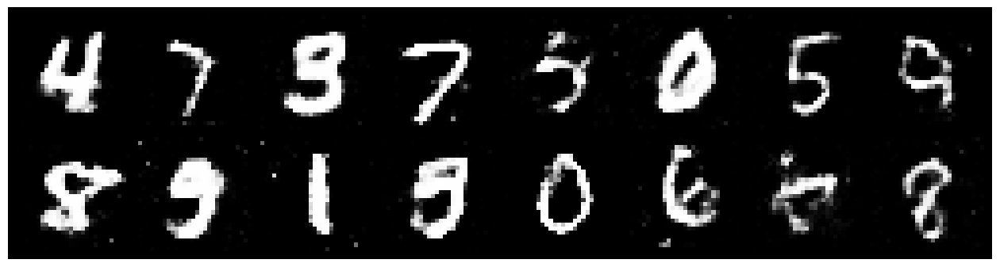

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.2901, Generator Loss: 0.8546
D(x): 0.5381, D(G(z)): 0.4268


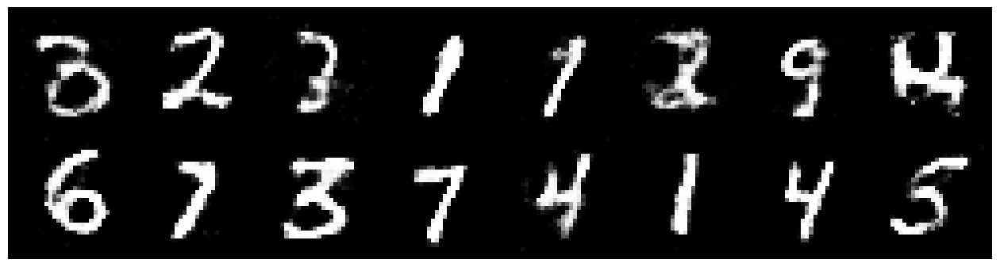

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.2926, Generator Loss: 0.8649
D(x): 0.5355, D(G(z)): 0.4479


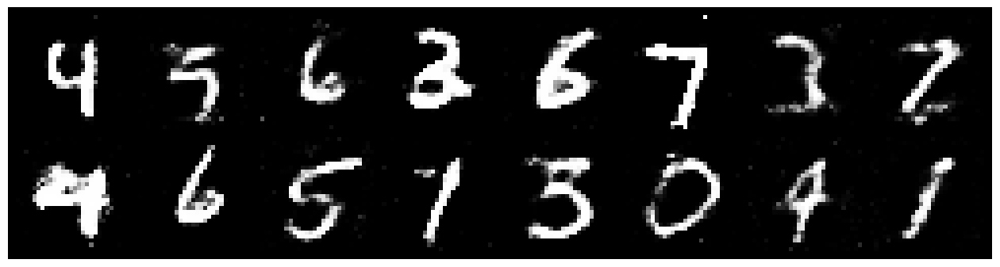

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.3381, Generator Loss: 0.8583
D(x): 0.6060, D(G(z)): 0.4924


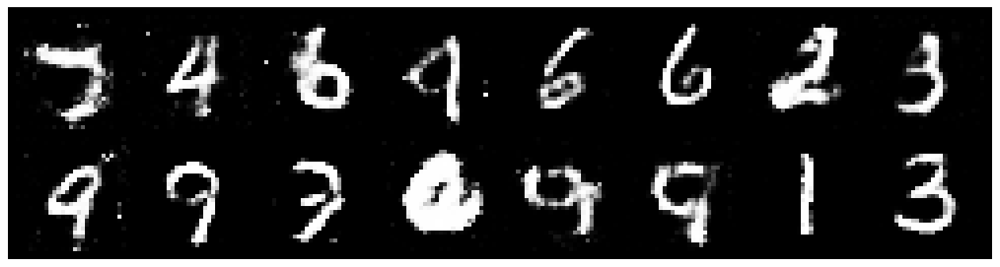

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.3249, Generator Loss: 0.9365
D(x): 0.5358, D(G(z)): 0.4351


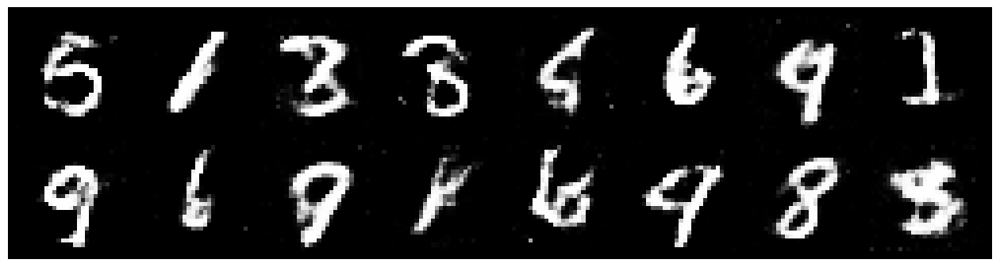

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2573, Generator Loss: 0.8596
D(x): 0.5561, D(G(z)): 0.4480


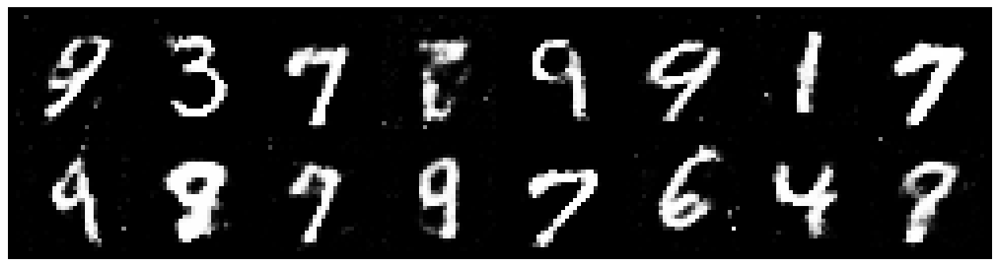

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.2596, Generator Loss: 0.9341
D(x): 0.5656, D(G(z)): 0.4460


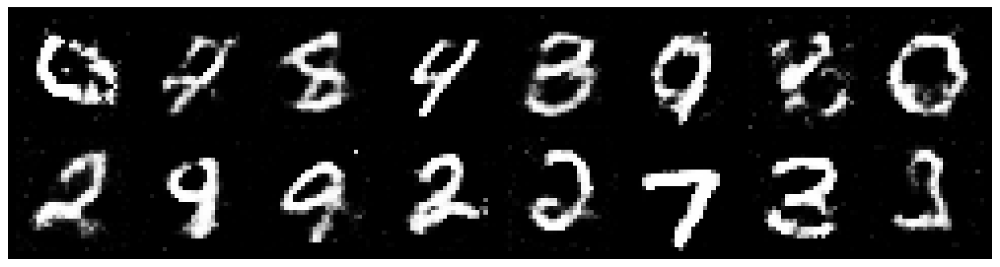

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.2722, Generator Loss: 0.8165
D(x): 0.5535, D(G(z)): 0.4321


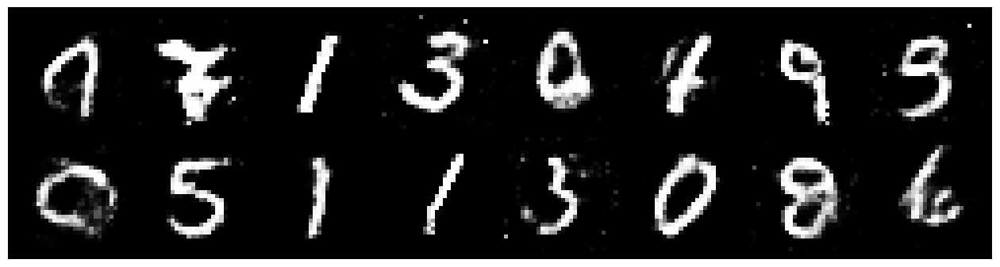

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.2898, Generator Loss: 0.8359
D(x): 0.5339, D(G(z)): 0.4494


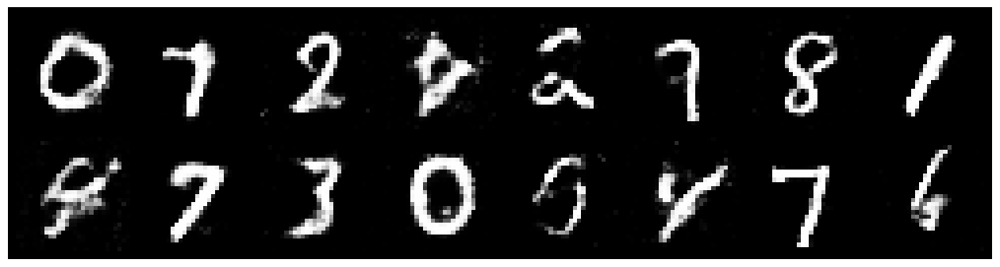

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.2152, Generator Loss: 0.8812
D(x): 0.5509, D(G(z)): 0.4275


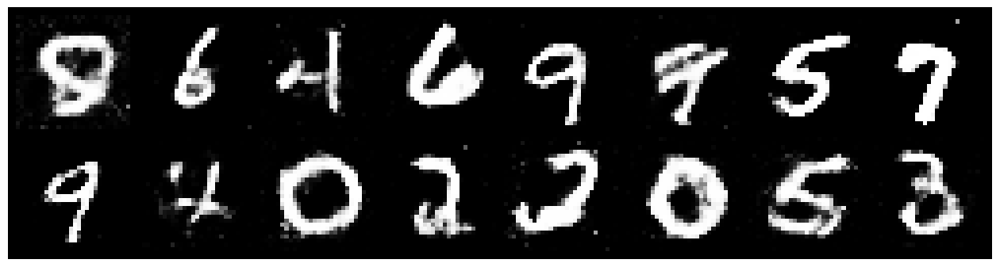

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.3370, Generator Loss: 0.8390
D(x): 0.5482, D(G(z)): 0.4700


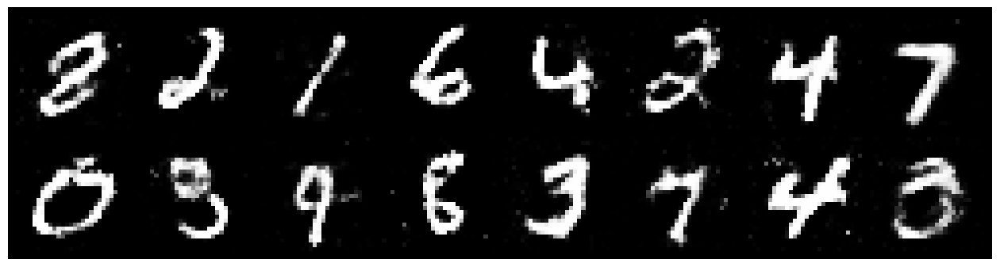

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.4191, Generator Loss: 0.7743
D(x): 0.5197, D(G(z)): 0.4953


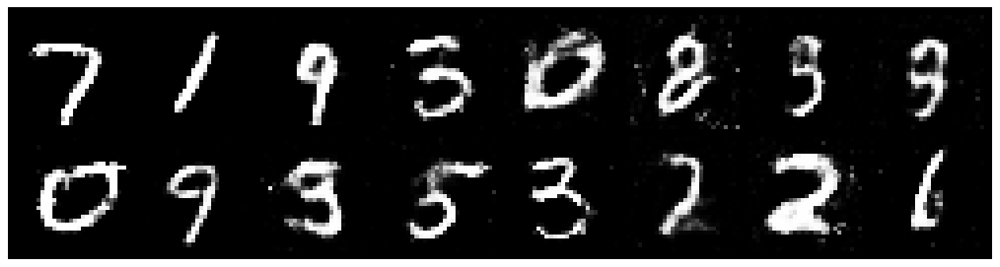

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.4871, Generator Loss: 0.7292
D(x): 0.5012, D(G(z)): 0.4838


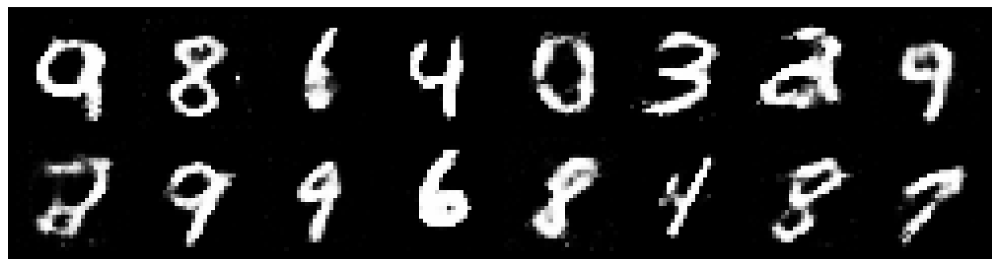

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.3313, Generator Loss: 0.7867
D(x): 0.5476, D(G(z)): 0.4694


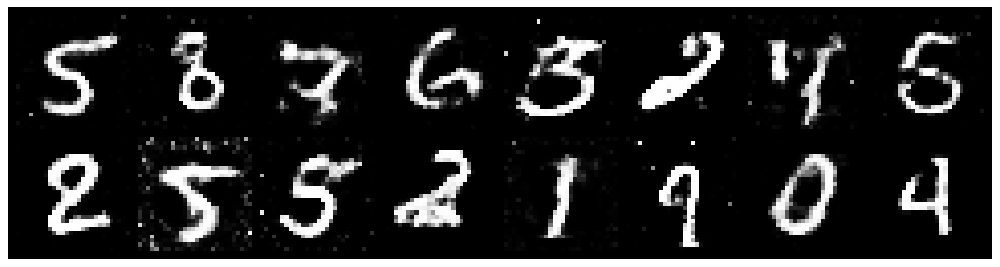

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.3812, Generator Loss: 0.8343
D(x): 0.5402, D(G(z)): 0.4979


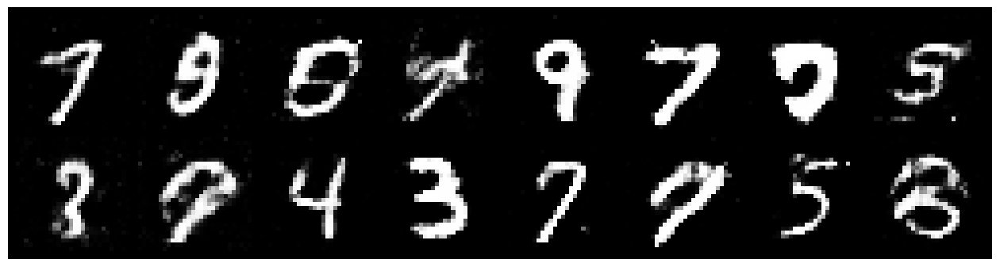

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2811, Generator Loss: 0.9321
D(x): 0.5147, D(G(z)): 0.4273


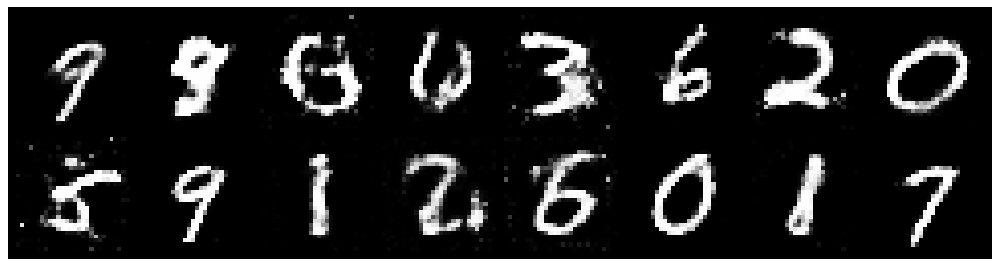

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2606, Generator Loss: 0.9268
D(x): 0.5542, D(G(z)): 0.4338


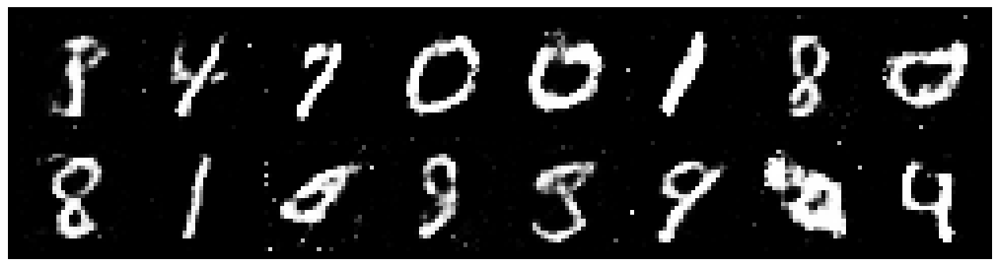

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.1991, Generator Loss: 0.8934
D(x): 0.5691, D(G(z)): 0.4182


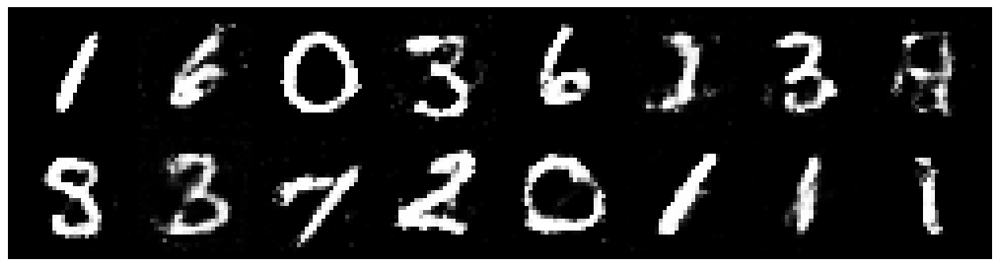

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.3404, Generator Loss: 0.9824
D(x): 0.5331, D(G(z)): 0.4154


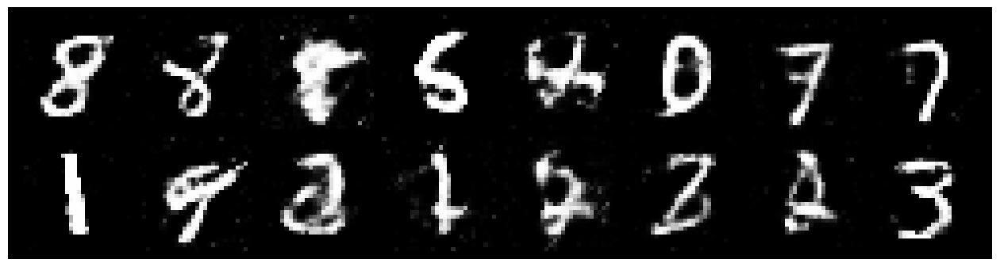

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.1664, Generator Loss: 1.0339
D(x): 0.5649, D(G(z)): 0.3859


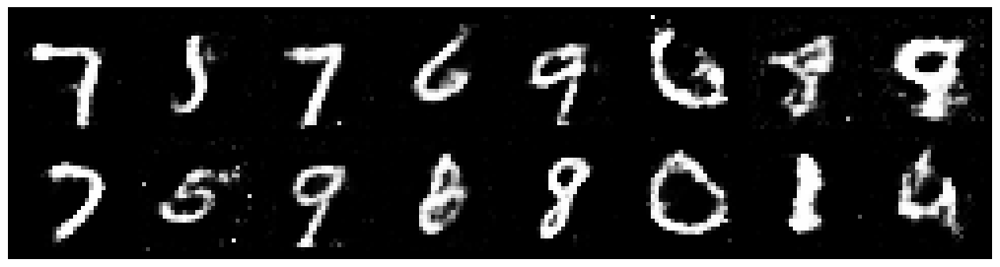

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2479, Generator Loss: 0.9369
D(x): 0.5627, D(G(z)): 0.4321


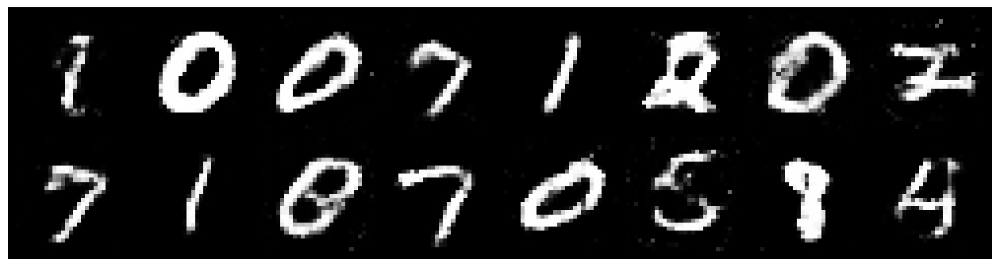

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.2444, Generator Loss: 0.9957
D(x): 0.5687, D(G(z)): 0.4165


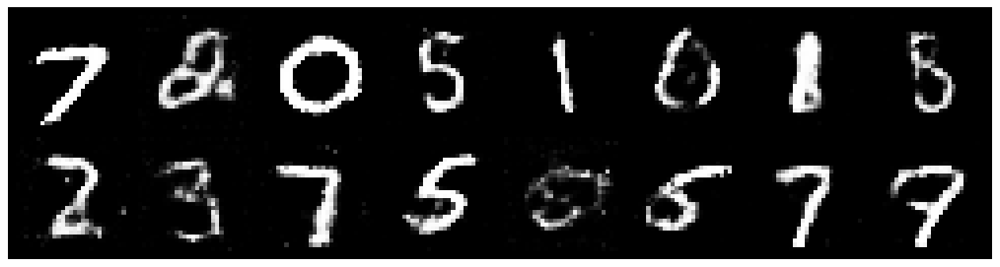

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.3276, Generator Loss: 0.7515
D(x): 0.5406, D(G(z)): 0.4852


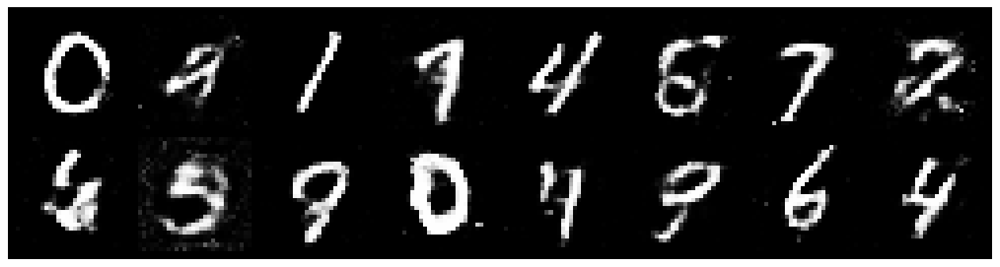

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.3943, Generator Loss: 0.7941
D(x): 0.5394, D(G(z)): 0.4882


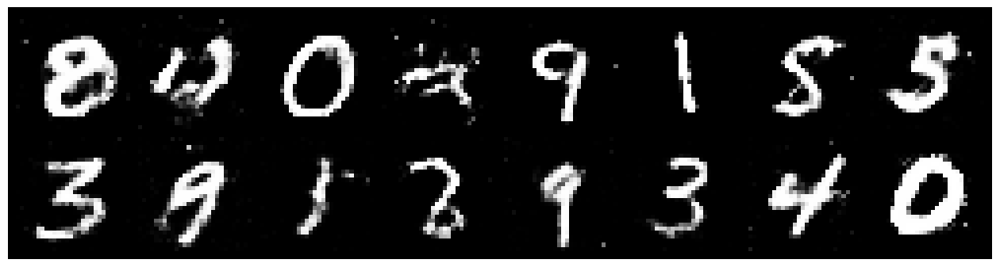

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.3782, Generator Loss: 0.7800
D(x): 0.5433, D(G(z)): 0.4924


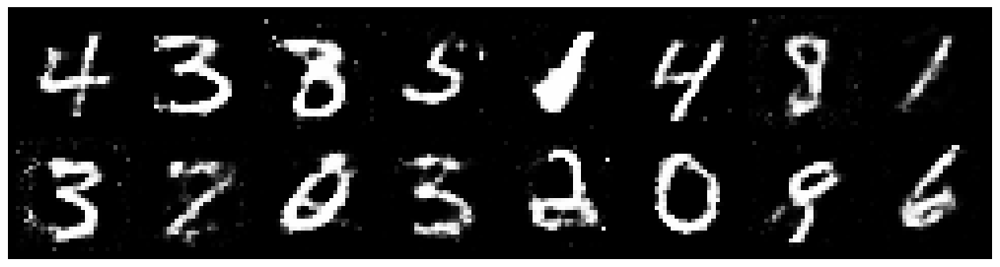

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.1728, Generator Loss: 0.8699
D(x): 0.5998, D(G(z)): 0.4470


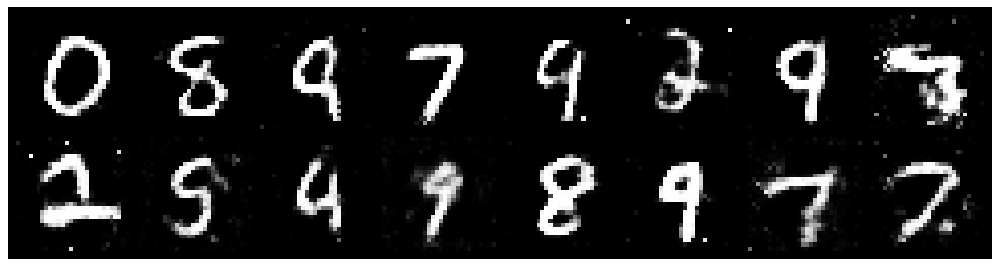

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.2096, Generator Loss: 1.1841
D(x): 0.5293, D(G(z)): 0.3745


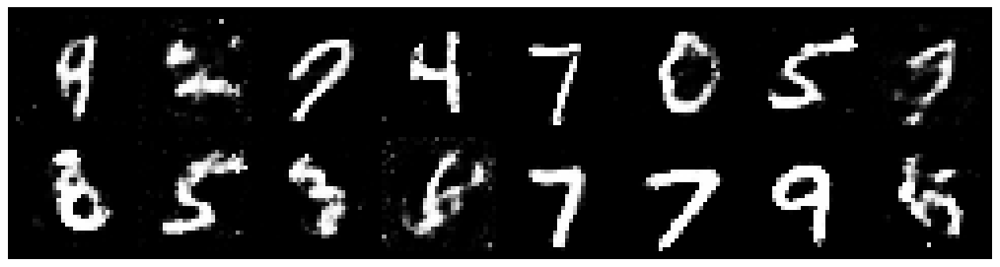

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.2352, Generator Loss: 0.8645
D(x): 0.5727, D(G(z)): 0.4502


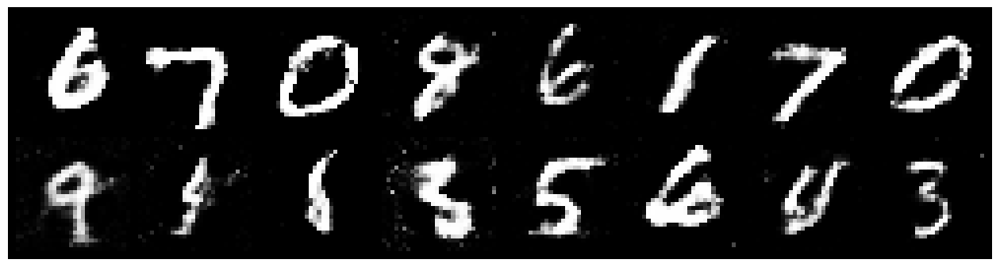

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.2270, Generator Loss: 1.0488
D(x): 0.5618, D(G(z)): 0.4285


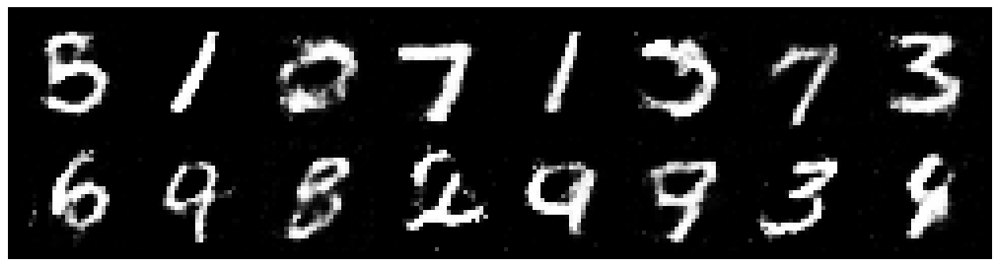

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.0913, Generator Loss: 1.0106
D(x): 0.6228, D(G(z)): 0.4123


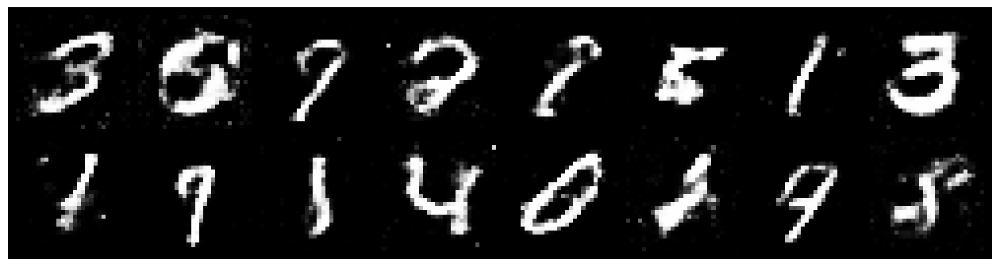

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.2424, Generator Loss: 0.8588
D(x): 0.5613, D(G(z)): 0.4360


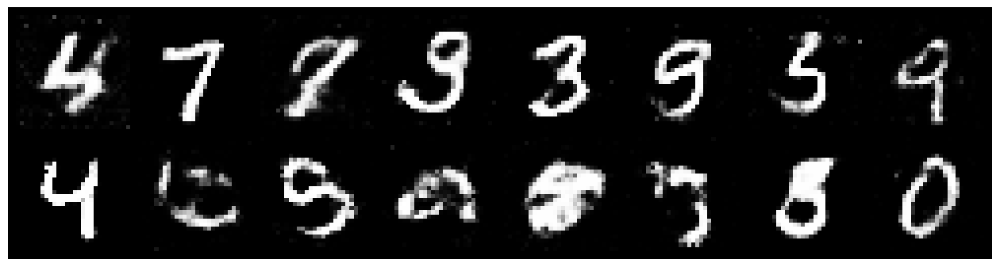

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.2335, Generator Loss: 0.9227
D(x): 0.5624, D(G(z)): 0.4219


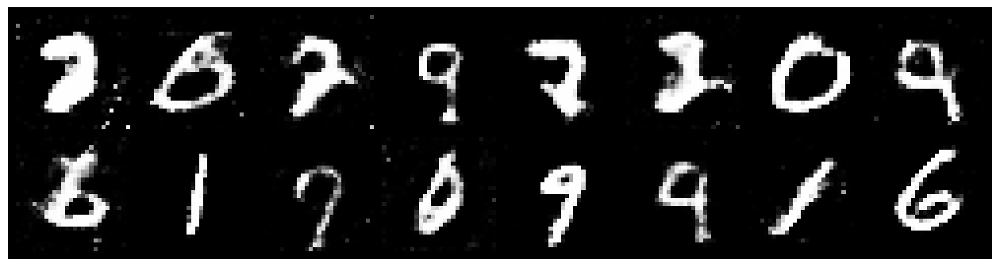

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.2167, Generator Loss: 0.9328
D(x): 0.5420, D(G(z)): 0.4177


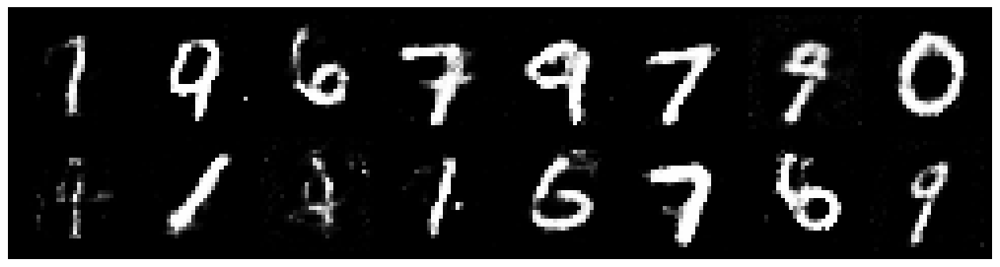

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.3109, Generator Loss: 0.9749
D(x): 0.5448, D(G(z)): 0.4503


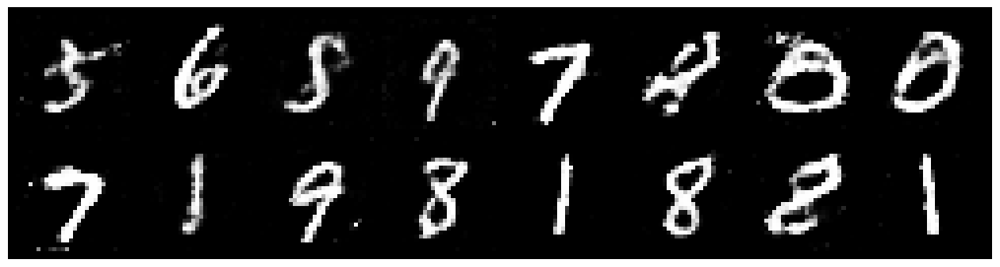

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.2334, Generator Loss: 0.8681
D(x): 0.5677, D(G(z)): 0.4495


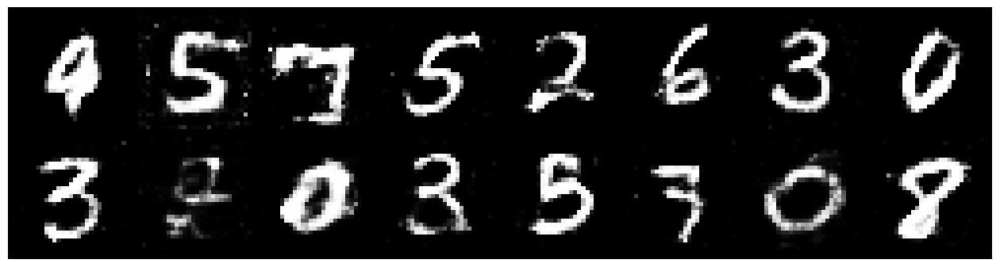

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2795, Generator Loss: 0.8855
D(x): 0.5394, D(G(z)): 0.4416


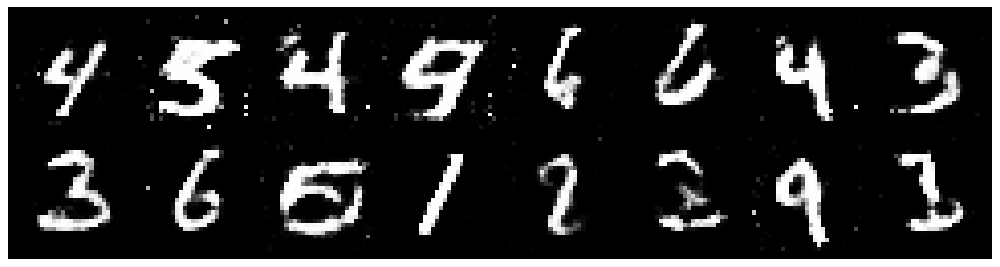

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.3085, Generator Loss: 0.7762
D(x): 0.5496, D(G(z)): 0.4520


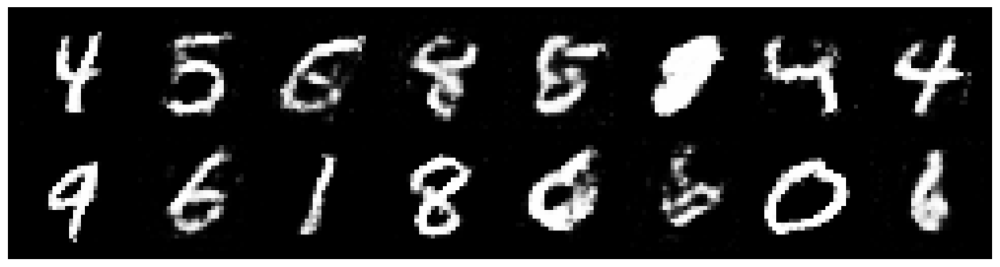

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.1557, Generator Loss: 0.8676
D(x): 0.5765, D(G(z)): 0.3958


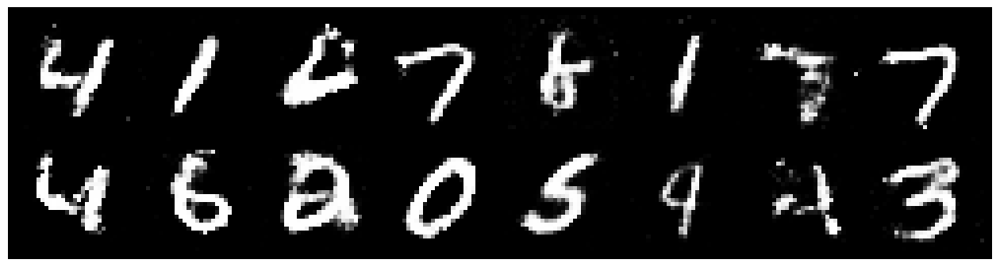

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.3018, Generator Loss: 0.9067
D(x): 0.5259, D(G(z)): 0.4415


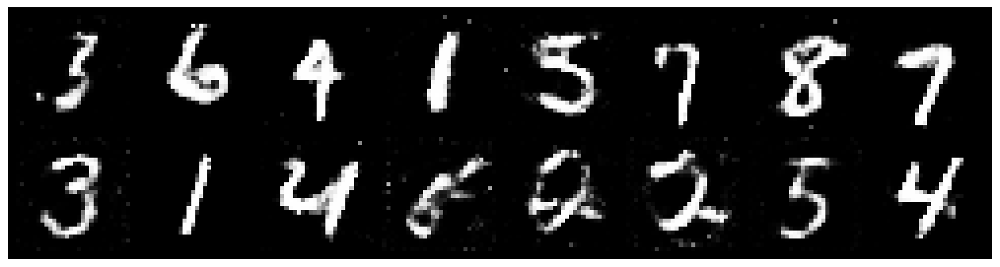

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.3821, Generator Loss: 0.8564
D(x): 0.5440, D(G(z)): 0.4856


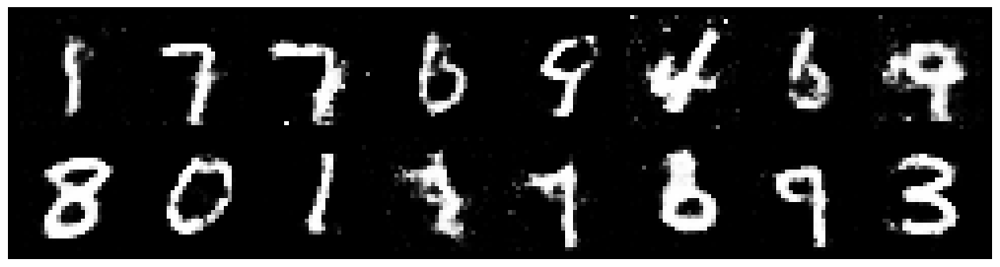

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.2423, Generator Loss: 0.8100
D(x): 0.5876, D(G(z)): 0.4716


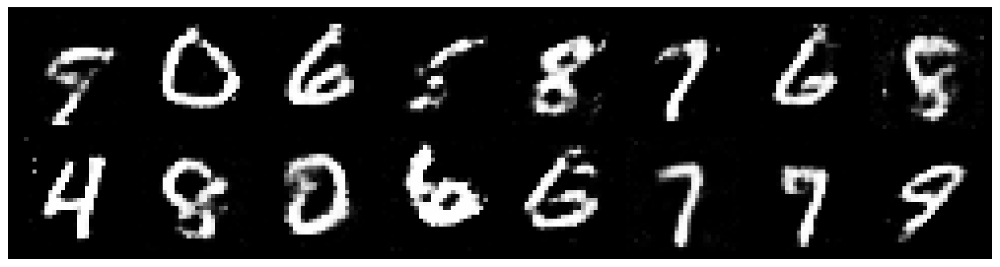

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.3969, Generator Loss: 0.7552
D(x): 0.5677, D(G(z)): 0.4927


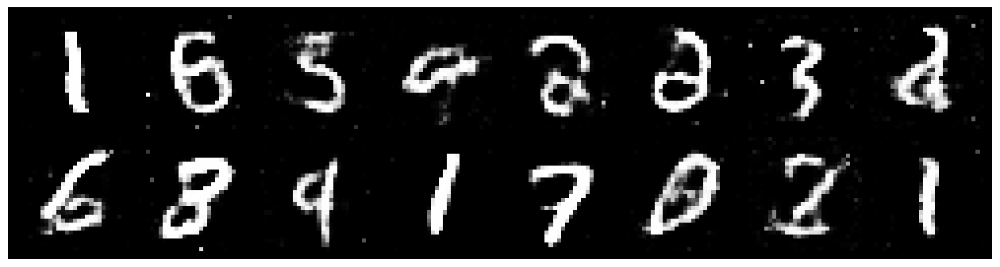

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2456, Generator Loss: 1.1351
D(x): 0.5843, D(G(z)): 0.4356


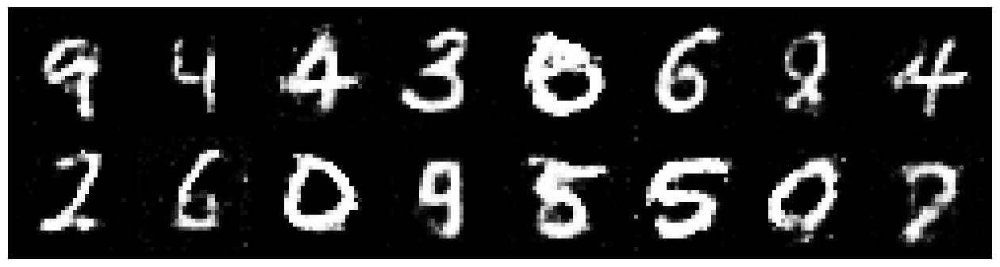

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.2987, Generator Loss: 0.9975
D(x): 0.5829, D(G(z)): 0.4483


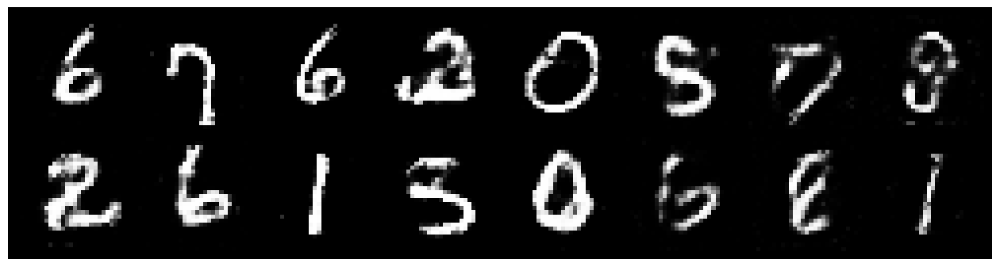

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.3199, Generator Loss: 0.8809
D(x): 0.5328, D(G(z)): 0.4586


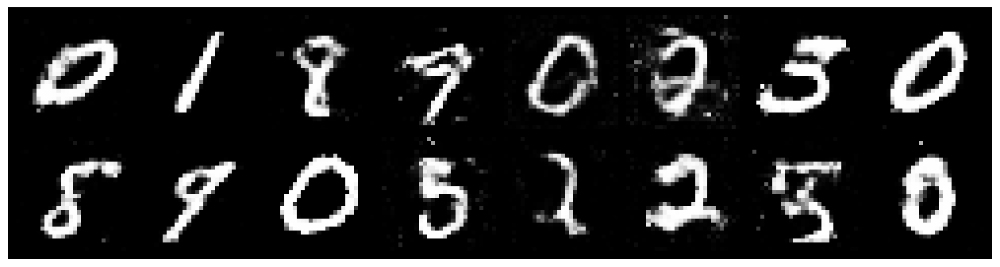

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.2582, Generator Loss: 0.8616
D(x): 0.5375, D(G(z)): 0.4356


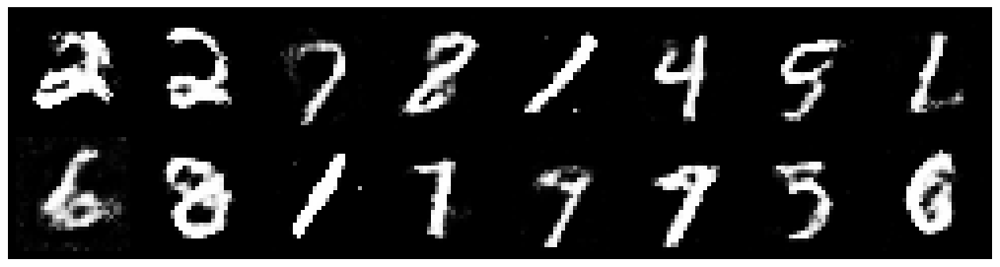

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.2592, Generator Loss: 0.8494
D(x): 0.5461, D(G(z)): 0.4491


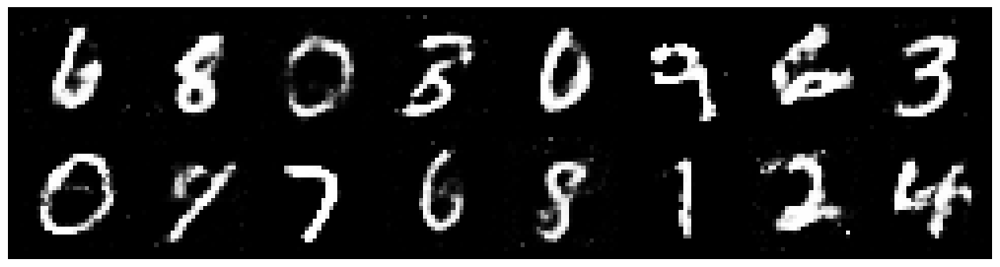

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3019, Generator Loss: 0.9019
D(x): 0.5565, D(G(z)): 0.4458


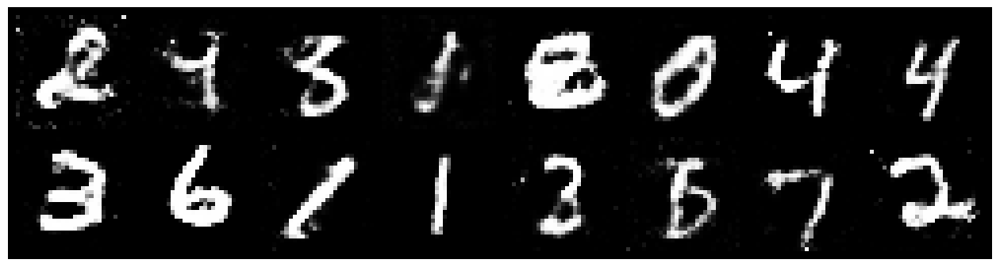

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.2418, Generator Loss: 0.8614
D(x): 0.6162, D(G(z)): 0.4773


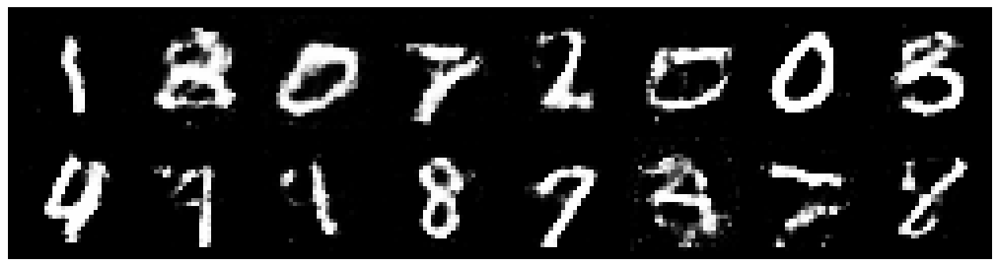

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.2131, Generator Loss: 0.9344
D(x): 0.5515, D(G(z)): 0.4244


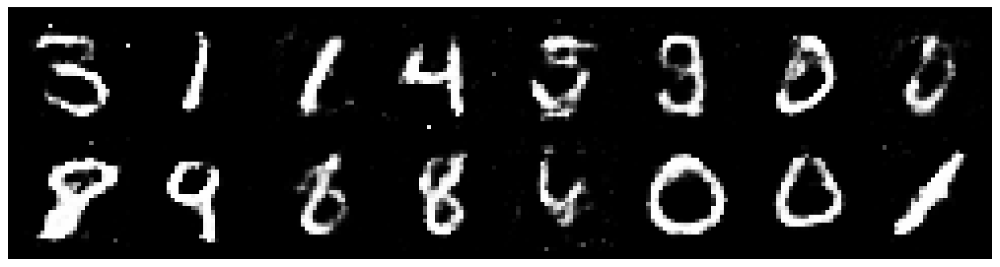

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.2700, Generator Loss: 0.9050
D(x): 0.5505, D(G(z)): 0.4491


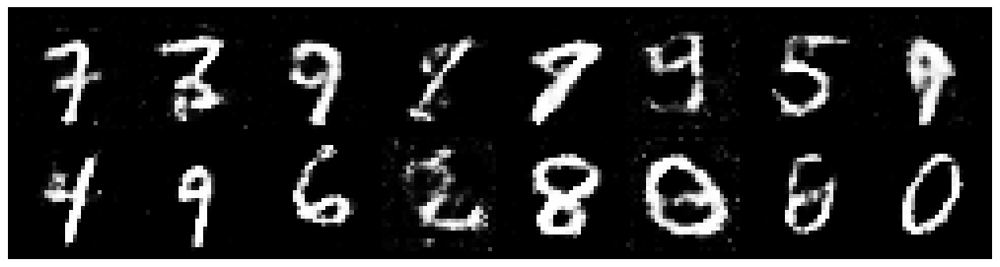

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.1848, Generator Loss: 1.0166
D(x): 0.5641, D(G(z)): 0.4035


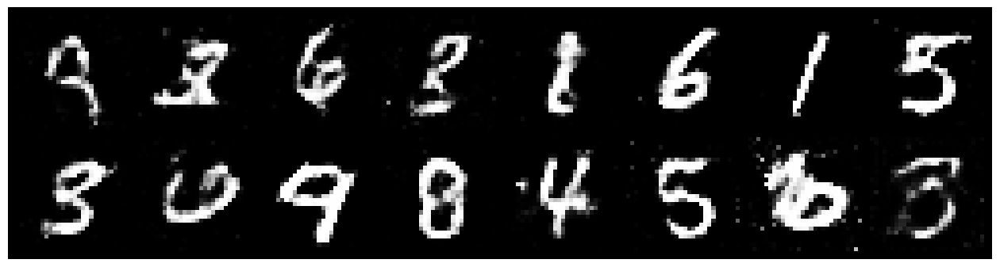

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.2916, Generator Loss: 0.7363
D(x): 0.5310, D(G(z)): 0.4539


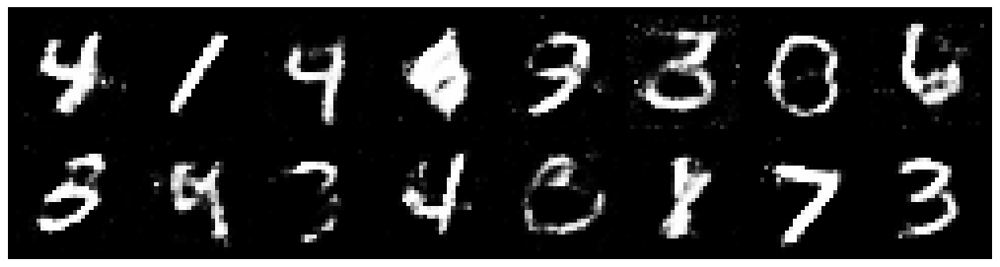

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2610, Generator Loss: 0.9215
D(x): 0.5557, D(G(z)): 0.4264


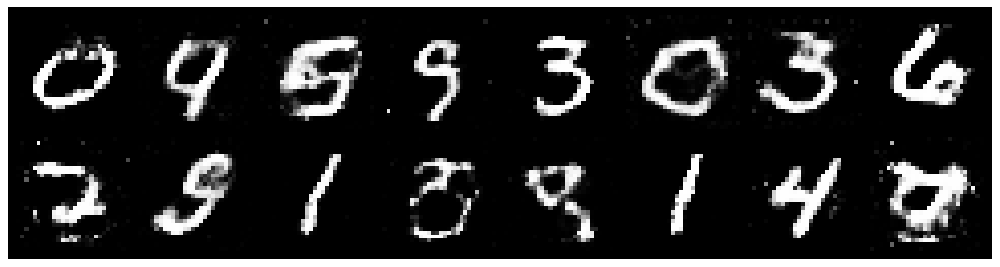

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.2430, Generator Loss: 0.8108
D(x): 0.5597, D(G(z)): 0.4394


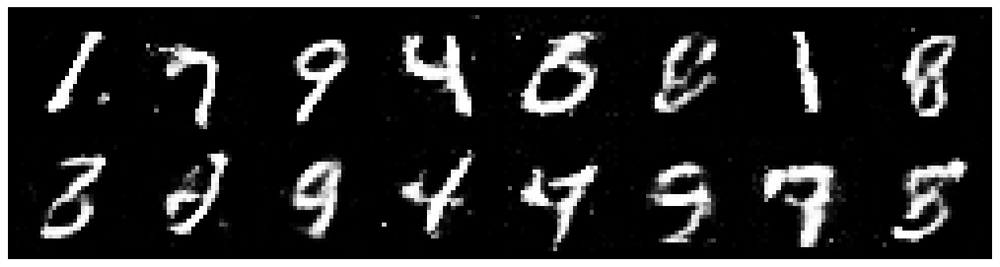

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.2696, Generator Loss: 0.8807
D(x): 0.5192, D(G(z)): 0.4113


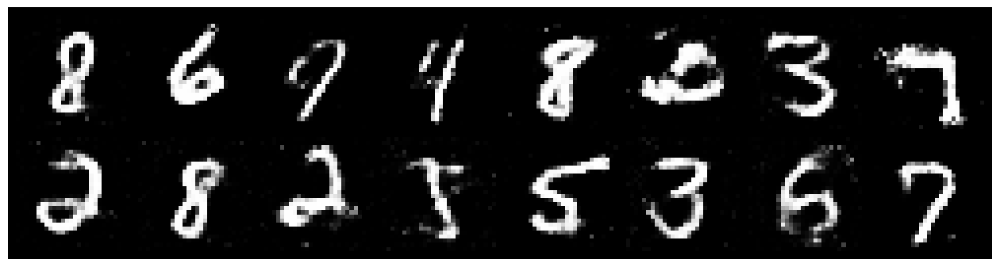

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.2395, Generator Loss: 0.9205
D(x): 0.5483, D(G(z)): 0.4366


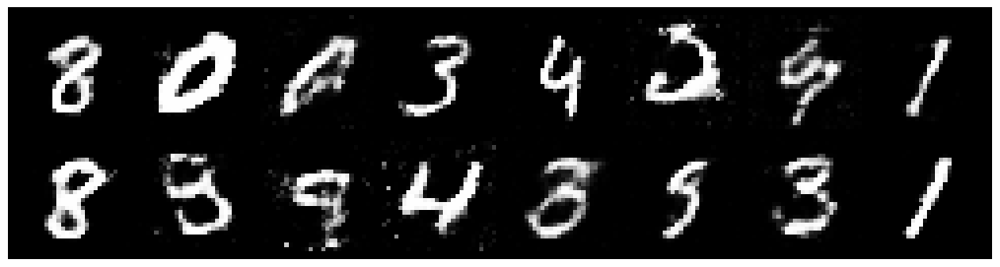

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.3275, Generator Loss: 0.8290
D(x): 0.5449, D(G(z)): 0.4666


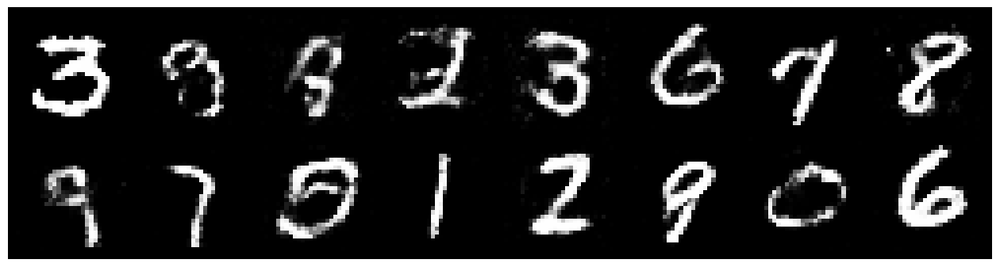

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.2975, Generator Loss: 0.7999
D(x): 0.5467, D(G(z)): 0.4602


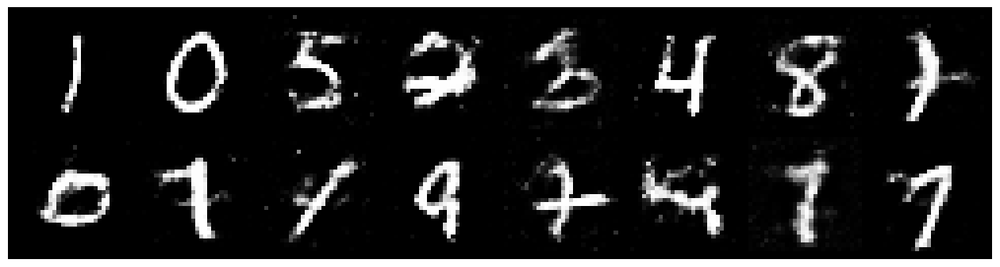

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.3969, Generator Loss: 0.9059
D(x): 0.5217, D(G(z)): 0.4857


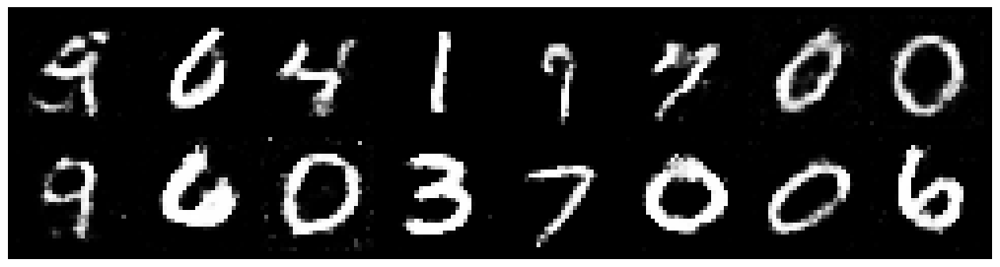

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.4406, Generator Loss: 0.8818
D(x): 0.5084, D(G(z)): 0.4659


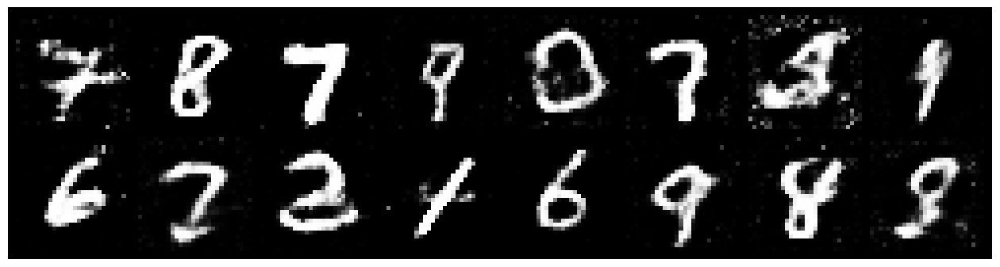

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.2829, Generator Loss: 1.0258
D(x): 0.5618, D(G(z)): 0.4400


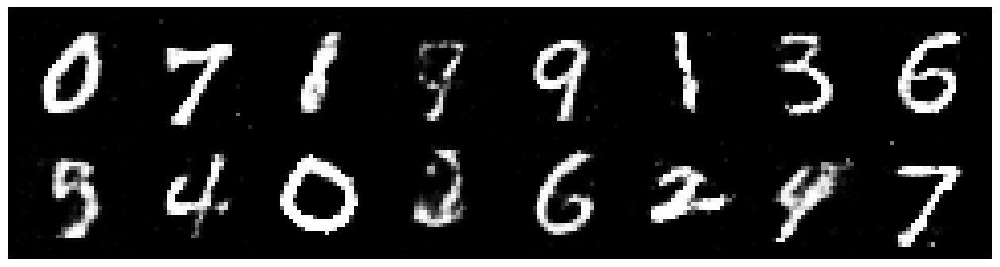

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.1374, Generator Loss: 1.1831
D(x): 0.5789, D(G(z)): 0.3789


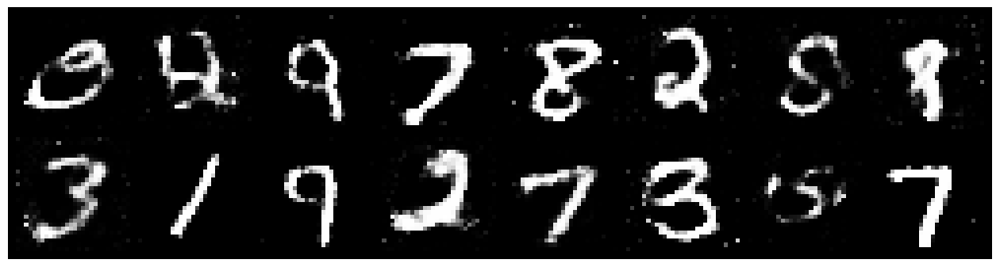

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.1890, Generator Loss: 1.1128
D(x): 0.5310, D(G(z)): 0.3687


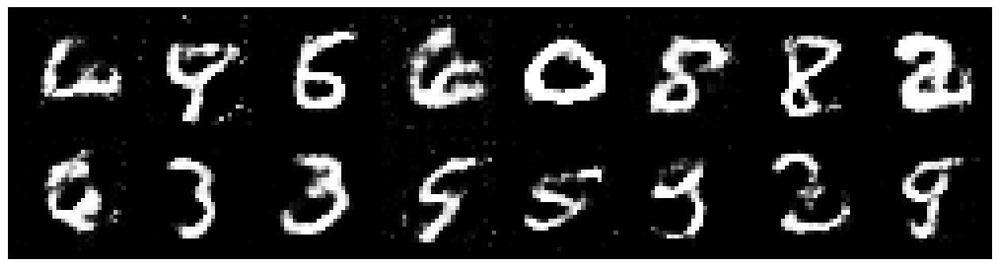

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.2307, Generator Loss: 0.9666
D(x): 0.5931, D(G(z)): 0.4401


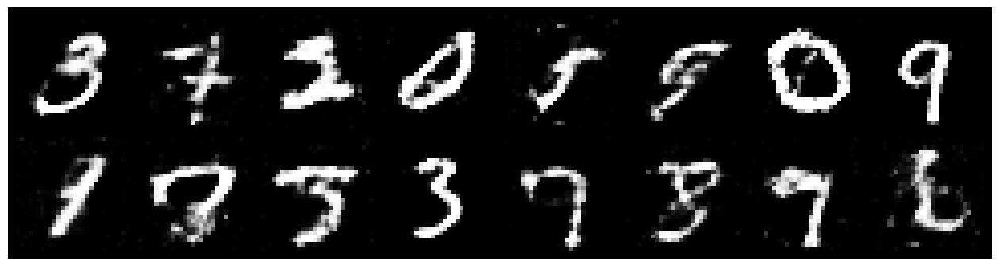

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.2104, Generator Loss: 0.8773
D(x): 0.6010, D(G(z)): 0.4661


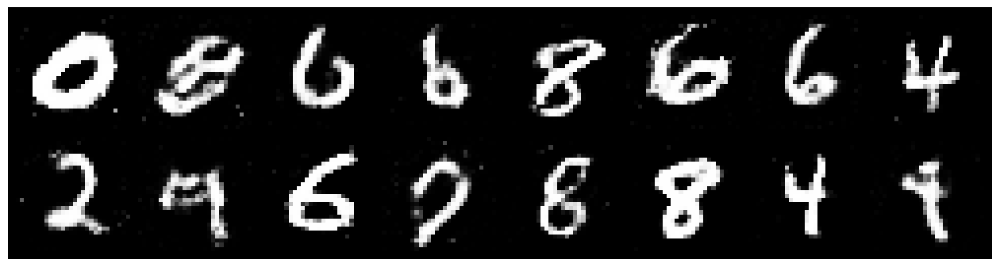

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.3157, Generator Loss: 0.8051
D(x): 0.5128, D(G(z)): 0.4372


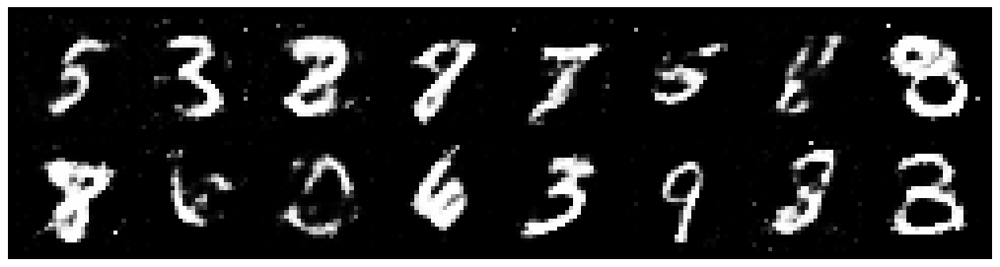

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.1552, Generator Loss: 0.9818
D(x): 0.5911, D(G(z)): 0.3989


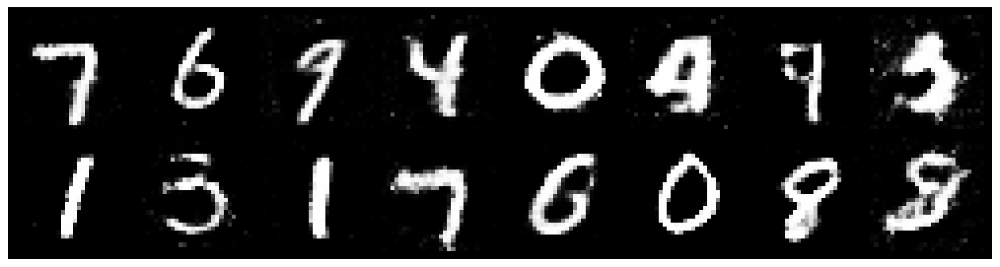

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.2729, Generator Loss: 0.9808
D(x): 0.5650, D(G(z)): 0.4405


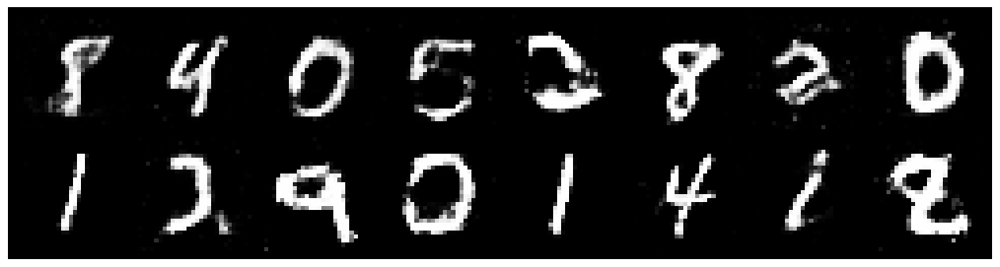

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.1988, Generator Loss: 1.1424
D(x): 0.5548, D(G(z)): 0.3966


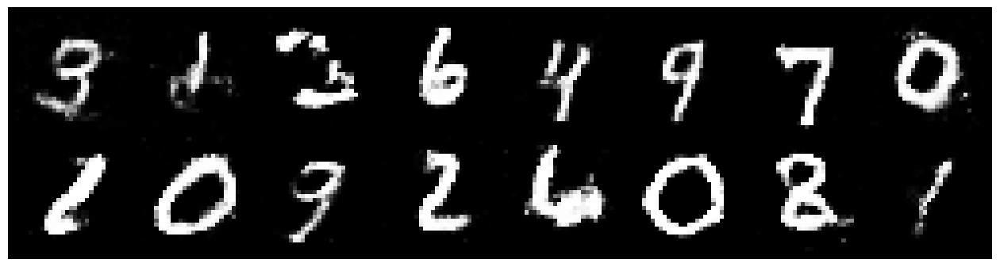

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.3150, Generator Loss: 0.9404
D(x): 0.5129, D(G(z)): 0.4200


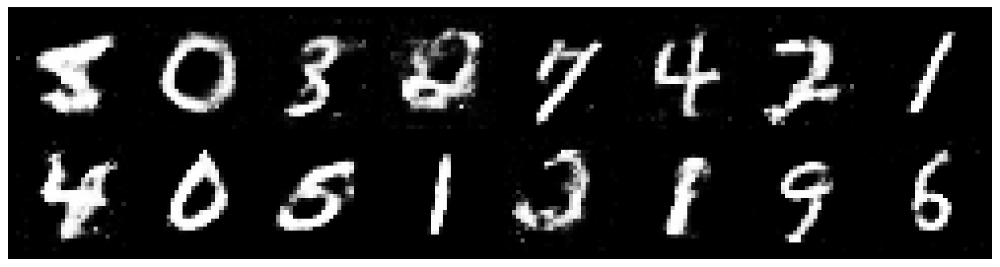

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.3030, Generator Loss: 0.9135
D(x): 0.5328, D(G(z)): 0.4375


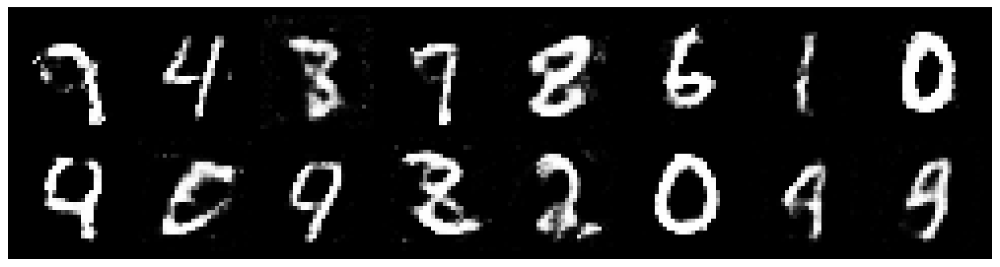

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.2438, Generator Loss: 0.8470
D(x): 0.5666, D(G(z)): 0.4475


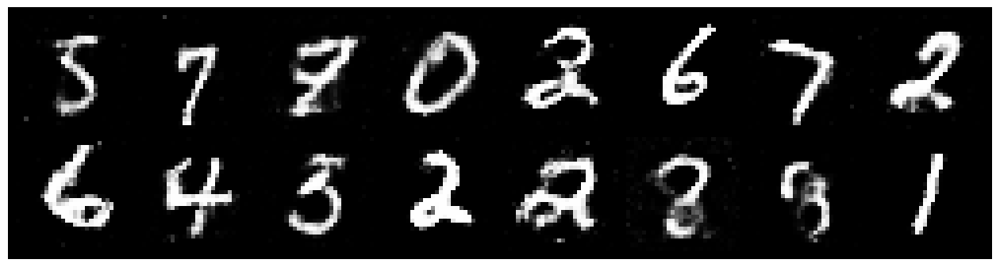

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.2430, Generator Loss: 0.8411
D(x): 0.5748, D(G(z)): 0.4643


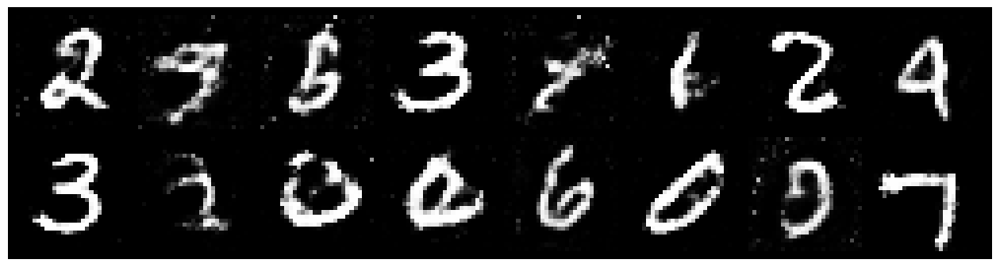

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.2249, Generator Loss: 0.9266
D(x): 0.5528, D(G(z)): 0.4304


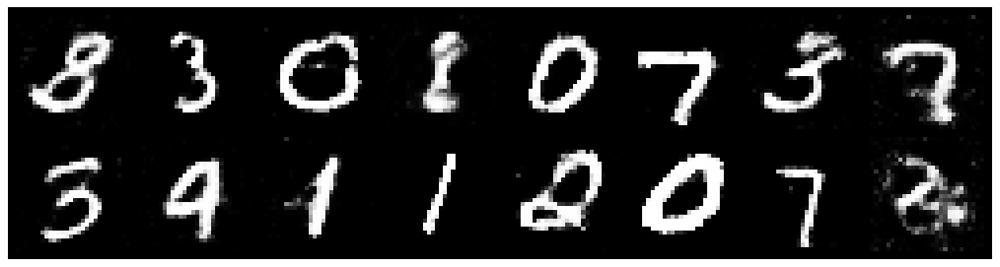

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2900, Generator Loss: 1.1190
D(x): 0.5333, D(G(z)): 0.4188


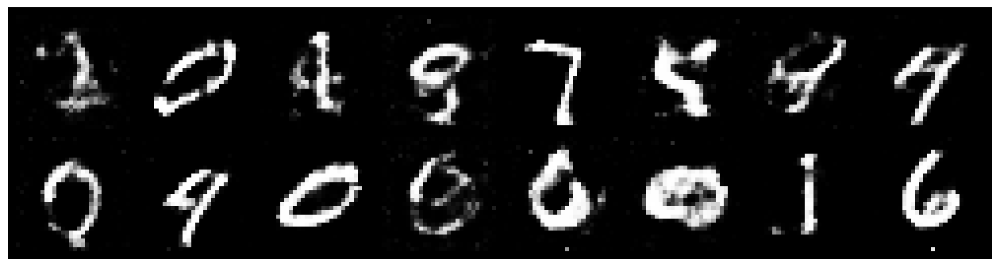

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2320, Generator Loss: 1.0338
D(x): 0.5335, D(G(z)): 0.4106


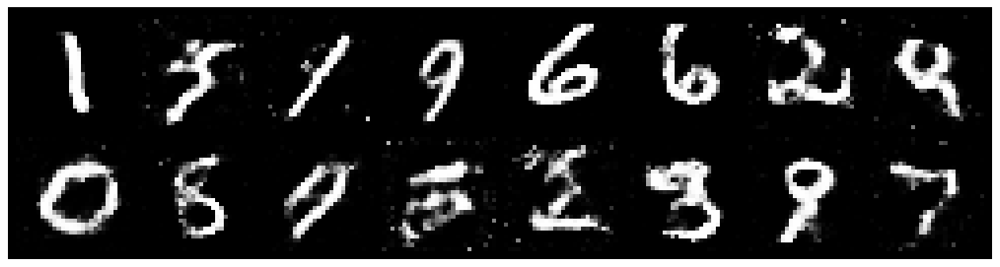

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2488, Generator Loss: 0.8469
D(x): 0.5814, D(G(z)): 0.4652


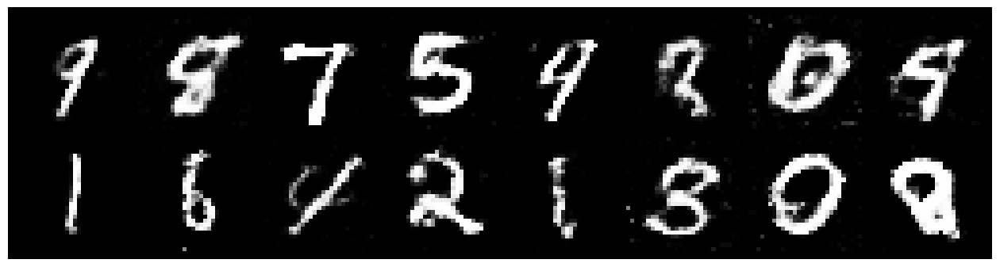

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.3480, Generator Loss: 0.7944
D(x): 0.5054, D(G(z)): 0.4549


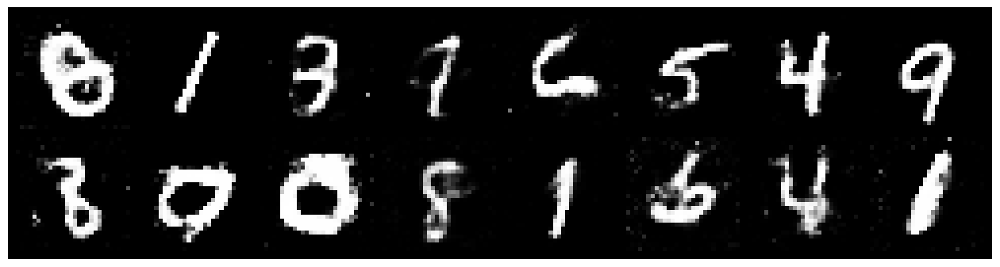

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2968, Generator Loss: 0.8029
D(x): 0.5456, D(G(z)): 0.4493


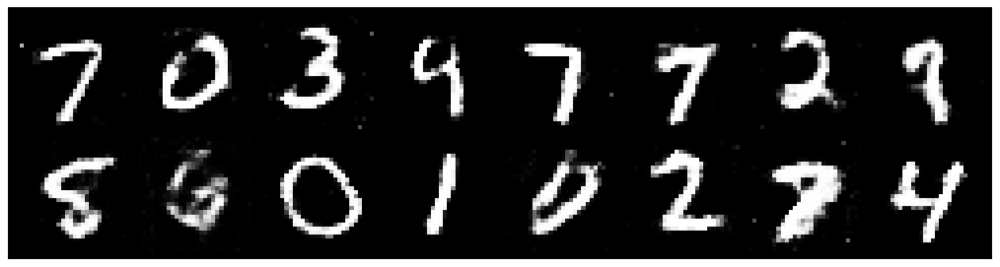

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.2550, Generator Loss: 0.9833
D(x): 0.5493, D(G(z)): 0.4145


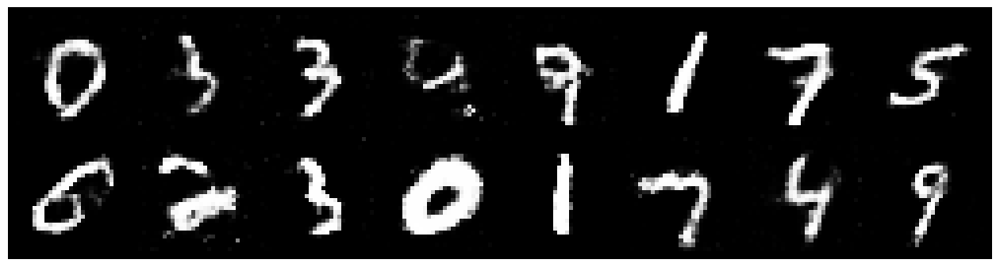

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.2137, Generator Loss: 0.9351
D(x): 0.5702, D(G(z)): 0.4352


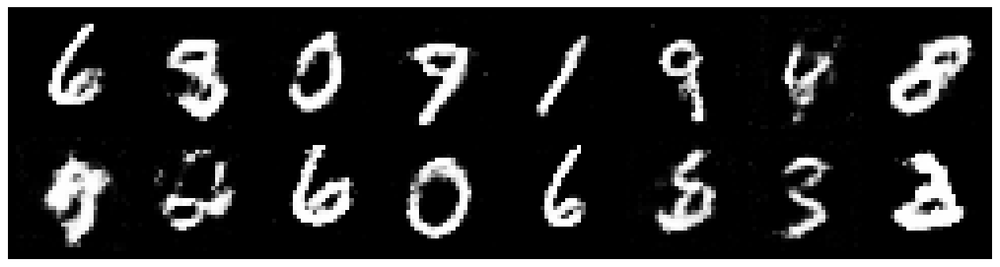

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.2699, Generator Loss: 0.8206
D(x): 0.5413, D(G(z)): 0.4496


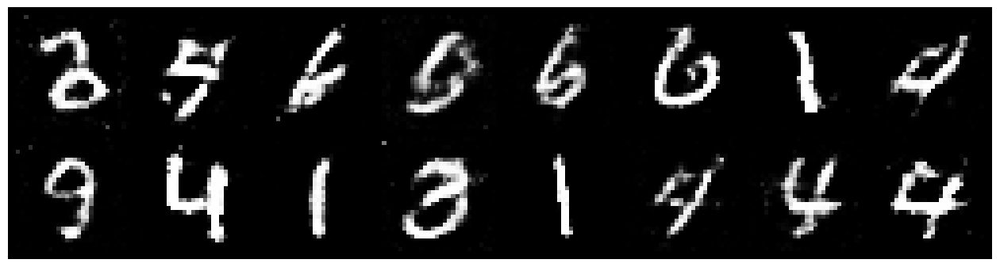

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2055, Generator Loss: 0.9700
D(x): 0.5870, D(G(z)): 0.4254


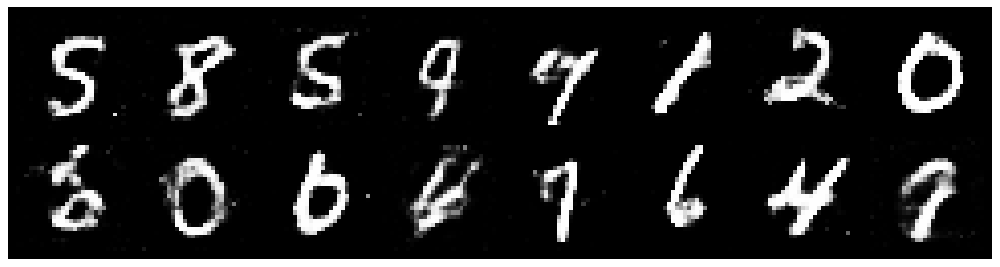

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.3134, Generator Loss: 1.0267
D(x): 0.5691, D(G(z)): 0.4663


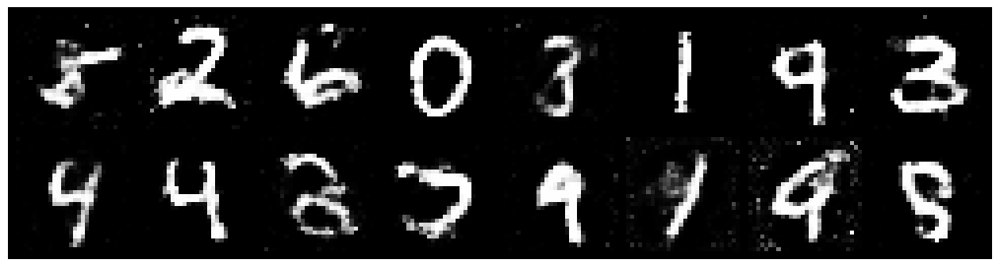

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.2617, Generator Loss: 0.8382
D(x): 0.5549, D(G(z)): 0.4415


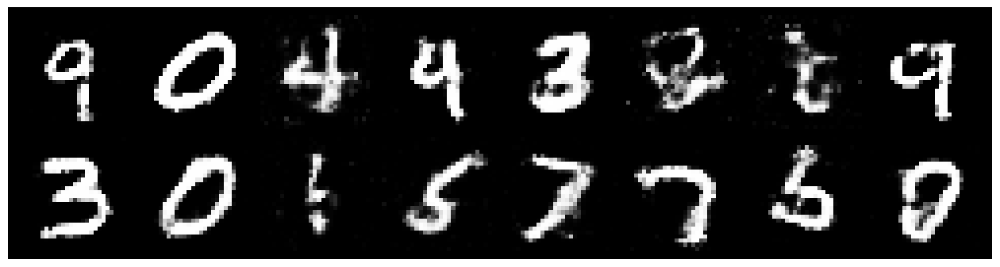

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.4019, Generator Loss: 0.9187
D(x): 0.5395, D(G(z)): 0.4477


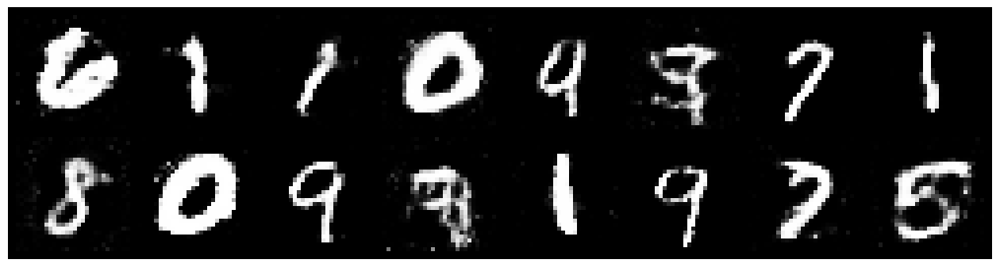

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.2774, Generator Loss: 0.9298
D(x): 0.5911, D(G(z)): 0.4368


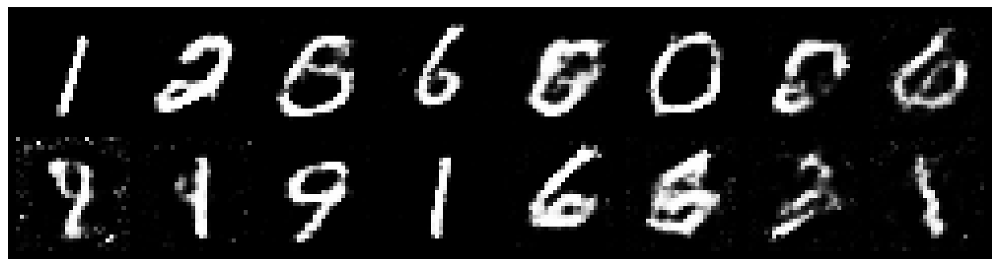

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2441, Generator Loss: 0.8891
D(x): 0.5445, D(G(z)): 0.4285


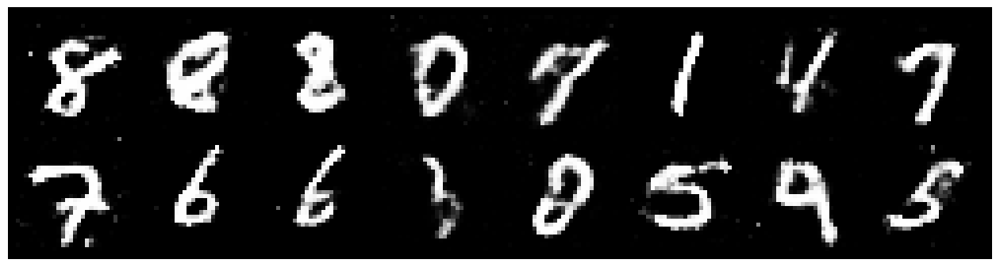

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.2169, Generator Loss: 0.8533
D(x): 0.6030, D(G(z)): 0.4628


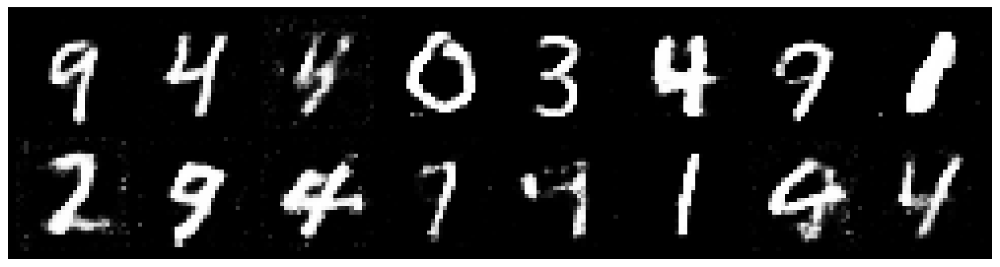

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.2473, Generator Loss: 0.8839
D(x): 0.5456, D(G(z)): 0.4431


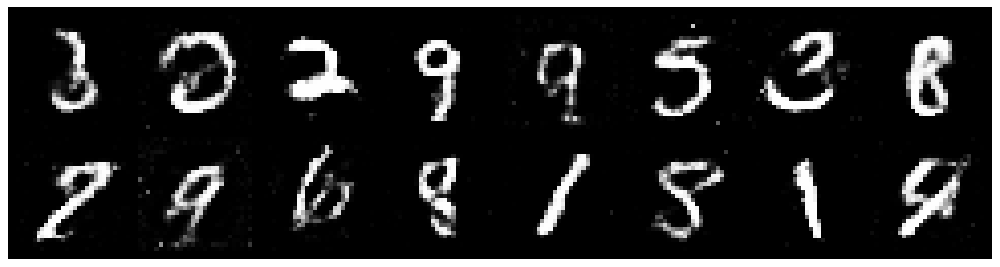

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.3049, Generator Loss: 0.8657
D(x): 0.5188, D(G(z)): 0.4456


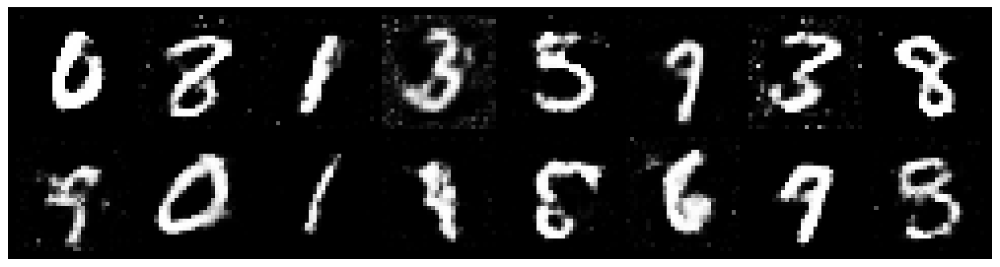

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2513, Generator Loss: 0.9451
D(x): 0.5689, D(G(z)): 0.4455


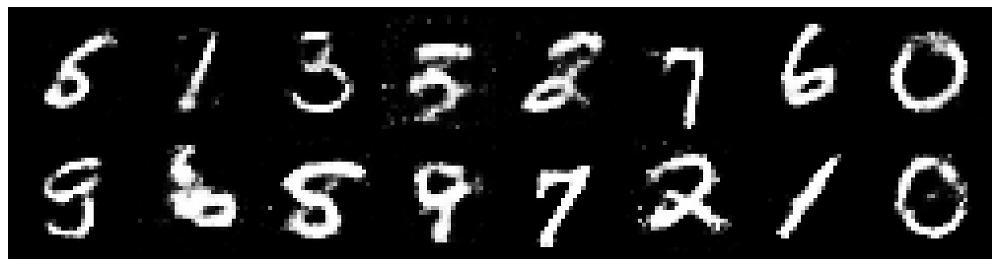

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.2592, Generator Loss: 0.9928
D(x): 0.5596, D(G(z)): 0.4068


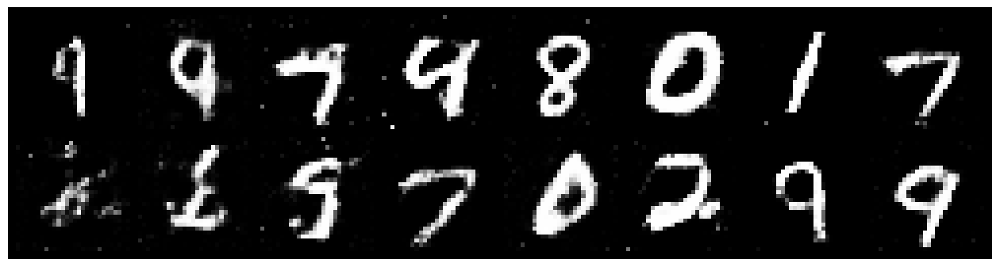

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.0667, Generator Loss: 1.0560
D(x): 0.6265, D(G(z)): 0.3698


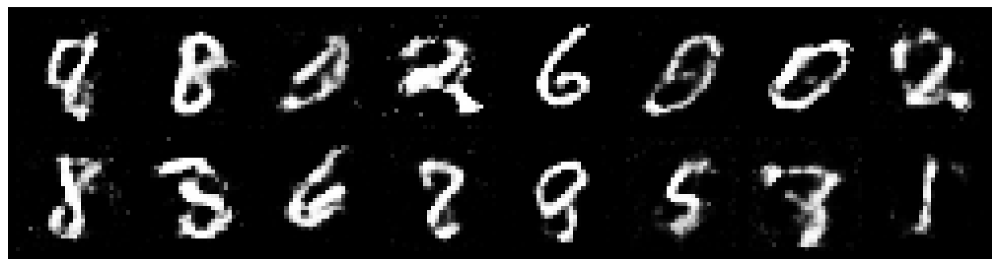

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.3649, Generator Loss: 1.0597
D(x): 0.5694, D(G(z)): 0.4540


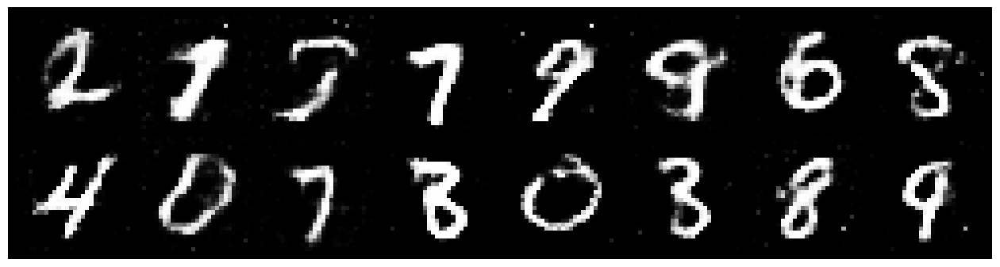

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.2839, Generator Loss: 0.9139
D(x): 0.5442, D(G(z)): 0.4315


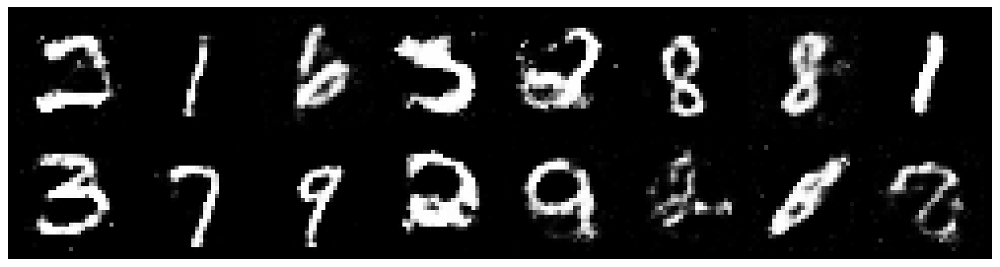

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.2862, Generator Loss: 0.9544
D(x): 0.5839, D(G(z)): 0.4563


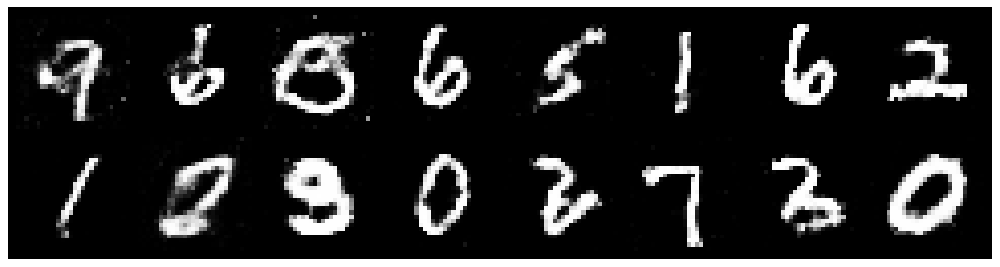

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.2582, Generator Loss: 0.9563
D(x): 0.5389, D(G(z)): 0.4150


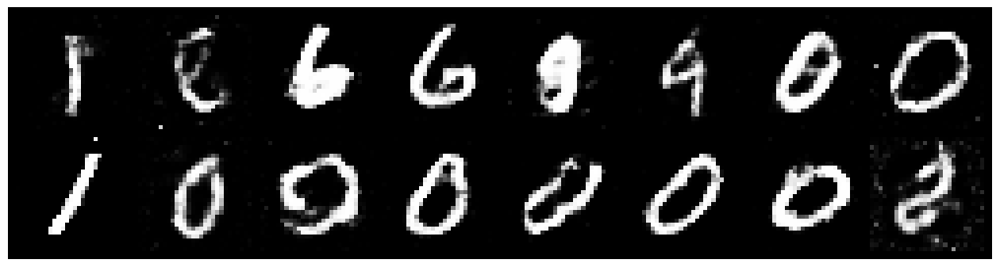

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.1900, Generator Loss: 0.9085
D(x): 0.5729, D(G(z)): 0.4277


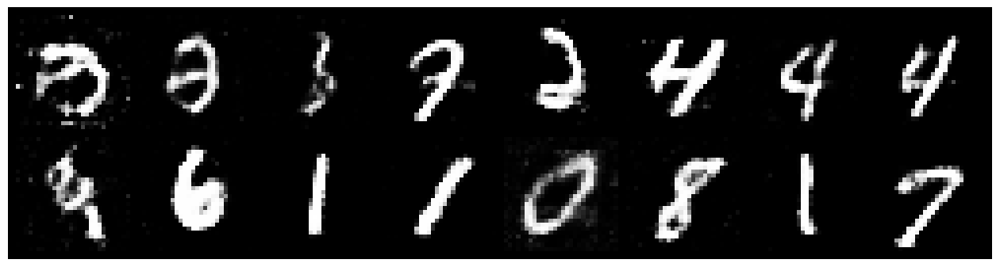

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.2760, Generator Loss: 0.8696
D(x): 0.5716, D(G(z)): 0.4624


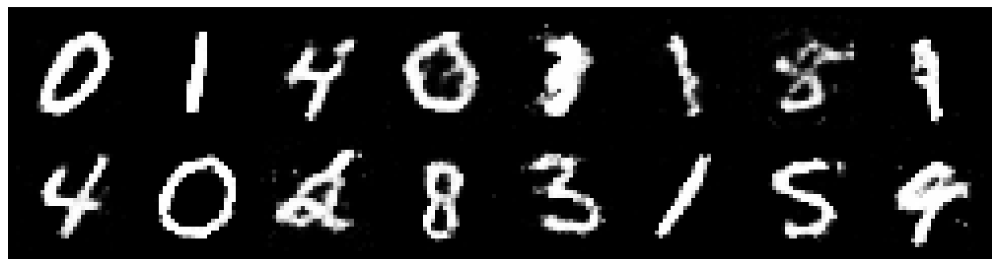

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.2720, Generator Loss: 0.8136
D(x): 0.5540, D(G(z)): 0.4402


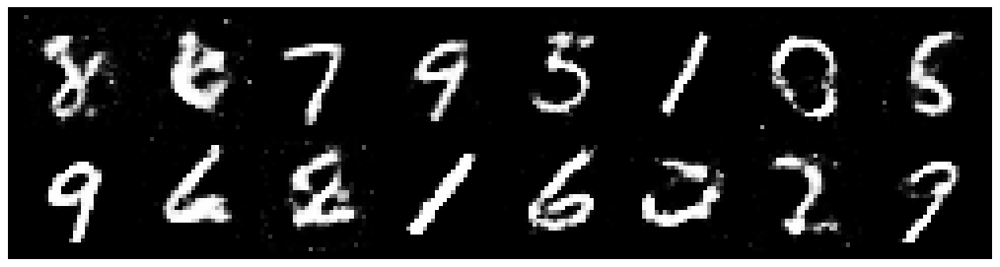

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.2260, Generator Loss: 0.9698
D(x): 0.5533, D(G(z)): 0.4143


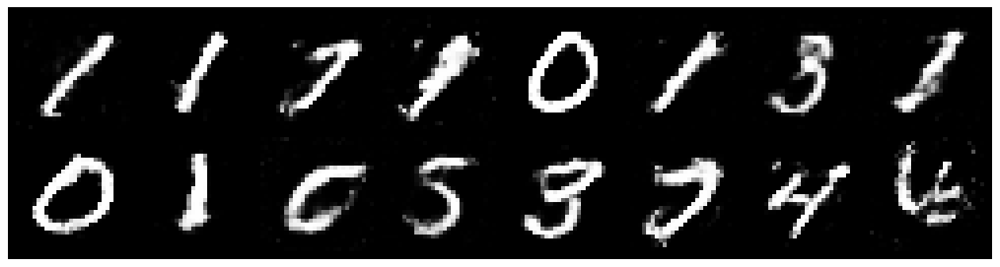

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.2273, Generator Loss: 0.9245
D(x): 0.5525, D(G(z)): 0.4311


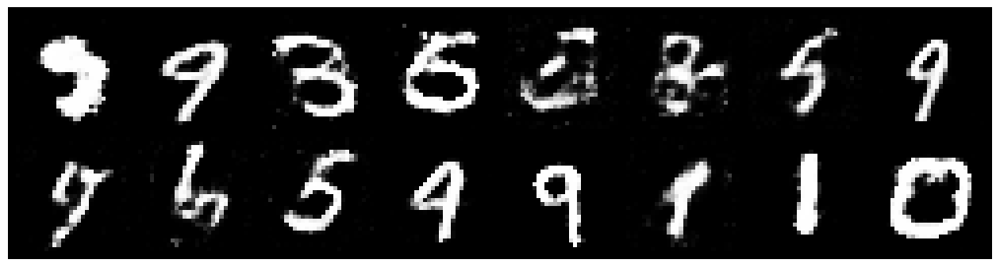

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.3019, Generator Loss: 0.9023
D(x): 0.5478, D(G(z)): 0.4538


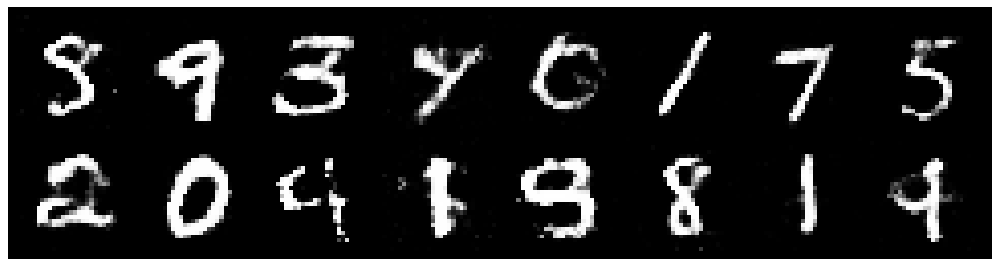

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.2630, Generator Loss: 0.8379
D(x): 0.5322, D(G(z)): 0.4303


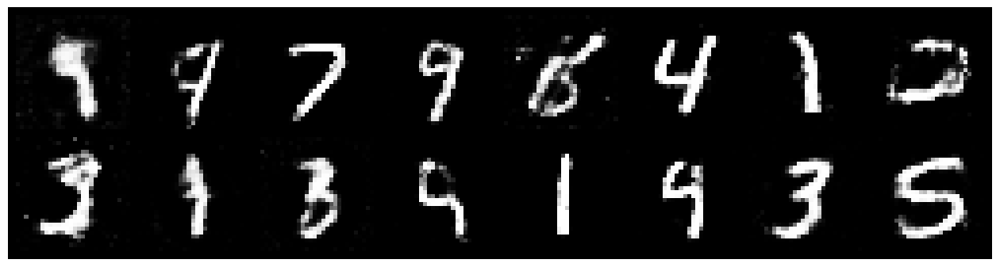

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.3241, Generator Loss: 0.7919
D(x): 0.5487, D(G(z)): 0.4787


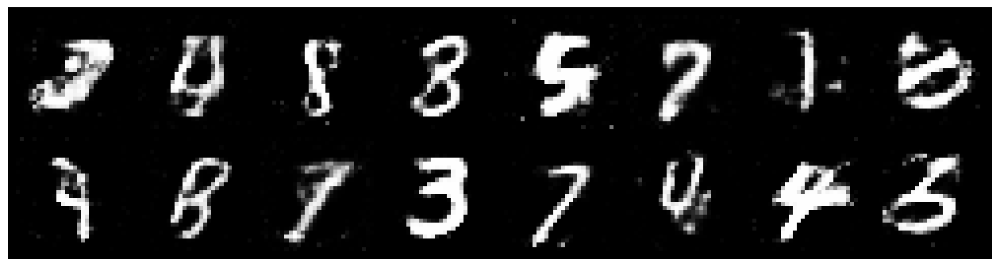

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.3400, Generator Loss: 0.8274
D(x): 0.4939, D(G(z)): 0.4138


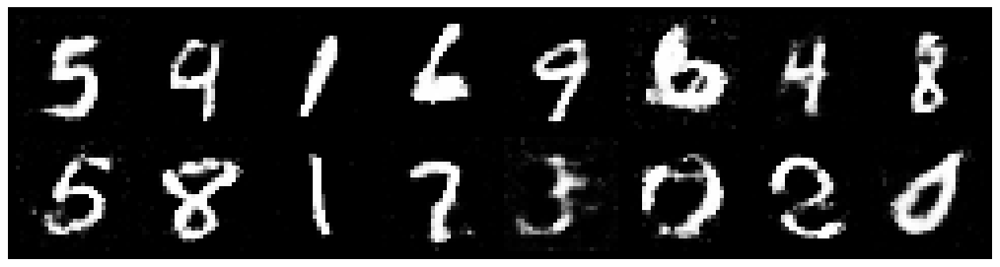

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.3362, Generator Loss: 0.7979
D(x): 0.5383, D(G(z)): 0.4485


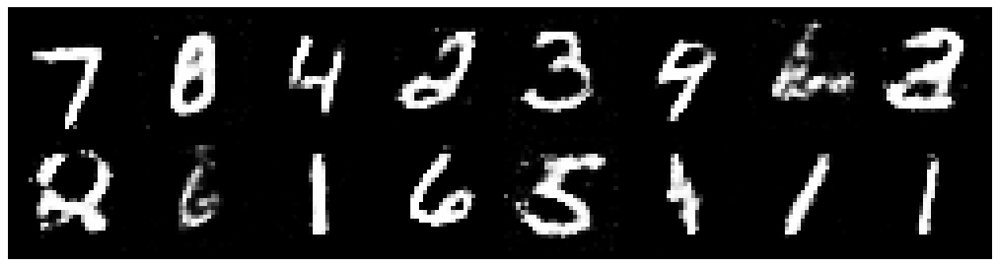

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2573, Generator Loss: 0.8286
D(x): 0.5458, D(G(z)): 0.4228


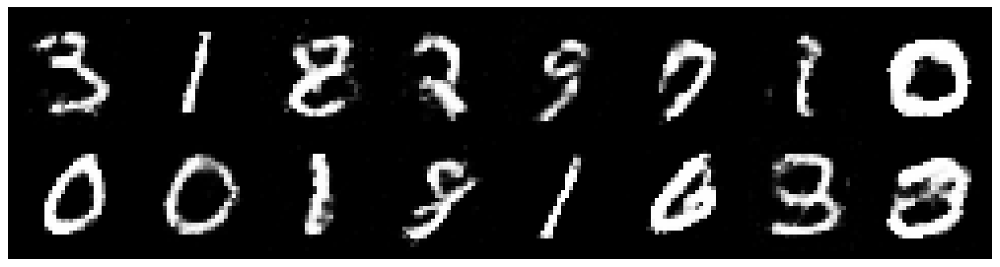

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.2847, Generator Loss: 0.8198
D(x): 0.5653, D(G(z)): 0.4635


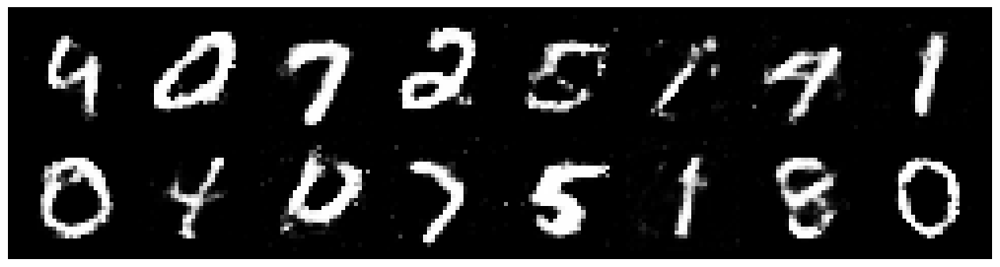

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.2996, Generator Loss: 0.7186
D(x): 0.5558, D(G(z)): 0.4867


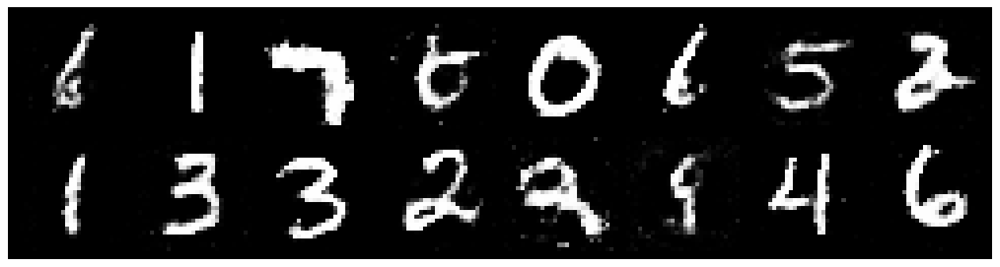

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.1574, Generator Loss: 0.9527
D(x): 0.5678, D(G(z)): 0.3951


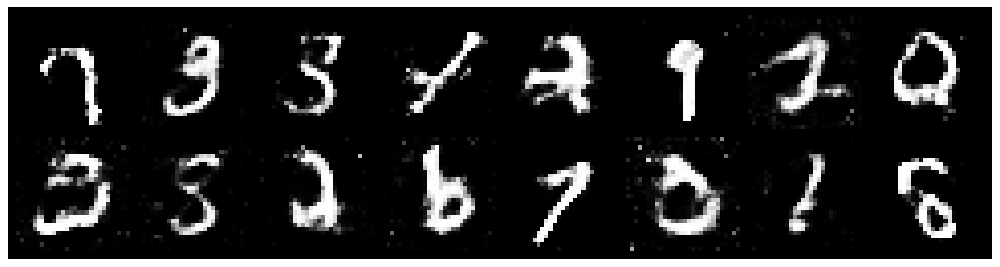

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.3665, Generator Loss: 0.8605
D(x): 0.4982, D(G(z)): 0.4577


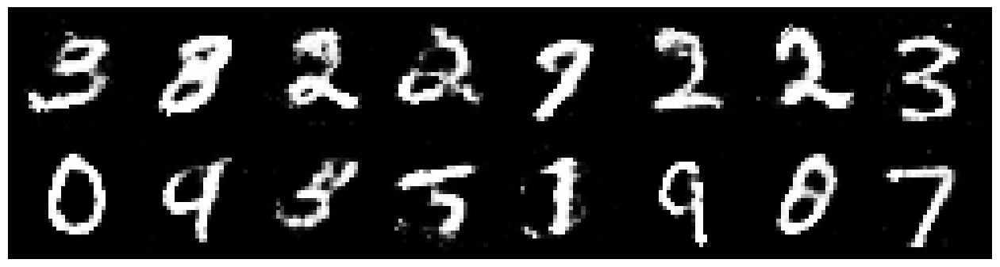

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.2973, Generator Loss: 0.8245
D(x): 0.5753, D(G(z)): 0.4764


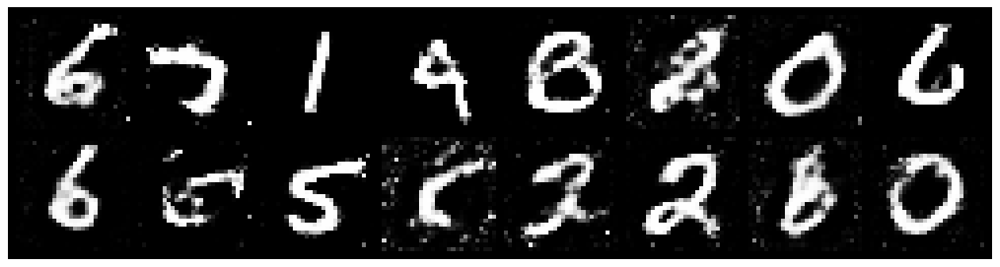

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.3116, Generator Loss: 0.8939
D(x): 0.5382, D(G(z)): 0.4466


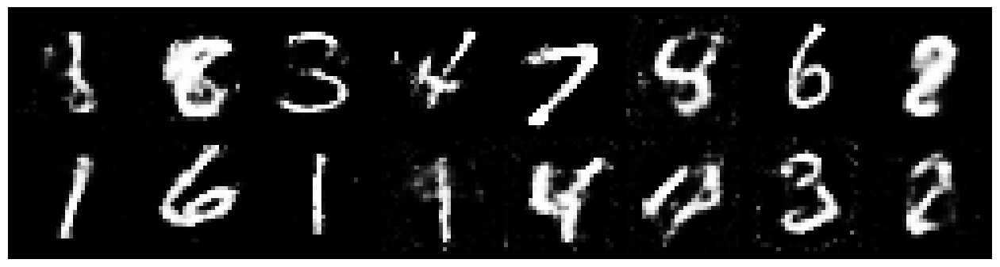

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.2981, Generator Loss: 0.8794
D(x): 0.5442, D(G(z)): 0.4517


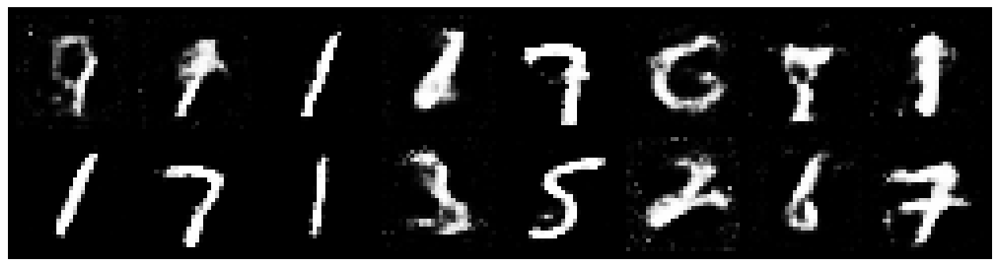

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.2329, Generator Loss: 0.8860
D(x): 0.5829, D(G(z)): 0.4486


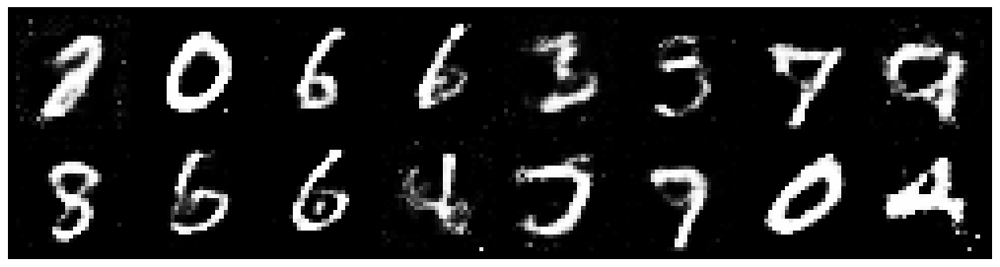

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.3042, Generator Loss: 0.7878
D(x): 0.5604, D(G(z)): 0.4840


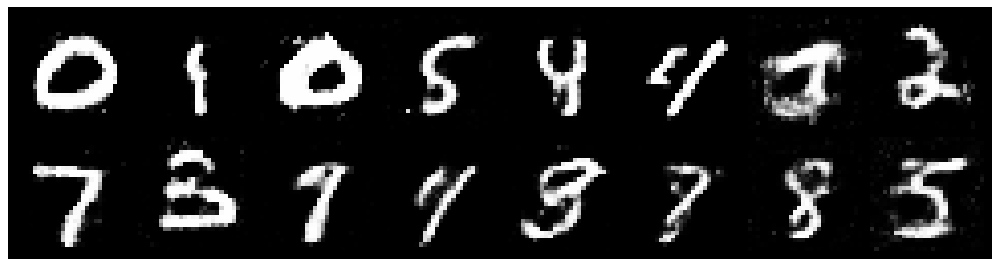

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.2909, Generator Loss: 0.8044
D(x): 0.5684, D(G(z)): 0.4870


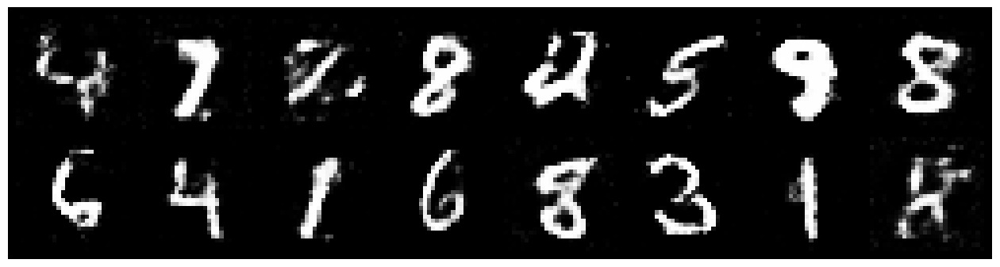

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.3043, Generator Loss: 0.8520
D(x): 0.5435, D(G(z)): 0.4591


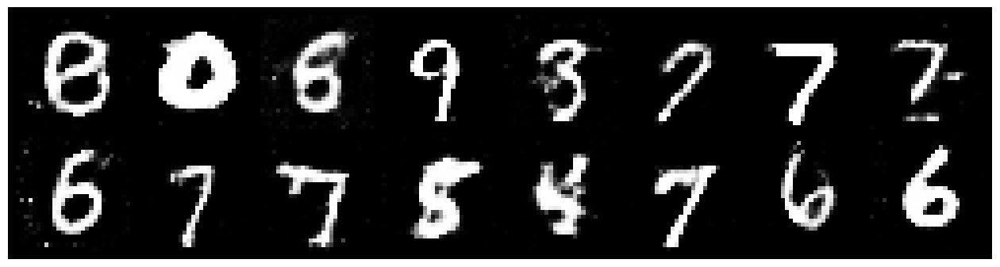

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.2458, Generator Loss: 0.9594
D(x): 0.5190, D(G(z)): 0.3863


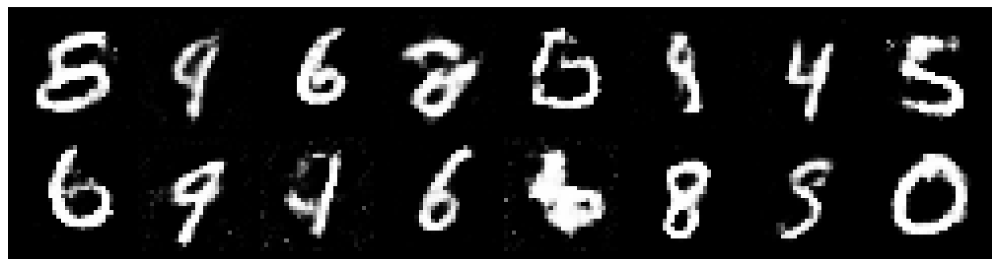

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.2751, Generator Loss: 0.8145
D(x): 0.5674, D(G(z)): 0.4603


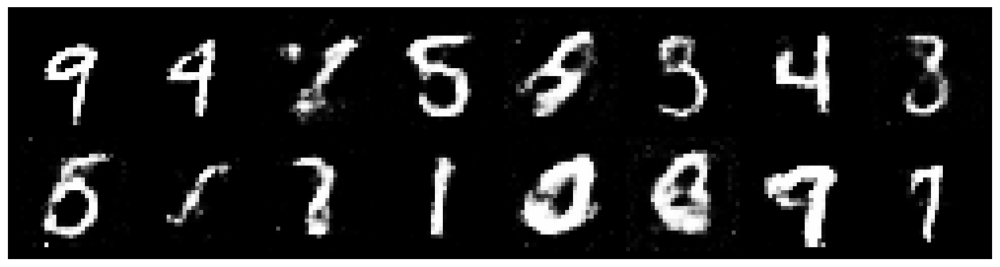

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.2962, Generator Loss: 0.8795
D(x): 0.5158, D(G(z)): 0.4415


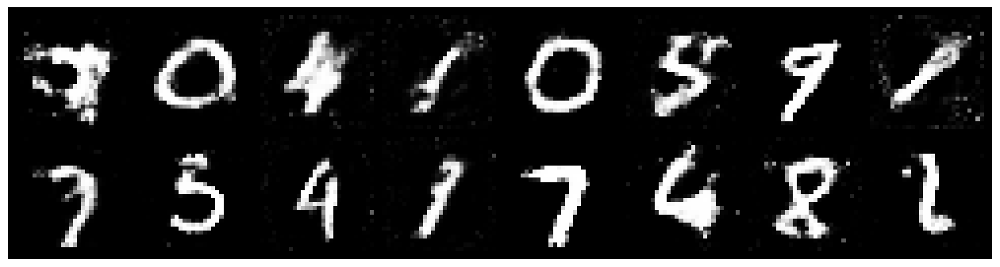

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.2747, Generator Loss: 0.9992
D(x): 0.5145, D(G(z)): 0.4100


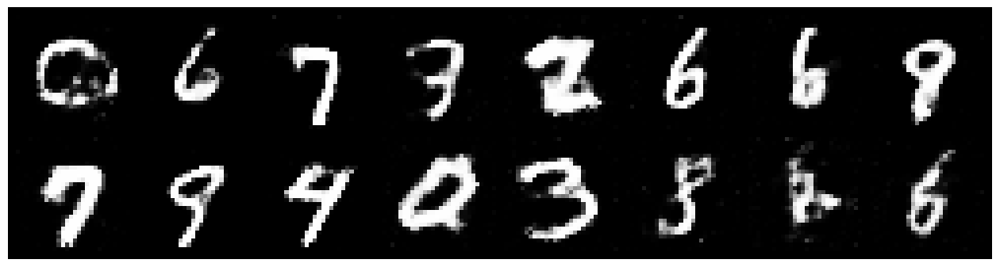

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.2131, Generator Loss: 1.0685
D(x): 0.5933, D(G(z)): 0.4355


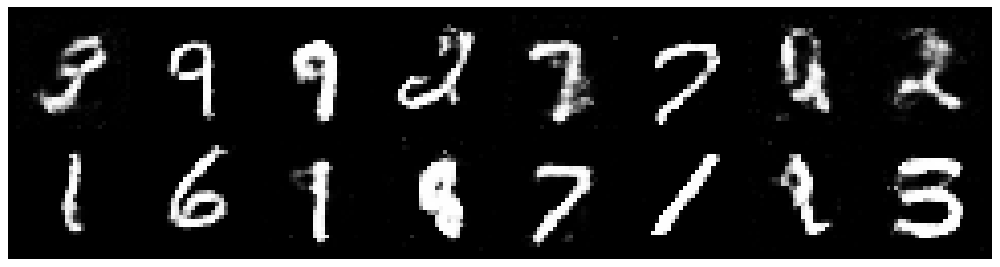

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.2529, Generator Loss: 0.8746
D(x): 0.5825, D(G(z)): 0.4458


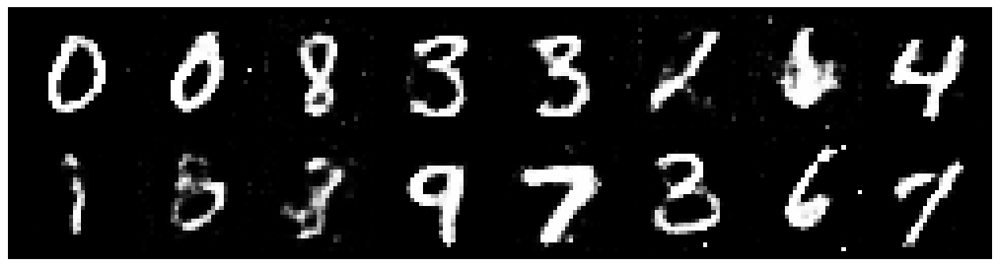

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.2326, Generator Loss: 0.8596
D(x): 0.5822, D(G(z)): 0.4550


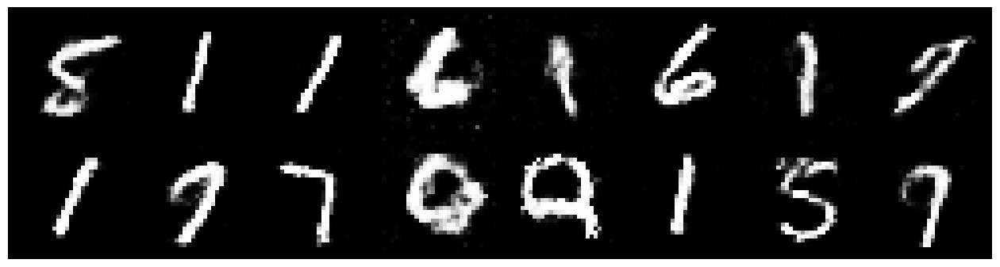

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2024, Generator Loss: 1.0072
D(x): 0.5845, D(G(z)): 0.4367


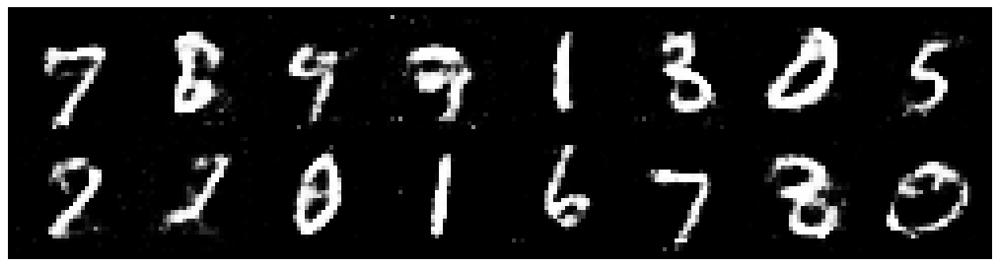

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.3302, Generator Loss: 0.8160
D(x): 0.5128, D(G(z)): 0.4620


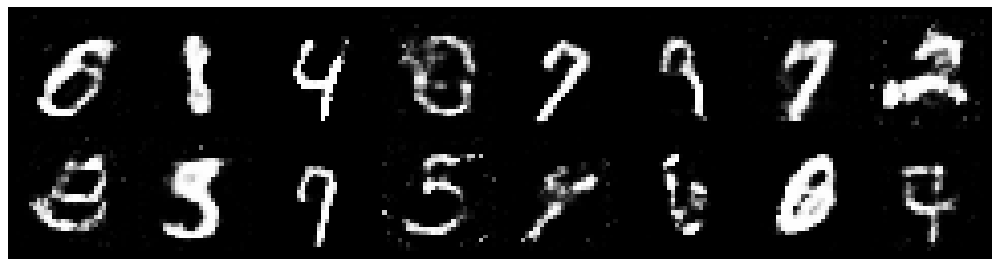

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.2968, Generator Loss: 0.8119
D(x): 0.5310, D(G(z)): 0.4398


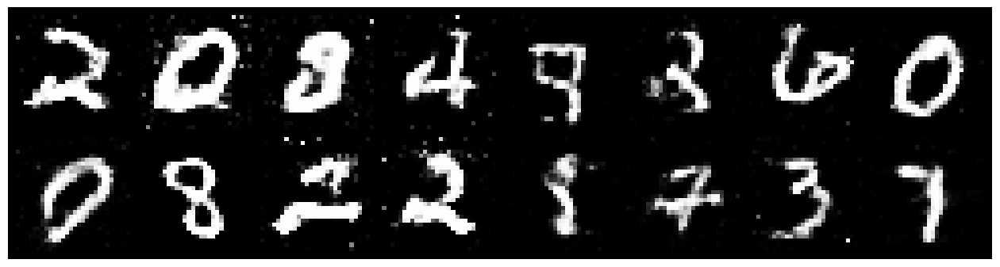

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.3512, Generator Loss: 0.9319
D(x): 0.5088, D(G(z)): 0.4167


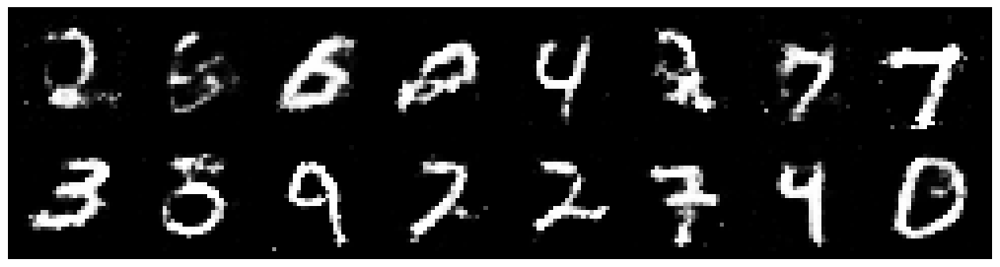

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.2122, Generator Loss: 0.9332
D(x): 0.5782, D(G(z)): 0.4418


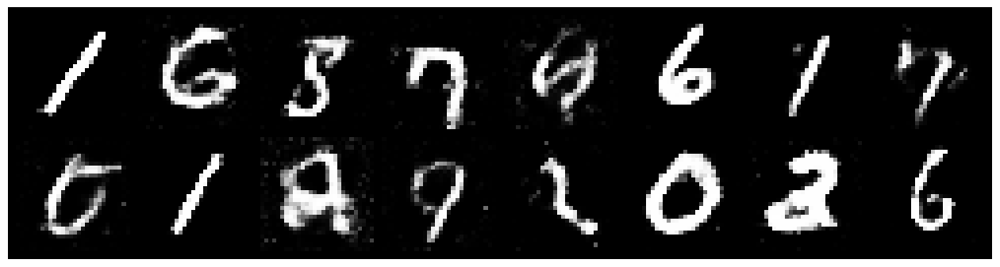

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.2533, Generator Loss: 0.8051
D(x): 0.5852, D(G(z)): 0.4808


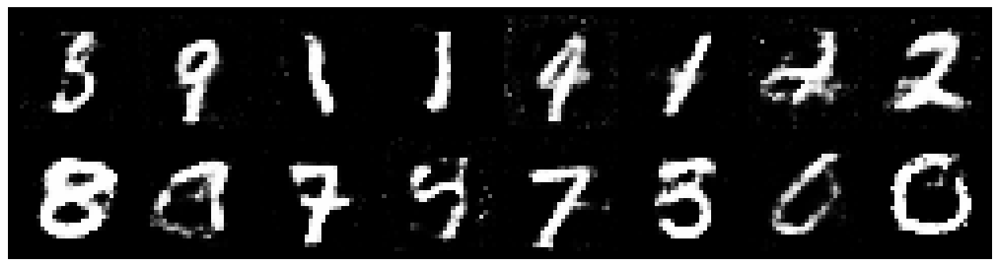

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.2711, Generator Loss: 0.7633
D(x): 0.5447, D(G(z)): 0.4464


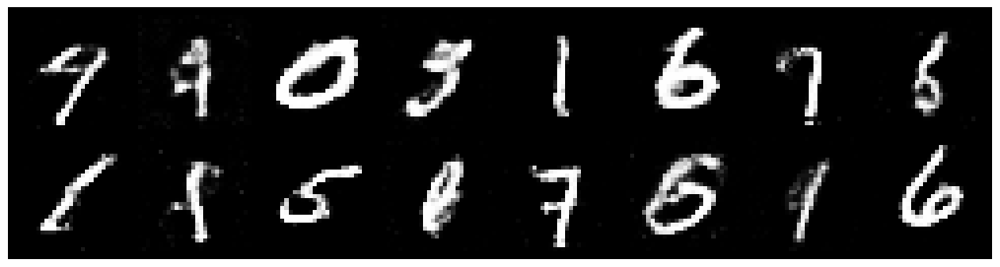

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.2176, Generator Loss: 0.9047
D(x): 0.5530, D(G(z)): 0.4291


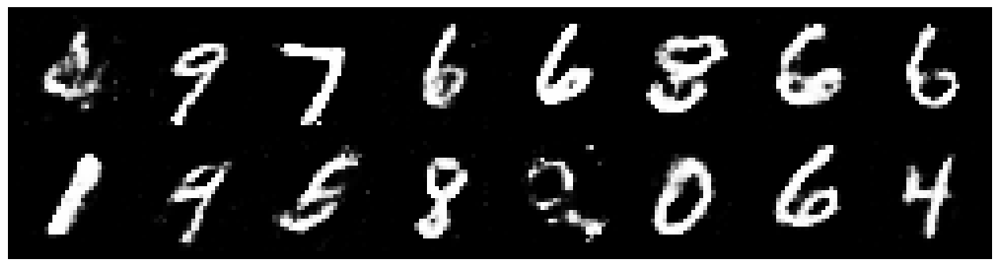

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.1661, Generator Loss: 0.9018
D(x): 0.5841, D(G(z)): 0.4277


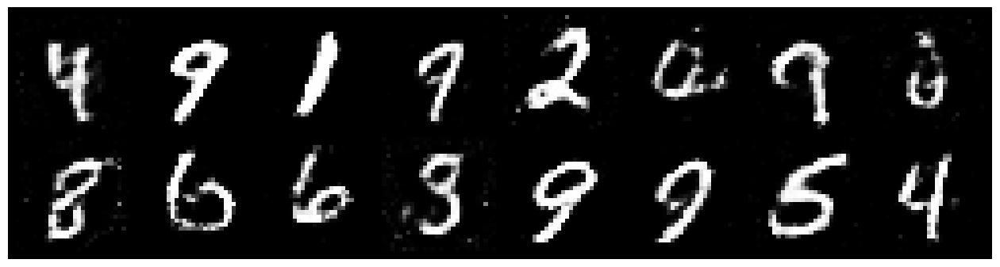

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.2500, Generator Loss: 0.9991
D(x): 0.5345, D(G(z)): 0.4221


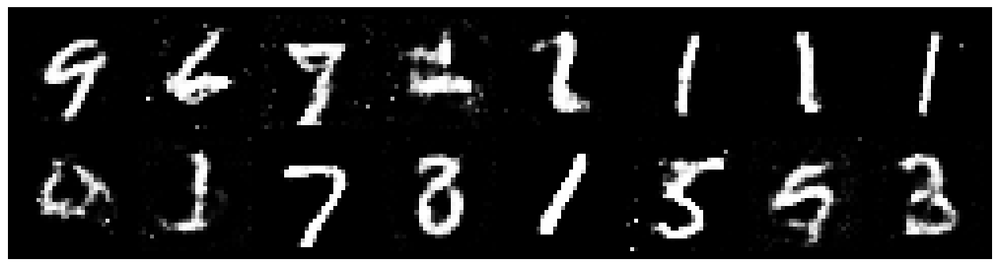

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.1871, Generator Loss: 1.1016
D(x): 0.5890, D(G(z)): 0.4162


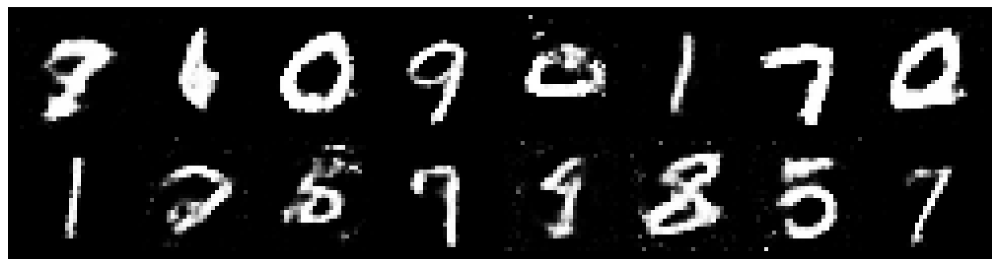

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.3281, Generator Loss: 0.9813
D(x): 0.5224, D(G(z)): 0.4249


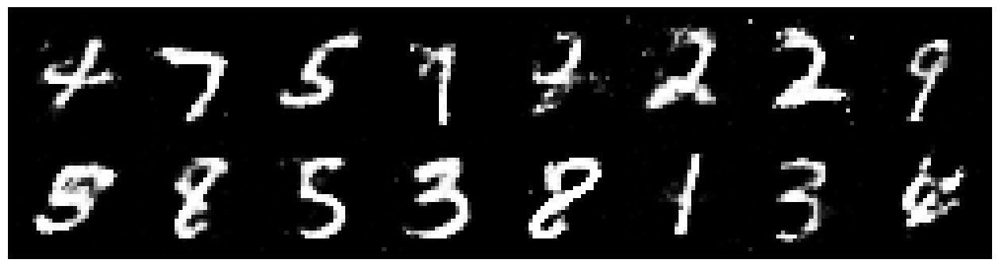

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.3101, Generator Loss: 0.9961
D(x): 0.5545, D(G(z)): 0.4486


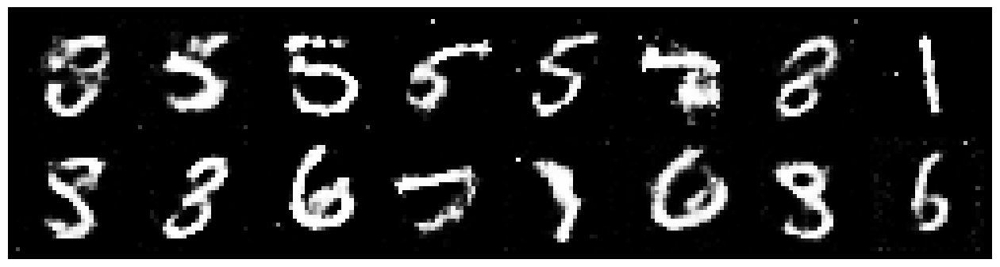

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.3196, Generator Loss: 1.0345
D(x): 0.4992, D(G(z)): 0.3930


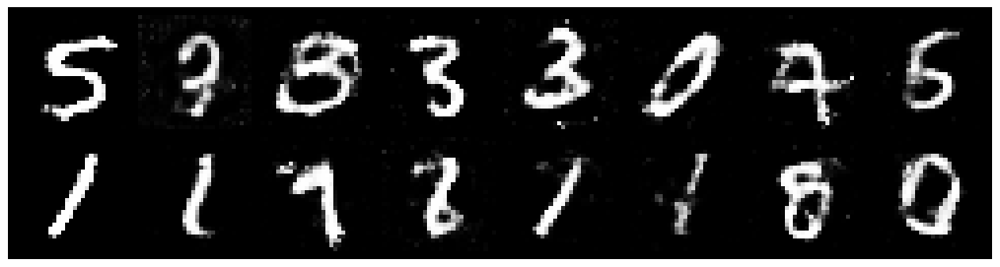

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.1814, Generator Loss: 0.9462
D(x): 0.5804, D(G(z)): 0.4313


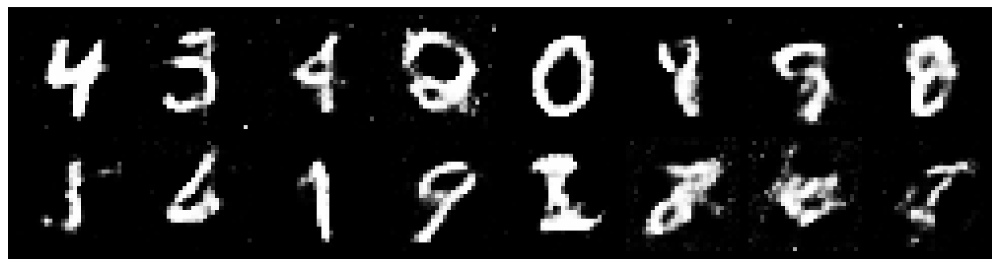

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.2527, Generator Loss: 0.8569
D(x): 0.5867, D(G(z)): 0.4491


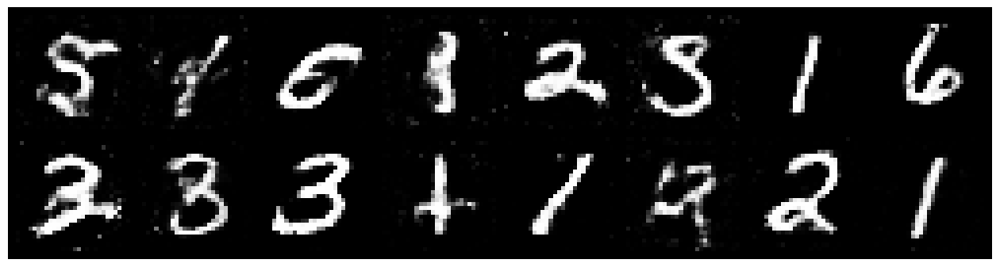

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.2816, Generator Loss: 0.9988
D(x): 0.5339, D(G(z)): 0.4283


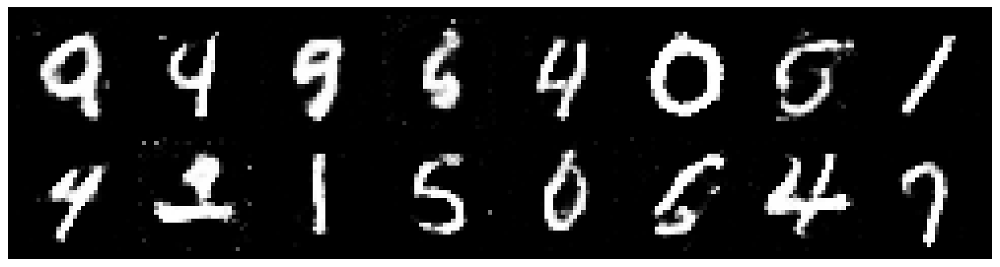

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.3340, Generator Loss: 0.9394
D(x): 0.5478, D(G(z)): 0.4433


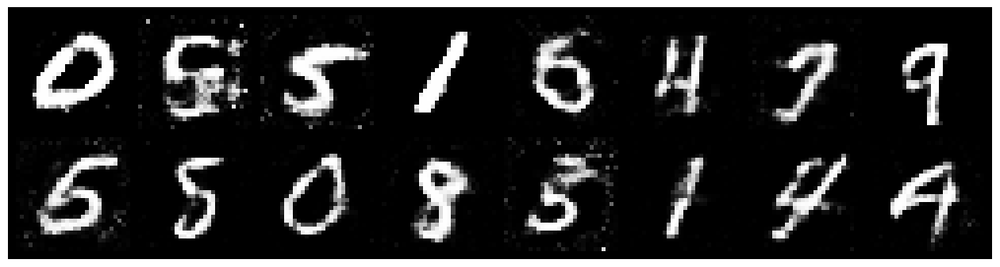

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.3211, Generator Loss: 0.8707
D(x): 0.5735, D(G(z)): 0.4703


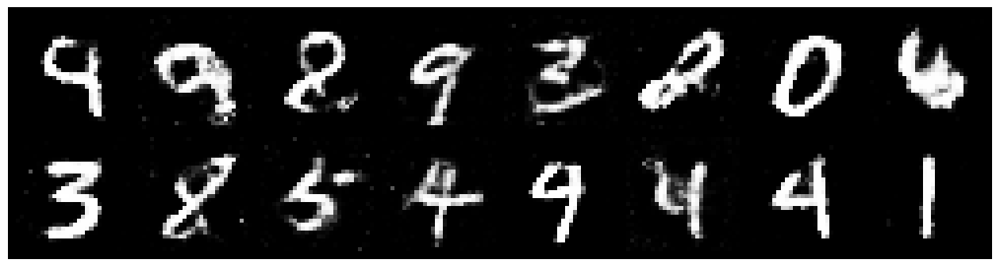

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.2999, Generator Loss: 0.8485
D(x): 0.5491, D(G(z)): 0.4430


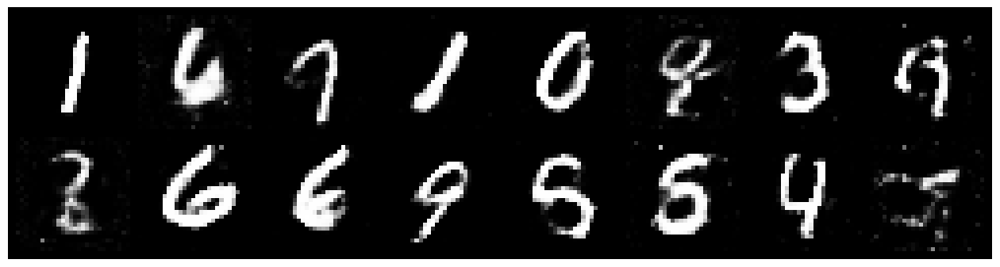

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.3546, Generator Loss: 0.7565
D(x): 0.5480, D(G(z)): 0.4671


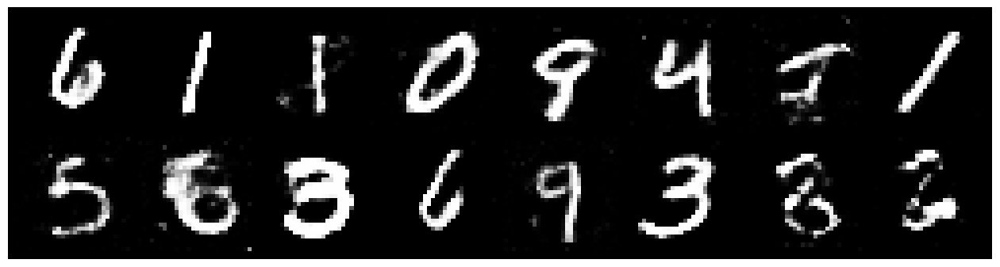

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.3128, Generator Loss: 0.9267
D(x): 0.5745, D(G(z)): 0.4510


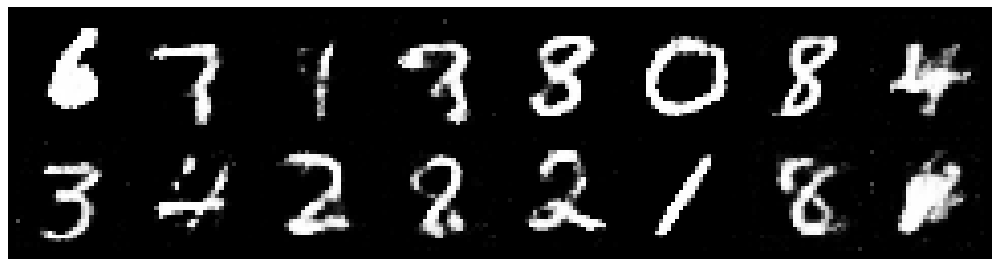

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2470, Generator Loss: 0.9215
D(x): 0.6201, D(G(z)): 0.4710


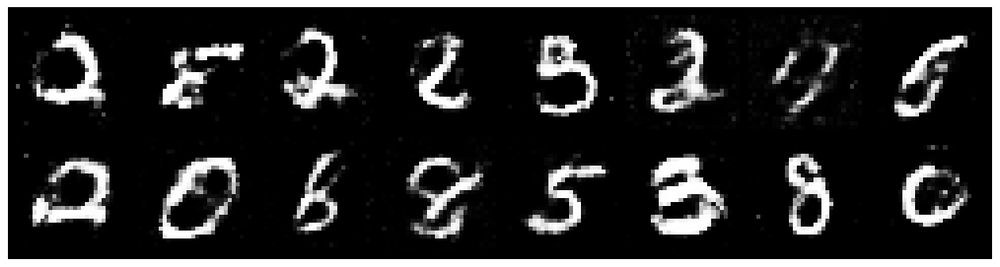

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.3006, Generator Loss: 0.9291
D(x): 0.5549, D(G(z)): 0.4506


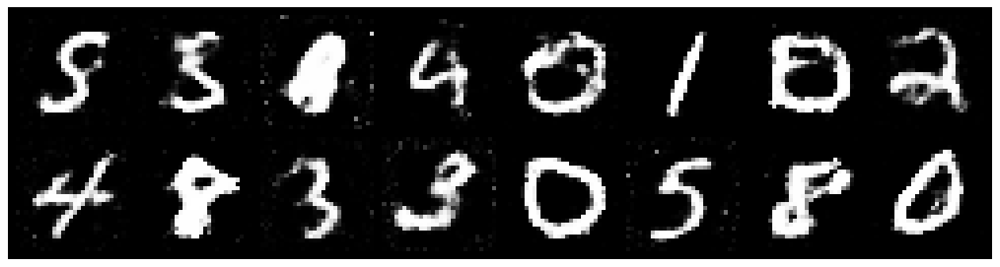

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.2391, Generator Loss: 0.8709
D(x): 0.5635, D(G(z)): 0.4419


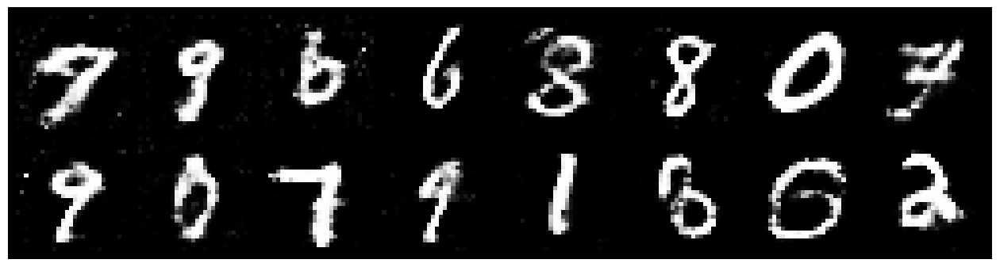

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.3092, Generator Loss: 0.9529
D(x): 0.5626, D(G(z)): 0.4712


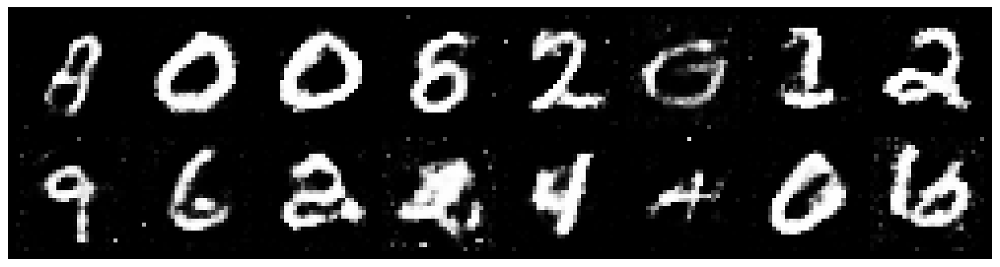

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.2281, Generator Loss: 0.7972
D(x): 0.5545, D(G(z)): 0.4256


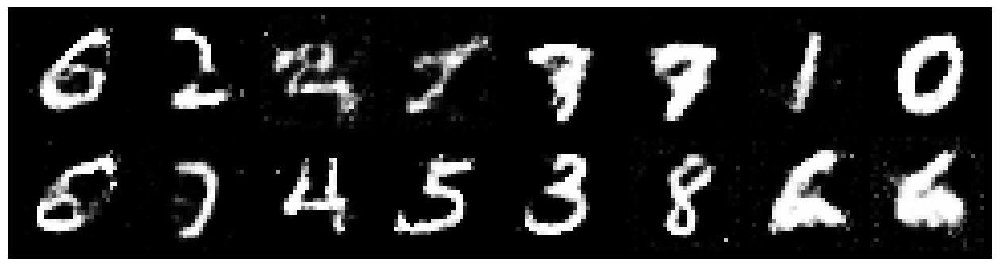

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.2980, Generator Loss: 0.8544
D(x): 0.5341, D(G(z)): 0.4584


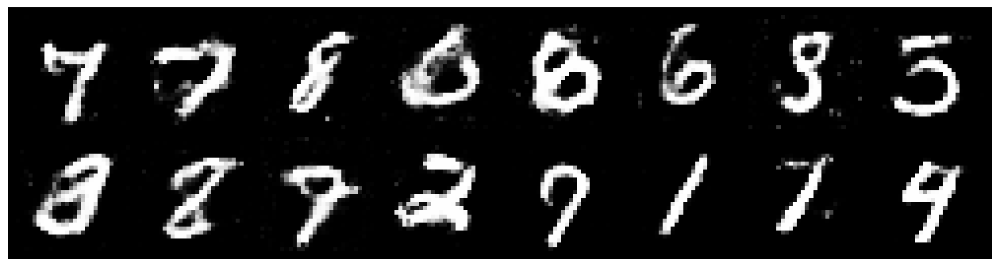

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.3799, Generator Loss: 0.8256
D(x): 0.5323, D(G(z)): 0.4767


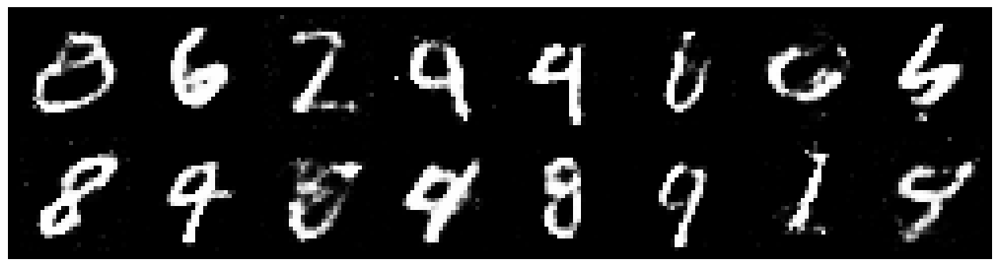

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.3526, Generator Loss: 0.7817
D(x): 0.5126, D(G(z)): 0.4644


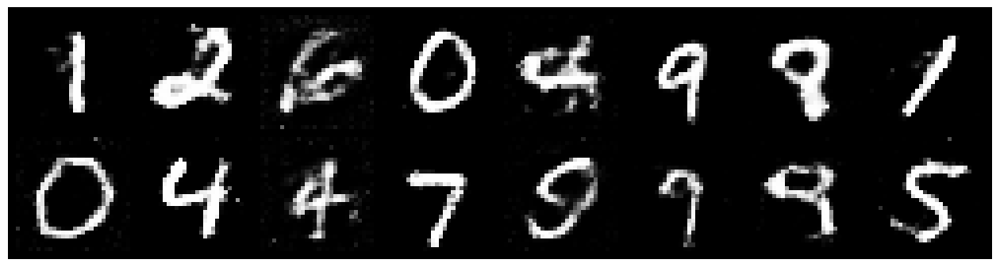

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.2700, Generator Loss: 0.8144
D(x): 0.5731, D(G(z)): 0.4646


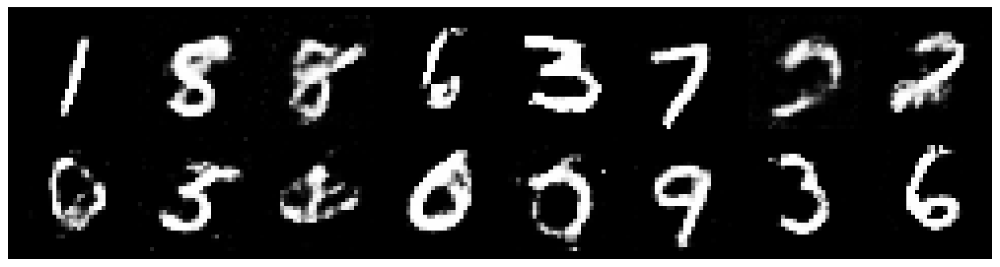

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.2142, Generator Loss: 1.0160
D(x): 0.5769, D(G(z)): 0.4202


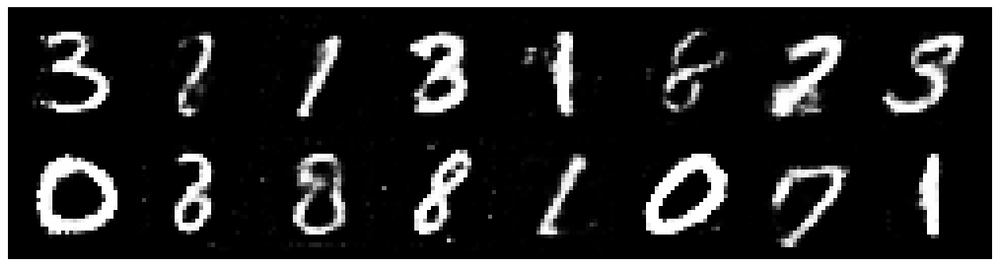

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.2153, Generator Loss: 0.9578
D(x): 0.5525, D(G(z)): 0.4332


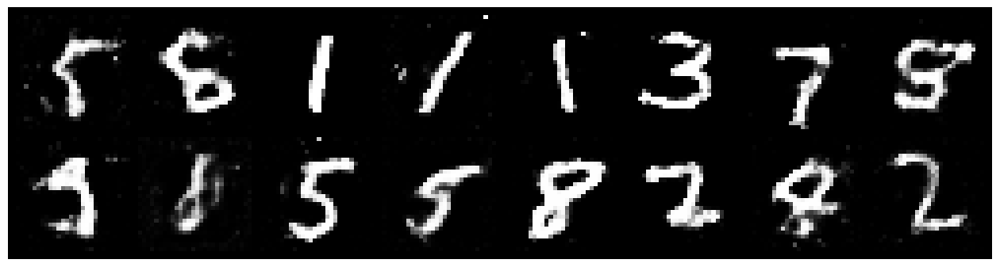

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.2672, Generator Loss: 0.8520
D(x): 0.5556, D(G(z)): 0.4629


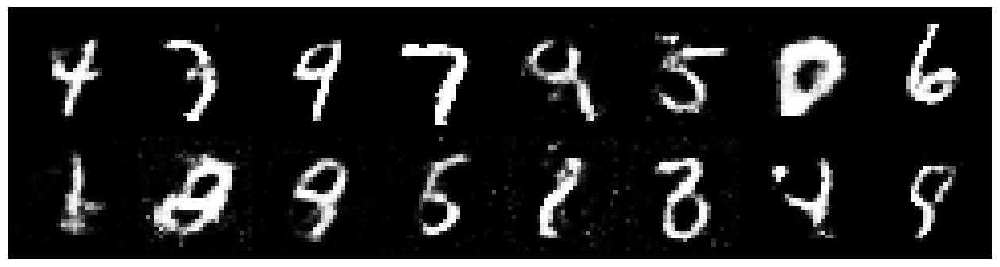

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.2782, Generator Loss: 0.9496
D(x): 0.5659, D(G(z)): 0.4488


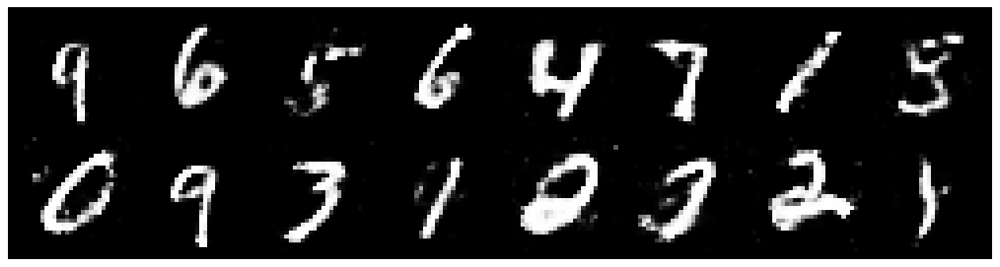

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.3952, Generator Loss: 0.8247
D(x): 0.5397, D(G(z)): 0.4846


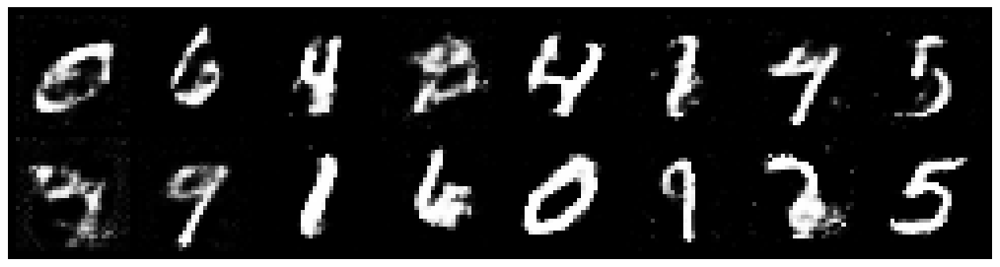

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.3287, Generator Loss: 0.7913
D(x): 0.5377, D(G(z)): 0.4528


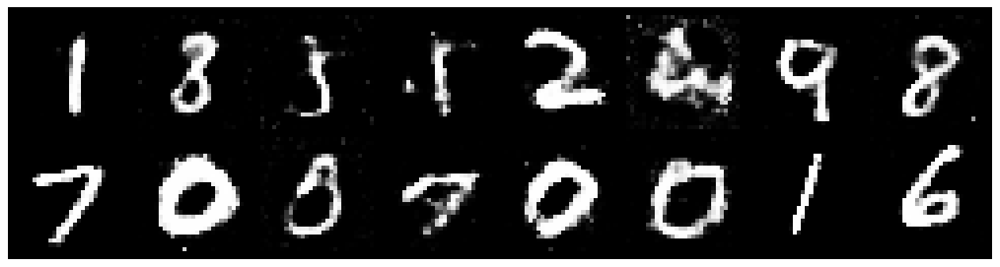

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.2907, Generator Loss: 0.7344
D(x): 0.5494, D(G(z)): 0.4802


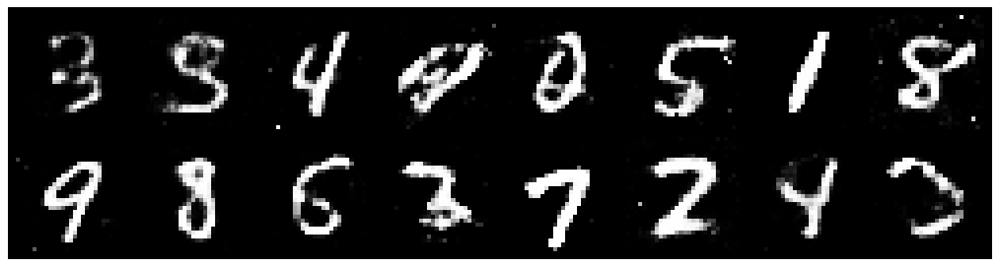

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.2428, Generator Loss: 0.7966
D(x): 0.5644, D(G(z)): 0.4514


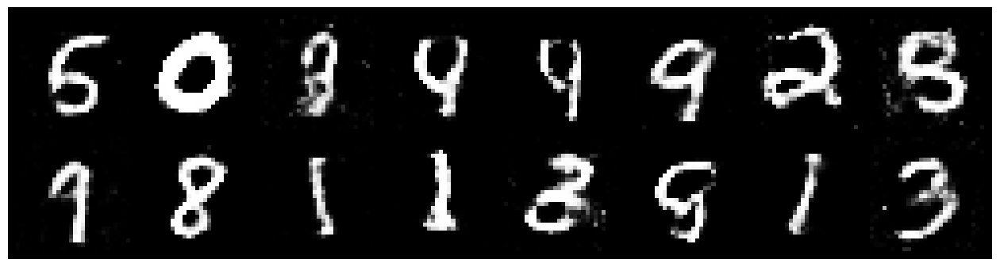

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.3272, Generator Loss: 0.8815
D(x): 0.5446, D(G(z)): 0.4661


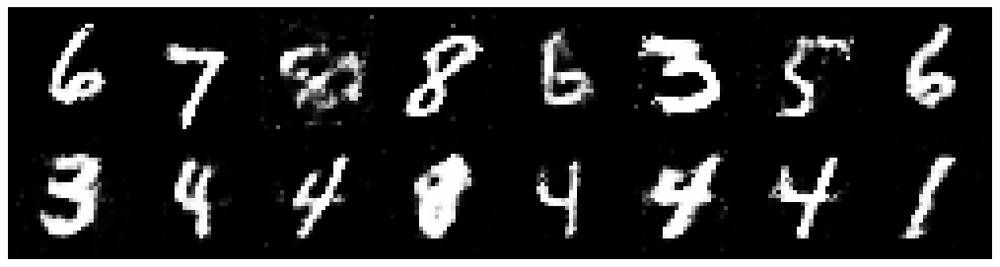

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.2196, Generator Loss: 0.8283
D(x): 0.5645, D(G(z)): 0.4398


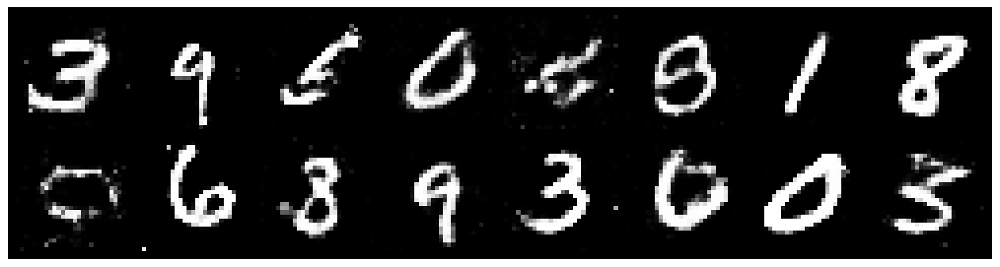

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.3843, Generator Loss: 0.8425
D(x): 0.4955, D(G(z)): 0.4627


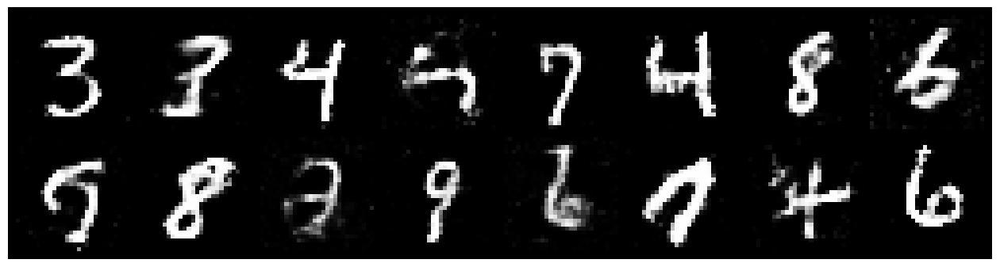

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.3754, Generator Loss: 0.8170
D(x): 0.5336, D(G(z)): 0.4750


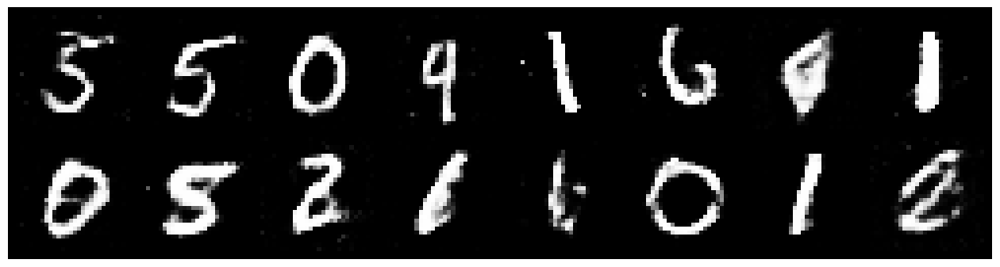

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.2897, Generator Loss: 0.9132
D(x): 0.5333, D(G(z)): 0.4331


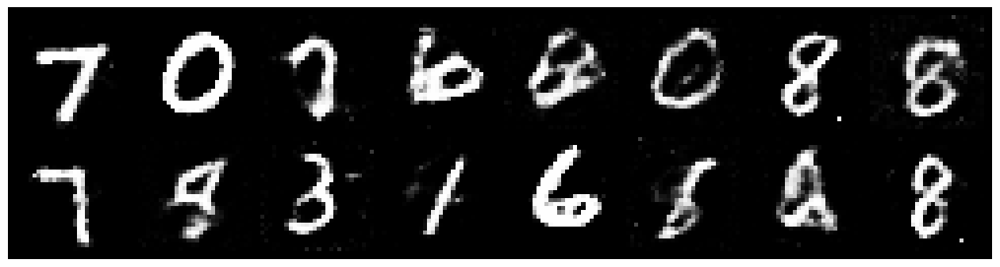

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9693
D(x): 0.5913, D(G(z)): 0.4488


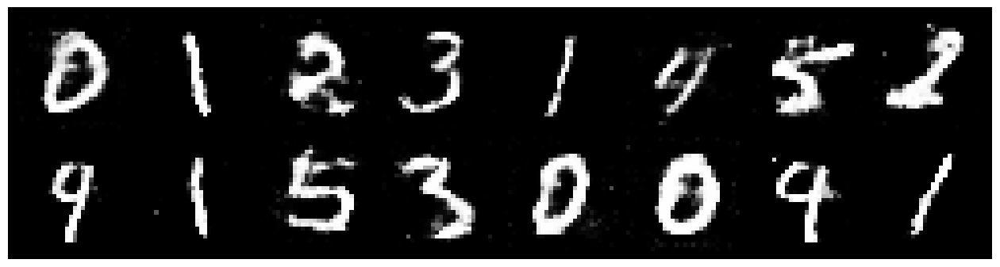

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.2341, Generator Loss: 0.9028
D(x): 0.5338, D(G(z)): 0.4276


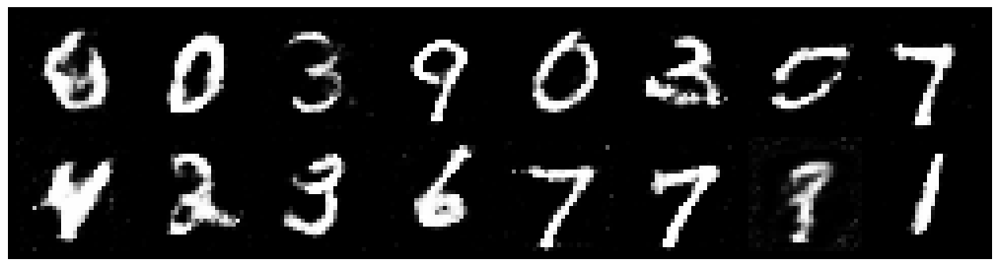

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.3343, Generator Loss: 0.9135
D(x): 0.5134, D(G(z)): 0.4271


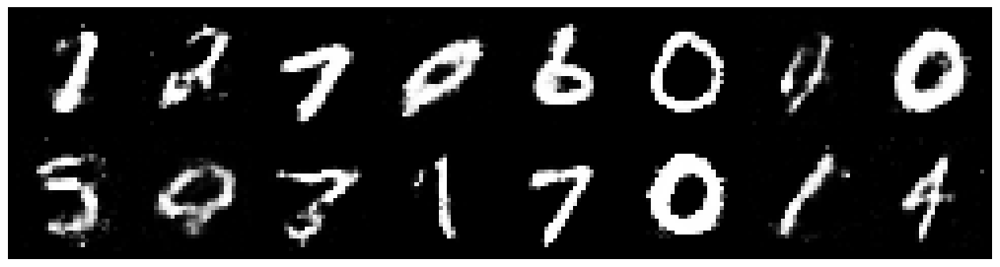

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.3051, Generator Loss: 0.8682
D(x): 0.5295, D(G(z)): 0.4494


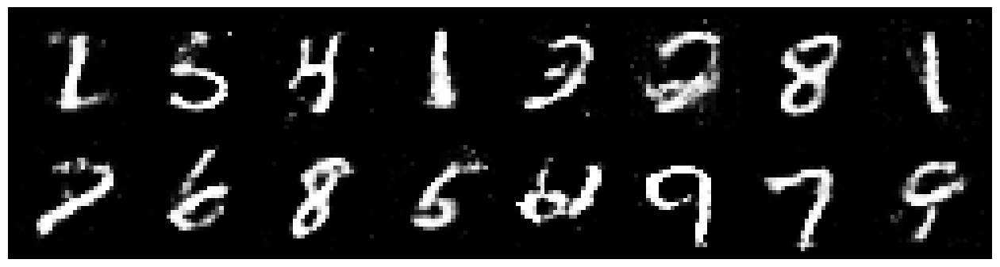

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.3339, Generator Loss: 0.9075
D(x): 0.5484, D(G(z)): 0.4676


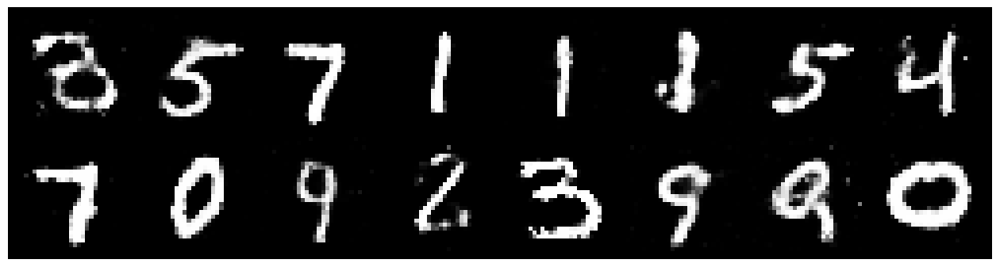

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.2694, Generator Loss: 1.0057
D(x): 0.5236, D(G(z)): 0.4060


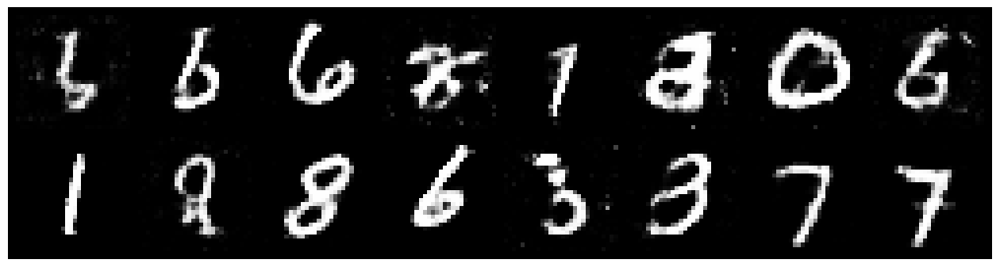

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.3232, Generator Loss: 1.0961
D(x): 0.5850, D(G(z)): 0.4564


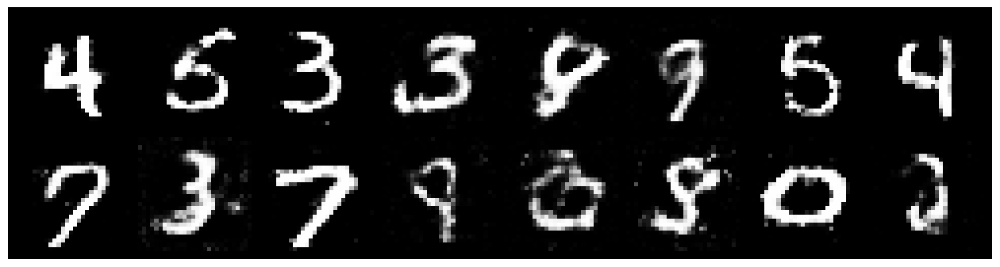

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.4496, Generator Loss: 0.7736
D(x): 0.5164, D(G(z)): 0.5023


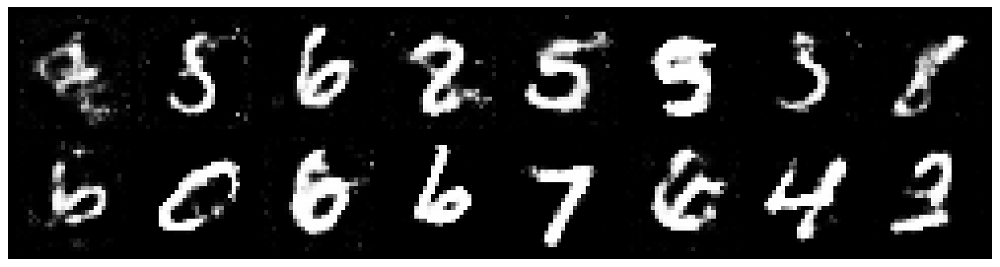

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.2944, Generator Loss: 0.9413
D(x): 0.5342, D(G(z)): 0.4471


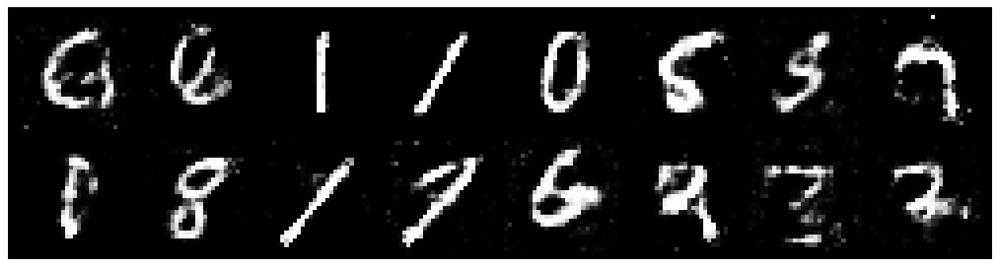

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.3155, Generator Loss: 0.8795
D(x): 0.5302, D(G(z)): 0.4475


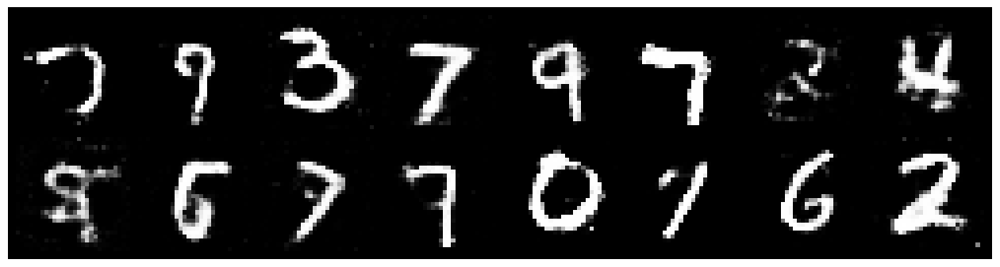

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.3160, Generator Loss: 0.7879
D(x): 0.5625, D(G(z)): 0.4701


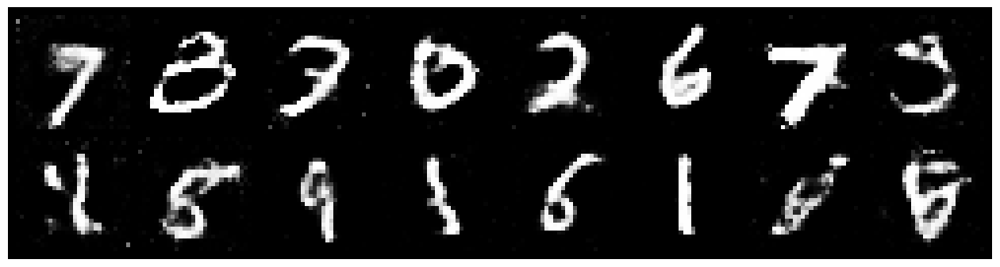

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.3177, Generator Loss: 0.8471
D(x): 0.5753, D(G(z)): 0.4841


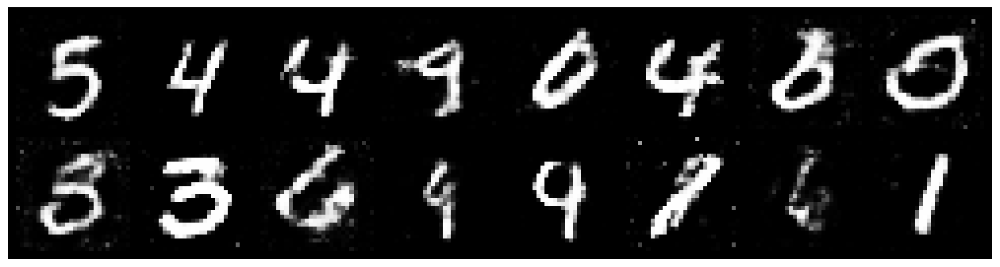

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.2796, Generator Loss: 1.0111
D(x): 0.5339, D(G(z)): 0.4043


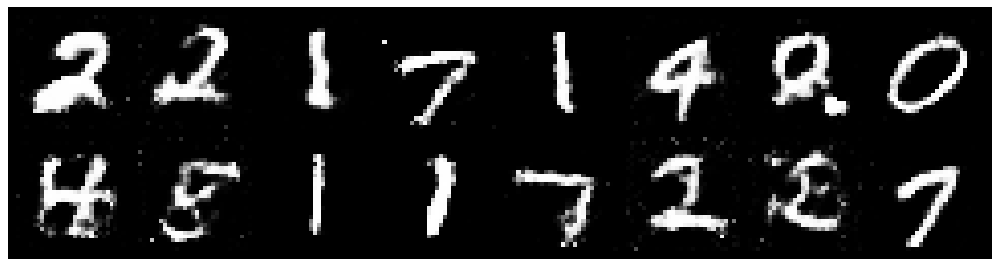

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.2950, Generator Loss: 0.9915
D(x): 0.5269, D(G(z)): 0.4302


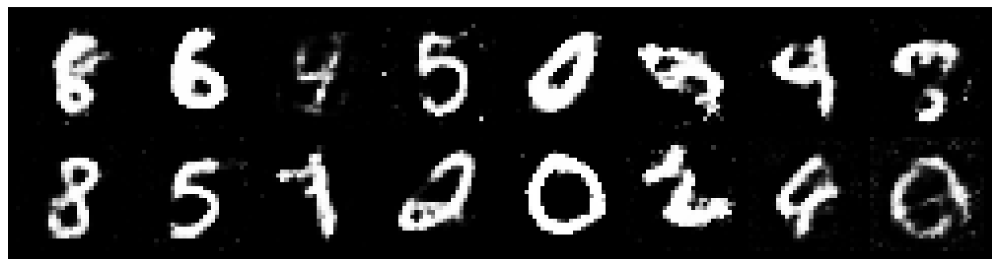

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.2633, Generator Loss: 1.0013
D(x): 0.5194, D(G(z)): 0.4050


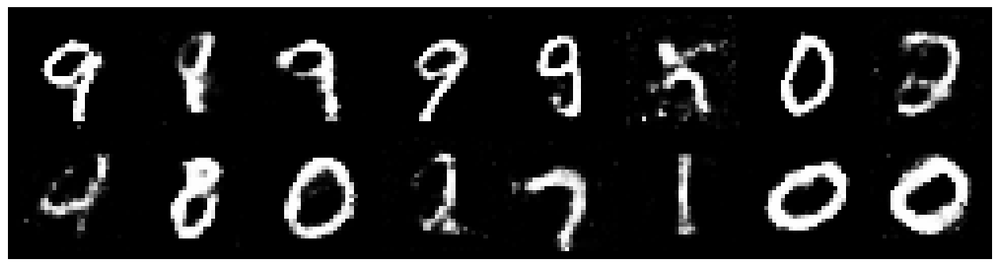

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.1391, Generator Loss: 0.9742
D(x): 0.6096, D(G(z)): 0.4203


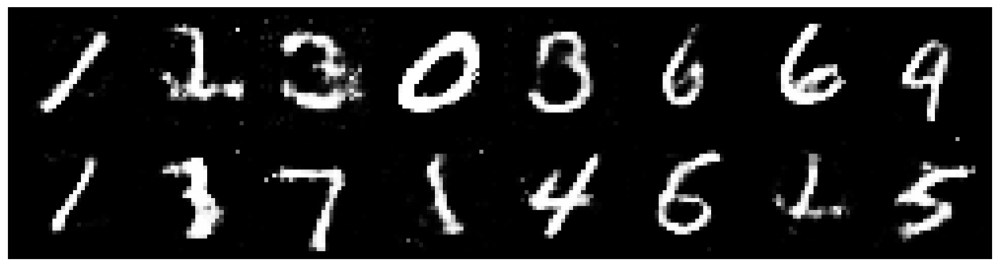

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.2522, Generator Loss: 1.0149
D(x): 0.5380, D(G(z)): 0.4065


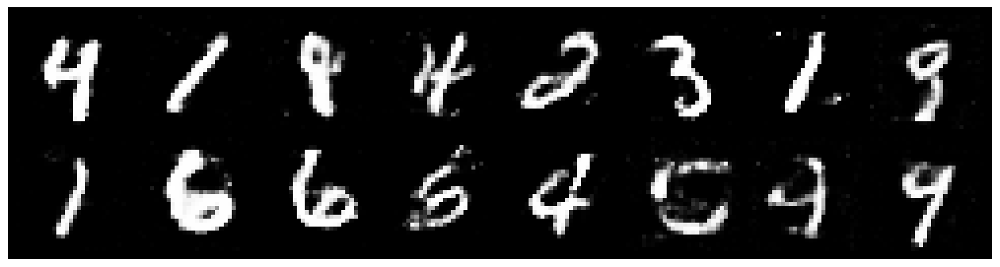

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.2221, Generator Loss: 0.9559
D(x): 0.5863, D(G(z)): 0.4403


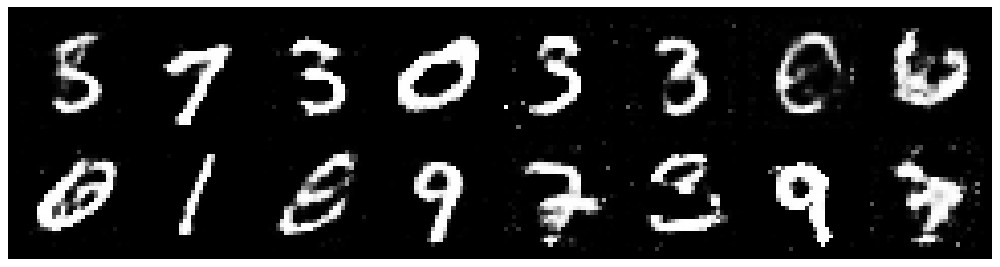

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.3036, Generator Loss: 0.8944
D(x): 0.5480, D(G(z)): 0.4480


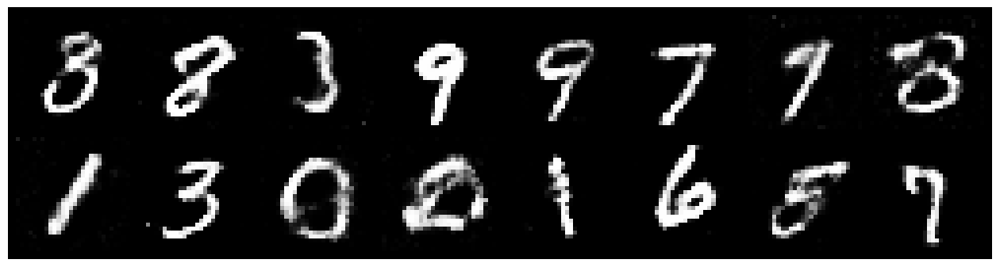

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.2540, Generator Loss: 0.8732
D(x): 0.5837, D(G(z)): 0.4572


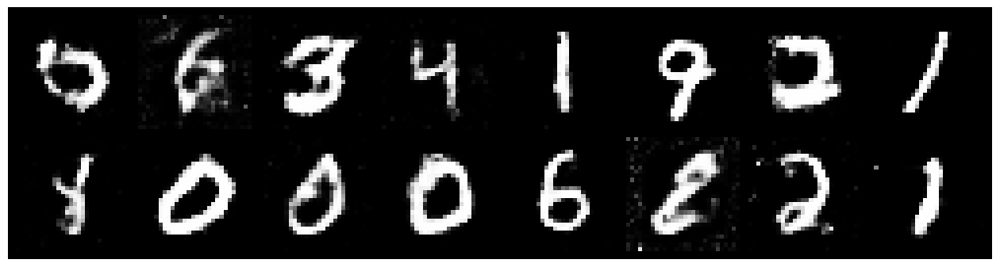

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.3065, Generator Loss: 0.8084
D(x): 0.5548, D(G(z)): 0.4715


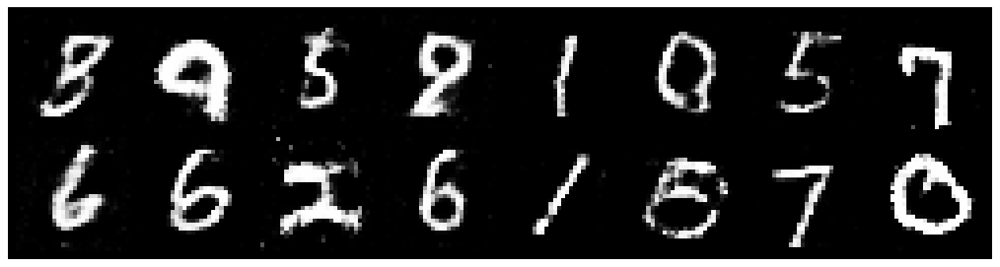

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.2853, Generator Loss: 0.9424
D(x): 0.5504, D(G(z)): 0.4401


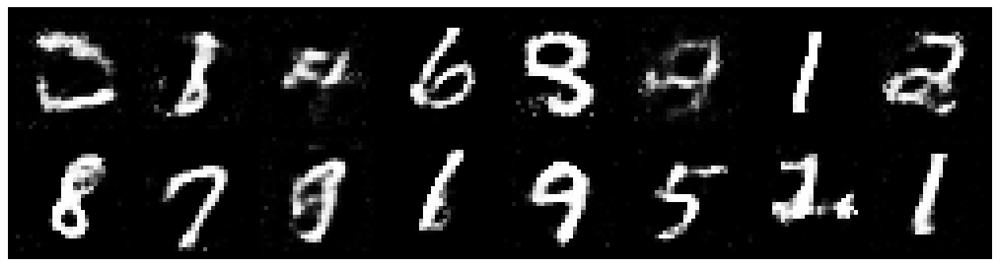

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.3258, Generator Loss: 0.8311
D(x): 0.5301, D(G(z)): 0.4416


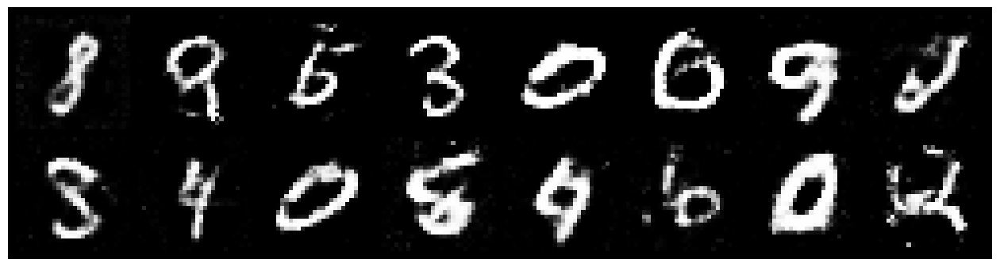

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.2835, Generator Loss: 0.8772
D(x): 0.5431, D(G(z)): 0.4410


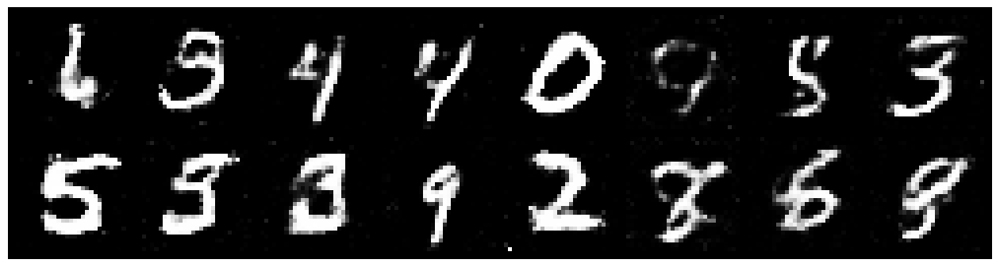

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.2603, Generator Loss: 0.8479
D(x): 0.5323, D(G(z)): 0.4352


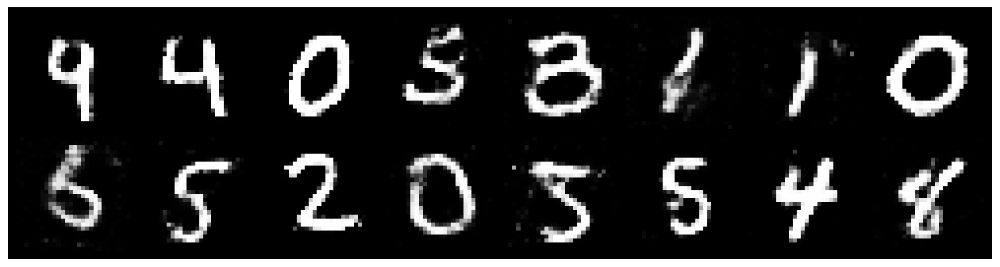

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.2035, Generator Loss: 0.8779
D(x): 0.5872, D(G(z)): 0.4501


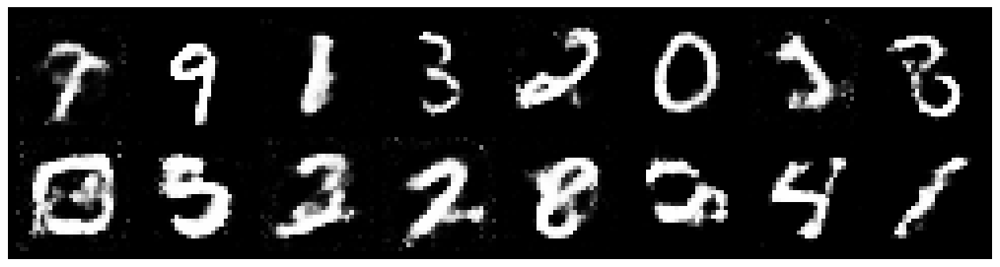

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.1819, Generator Loss: 1.0436
D(x): 0.5218, D(G(z)): 0.3520


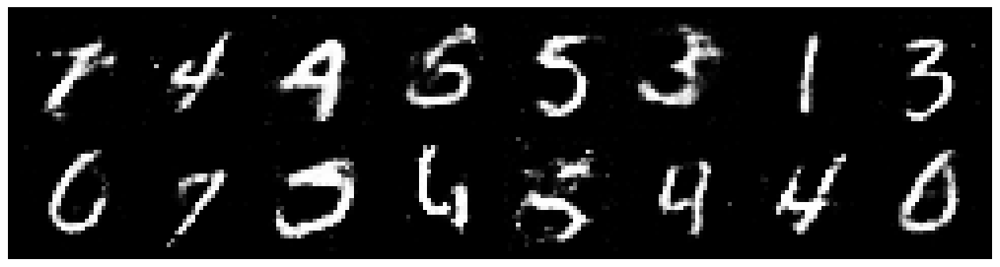

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2029, Generator Loss: 0.8805
D(x): 0.5898, D(G(z)): 0.4417


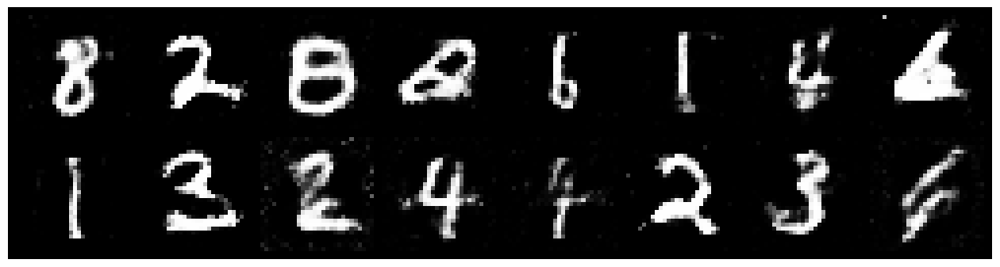

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.2861, Generator Loss: 0.7986
D(x): 0.5548, D(G(z)): 0.4583


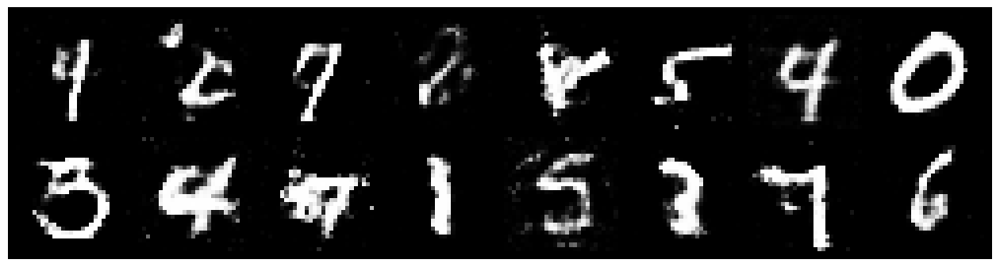

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.2927, Generator Loss: 0.8726
D(x): 0.5464, D(G(z)): 0.4434


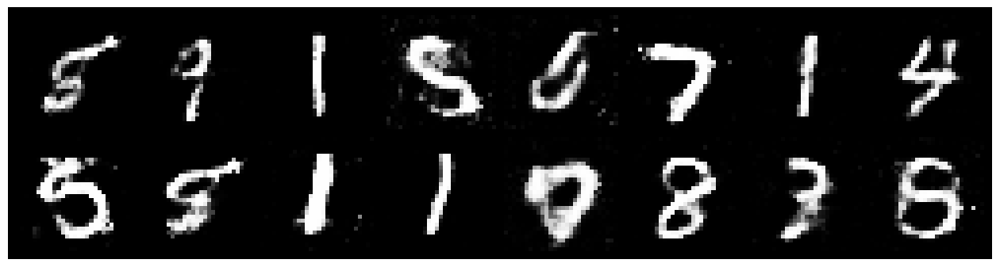

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.4308, Generator Loss: 0.7858
D(x): 0.5208, D(G(z)): 0.4640


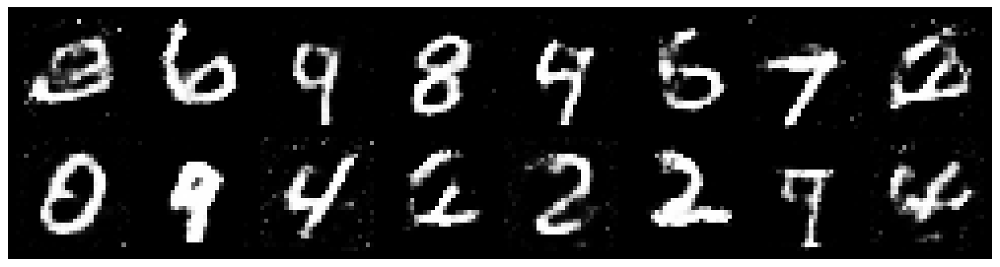

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.3364, Generator Loss: 0.8859
D(x): 0.5493, D(G(z)): 0.4546


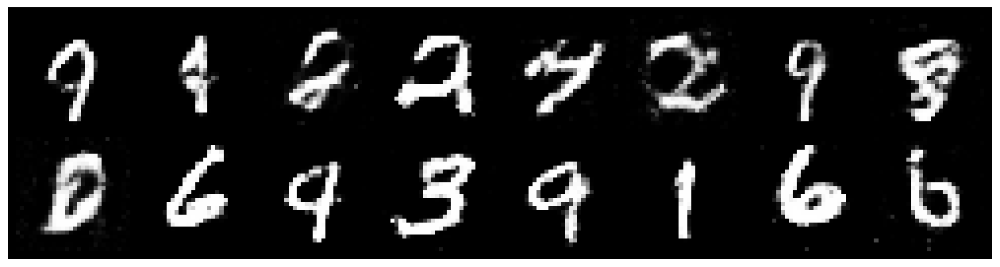

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.1438, Generator Loss: 1.1044
D(x): 0.5385, D(G(z)): 0.3567


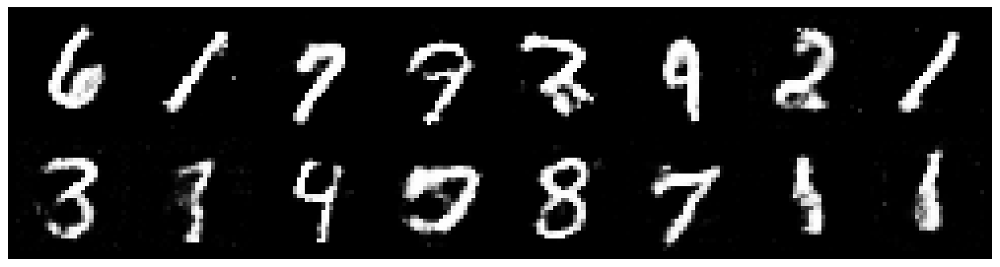

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.1784, Generator Loss: 0.9931
D(x): 0.5638, D(G(z)): 0.4003


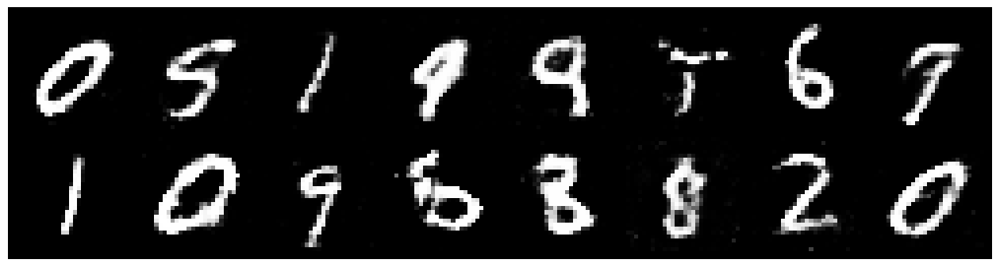

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.1820, Generator Loss: 1.0617
D(x): 0.6003, D(G(z)): 0.4284


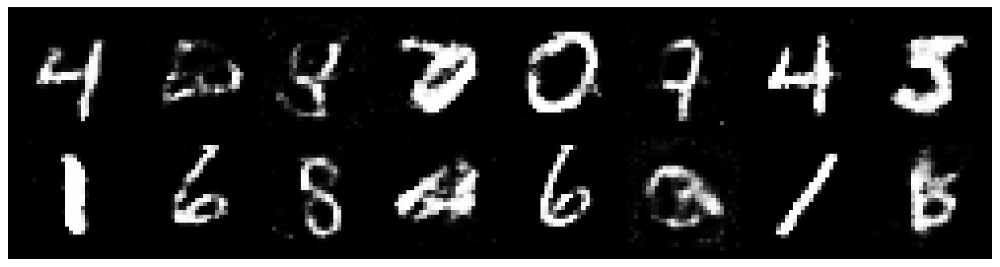

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.2084, Generator Loss: 1.0118
D(x): 0.5485, D(G(z)): 0.3734


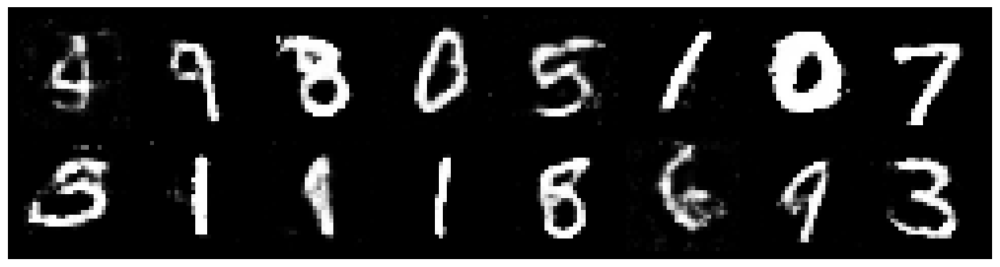

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.2634, Generator Loss: 0.8504
D(x): 0.5513, D(G(z)): 0.4432


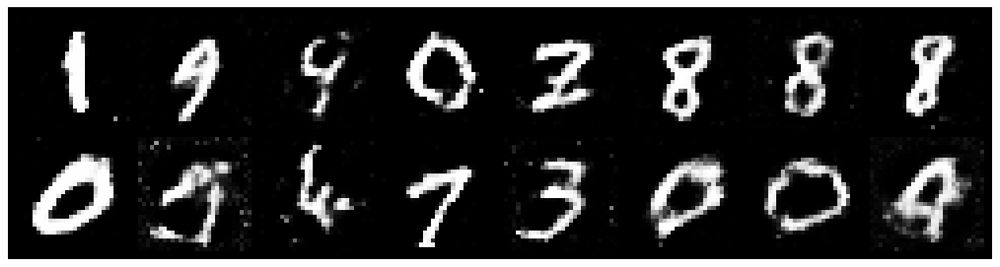

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2508, Generator Loss: 0.9313
D(x): 0.5469, D(G(z)): 0.4253


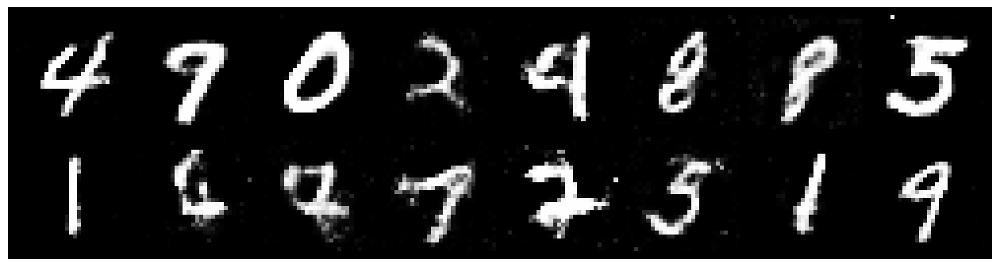

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.2888, Generator Loss: 0.9458
D(x): 0.5479, D(G(z)): 0.4503


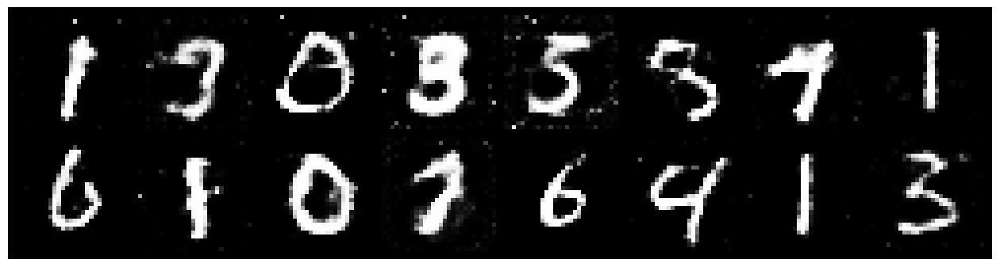

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.4451, Generator Loss: 0.8458
D(x): 0.5302, D(G(z)): 0.5012


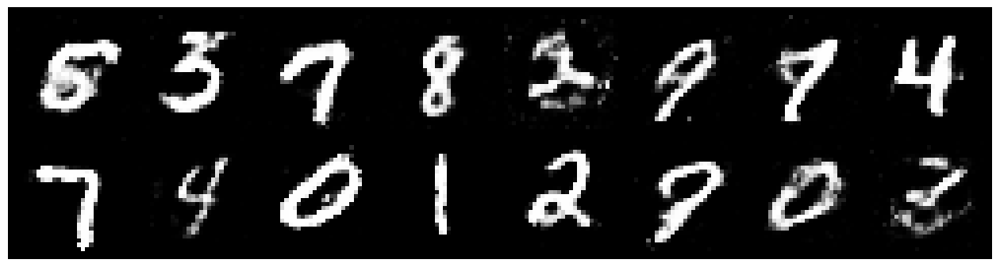

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.3146, Generator Loss: 0.8799
D(x): 0.5613, D(G(z)): 0.4605


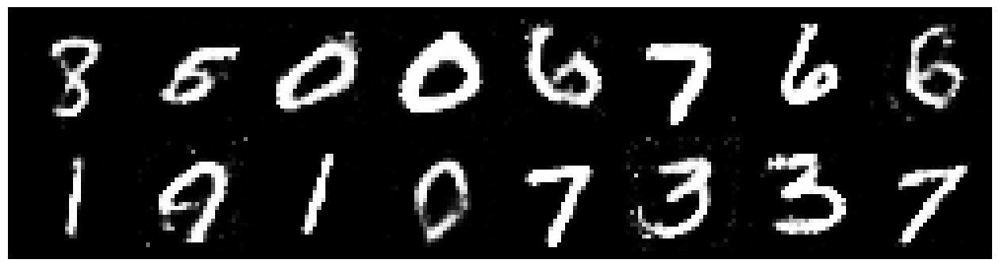

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.3276, Generator Loss: 0.9006
D(x): 0.5600, D(G(z)): 0.4722


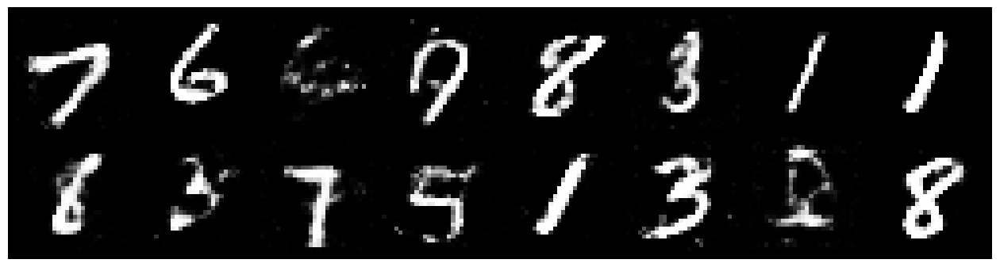

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.2601, Generator Loss: 0.7713
D(x): 0.5604, D(G(z)): 0.4675


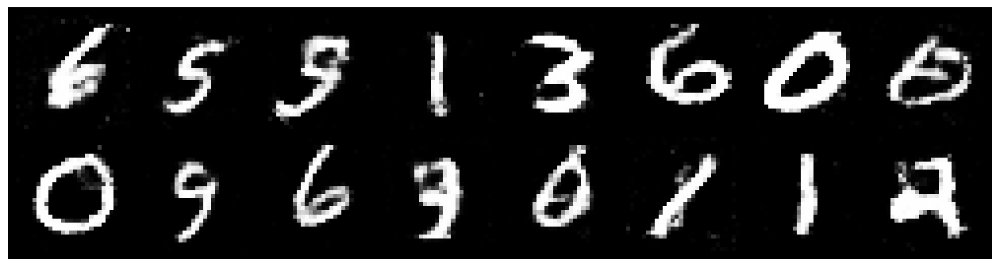

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.3953, Generator Loss: 0.8848
D(x): 0.4986, D(G(z)): 0.4533


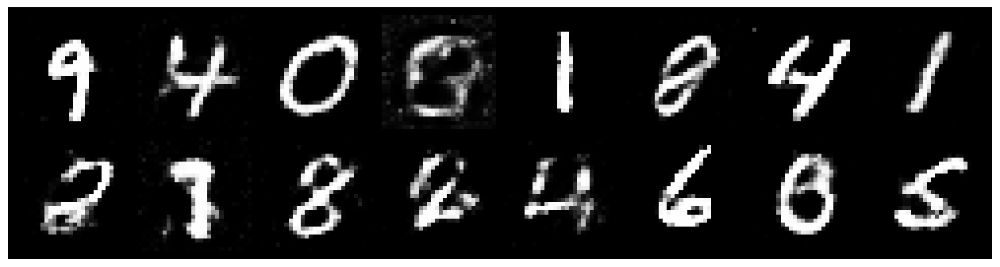

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.3376, Generator Loss: 0.7819
D(x): 0.5255, D(G(z)): 0.4513


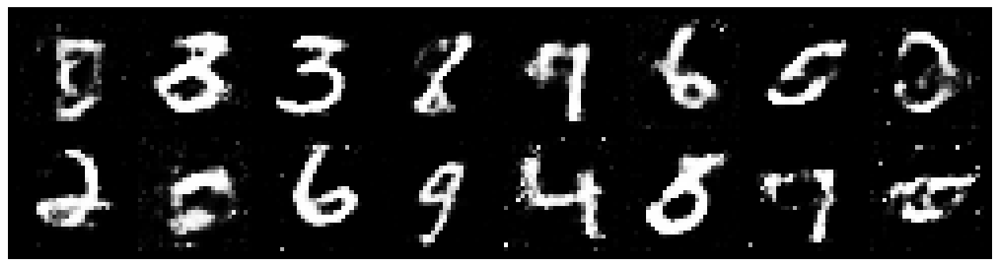

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.2420, Generator Loss: 0.7123
D(x): 0.5953, D(G(z)): 0.4758


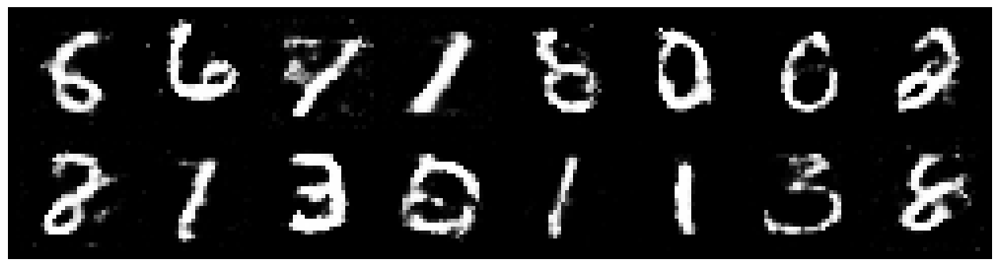

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.2674, Generator Loss: 0.8131
D(x): 0.5688, D(G(z)): 0.4651


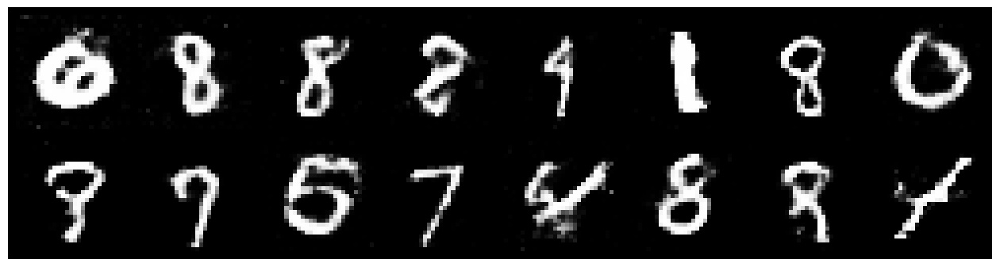

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.3742, Generator Loss: 0.8537
D(x): 0.5121, D(G(z)): 0.4536


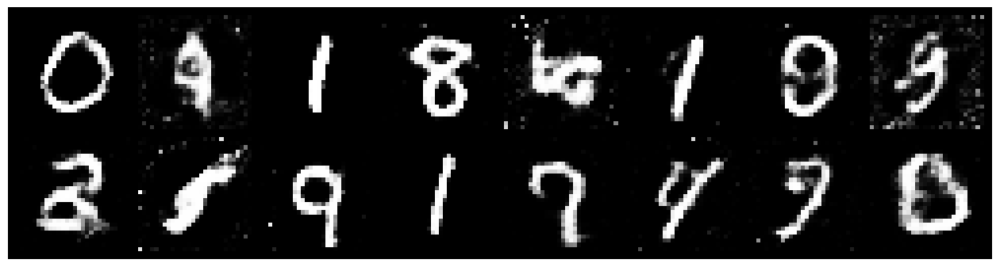

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.3006, Generator Loss: 0.7797
D(x): 0.5530, D(G(z)): 0.4681


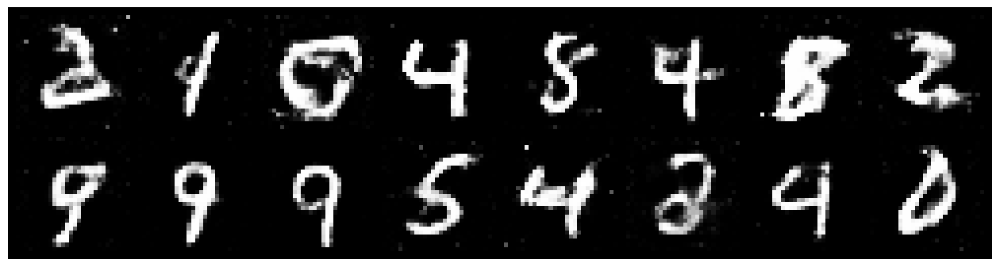

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.2234, Generator Loss: 0.9574
D(x): 0.5523, D(G(z)): 0.4170


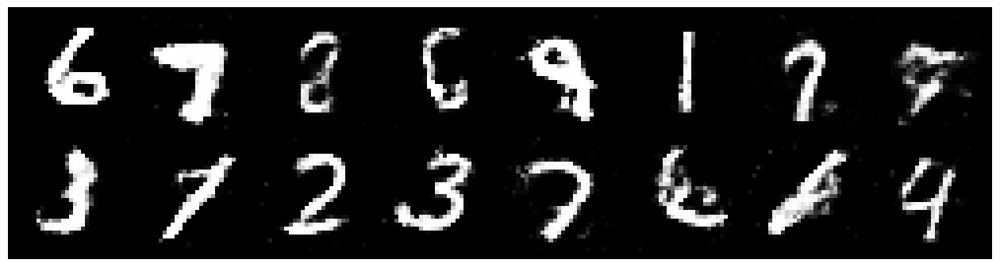

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.2746, Generator Loss: 0.8576
D(x): 0.5372, D(G(z)): 0.4495


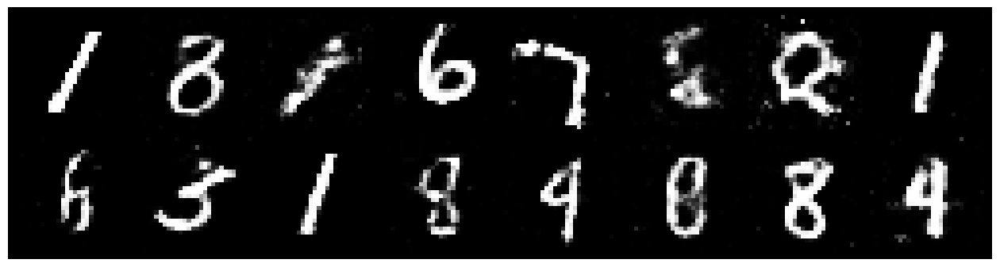

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.3784, Generator Loss: 0.9313
D(x): 0.5255, D(G(z)): 0.4593


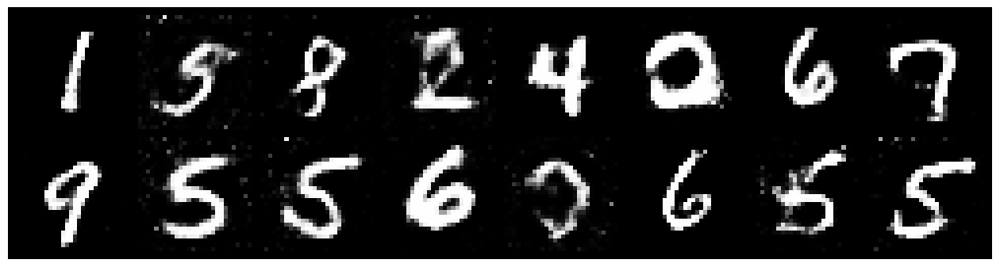

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.2512, Generator Loss: 0.9946
D(x): 0.5488, D(G(z)): 0.4146


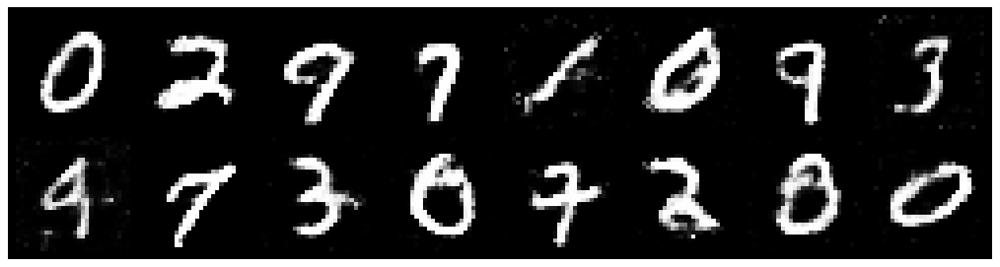

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.1644, Generator Loss: 1.0632
D(x): 0.5822, D(G(z)): 0.4023


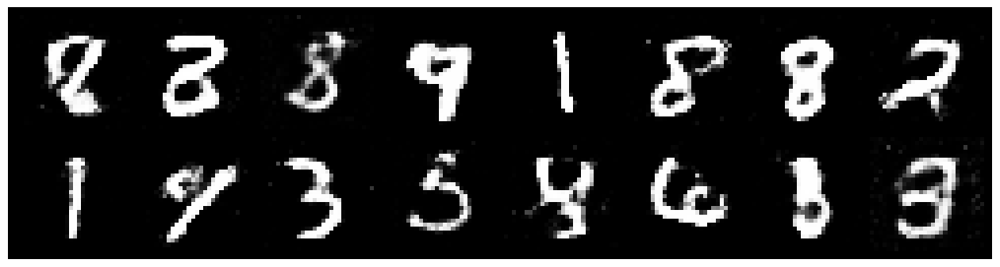

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.1513, Generator Loss: 0.8405
D(x): 0.5869, D(G(z)): 0.4140


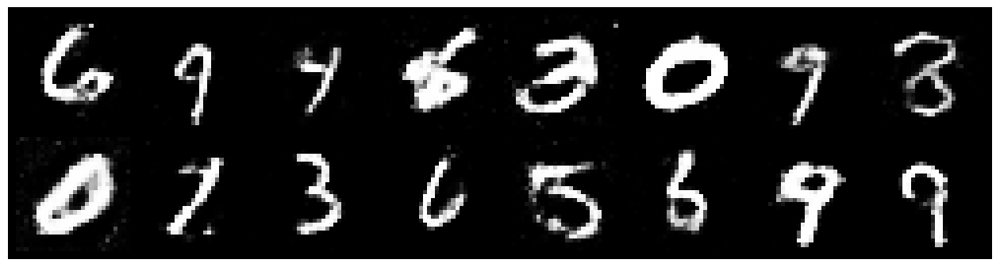

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.2378, Generator Loss: 0.9290
D(x): 0.5730, D(G(z)): 0.4573


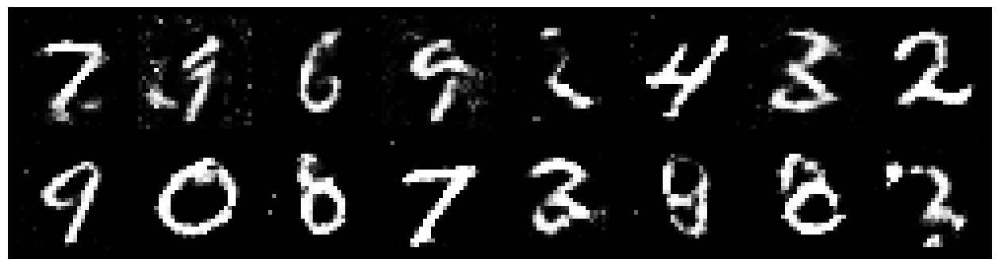

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.1955, Generator Loss: 0.9329
D(x): 0.5854, D(G(z)): 0.4360


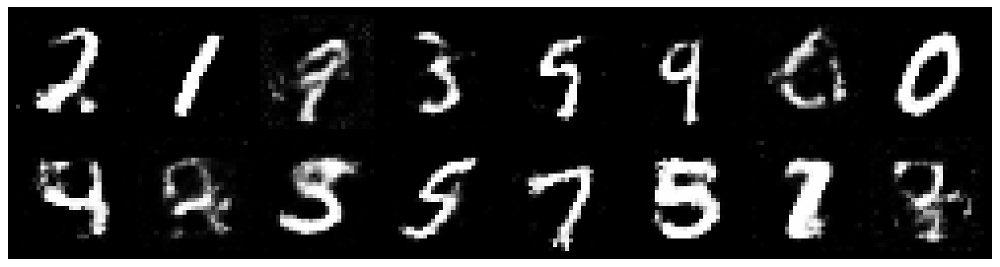

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.3056, Generator Loss: 0.8701
D(x): 0.5343, D(G(z)): 0.4318


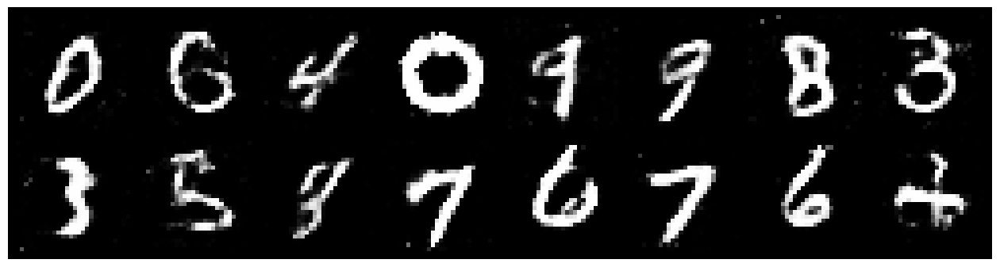

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.2532, Generator Loss: 0.8597
D(x): 0.6366, D(G(z)): 0.4620


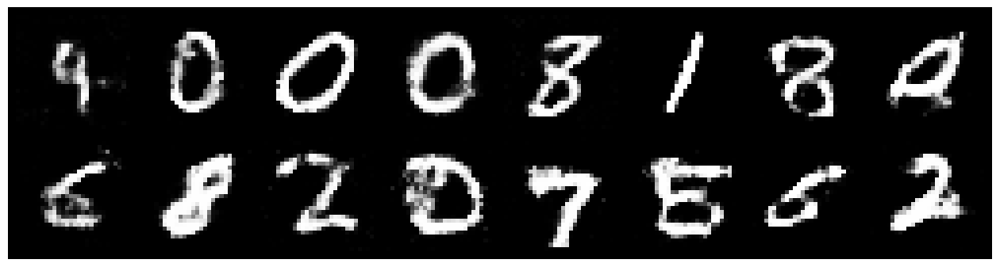

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.3442, Generator Loss: 0.9191
D(x): 0.5446, D(G(z)): 0.4606


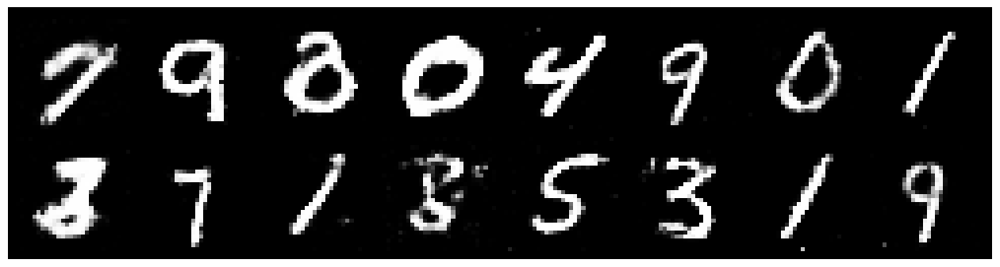

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.2534, Generator Loss: 0.8420
D(x): 0.5467, D(G(z)): 0.4447


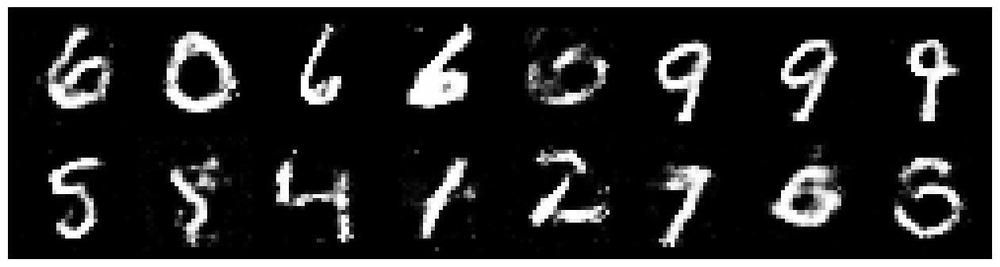

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.2378, Generator Loss: 0.7971
D(x): 0.5653, D(G(z)): 0.4587


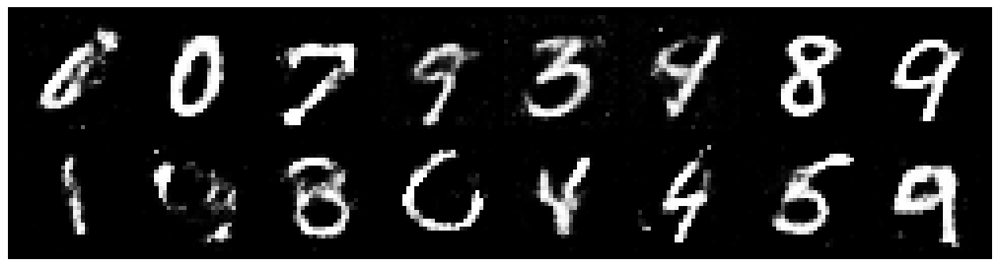

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.2785, Generator Loss: 0.8651
D(x): 0.5329, D(G(z)): 0.4377


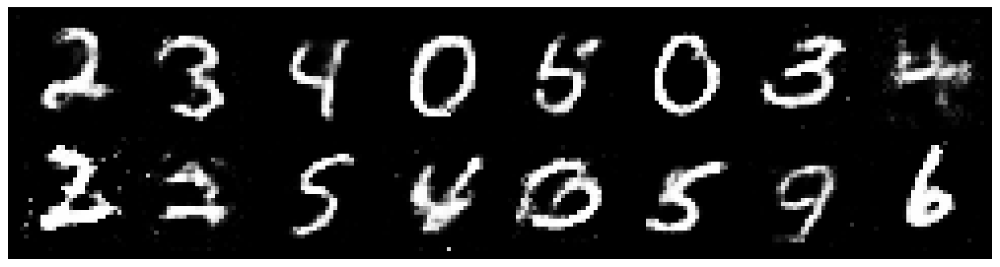

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.3230, Generator Loss: 0.8337
D(x): 0.5447, D(G(z)): 0.4845


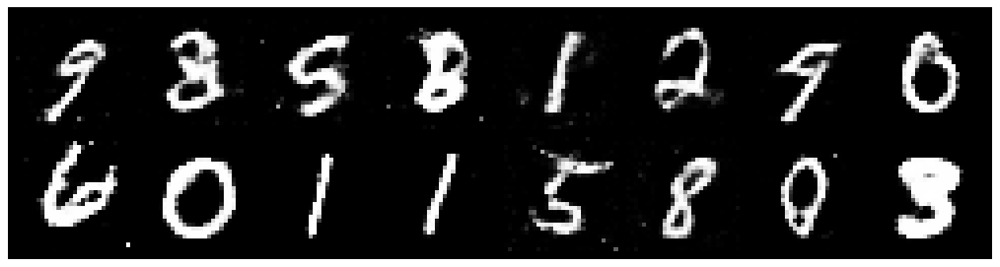

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.3074, Generator Loss: 0.8364
D(x): 0.6014, D(G(z)): 0.5054


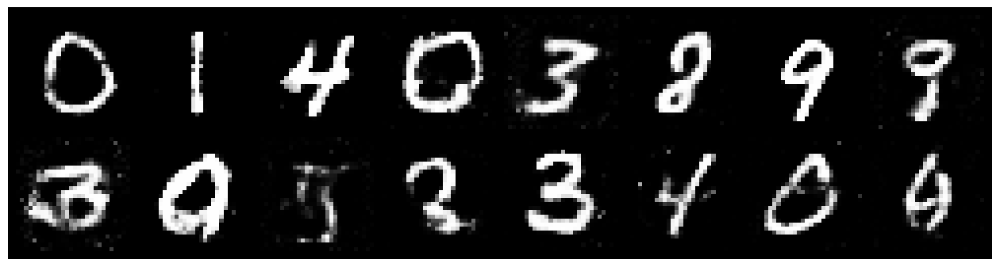

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.3427, Generator Loss: 0.8870
D(x): 0.5459, D(G(z)): 0.4531


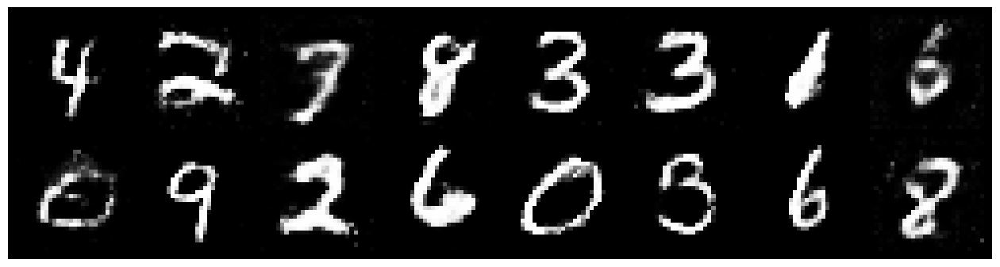

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.2045, Generator Loss: 0.9439
D(x): 0.5643, D(G(z)): 0.4330


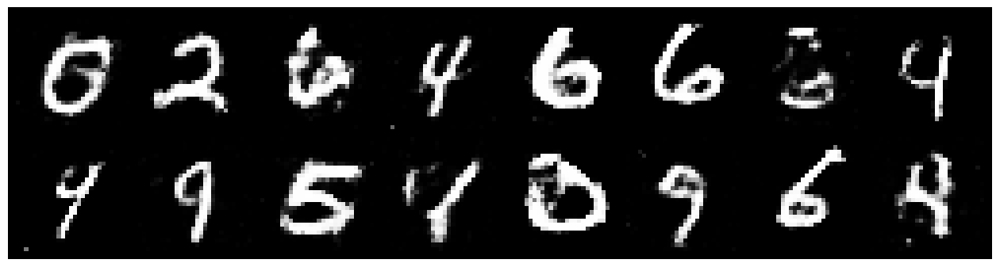

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.2587, Generator Loss: 0.8139
D(x): 0.5375, D(G(z)): 0.4386


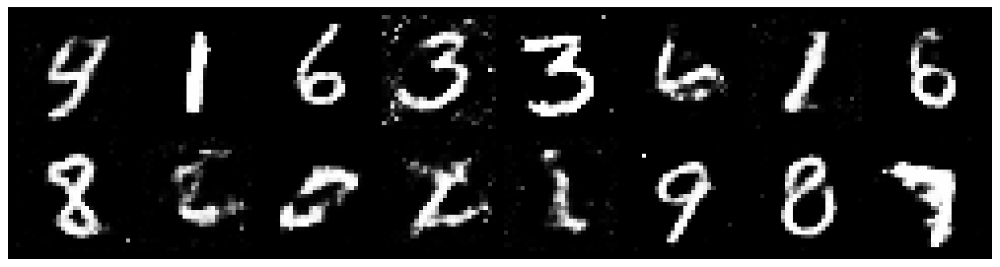

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.3248, Generator Loss: 0.7929
D(x): 0.5491, D(G(z)): 0.4544


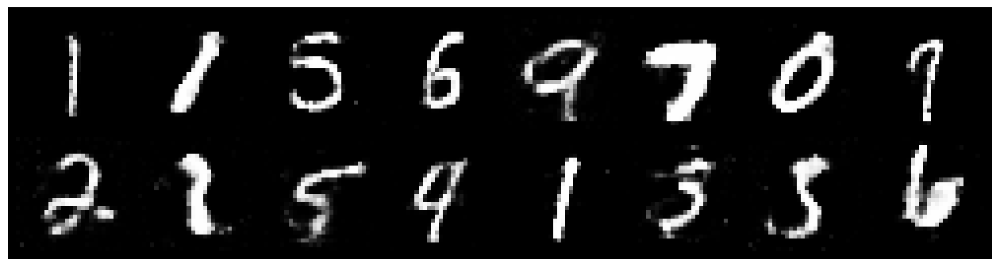

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.3781, Generator Loss: 0.8701
D(x): 0.5442, D(G(z)): 0.4915


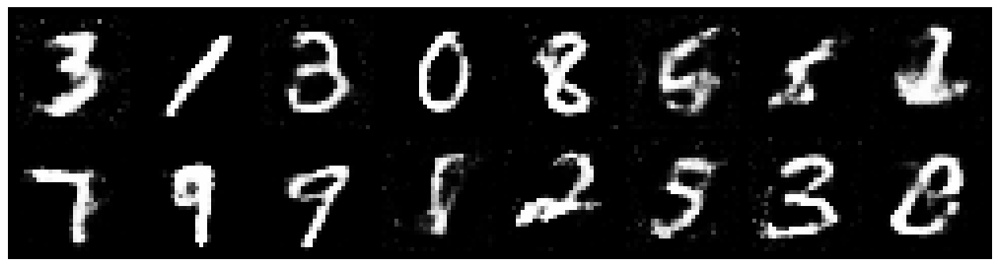

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.3326, Generator Loss: 0.8439
D(x): 0.5333, D(G(z)): 0.4568


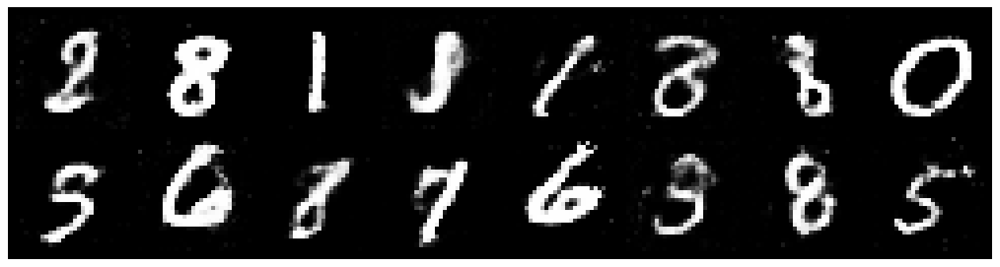

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.3398, Generator Loss: 0.9361
D(x): 0.5209, D(G(z)): 0.4476


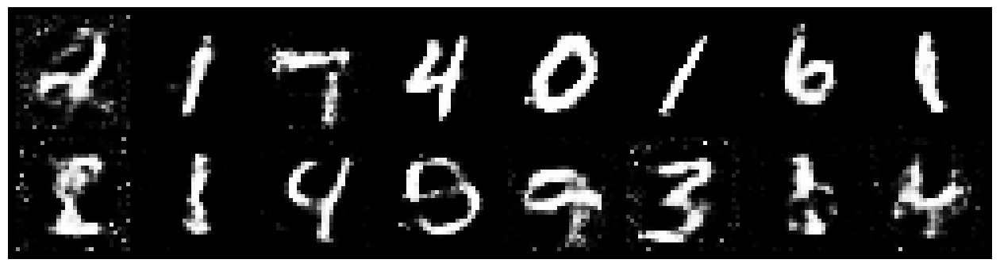

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2265, Generator Loss: 0.8987
D(x): 0.5567, D(G(z)): 0.4349


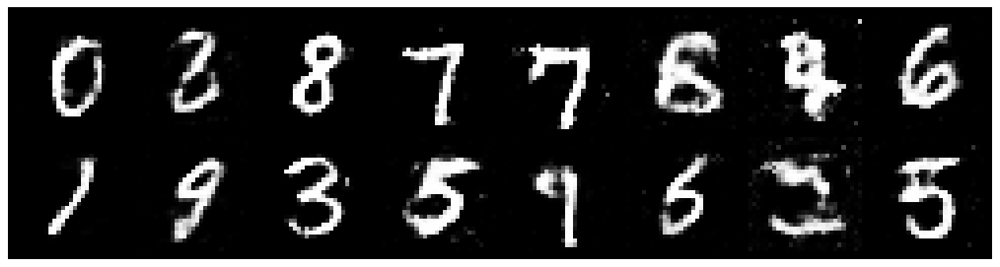

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2801, Generator Loss: 0.8664
D(x): 0.5442, D(G(z)): 0.4511


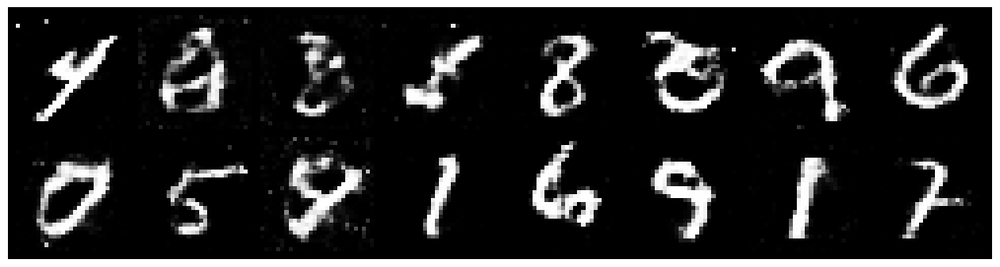

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.3060, Generator Loss: 0.7455
D(x): 0.5680, D(G(z)): 0.4938


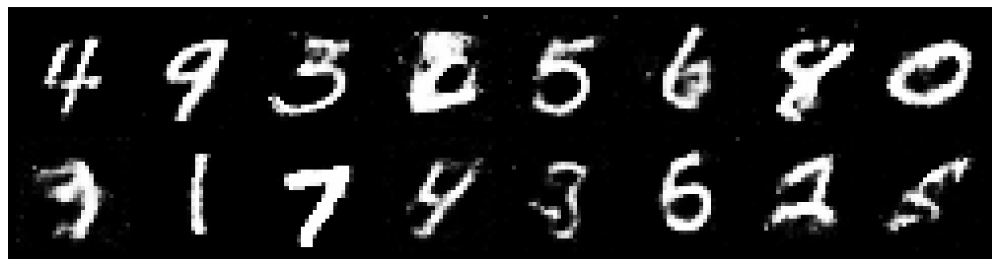

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.2890, Generator Loss: 0.9293
D(x): 0.5494, D(G(z)): 0.4547


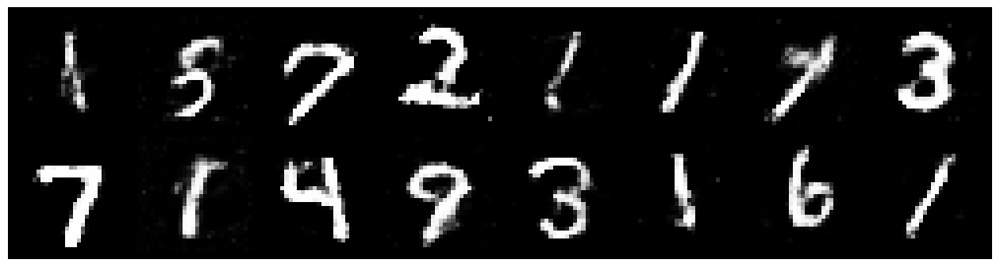

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.2911, Generator Loss: 0.9843
D(x): 0.5219, D(G(z)): 0.4150


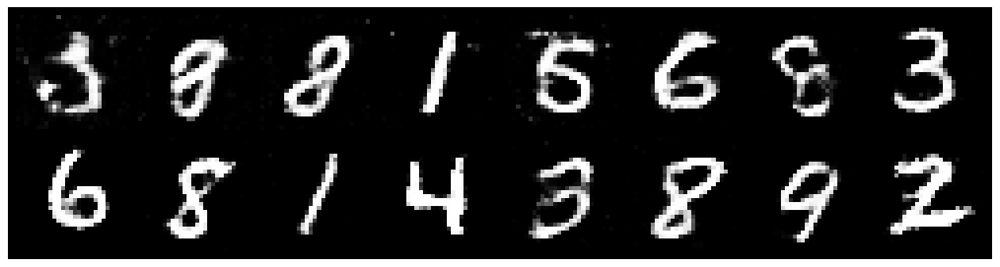

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.3056, Generator Loss: 0.9421
D(x): 0.5151, D(G(z)): 0.4368


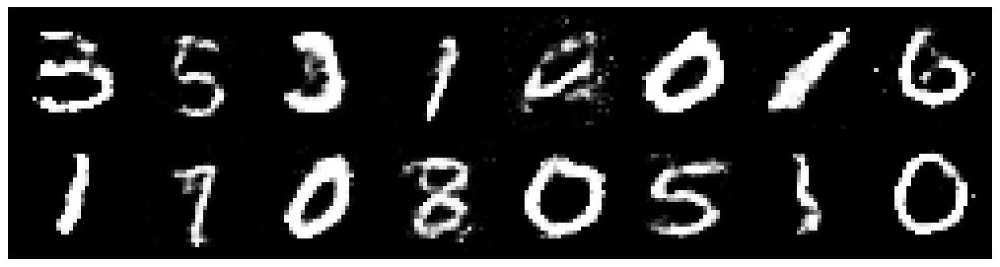

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.1944, Generator Loss: 0.9300
D(x): 0.5730, D(G(z)): 0.4249


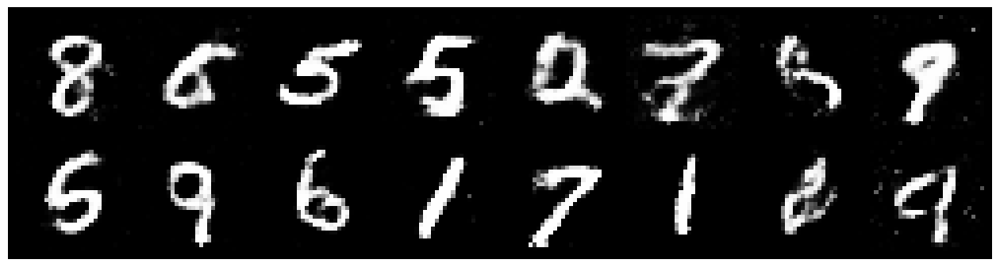

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.1991, Generator Loss: 0.8268
D(x): 0.5562, D(G(z)): 0.4282


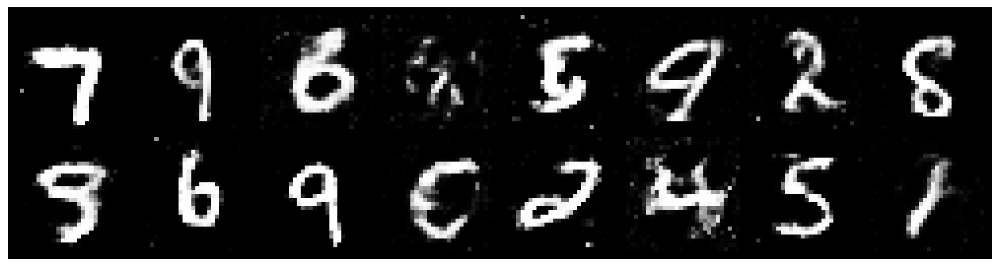

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.2927, Generator Loss: 0.8737
D(x): 0.5847, D(G(z)): 0.4872


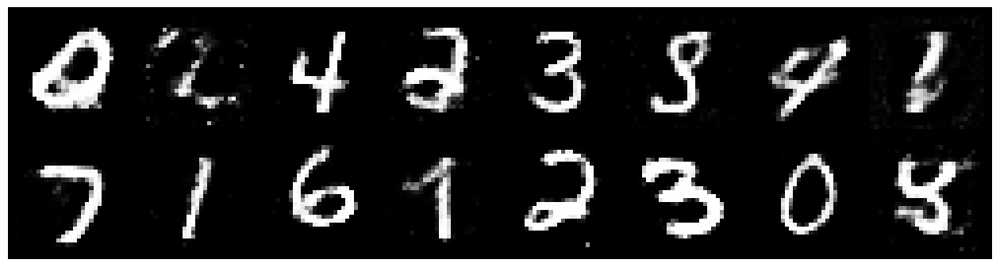

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2438, Generator Loss: 0.8337
D(x): 0.5964, D(G(z)): 0.4686


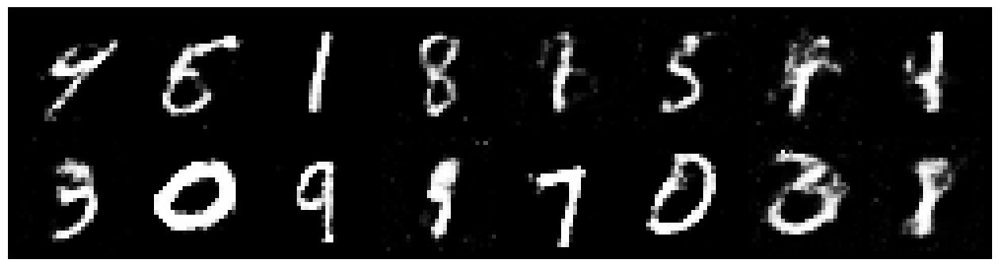

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.2757, Generator Loss: 0.8882
D(x): 0.5613, D(G(z)): 0.4419


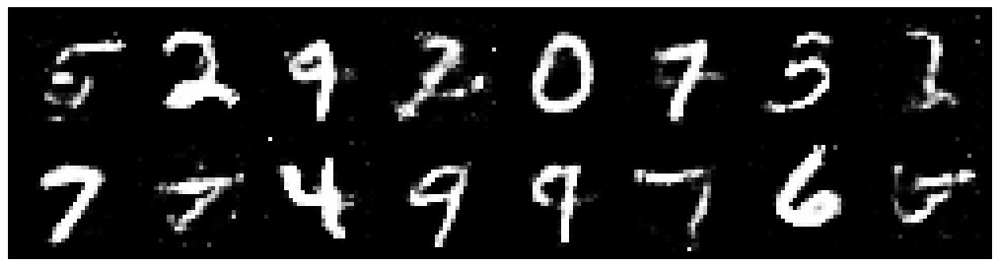

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.2564, Generator Loss: 0.8468
D(x): 0.5571, D(G(z)): 0.4454


In [12]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')# Total number of epochs to train
num_epochs = 200
num_test_samples = 16
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)        
        # 1. Train Discriminator
        
        real_data = real_batch.view(real_batch.size(0), 784)    
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(torch.randn(N, 100).to(device)).detach()        
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator        
        # Generate fake data
        fake_data = generator(torch.randn(N, 100).to(device))        # Train G
        g_error = train_generator(g_optimizer, fake_data)        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            gen_output = generator(torch.randn(num_test_samples, 100).to(device))
            test_images = gen_output.view(gen_output.size(0), 1, 28, 28)
            test_images = test_images.data            
            logger.log_images(
                test_images.cpu(), num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )

In [12]:
pip install tensorboard

  Obtaining dependency information for tensorboard from https://files.pythonhosted.org/packages/37/12/f6e9b9dcc310263cbd3948274e286538bd6800fd0c268850788f14a0c6d0/tensorboard-2.15.2-py3-none-any.whl.metadata
  Obtaining dependency information for absl-py>=0.4 from https://files.pythonhosted.org/packages/a2/ad/e0d3c824784ff121c03cc031f944bc7e139a8f1870ffd2845cc2dd76f6c4/absl_py-2.1.0-py3-none-any.whl.metadata
  Obtaining dependency information for grpcio>=1.48.2 from https://files.pythonhosted.org/packages/ec/d5/c3ddb54b39ce43d21428407eb26cf9a21fd43de5e26d9733b1f173d57475/grpcio-1.60.1-cp311-cp311-macosx_10_10_universal2.whl.metadata
  Obtaining dependency information for google-auth<3,>=1.6.3 from https://files.pythonhosted.org/packages/82/41/7fb855444cead5b2213e053447ce3a0b7bf2c3529c443e0cf75b2f13b405/google_auth-2.27.0-py2.py3-none-any.whl.metadata
  Obtaining dependency information for google-auth-oauthlib<2,>=0.5 from https://files.pythonhosted.org/packages/71/bf/9e125754d1adb3bc4b

In [13]:
%load_ext tensorboard

In [17]:
%tensorboard  --logdir . 